In [2]:
import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets

/home/naveen/anaconda3/lib/python3.6/site-packages/requests/__init__.py:80: RequestsDependencyWarning: urllib3 (1.22) or chardet (2.3.0) doesn't match a supported version!
  RequestsDependencyWarning)


In [4]:
from utils import Logger

In [5]:
def mnist_data():
    compose = transforms.Compose(
        [transforms.ToTensor(),
         transforms.Normalize((.5, .5, .5), (.5, .5, .5))
        ])
    out_dir = './dataset'
    return datasets.MNIST(root=out_dir, train=True, transform=compose, download=True)
# Load data
data = mnist_data()
# Create loader with data, so that we can iterate over it
data_loader = torch.utils.data.DataLoader(data, batch_size=100, shuffle=True)
# Num batches
num_batches = len(data_loader)

Processing...
Done!


In [6]:
class DiscriminatorNet(torch.nn.Module):
    """
    A three hidden-layer discriminative neural network
    """
    def __init__(self):
        super(DiscriminatorNet, self).__init__()
        n_features = 784
        n_out = 1
        
        self.hidden0 = nn.Sequential( 
            nn.Linear(n_features, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden1 = nn.Sequential(
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.out = nn.Sequential(
            torch.nn.Linear(256, n_out),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
discriminator = DiscriminatorNet()

In [7]:
def images_to_vectors(images):
    return images.view(images.size(0), 784)

def vectors_to_images(vectors):
    return vectors.view(vectors.size(0), 1, 28, 28)

In [8]:
class GeneratorNet(torch.nn.Module):
    """
    A three hidden-layer generative neural network
    """
    def __init__(self):
        super(GeneratorNet, self).__init__()
        n_features = 100
        n_out = 784
        
        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 256),
            nn.LeakyReLU(0.2)
        )
        self.hidden1 = nn.Sequential(            
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2)
        )
        
        self.out = nn.Sequential(
            nn.Linear(1024, n_out),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
generator = GeneratorNet()

In [9]:
def noise(size):
    '''
    Generates a 1-d vector of gaussian sampled random values
    '''
    n = Variable(torch.randn(size, 100))
    return n

In [10]:
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002)

In [11]:
loss = nn.BCELoss()

In [12]:
def ones_target(size):
    '''
    Tensor containing ones, with shape = size
    '''
    data = Variable(torch.ones(size, 1))
    return data

def zeros_target(size):
    '''
    Tensor containing zeros, with shape = size
    '''
    data = Variable(torch.zeros(size, 1))
    return data

In [13]:
def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    
    # 1.1 Train on Real Data
    prediction_real = discriminator(real_data)
    # Calculate error and backpropagate
    error_real = loss(prediction_real, ones_target(N) )
    error_real.backward()

    # 1.2 Train on Fake Data
    prediction_fake = discriminator(fake_data)
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake, zeros_target(N))
    error_fake.backward()
    
    # 1.3 Update weights with gradients
    optimizer.step()
    
    # Return error and predictions for real and fake inputs
    return error_real + error_fake, prediction_real, prediction_fake

In [14]:
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    # Sample noise and generate fake data
    prediction = discriminator(fake_data)
    # Calculate error and backpropagate
    error = loss(prediction, ones_target(N))
    error.backward()
    # Update weights with gradients
    optimizer.step()
    # Return error
    return error


In [15]:
num_test_samples = 16
test_noise = noise(num_test_samples)

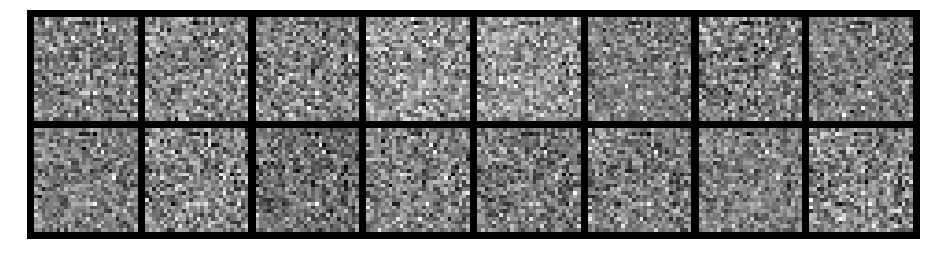

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.4205, Generator Loss: 0.7135
D(x): 0.4732, D(G(z)): 0.4892


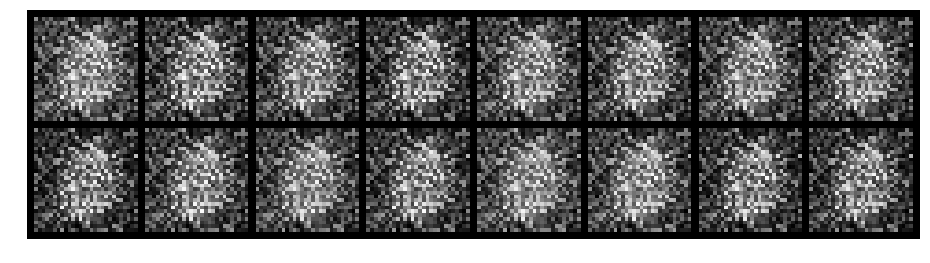

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 1.2527, Generator Loss: 1.7361
D(x): 0.6942, D(G(z)): 0.4832


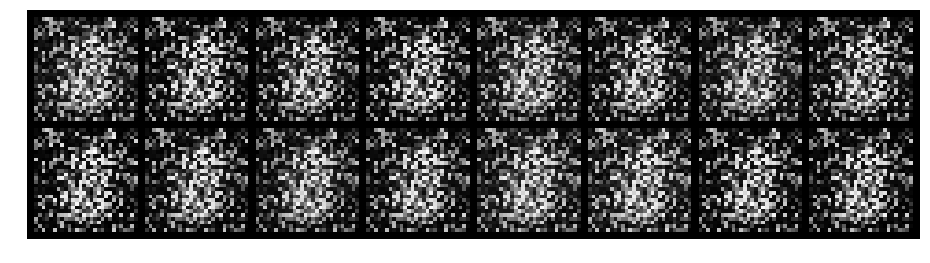

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.4656, Generator Loss: 3.8804
D(x): 0.8654, D(G(z)): 0.1739


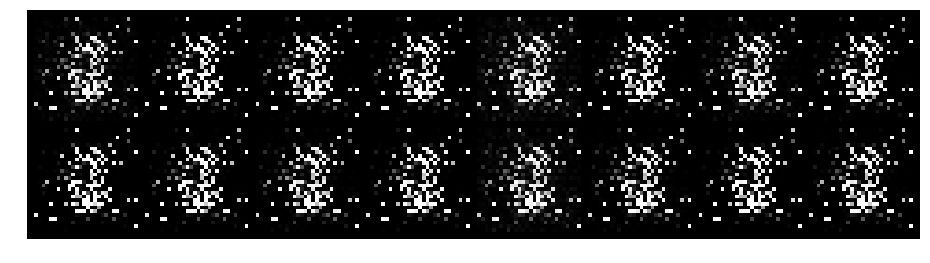

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 0.0608, Generator Loss: 6.3706
D(x): 0.9837, D(G(z)): 0.0367


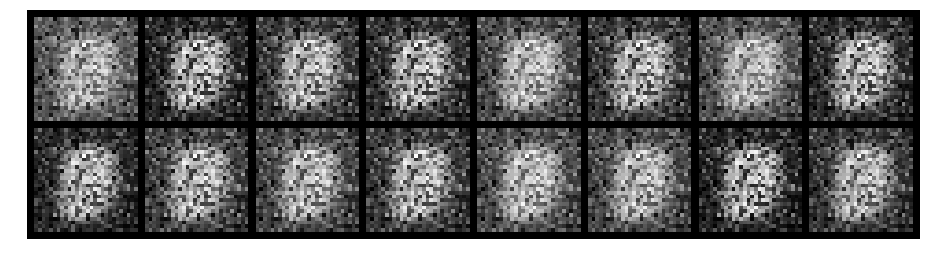

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 2.3599, Generator Loss: 0.4767
D(x): 0.6014, D(G(z)): 0.7936


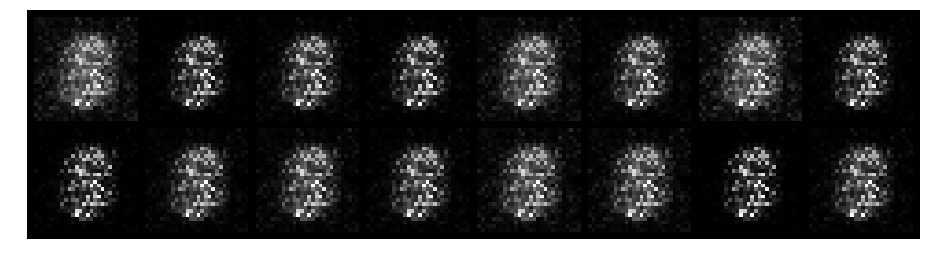

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 0.3478, Generator Loss: 3.2913
D(x): 0.8313, D(G(z)): 0.1189


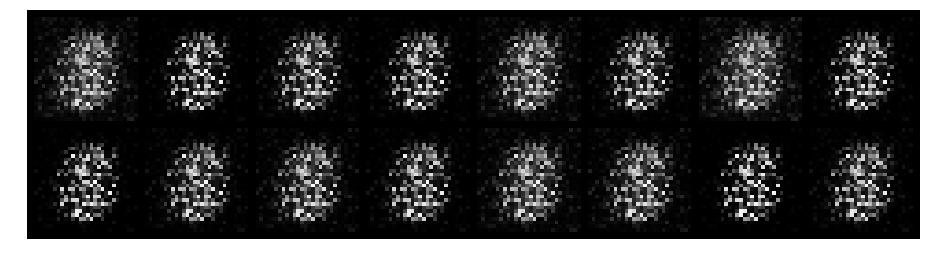

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 0.5782, Generator Loss: 2.6175
D(x): 0.7329, D(G(z)): 0.2098


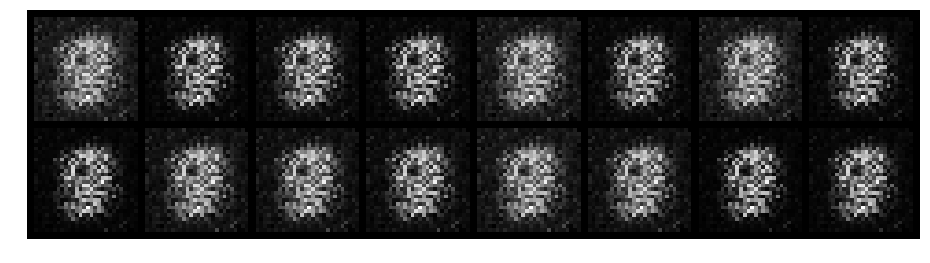

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 0.4220, Generator Loss: 3.7326
D(x): 0.7513, D(G(z)): 0.0986


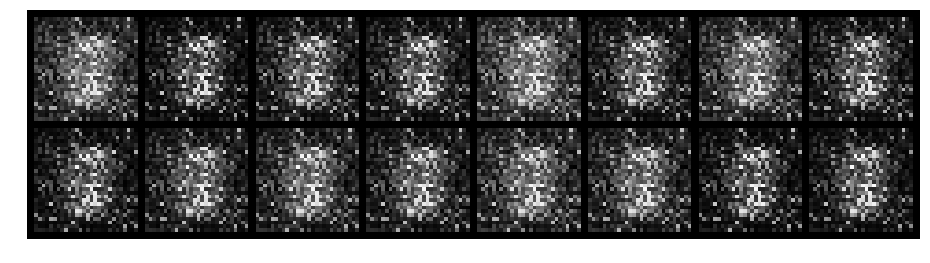

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 0.4953, Generator Loss: 4.6125
D(x): 0.8580, D(G(z)): 0.2213


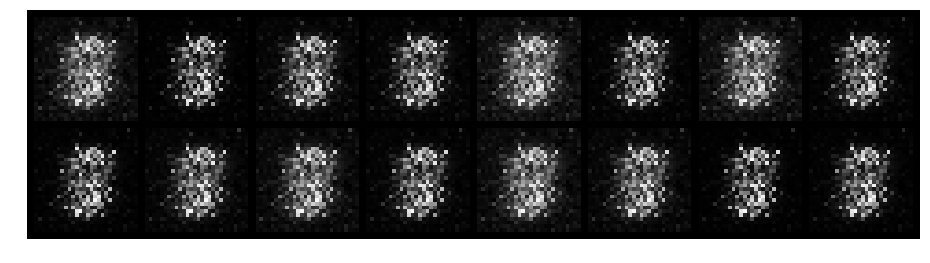

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 0.6107, Generator Loss: 2.4131
D(x): 0.7782, D(G(z)): 0.2483


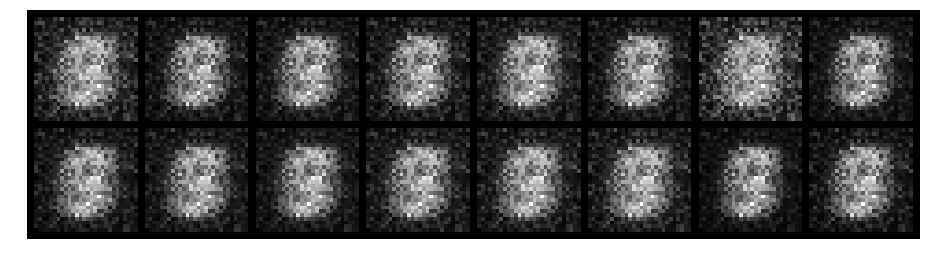

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 2.0079, Generator Loss: 0.8845
D(x): 0.6189, D(G(z)): 0.6754


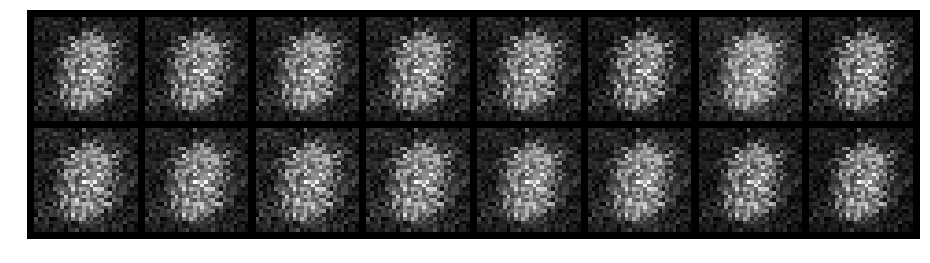

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 1.7789, Generator Loss: 1.2737
D(x): 0.6345, D(G(z)): 0.5990


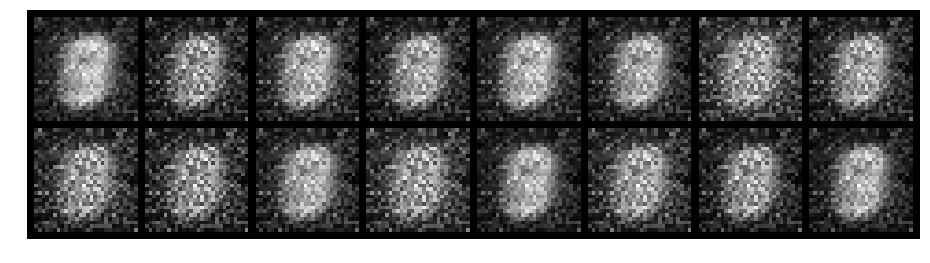

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 1.6735, Generator Loss: 0.6388
D(x): 0.7865, D(G(z)): 0.6829


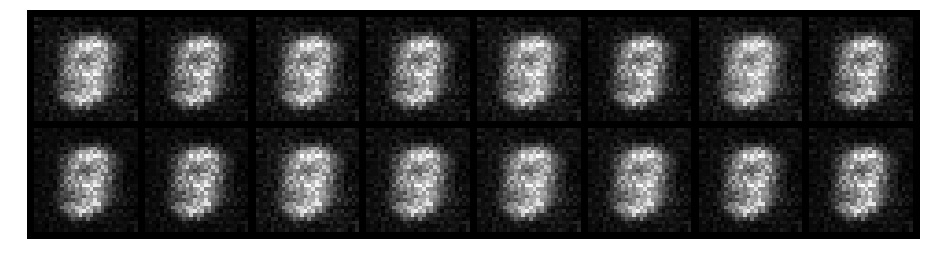

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 1.6233, Generator Loss: 0.9098
D(x): 0.5728, D(G(z)): 0.4897


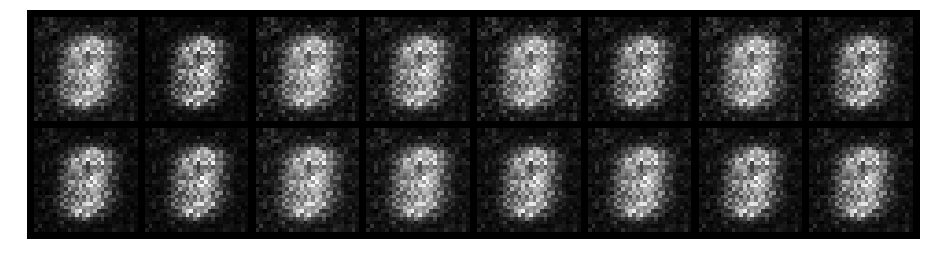

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 0.2532, Generator Loss: 3.1857
D(x): 0.8479, D(G(z)): 0.0654


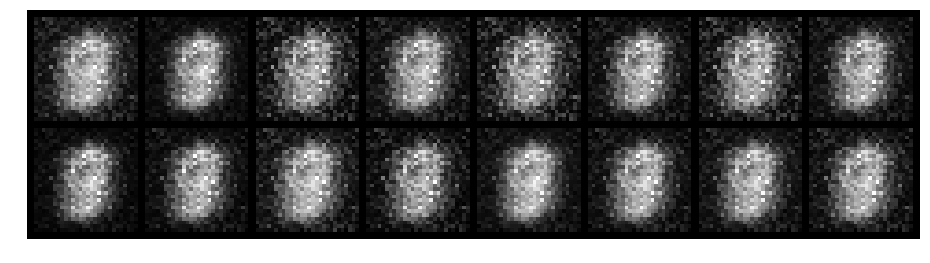

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 0.5856, Generator Loss: 2.8778
D(x): 0.8350, D(G(z)): 0.2372


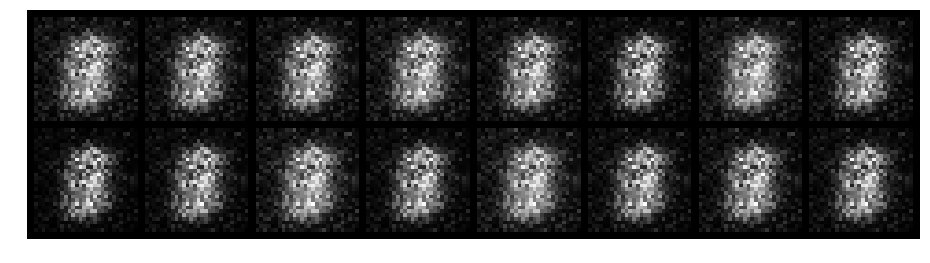

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 0.1652, Generator Loss: 3.4601
D(x): 0.9374, D(G(z)): 0.0807


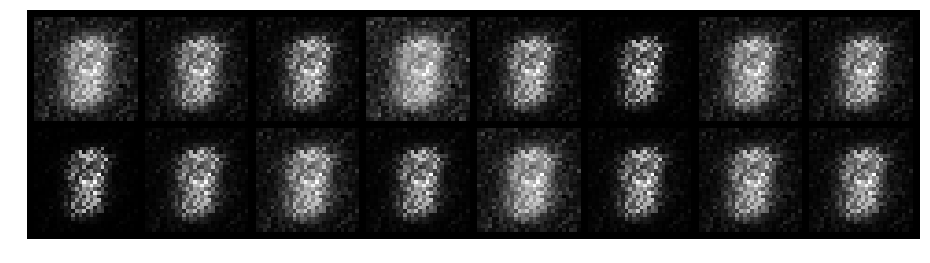

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 1.0307, Generator Loss: 1.5210
D(x): 0.7306, D(G(z)): 0.3091


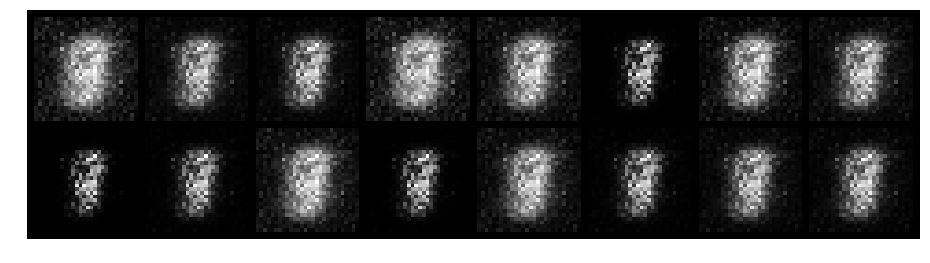

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 0.5378, Generator Loss: 3.4220
D(x): 0.9216, D(G(z)): 0.2515


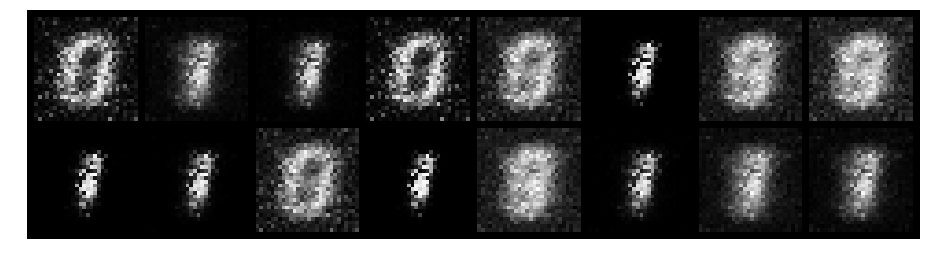

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 0.7907, Generator Loss: 2.4655
D(x): 0.7715, D(G(z)): 0.2841


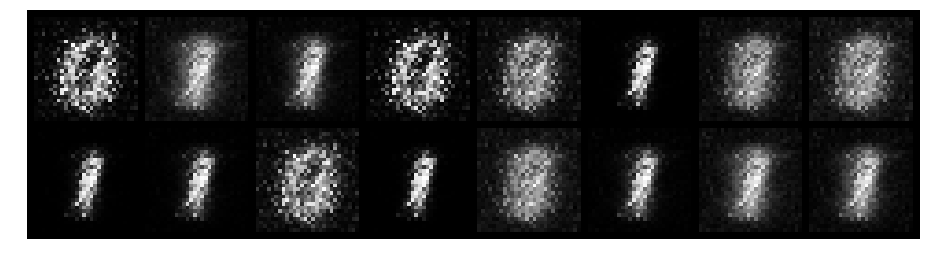

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 0.5131, Generator Loss: 3.3417
D(x): 0.8701, D(G(z)): 0.2198


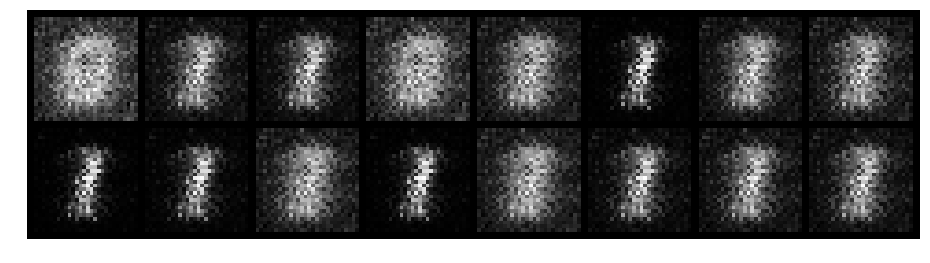

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 0.1956, Generator Loss: 4.2387
D(x): 0.9415, D(G(z)): 0.0765


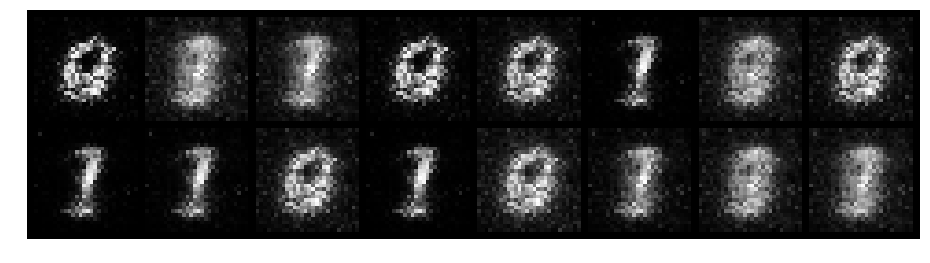

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 0.5448, Generator Loss: 2.4811
D(x): 0.8793, D(G(z)): 0.2146


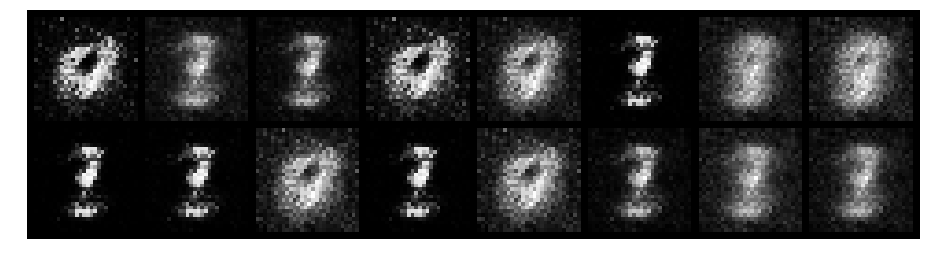

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 0.4911, Generator Loss: 2.8044
D(x): 0.8890, D(G(z)): 0.1232


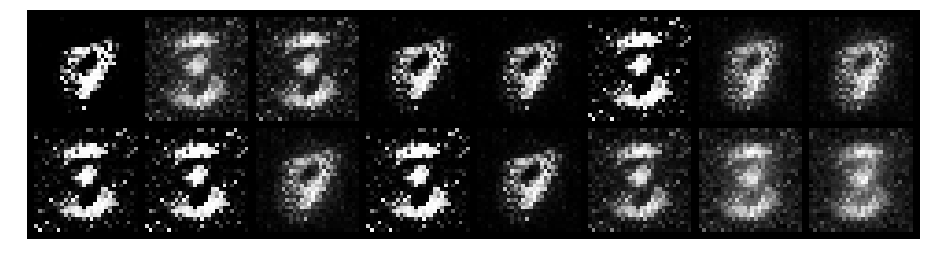

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 0.4337, Generator Loss: 4.3018
D(x): 0.8919, D(G(z)): 0.1225


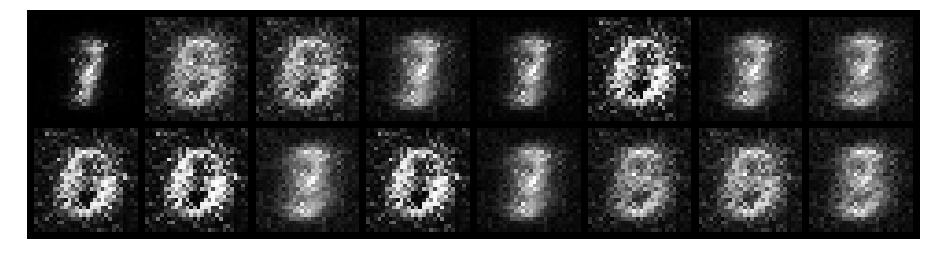

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.4630, Generator Loss: 1.6872
D(x): 0.8764, D(G(z)): 0.2177


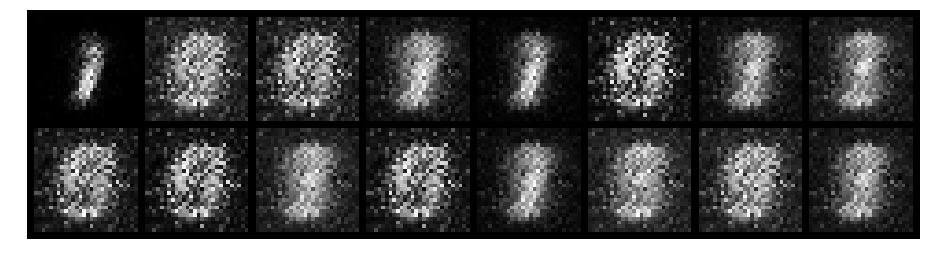

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.5872, Generator Loss: 2.2907
D(x): 0.8399, D(G(z)): 0.1367


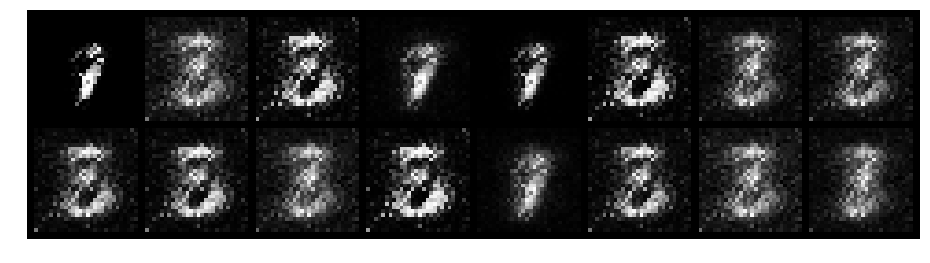

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.1609, Generator Loss: 4.1366
D(x): 0.9703, D(G(z)): 0.0842


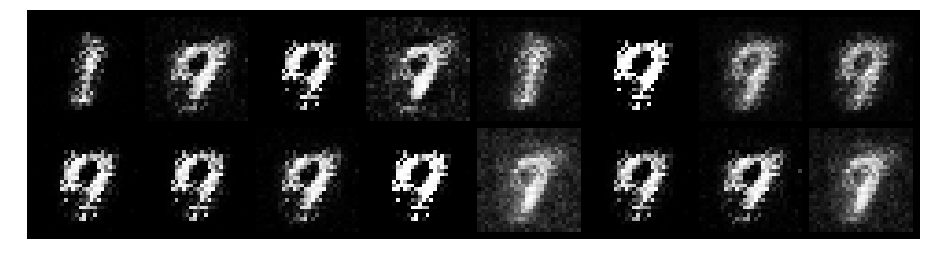

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.3696, Generator Loss: 3.7109
D(x): 0.9065, D(G(z)): 0.0768


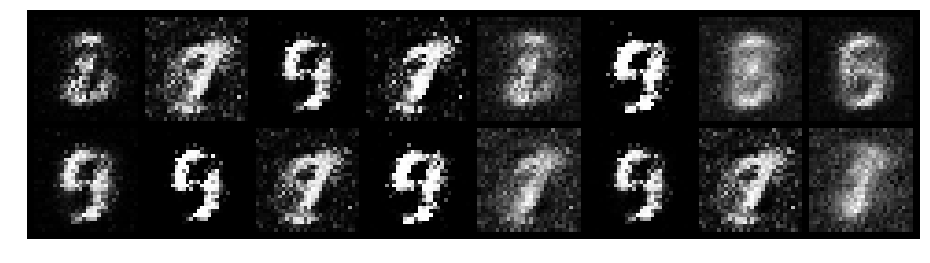

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.5760, Generator Loss: 2.5598
D(x): 0.8878, D(G(z)): 0.2273


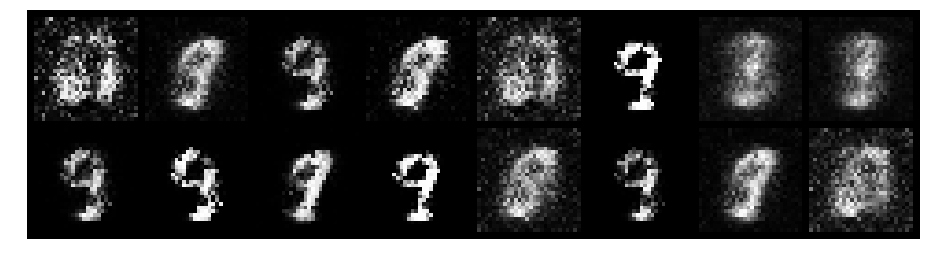

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.4748, Generator Loss: 3.2914
D(x): 0.8958, D(G(z)): 0.1946


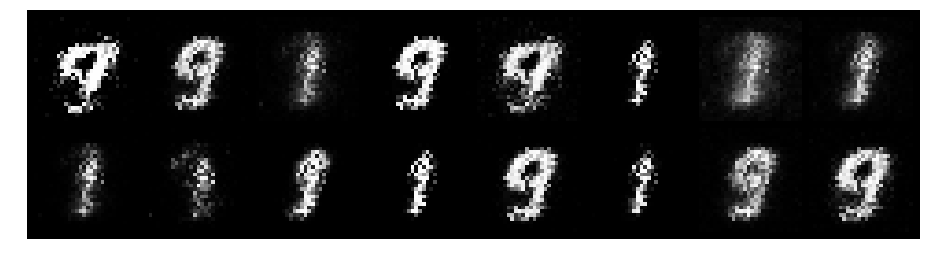

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.3150, Generator Loss: 2.7414
D(x): 0.8831, D(G(z)): 0.1207


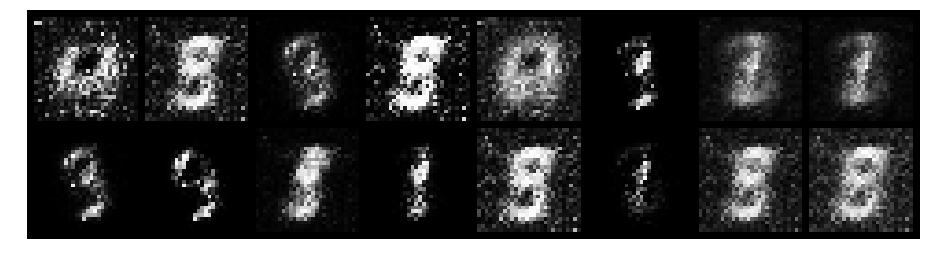

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.6252, Generator Loss: 3.4316
D(x): 0.8046, D(G(z)): 0.1656


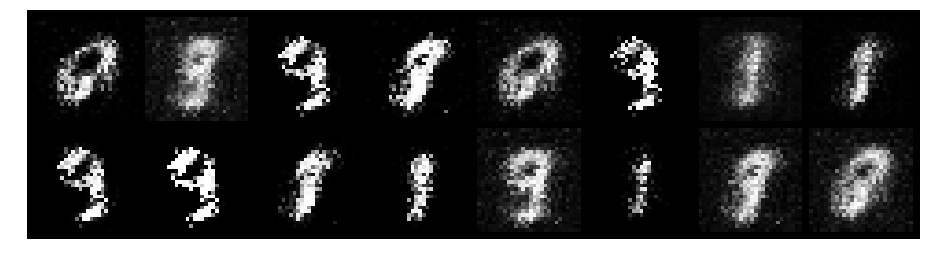

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.3177, Generator Loss: 3.7283
D(x): 0.8777, D(G(z)): 0.0925


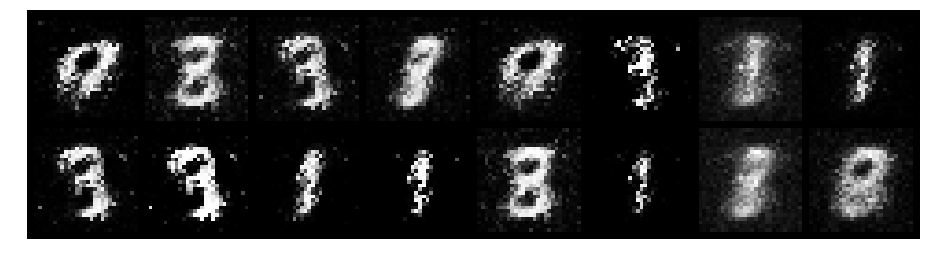

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.7504, Generator Loss: 1.6869
D(x): 0.8149, D(G(z)): 0.2725


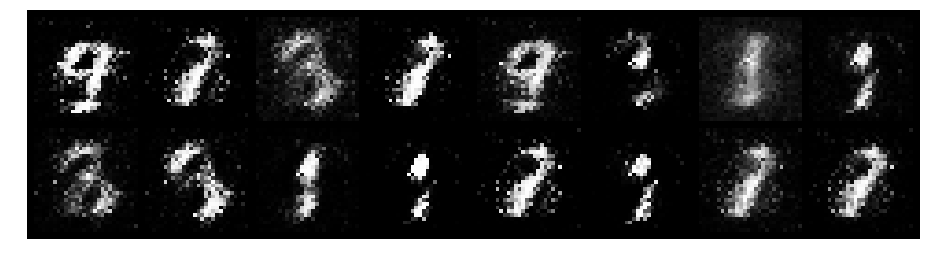

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 1.0279, Generator Loss: 1.7053
D(x): 0.6685, D(G(z)): 0.2679


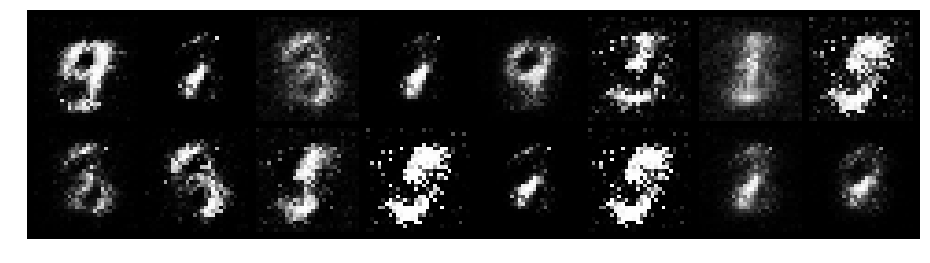

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.8312, Generator Loss: 1.7866
D(x): 0.7769, D(G(z)): 0.2979


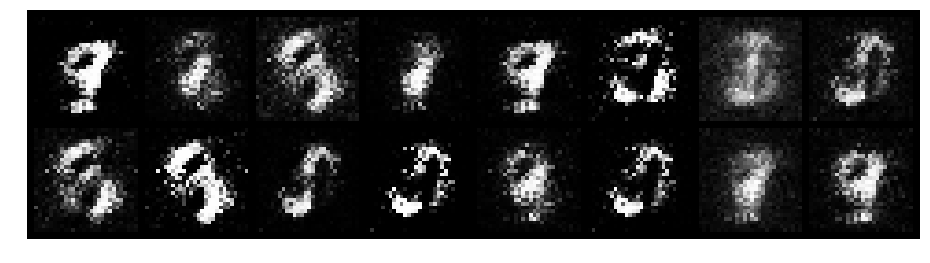

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.4010, Generator Loss: 3.0677
D(x): 0.8956, D(G(z)): 0.1769


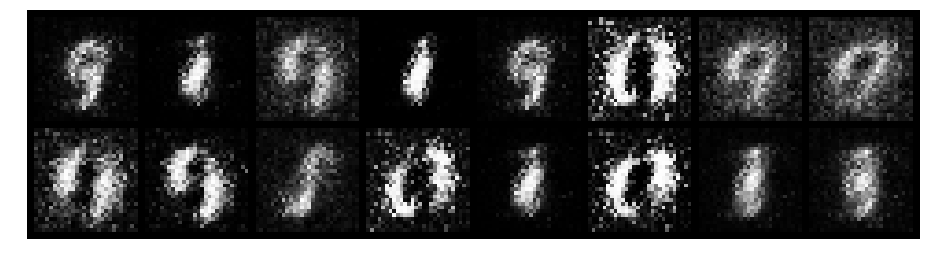

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 0.6885, Generator Loss: 2.3524
D(x): 0.8201, D(G(z)): 0.1839


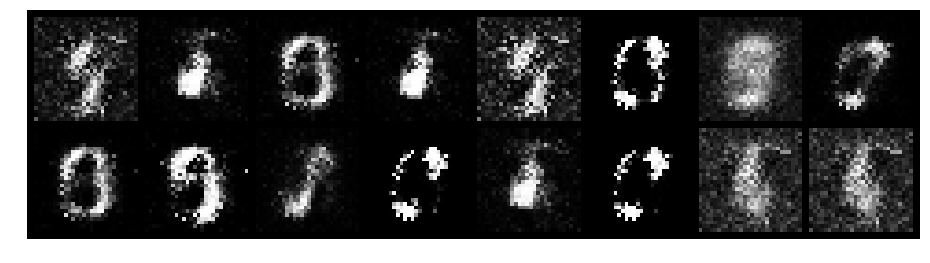

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.6516, Generator Loss: 2.2348
D(x): 0.8643, D(G(z)): 0.2403


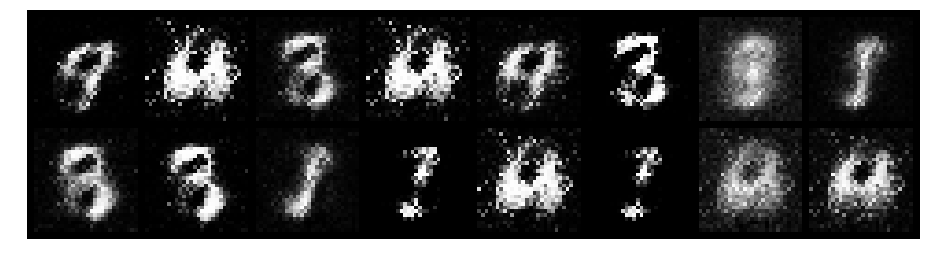

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.7905, Generator Loss: 2.0838
D(x): 0.7607, D(G(z)): 0.1710


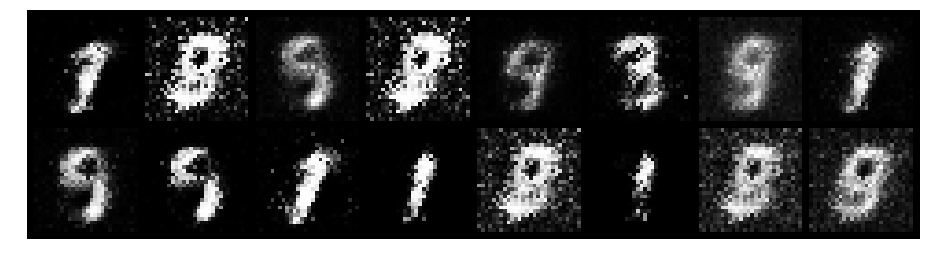

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.8226, Generator Loss: 1.8024
D(x): 0.8125, D(G(z)): 0.2798


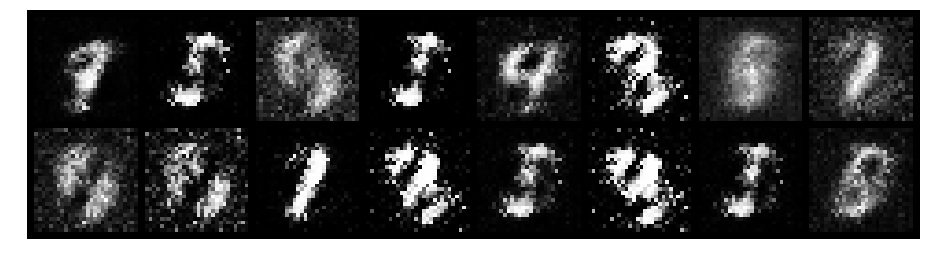

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.3856, Generator Loss: 2.7690
D(x): 0.8773, D(G(z)): 0.1480


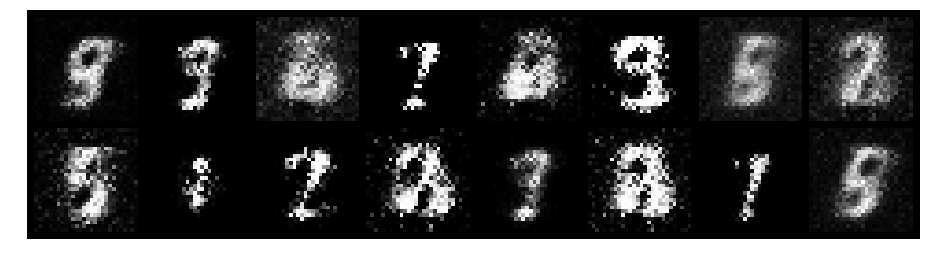

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.9070, Generator Loss: 1.9173
D(x): 0.7855, D(G(z)): 0.3432


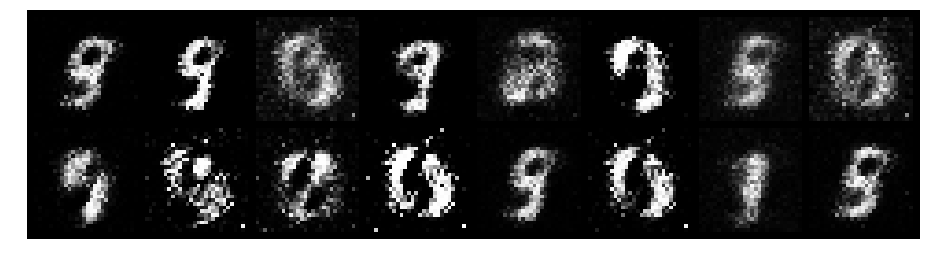

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.9555, Generator Loss: 2.5952
D(x): 0.7189, D(G(z)): 0.2026


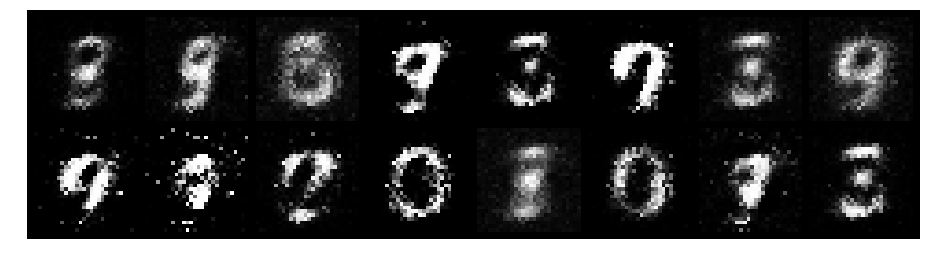

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.7073, Generator Loss: 2.4705
D(x): 0.8295, D(G(z)): 0.2428


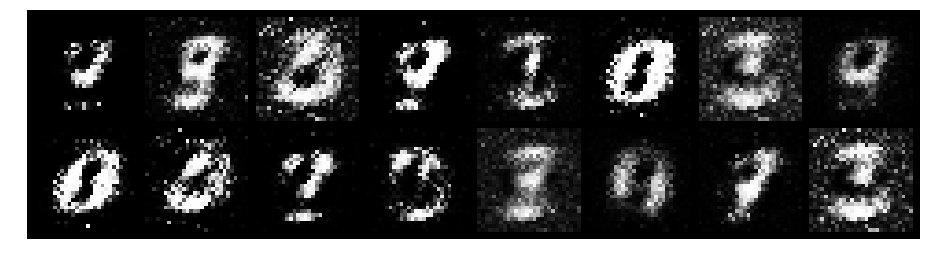

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.6403, Generator Loss: 2.6606
D(x): 0.8363, D(G(z)): 0.1940


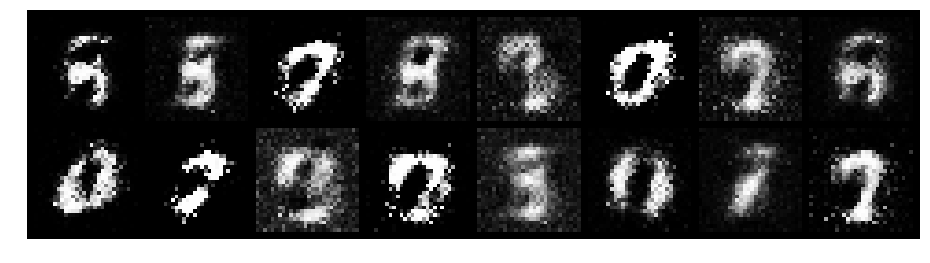

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.7143, Generator Loss: 2.5784
D(x): 0.8090, D(G(z)): 0.2035


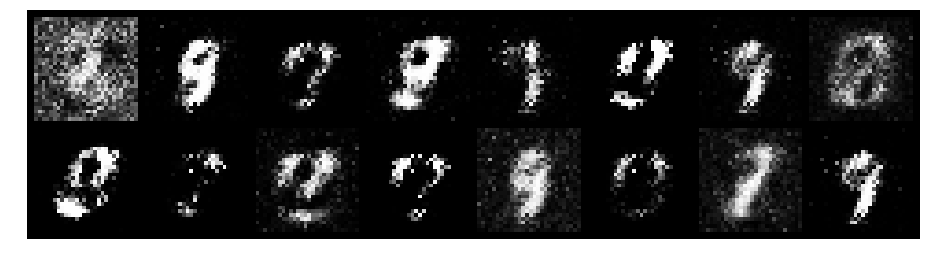

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.5435, Generator Loss: 2.7159
D(x): 0.8293, D(G(z)): 0.1844


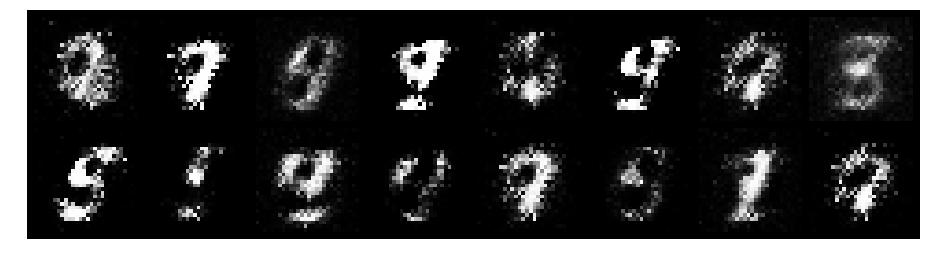

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.6082, Generator Loss: 2.0546
D(x): 0.7553, D(G(z)): 0.1342


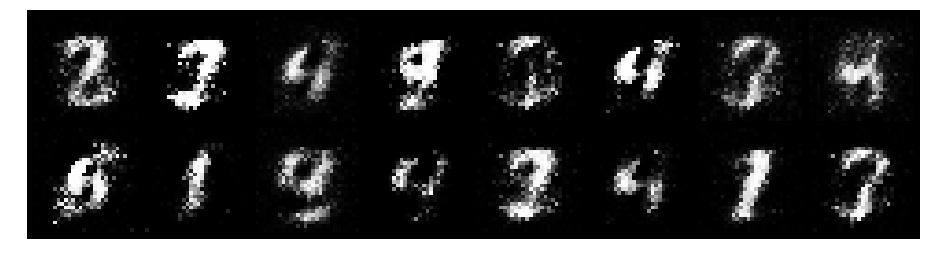

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.4733, Generator Loss: 2.6688
D(x): 0.8772, D(G(z)): 0.1677


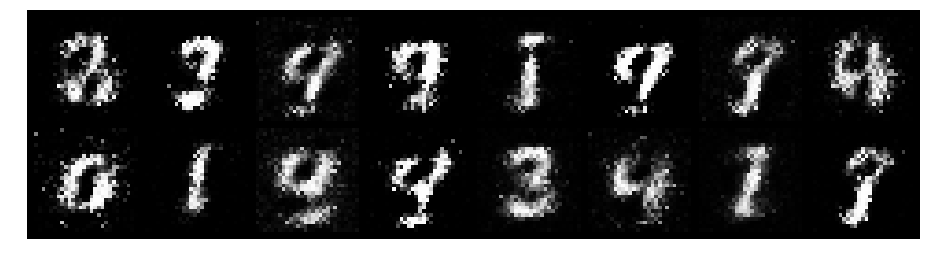

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.3973, Generator Loss: 3.0268
D(x): 0.8325, D(G(z)): 0.0973


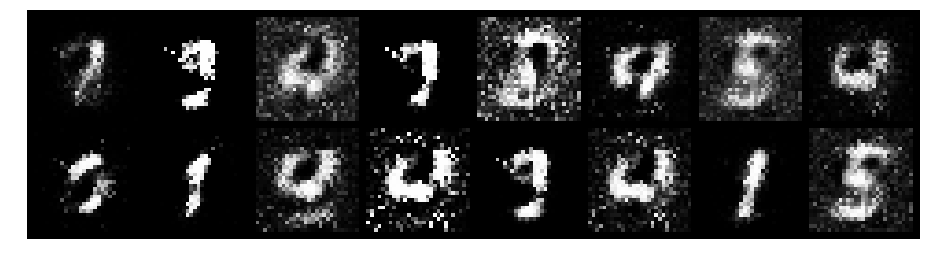

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.6051, Generator Loss: 2.2219
D(x): 0.7708, D(G(z)): 0.1778


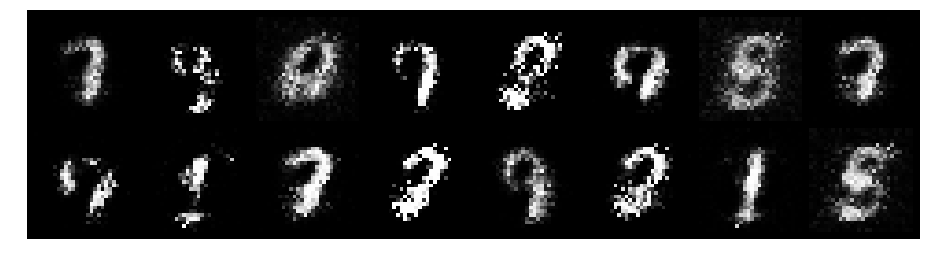

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.5922, Generator Loss: 2.4545
D(x): 0.7730, D(G(z)): 0.1688


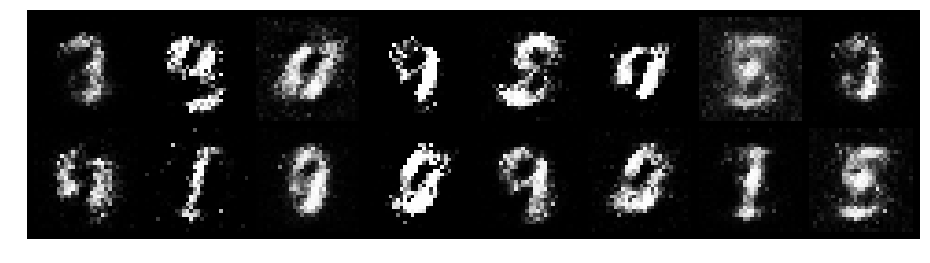

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.4310, Generator Loss: 2.5437
D(x): 0.8618, D(G(z)): 0.1376


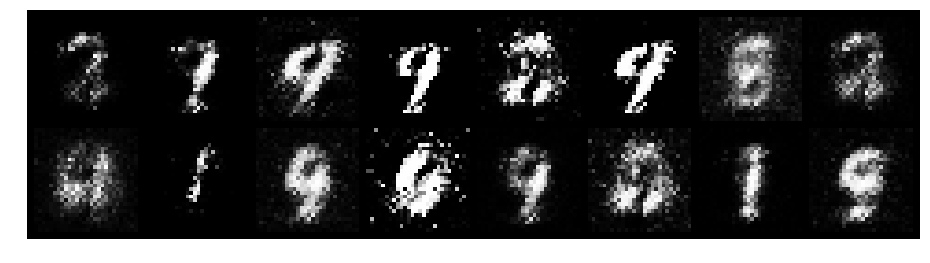

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.5791, Generator Loss: 2.2707
D(x): 0.8757, D(G(z)): 0.2415


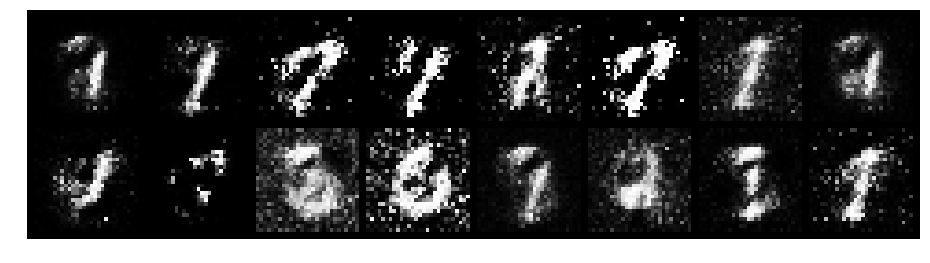

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.5527, Generator Loss: 2.6671
D(x): 0.8255, D(G(z)): 0.2024


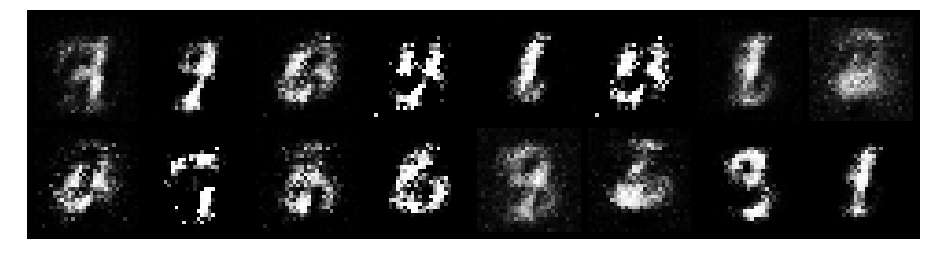

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.5021, Generator Loss: 2.4291
D(x): 0.7950, D(G(z)): 0.1335


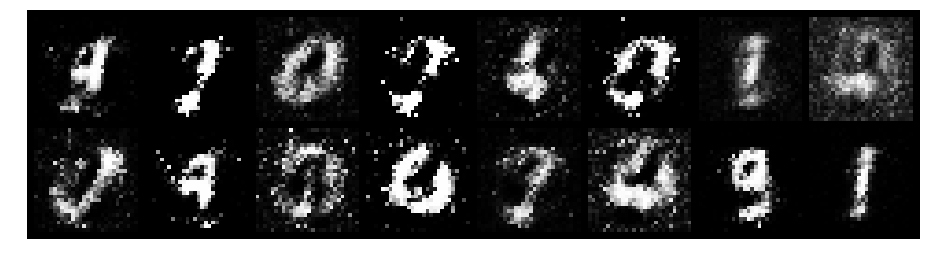

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.9002, Generator Loss: 2.3149
D(x): 0.7331, D(G(z)): 0.2419


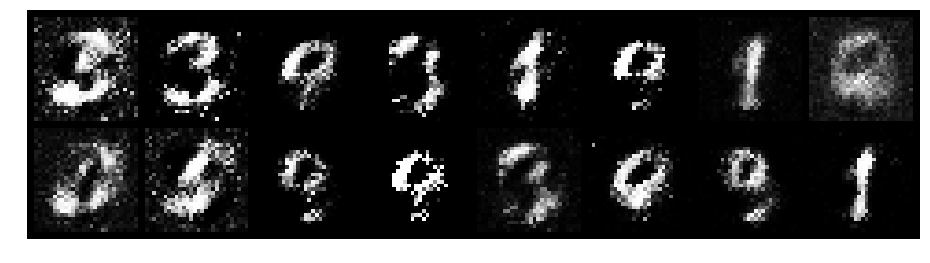

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.9660, Generator Loss: 1.6283
D(x): 0.6445, D(G(z)): 0.2582


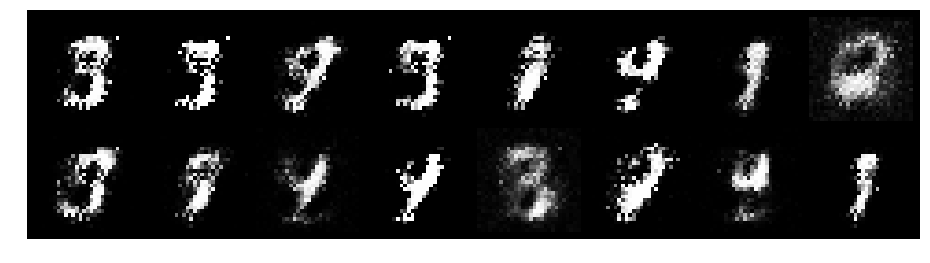

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.8113, Generator Loss: 2.0701
D(x): 0.6911, D(G(z)): 0.2080


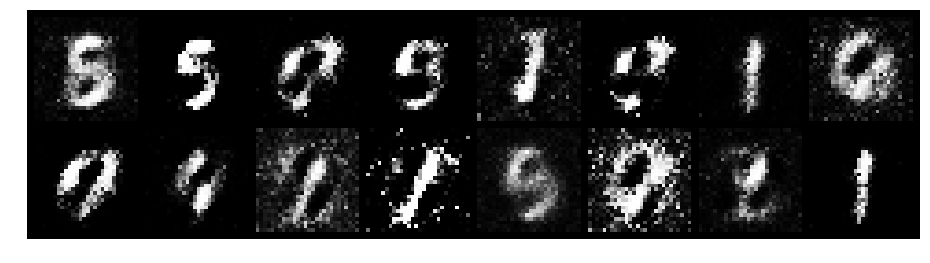

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.9140, Generator Loss: 1.7280
D(x): 0.7948, D(G(z)): 0.2988


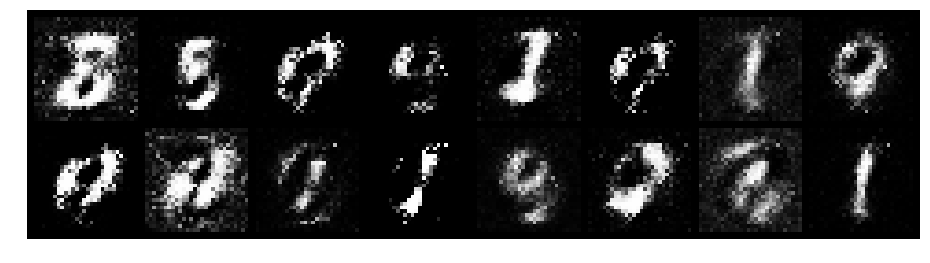

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.6936, Generator Loss: 1.9910
D(x): 0.8822, D(G(z)): 0.2982


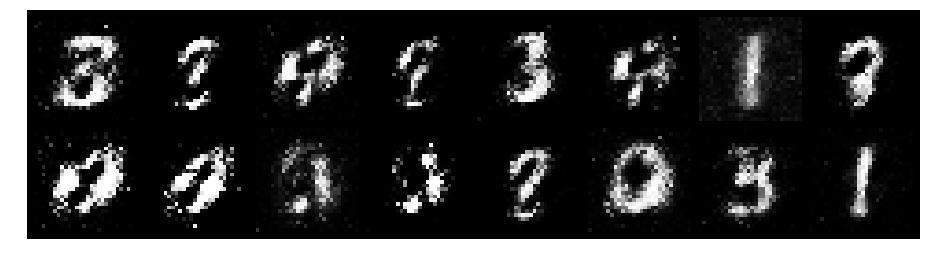

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.6482, Generator Loss: 2.1227
D(x): 0.8309, D(G(z)): 0.2535


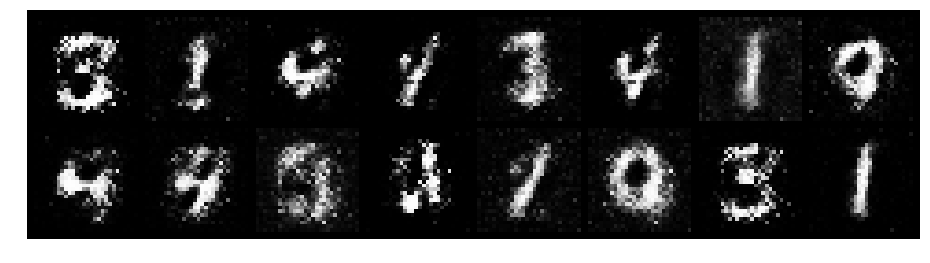

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.9953, Generator Loss: 2.1062
D(x): 0.7560, D(G(z)): 0.2790


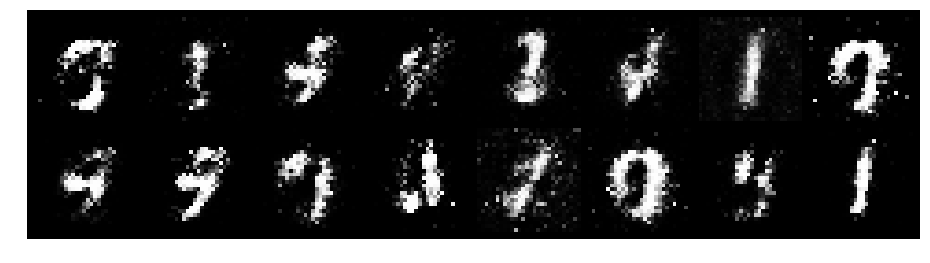

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 0.5947, Generator Loss: 2.5633
D(x): 0.8346, D(G(z)): 0.2231


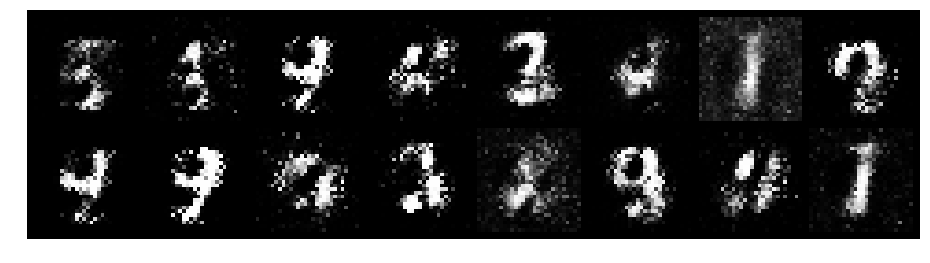

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.6164, Generator Loss: 1.8110
D(x): 0.7750, D(G(z)): 0.2299


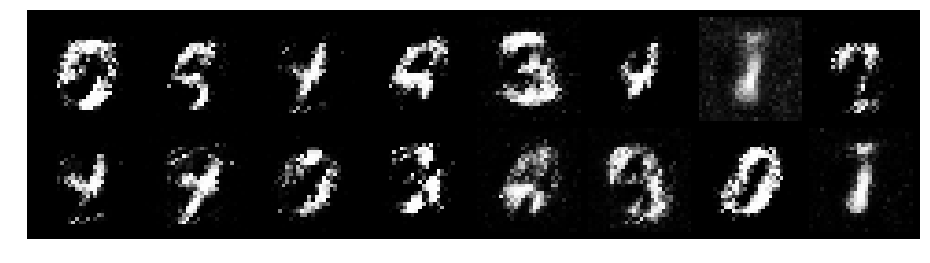

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.7435, Generator Loss: 1.8372
D(x): 0.7591, D(G(z)): 0.2640


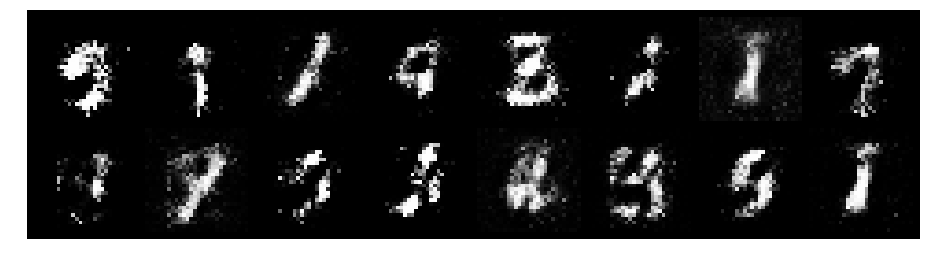

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.7257, Generator Loss: 1.8034
D(x): 0.8194, D(G(z)): 0.2620


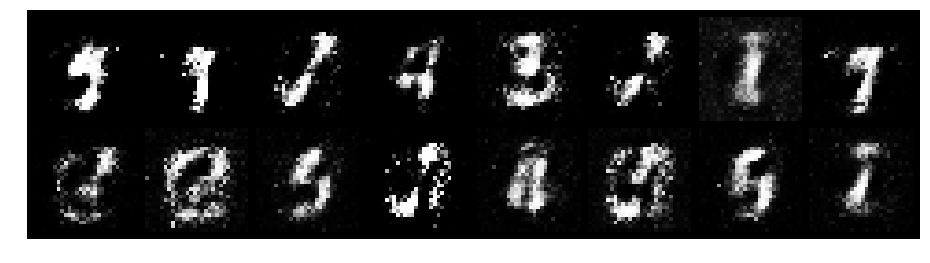

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 1.1947, Generator Loss: 1.8006
D(x): 0.6119, D(G(z)): 0.2337


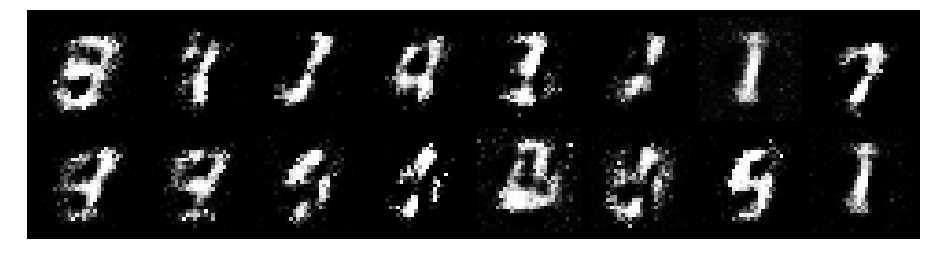

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.7809, Generator Loss: 2.0981
D(x): 0.6991, D(G(z)): 0.2015


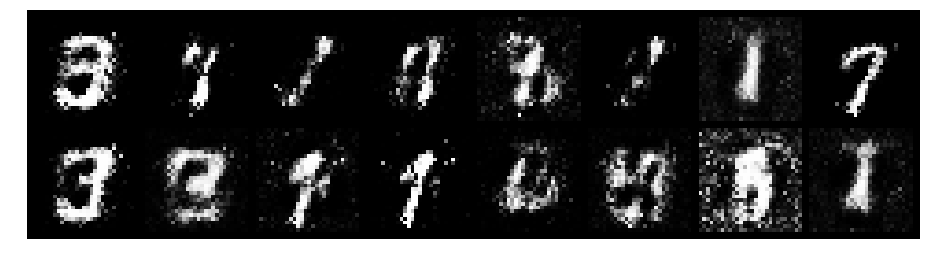

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 0.7971, Generator Loss: 1.7173
D(x): 0.7553, D(G(z)): 0.2724


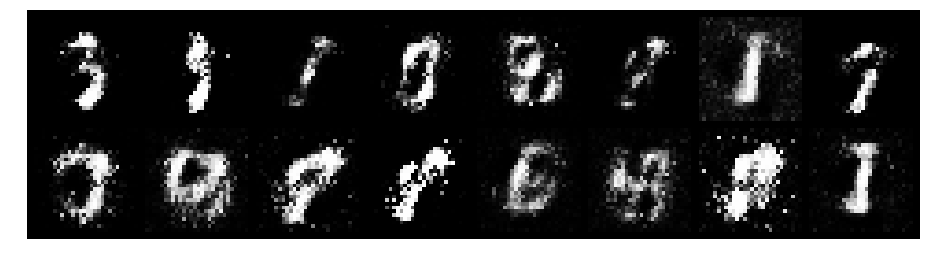

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 1.1766, Generator Loss: 1.3377
D(x): 0.7000, D(G(z)): 0.4142


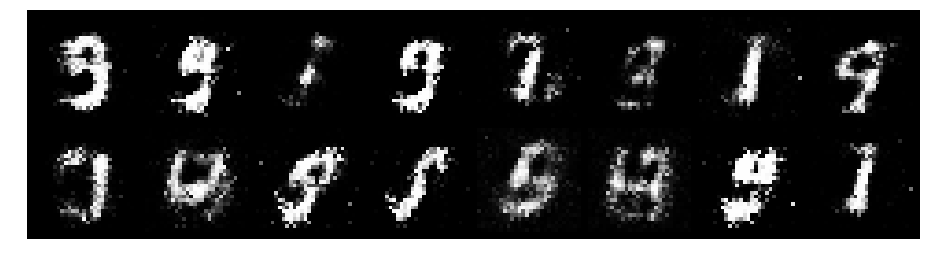

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.9763, Generator Loss: 0.9985
D(x): 0.7466, D(G(z)): 0.3805


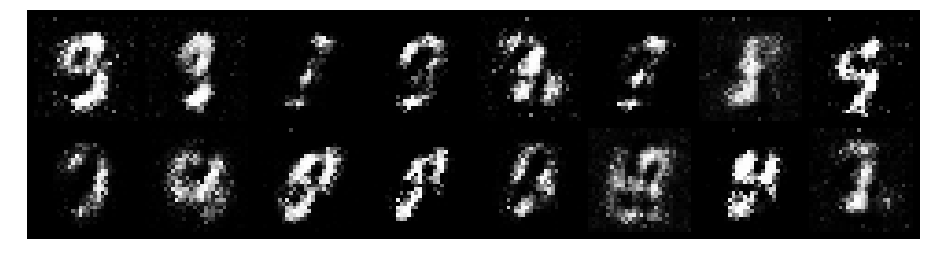

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.9237, Generator Loss: 1.7522
D(x): 0.7600, D(G(z)): 0.3448


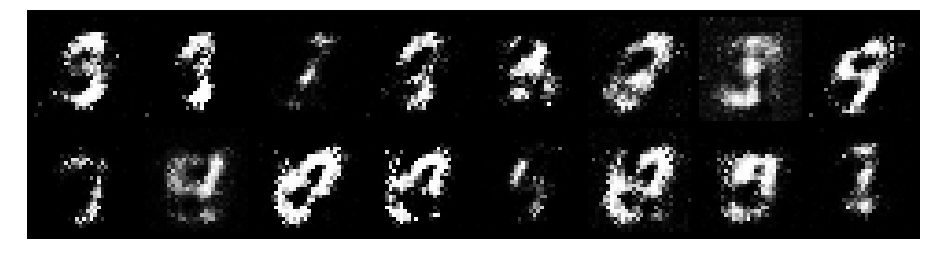

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 0.7463, Generator Loss: 1.6557
D(x): 0.7559, D(G(z)): 0.3147


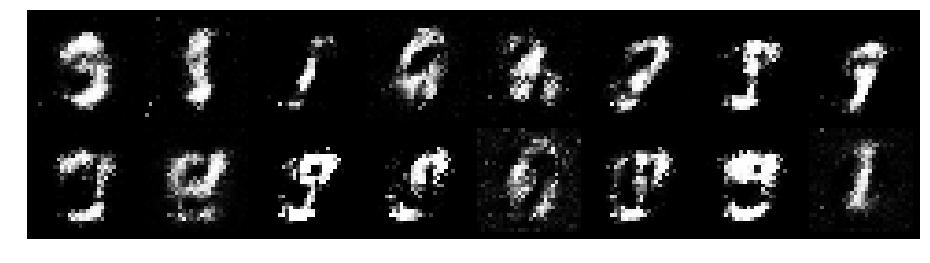

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.9289, Generator Loss: 1.7958
D(x): 0.7586, D(G(z)): 0.3200


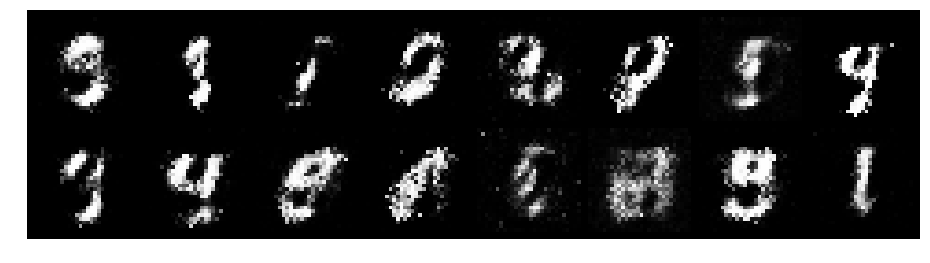

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 0.9278, Generator Loss: 1.8627
D(x): 0.7206, D(G(z)): 0.3051


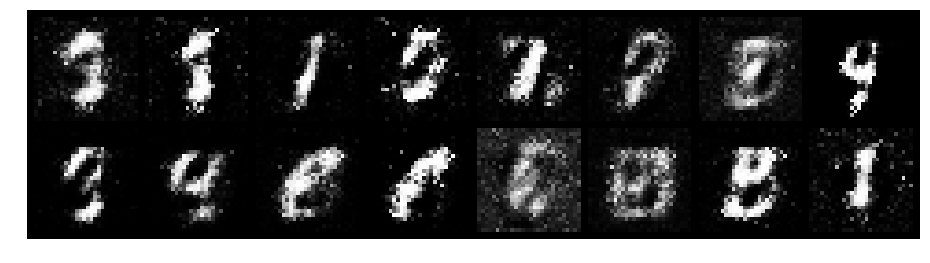

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.9943, Generator Loss: 1.8041
D(x): 0.6860, D(G(z)): 0.3065


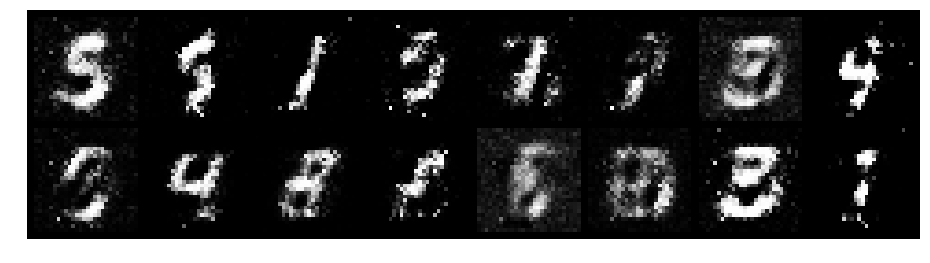

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.9687, Generator Loss: 1.6803
D(x): 0.6749, D(G(z)): 0.2841


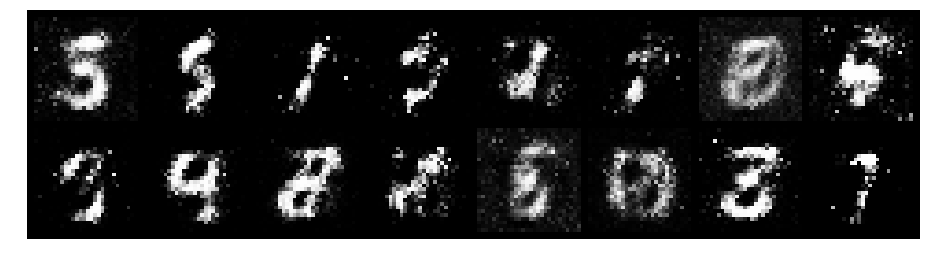

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.6472, Generator Loss: 1.8348
D(x): 0.8350, D(G(z)): 0.2638


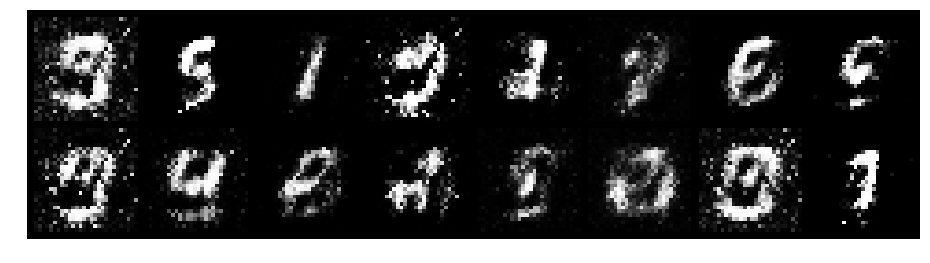

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.9080, Generator Loss: 1.4145
D(x): 0.7770, D(G(z)): 0.3681


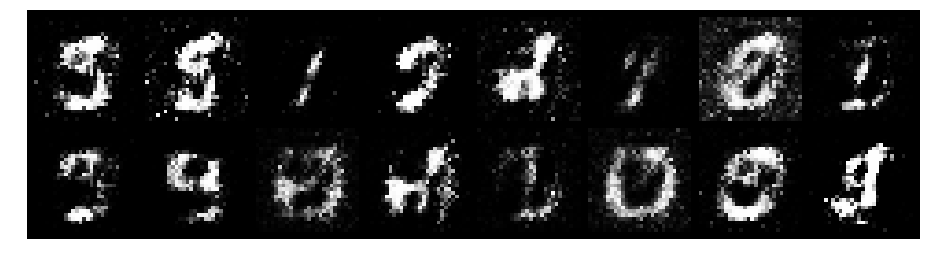

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.5561, Generator Loss: 1.9540
D(x): 0.8180, D(G(z)): 0.2115


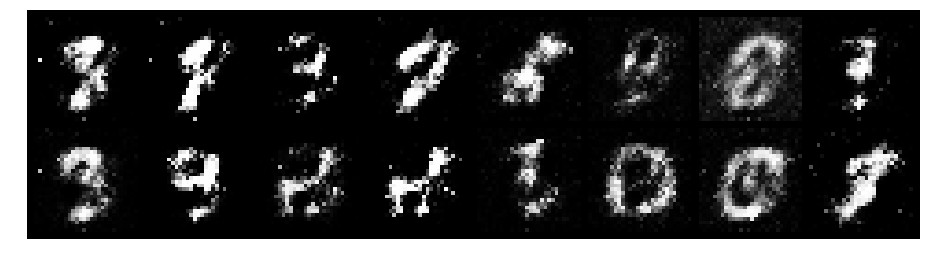

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 1.0248, Generator Loss: 1.3388
D(x): 0.7275, D(G(z)): 0.3388


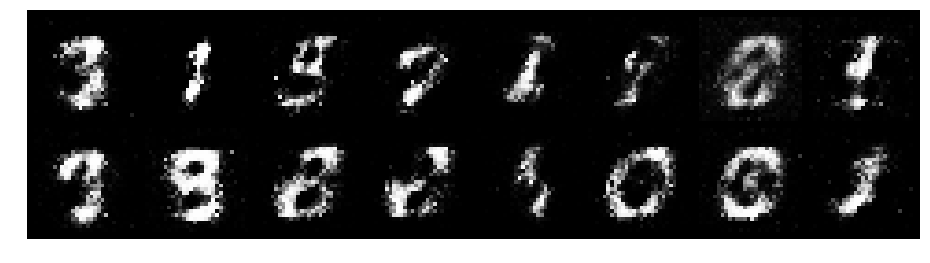

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.9281, Generator Loss: 2.1496
D(x): 0.7377, D(G(z)): 0.2965


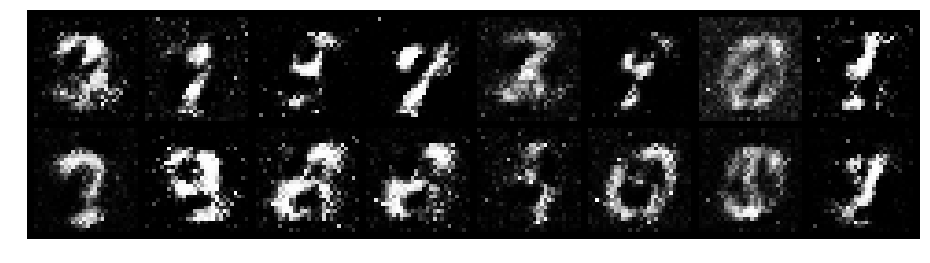

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 1.2704, Generator Loss: 1.6331
D(x): 0.5509, D(G(z)): 0.2913


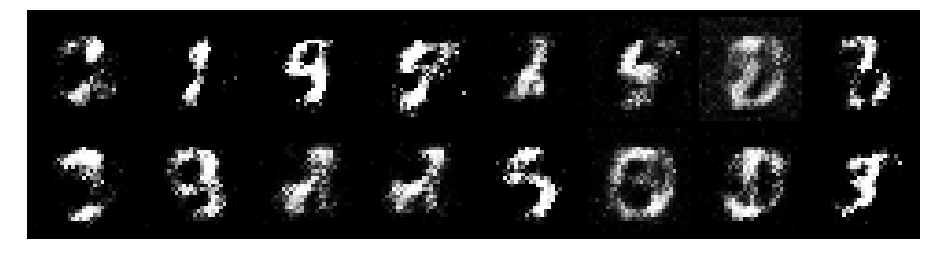

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 1.1140, Generator Loss: 1.7544
D(x): 0.6672, D(G(z)): 0.3106


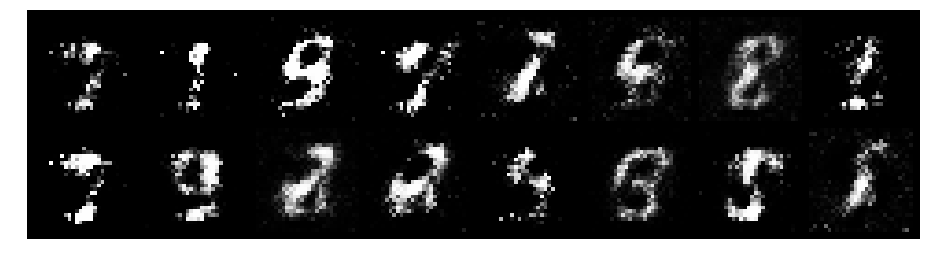

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 0.9635, Generator Loss: 1.0888
D(x): 0.7448, D(G(z)): 0.4158


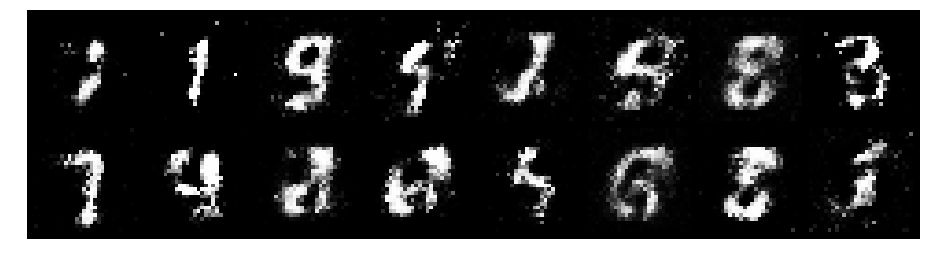

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.7453, Generator Loss: 2.2634
D(x): 0.7701, D(G(z)): 0.2643


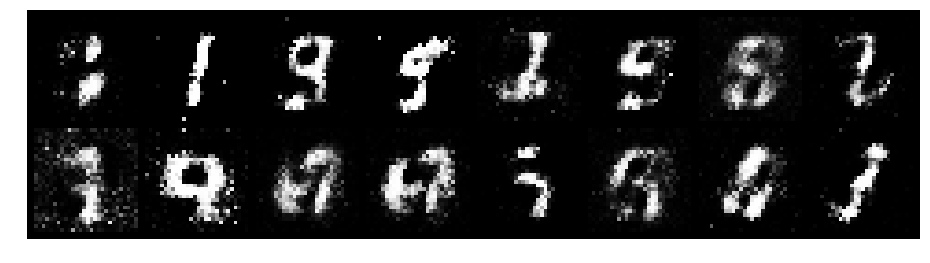

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.9541, Generator Loss: 2.2537
D(x): 0.7607, D(G(z)): 0.3147


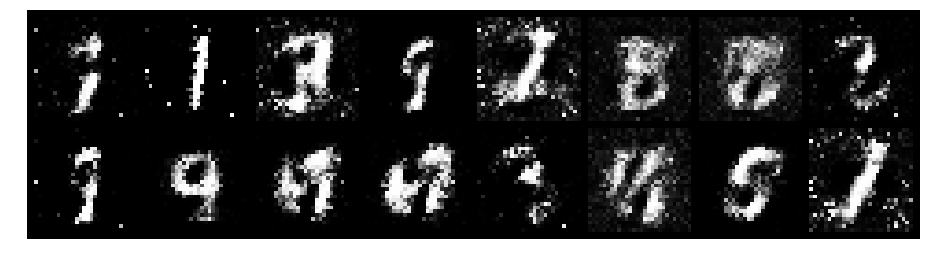

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.8604, Generator Loss: 2.1496
D(x): 0.7272, D(G(z)): 0.2513


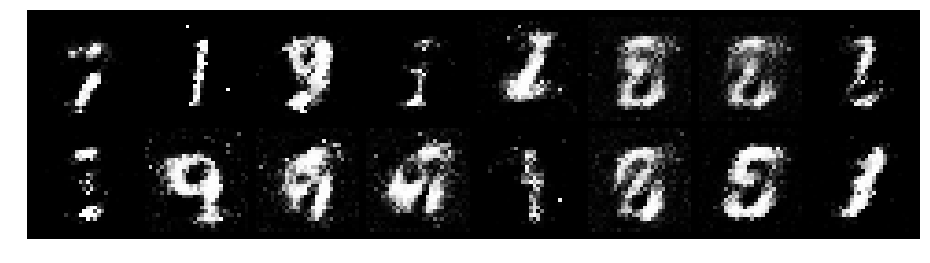

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.5504, Generator Loss: 2.0167
D(x): 0.8261, D(G(z)): 0.1953


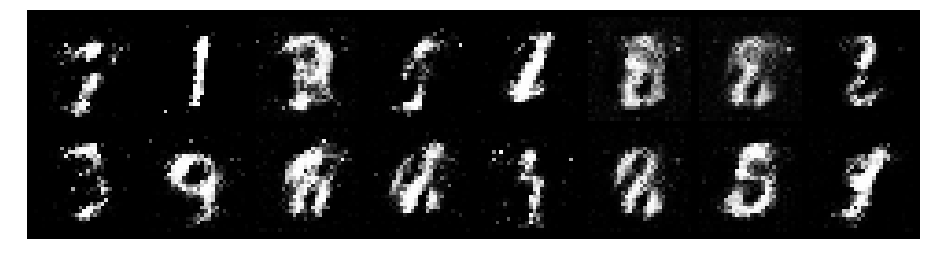

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.6393, Generator Loss: 2.1940
D(x): 0.8058, D(G(z)): 0.2235


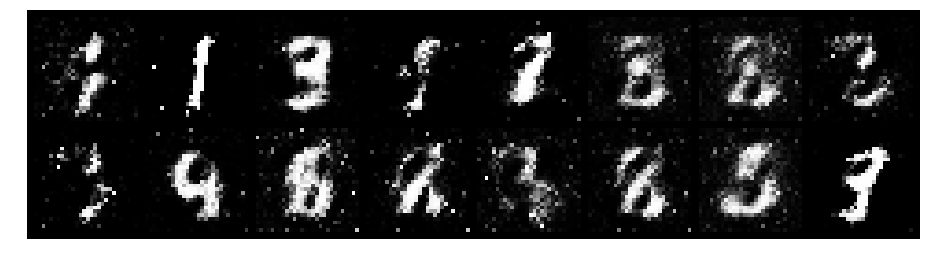

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.7041, Generator Loss: 1.9643
D(x): 0.7734, D(G(z)): 0.2305


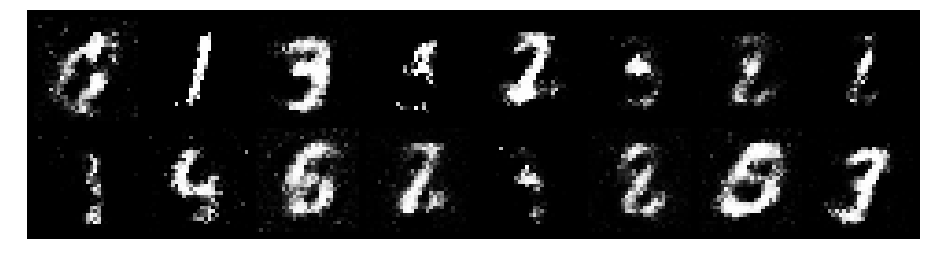

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.7130, Generator Loss: 1.8160
D(x): 0.7434, D(G(z)): 0.1758


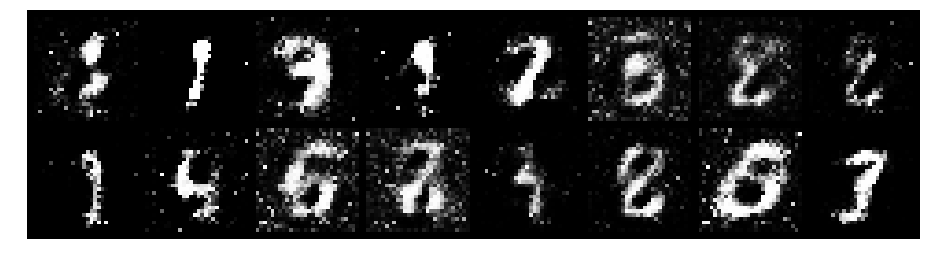

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.9170, Generator Loss: 1.7251
D(x): 0.7091, D(G(z)): 0.2601


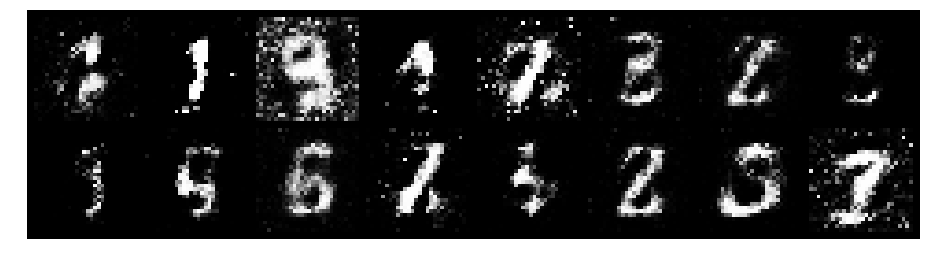

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 0.6924, Generator Loss: 2.1038
D(x): 0.7701, D(G(z)): 0.2216


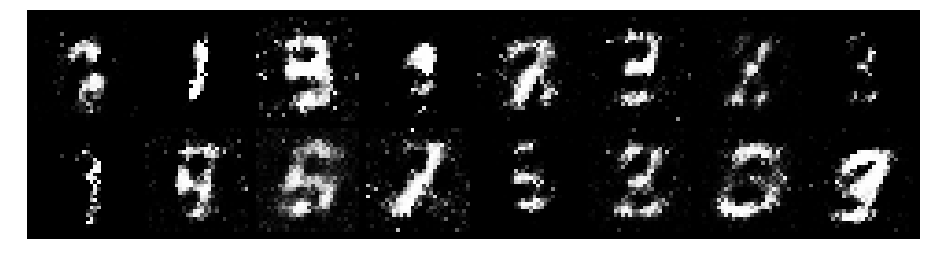

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.7541, Generator Loss: 1.2289
D(x): 0.7801, D(G(z)): 0.3242


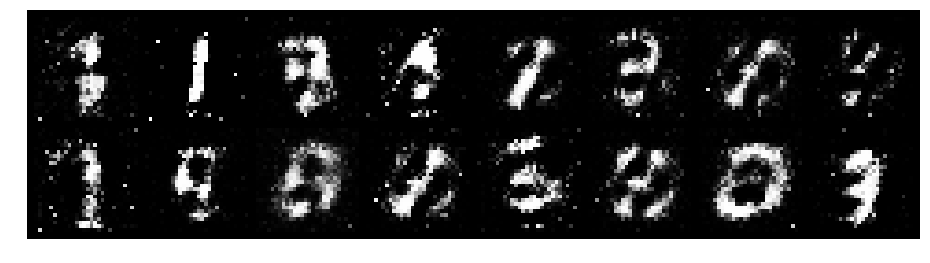

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 0.8068, Generator Loss: 1.8975
D(x): 0.6415, D(G(z)): 0.1837


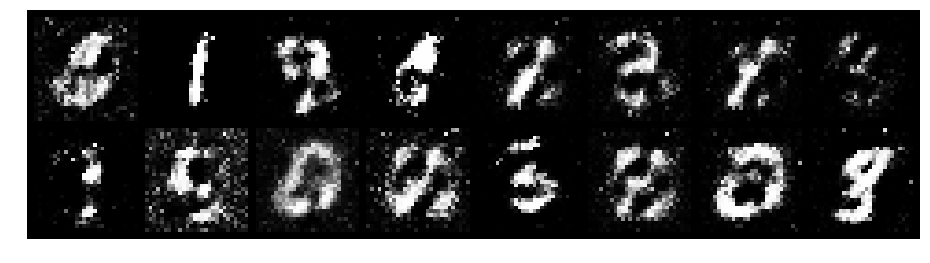

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 0.9747, Generator Loss: 1.4827
D(x): 0.6790, D(G(z)): 0.3175


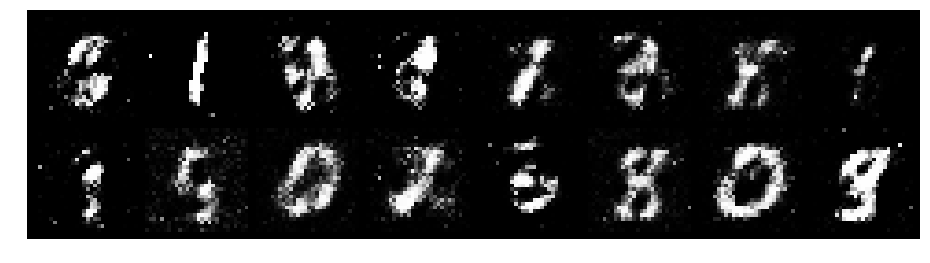

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.9782, Generator Loss: 1.2895
D(x): 0.7237, D(G(z)): 0.3601


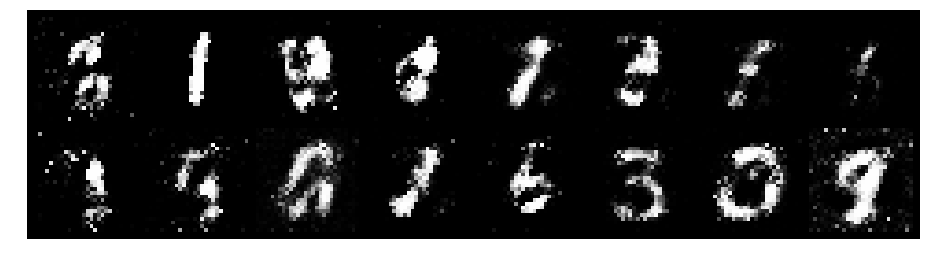

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.8286, Generator Loss: 1.4869
D(x): 0.6905, D(G(z)): 0.2702


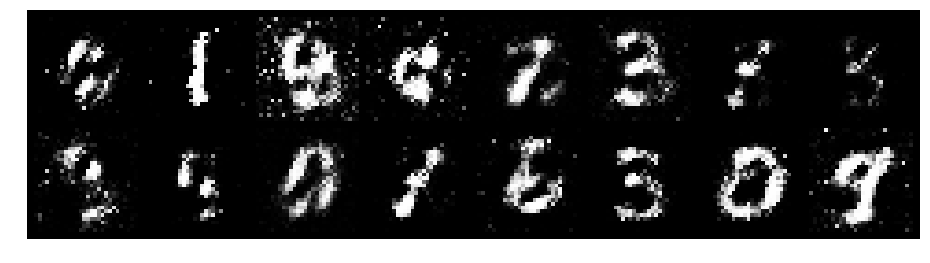

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 0.7271, Generator Loss: 2.0779
D(x): 0.7584, D(G(z)): 0.2547


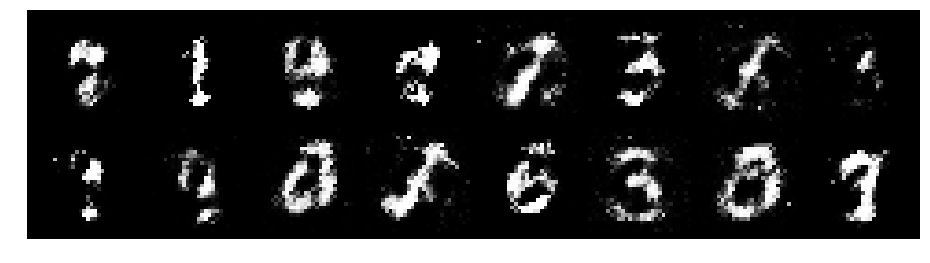

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 1.0086, Generator Loss: 1.4531
D(x): 0.7198, D(G(z)): 0.3215


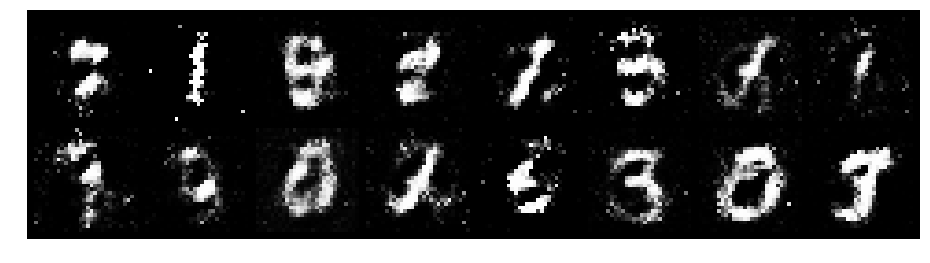

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.5892, Generator Loss: 2.3353
D(x): 0.8350, D(G(z)): 0.2107


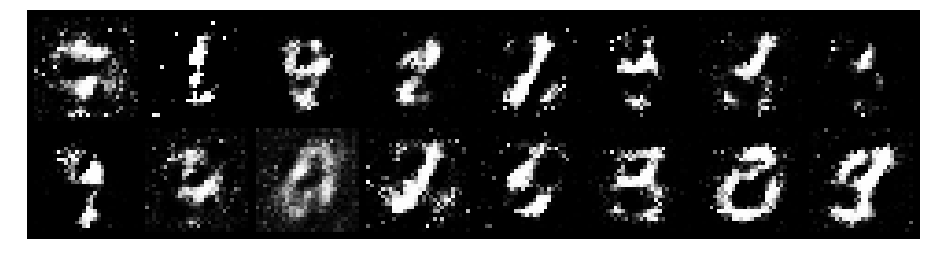

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 0.6945, Generator Loss: 1.8576
D(x): 0.7550, D(G(z)): 0.2403


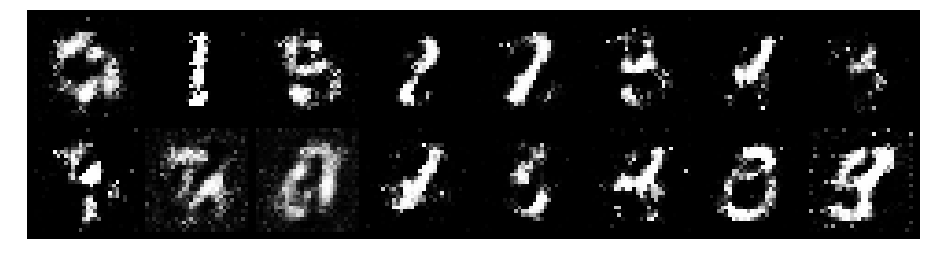

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 0.8647, Generator Loss: 1.4589
D(x): 0.6989, D(G(z)): 0.2594


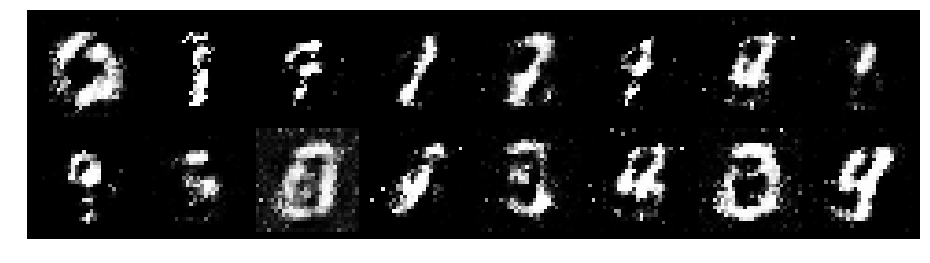

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 1.1195, Generator Loss: 1.1340
D(x): 0.6212, D(G(z)): 0.3690


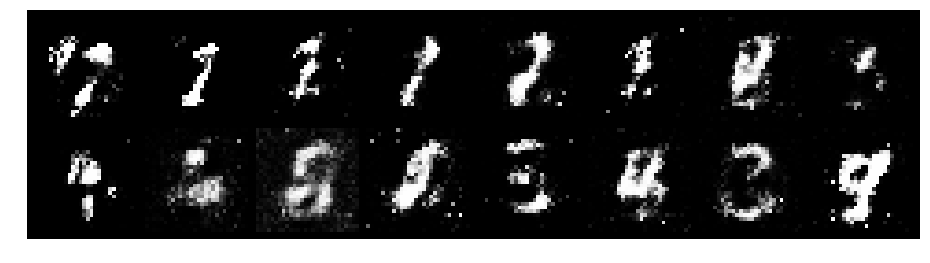

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 1.0547, Generator Loss: 1.5818
D(x): 0.6188, D(G(z)): 0.2289


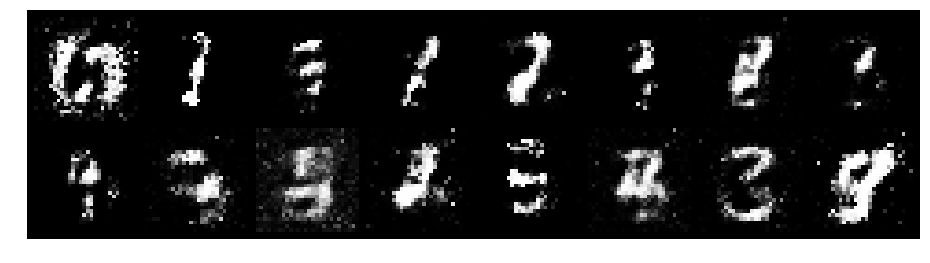

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.8221, Generator Loss: 1.7364
D(x): 0.6974, D(G(z)): 0.2601


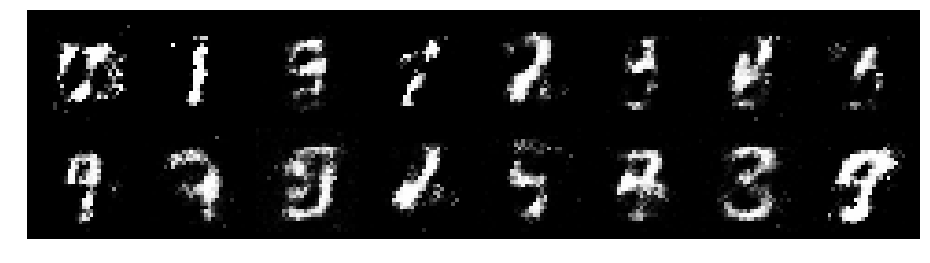

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 0.8520, Generator Loss: 1.1641
D(x): 0.7574, D(G(z)): 0.3385


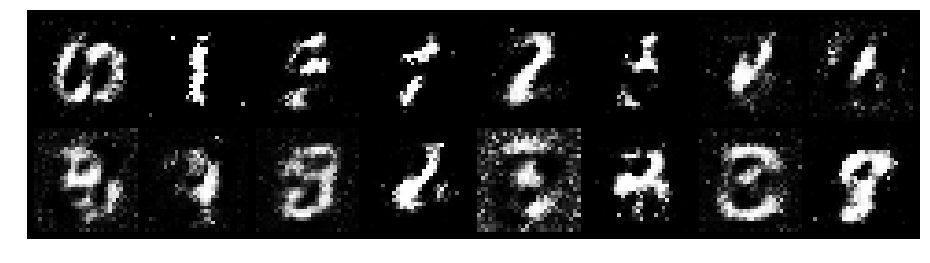

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 1.0277, Generator Loss: 1.9075
D(x): 0.6501, D(G(z)): 0.2429


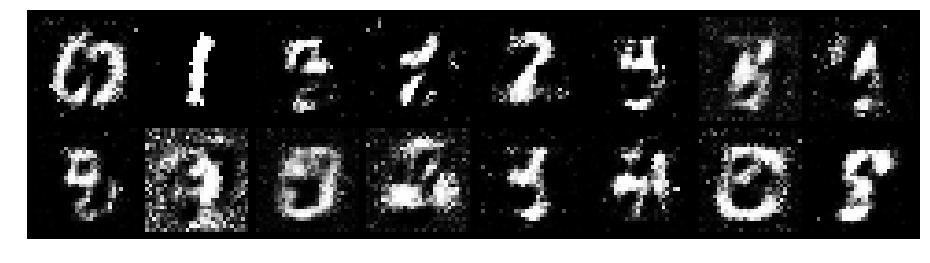

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 1.0728, Generator Loss: 1.9792
D(x): 0.6695, D(G(z)): 0.2865


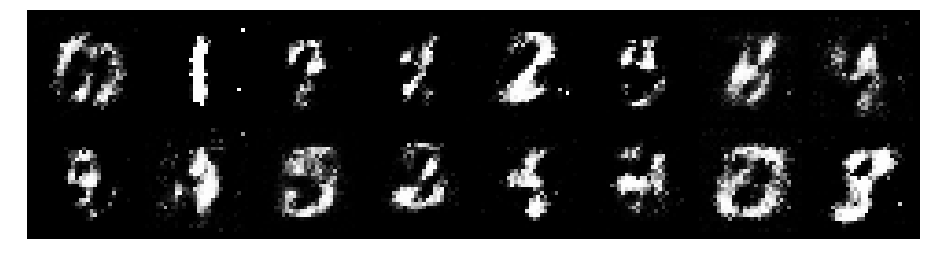

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.7428, Generator Loss: 1.8037
D(x): 0.7741, D(G(z)): 0.2402


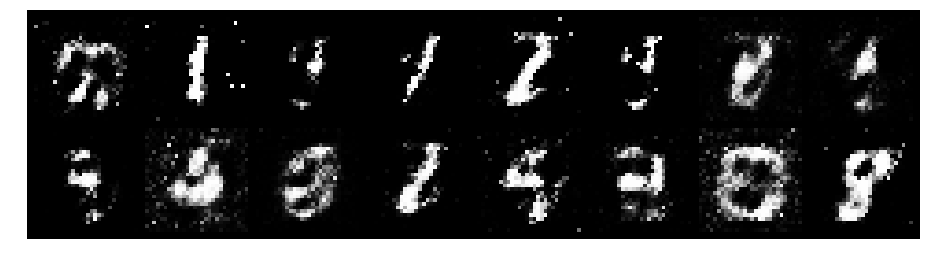

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 0.8461, Generator Loss: 1.2229
D(x): 0.7796, D(G(z)): 0.3856


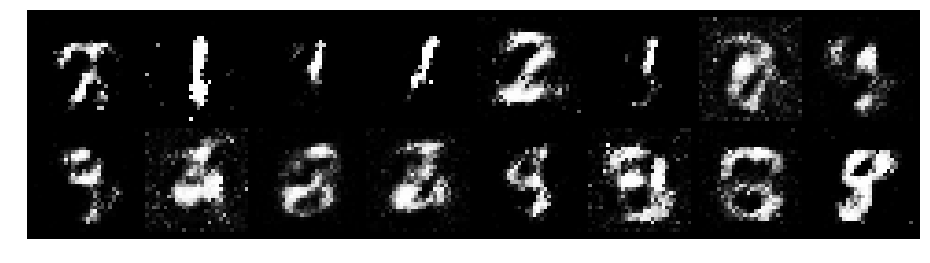

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 0.9466, Generator Loss: 2.5055
D(x): 0.6597, D(G(z)): 0.2360


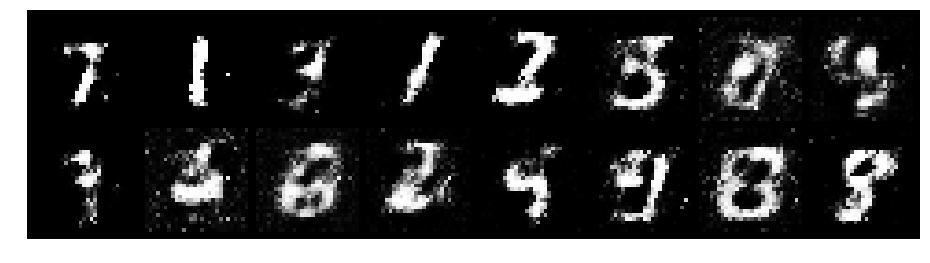

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 1.2166, Generator Loss: 1.6839
D(x): 0.5675, D(G(z)): 0.2310


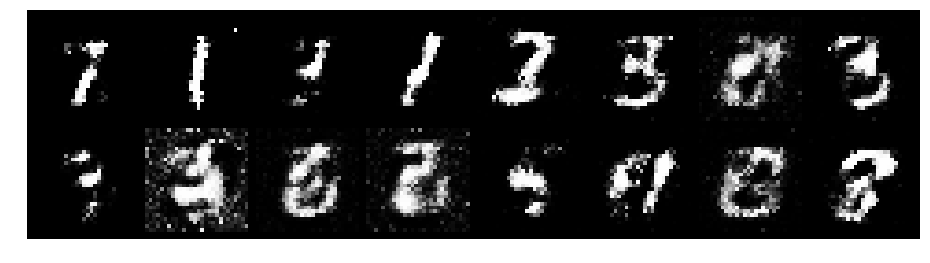

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.7686, Generator Loss: 2.2304
D(x): 0.7075, D(G(z)): 0.2127


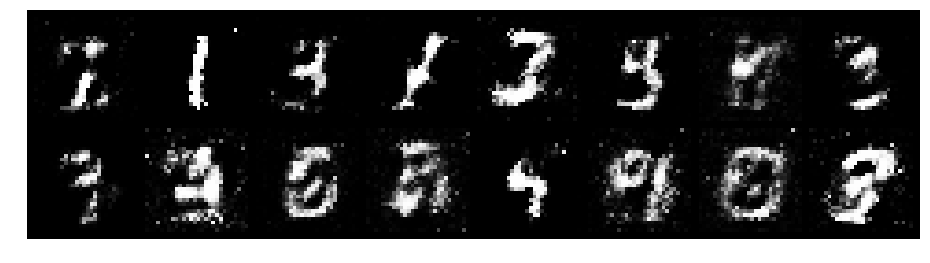

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 0.9800, Generator Loss: 1.3481
D(x): 0.6680, D(G(z)): 0.3360


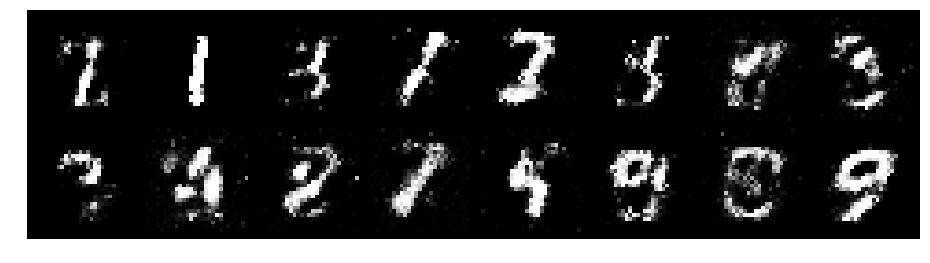

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 1.1830, Generator Loss: 1.1743
D(x): 0.6368, D(G(z)): 0.3838


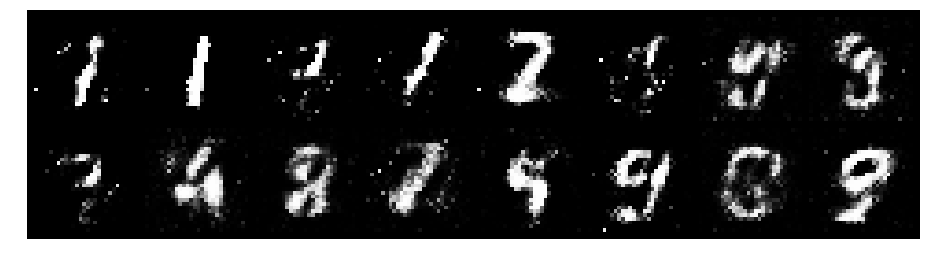

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 1.0651, Generator Loss: 1.1835
D(x): 0.6364, D(G(z)): 0.3312


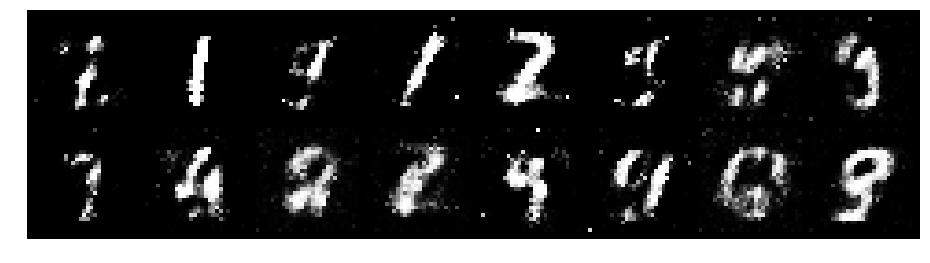

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 0.9263, Generator Loss: 1.9232
D(x): 0.7083, D(G(z)): 0.3013


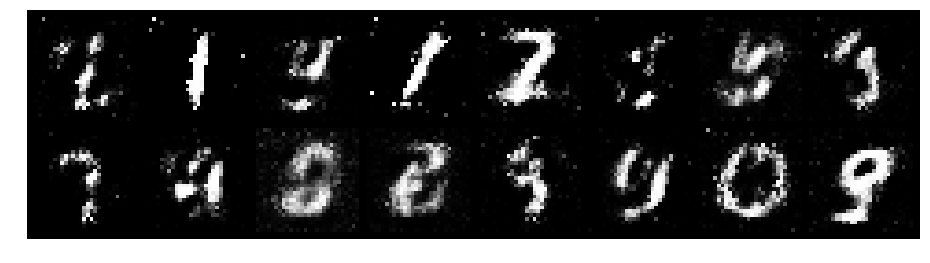

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 0.8513, Generator Loss: 1.5319
D(x): 0.7598, D(G(z)): 0.3428


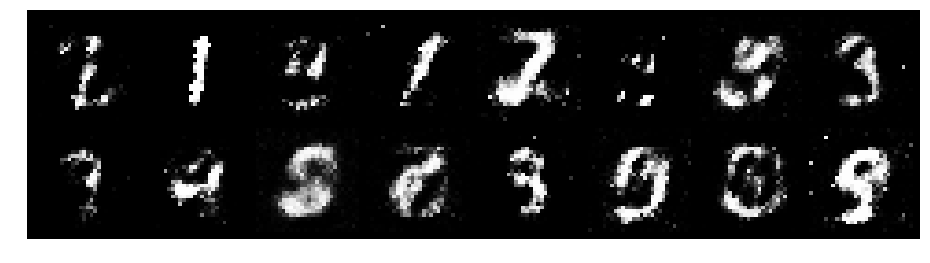

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 0.9978, Generator Loss: 1.3212
D(x): 0.6837, D(G(z)): 0.3237


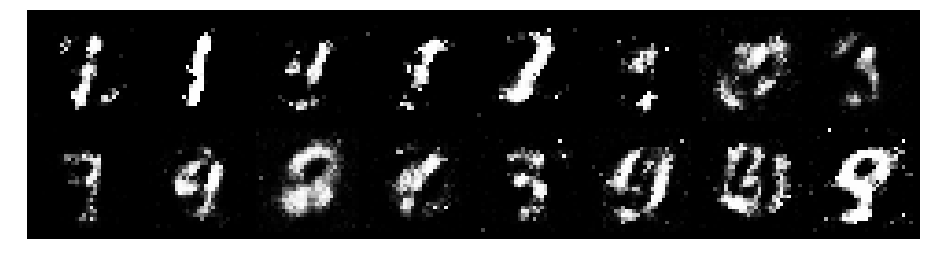

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.9464, Generator Loss: 1.4628
D(x): 0.7302, D(G(z)): 0.3382


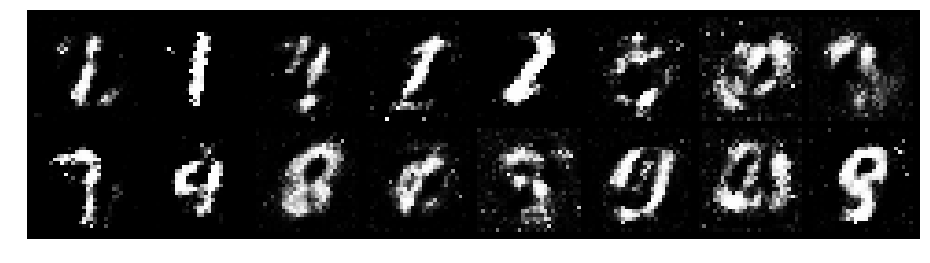

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 1.0687, Generator Loss: 1.7086
D(x): 0.5954, D(G(z)): 0.2418


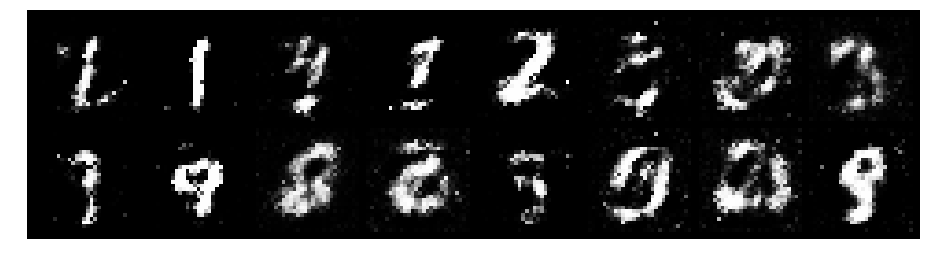

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 0.6318, Generator Loss: 2.1152
D(x): 0.7619, D(G(z)): 0.1900


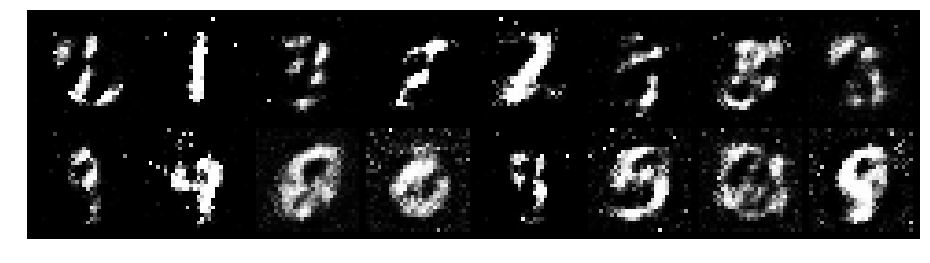

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 0.8487, Generator Loss: 2.1779
D(x): 0.6901, D(G(z)): 0.2266


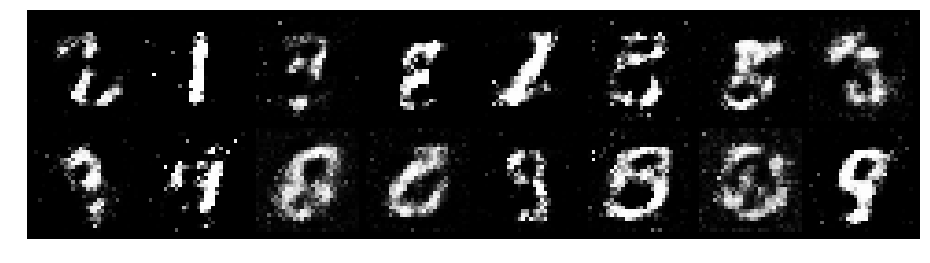

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 1.0197, Generator Loss: 1.2065
D(x): 0.6990, D(G(z)): 0.3812


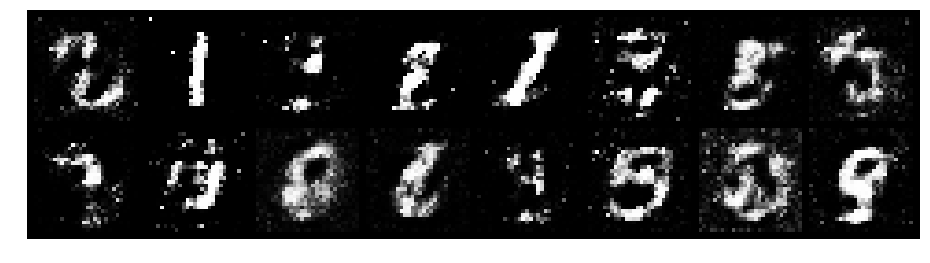

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 1.0098, Generator Loss: 1.4127
D(x): 0.5895, D(G(z)): 0.2817


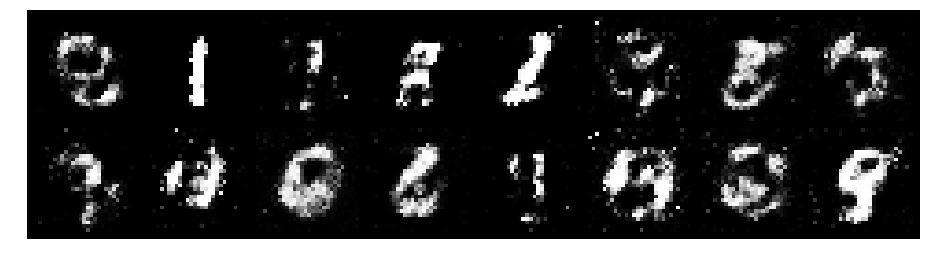

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 0.9790, Generator Loss: 1.2376
D(x): 0.6815, D(G(z)): 0.3189


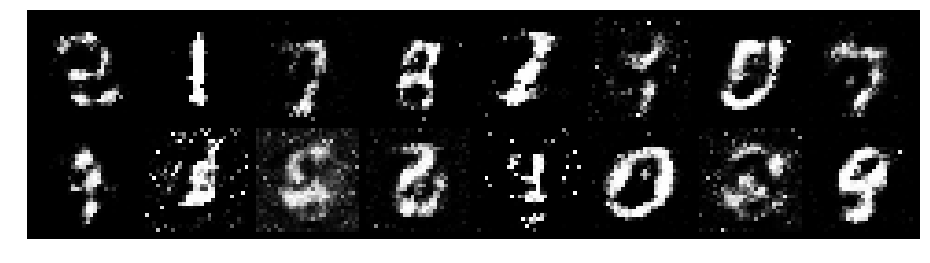

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 1.1461, Generator Loss: 1.2471
D(x): 0.5874, D(G(z)): 0.3171


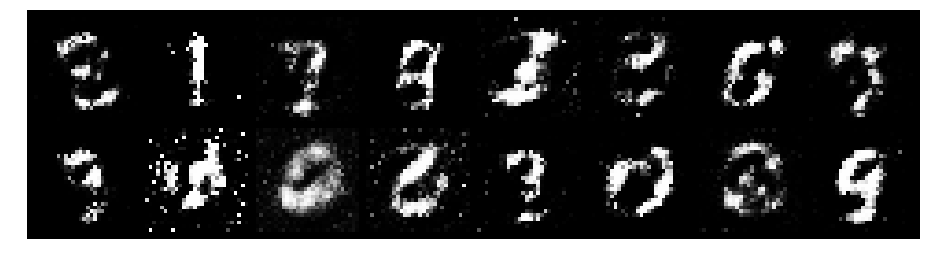

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 1.0757, Generator Loss: 1.4898
D(x): 0.6942, D(G(z)): 0.3511


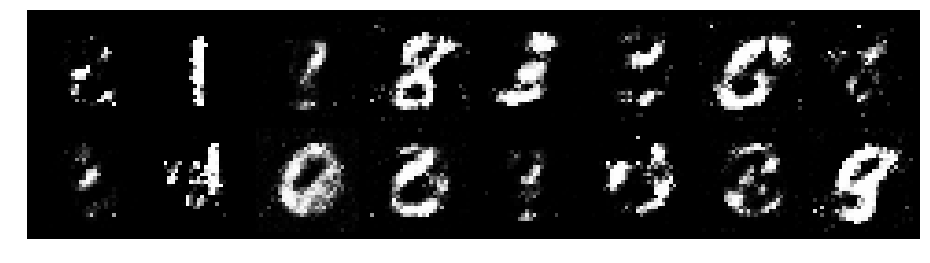

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 1.0360, Generator Loss: 1.1921
D(x): 0.6279, D(G(z)): 0.3370


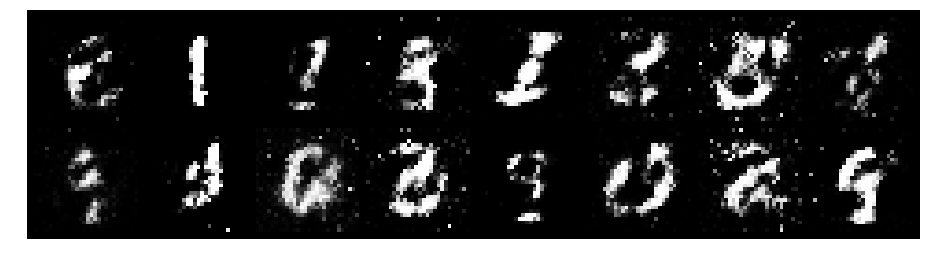

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 1.0322, Generator Loss: 1.3200
D(x): 0.6620, D(G(z)): 0.3250


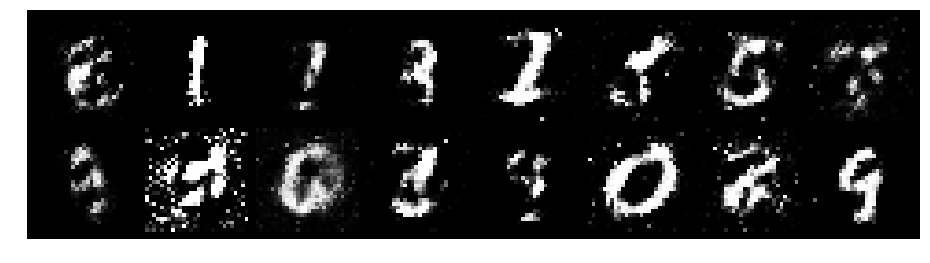

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 1.4115, Generator Loss: 1.3049
D(x): 0.6026, D(G(z)): 0.4587


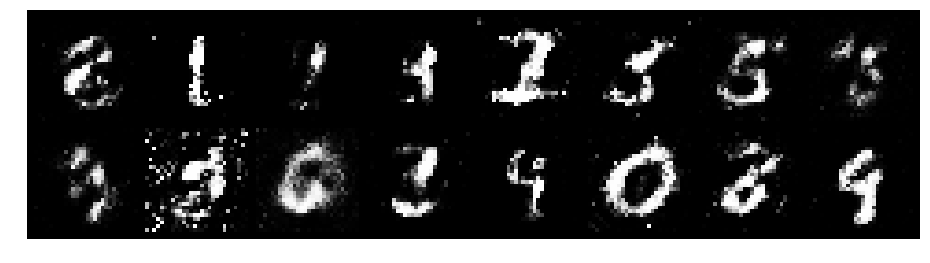

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 1.0945, Generator Loss: 1.3237
D(x): 0.5996, D(G(z)): 0.2796


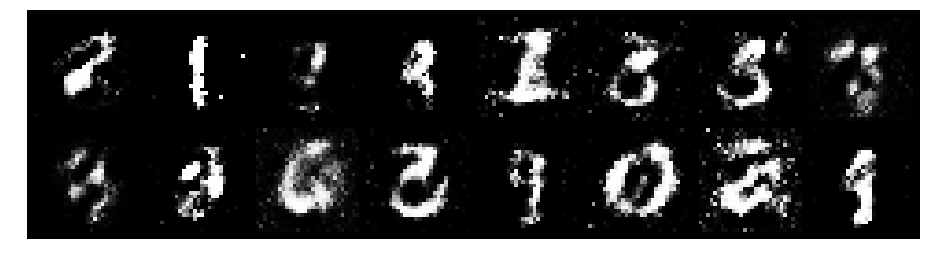

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 1.1818, Generator Loss: 1.2775
D(x): 0.6874, D(G(z)): 0.4057


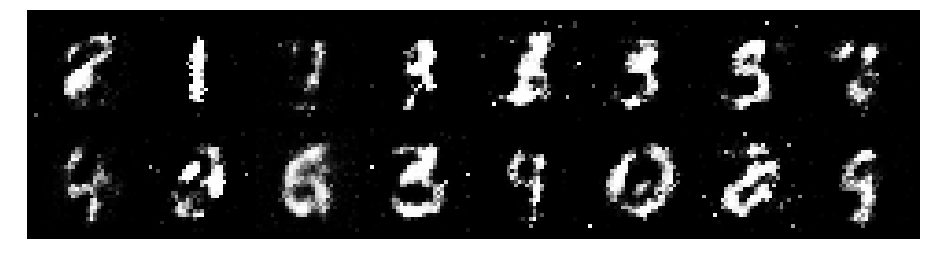

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 1.0280, Generator Loss: 1.3919
D(x): 0.7231, D(G(z)): 0.3869


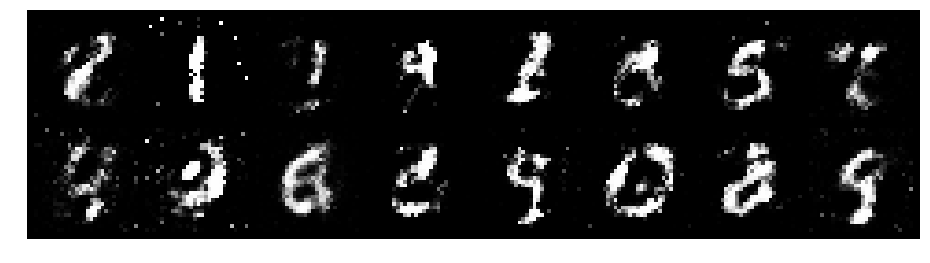

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 0.9945, Generator Loss: 1.4101
D(x): 0.6977, D(G(z)): 0.3664


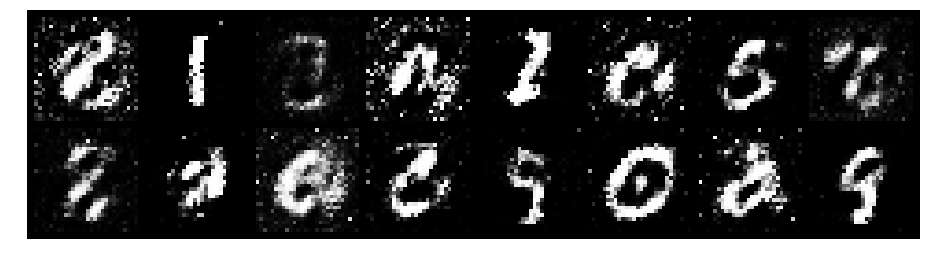

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 1.0494, Generator Loss: 1.3234
D(x): 0.6595, D(G(z)): 0.3514


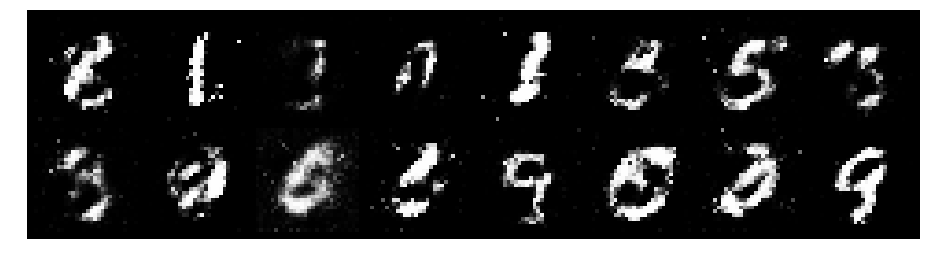

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 0.9973, Generator Loss: 1.6386
D(x): 0.6509, D(G(z)): 0.3003


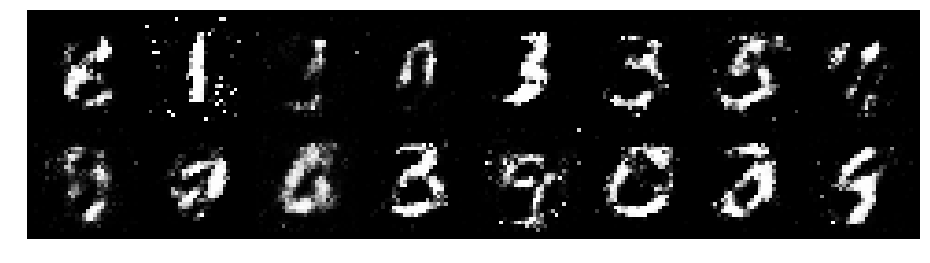

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 1.1560, Generator Loss: 1.5205
D(x): 0.6145, D(G(z)): 0.3104


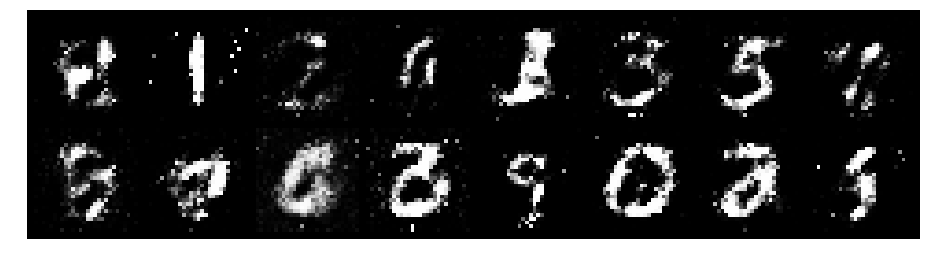

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 1.2092, Generator Loss: 1.3823
D(x): 0.5561, D(G(z)): 0.3318


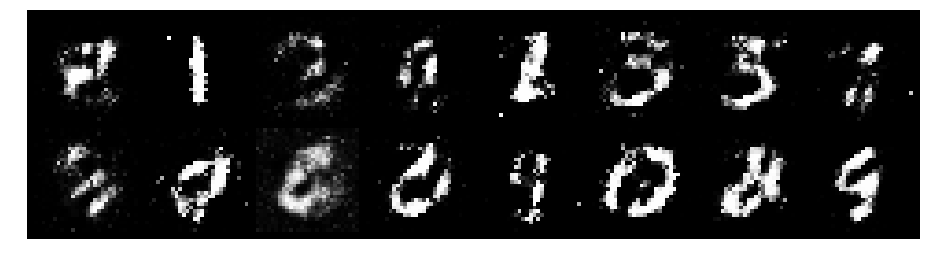

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 0.9151, Generator Loss: 1.2957
D(x): 0.7020, D(G(z)): 0.3360


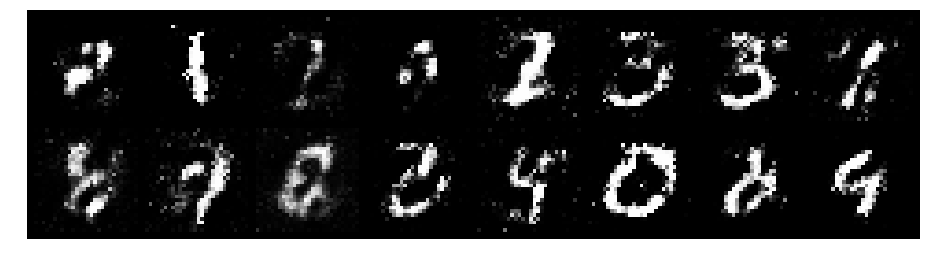

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 1.1036, Generator Loss: 1.1412
D(x): 0.6240, D(G(z)): 0.3677


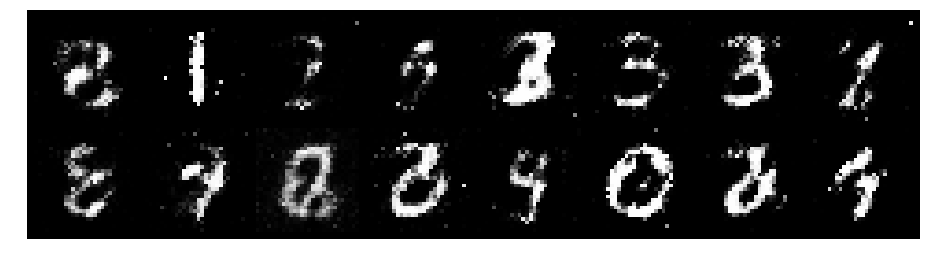

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 1.1033, Generator Loss: 1.1498
D(x): 0.7165, D(G(z)): 0.4367


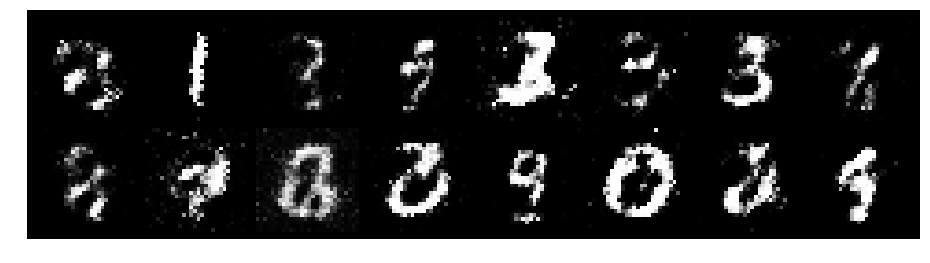

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 0.8659, Generator Loss: 1.4381
D(x): 0.7129, D(G(z)): 0.3123


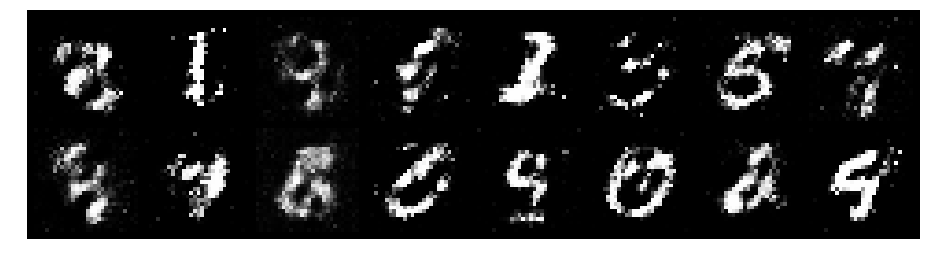

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 0.9017, Generator Loss: 1.3315
D(x): 0.6845, D(G(z)): 0.3063


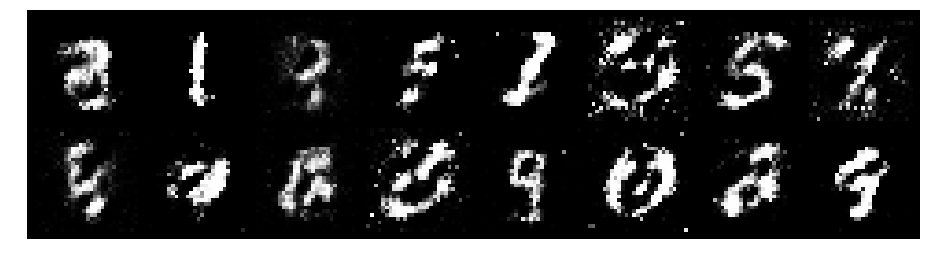

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.9361, Generator Loss: 1.1723
D(x): 0.7016, D(G(z)): 0.3585


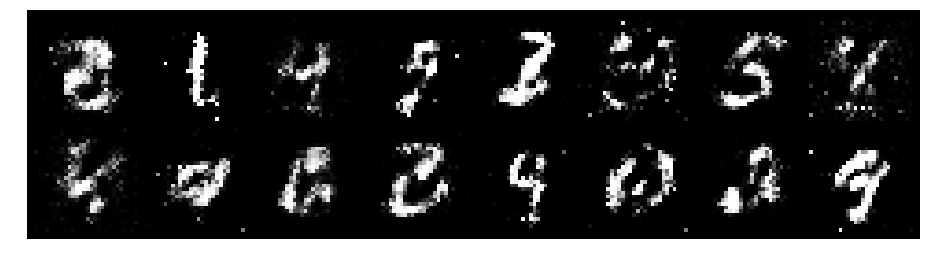

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 0.9578, Generator Loss: 1.3669
D(x): 0.6635, D(G(z)): 0.3149


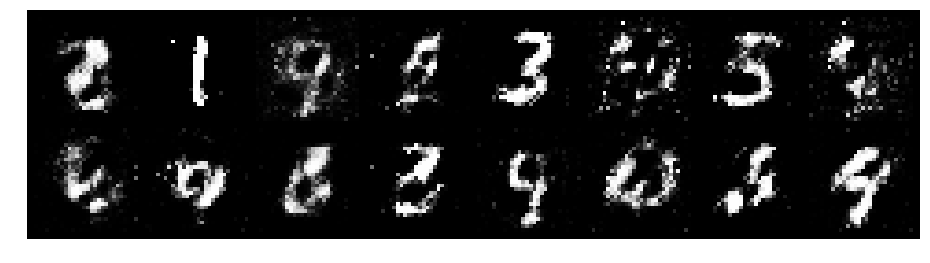

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 0.9455, Generator Loss: 1.5297
D(x): 0.6692, D(G(z)): 0.3068


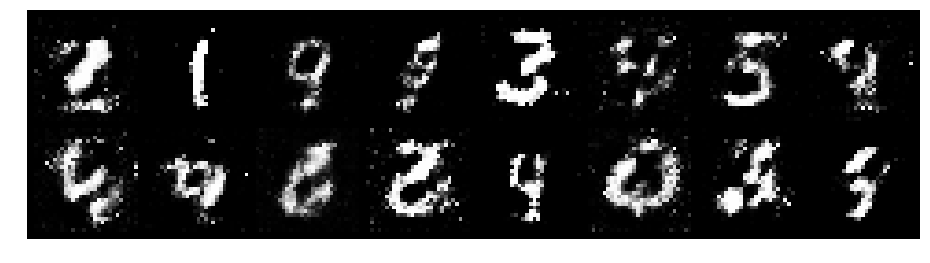

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 0.9072, Generator Loss: 1.2919
D(x): 0.6677, D(G(z)): 0.3158


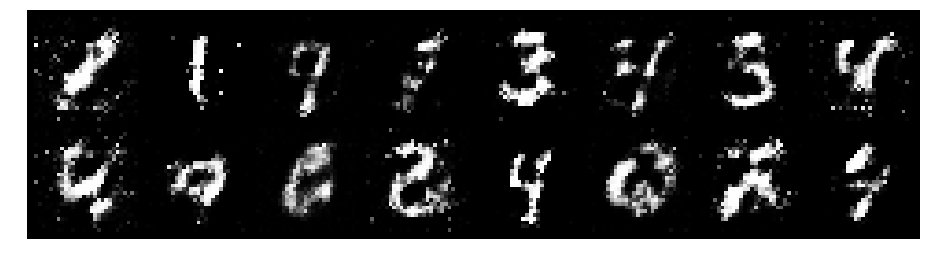

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 1.0536, Generator Loss: 1.3355
D(x): 0.6575, D(G(z)): 0.3663


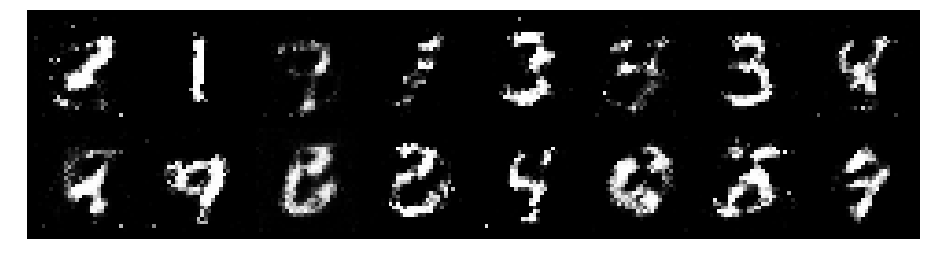

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 1.0296, Generator Loss: 1.5786
D(x): 0.6837, D(G(z)): 0.2904


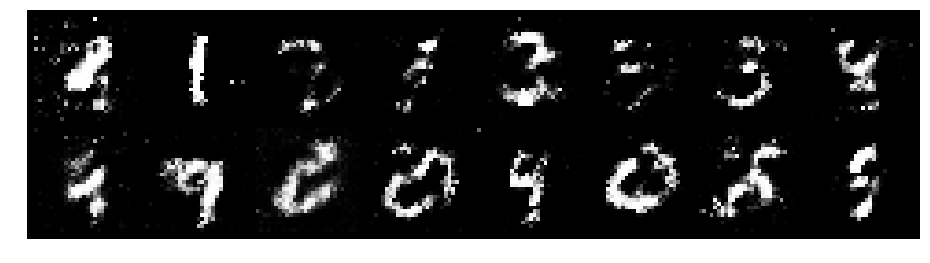

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 0.8979, Generator Loss: 1.5418
D(x): 0.7448, D(G(z)): 0.3628


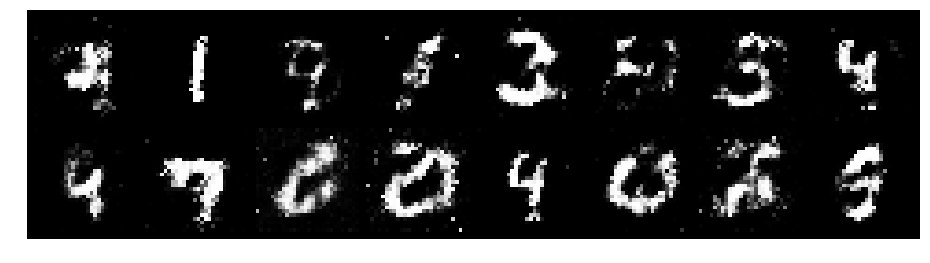

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 0.7940, Generator Loss: 1.6364
D(x): 0.7399, D(G(z)): 0.2821


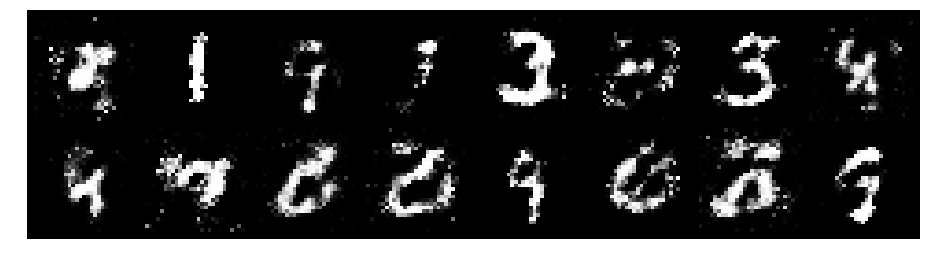

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 1.0039, Generator Loss: 1.3992
D(x): 0.6360, D(G(z)): 0.2824


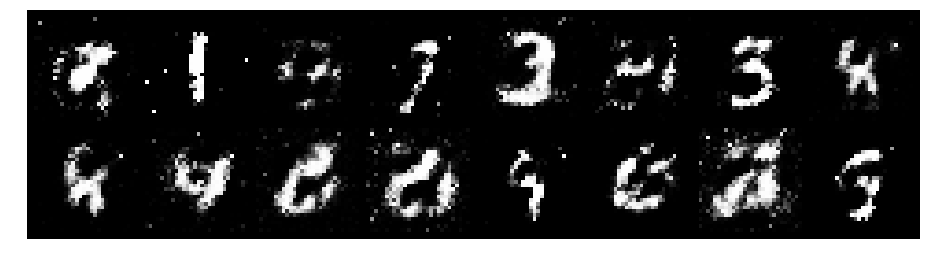

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 1.0200, Generator Loss: 1.6824
D(x): 0.6257, D(G(z)): 0.3235


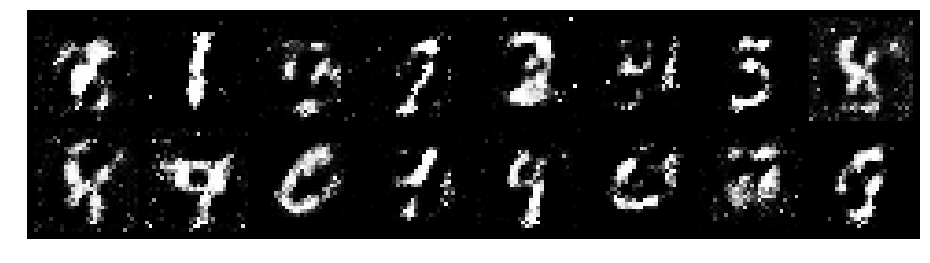

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 1.0727, Generator Loss: 1.1451
D(x): 0.6323, D(G(z)): 0.3768


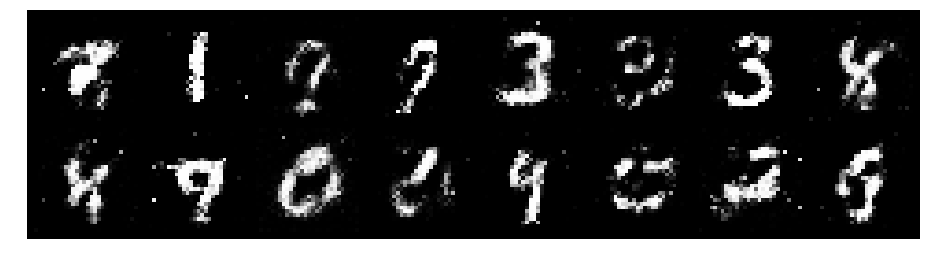

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 1.0176, Generator Loss: 1.3113
D(x): 0.6681, D(G(z)): 0.3627


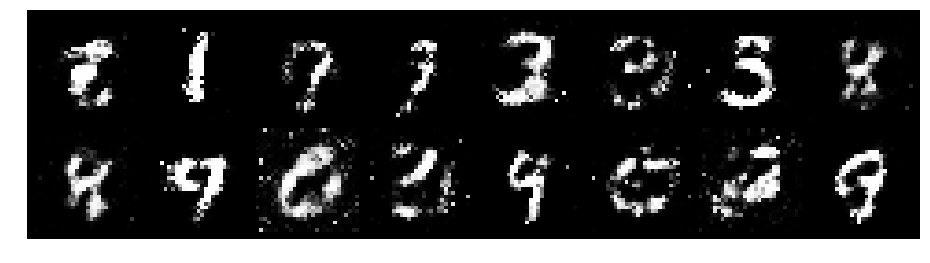

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 0.7429, Generator Loss: 1.6104
D(x): 0.7448, D(G(z)): 0.2788


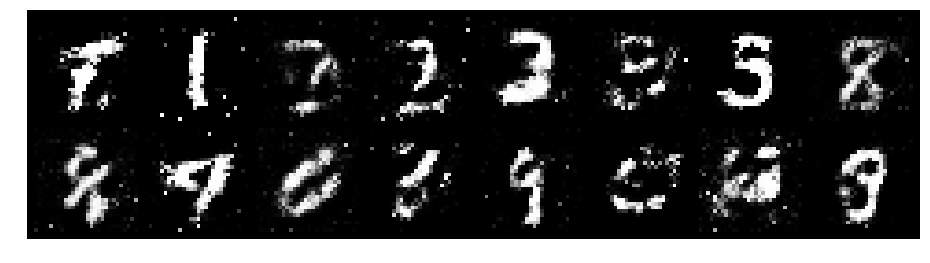

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 0.8236, Generator Loss: 1.4966
D(x): 0.6892, D(G(z)): 0.2786


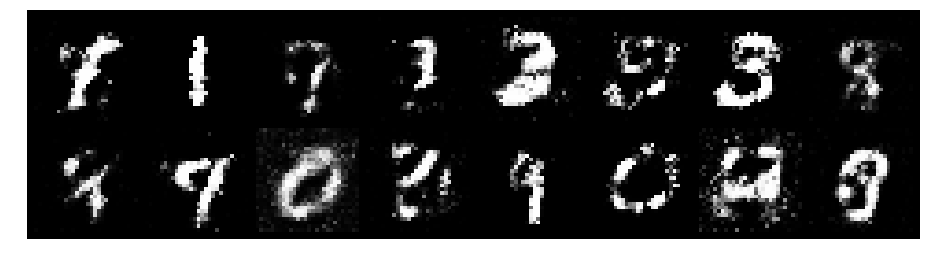

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 0.9070, Generator Loss: 1.6247
D(x): 0.7578, D(G(z)): 0.3323


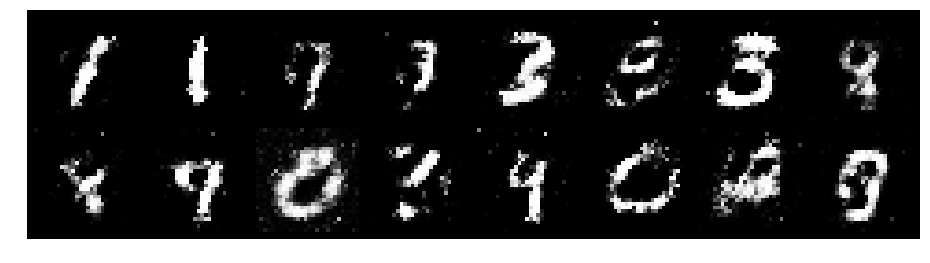

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 0.7045, Generator Loss: 1.6009
D(x): 0.7301, D(G(z)): 0.2372


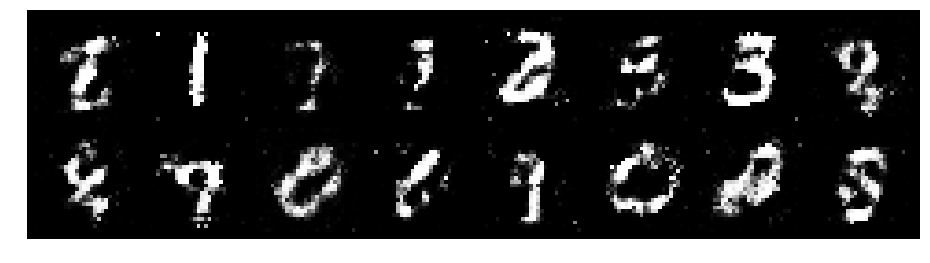

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 0.8613, Generator Loss: 1.5145
D(x): 0.7327, D(G(z)): 0.3019


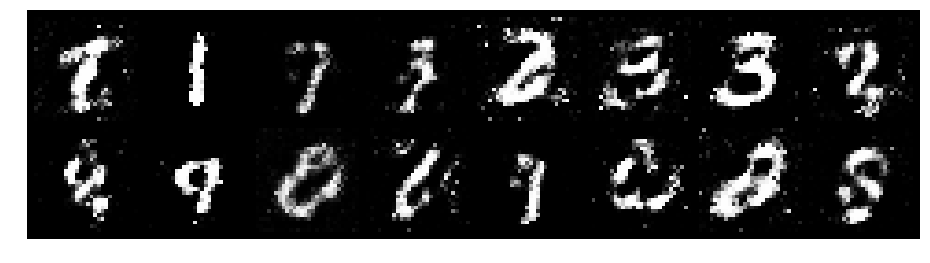

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 1.0831, Generator Loss: 1.1836
D(x): 0.6835, D(G(z)): 0.3865


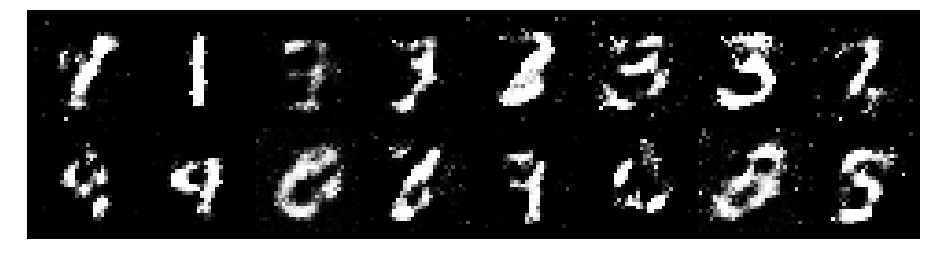

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 1.1372, Generator Loss: 1.6005
D(x): 0.6537, D(G(z)): 0.3416


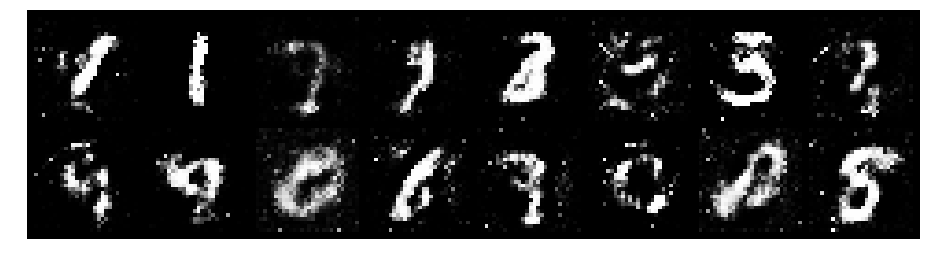

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 1.2948, Generator Loss: 1.1851
D(x): 0.5667, D(G(z)): 0.3788


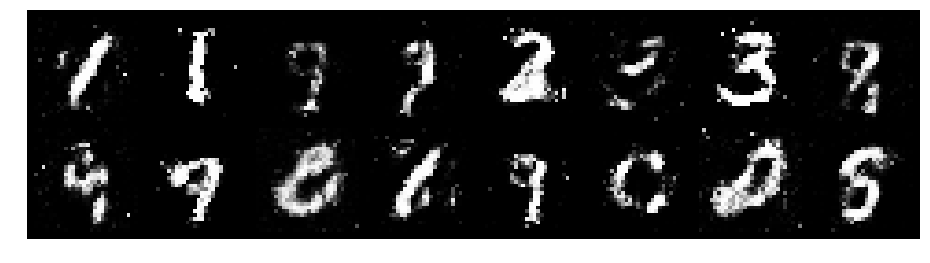

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 1.1201, Generator Loss: 1.4650
D(x): 0.6157, D(G(z)): 0.3227


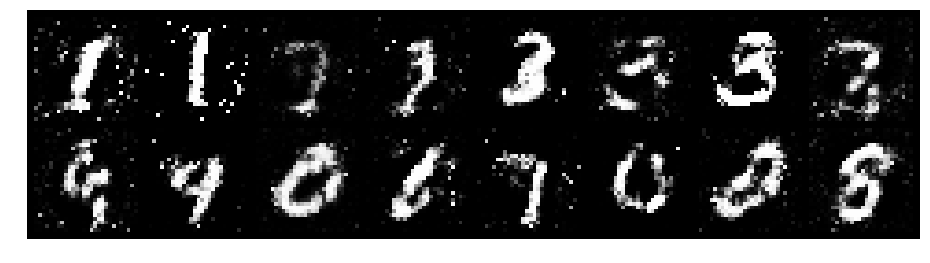

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 0.9052, Generator Loss: 1.5973
D(x): 0.6676, D(G(z)): 0.2784


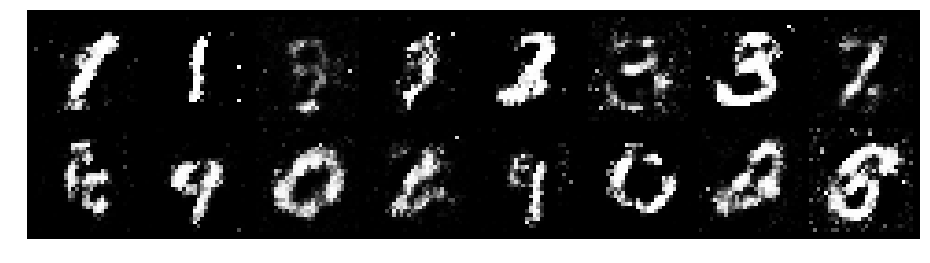

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 0.9684, Generator Loss: 1.3123
D(x): 0.6304, D(G(z)): 0.3247


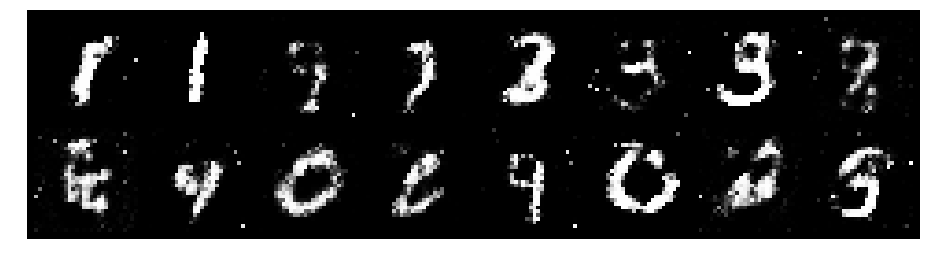

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 1.0483, Generator Loss: 1.0805
D(x): 0.6921, D(G(z)): 0.4081


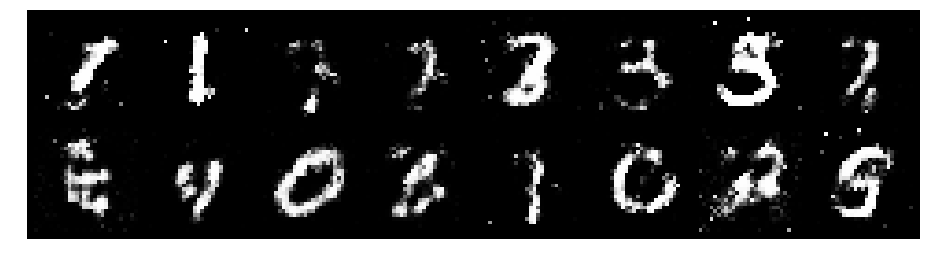

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 1.2419, Generator Loss: 1.1118
D(x): 0.5947, D(G(z)): 0.4111


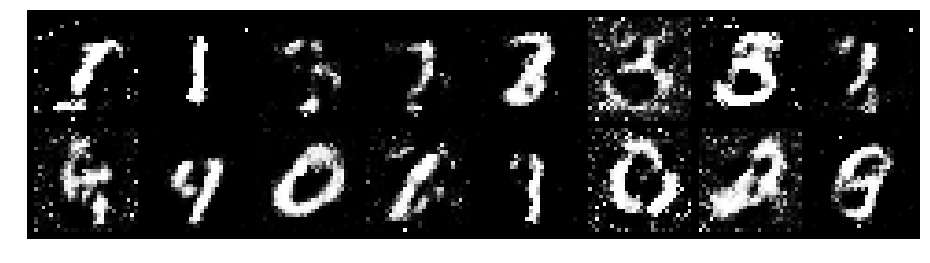

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 1.0118, Generator Loss: 1.2594
D(x): 0.7074, D(G(z)): 0.3636


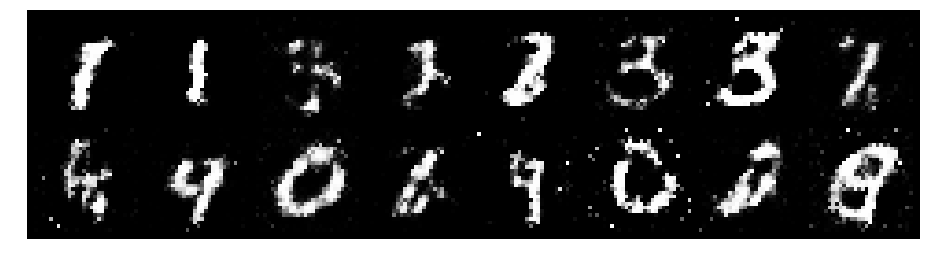

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 1.1592, Generator Loss: 1.2807
D(x): 0.6653, D(G(z)): 0.4239


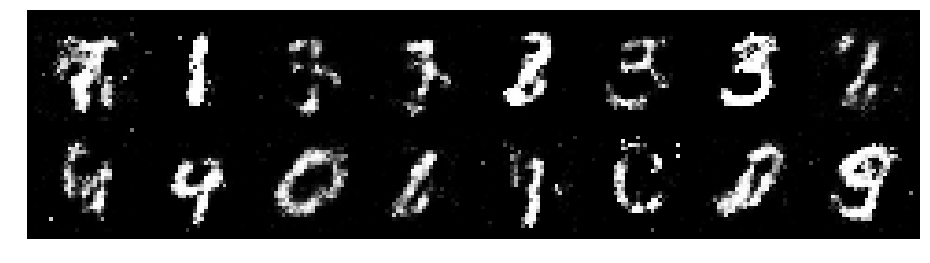

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 1.1298, Generator Loss: 1.2709
D(x): 0.6549, D(G(z)): 0.3666


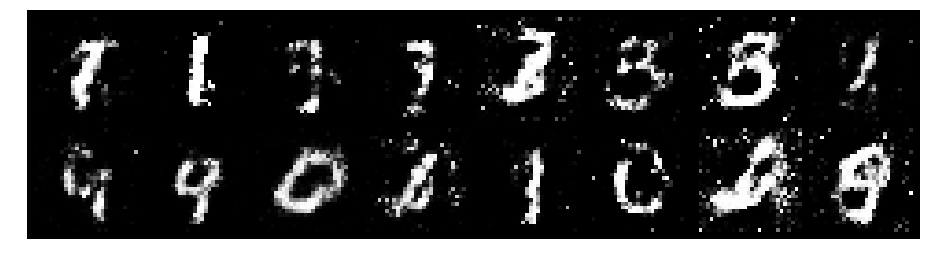

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 1.1840, Generator Loss: 0.9715
D(x): 0.5877, D(G(z)): 0.3571


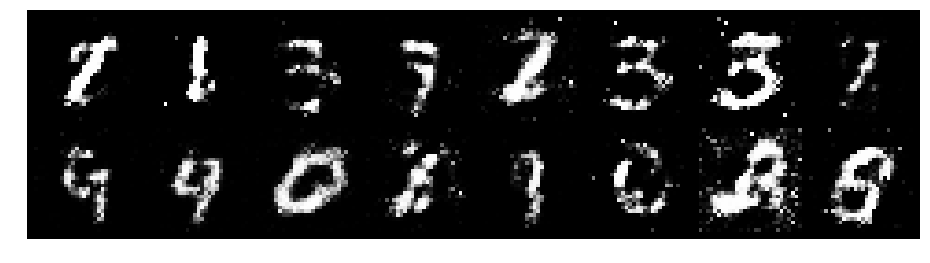

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 1.3163, Generator Loss: 1.0870
D(x): 0.5395, D(G(z)): 0.3737


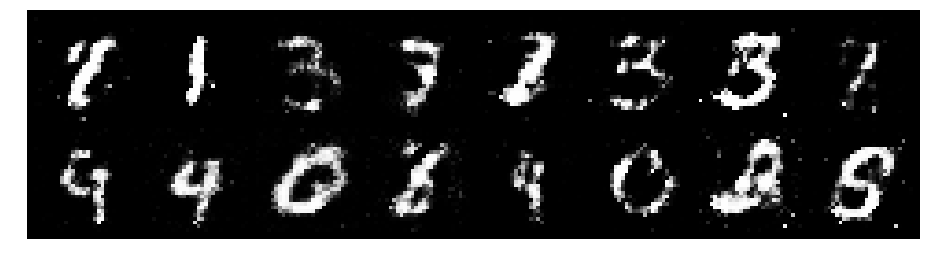

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 1.2412, Generator Loss: 1.3676
D(x): 0.6416, D(G(z)): 0.4279


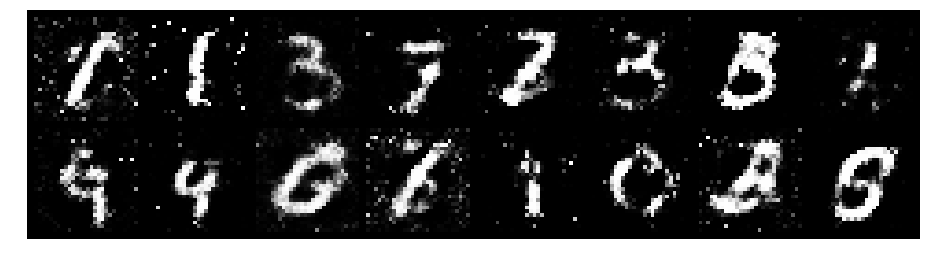

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 1.0065, Generator Loss: 1.3466
D(x): 0.6353, D(G(z)): 0.3214


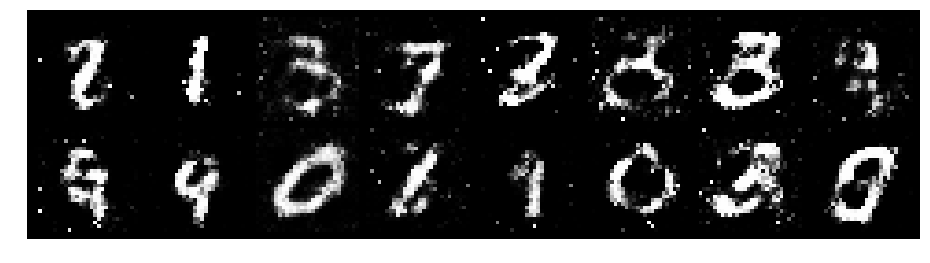

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 0.8779, Generator Loss: 1.3029
D(x): 0.6889, D(G(z)): 0.3233


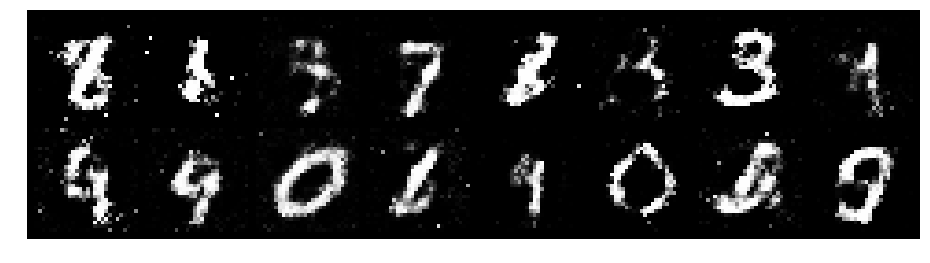

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 0.9809, Generator Loss: 1.3359
D(x): 0.6873, D(G(z)): 0.3530


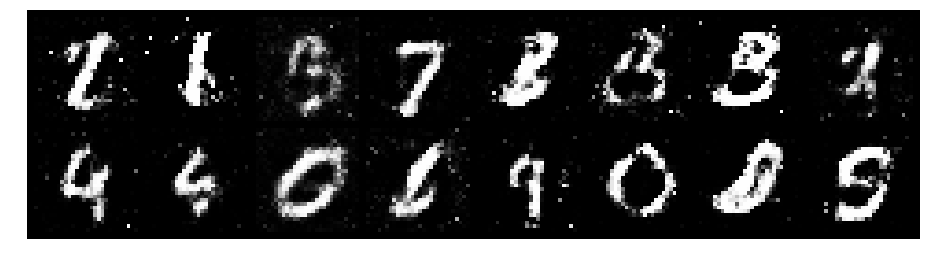

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 1.0802, Generator Loss: 1.1600
D(x): 0.6796, D(G(z)): 0.3950


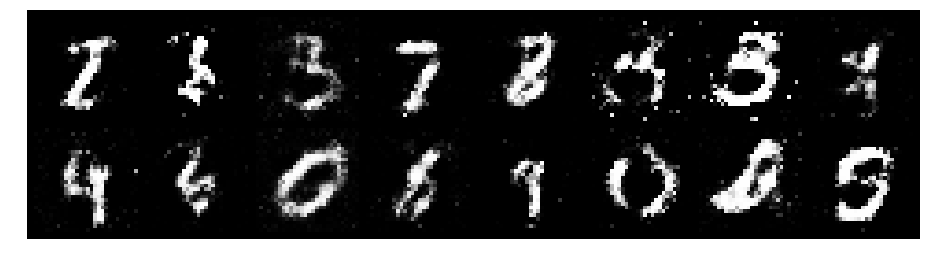

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 0.8990, Generator Loss: 1.5755
D(x): 0.6903, D(G(z)): 0.2992


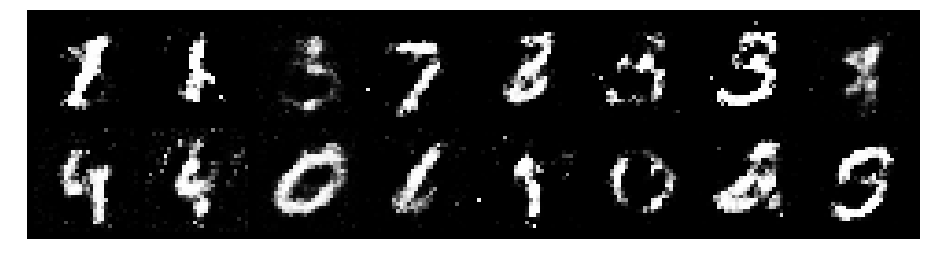

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 0.9184, Generator Loss: 1.6193
D(x): 0.6776, D(G(z)): 0.2653


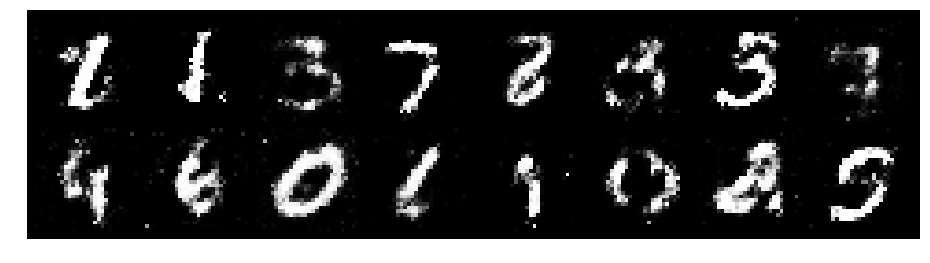

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 1.2433, Generator Loss: 1.0457
D(x): 0.6053, D(G(z)): 0.3554


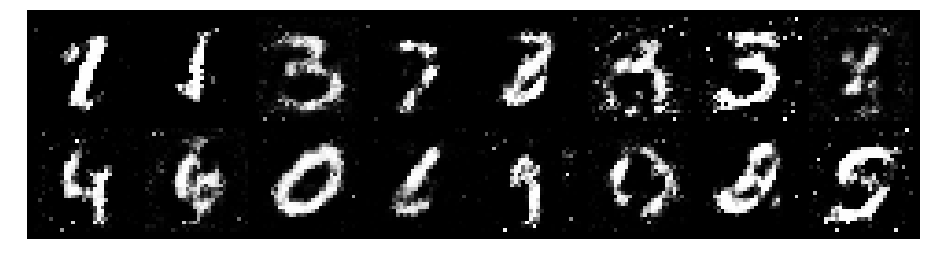

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 1.0438, Generator Loss: 0.9490
D(x): 0.6338, D(G(z)): 0.3476


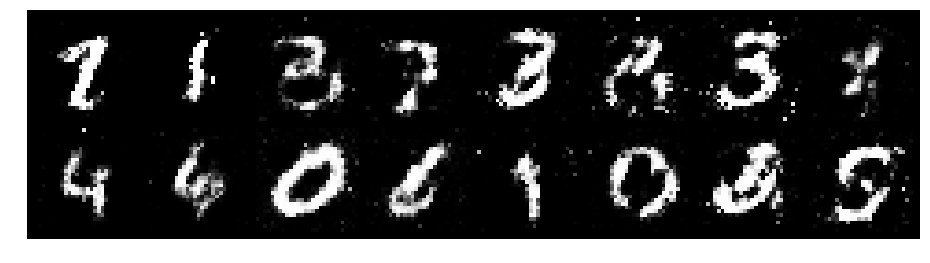

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 1.1487, Generator Loss: 1.2447
D(x): 0.6000, D(G(z)): 0.3304


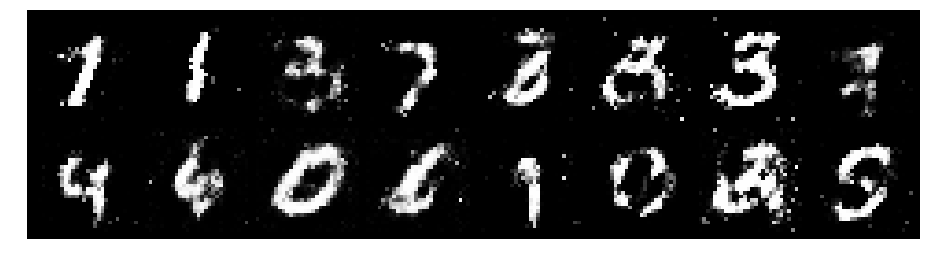

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 1.3044, Generator Loss: 1.0874
D(x): 0.6629, D(G(z)): 0.4645


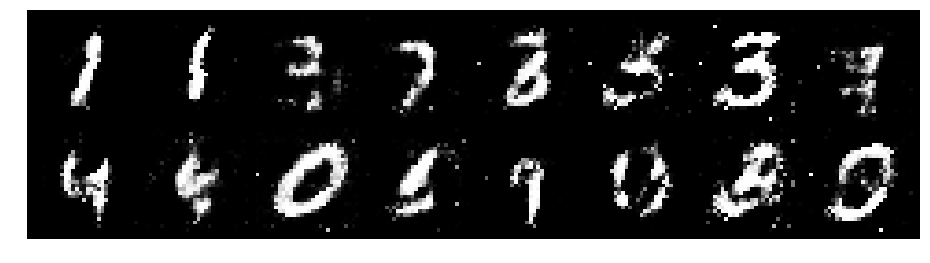

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 1.2166, Generator Loss: 0.9400
D(x): 0.6128, D(G(z)): 0.4491


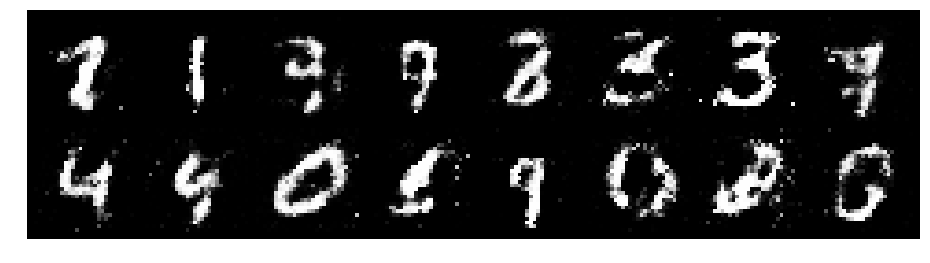

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 1.0608, Generator Loss: 1.1670
D(x): 0.6358, D(G(z)): 0.3810


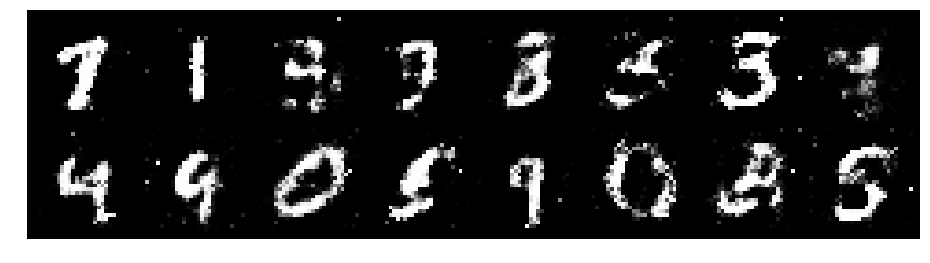

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 1.1441, Generator Loss: 1.0186
D(x): 0.6643, D(G(z)): 0.3872


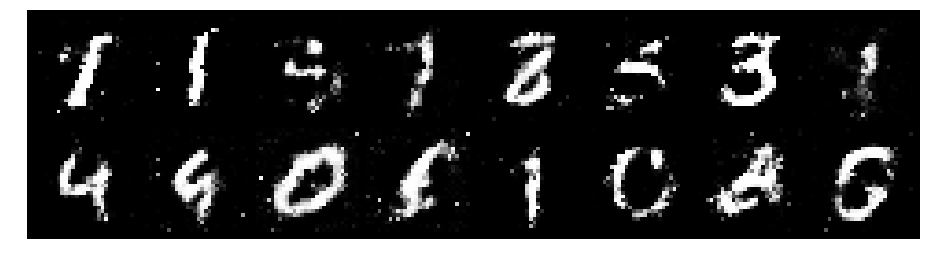

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 1.2678, Generator Loss: 1.4069
D(x): 0.6090, D(G(z)): 0.3913


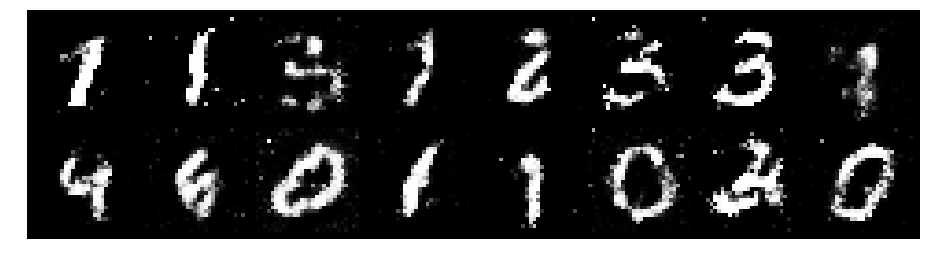

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 1.0124, Generator Loss: 1.3208
D(x): 0.6617, D(G(z)): 0.3109


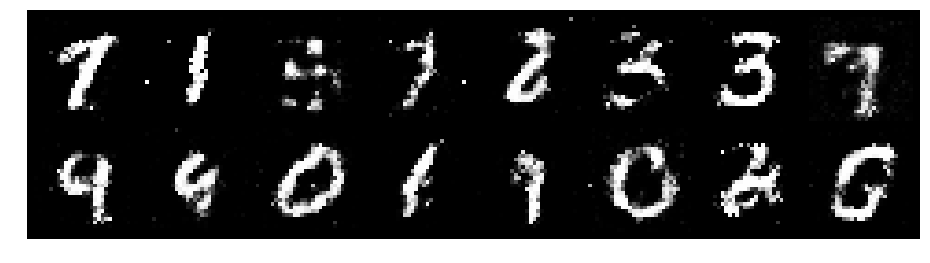

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 1.2558, Generator Loss: 1.3197
D(x): 0.5350, D(G(z)): 0.3519


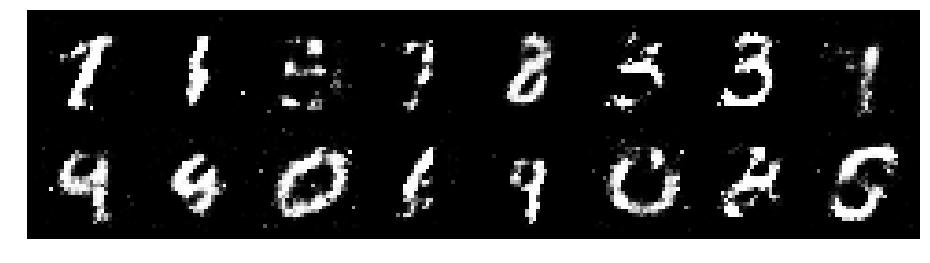

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 1.2928, Generator Loss: 0.8847
D(x): 0.7299, D(G(z)): 0.5152


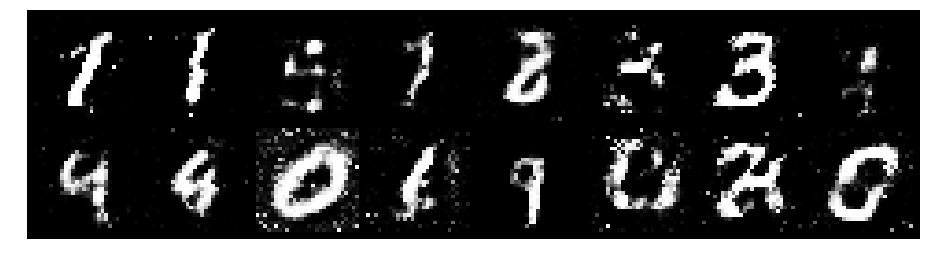

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 0.9775, Generator Loss: 1.3101
D(x): 0.6792, D(G(z)): 0.3456


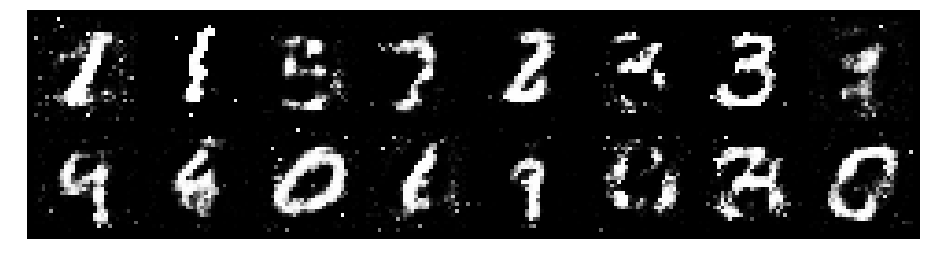

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 1.2054, Generator Loss: 1.0386
D(x): 0.7183, D(G(z)): 0.4779


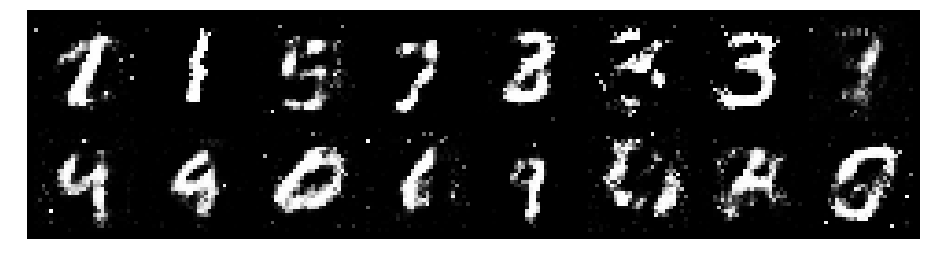

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 1.0410, Generator Loss: 1.6384
D(x): 0.6115, D(G(z)): 0.2670


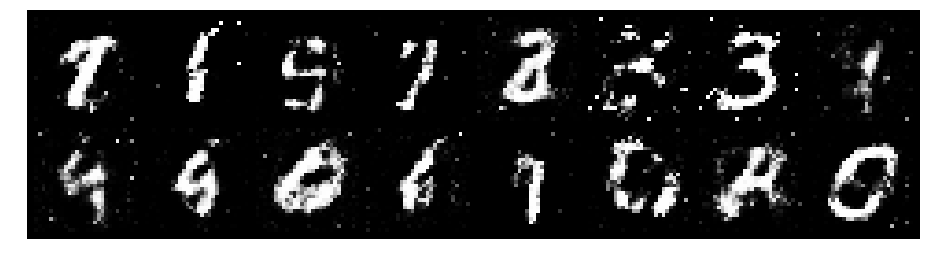

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 1.0763, Generator Loss: 1.3925
D(x): 0.6771, D(G(z)): 0.3741


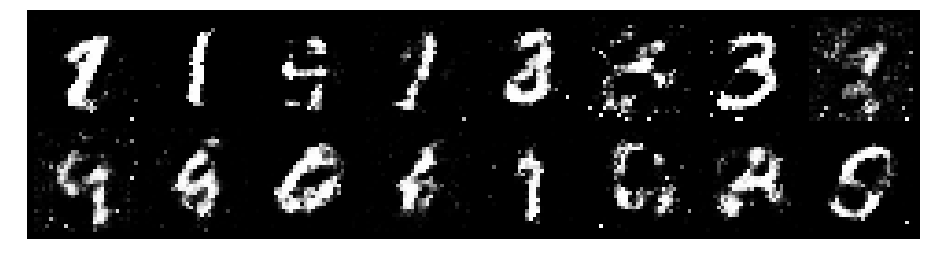

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 1.0984, Generator Loss: 1.2536
D(x): 0.5854, D(G(z)): 0.3484


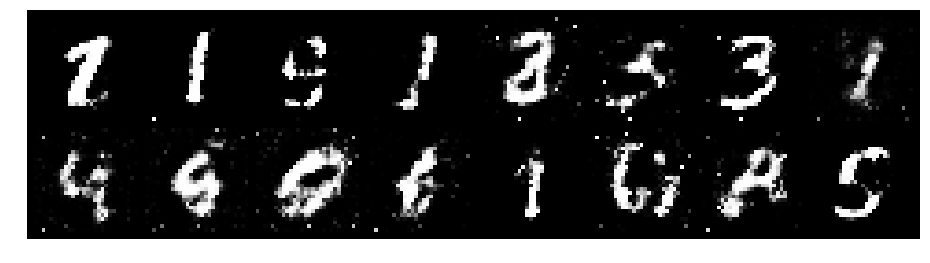

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 1.0700, Generator Loss: 1.1500
D(x): 0.5825, D(G(z)): 0.3379


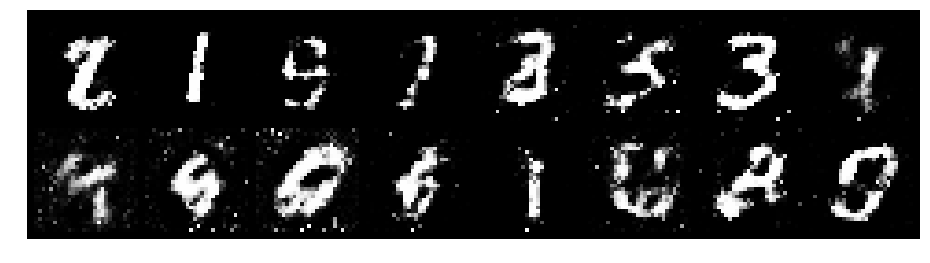

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 1.2764, Generator Loss: 1.0528
D(x): 0.5637, D(G(z)): 0.4187


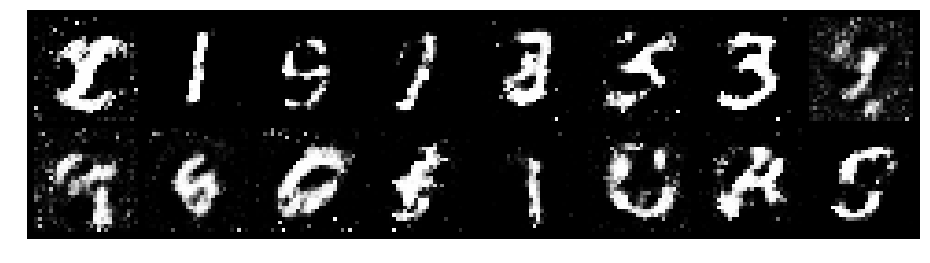

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 1.1906, Generator Loss: 1.4157
D(x): 0.5973, D(G(z)): 0.3423


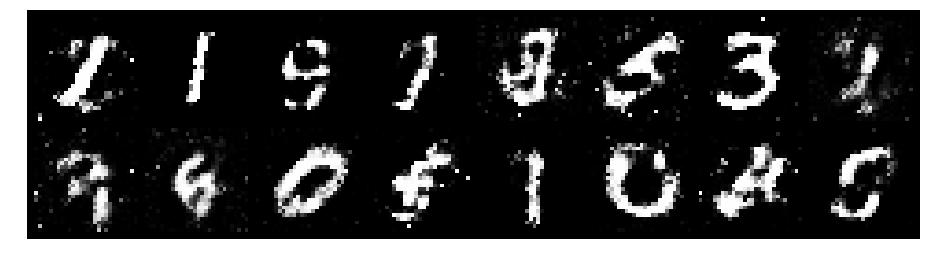

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 1.2232, Generator Loss: 1.1670
D(x): 0.5420, D(G(z)): 0.3334


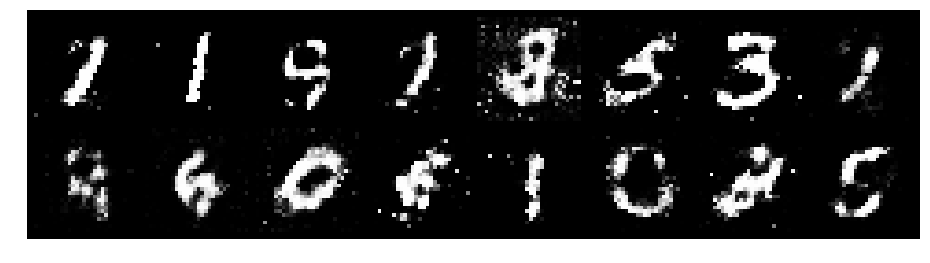

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 1.0290, Generator Loss: 1.2986
D(x): 0.6433, D(G(z)): 0.3304


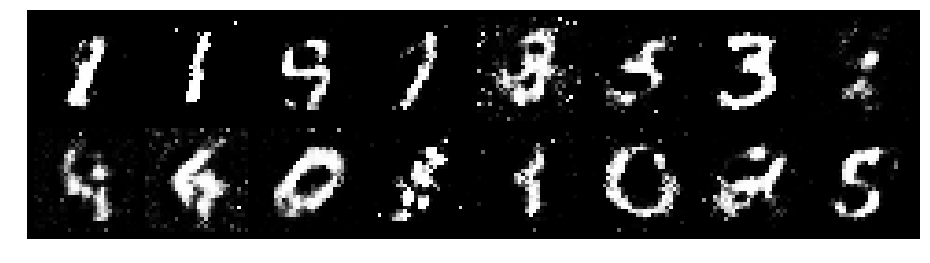

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 1.0839, Generator Loss: 1.3467
D(x): 0.6515, D(G(z)): 0.3907


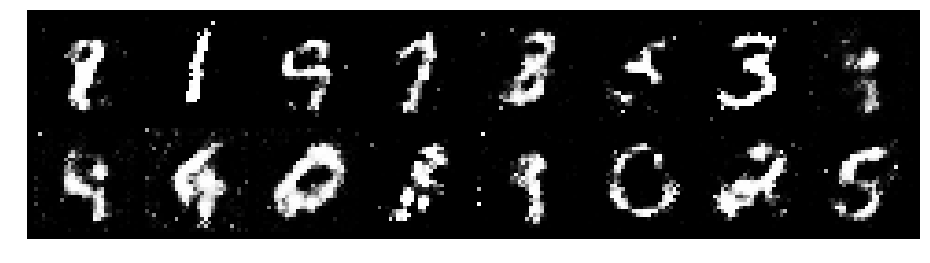

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 1.0837, Generator Loss: 1.0222
D(x): 0.6890, D(G(z)): 0.4367


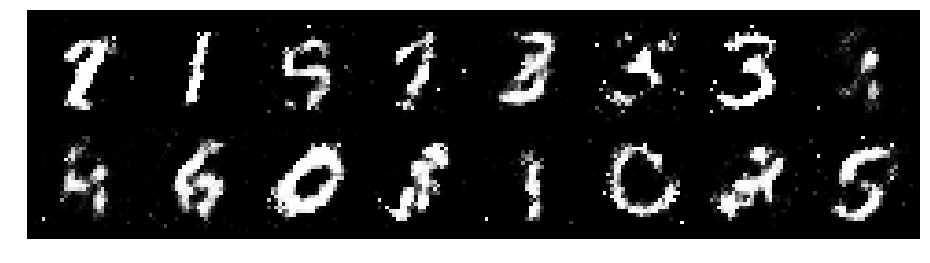

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 1.0484, Generator Loss: 1.2804
D(x): 0.5955, D(G(z)): 0.3307


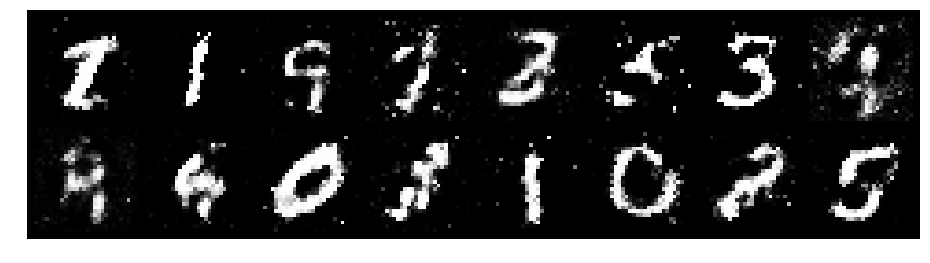

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 1.0278, Generator Loss: 1.3926
D(x): 0.6699, D(G(z)): 0.3548


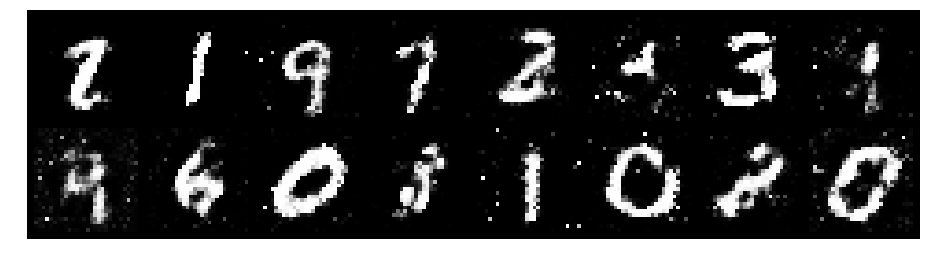

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 0.7927, Generator Loss: 1.6960
D(x): 0.6886, D(G(z)): 0.2495


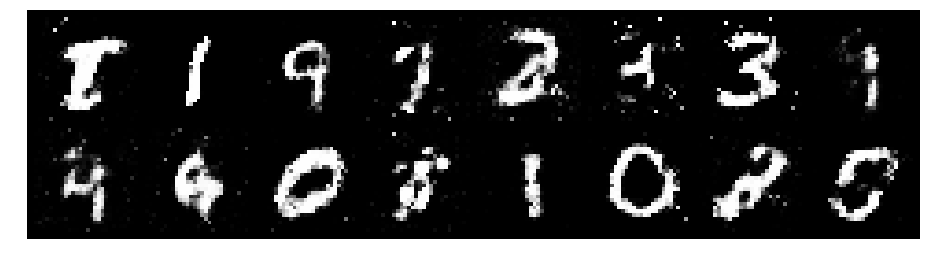

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 1.1025, Generator Loss: 1.3481
D(x): 0.6487, D(G(z)): 0.3757


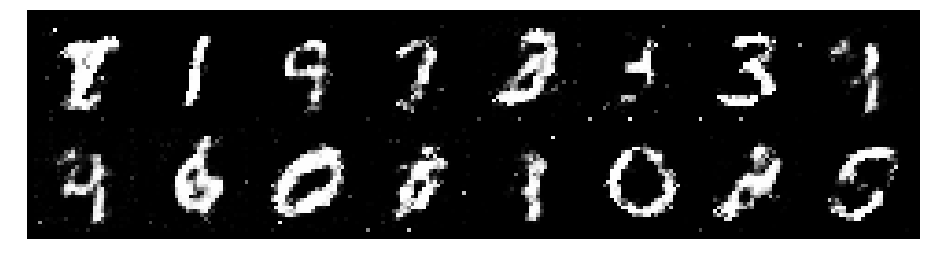

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 0.9937, Generator Loss: 1.2540
D(x): 0.6400, D(G(z)): 0.3364


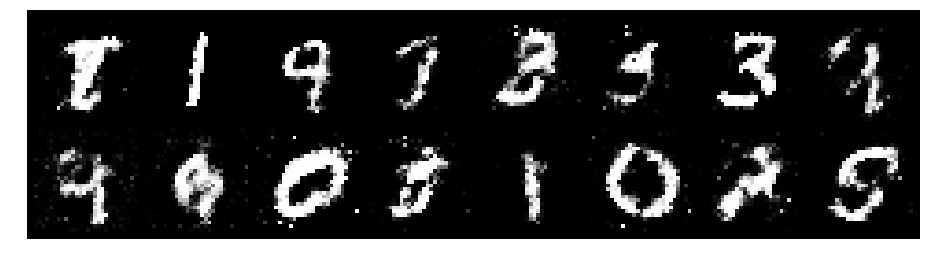

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 0.9320, Generator Loss: 1.1804
D(x): 0.6923, D(G(z)): 0.3288


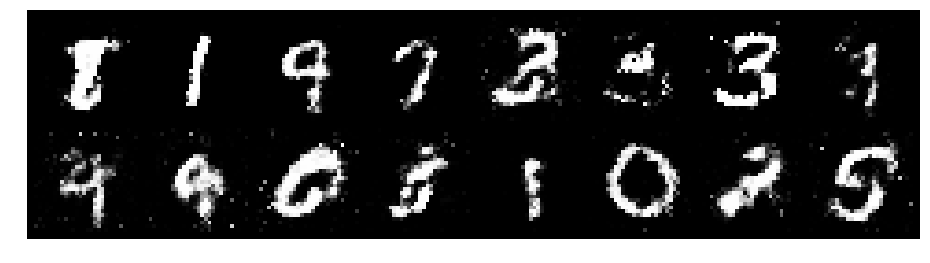

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 1.0296, Generator Loss: 1.0874
D(x): 0.6089, D(G(z)): 0.3380


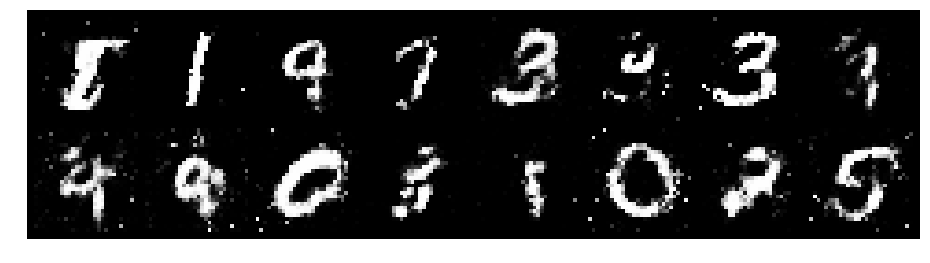

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 0.9667, Generator Loss: 1.2024
D(x): 0.6528, D(G(z)): 0.3441


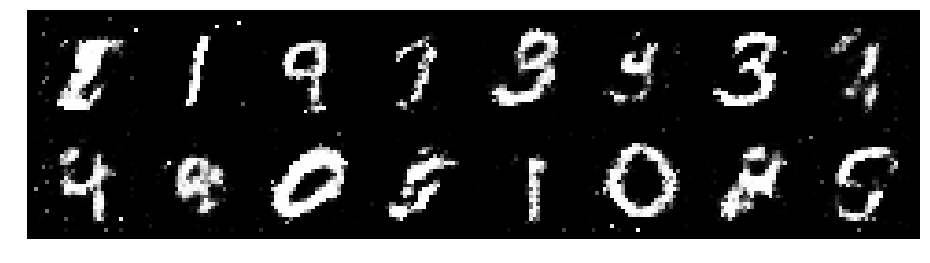

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 0.9905, Generator Loss: 1.4003
D(x): 0.7236, D(G(z)): 0.4102


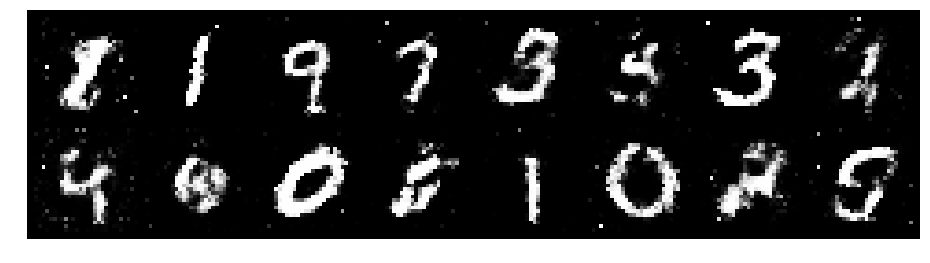

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 1.1752, Generator Loss: 1.1475
D(x): 0.6017, D(G(z)): 0.3661


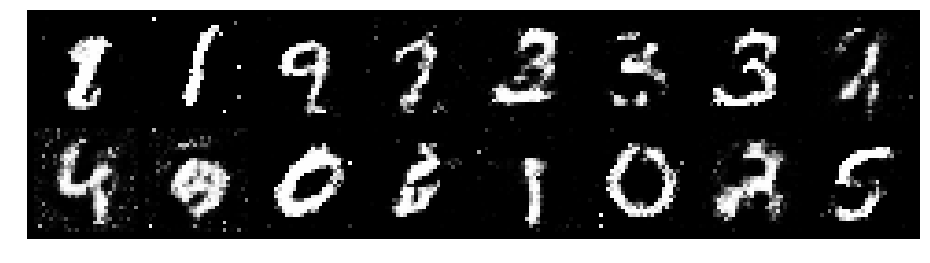

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 1.0594, Generator Loss: 1.1693
D(x): 0.7059, D(G(z)): 0.3892


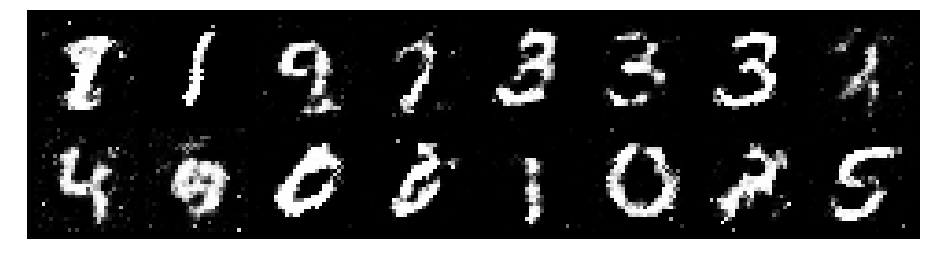

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 1.0062, Generator Loss: 1.1429
D(x): 0.6615, D(G(z)): 0.3758


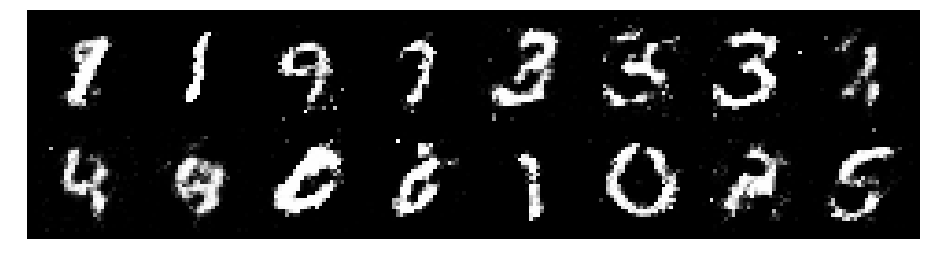

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 0.7737, Generator Loss: 1.2938
D(x): 0.7695, D(G(z)): 0.3150


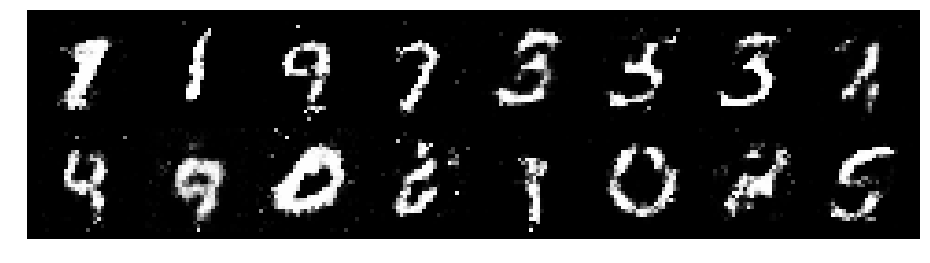

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 0.8817, Generator Loss: 1.5551
D(x): 0.6413, D(G(z)): 0.2534


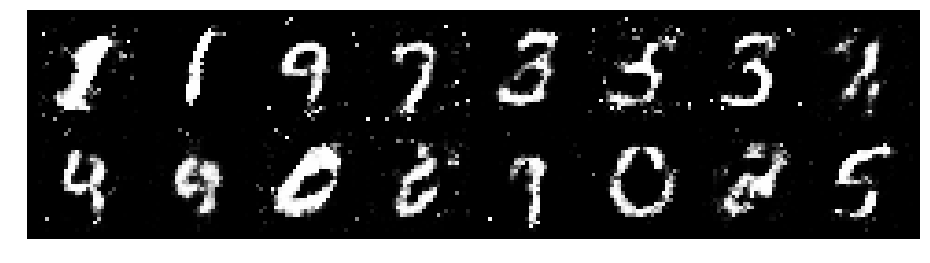

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 0.8394, Generator Loss: 1.3617
D(x): 0.7284, D(G(z)): 0.3314


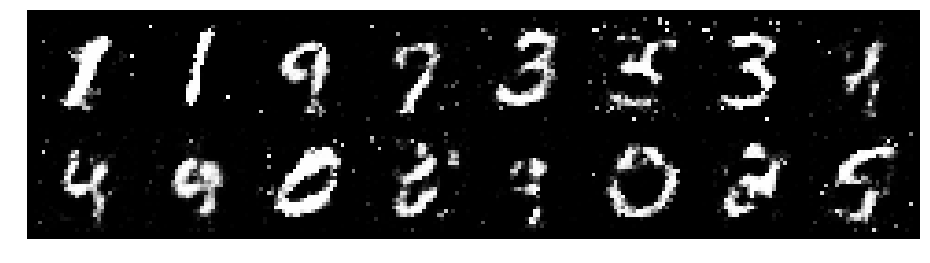

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 1.0291, Generator Loss: 1.2941
D(x): 0.6536, D(G(z)): 0.3561


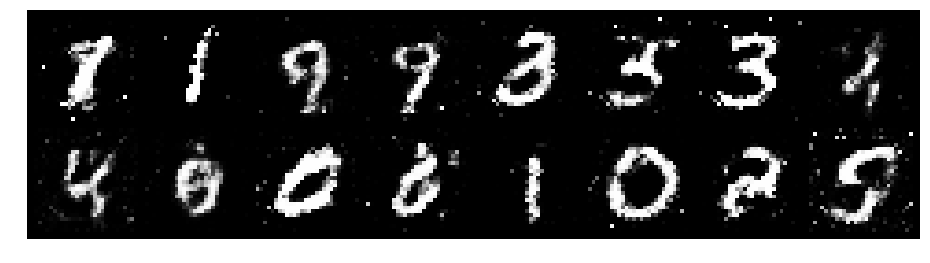

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 1.0711, Generator Loss: 1.3194
D(x): 0.5656, D(G(z)): 0.3035


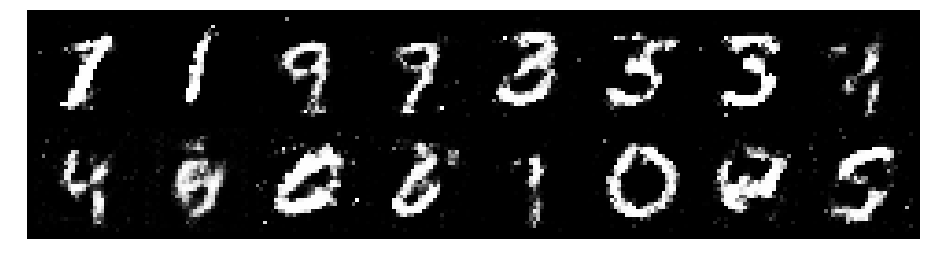

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 0.9117, Generator Loss: 1.3641
D(x): 0.7121, D(G(z)): 0.3433


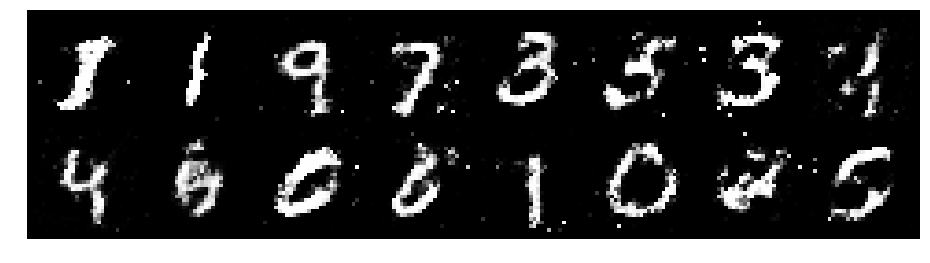

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.0649, Generator Loss: 1.2890
D(x): 0.6074, D(G(z)): 0.3277


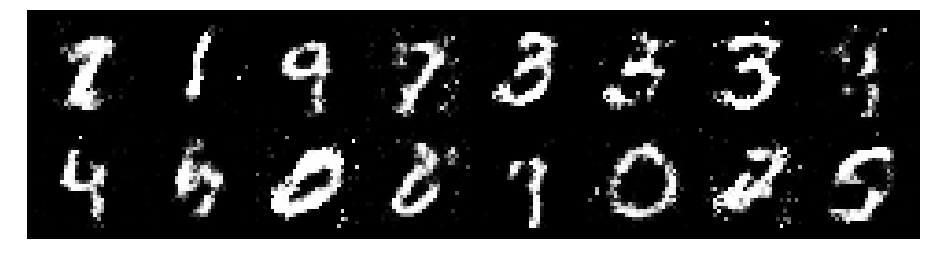

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 1.2257, Generator Loss: 0.9801
D(x): 0.5732, D(G(z)): 0.4103


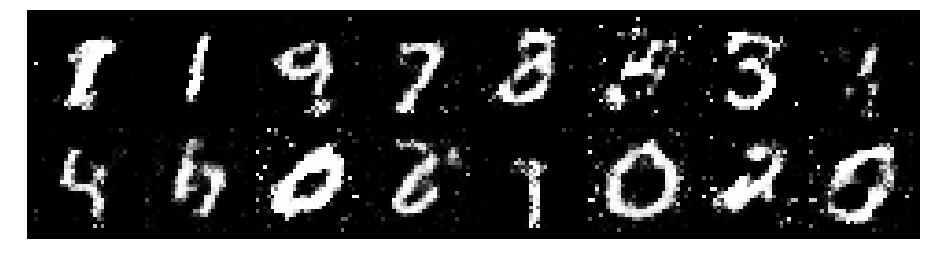

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 1.0561, Generator Loss: 1.1215
D(x): 0.6384, D(G(z)): 0.3830


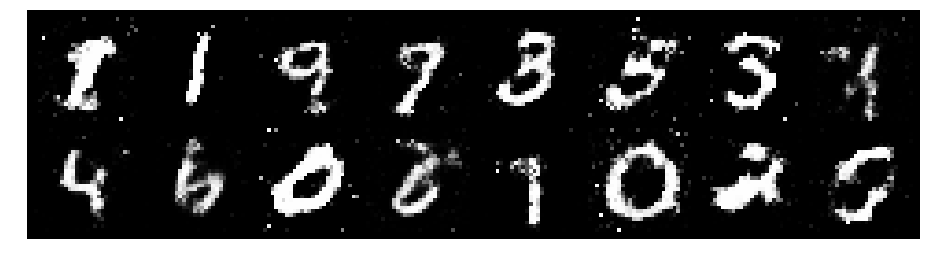

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 1.0632, Generator Loss: 1.1314
D(x): 0.7112, D(G(z)): 0.4191


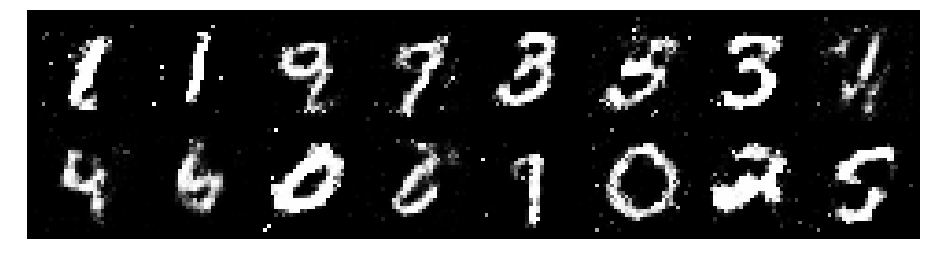

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 1.2588, Generator Loss: 1.1102
D(x): 0.6066, D(G(z)): 0.3721


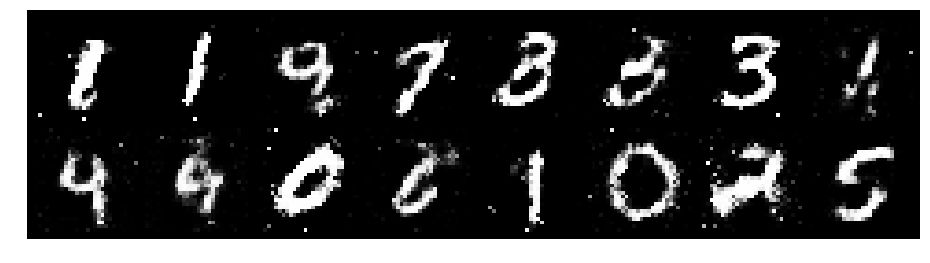

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 0.9084, Generator Loss: 1.7537
D(x): 0.7042, D(G(z)): 0.3250


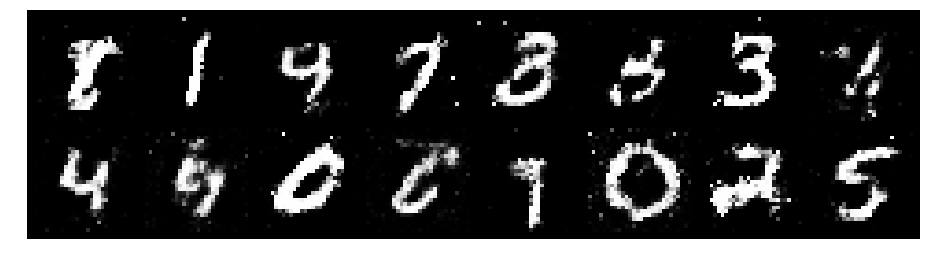

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 1.0019, Generator Loss: 1.2794
D(x): 0.6613, D(G(z)): 0.3430


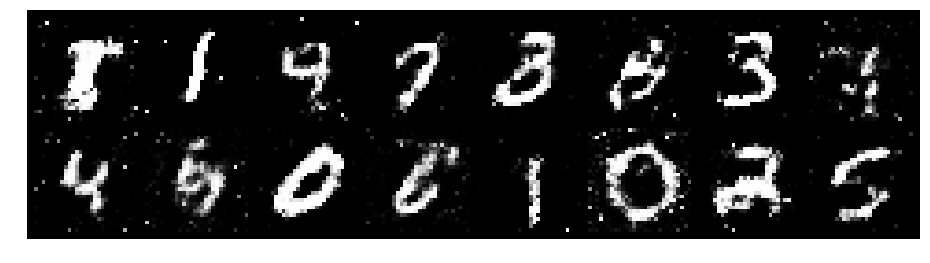

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 1.0745, Generator Loss: 1.2044
D(x): 0.6188, D(G(z)): 0.3482


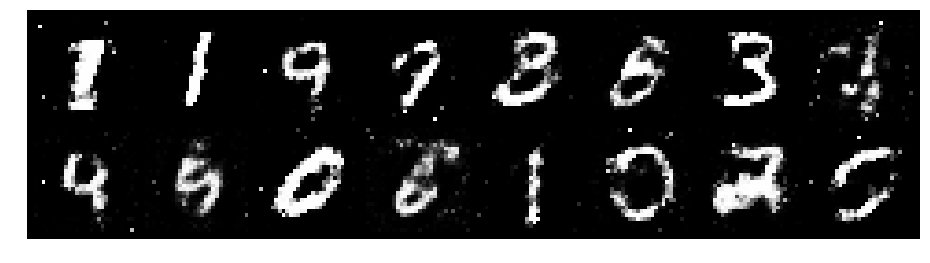

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 1.2427, Generator Loss: 1.0790
D(x): 0.5728, D(G(z)): 0.4082


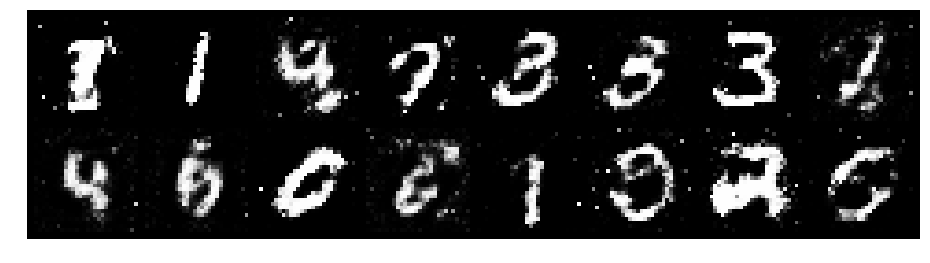

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.1746, Generator Loss: 1.1688
D(x): 0.5690, D(G(z)): 0.3481


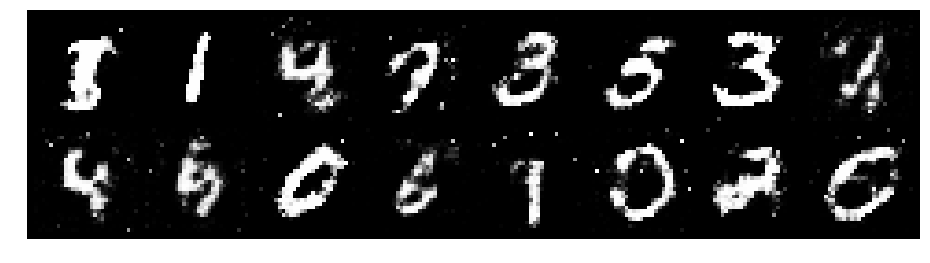

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 1.1016, Generator Loss: 1.3295
D(x): 0.5863, D(G(z)): 0.3243


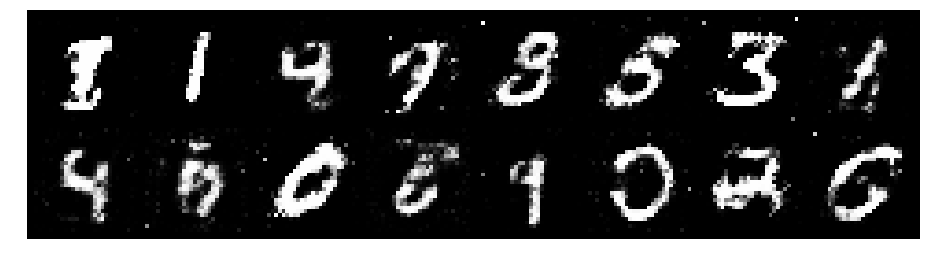

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 0.9996, Generator Loss: 1.2458
D(x): 0.6307, D(G(z)): 0.3363


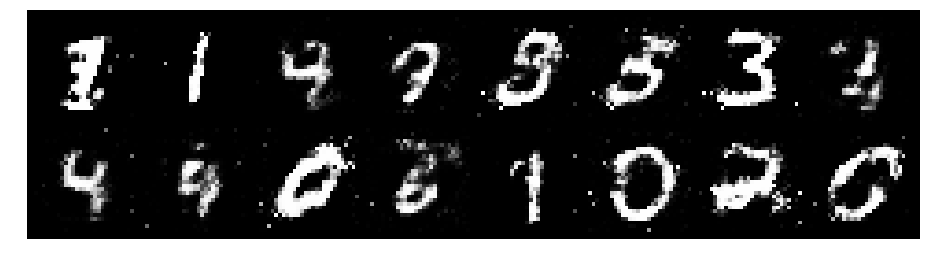

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 0.9353, Generator Loss: 1.5068
D(x): 0.6683, D(G(z)): 0.3021


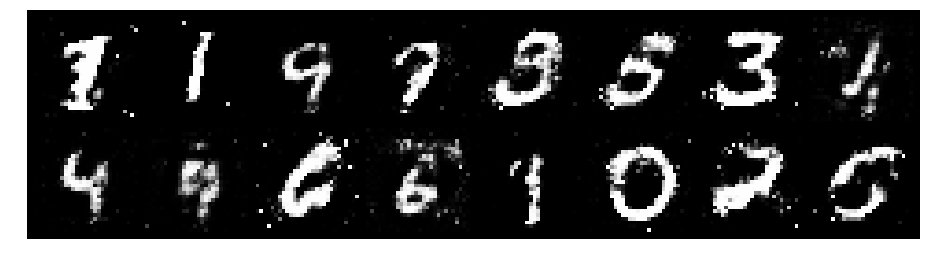

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 0.9584, Generator Loss: 1.4215
D(x): 0.6763, D(G(z)): 0.3324


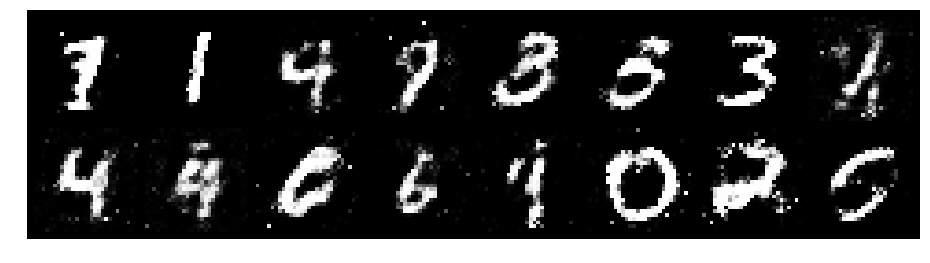

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 0.9602, Generator Loss: 1.2955
D(x): 0.6924, D(G(z)): 0.3439


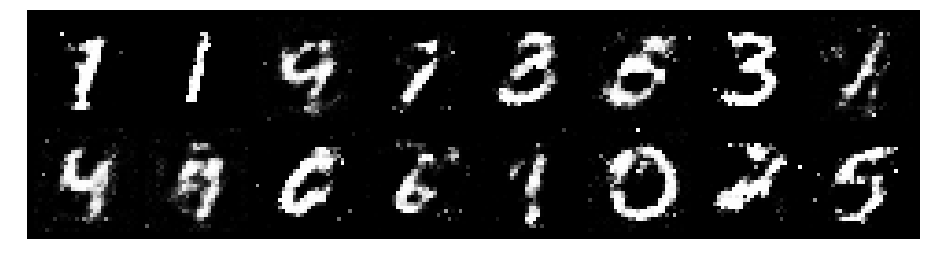

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 0.9804, Generator Loss: 1.3046
D(x): 0.7120, D(G(z)): 0.3934


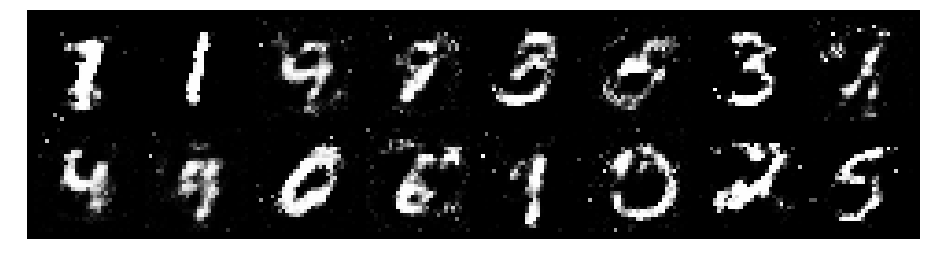

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 0.9987, Generator Loss: 0.9827
D(x): 0.7023, D(G(z)): 0.4158


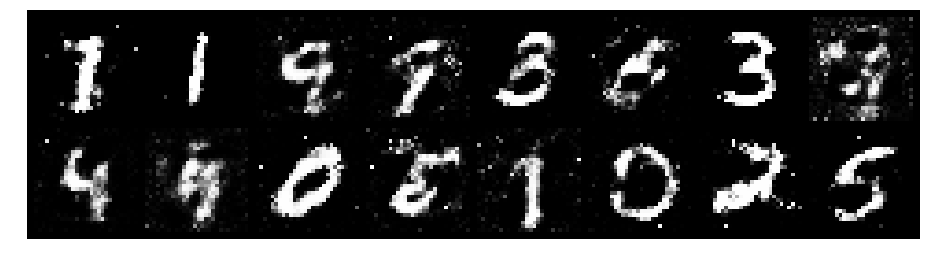

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 1.0495, Generator Loss: 1.1715
D(x): 0.6802, D(G(z)): 0.4096


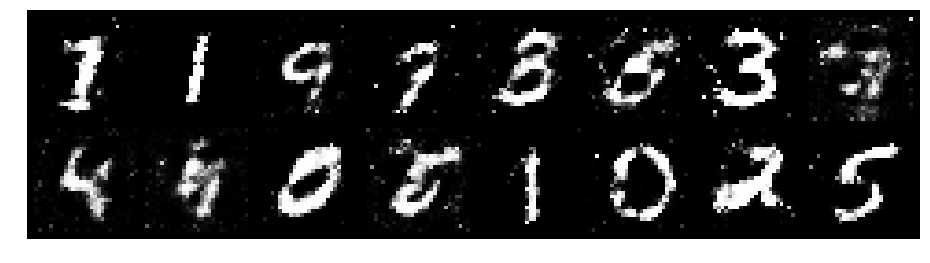

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 0.9754, Generator Loss: 1.3912
D(x): 0.5939, D(G(z)): 0.2609


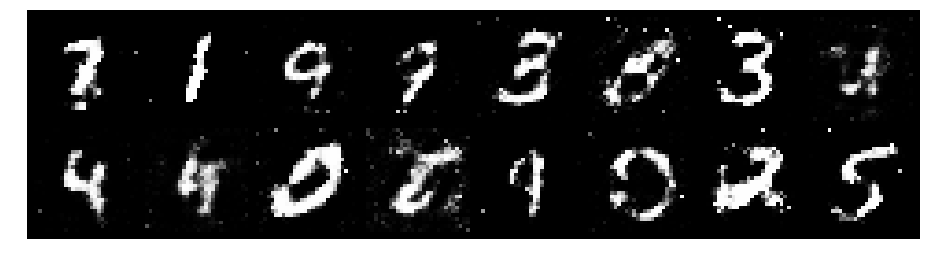

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 1.0485, Generator Loss: 1.1541
D(x): 0.6466, D(G(z)): 0.3706


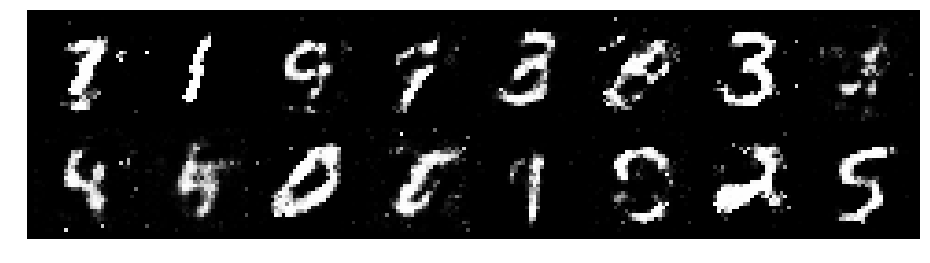

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.0262, Generator Loss: 1.0395
D(x): 0.6455, D(G(z)): 0.3915


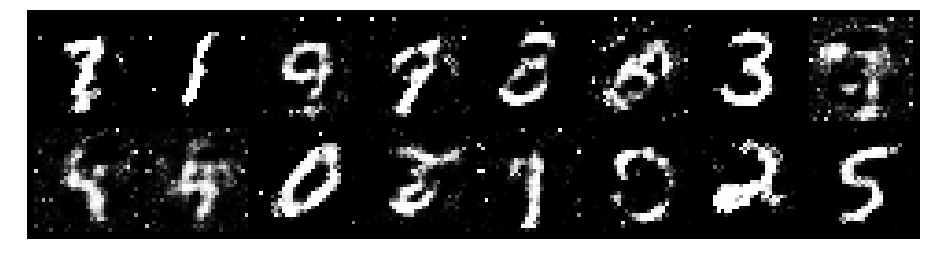

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 1.1294, Generator Loss: 1.0790
D(x): 0.6082, D(G(z)): 0.3944


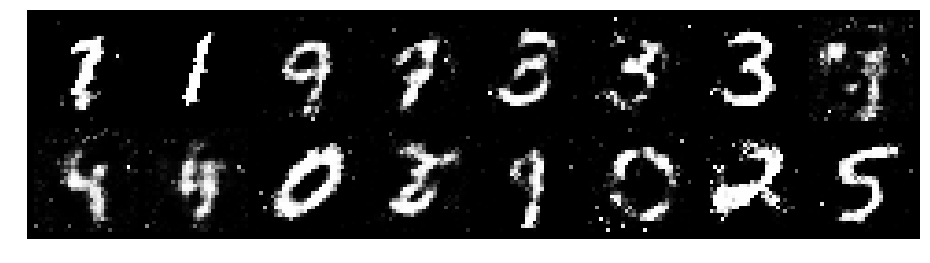

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 1.1242, Generator Loss: 1.0635
D(x): 0.6461, D(G(z)): 0.4180


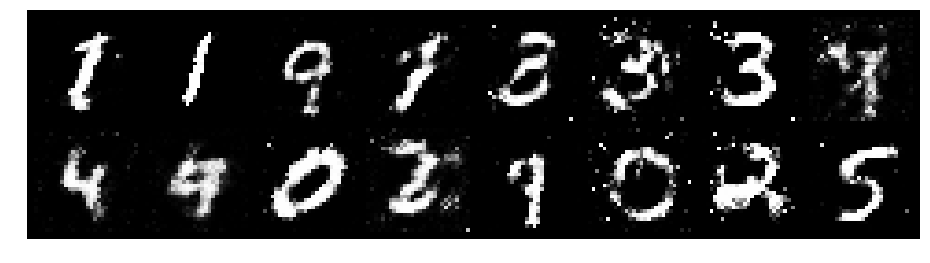

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 1.0183, Generator Loss: 1.3131
D(x): 0.6492, D(G(z)): 0.3538


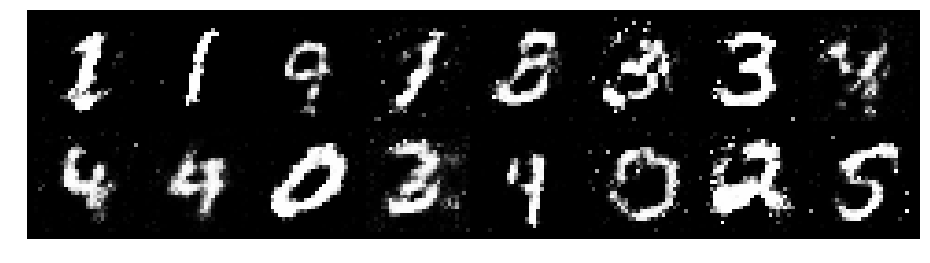

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.1383, Generator Loss: 1.3741
D(x): 0.6075, D(G(z)): 0.3589


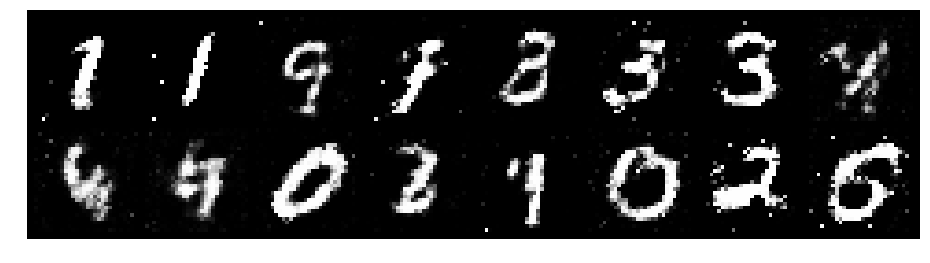

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 0.9454, Generator Loss: 1.3058
D(x): 0.6693, D(G(z)): 0.3255


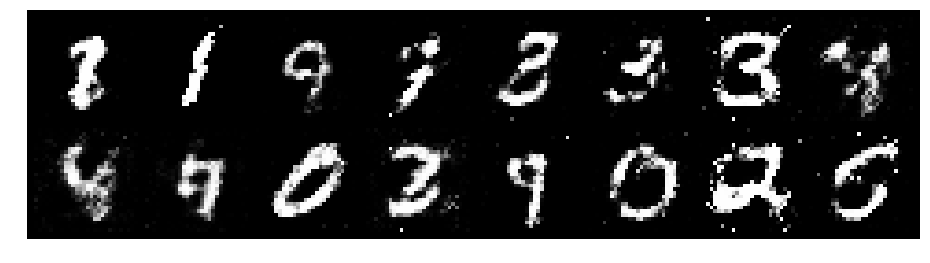

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 0.9788, Generator Loss: 1.2982
D(x): 0.6804, D(G(z)): 0.3714


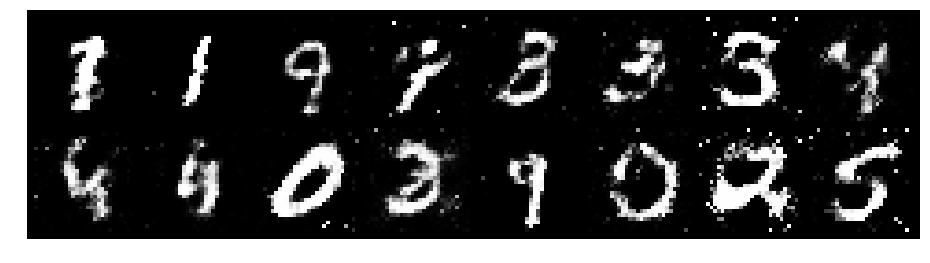

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 1.0081, Generator Loss: 1.2232
D(x): 0.6229, D(G(z)): 0.3324


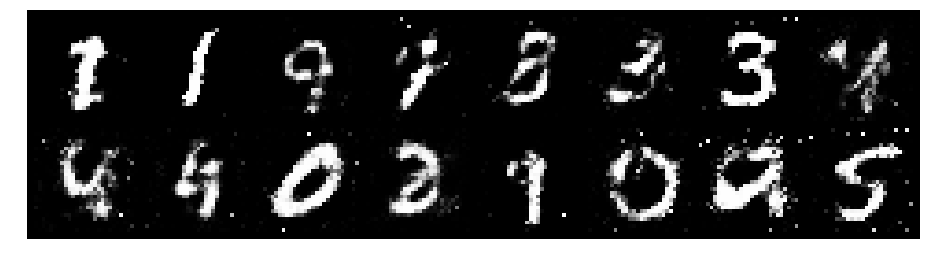

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 1.1342, Generator Loss: 1.1578
D(x): 0.5725, D(G(z)): 0.3409


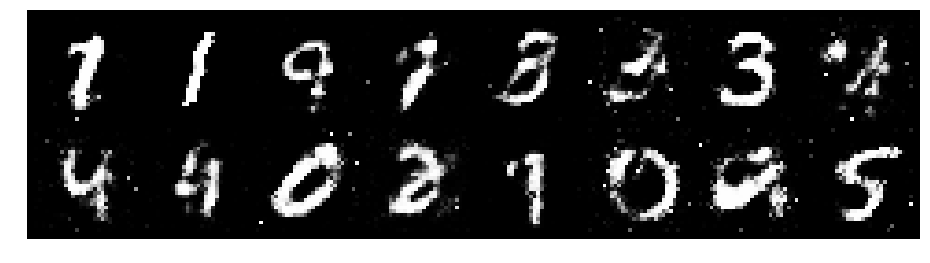

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 1.1496, Generator Loss: 1.1212
D(x): 0.6310, D(G(z)): 0.4024


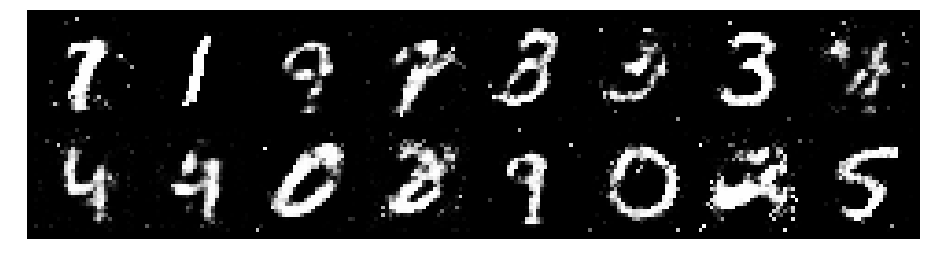

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 1.2650, Generator Loss: 1.4709
D(x): 0.6091, D(G(z)): 0.3850


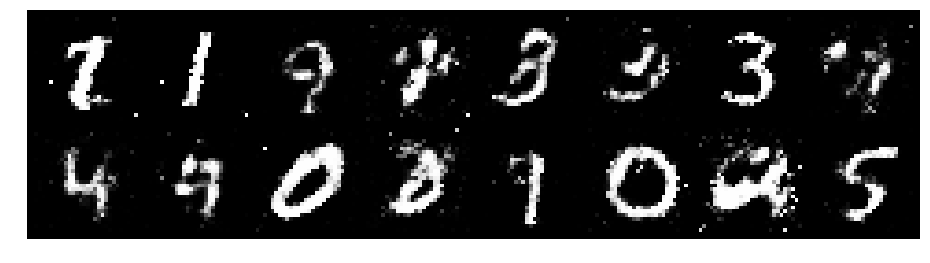

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 1.1583, Generator Loss: 0.9157
D(x): 0.6050, D(G(z)): 0.4116


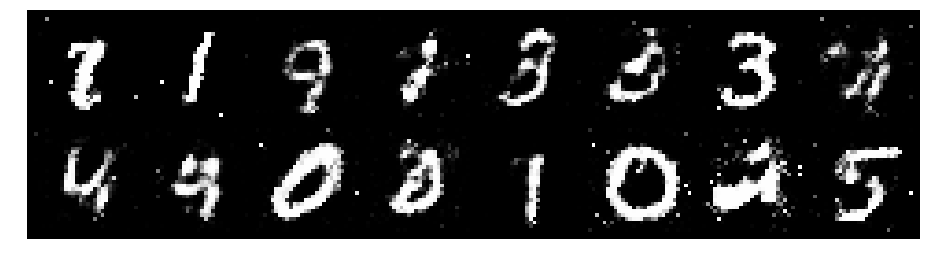

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 1.1237, Generator Loss: 1.0134
D(x): 0.6297, D(G(z)): 0.4213


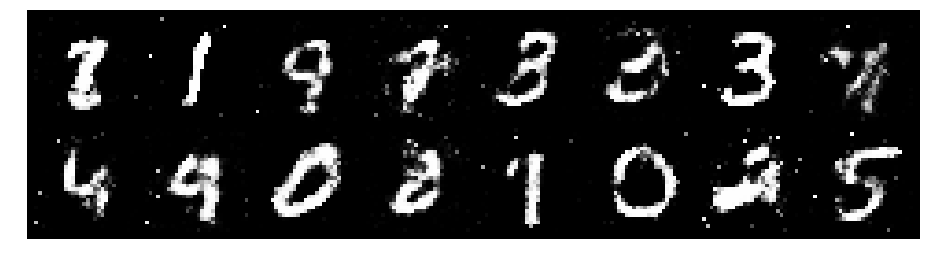

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 1.1710, Generator Loss: 1.1052
D(x): 0.6074, D(G(z)): 0.4011


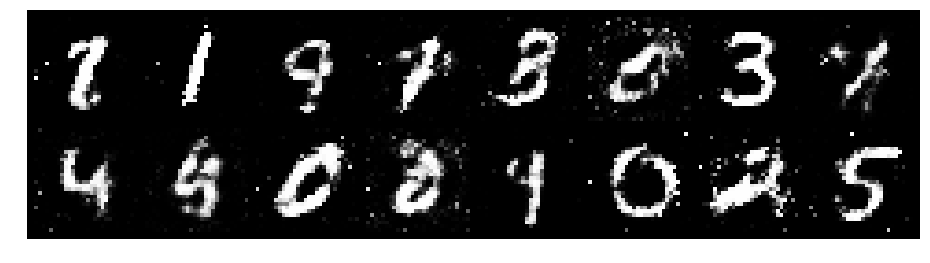

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 1.0487, Generator Loss: 1.5186
D(x): 0.6067, D(G(z)): 0.2834


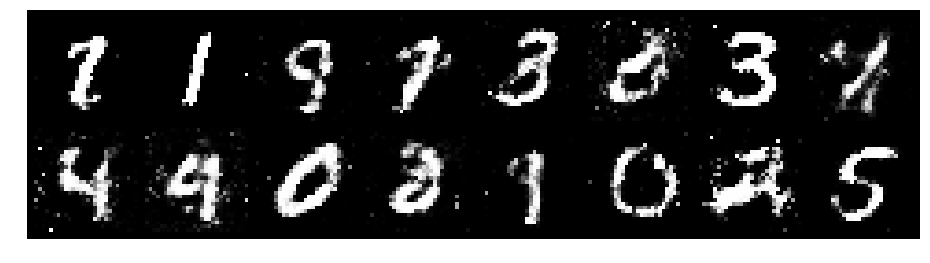

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 1.0727, Generator Loss: 1.5931
D(x): 0.7320, D(G(z)): 0.4199


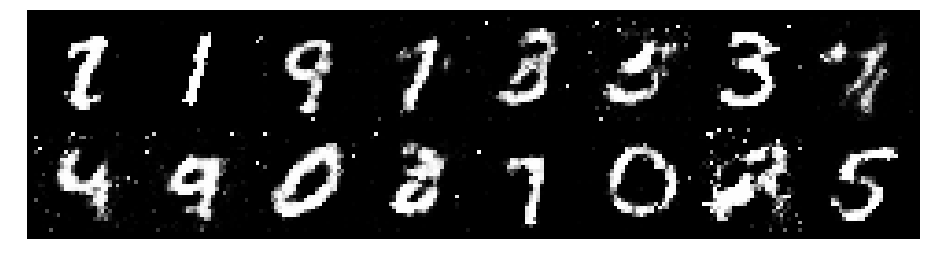

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 1.0433, Generator Loss: 1.3269
D(x): 0.5944, D(G(z)): 0.3122


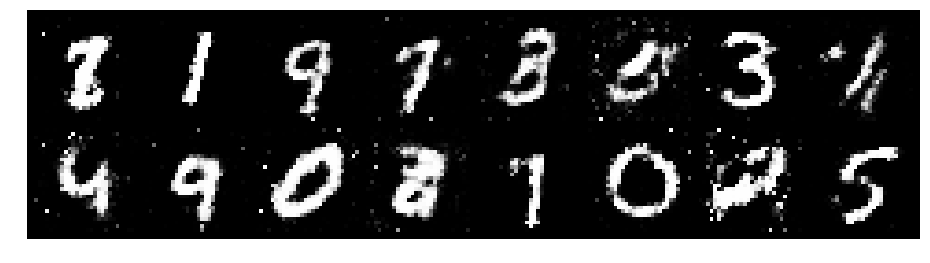

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 0.8670, Generator Loss: 1.2891
D(x): 0.6568, D(G(z)): 0.2821


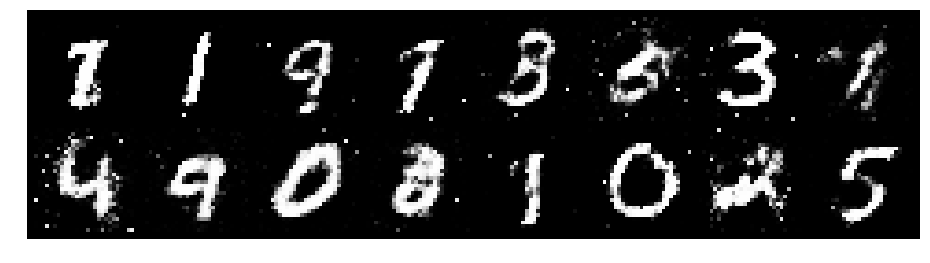

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 1.2018, Generator Loss: 1.1810
D(x): 0.6423, D(G(z)): 0.4462


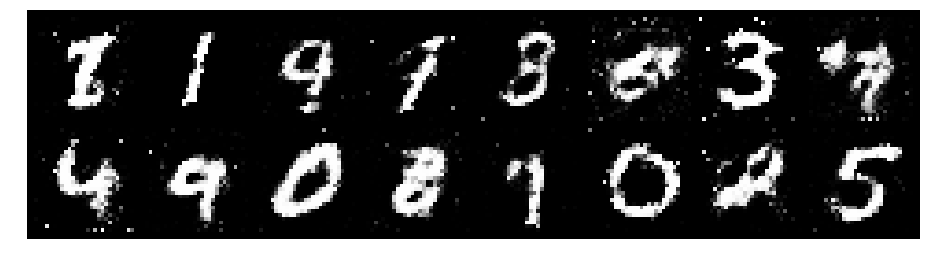

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 1.0910, Generator Loss: 1.0533
D(x): 0.6294, D(G(z)): 0.3686


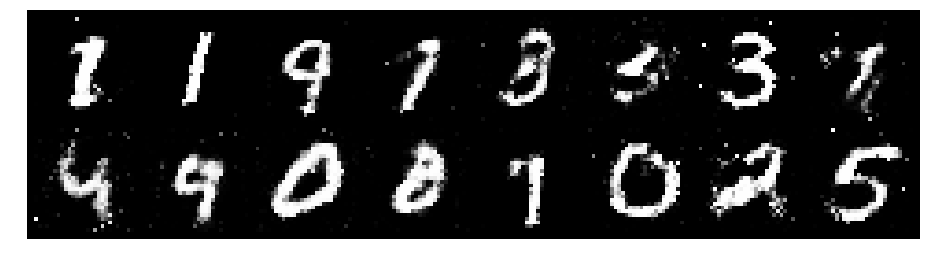

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 1.1572, Generator Loss: 1.3292
D(x): 0.5834, D(G(z)): 0.3601


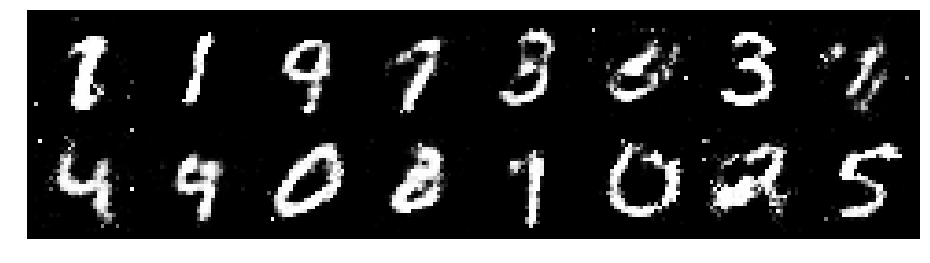

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 1.2739, Generator Loss: 0.9589
D(x): 0.7131, D(G(z)): 0.5183


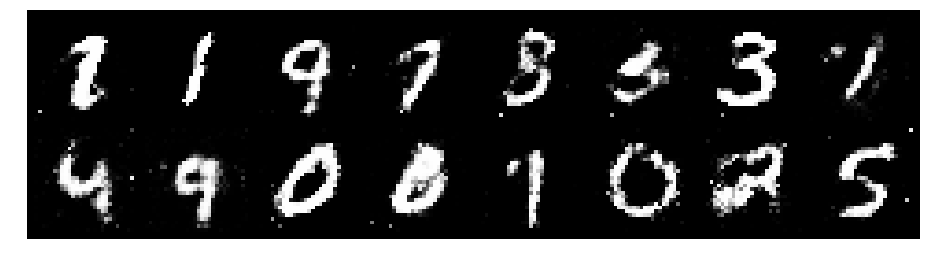

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.2282, Generator Loss: 1.1005
D(x): 0.6522, D(G(z)): 0.4359


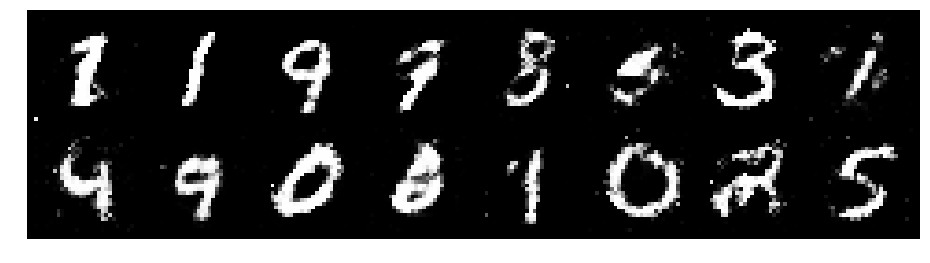

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.2577, Generator Loss: 0.9789
D(x): 0.6362, D(G(z)): 0.4783


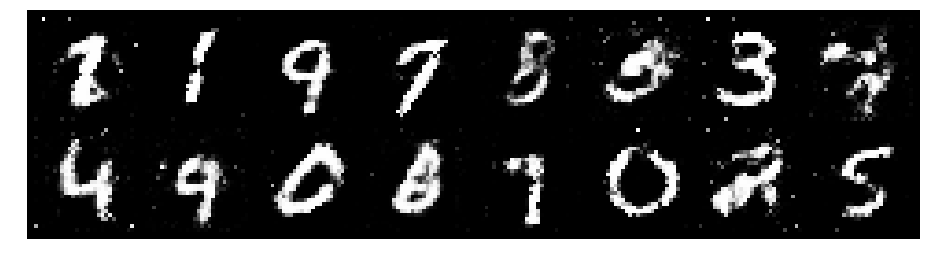

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 1.1646, Generator Loss: 0.8750
D(x): 0.6021, D(G(z)): 0.4359


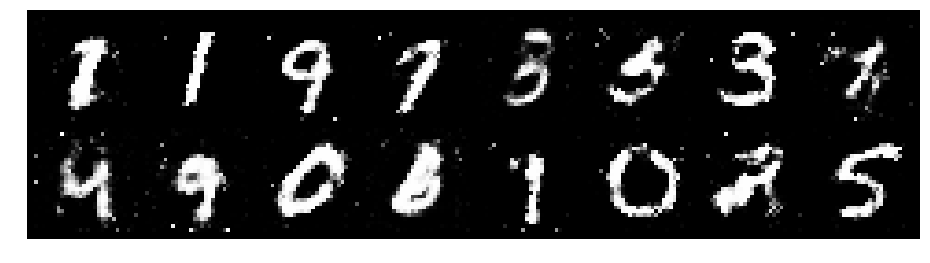

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 1.1768, Generator Loss: 1.0704
D(x): 0.5357, D(G(z)): 0.3117


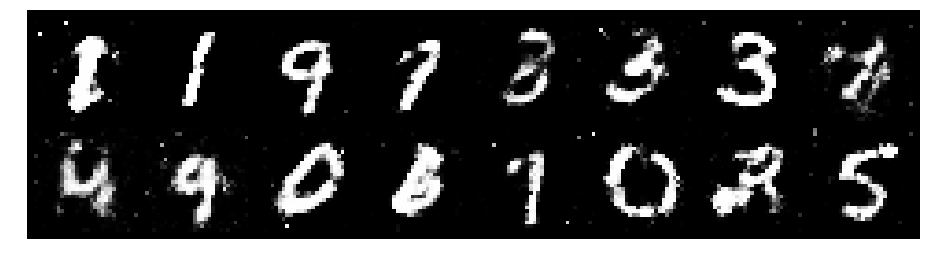

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.2110, Generator Loss: 1.1124
D(x): 0.5962, D(G(z)): 0.4041


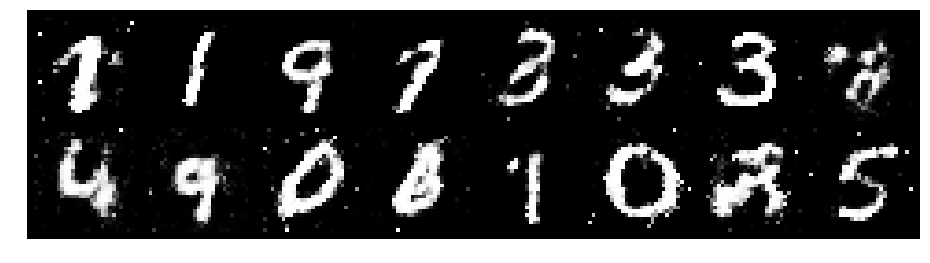

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 1.2540, Generator Loss: 0.9623
D(x): 0.6923, D(G(z)): 0.4906


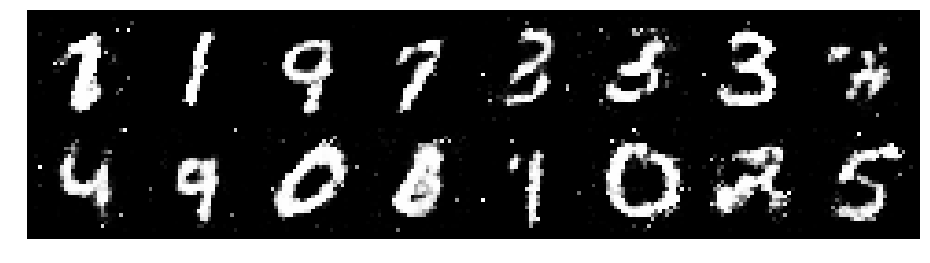

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 1.1798, Generator Loss: 1.1824
D(x): 0.5714, D(G(z)): 0.3348


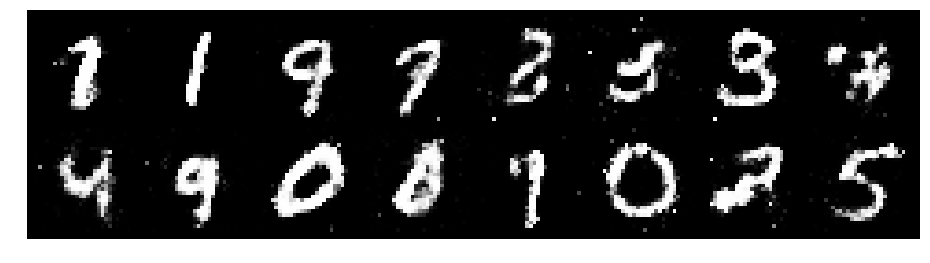

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 1.1947, Generator Loss: 1.0101
D(x): 0.5757, D(G(z)): 0.4026


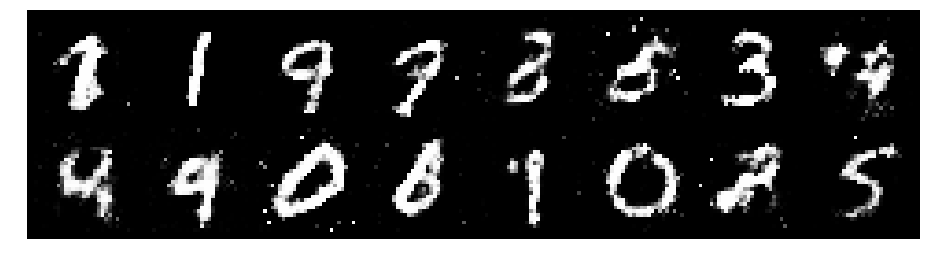

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.1237, Generator Loss: 0.9868
D(x): 0.5967, D(G(z)): 0.3912


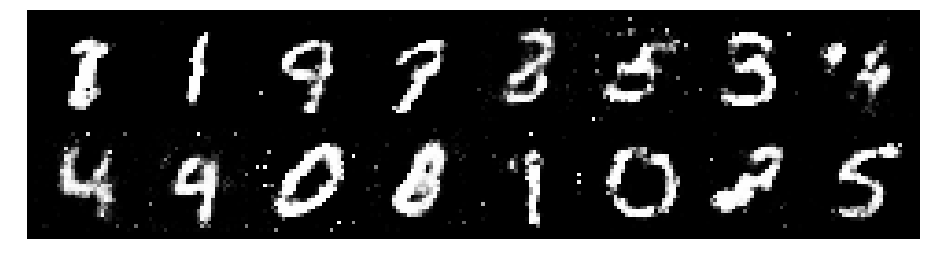

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 1.2239, Generator Loss: 1.0086
D(x): 0.5738, D(G(z)): 0.4213


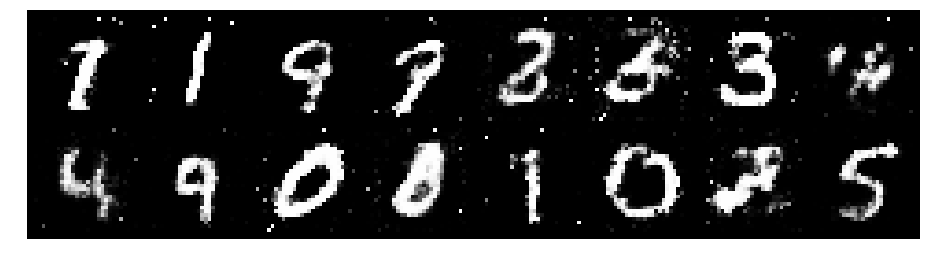

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 1.3576, Generator Loss: 1.1168
D(x): 0.5255, D(G(z)): 0.4237


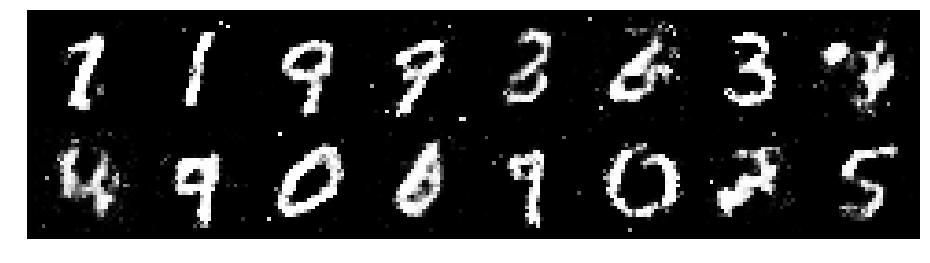

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.0578, Generator Loss: 1.2055
D(x): 0.6401, D(G(z)): 0.3716


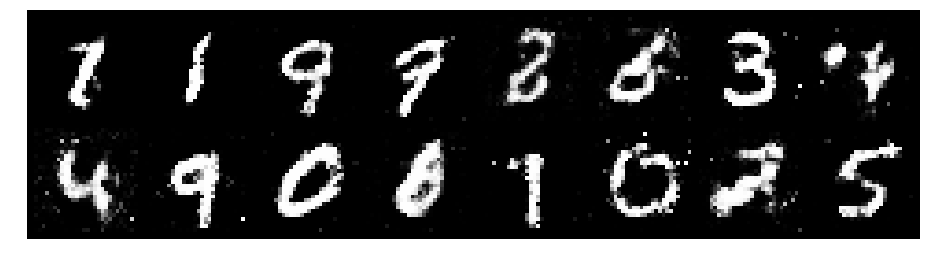

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.0030, Generator Loss: 1.2623
D(x): 0.5906, D(G(z)): 0.3001


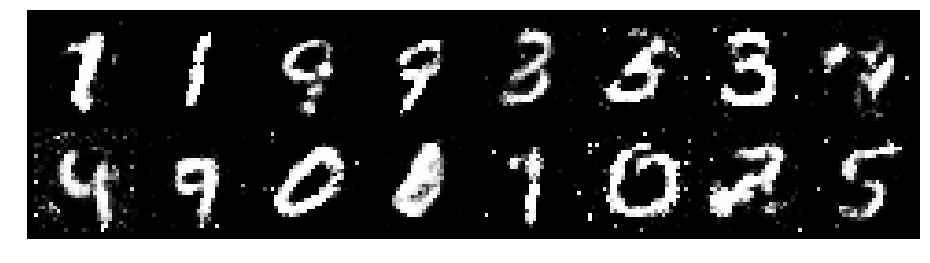

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.0040, Generator Loss: 1.1732
D(x): 0.6517, D(G(z)): 0.3446


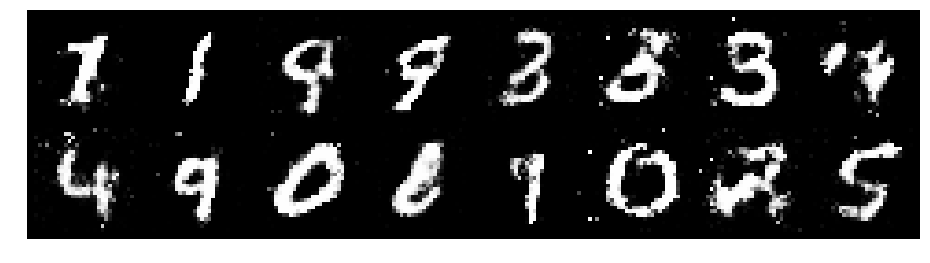

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.1491, Generator Loss: 0.9608
D(x): 0.5930, D(G(z)): 0.3950


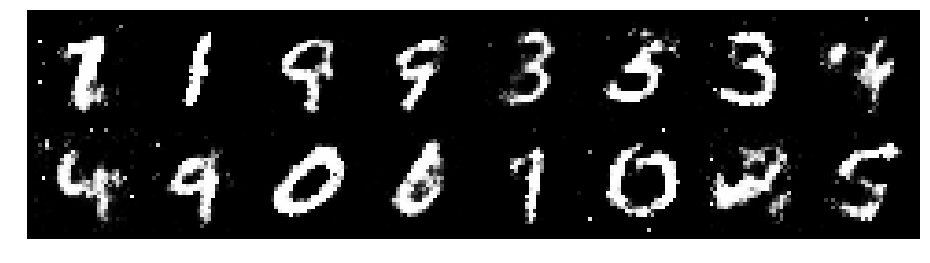

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.2470, Generator Loss: 0.9357
D(x): 0.5278, D(G(z)): 0.3972


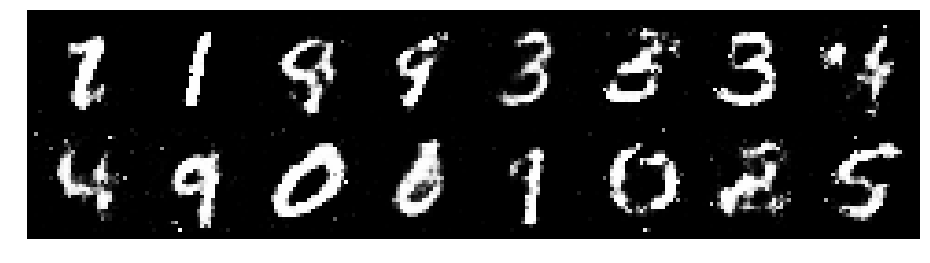

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 1.2532, Generator Loss: 0.9567
D(x): 0.6160, D(G(z)): 0.4535


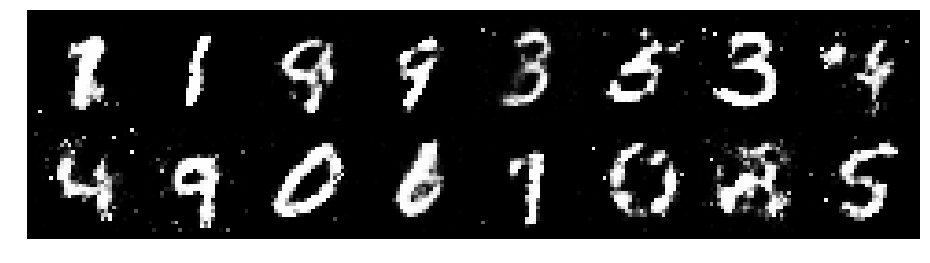

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 1.2320, Generator Loss: 0.9751
D(x): 0.5992, D(G(z)): 0.4141


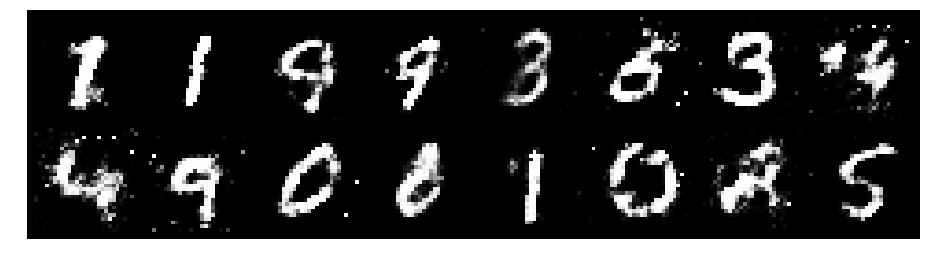

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.2522, Generator Loss: 1.1171
D(x): 0.6039, D(G(z)): 0.4240


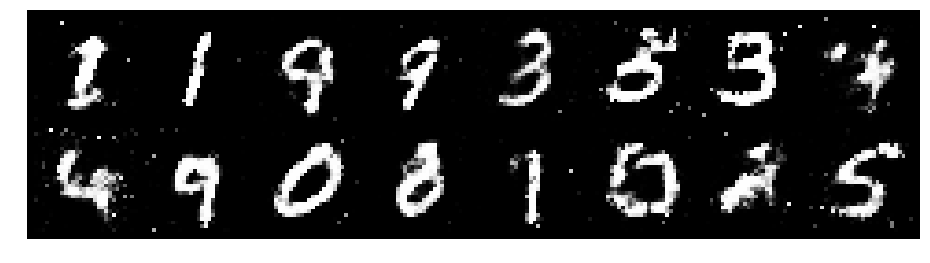

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 0.9972, Generator Loss: 1.2634
D(x): 0.6700, D(G(z)): 0.3438


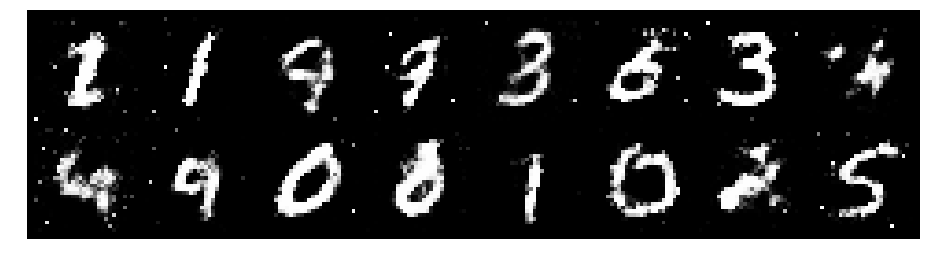

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.1329, Generator Loss: 1.4330
D(x): 0.6169, D(G(z)): 0.3785


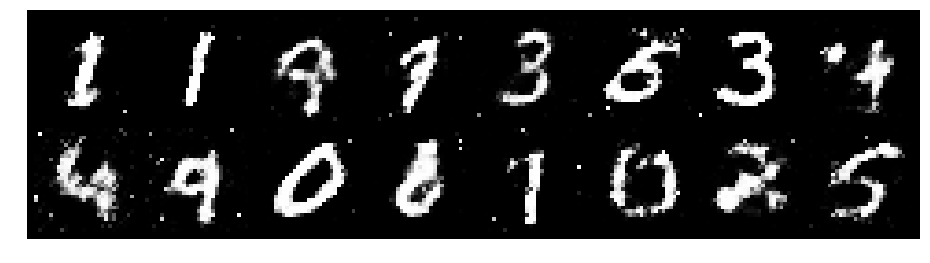

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.1602, Generator Loss: 1.0900
D(x): 0.5998, D(G(z)): 0.3966


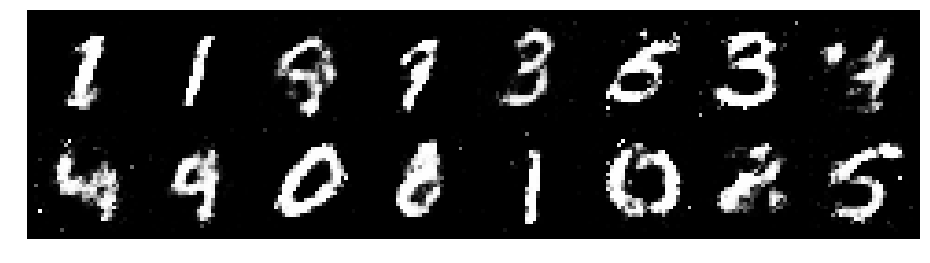

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.1186, Generator Loss: 1.2087
D(x): 0.6846, D(G(z)): 0.4073


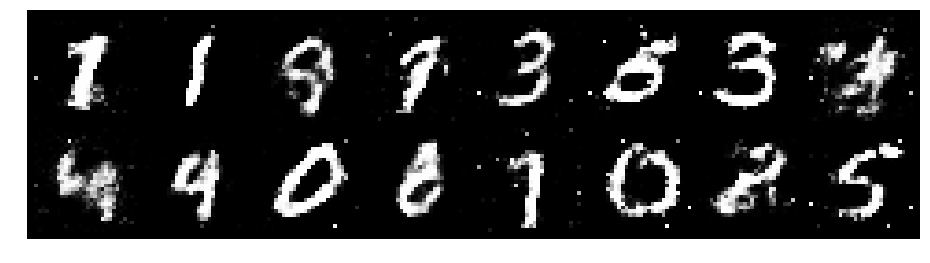

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 1.1420, Generator Loss: 1.1492
D(x): 0.6122, D(G(z)): 0.3672


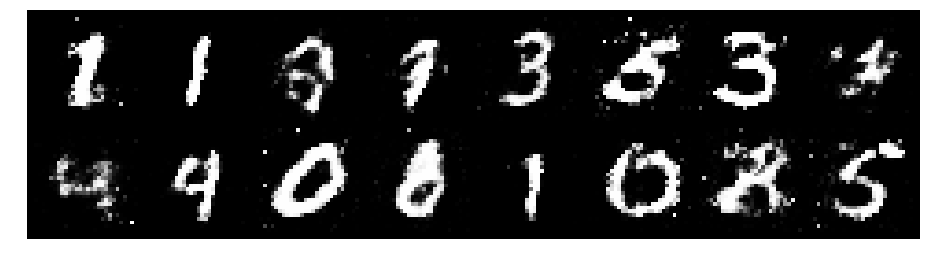

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.0027, Generator Loss: 1.1053
D(x): 0.6636, D(G(z)): 0.3788


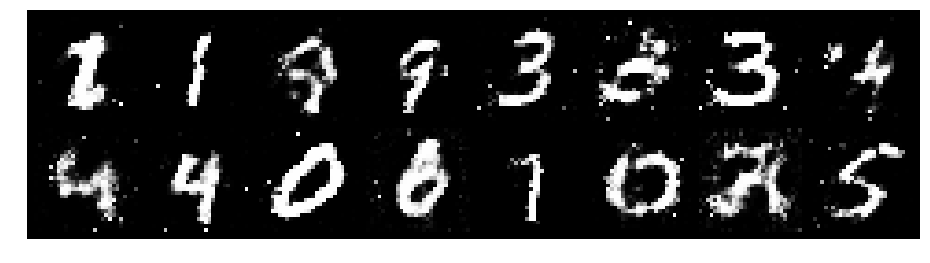

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.1980, Generator Loss: 0.9143
D(x): 0.5802, D(G(z)): 0.4334


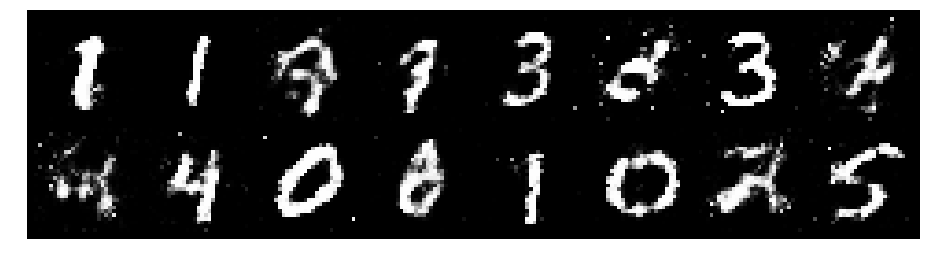

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 1.2361, Generator Loss: 0.9706
D(x): 0.6079, D(G(z)): 0.4555


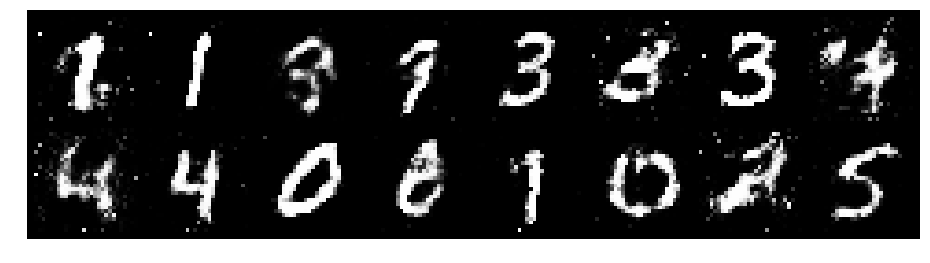

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.1867, Generator Loss: 0.9553
D(x): 0.6060, D(G(z)): 0.3998


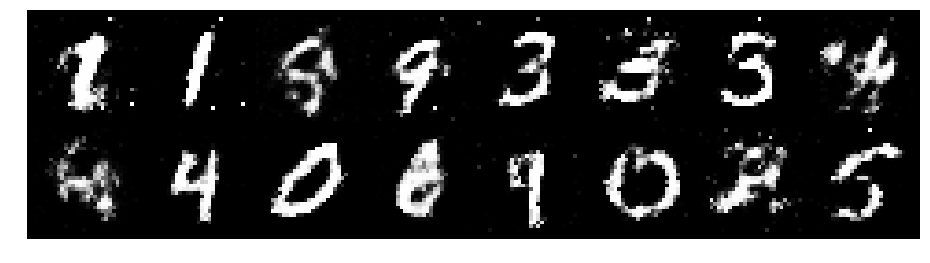

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 1.2297, Generator Loss: 1.0562
D(x): 0.6214, D(G(z)): 0.4442


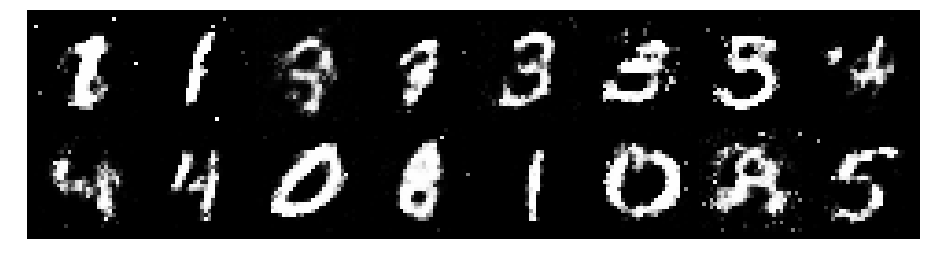

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.2592, Generator Loss: 0.8512
D(x): 0.5725, D(G(z)): 0.4474


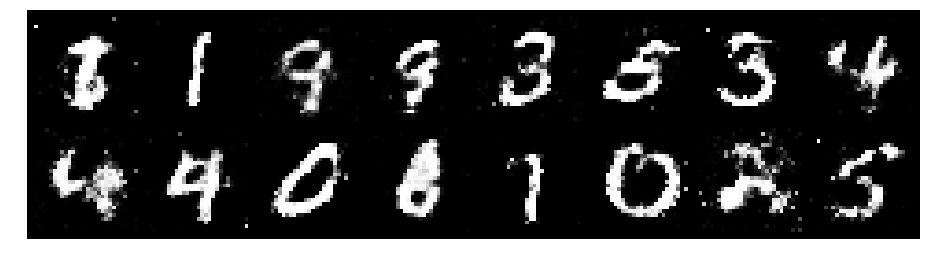

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 1.2553, Generator Loss: 1.1202
D(x): 0.5759, D(G(z)): 0.4166


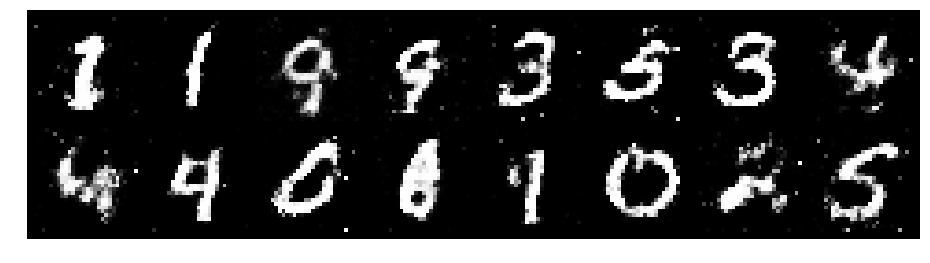

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.1641, Generator Loss: 1.1583
D(x): 0.6980, D(G(z)): 0.4532


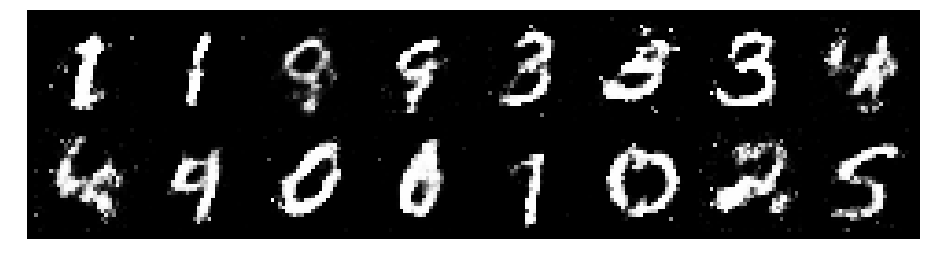

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.1363, Generator Loss: 0.9335
D(x): 0.6164, D(G(z)): 0.3884


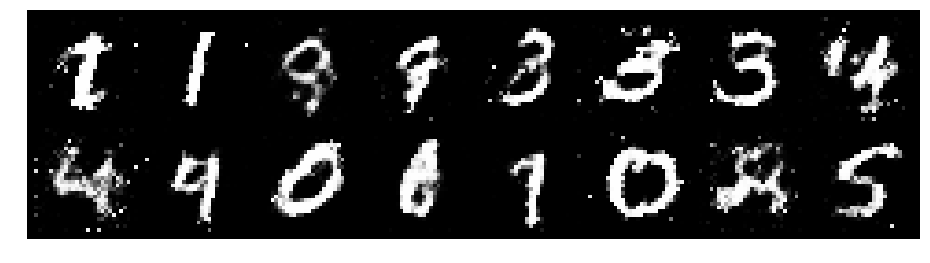

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.1693, Generator Loss: 0.9389
D(x): 0.5809, D(G(z)): 0.3986


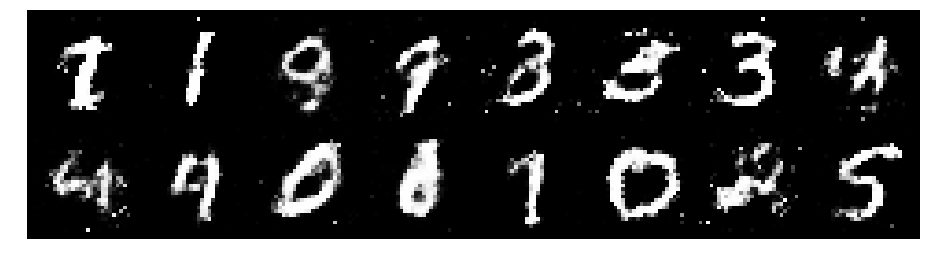

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 1.2551, Generator Loss: 0.8575
D(x): 0.5778, D(G(z)): 0.4408


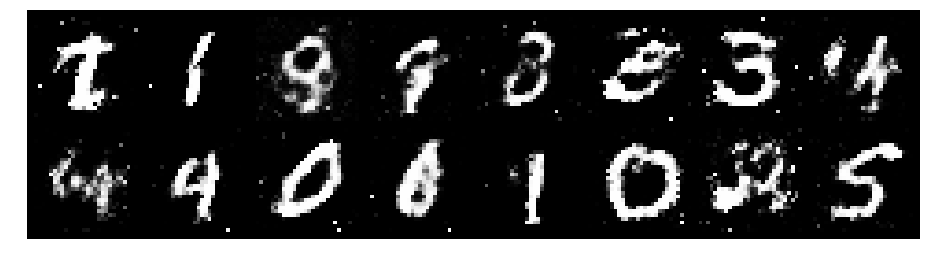

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.2479, Generator Loss: 1.0858
D(x): 0.5858, D(G(z)): 0.4080


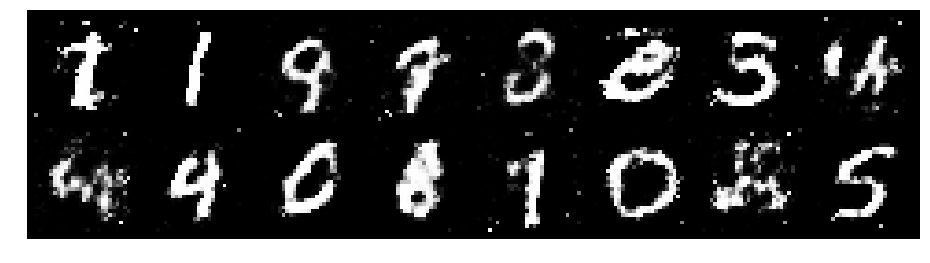

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.2527, Generator Loss: 0.9194
D(x): 0.5606, D(G(z)): 0.4186


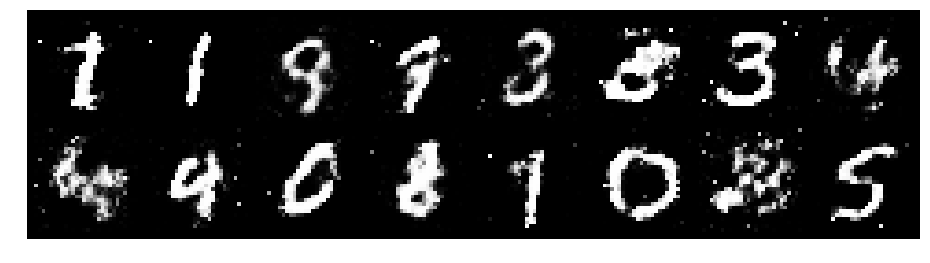

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 1.1455, Generator Loss: 0.9184
D(x): 0.6250, D(G(z)): 0.4278


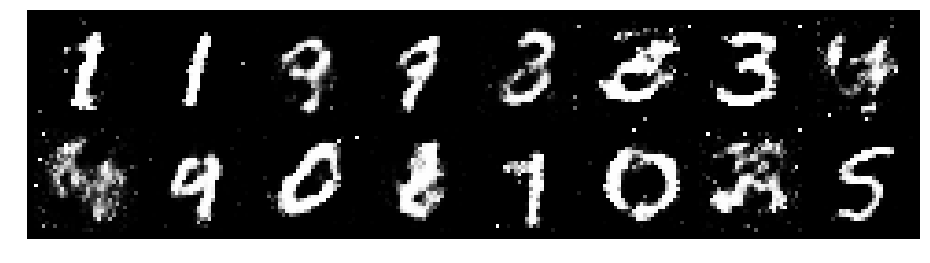

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 1.2742, Generator Loss: 1.0338
D(x): 0.5930, D(G(z)): 0.4172


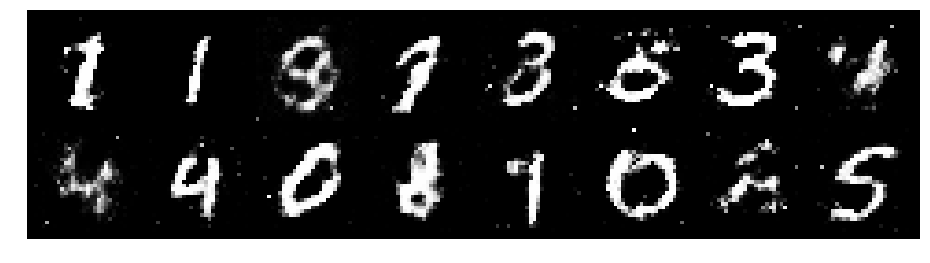

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.2019, Generator Loss: 1.0854
D(x): 0.6132, D(G(z)): 0.4226


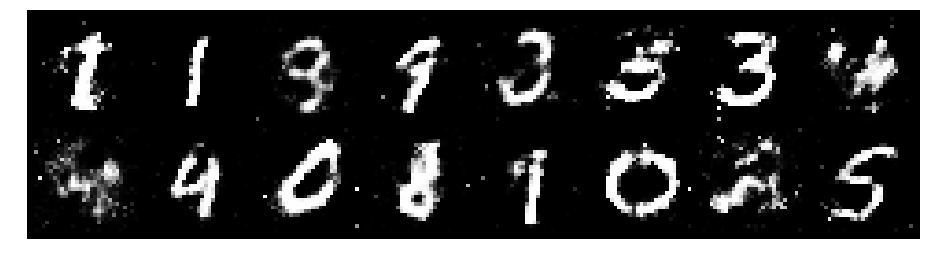

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 0.9519, Generator Loss: 1.2313
D(x): 0.7152, D(G(z)): 0.3689


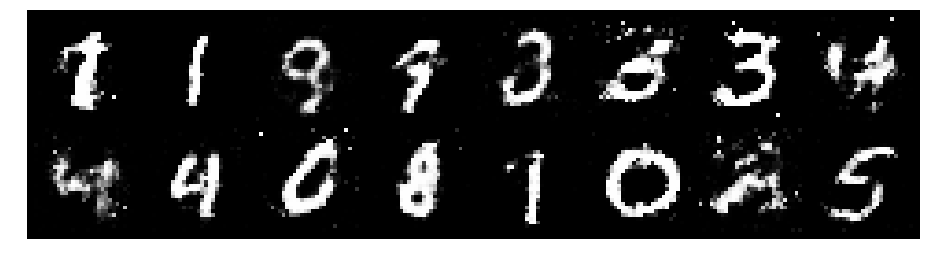

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 0.9628, Generator Loss: 1.3630
D(x): 0.6656, D(G(z)): 0.3308


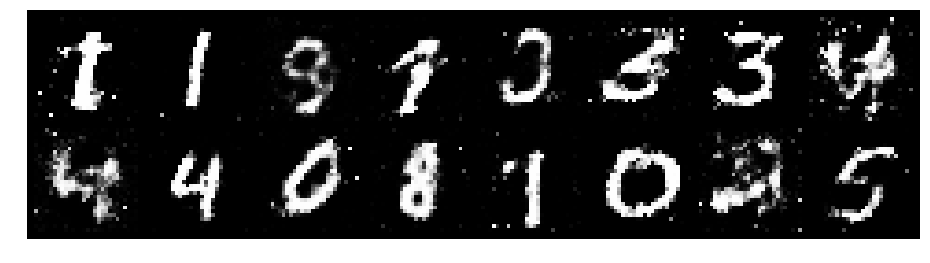

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.0363, Generator Loss: 1.1283
D(x): 0.6392, D(G(z)): 0.3880


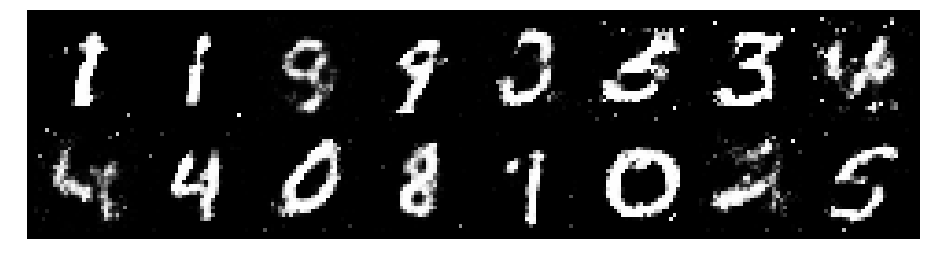

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.1884, Generator Loss: 0.9455
D(x): 0.5929, D(G(z)): 0.4263


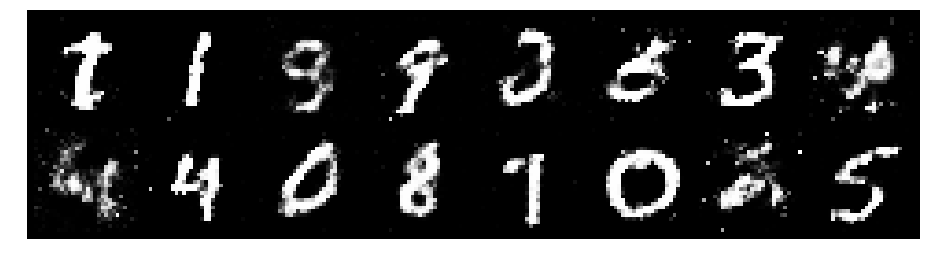

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.1547, Generator Loss: 1.1779
D(x): 0.6317, D(G(z)): 0.3973


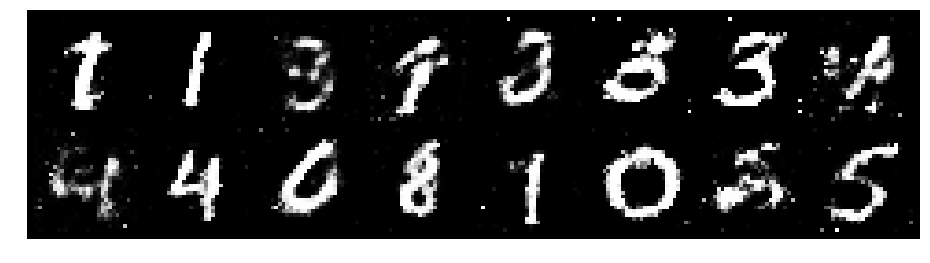

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 0.9876, Generator Loss: 1.1204
D(x): 0.6353, D(G(z)): 0.3315


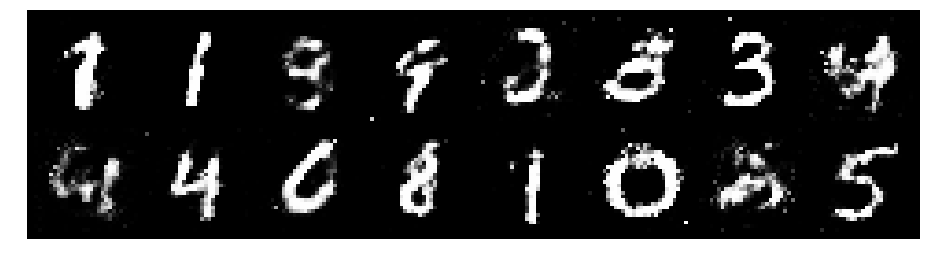

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.2406, Generator Loss: 1.1281
D(x): 0.5559, D(G(z)): 0.3984


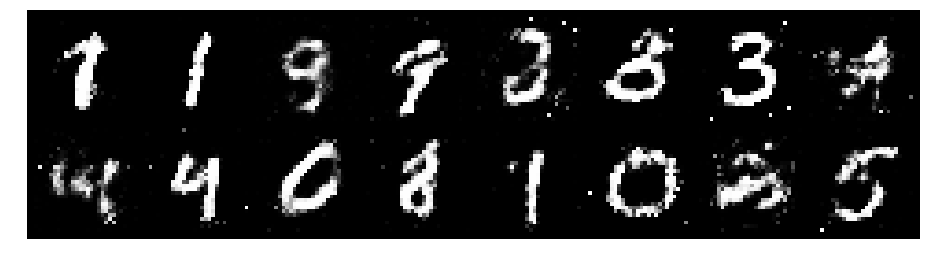

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.0291, Generator Loss: 1.2463
D(x): 0.6257, D(G(z)): 0.3494


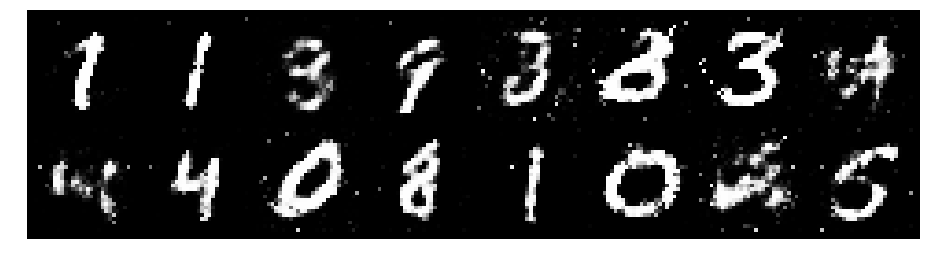

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.1175, Generator Loss: 1.2731
D(x): 0.6245, D(G(z)): 0.3730


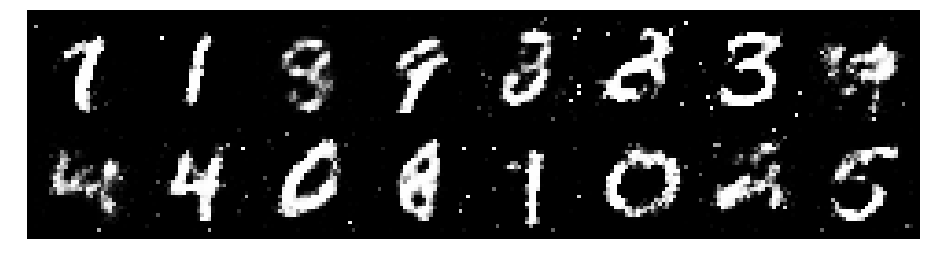

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.2172, Generator Loss: 1.2292
D(x): 0.6805, D(G(z)): 0.4547


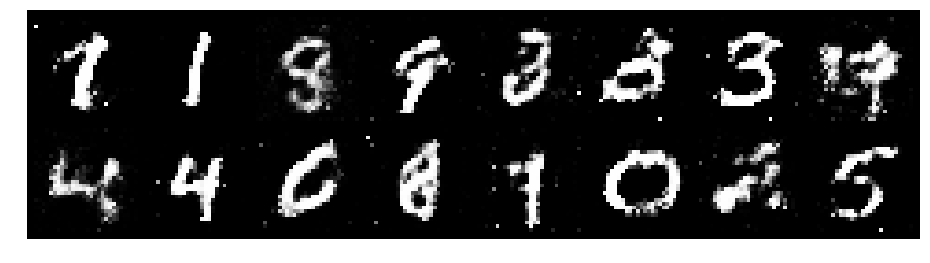

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.2428, Generator Loss: 1.1864
D(x): 0.5690, D(G(z)): 0.3942


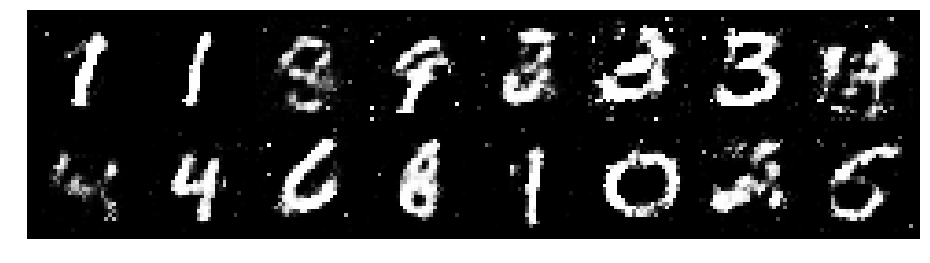

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.2196, Generator Loss: 1.0335
D(x): 0.5824, D(G(z)): 0.3859


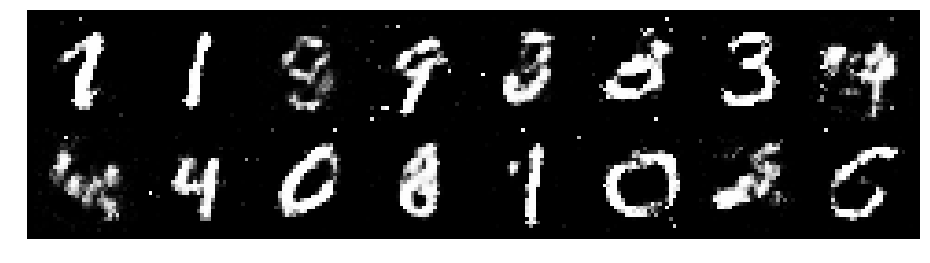

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.3529, Generator Loss: 1.0999
D(x): 0.5240, D(G(z)): 0.4182


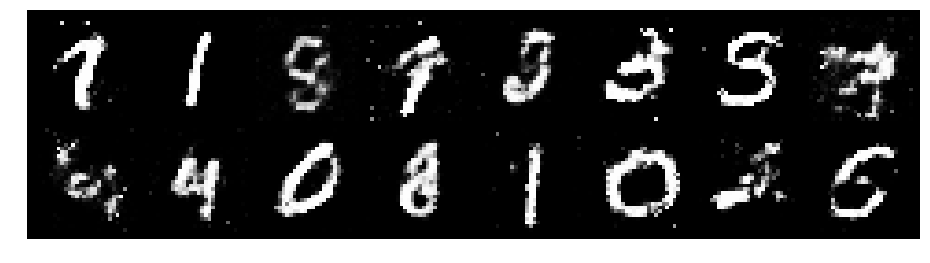

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.1120, Generator Loss: 1.0969
D(x): 0.6042, D(G(z)): 0.3651


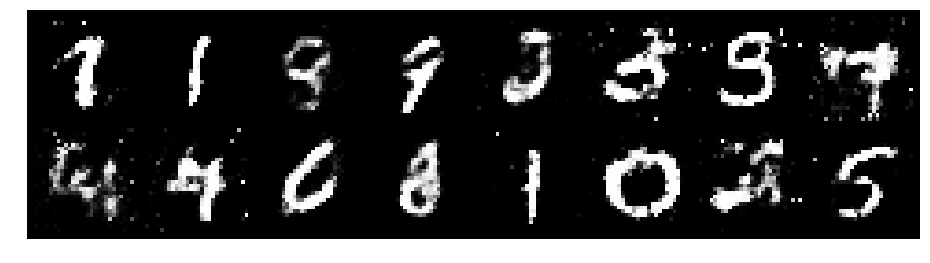

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.4339, Generator Loss: 1.2226
D(x): 0.5524, D(G(z)): 0.4339


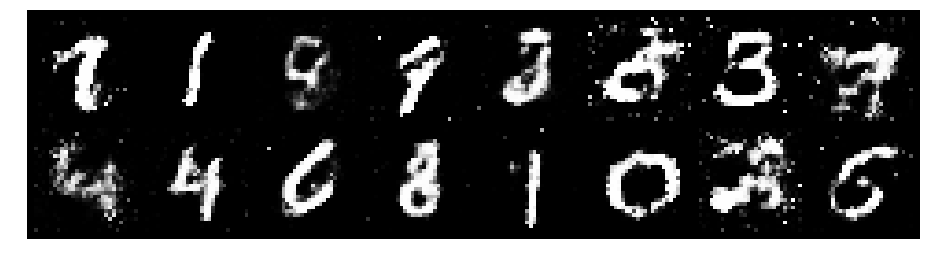

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.3738, Generator Loss: 0.9952
D(x): 0.5953, D(G(z)): 0.4479


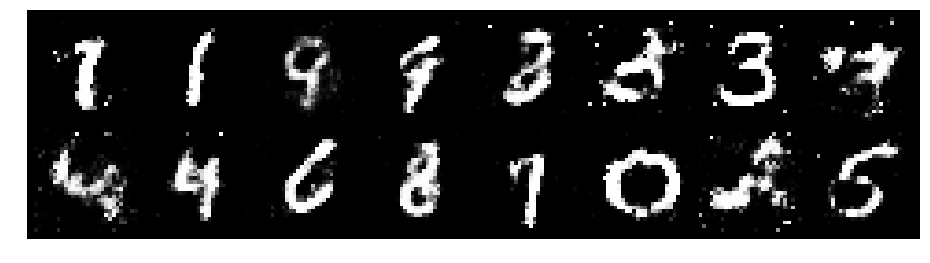

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.1074, Generator Loss: 0.9578
D(x): 0.6565, D(G(z)): 0.4165


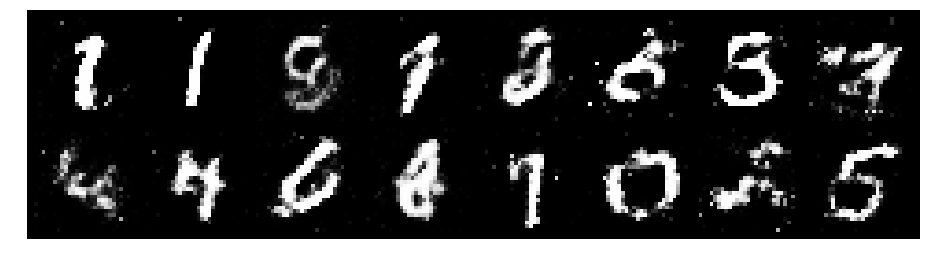

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.2211, Generator Loss: 0.8724
D(x): 0.6390, D(G(z)): 0.4810


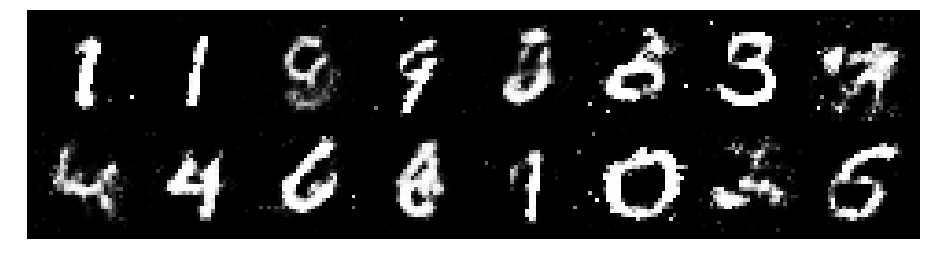

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.3296, Generator Loss: 0.8641
D(x): 0.5681, D(G(z)): 0.4321


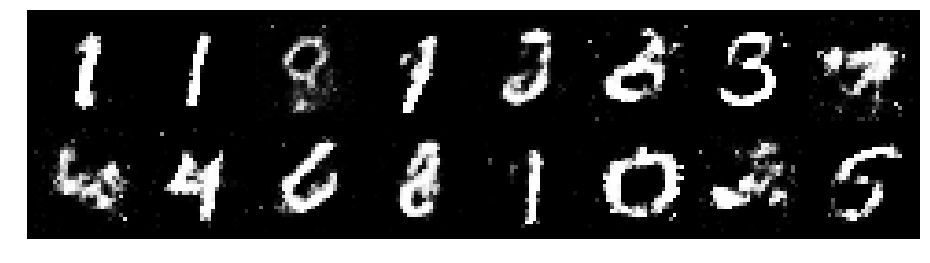

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.2620, Generator Loss: 1.0056
D(x): 0.5655, D(G(z)): 0.4166


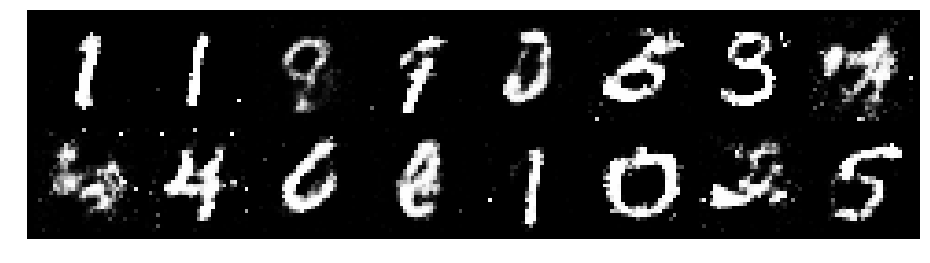

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.2127, Generator Loss: 1.0050
D(x): 0.5909, D(G(z)): 0.3732


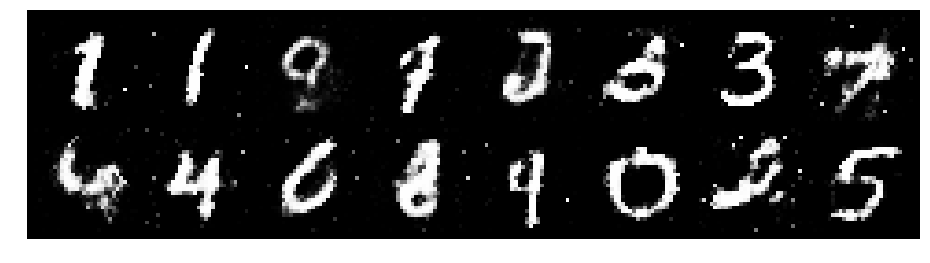

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.2555, Generator Loss: 0.9381
D(x): 0.6139, D(G(z)): 0.4470


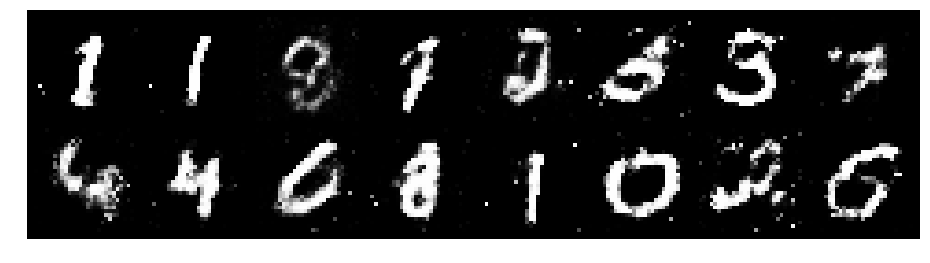

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.2742, Generator Loss: 1.1380
D(x): 0.5563, D(G(z)): 0.3962


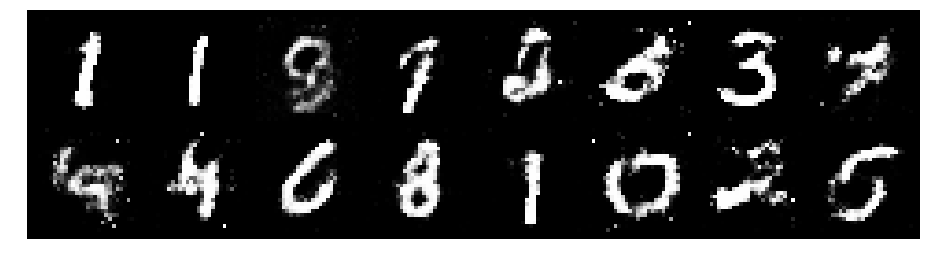

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.1699, Generator Loss: 0.9745
D(x): 0.5779, D(G(z)): 0.3831


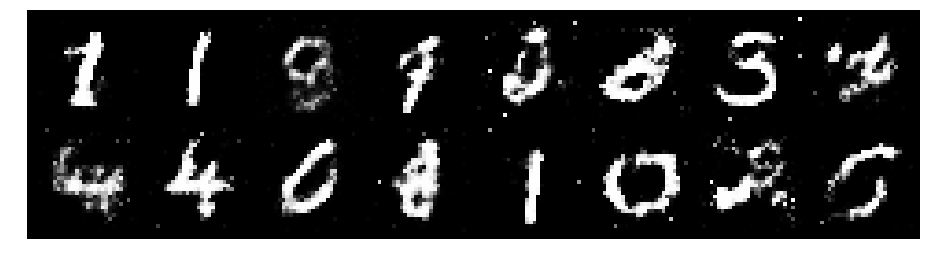

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.3166, Generator Loss: 0.9840
D(x): 0.5361, D(G(z)): 0.4144


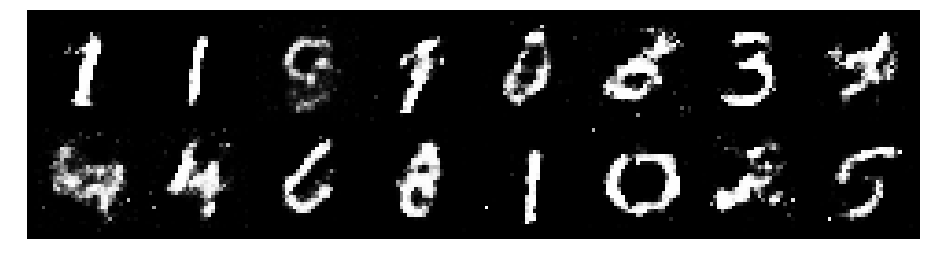

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.1111, Generator Loss: 0.9958
D(x): 0.5962, D(G(z)): 0.3689


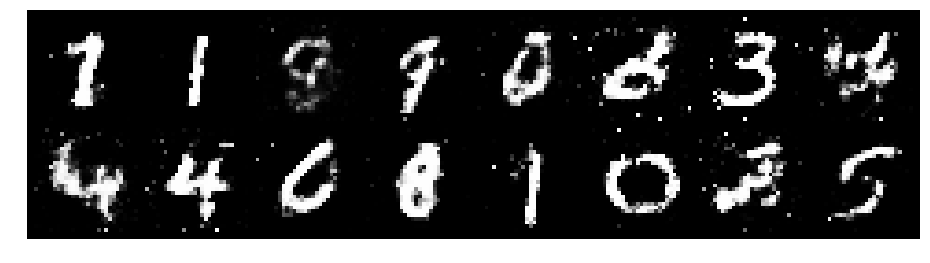

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.1218, Generator Loss: 1.0565
D(x): 0.5914, D(G(z)): 0.4019


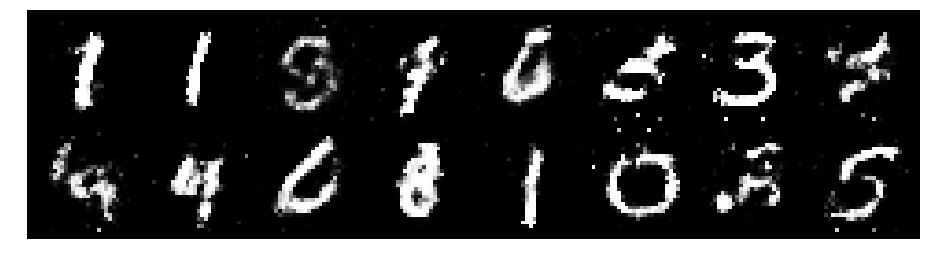

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 1.2031, Generator Loss: 0.9589
D(x): 0.5842, D(G(z)): 0.4049


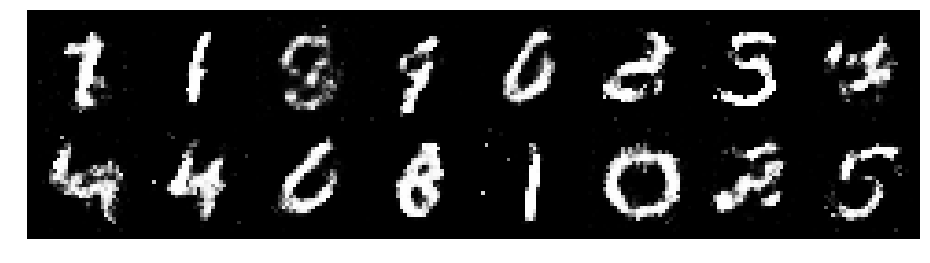

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.1383, Generator Loss: 1.0771
D(x): 0.5968, D(G(z)): 0.4034


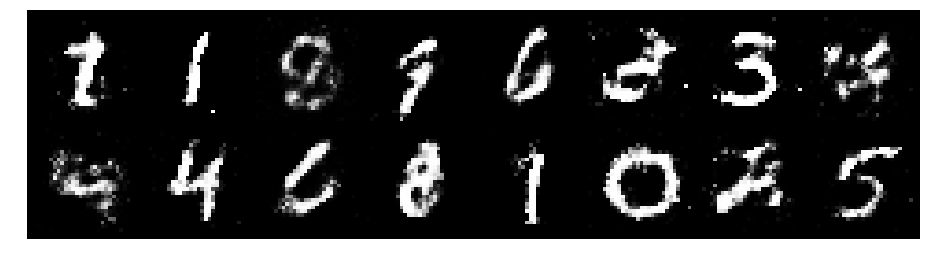

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.0377, Generator Loss: 1.1315
D(x): 0.6356, D(G(z)): 0.3456


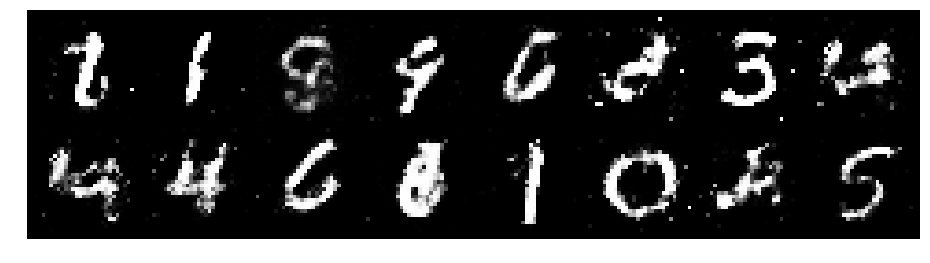

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.2636, Generator Loss: 0.9456
D(x): 0.5950, D(G(z)): 0.4505


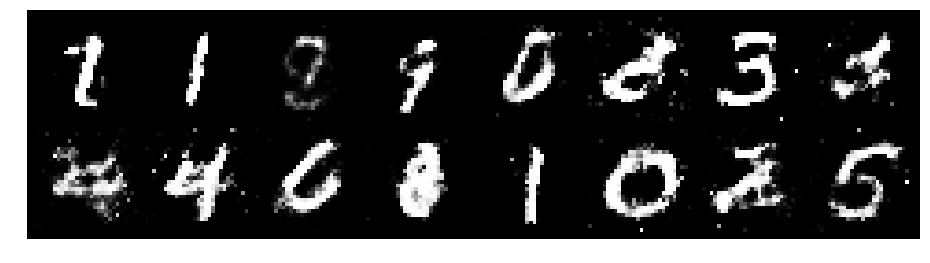

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.0792, Generator Loss: 1.1135
D(x): 0.6323, D(G(z)): 0.3941


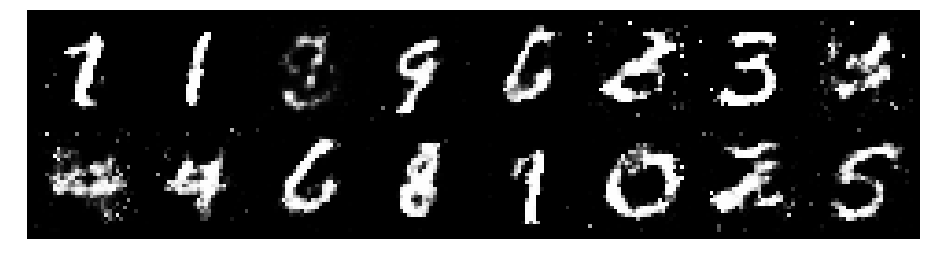

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.1392, Generator Loss: 0.9367
D(x): 0.5942, D(G(z)): 0.4158


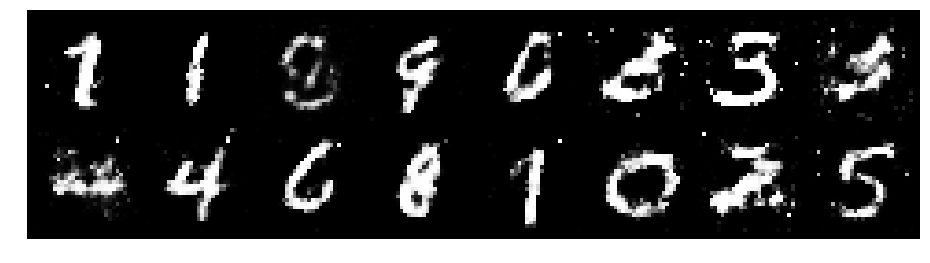

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.1888, Generator Loss: 0.9573
D(x): 0.5917, D(G(z)): 0.4260


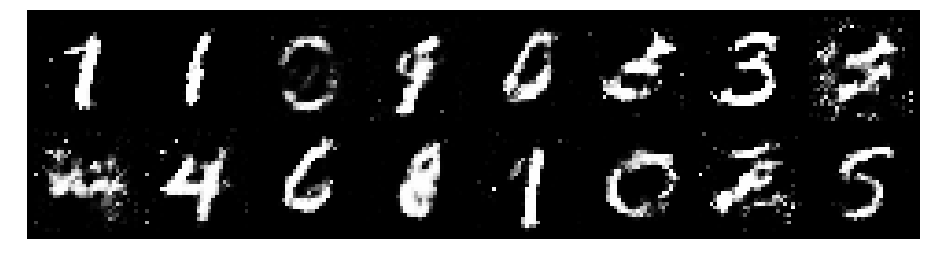

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.1106, Generator Loss: 0.8702
D(x): 0.6078, D(G(z)): 0.4227


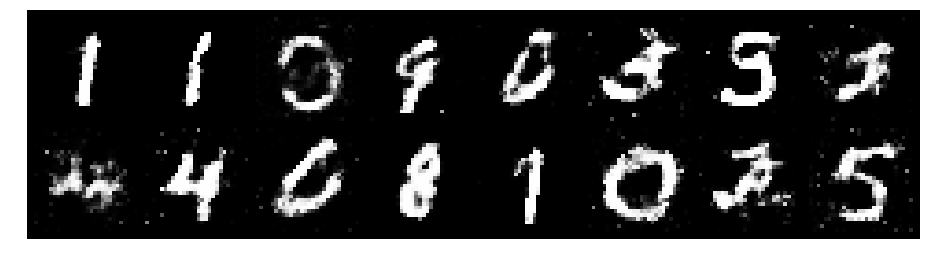

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.4359, Generator Loss: 1.0711
D(x): 0.5554, D(G(z)): 0.4150


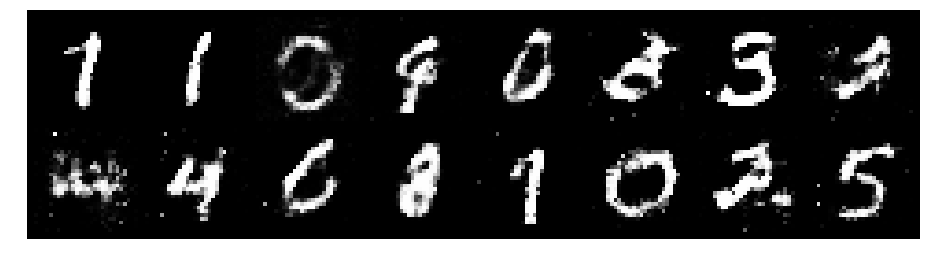

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.1927, Generator Loss: 1.2017
D(x): 0.5912, D(G(z)): 0.3904


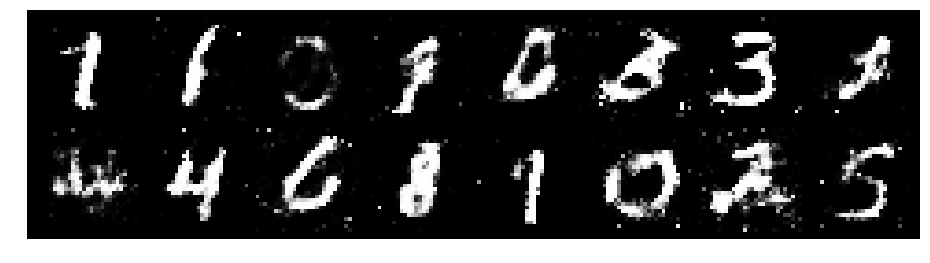

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.0691, Generator Loss: 1.0922
D(x): 0.6844, D(G(z)): 0.4113


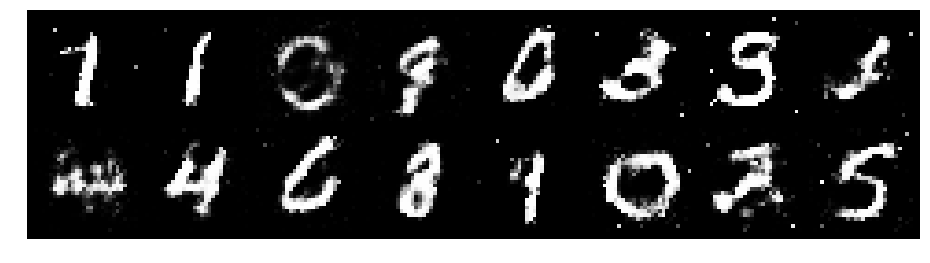

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.1686, Generator Loss: 1.0032
D(x): 0.6214, D(G(z)): 0.4252


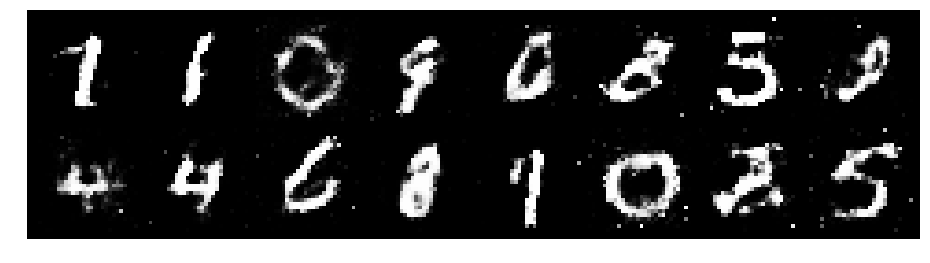

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.2244, Generator Loss: 0.8019
D(x): 0.6186, D(G(z)): 0.4829


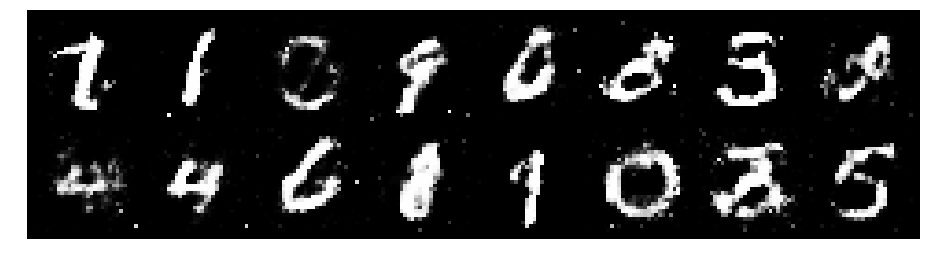

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.1966, Generator Loss: 0.9975
D(x): 0.5934, D(G(z)): 0.4056


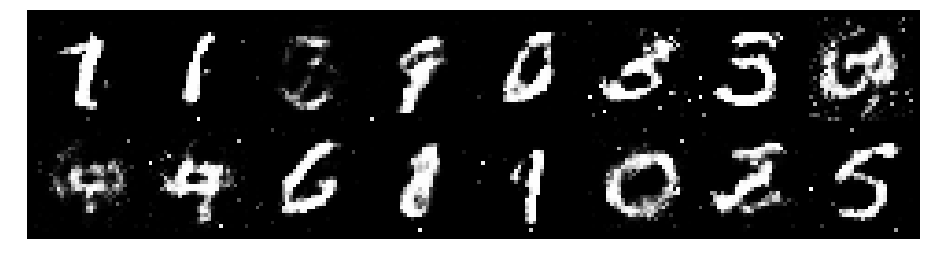

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.2391, Generator Loss: 1.0695
D(x): 0.6130, D(G(z)): 0.4450


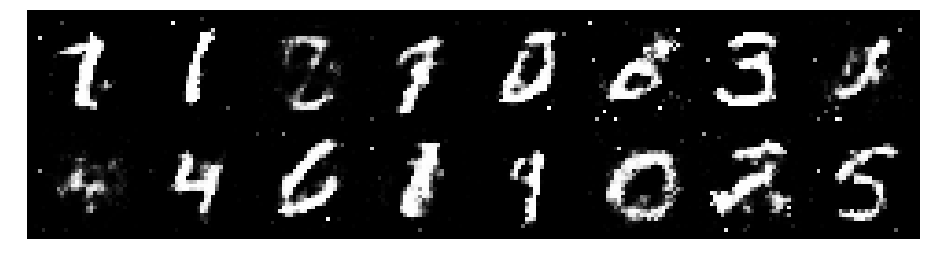

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.1921, Generator Loss: 0.9036
D(x): 0.5980, D(G(z)): 0.4231


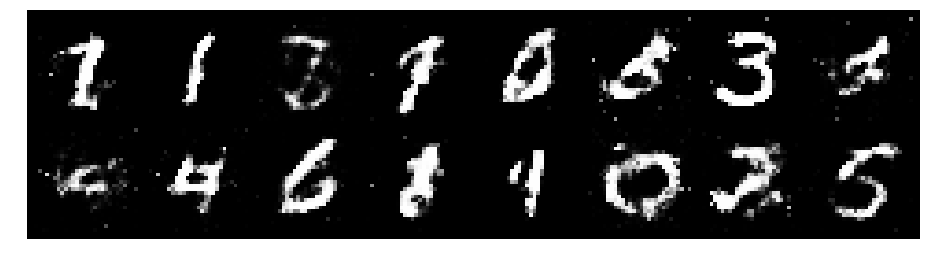

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.2750, Generator Loss: 1.0634
D(x): 0.5512, D(G(z)): 0.4159


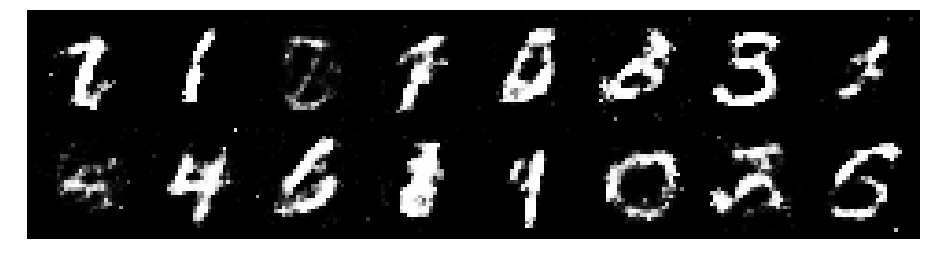

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.3511, Generator Loss: 0.8812
D(x): 0.4857, D(G(z)): 0.4270


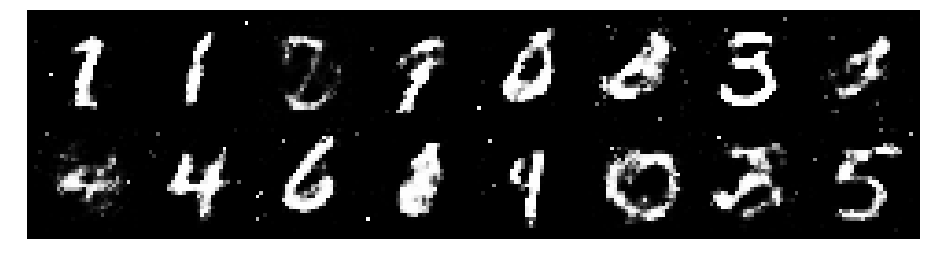

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.3627, Generator Loss: 0.9350
D(x): 0.5877, D(G(z)): 0.4616


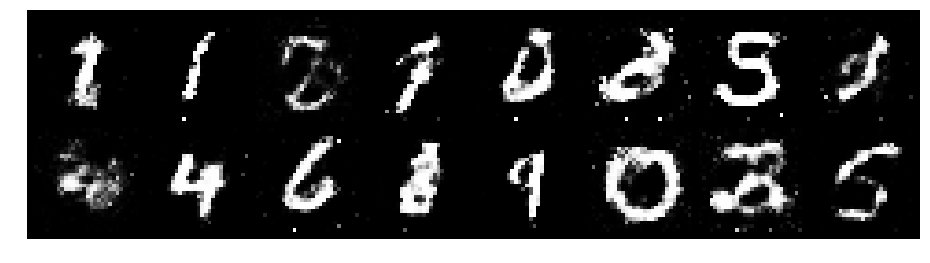

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.2610, Generator Loss: 0.9409
D(x): 0.6000, D(G(z)): 0.4605


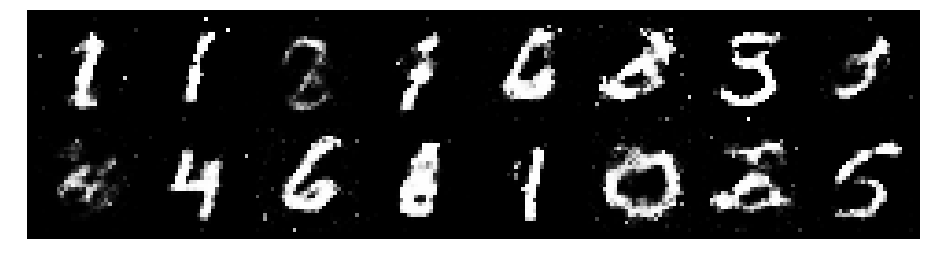

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.0565, Generator Loss: 1.2076
D(x): 0.6165, D(G(z)): 0.3587


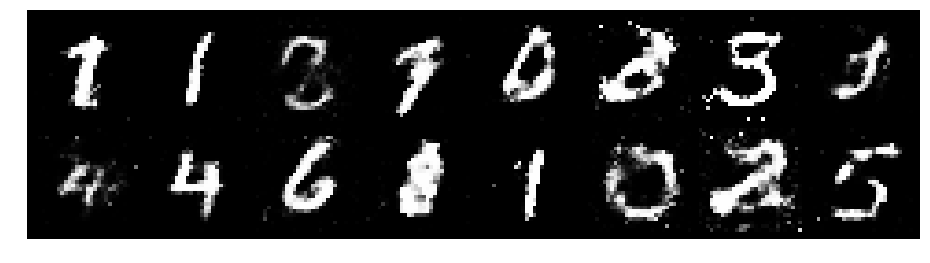

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.2350, Generator Loss: 1.2235
D(x): 0.5643, D(G(z)): 0.4147


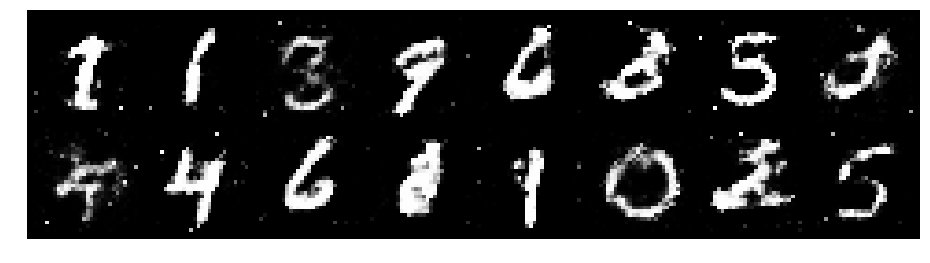

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.1200, Generator Loss: 1.0921
D(x): 0.5933, D(G(z)): 0.3957


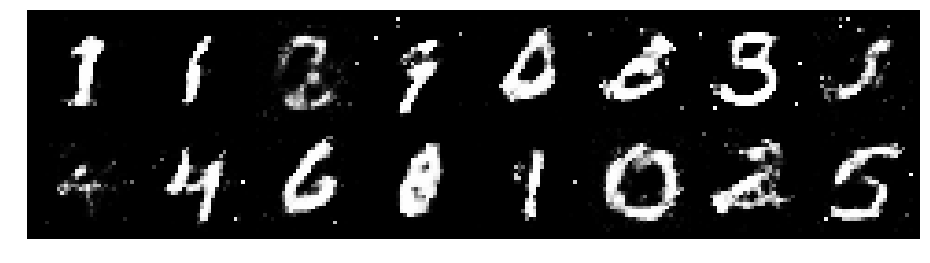

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.0727, Generator Loss: 1.2579
D(x): 0.5726, D(G(z)): 0.3379


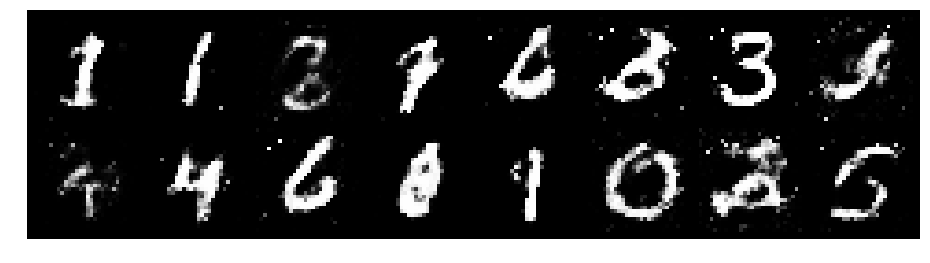

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 0.9758, Generator Loss: 1.0819
D(x): 0.6179, D(G(z)): 0.3379


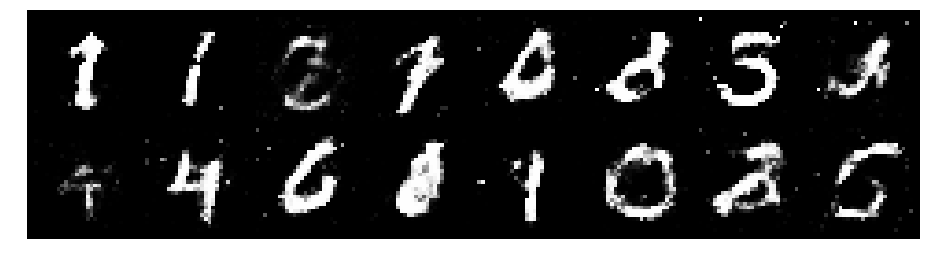

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.0162, Generator Loss: 1.0600
D(x): 0.6304, D(G(z)): 0.3751


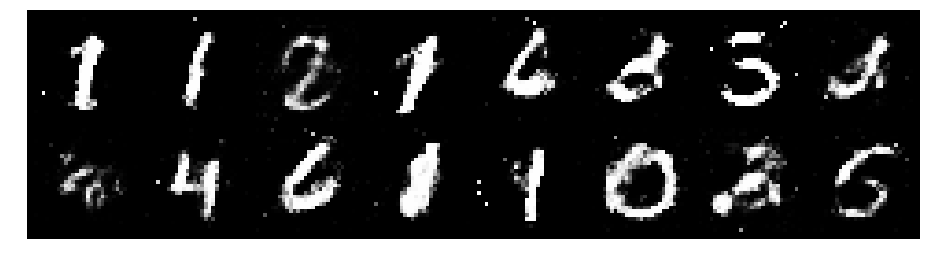

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.1407, Generator Loss: 1.0911
D(x): 0.6121, D(G(z)): 0.3977


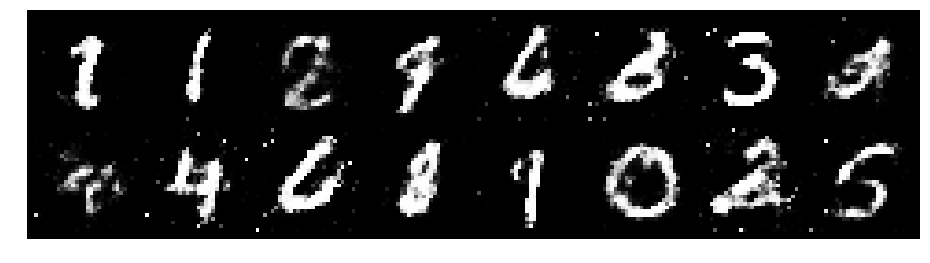

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.1471, Generator Loss: 1.1357
D(x): 0.5723, D(G(z)): 0.3759


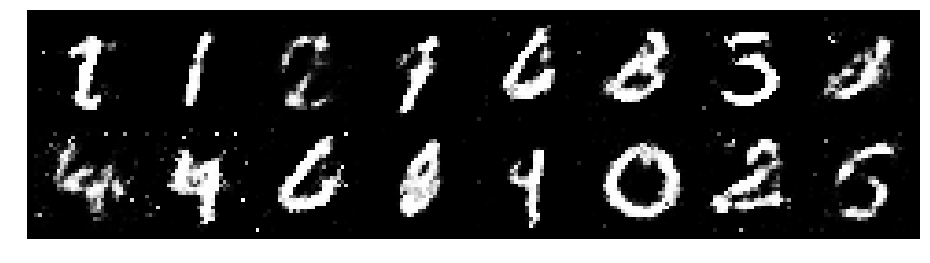

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.1051, Generator Loss: 1.1108
D(x): 0.6305, D(G(z)): 0.3881


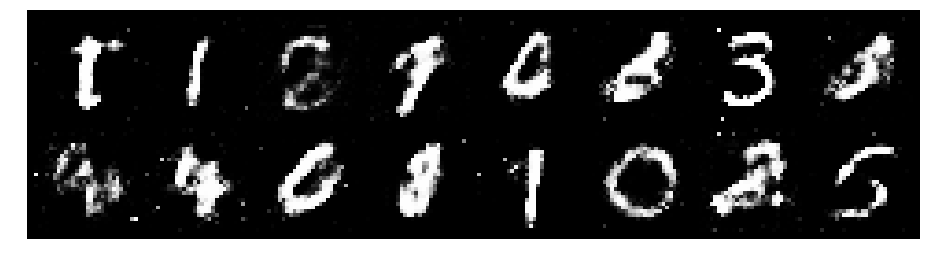

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.1261, Generator Loss: 1.1390
D(x): 0.6335, D(G(z)): 0.3982


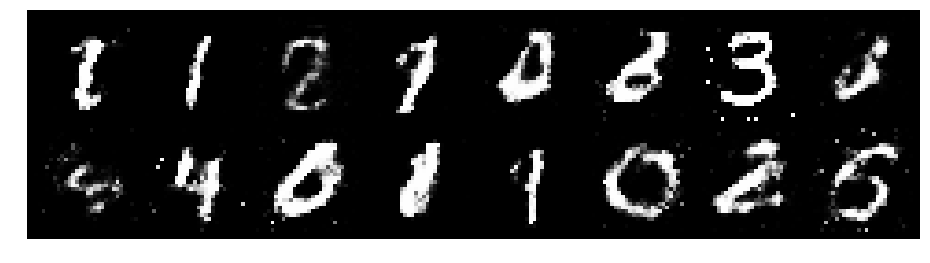

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 0.9438, Generator Loss: 1.0889
D(x): 0.6603, D(G(z)): 0.3437


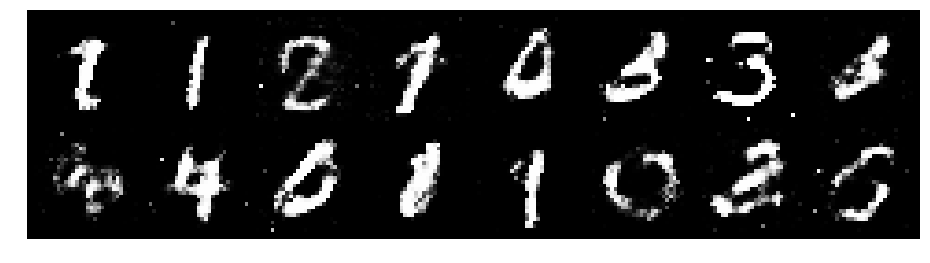

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.1663, Generator Loss: 1.0292
D(x): 0.5736, D(G(z)): 0.3920


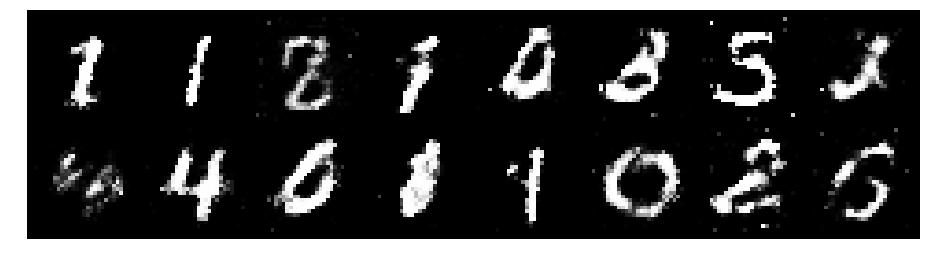

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.1373, Generator Loss: 1.3464
D(x): 0.6120, D(G(z)): 0.3895


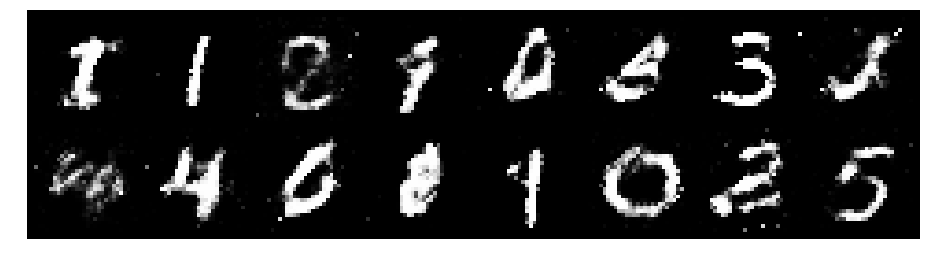

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.0666, Generator Loss: 1.0459
D(x): 0.5970, D(G(z)): 0.3790


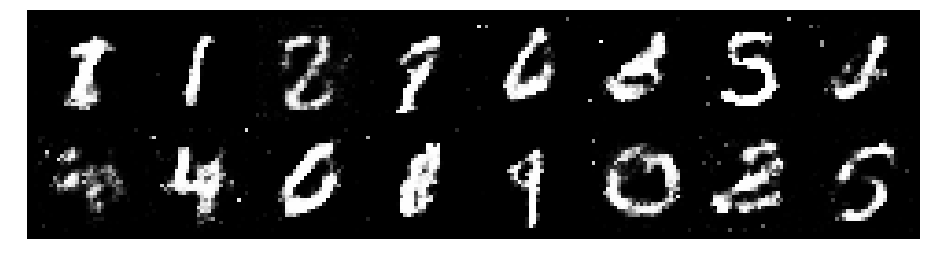

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.0528, Generator Loss: 1.0218
D(x): 0.6227, D(G(z)): 0.3767


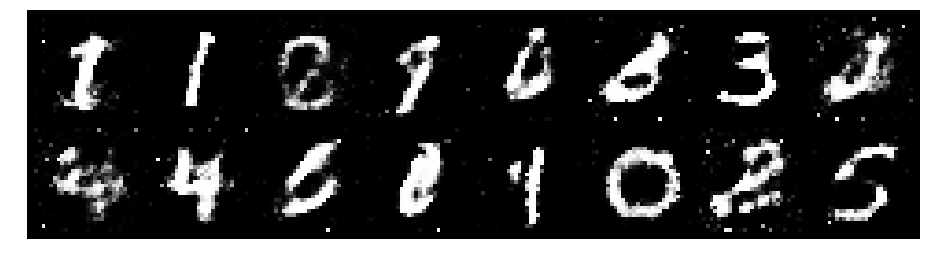

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.2574, Generator Loss: 0.9880
D(x): 0.5985, D(G(z)): 0.4206


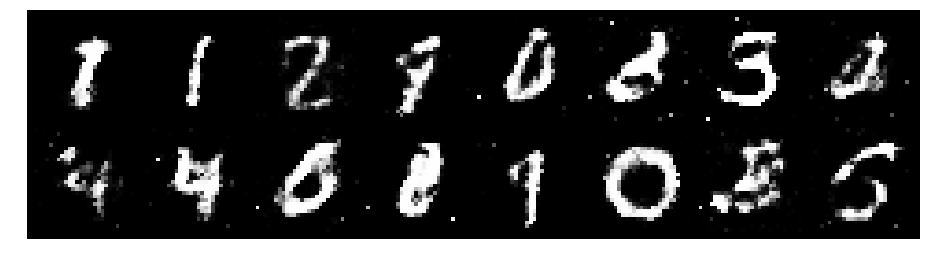

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.0925, Generator Loss: 1.1472
D(x): 0.6397, D(G(z)): 0.3827


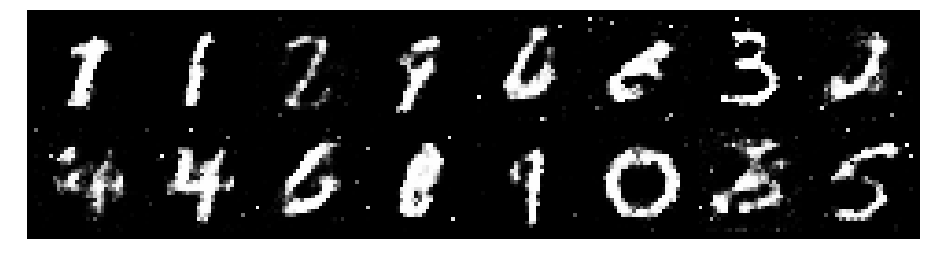

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.2512, Generator Loss: 1.1452
D(x): 0.6169, D(G(z)): 0.4136


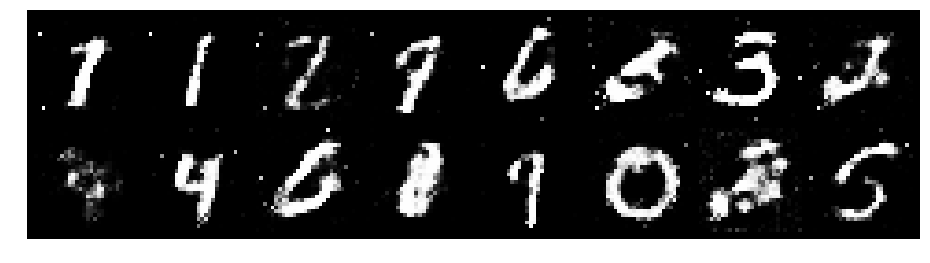

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.0555, Generator Loss: 1.1657
D(x): 0.6138, D(G(z)): 0.3623


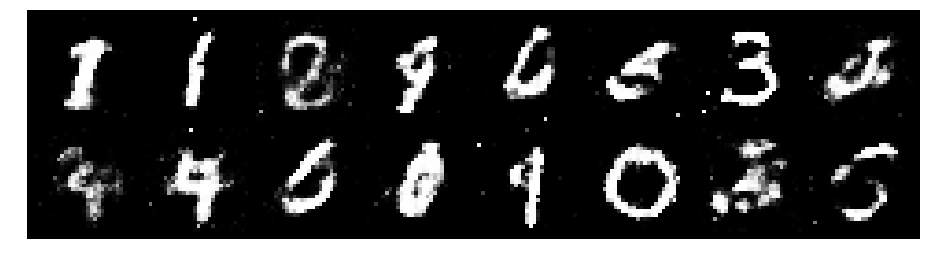

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.2008, Generator Loss: 0.9907
D(x): 0.5983, D(G(z)): 0.4093


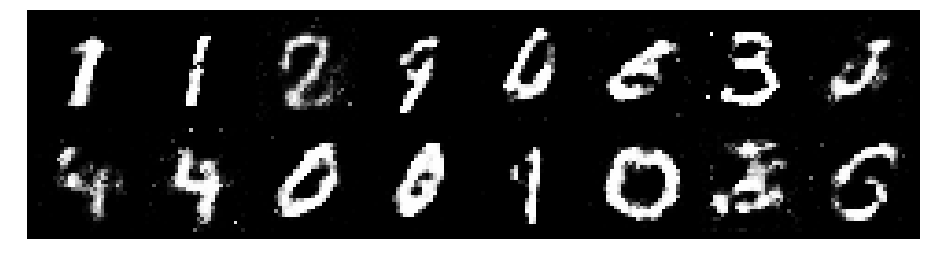

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.2633, Generator Loss: 0.9646
D(x): 0.5976, D(G(z)): 0.4338


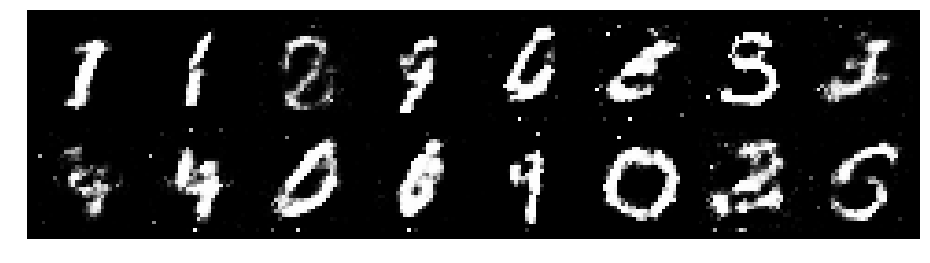

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.0418, Generator Loss: 1.3208
D(x): 0.6557, D(G(z)): 0.3442


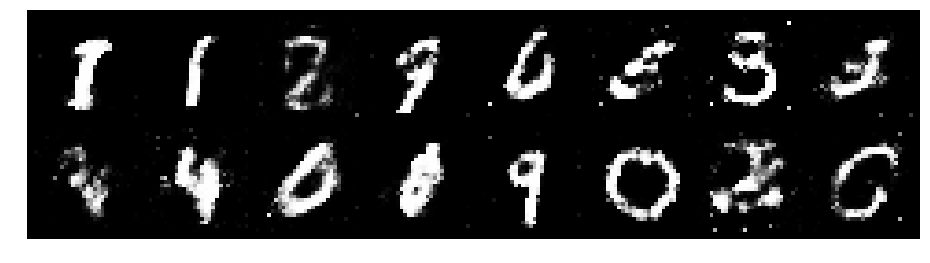

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.2170, Generator Loss: 1.0217
D(x): 0.5365, D(G(z)): 0.3965


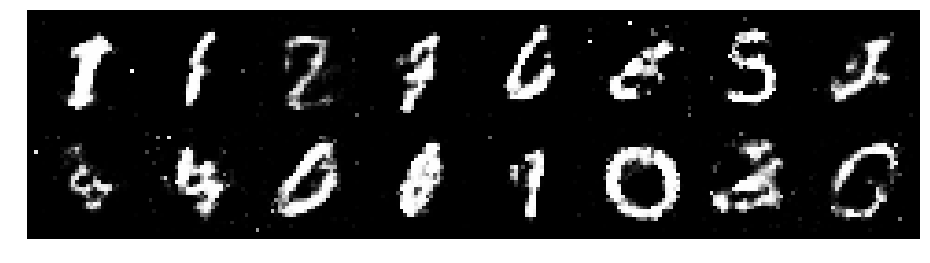

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.3278, Generator Loss: 0.8324
D(x): 0.5971, D(G(z)): 0.4784


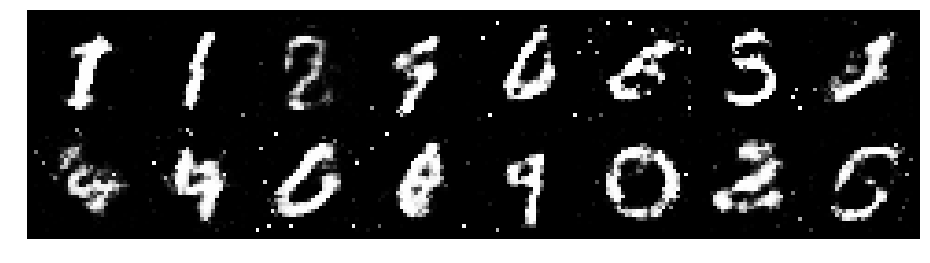

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.2987, Generator Loss: 1.0911
D(x): 0.6099, D(G(z)): 0.4430


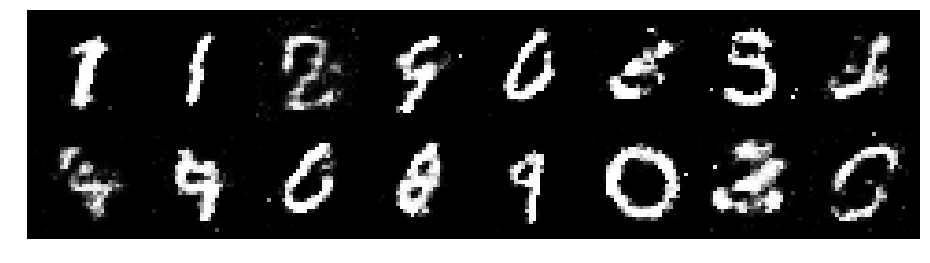

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.0373, Generator Loss: 1.2375
D(x): 0.6425, D(G(z)): 0.3777


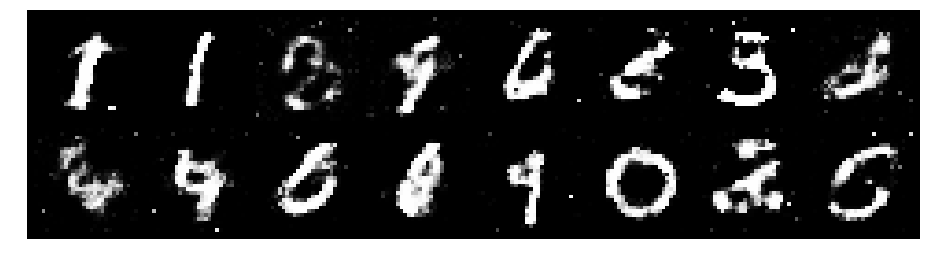

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.0852, Generator Loss: 1.0959
D(x): 0.6535, D(G(z)): 0.4028


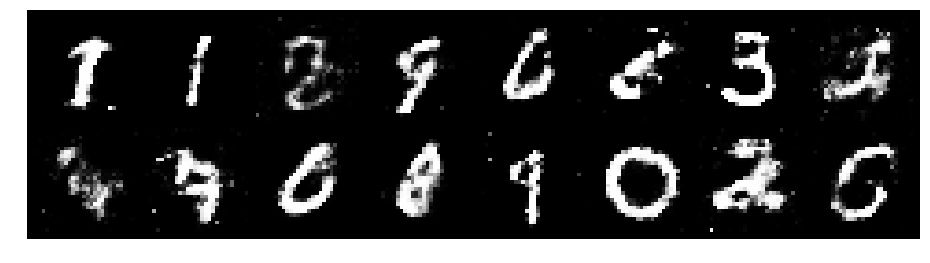

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.2188, Generator Loss: 1.1926
D(x): 0.5669, D(G(z)): 0.4154


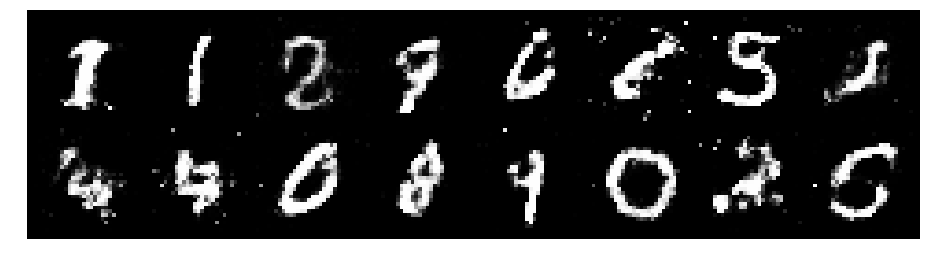

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.2547, Generator Loss: 0.9638
D(x): 0.5474, D(G(z)): 0.4159


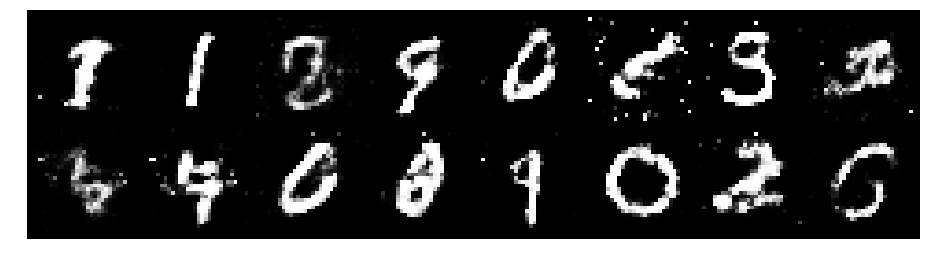

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.3123, Generator Loss: 0.8885
D(x): 0.5691, D(G(z)): 0.4662


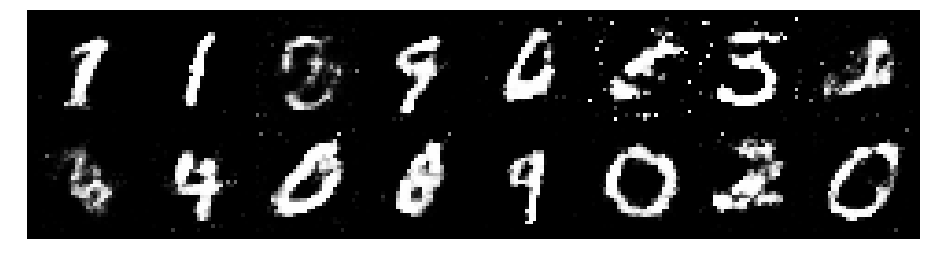

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.3198, Generator Loss: 0.8539
D(x): 0.5864, D(G(z)): 0.4673


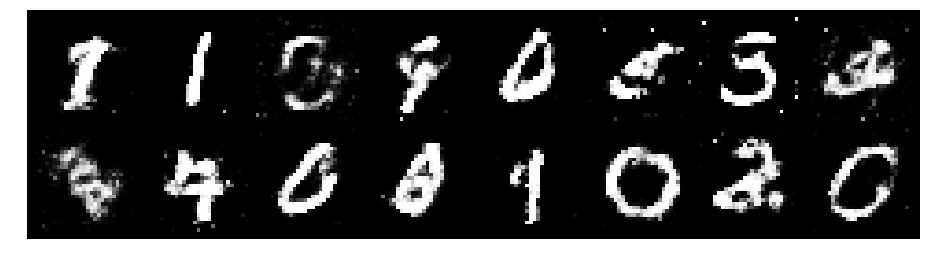

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.2354, Generator Loss: 0.9241
D(x): 0.6061, D(G(z)): 0.4724


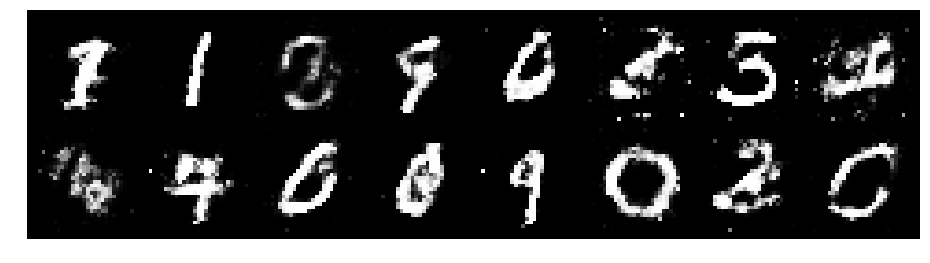

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.2601, Generator Loss: 0.9432
D(x): 0.5611, D(G(z)): 0.4247


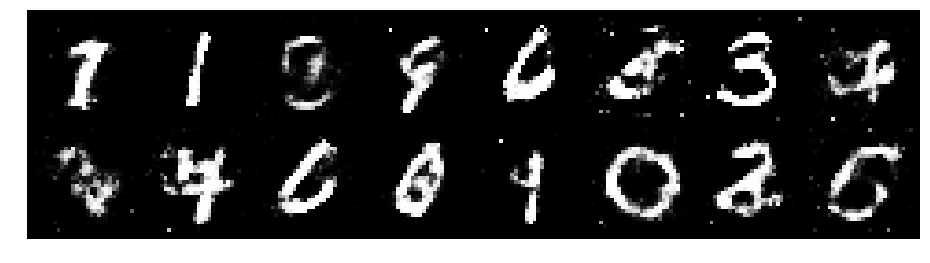

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.2557, Generator Loss: 0.8478
D(x): 0.5756, D(G(z)): 0.4601


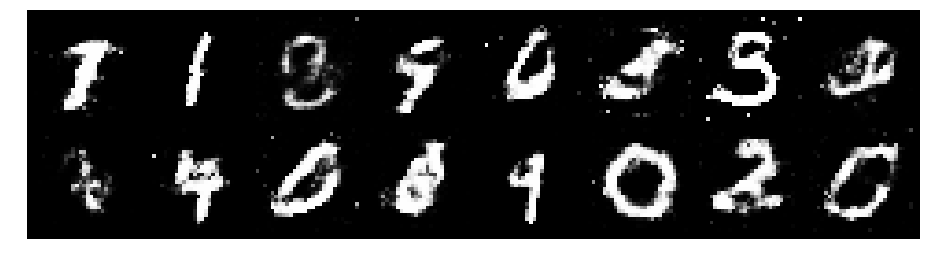

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.1629, Generator Loss: 1.1006
D(x): 0.5870, D(G(z)): 0.3899


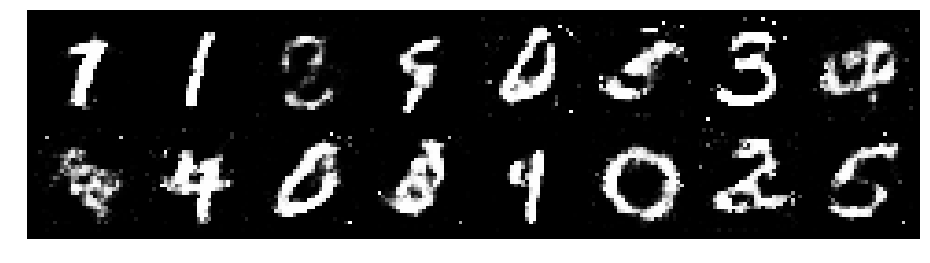

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.3569, Generator Loss: 1.2371
D(x): 0.5966, D(G(z)): 0.4445


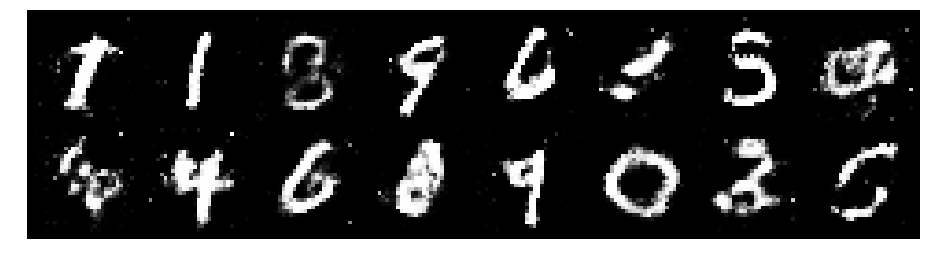

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.2599, Generator Loss: 0.9940
D(x): 0.5358, D(G(z)): 0.3624


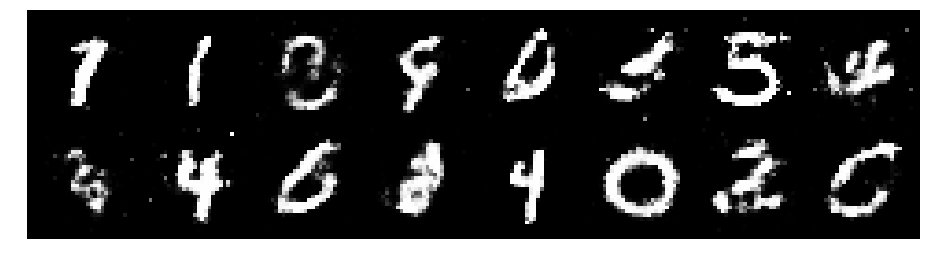

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.1596, Generator Loss: 1.2505
D(x): 0.5939, D(G(z)): 0.3645


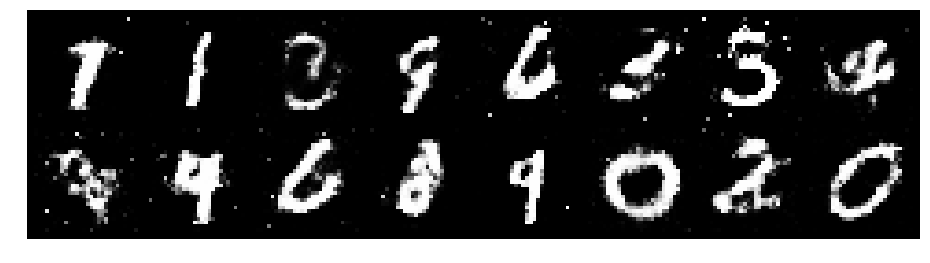

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 0.9773, Generator Loss: 1.3630
D(x): 0.6303, D(G(z)): 0.3004


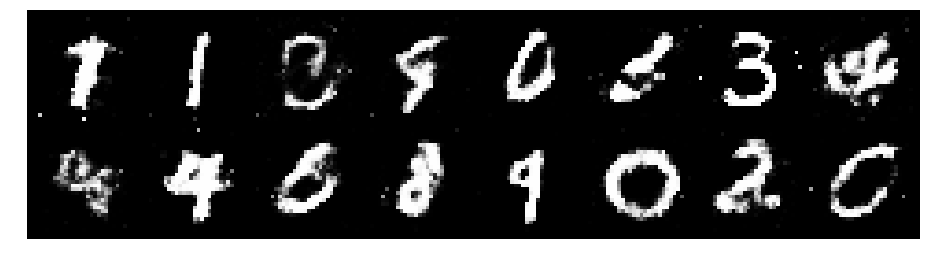

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.0425, Generator Loss: 1.0273
D(x): 0.6226, D(G(z)): 0.3907


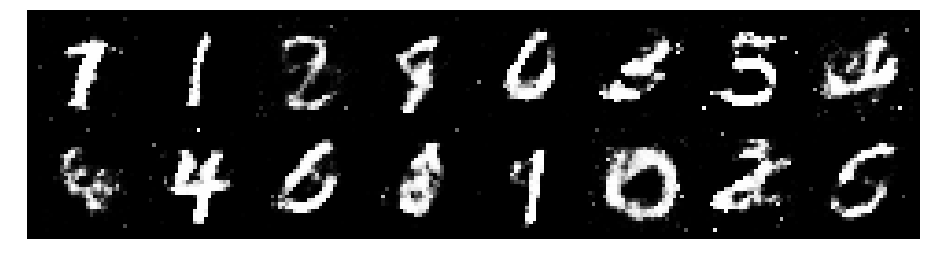

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.2147, Generator Loss: 0.9810
D(x): 0.5514, D(G(z)): 0.4153


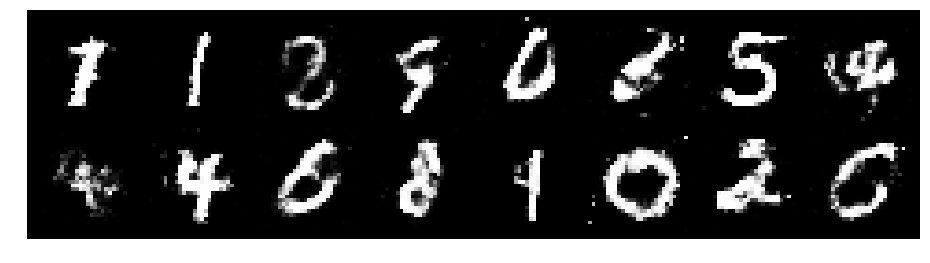

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.1750, Generator Loss: 0.9238
D(x): 0.5608, D(G(z)): 0.4086


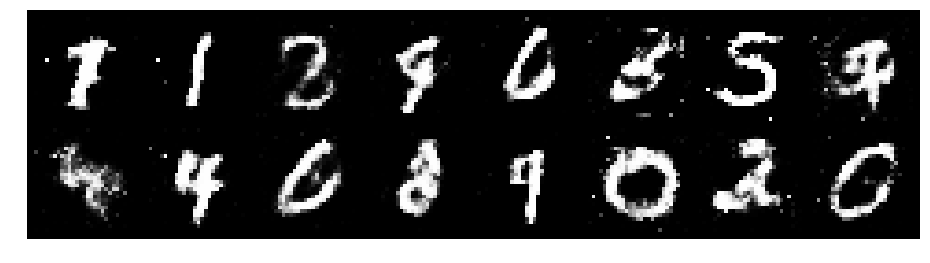

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.2998, Generator Loss: 0.9715
D(x): 0.5295, D(G(z)): 0.4051


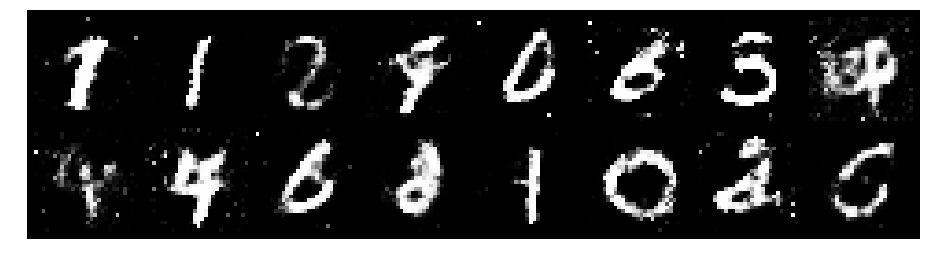

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.2231, Generator Loss: 1.0449
D(x): 0.6171, D(G(z)): 0.4676


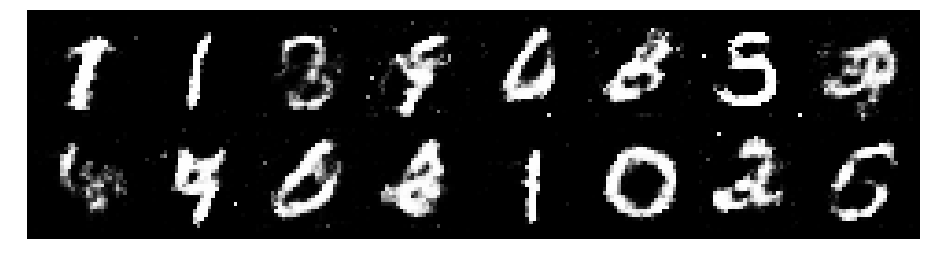

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.3190, Generator Loss: 0.7738
D(x): 0.5611, D(G(z)): 0.4833


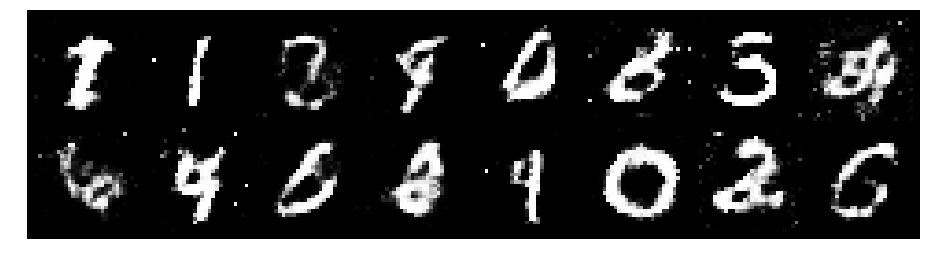

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.3726, Generator Loss: 0.8759
D(x): 0.5157, D(G(z)): 0.4439


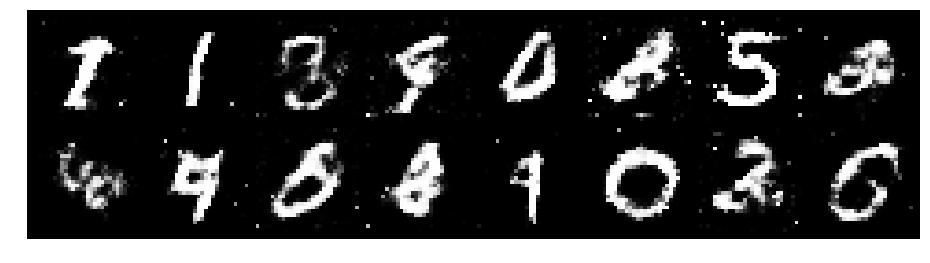

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.2656, Generator Loss: 0.9436
D(x): 0.5831, D(G(z)): 0.4515


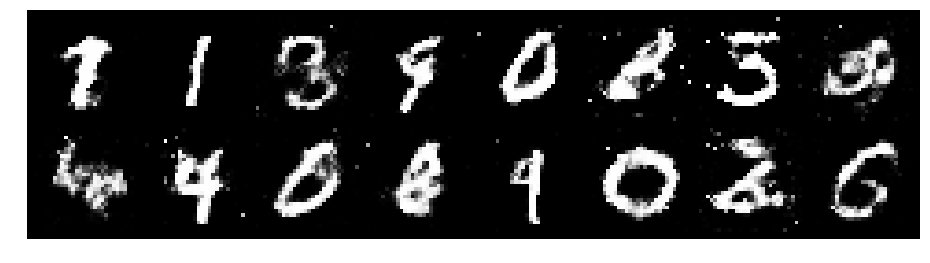

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.1966, Generator Loss: 0.9922
D(x): 0.5830, D(G(z)): 0.4236


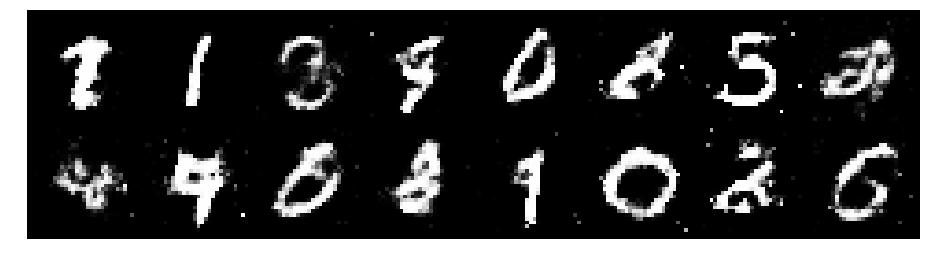

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.1160, Generator Loss: 1.0148
D(x): 0.5853, D(G(z)): 0.3752


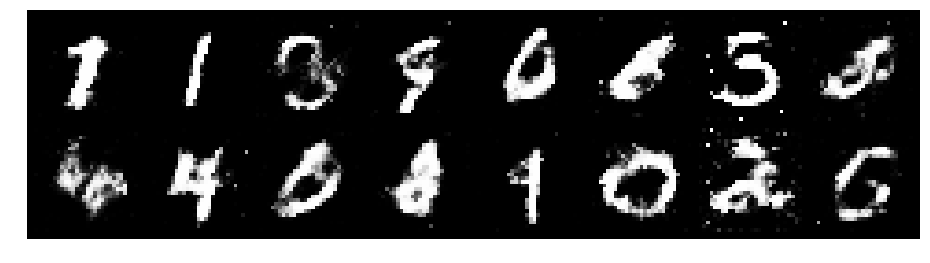

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.2101, Generator Loss: 1.0479
D(x): 0.5796, D(G(z)): 0.4204


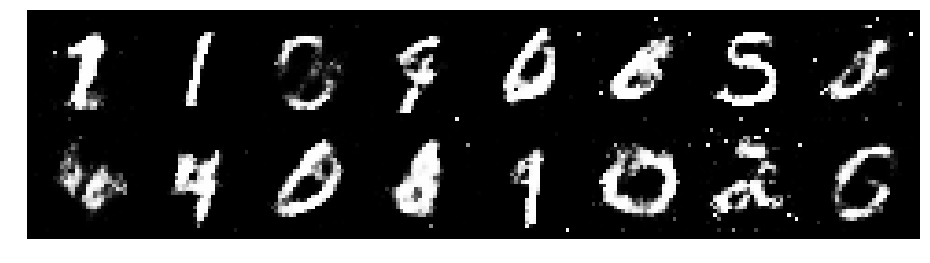

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.2486, Generator Loss: 1.0639
D(x): 0.5430, D(G(z)): 0.3984


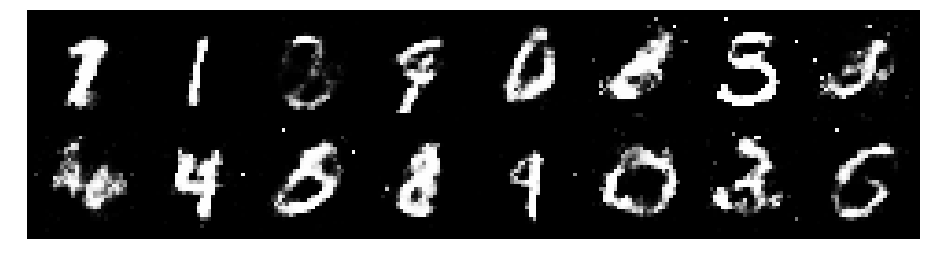

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.2720, Generator Loss: 1.1642
D(x): 0.5907, D(G(z)): 0.4237


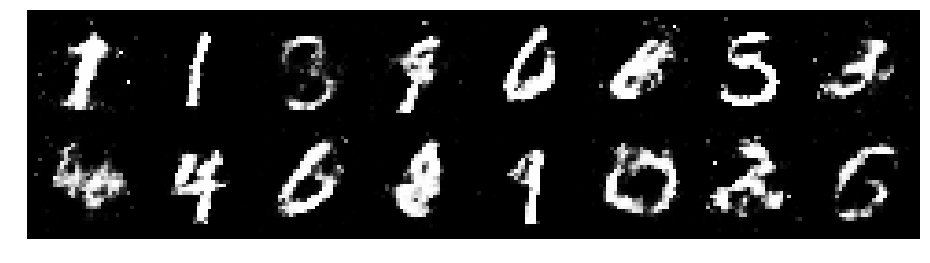

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.0987, Generator Loss: 1.0732
D(x): 0.6154, D(G(z)): 0.4091


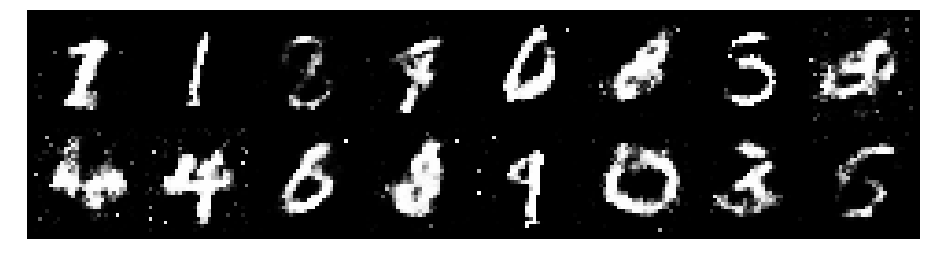

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.2145, Generator Loss: 0.9788
D(x): 0.6089, D(G(z)): 0.4604


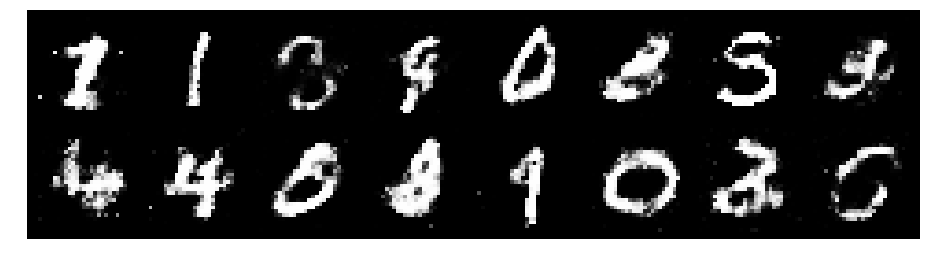

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.0633, Generator Loss: 1.0073
D(x): 0.6125, D(G(z)): 0.3537


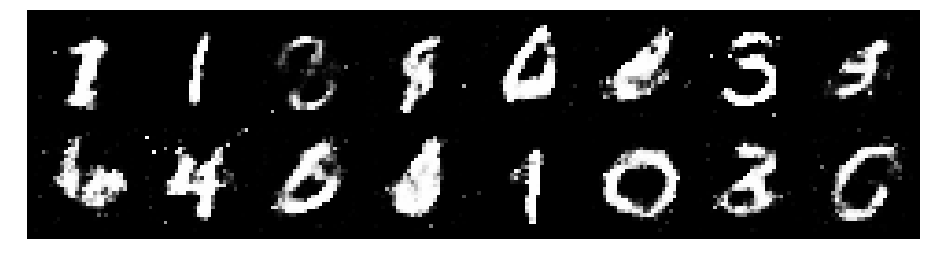

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.2961, Generator Loss: 0.9370
D(x): 0.5183, D(G(z)): 0.4137


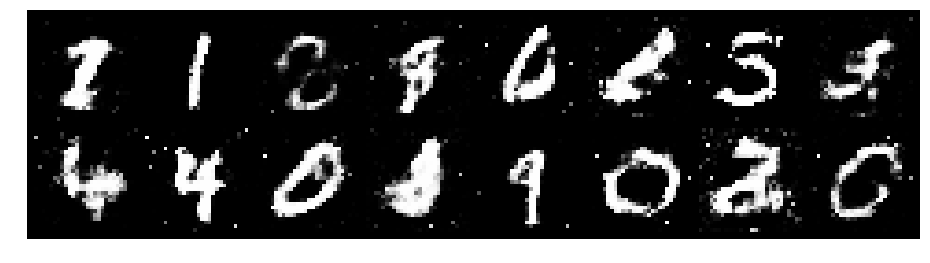

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.2192, Generator Loss: 0.7359
D(x): 0.5697, D(G(z)): 0.4491


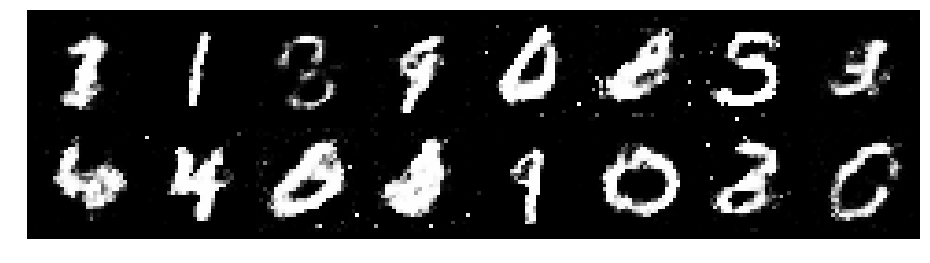

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.2469, Generator Loss: 0.9603
D(x): 0.5433, D(G(z)): 0.3804


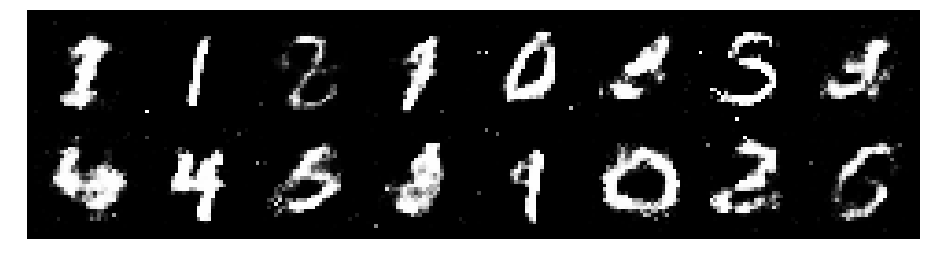

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.3992, Generator Loss: 0.7812
D(x): 0.5835, D(G(z)): 0.4856


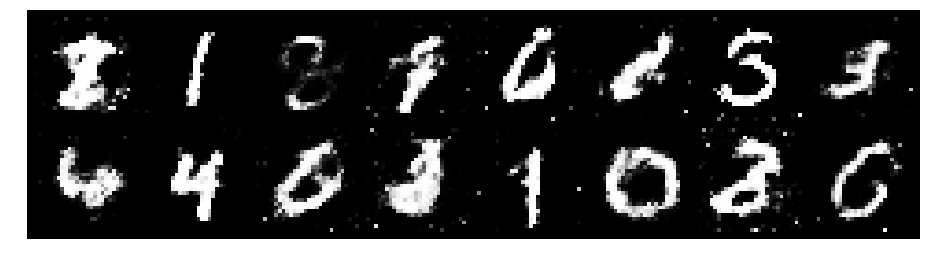

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.2934, Generator Loss: 1.0772
D(x): 0.5674, D(G(z)): 0.4292


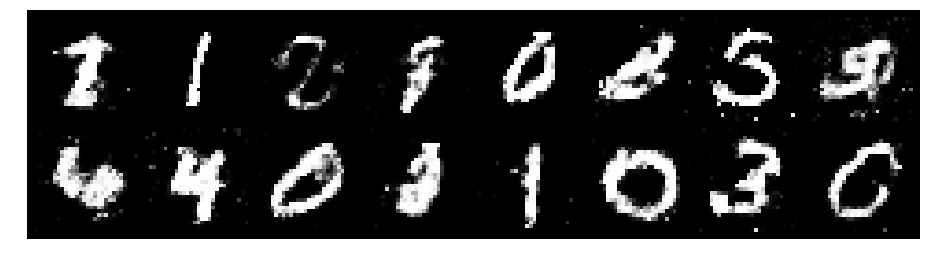

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.2993, Generator Loss: 0.9528
D(x): 0.5740, D(G(z)): 0.4520


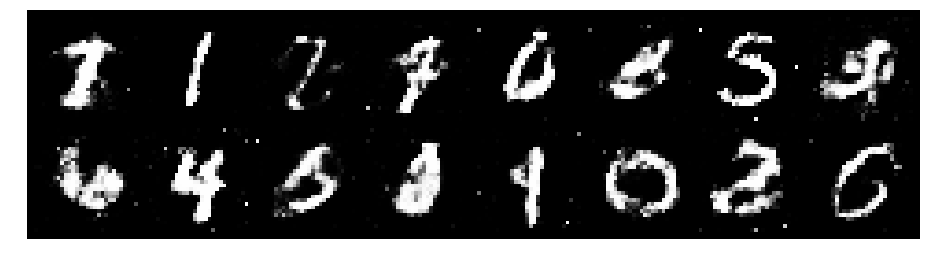

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.2362, Generator Loss: 1.0203
D(x): 0.5348, D(G(z)): 0.4032


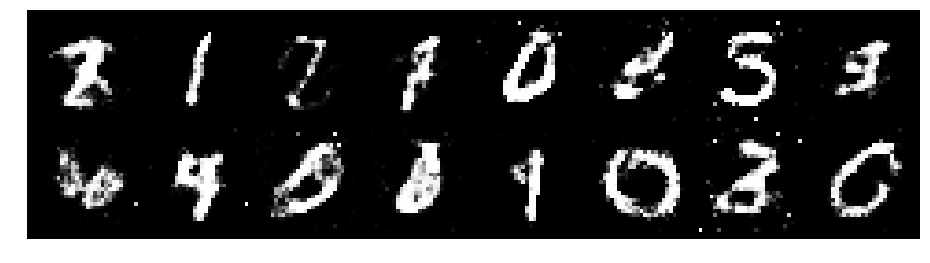

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.3482, Generator Loss: 0.9614
D(x): 0.5223, D(G(z)): 0.4323


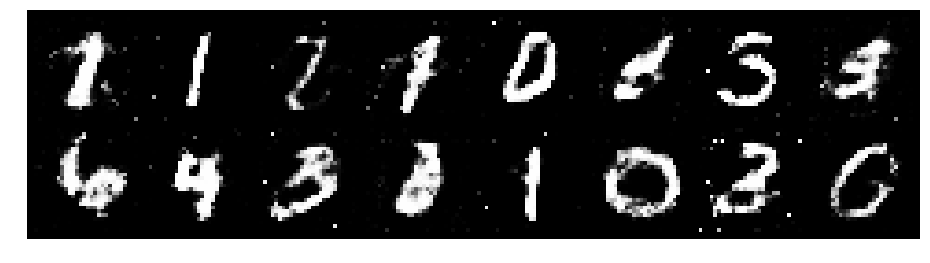

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.3143, Generator Loss: 1.1274
D(x): 0.5804, D(G(z)): 0.4420


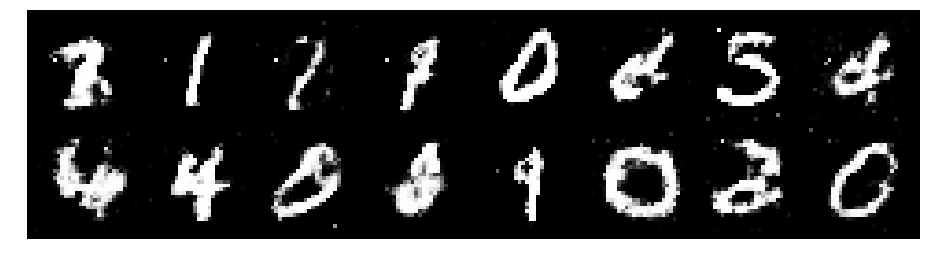

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.0862, Generator Loss: 1.1526
D(x): 0.6149, D(G(z)): 0.3587


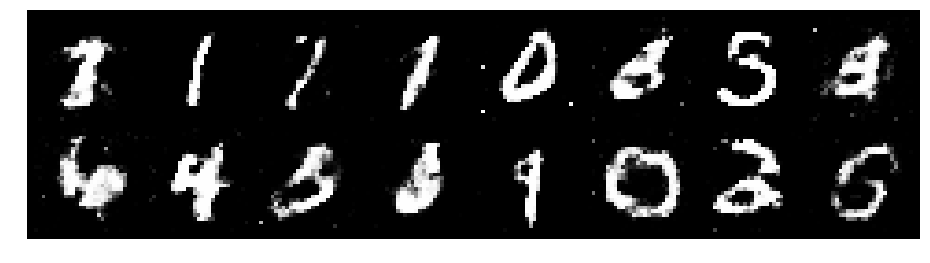

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.0591, Generator Loss: 1.0609
D(x): 0.6139, D(G(z)): 0.3734


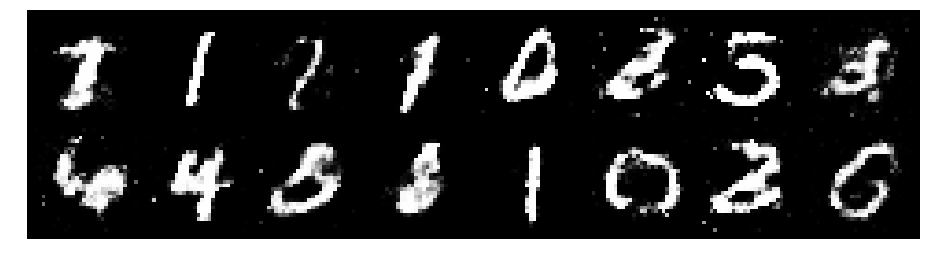

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.1876, Generator Loss: 0.8959
D(x): 0.5808, D(G(z)): 0.4102


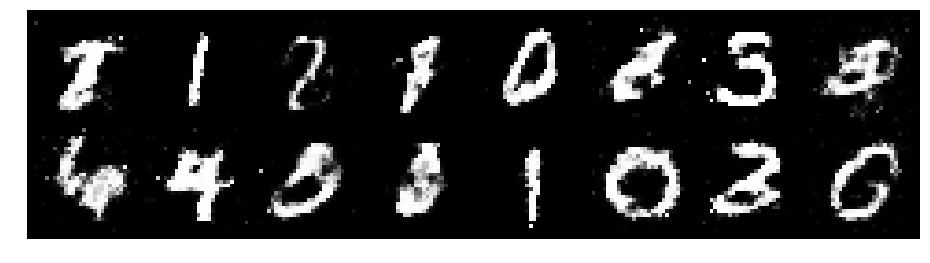

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.1905, Generator Loss: 0.9408
D(x): 0.5766, D(G(z)): 0.4222


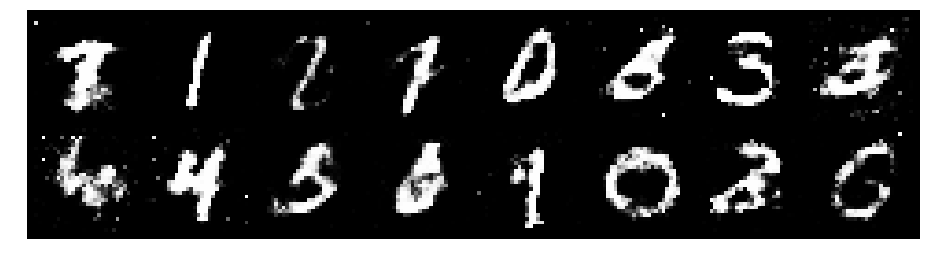

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.2007, Generator Loss: 0.9199
D(x): 0.5580, D(G(z)): 0.4251


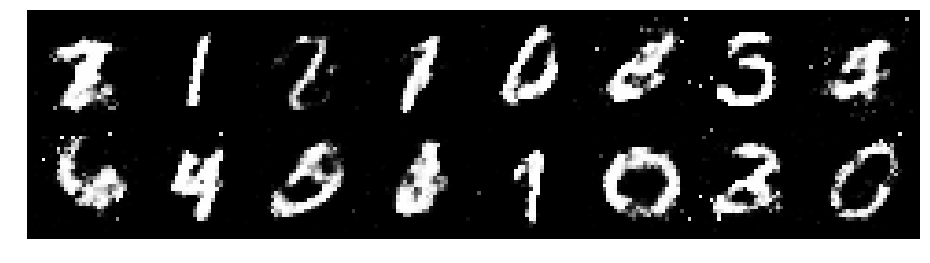

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.1870, Generator Loss: 1.0321
D(x): 0.5903, D(G(z)): 0.4177


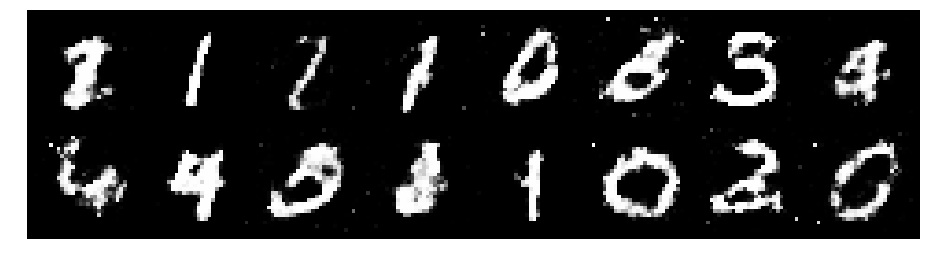

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.0673, Generator Loss: 1.0895
D(x): 0.6000, D(G(z)): 0.3627


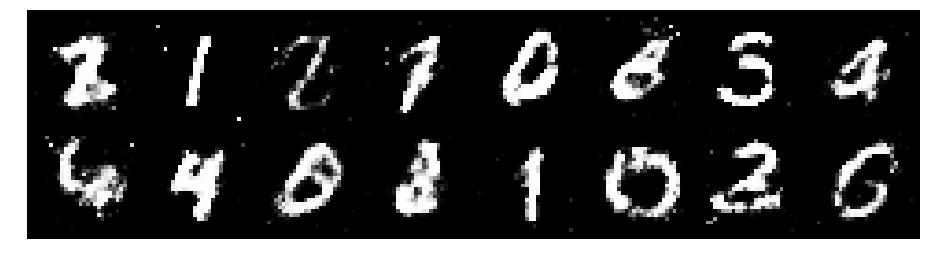

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.0911, Generator Loss: 1.2101
D(x): 0.6390, D(G(z)): 0.3920


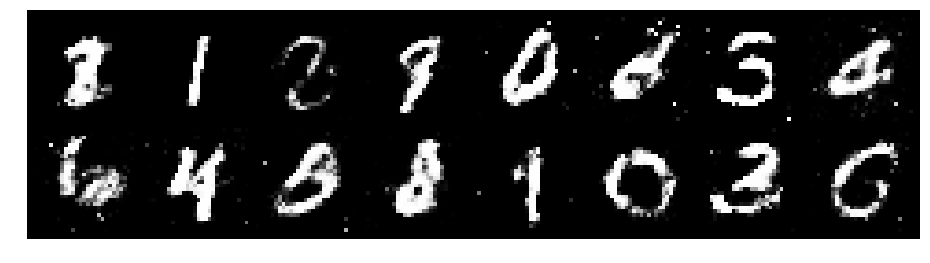

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.3157, Generator Loss: 0.9656
D(x): 0.5707, D(G(z)): 0.4714


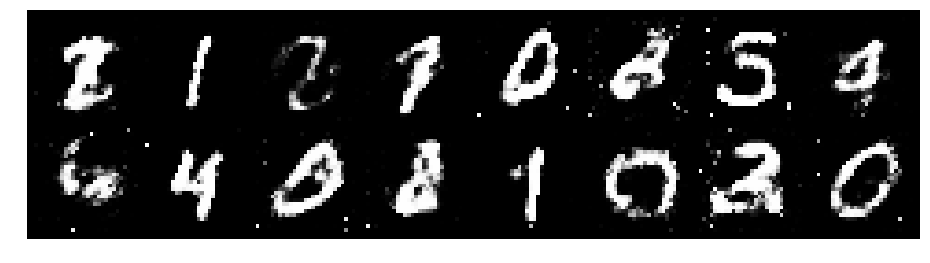

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.2912, Generator Loss: 1.0367
D(x): 0.5698, D(G(z)): 0.4250


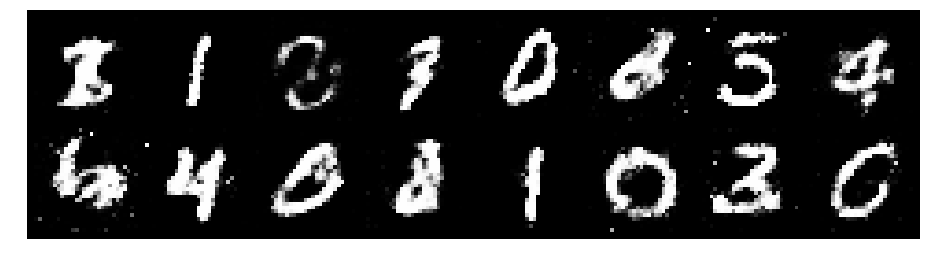

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.3108, Generator Loss: 1.0590
D(x): 0.5309, D(G(z)): 0.3999


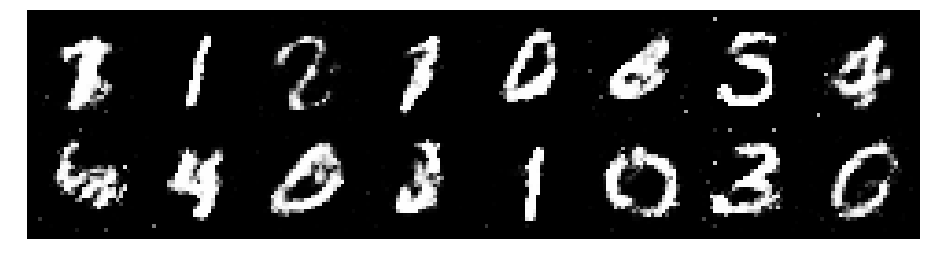

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.1479, Generator Loss: 0.9981
D(x): 0.6270, D(G(z)): 0.4134


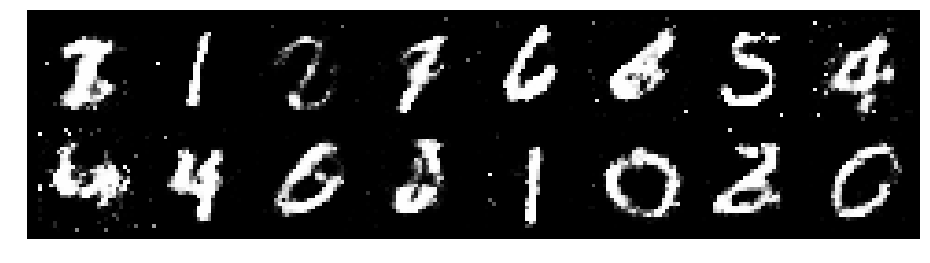

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.1653, Generator Loss: 1.1103
D(x): 0.6140, D(G(z)): 0.4145


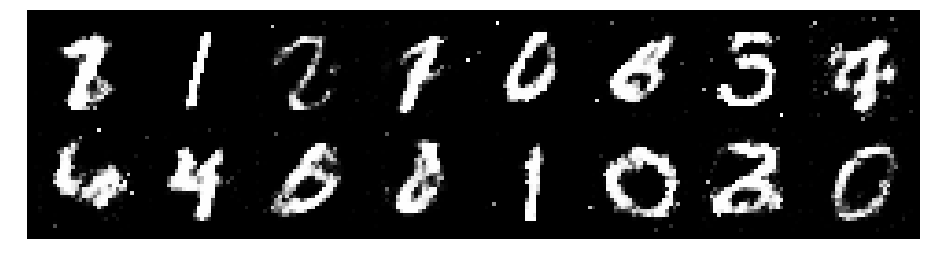

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.2204, Generator Loss: 1.0521
D(x): 0.5856, D(G(z)): 0.4247


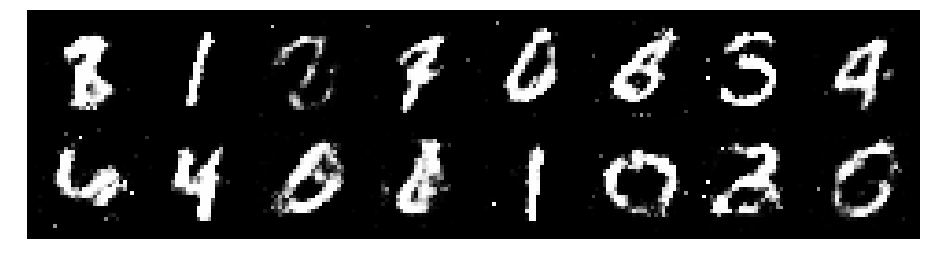

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.1928, Generator Loss: 1.1890
D(x): 0.5932, D(G(z)): 0.4000


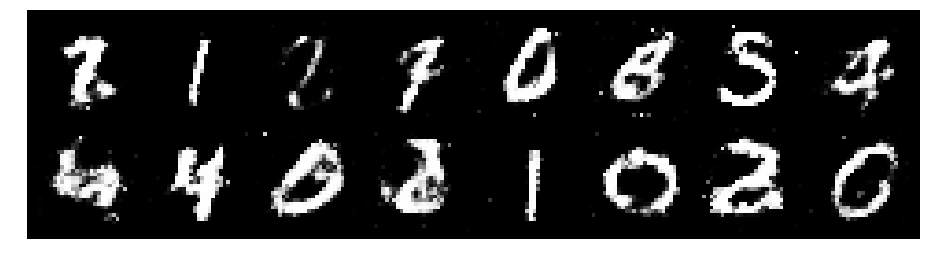

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.2767, Generator Loss: 0.8244
D(x): 0.5445, D(G(z)): 0.4538


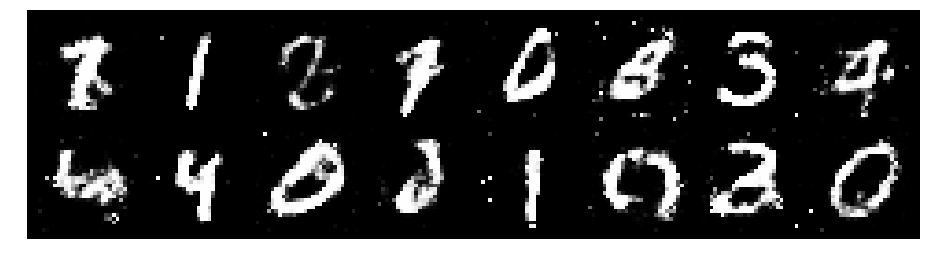

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.2939, Generator Loss: 0.9899
D(x): 0.5487, D(G(z)): 0.4129


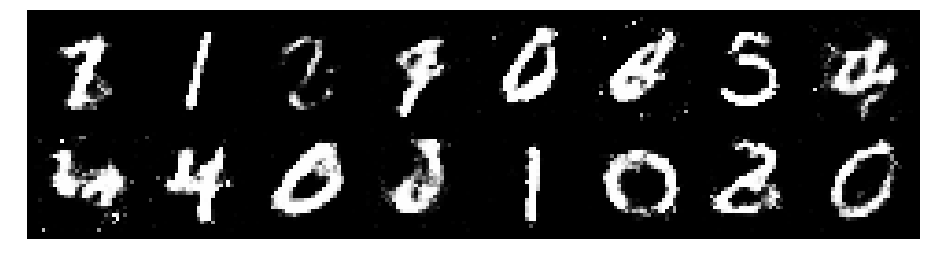

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.3034, Generator Loss: 0.8293
D(x): 0.5688, D(G(z)): 0.4574


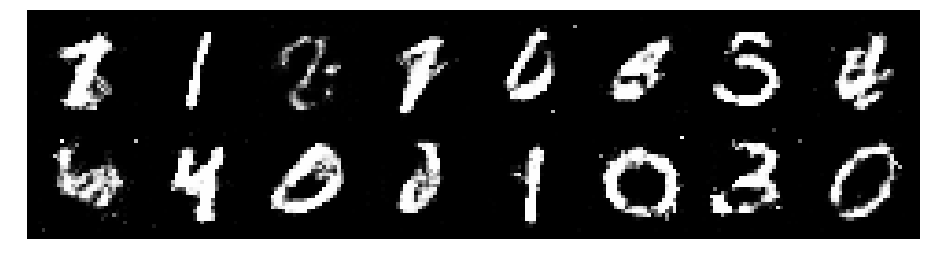

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.3577, Generator Loss: 0.7876
D(x): 0.5654, D(G(z)): 0.4978


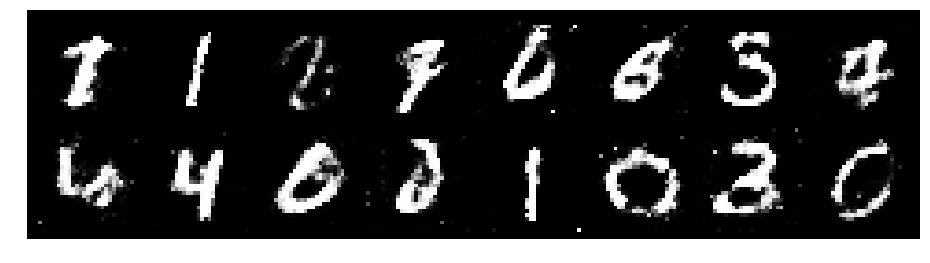

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.2677, Generator Loss: 1.1364
D(x): 0.5301, D(G(z)): 0.3865


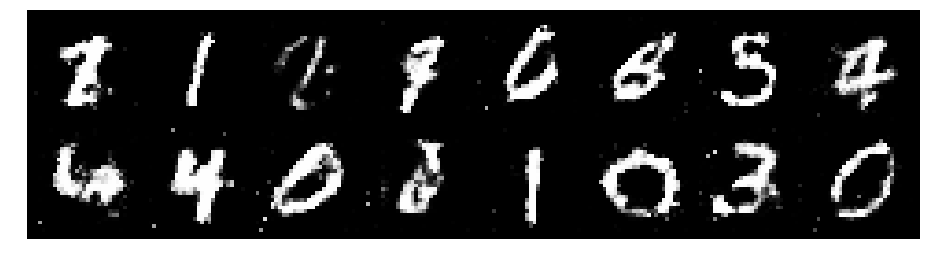

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.2059, Generator Loss: 0.9609
D(x): 0.6045, D(G(z)): 0.4269


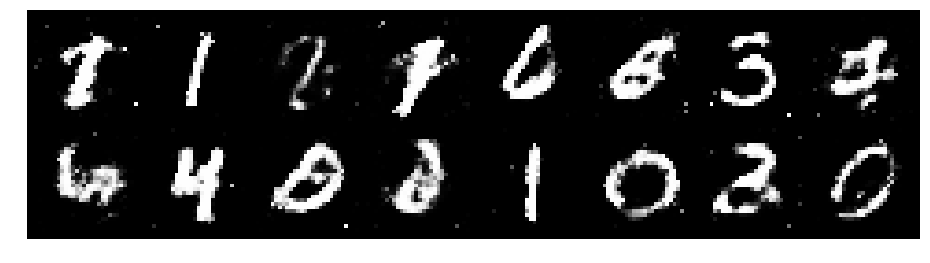

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.3595, Generator Loss: 0.7843
D(x): 0.5643, D(G(z)): 0.4830


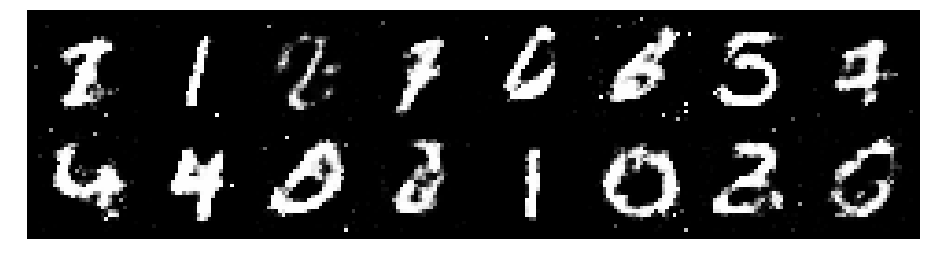

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.2383, Generator Loss: 0.8392
D(x): 0.5589, D(G(z)): 0.4246


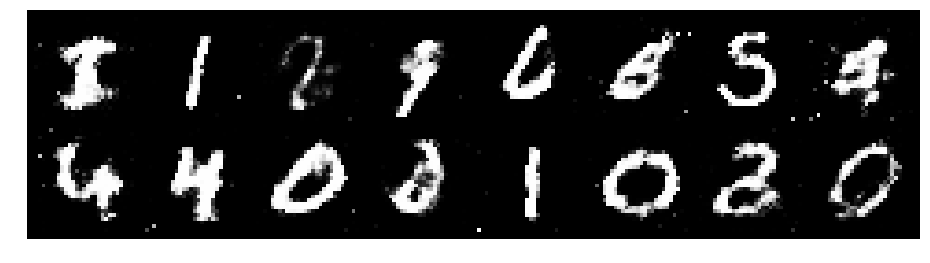

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.2636, Generator Loss: 1.0235
D(x): 0.5956, D(G(z)): 0.4452


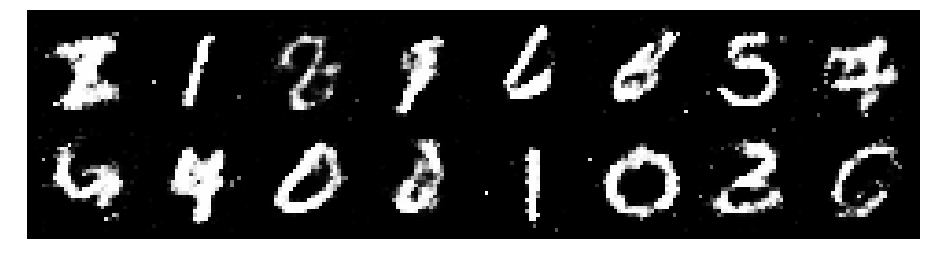

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.0146, Generator Loss: 1.1675
D(x): 0.6641, D(G(z)): 0.3740


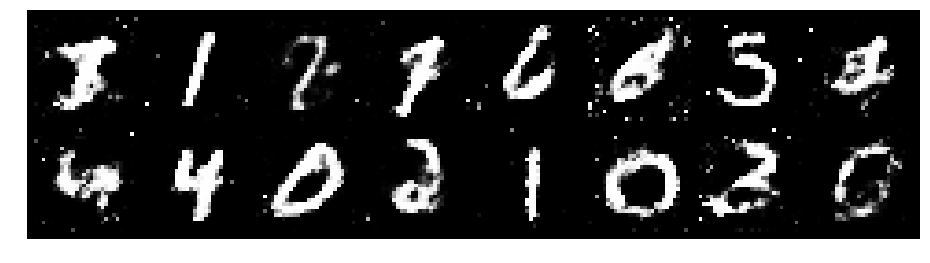

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.1981, Generator Loss: 1.0266
D(x): 0.5938, D(G(z)): 0.4132


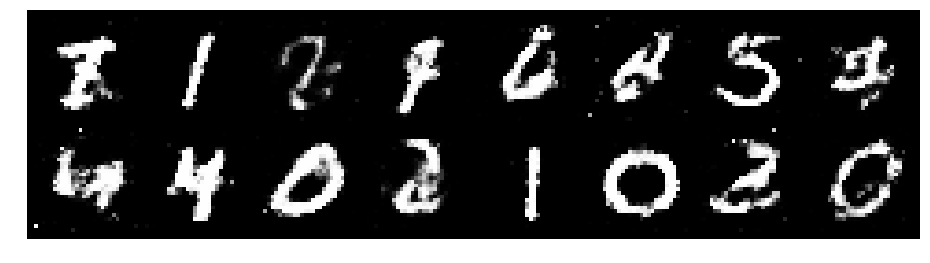

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.2187, Generator Loss: 1.0357
D(x): 0.5502, D(G(z)): 0.3722


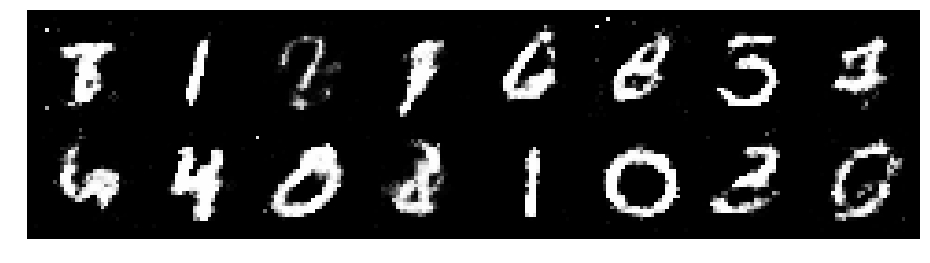

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.3827, Generator Loss: 0.9458
D(x): 0.6139, D(G(z)): 0.4990


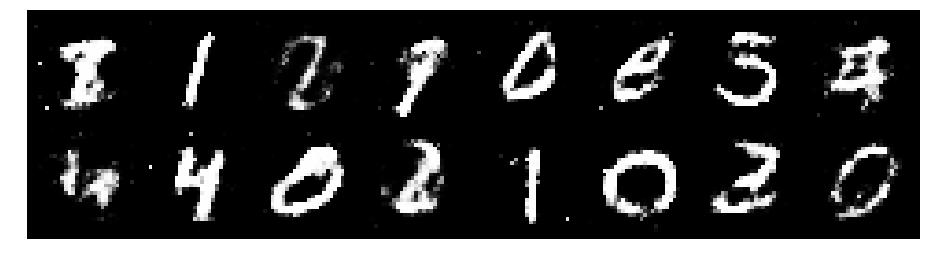

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.3446, Generator Loss: 0.8895
D(x): 0.5499, D(G(z)): 0.4720


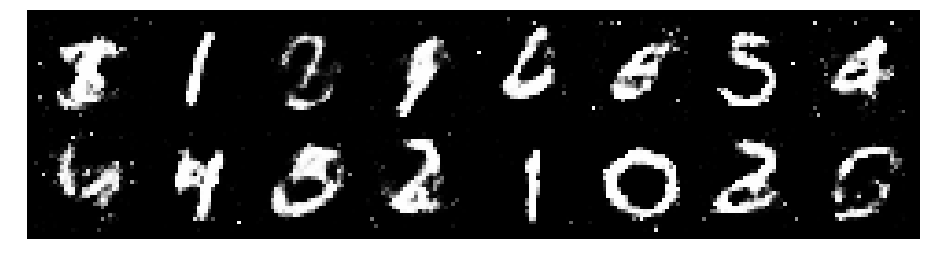

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.2028, Generator Loss: 1.0720
D(x): 0.5838, D(G(z)): 0.3924


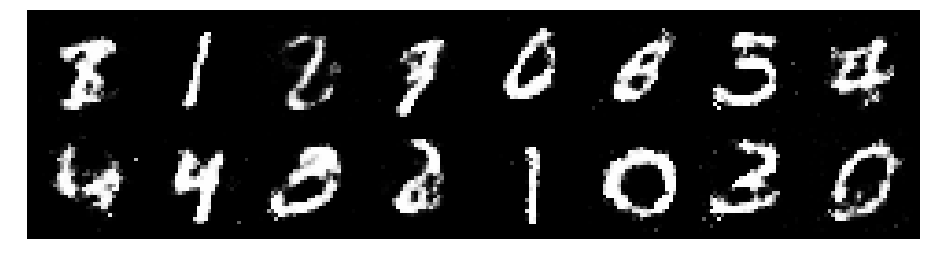

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.3434, Generator Loss: 0.8262
D(x): 0.5648, D(G(z)): 0.4630


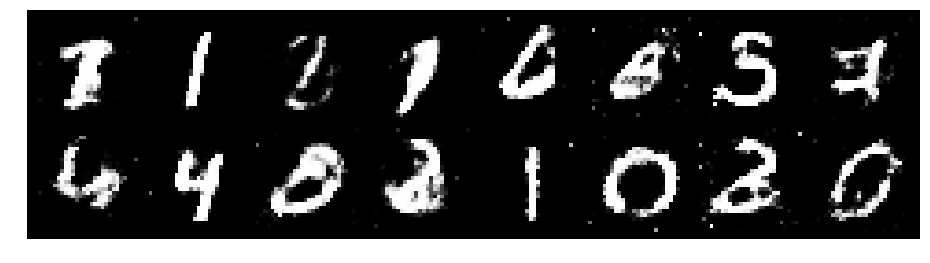

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.1522, Generator Loss: 1.1141
D(x): 0.6109, D(G(z)): 0.3699


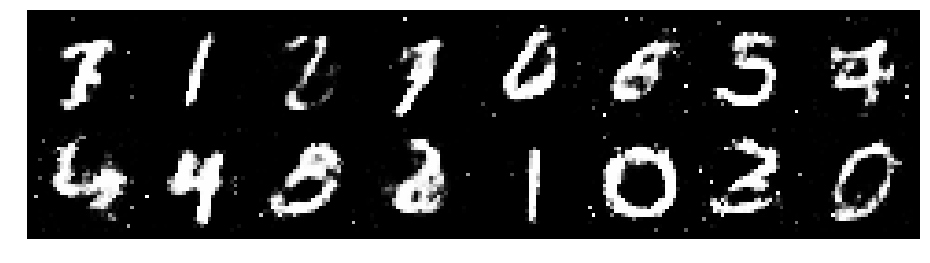

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.0646, Generator Loss: 1.1295
D(x): 0.6321, D(G(z)): 0.3639


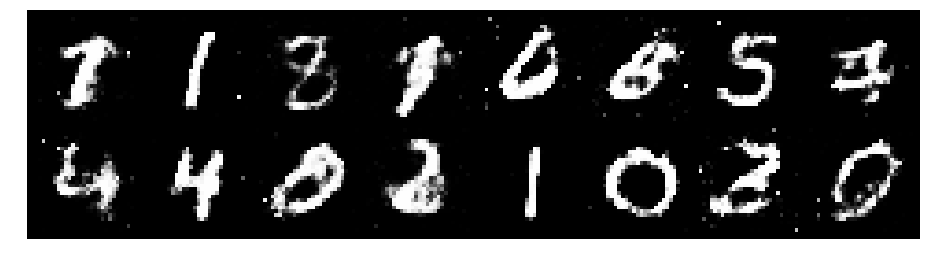

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.0643, Generator Loss: 1.1865
D(x): 0.6114, D(G(z)): 0.3710


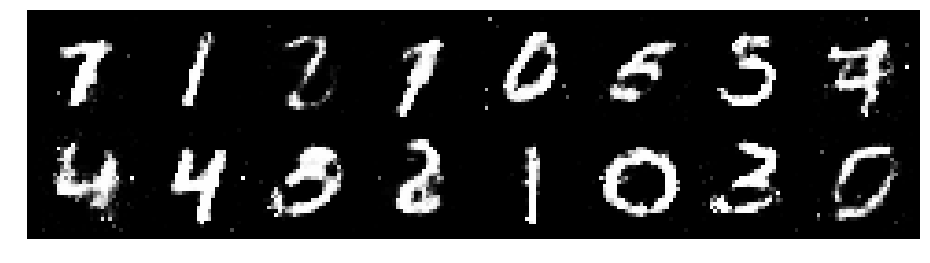

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.2042, Generator Loss: 0.9573
D(x): 0.5667, D(G(z)): 0.3958


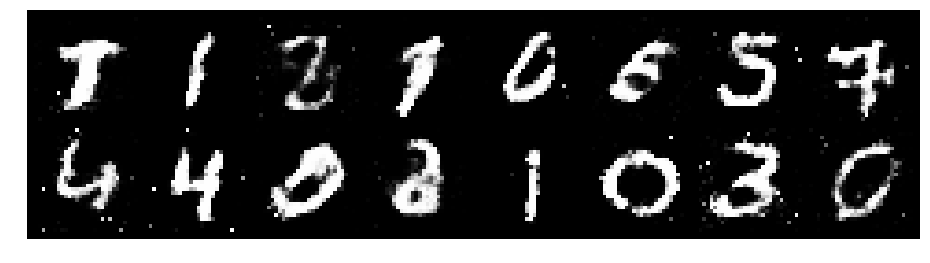

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.3037, Generator Loss: 0.9452
D(x): 0.5460, D(G(z)): 0.4390


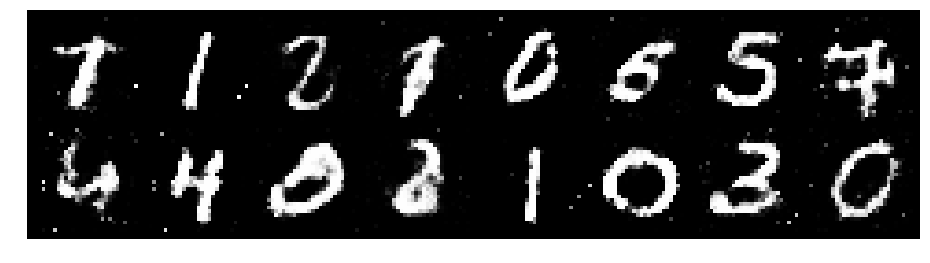

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.3286, Generator Loss: 0.9113
D(x): 0.5946, D(G(z)): 0.4840


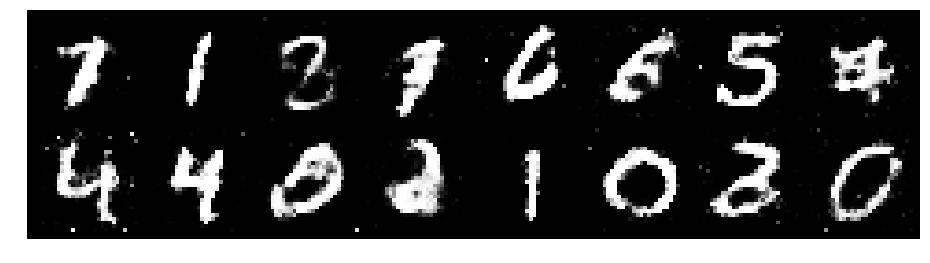

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.2580, Generator Loss: 1.1021
D(x): 0.5602, D(G(z)): 0.3907


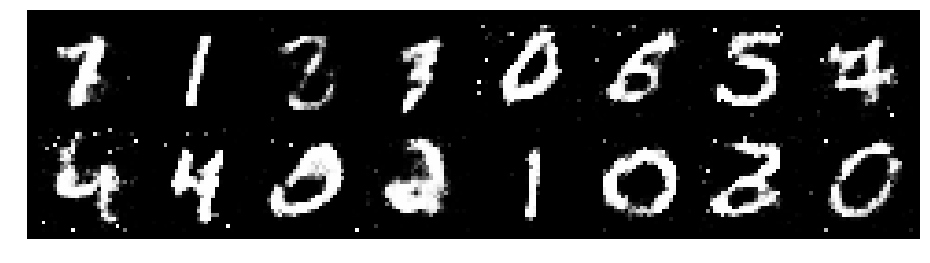

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.0824, Generator Loss: 1.2019
D(x): 0.6292, D(G(z)): 0.4032


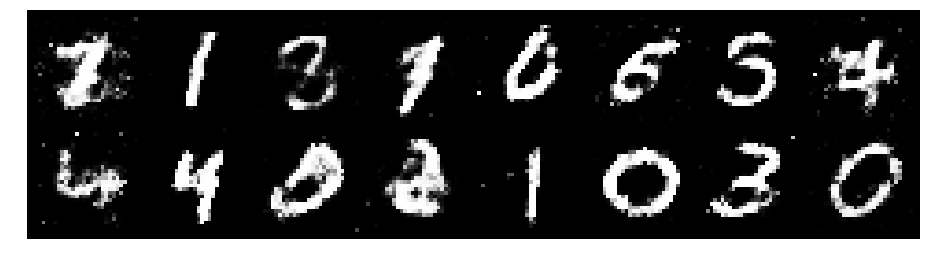

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.1068, Generator Loss: 1.0088
D(x): 0.6352, D(G(z)): 0.4090


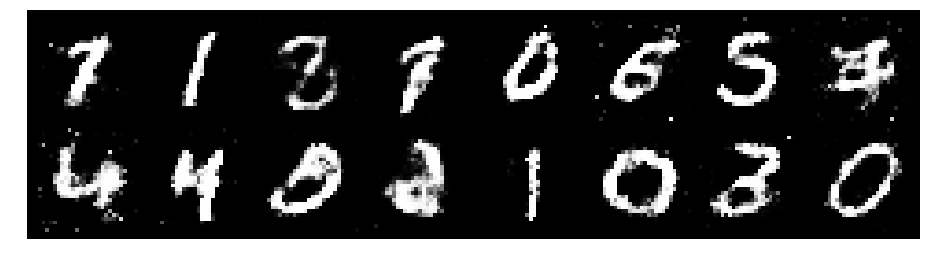

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.1950, Generator Loss: 1.0761
D(x): 0.5749, D(G(z)): 0.3872


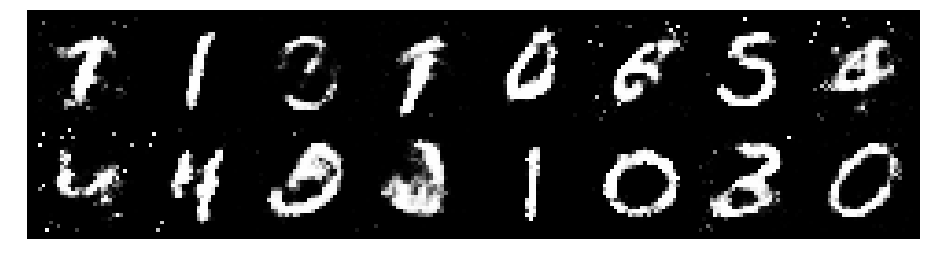

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.2273, Generator Loss: 0.9446
D(x): 0.5863, D(G(z)): 0.4305


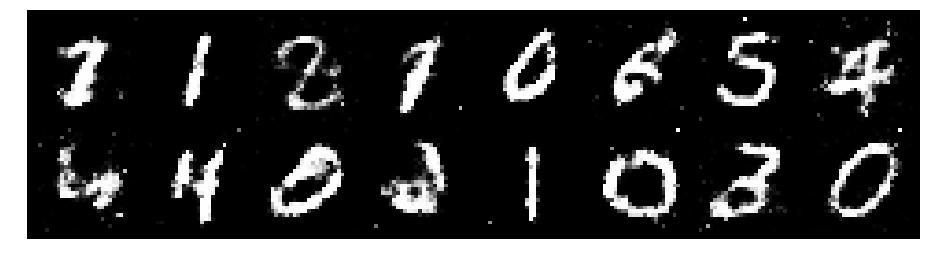

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.1708, Generator Loss: 1.0362
D(x): 0.5803, D(G(z)): 0.3958


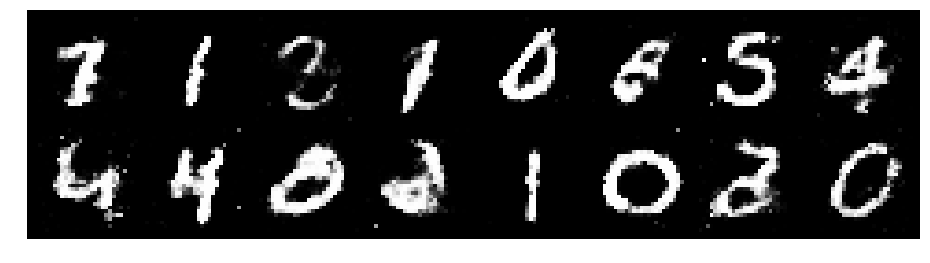

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.2579, Generator Loss: 0.8784
D(x): 0.5392, D(G(z)): 0.4347


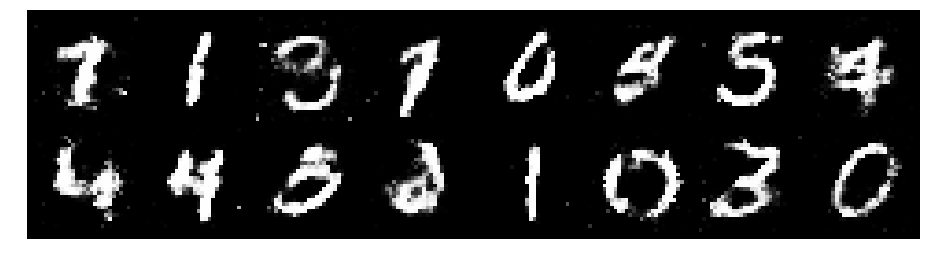

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.2514, Generator Loss: 0.8745
D(x): 0.5545, D(G(z)): 0.4109


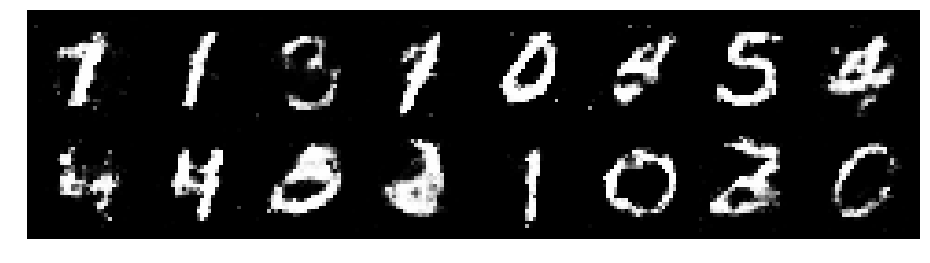

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.3024, Generator Loss: 0.9081
D(x): 0.5555, D(G(z)): 0.4615


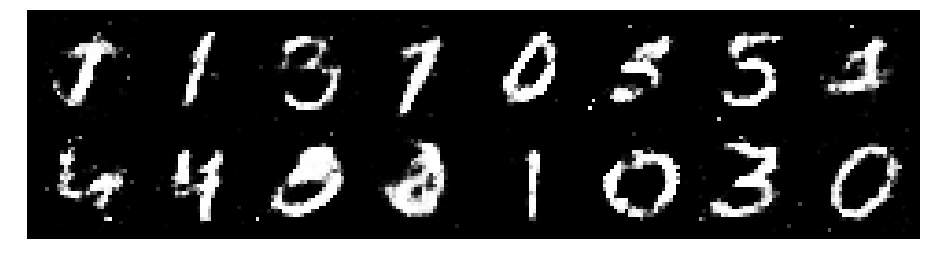

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.2802, Generator Loss: 0.9260
D(x): 0.5565, D(G(z)): 0.4358


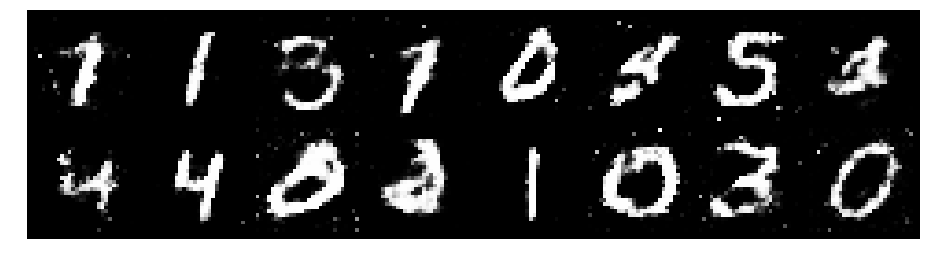

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.1733, Generator Loss: 1.0008
D(x): 0.5622, D(G(z)): 0.3803


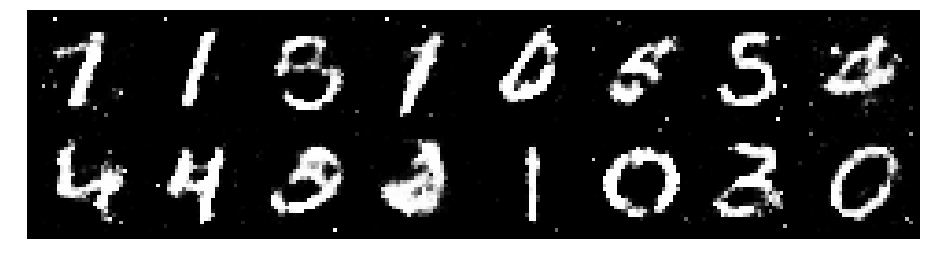

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.1212, Generator Loss: 1.0109
D(x): 0.5855, D(G(z)): 0.3632


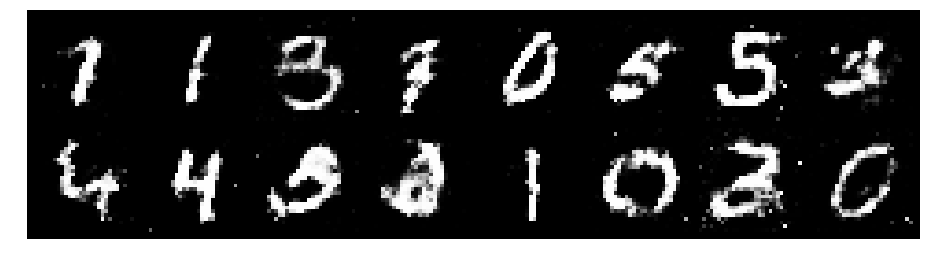

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.0749, Generator Loss: 1.1857
D(x): 0.6320, D(G(z)): 0.4006


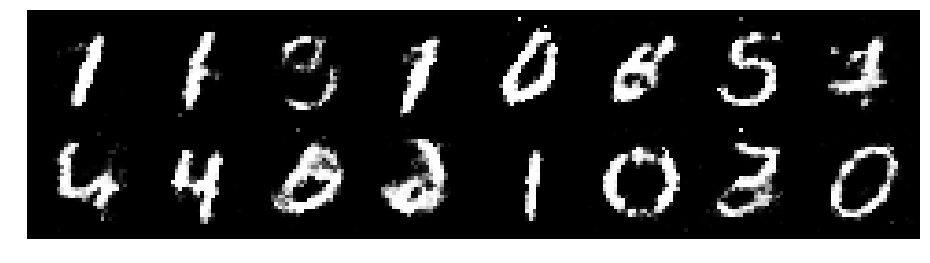

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.1437, Generator Loss: 0.8448
D(x): 0.6104, D(G(z)): 0.4413


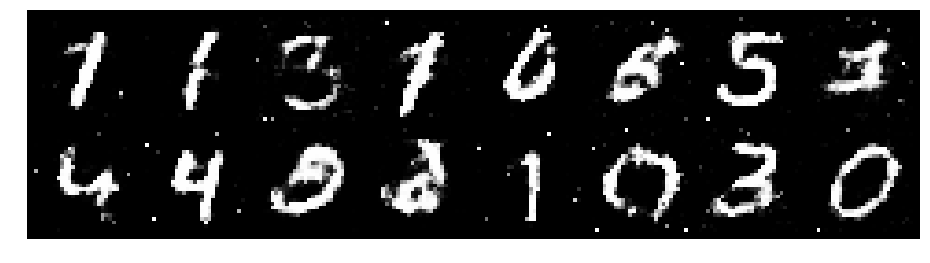

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.3737, Generator Loss: 0.7918
D(x): 0.5934, D(G(z)): 0.5116


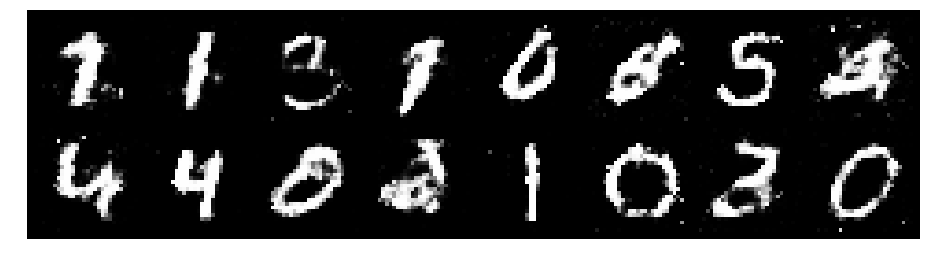

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.2836, Generator Loss: 0.8884
D(x): 0.5574, D(G(z)): 0.4340


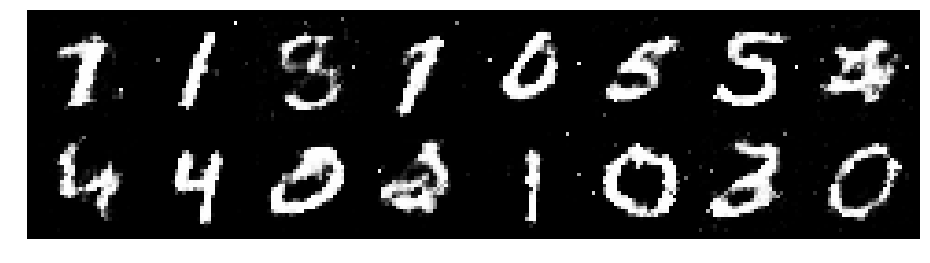

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.3286, Generator Loss: 0.7353
D(x): 0.6107, D(G(z)): 0.5134


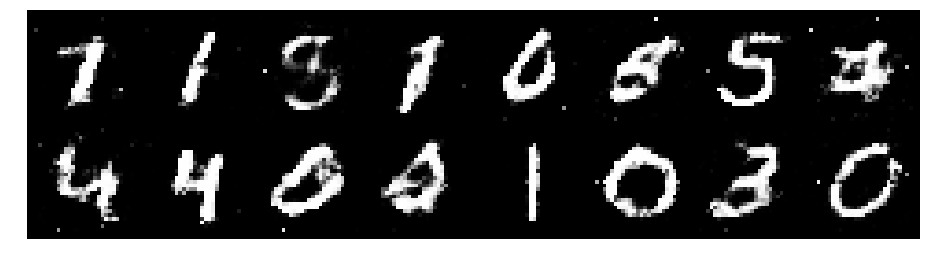

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.2944, Generator Loss: 0.9671
D(x): 0.6168, D(G(z)): 0.4877


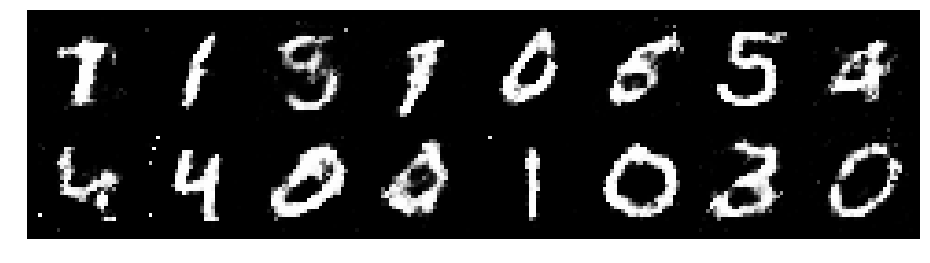

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.2343, Generator Loss: 0.8538
D(x): 0.6140, D(G(z)): 0.4606


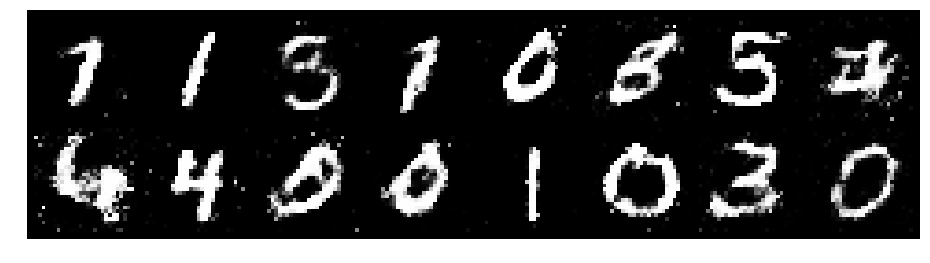

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.1881, Generator Loss: 0.9989
D(x): 0.5735, D(G(z)): 0.4039


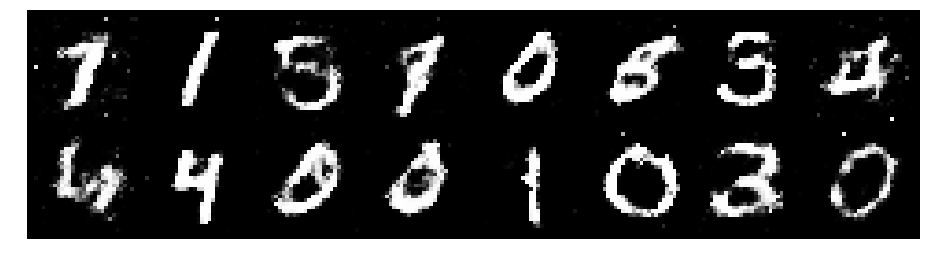

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.1622, Generator Loss: 0.8642
D(x): 0.5867, D(G(z)): 0.4142


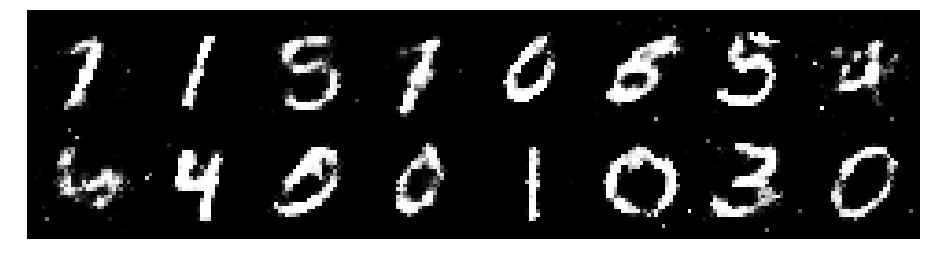

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.2417, Generator Loss: 0.8585
D(x): 0.5495, D(G(z)): 0.4465


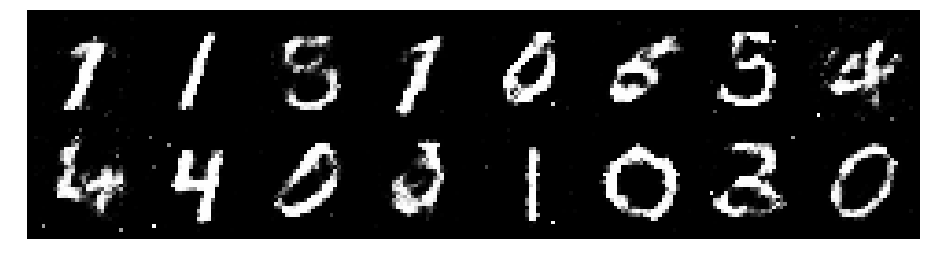

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.2615, Generator Loss: 1.0842
D(x): 0.5175, D(G(z)): 0.3811


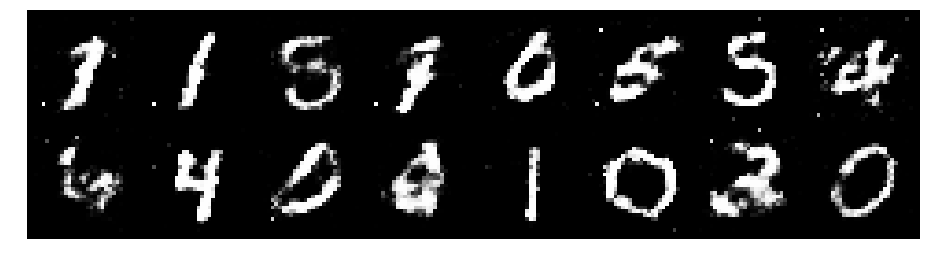

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.2838, Generator Loss: 0.8026
D(x): 0.5615, D(G(z)): 0.4441


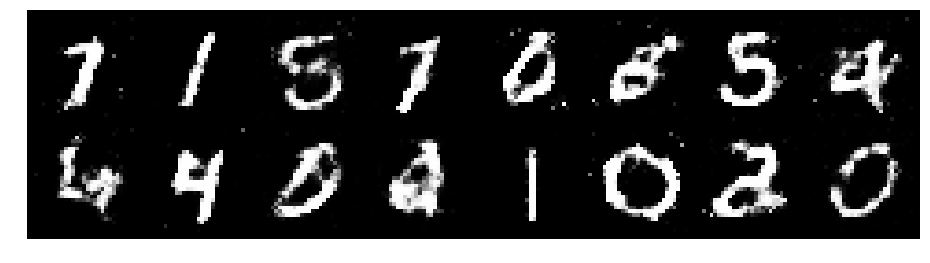

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.3363, Generator Loss: 0.8925
D(x): 0.5726, D(G(z)): 0.4751


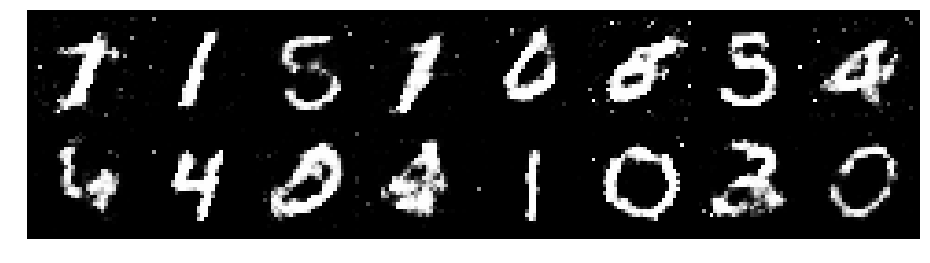

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.1258, Generator Loss: 1.0414
D(x): 0.5879, D(G(z)): 0.3805


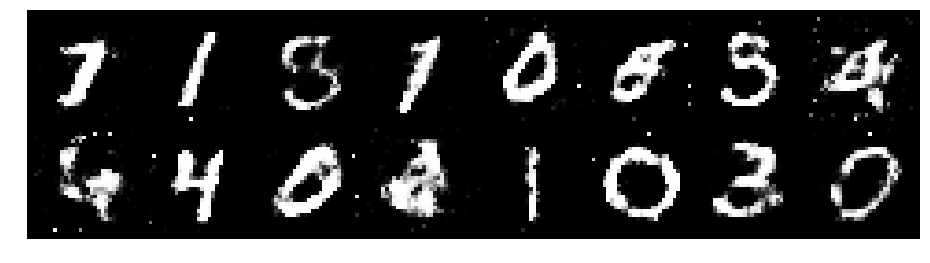

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.1907, Generator Loss: 1.1427
D(x): 0.5802, D(G(z)): 0.4071


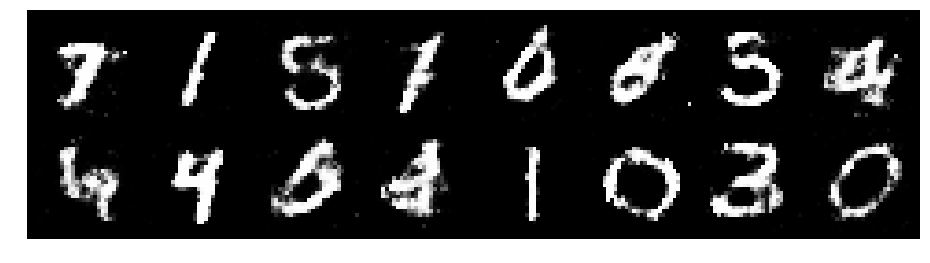

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.2313, Generator Loss: 0.7845
D(x): 0.5881, D(G(z)): 0.4424


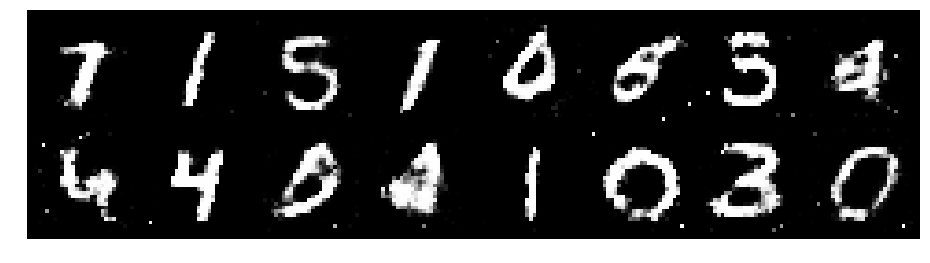

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.3297, Generator Loss: 0.9561
D(x): 0.6113, D(G(z)): 0.5069


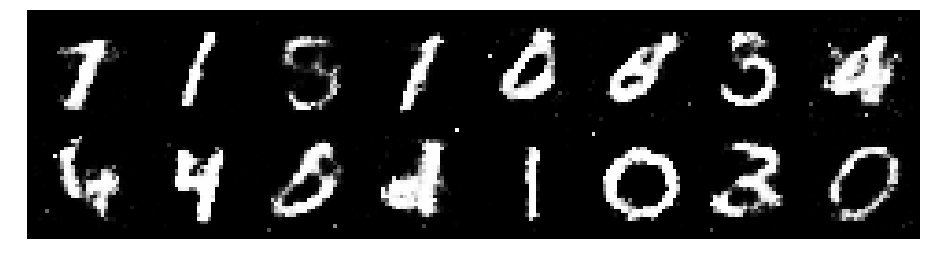

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.3713, Generator Loss: 0.8680
D(x): 0.5678, D(G(z)): 0.4660


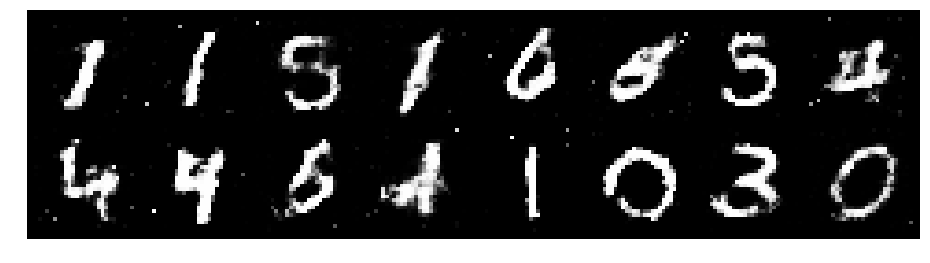

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.2155, Generator Loss: 1.0461
D(x): 0.5384, D(G(z)): 0.3774


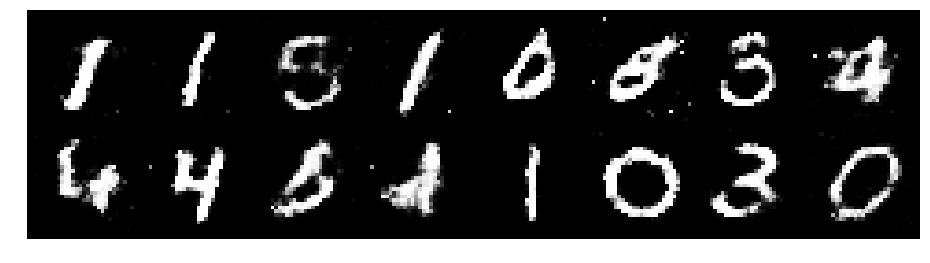

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.0909, Generator Loss: 1.0176
D(x): 0.6219, D(G(z)): 0.3758


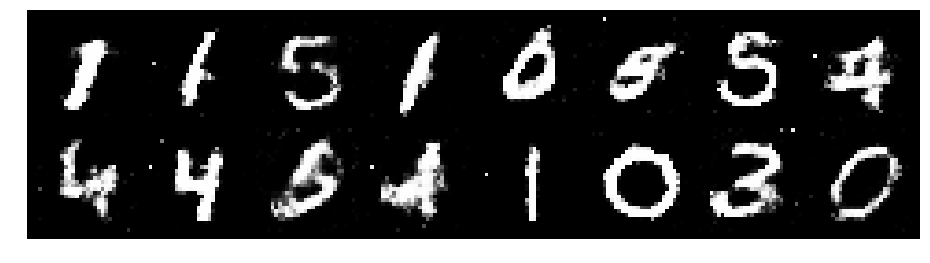

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.3589, Generator Loss: 0.9491
D(x): 0.5373, D(G(z)): 0.4467


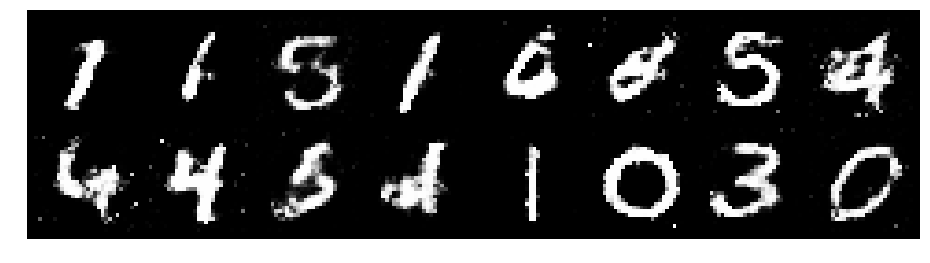

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.2098, Generator Loss: 0.8394
D(x): 0.6003, D(G(z)): 0.4229


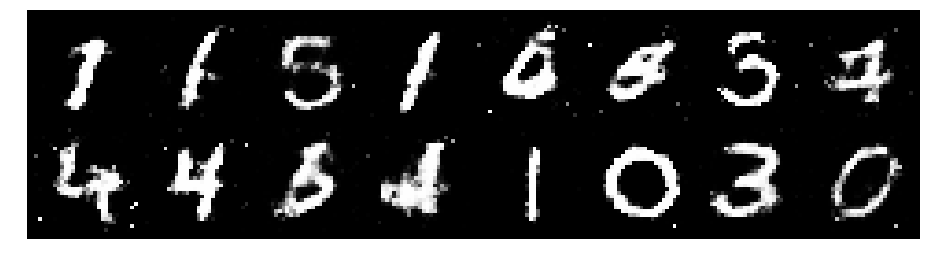

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.1419, Generator Loss: 1.0019
D(x): 0.6690, D(G(z)): 0.4392


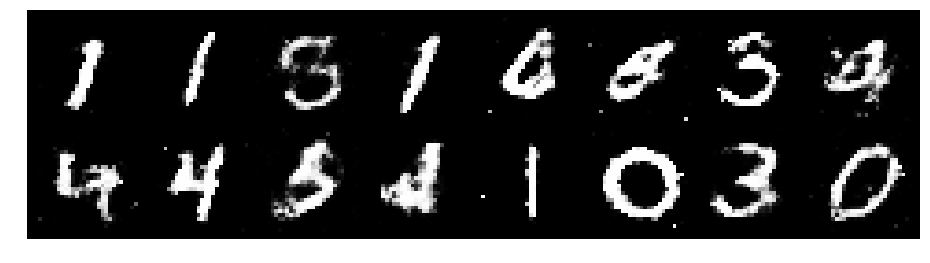

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.2967, Generator Loss: 0.9937
D(x): 0.5486, D(G(z)): 0.4248


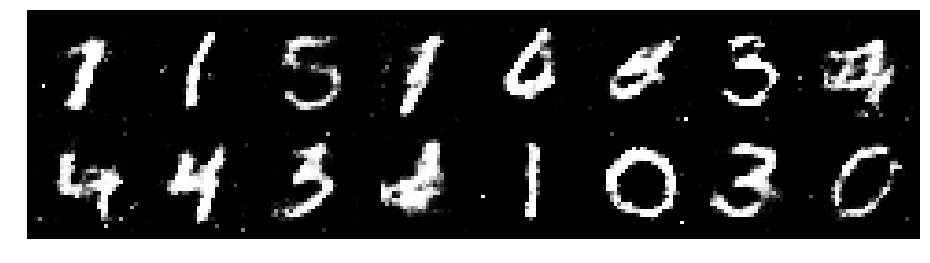

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.2714, Generator Loss: 0.9606
D(x): 0.6107, D(G(z)): 0.4477


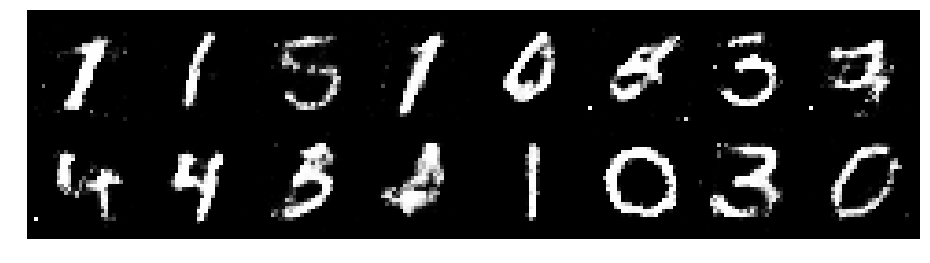

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.1442, Generator Loss: 1.0275
D(x): 0.5674, D(G(z)): 0.3927


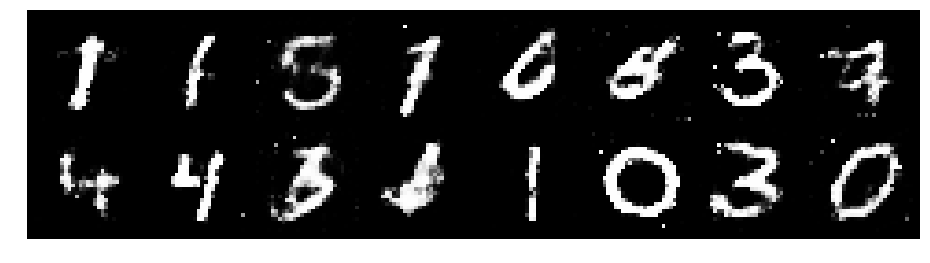

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.3073, Generator Loss: 0.9363
D(x): 0.5389, D(G(z)): 0.4516


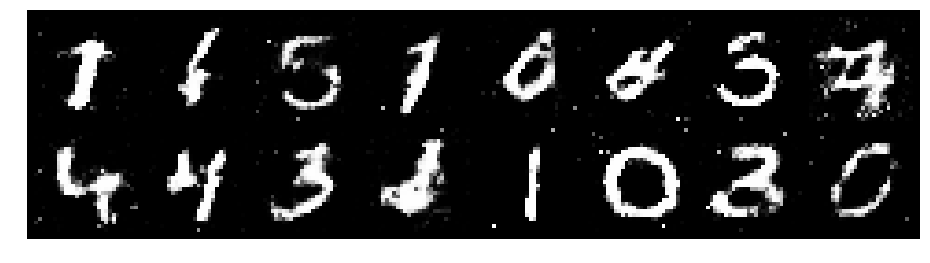

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.1609, Generator Loss: 0.8971
D(x): 0.6066, D(G(z)): 0.4277


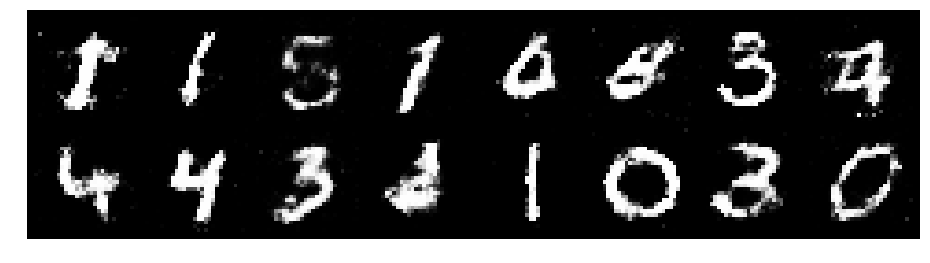

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.2548, Generator Loss: 0.8088
D(x): 0.6128, D(G(z)): 0.4877


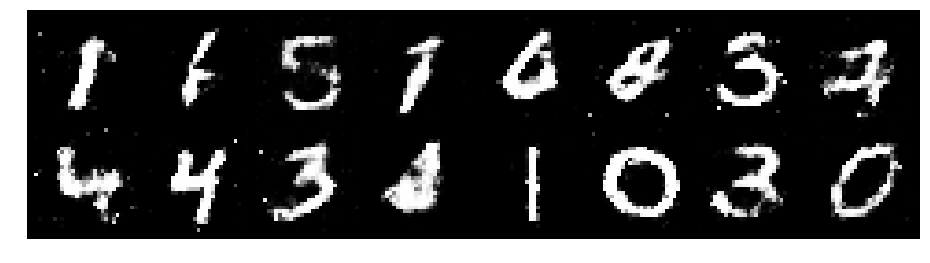

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.3370, Generator Loss: 0.7768
D(x): 0.5497, D(G(z)): 0.4745


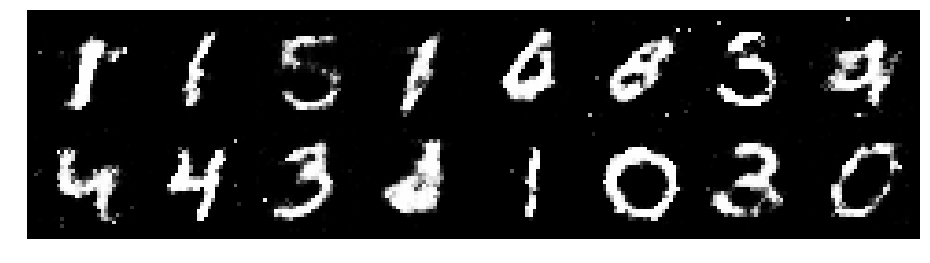

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.2275, Generator Loss: 0.9037
D(x): 0.5819, D(G(z)): 0.4394


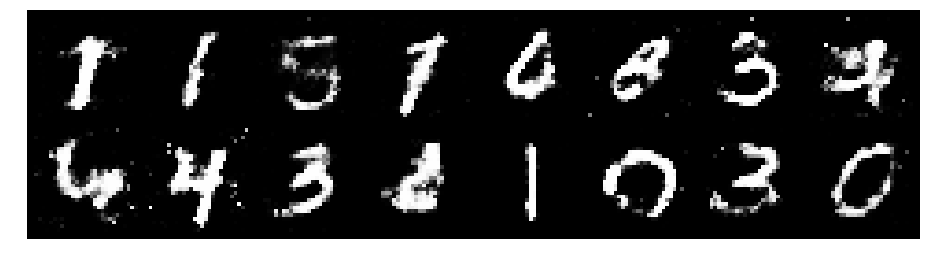

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.2450, Generator Loss: 1.0699
D(x): 0.5200, D(G(z)): 0.3873


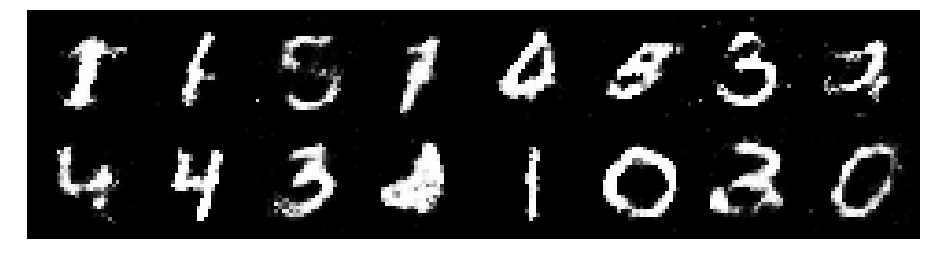

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.2717, Generator Loss: 0.8551
D(x): 0.5600, D(G(z)): 0.4549


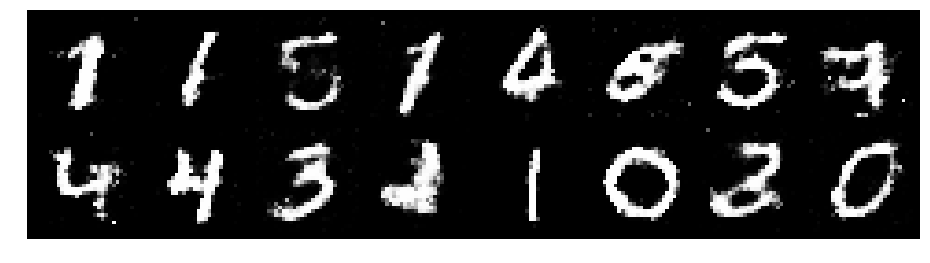

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.2178, Generator Loss: 0.9712
D(x): 0.5473, D(G(z)): 0.3999


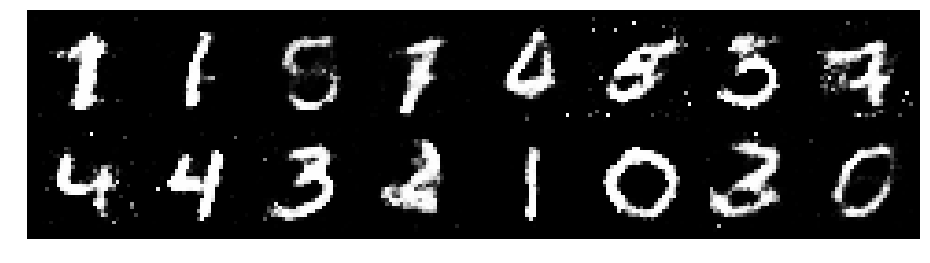

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.2491, Generator Loss: 0.9864
D(x): 0.5436, D(G(z)): 0.4019


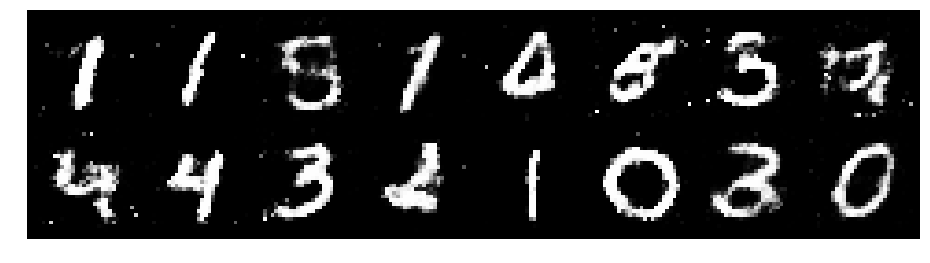

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.2053, Generator Loss: 0.8548
D(x): 0.5770, D(G(z)): 0.4130


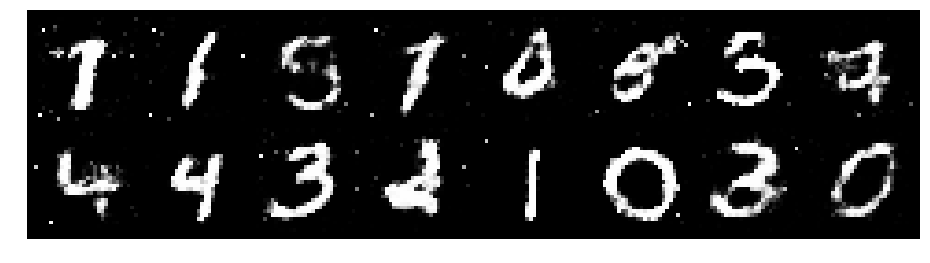

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.1160, Generator Loss: 1.0415
D(x): 0.6119, D(G(z)): 0.3784


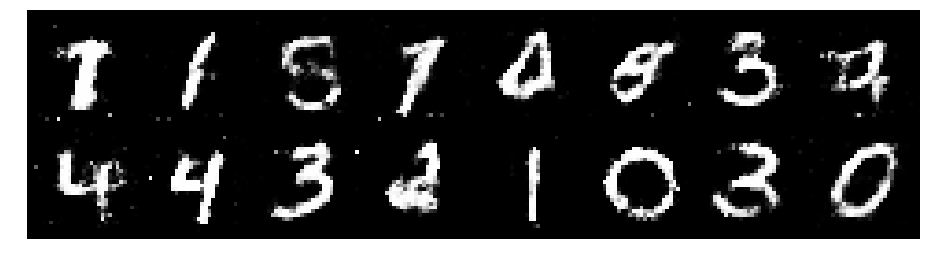

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.1782, Generator Loss: 1.0145
D(x): 0.5634, D(G(z)): 0.3874


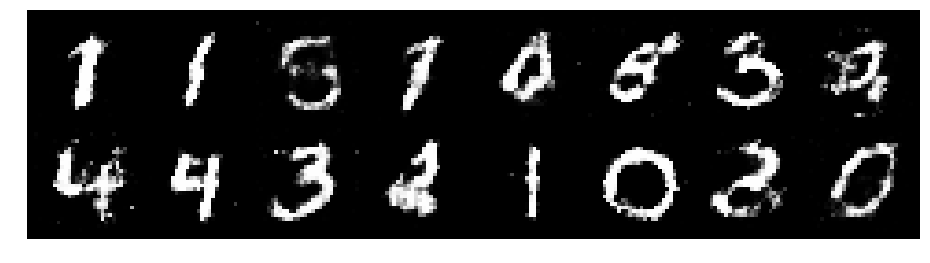

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.2516, Generator Loss: 0.8305
D(x): 0.5872, D(G(z)): 0.4627


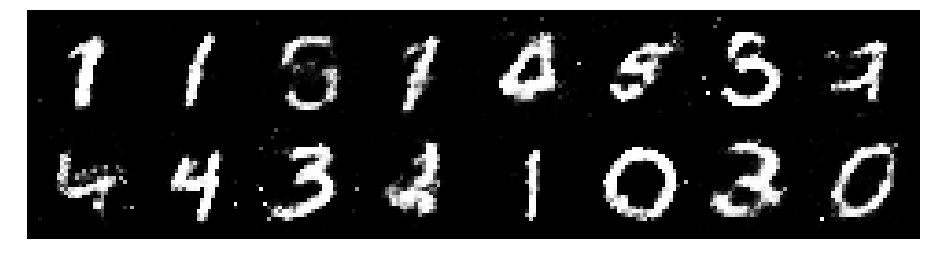

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.2608, Generator Loss: 0.8875
D(x): 0.5512, D(G(z)): 0.4285


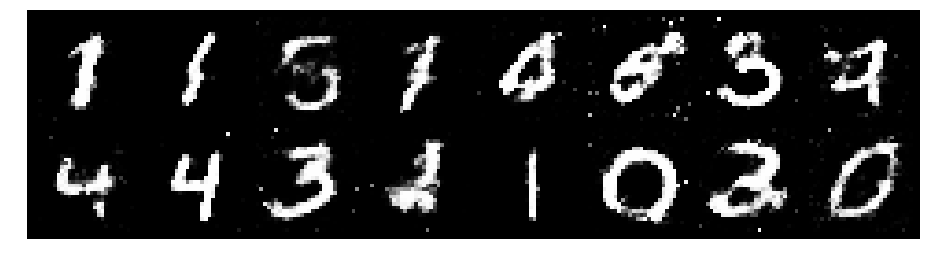

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.4036, Generator Loss: 0.8196
D(x): 0.5331, D(G(z)): 0.4836


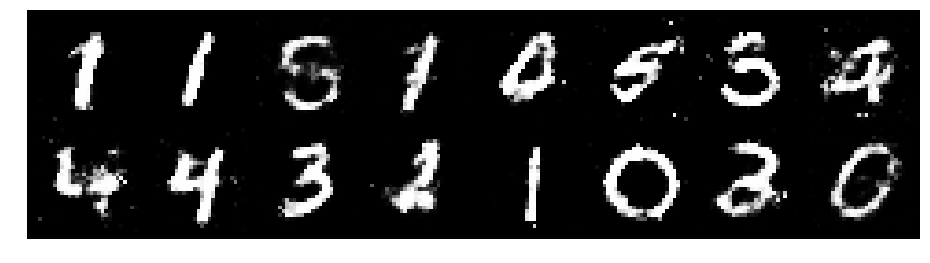

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.3474, Generator Loss: 0.8097
D(x): 0.5396, D(G(z)): 0.4596


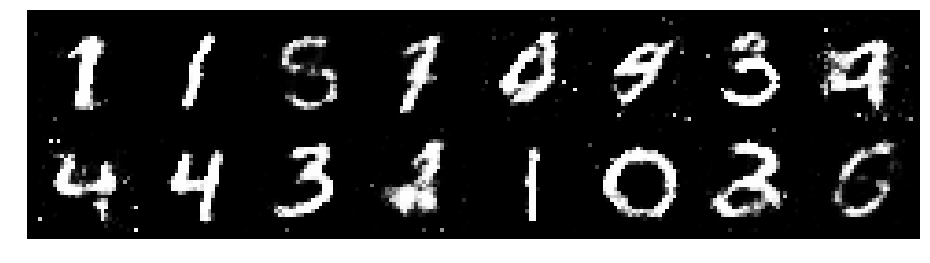

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.1763, Generator Loss: 0.9423
D(x): 0.5811, D(G(z)): 0.3811


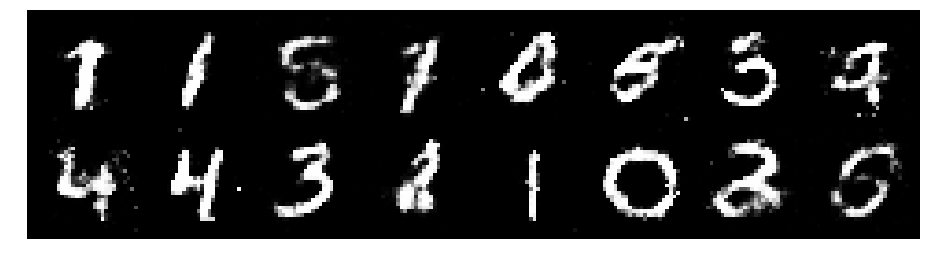

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.1572, Generator Loss: 1.1231
D(x): 0.6032, D(G(z)): 0.3989


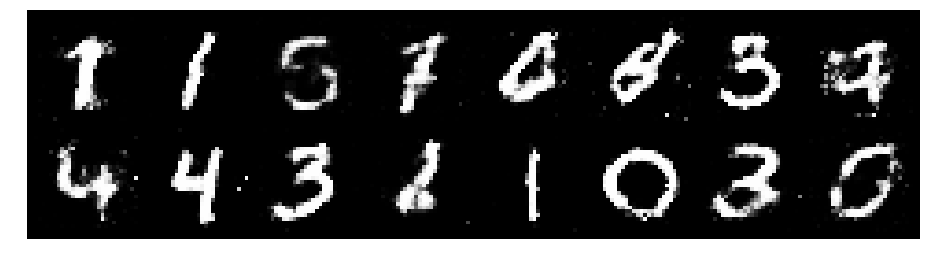

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.1903, Generator Loss: 1.1577
D(x): 0.5665, D(G(z)): 0.4004


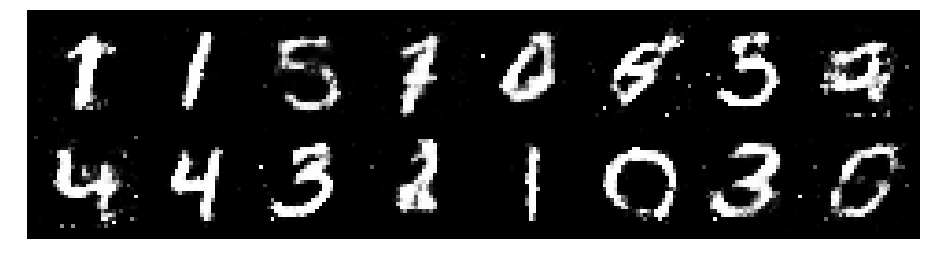

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.2129, Generator Loss: 0.8882
D(x): 0.5752, D(G(z)): 0.4278


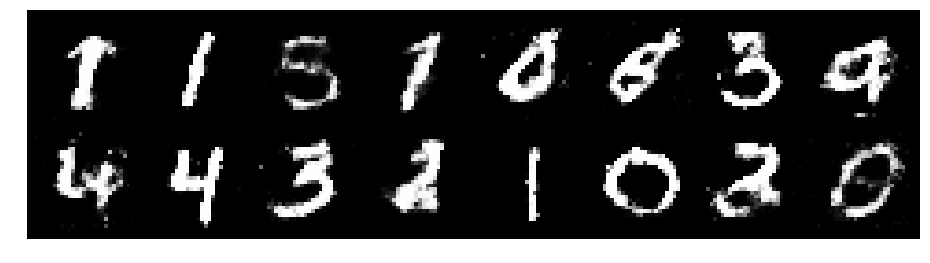

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.2811, Generator Loss: 0.8606
D(x): 0.5300, D(G(z)): 0.4276


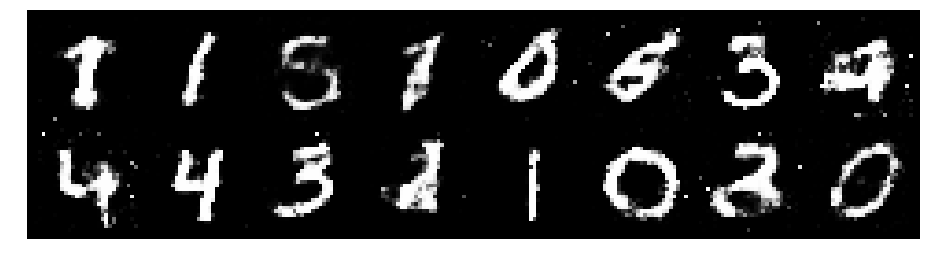

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.3769, Generator Loss: 1.0199
D(x): 0.5502, D(G(z)): 0.4311


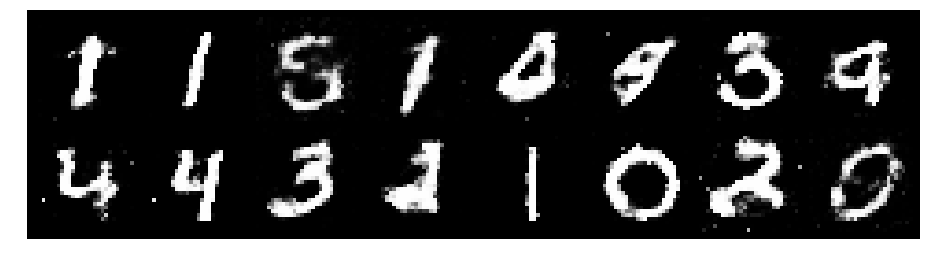

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.3081, Generator Loss: 0.8685
D(x): 0.5832, D(G(z)): 0.4354


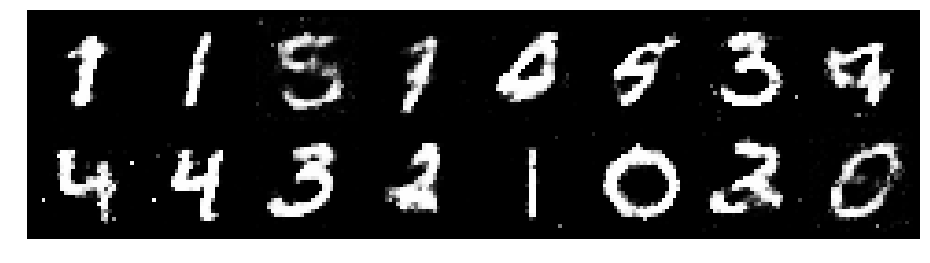

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.4025, Generator Loss: 0.8778
D(x): 0.5379, D(G(z)): 0.4715


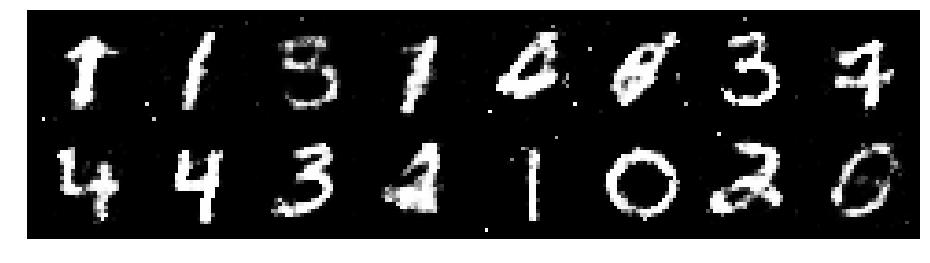

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.1292, Generator Loss: 1.0002
D(x): 0.6262, D(G(z)): 0.4389


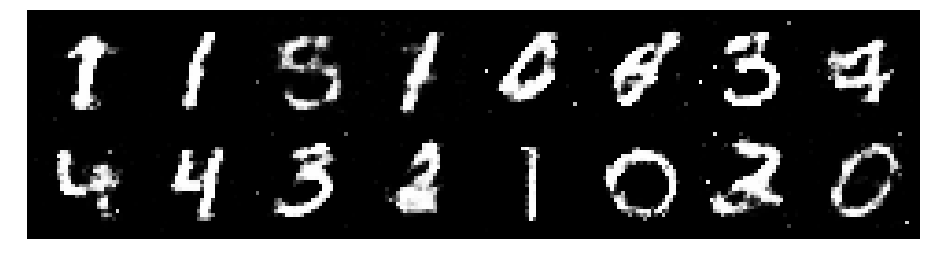

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.1758, Generator Loss: 1.0030
D(x): 0.6132, D(G(z)): 0.4211


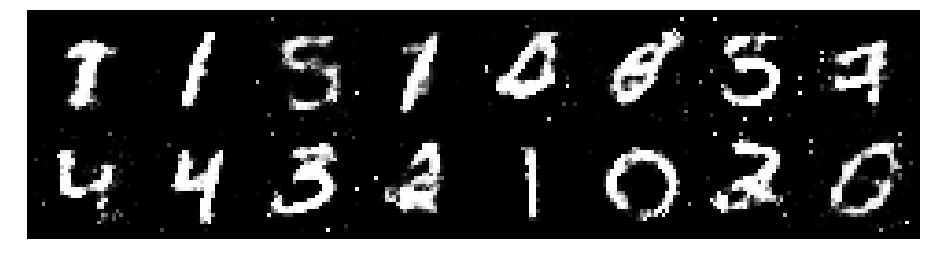

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.2235, Generator Loss: 0.8330
D(x): 0.5809, D(G(z)): 0.4441


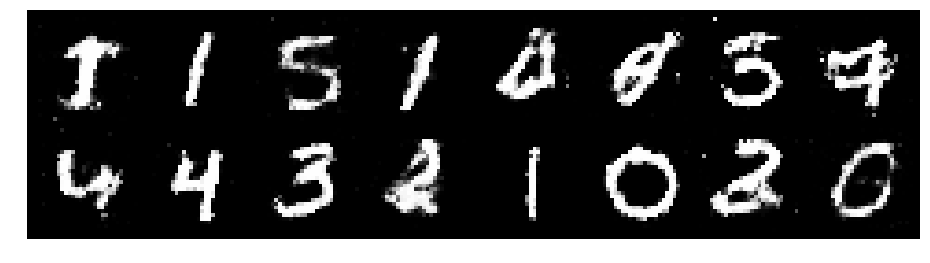

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.2719, Generator Loss: 0.9776
D(x): 0.5386, D(G(z)): 0.4169


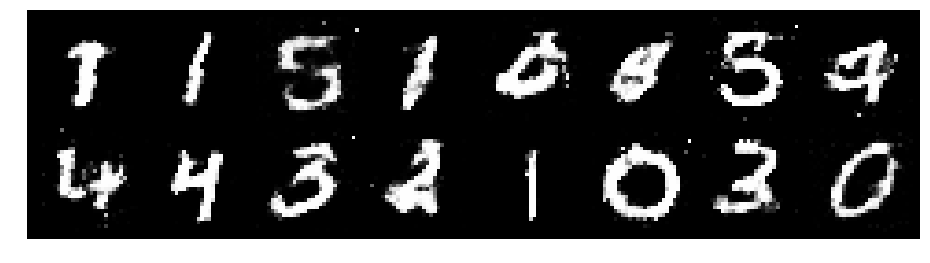

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.2070, Generator Loss: 0.8761
D(x): 0.5686, D(G(z)): 0.4333


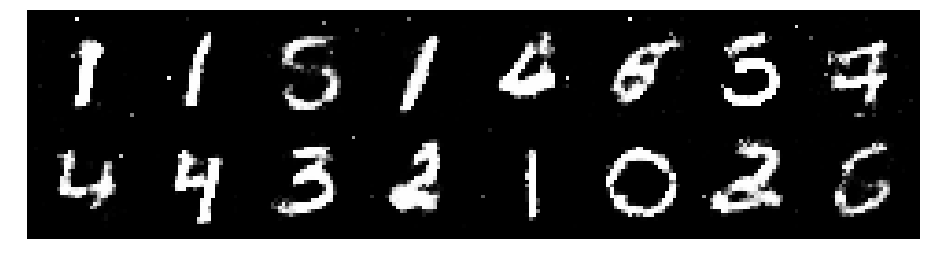

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.4154, Generator Loss: 0.8811
D(x): 0.5061, D(G(z)): 0.4709


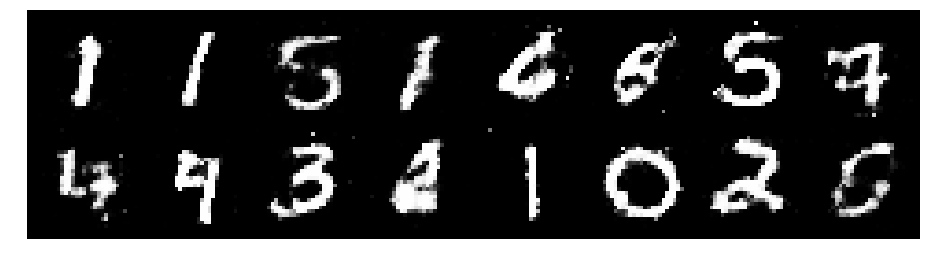

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.4017, Generator Loss: 0.7872
D(x): 0.5442, D(G(z)): 0.5019


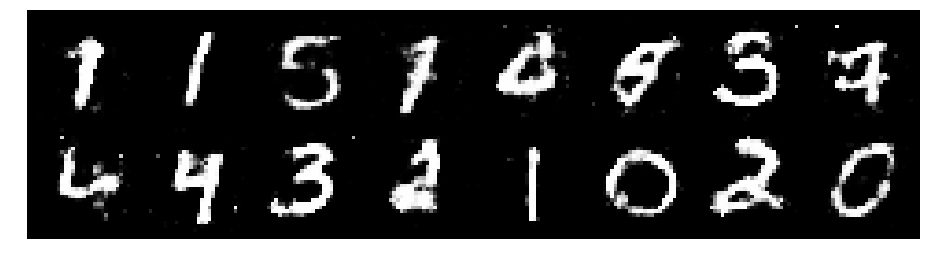

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.2073, Generator Loss: 1.2266
D(x): 0.5745, D(G(z)): 0.3873


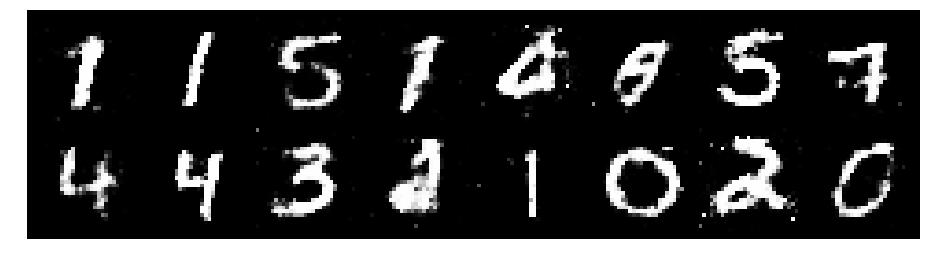

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.2467, Generator Loss: 0.9073
D(x): 0.5590, D(G(z)): 0.4079


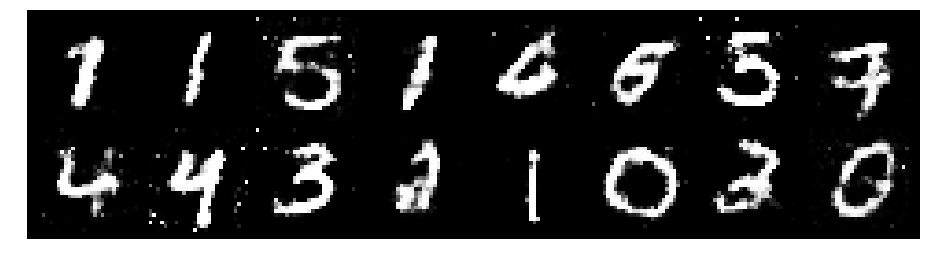

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.1643, Generator Loss: 0.9342
D(x): 0.6109, D(G(z)): 0.4160


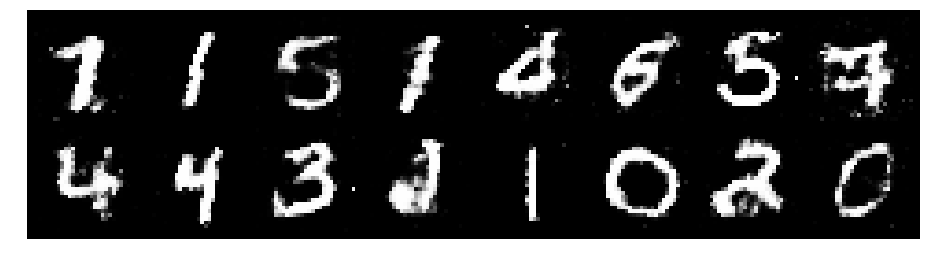

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.1614, Generator Loss: 1.1866
D(x): 0.5542, D(G(z)): 0.3628


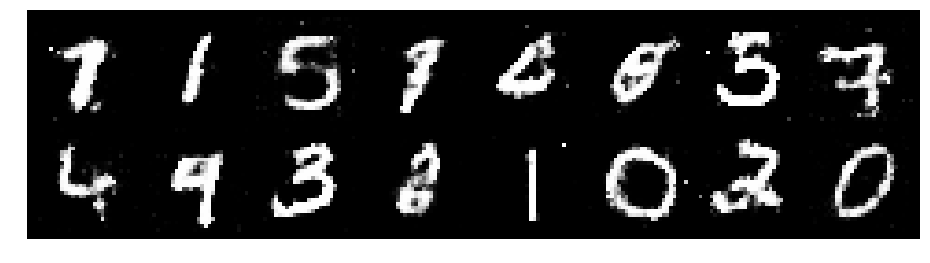

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.1976, Generator Loss: 1.1049
D(x): 0.5825, D(G(z)): 0.4038


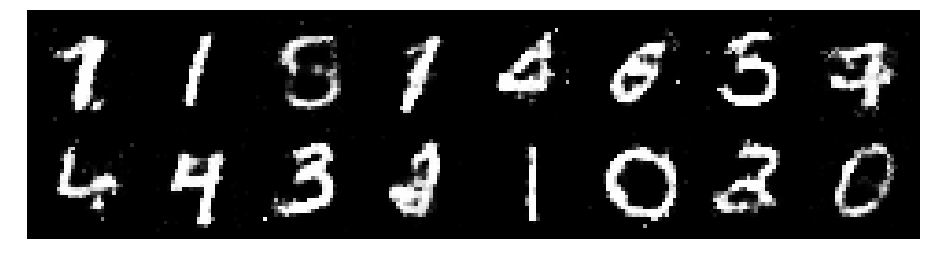

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.3608, Generator Loss: 1.2434
D(x): 0.5072, D(G(z)): 0.3655


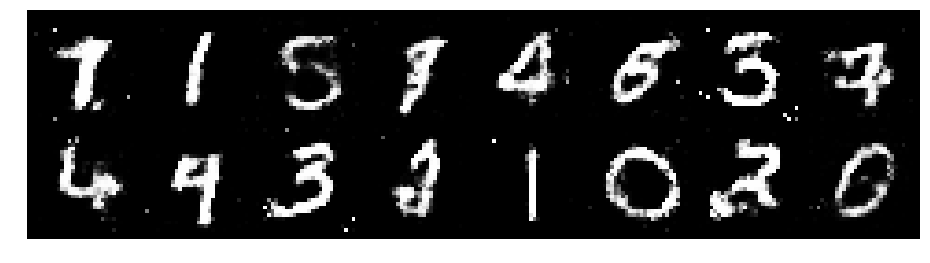

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.1610, Generator Loss: 1.0076
D(x): 0.6128, D(G(z)): 0.4183


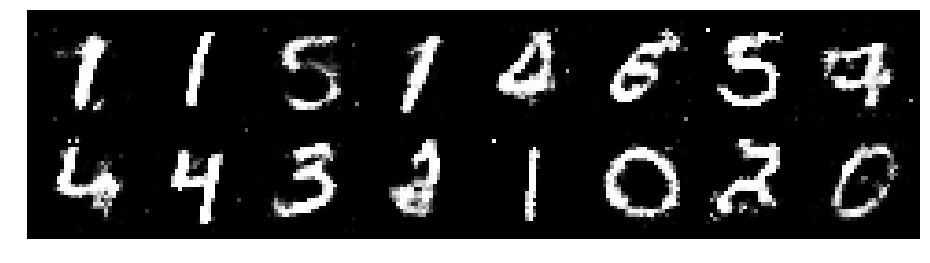

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.1421, Generator Loss: 0.9517
D(x): 0.5676, D(G(z)): 0.3946


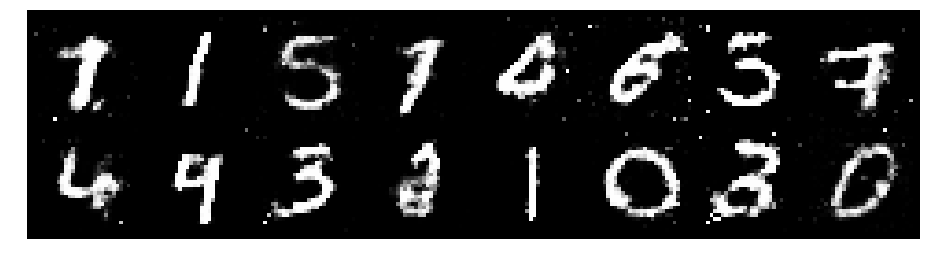

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.2357, Generator Loss: 0.9090
D(x): 0.5671, D(G(z)): 0.4345


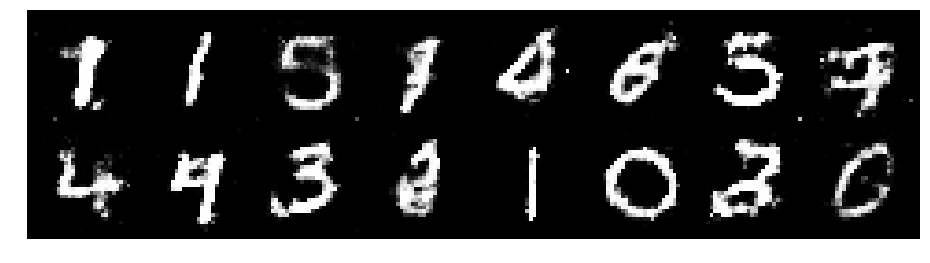

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.2660, Generator Loss: 0.8545
D(x): 0.5608, D(G(z)): 0.4535


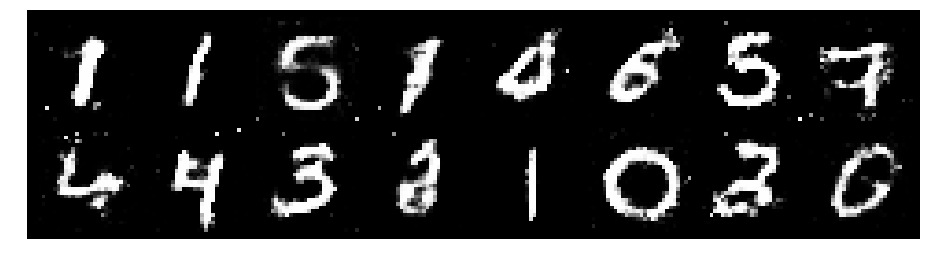

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.2102, Generator Loss: 0.9205
D(x): 0.5732, D(G(z)): 0.4320


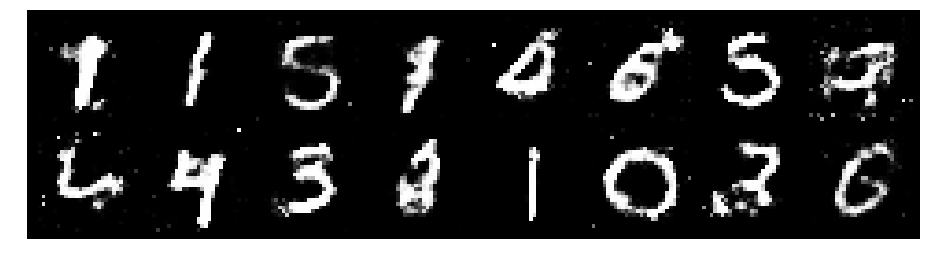

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.2493, Generator Loss: 1.0462
D(x): 0.5243, D(G(z)): 0.3813


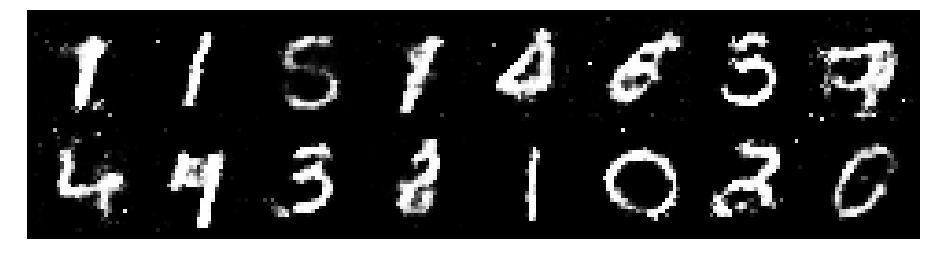

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.2024, Generator Loss: 1.1175
D(x): 0.5590, D(G(z)): 0.3893


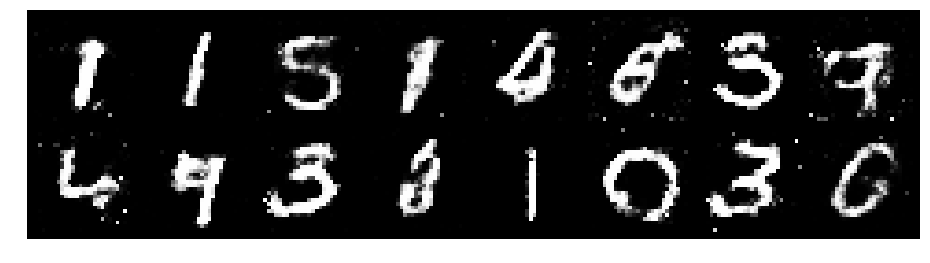

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.1206, Generator Loss: 1.0644
D(x): 0.5797, D(G(z)): 0.3747


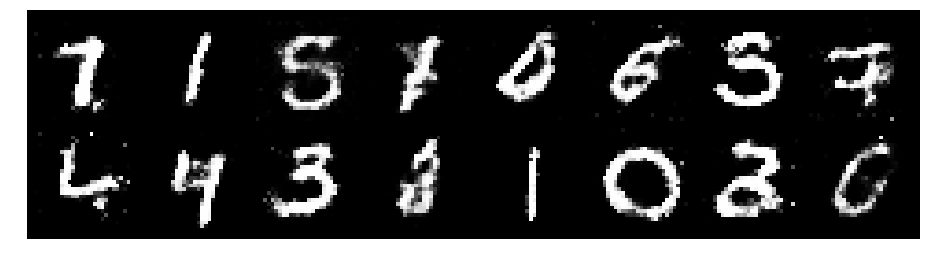

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.1301, Generator Loss: 0.9980
D(x): 0.5788, D(G(z)): 0.3954


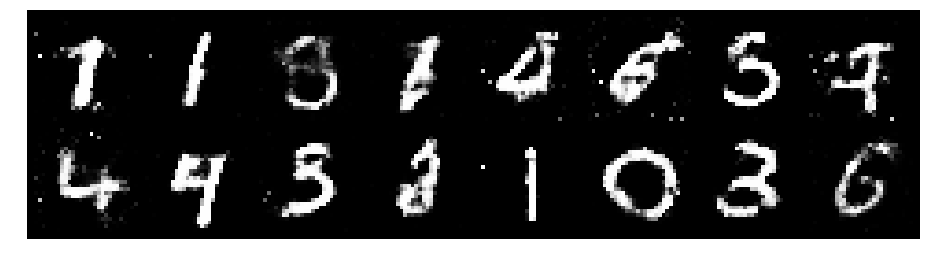

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.2572, Generator Loss: 0.9548
D(x): 0.5497, D(G(z)): 0.4361


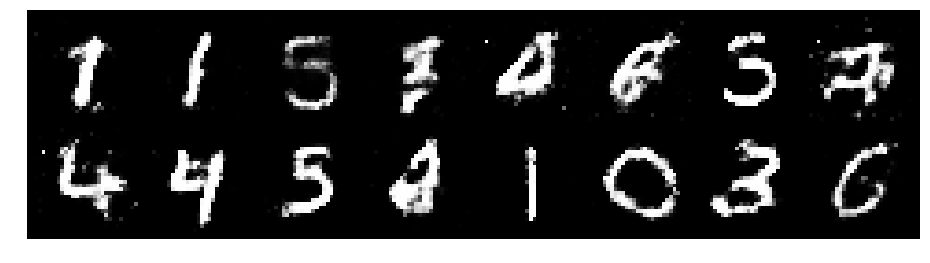

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.2564, Generator Loss: 0.9213
D(x): 0.5596, D(G(z)): 0.4303


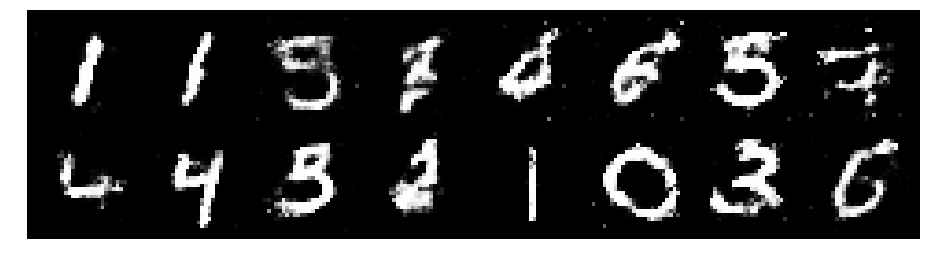

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.3063, Generator Loss: 0.9943
D(x): 0.5240, D(G(z)): 0.4379


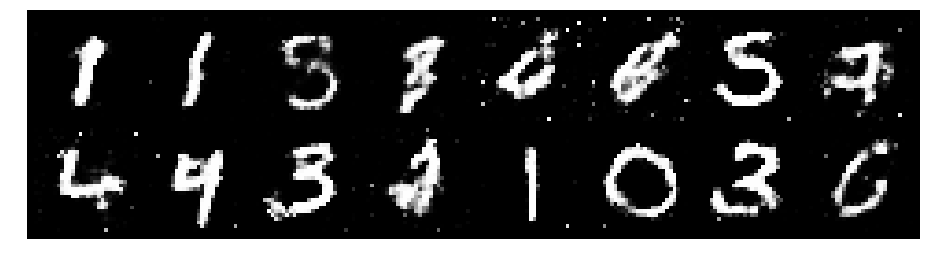

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.2694, Generator Loss: 1.0707
D(x): 0.5185, D(G(z)): 0.3957


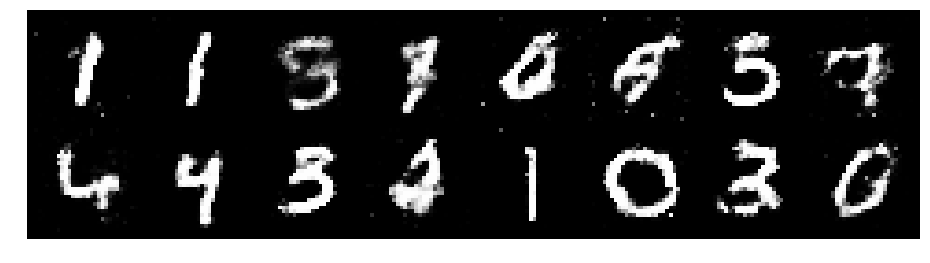

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.2254, Generator Loss: 0.9259
D(x): 0.5729, D(G(z)): 0.4096


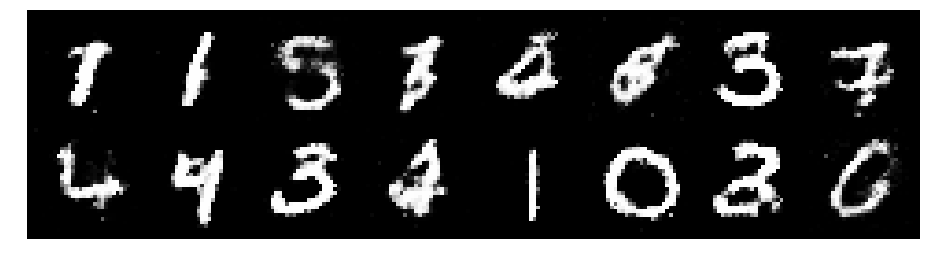

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.3475, Generator Loss: 0.9358
D(x): 0.5263, D(G(z)): 0.4475


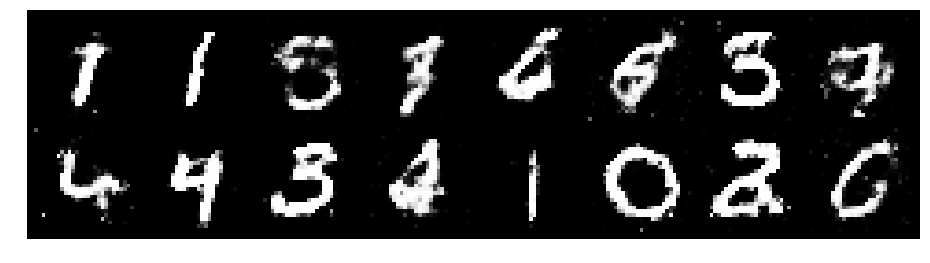

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.2185, Generator Loss: 0.9864
D(x): 0.6336, D(G(z)): 0.4731


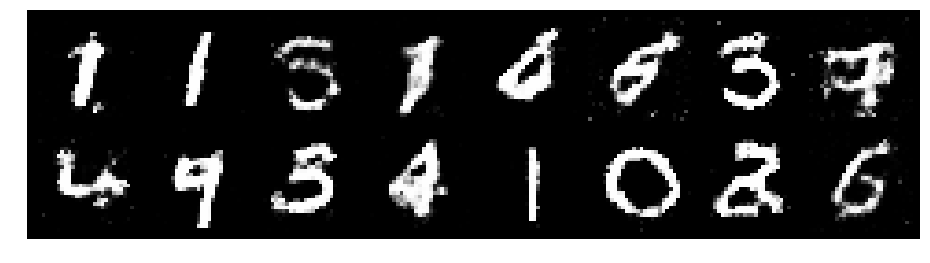

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.5225, Generator Loss: 0.8075
D(x): 0.5648, D(G(z)): 0.5193


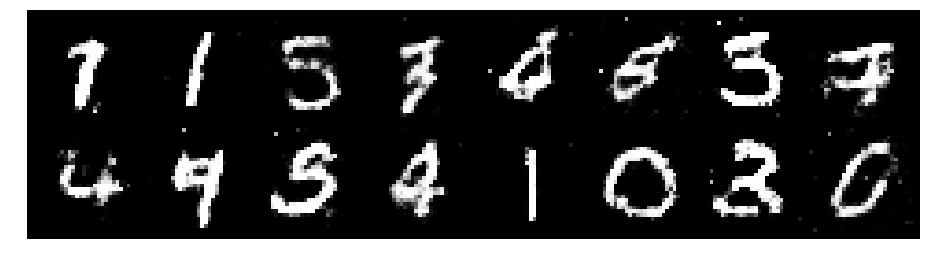

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.2986, Generator Loss: 1.3827
D(x): 0.5232, D(G(z)): 0.3565


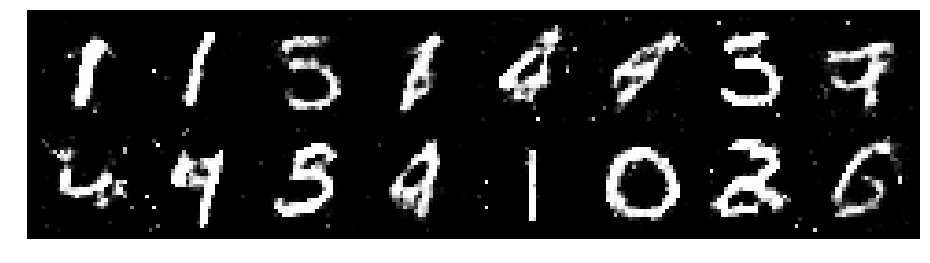

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.2457, Generator Loss: 0.8794
D(x): 0.5680, D(G(z)): 0.4377


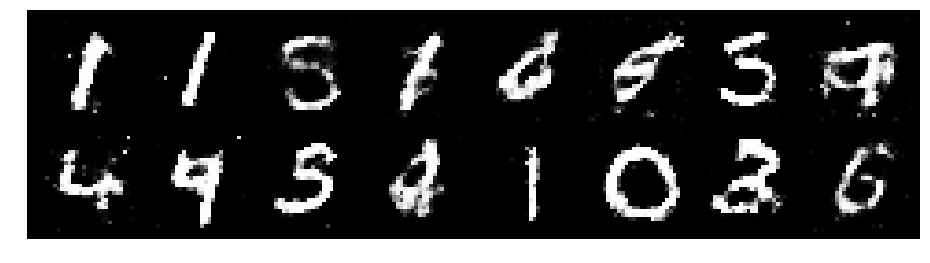

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.2919, Generator Loss: 0.8911
D(x): 0.5173, D(G(z)): 0.4143


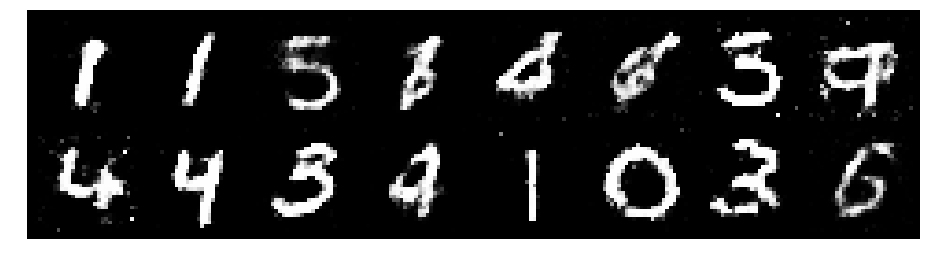

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.3911, Generator Loss: 0.8986
D(x): 0.5682, D(G(z)): 0.4585


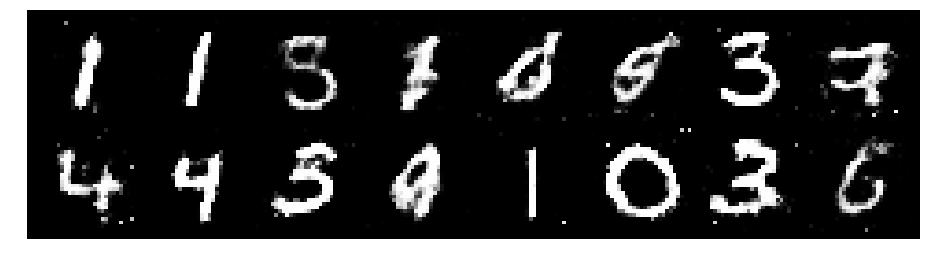

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.1530, Generator Loss: 1.0117
D(x): 0.6170, D(G(z)): 0.4152


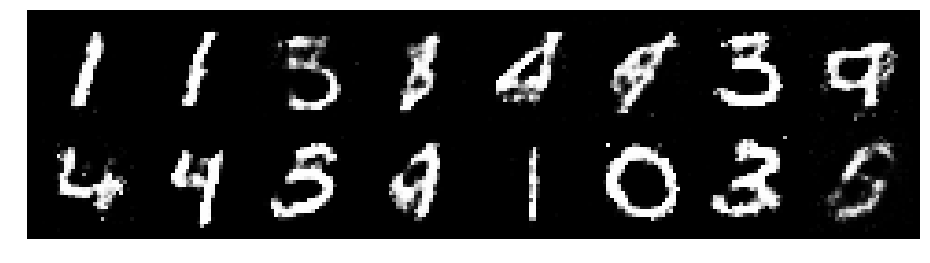

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.3463, Generator Loss: 0.8787
D(x): 0.5601, D(G(z)): 0.4517


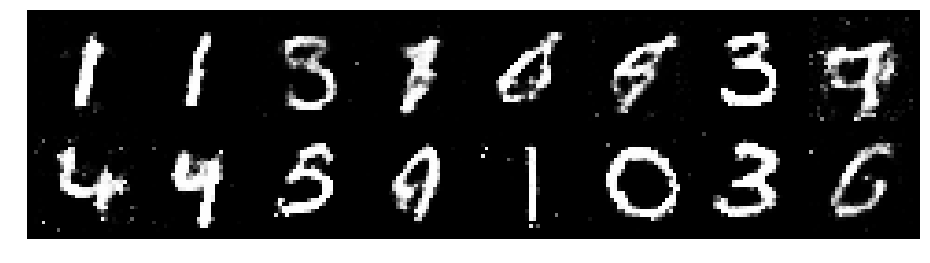

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.3432, Generator Loss: 0.9352
D(x): 0.5880, D(G(z)): 0.4886


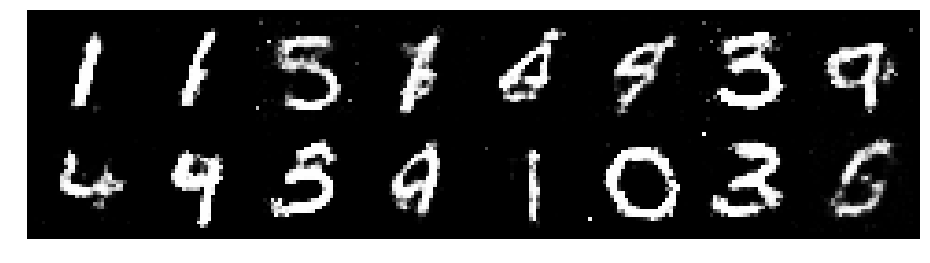

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.2395, Generator Loss: 0.9413
D(x): 0.5665, D(G(z)): 0.4412


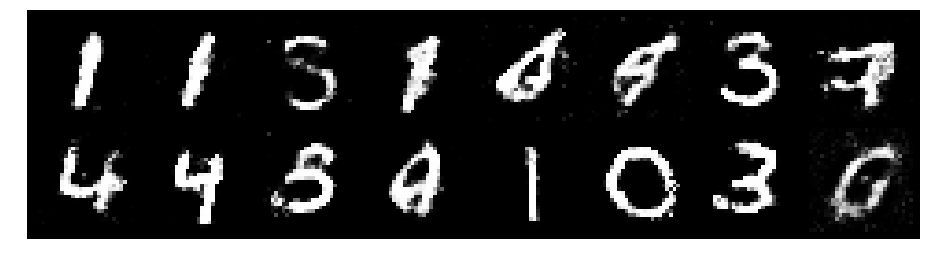

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.2575, Generator Loss: 0.7858
D(x): 0.5936, D(G(z)): 0.4776


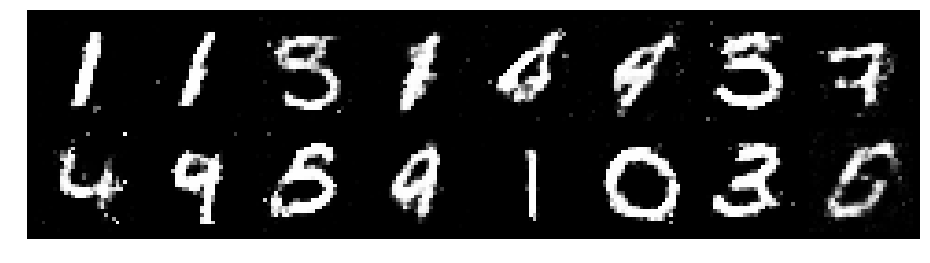

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.3019, Generator Loss: 0.8519
D(x): 0.5992, D(G(z)): 0.4920


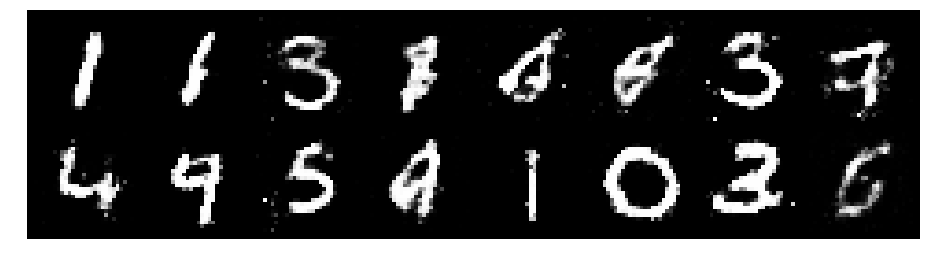

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.2641, Generator Loss: 1.0187
D(x): 0.5657, D(G(z)): 0.4010


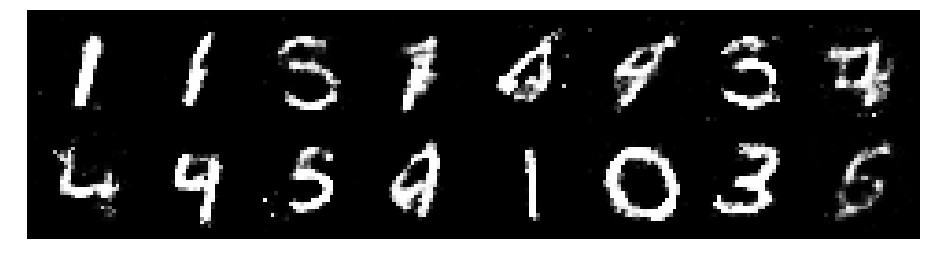

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.2874, Generator Loss: 1.0141
D(x): 0.5456, D(G(z)): 0.4234


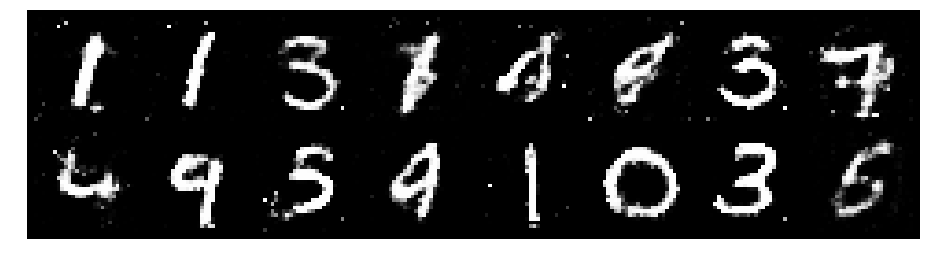

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.2939, Generator Loss: 1.1217
D(x): 0.5477, D(G(z)): 0.4210


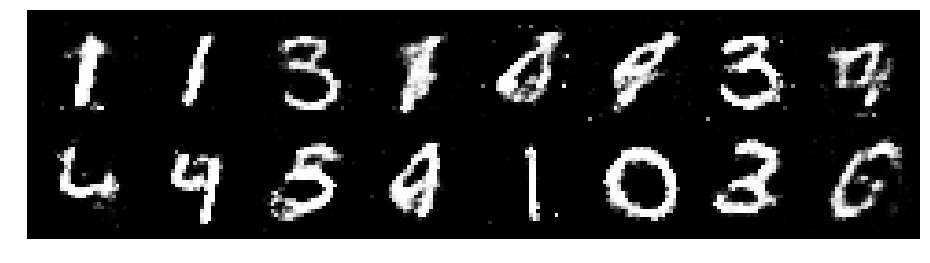

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.2302, Generator Loss: 1.1558
D(x): 0.5949, D(G(z)): 0.4421


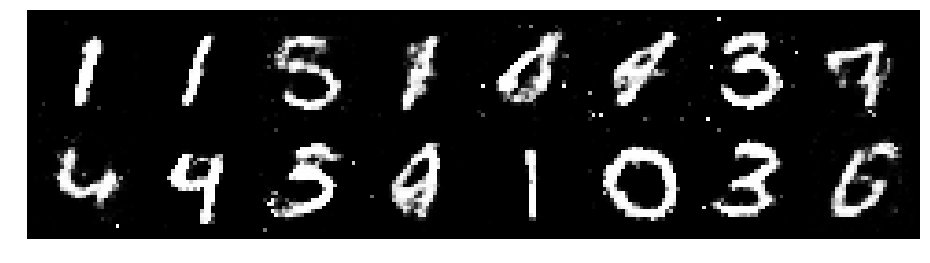

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.2360, Generator Loss: 1.0165
D(x): 0.5533, D(G(z)): 0.4139


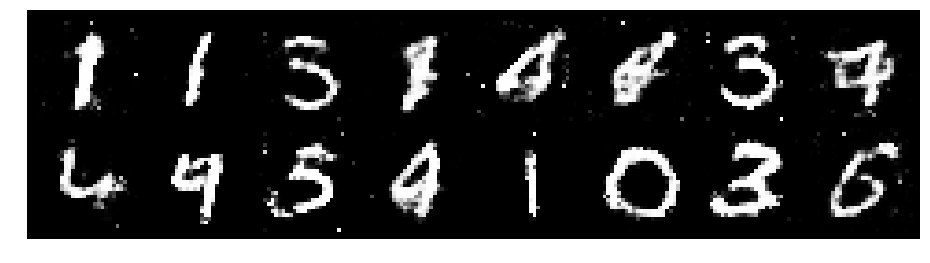

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.1360, Generator Loss: 1.1617
D(x): 0.5980, D(G(z)): 0.3949


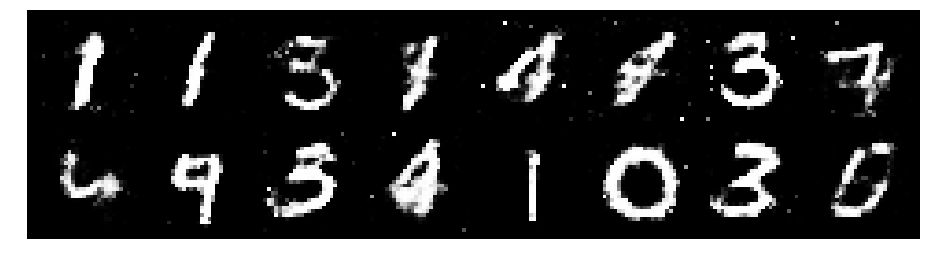

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.1314, Generator Loss: 1.0228
D(x): 0.5951, D(G(z)): 0.3866


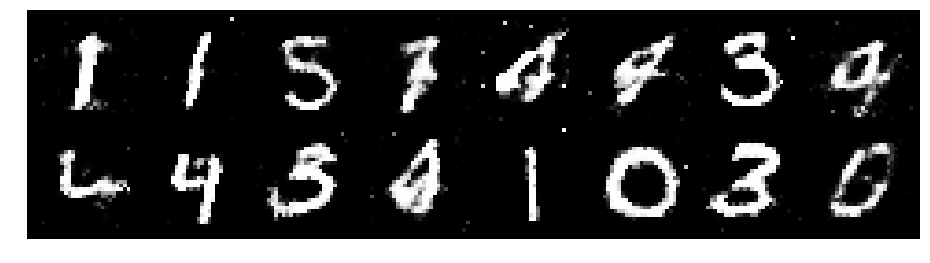

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.0790, Generator Loss: 1.0599
D(x): 0.6091, D(G(z)): 0.3960


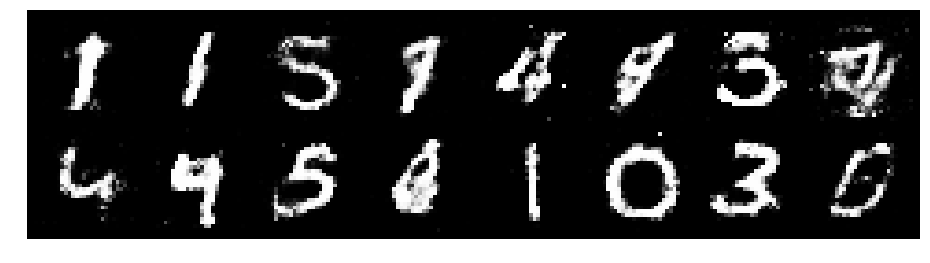

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.1638, Generator Loss: 1.0106
D(x): 0.5793, D(G(z)): 0.4023


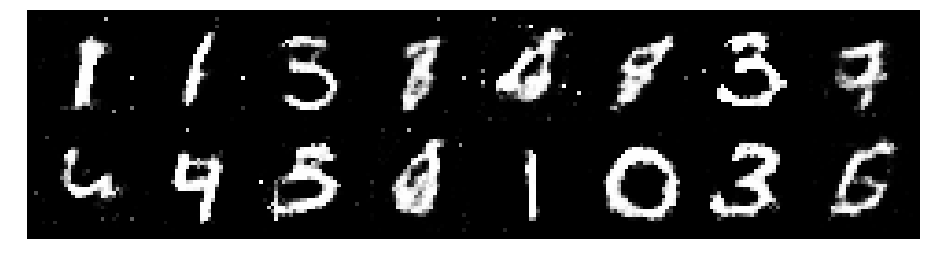

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.2564, Generator Loss: 1.0013
D(x): 0.5557, D(G(z)): 0.4123


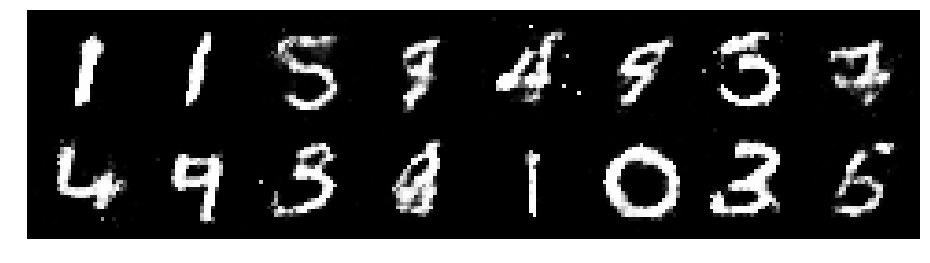

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.3119, Generator Loss: 0.8321
D(x): 0.5555, D(G(z)): 0.4584


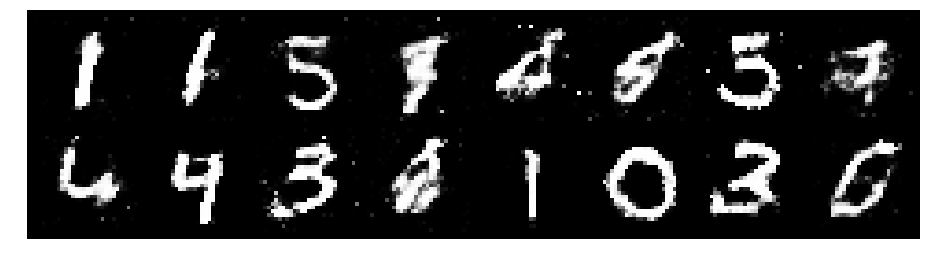

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.3862, Generator Loss: 0.9469
D(x): 0.5355, D(G(z)): 0.4771


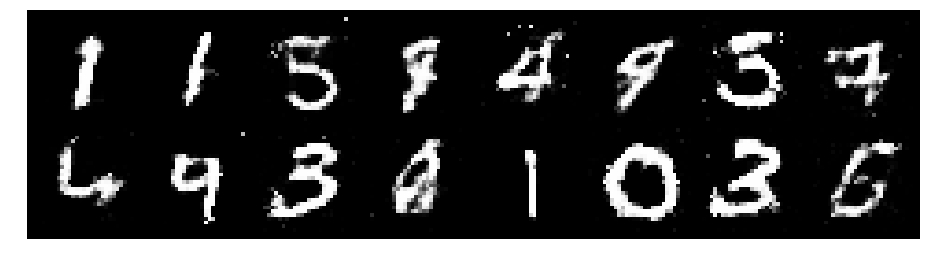

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.3623, Generator Loss: 0.7767
D(x): 0.5767, D(G(z)): 0.4826


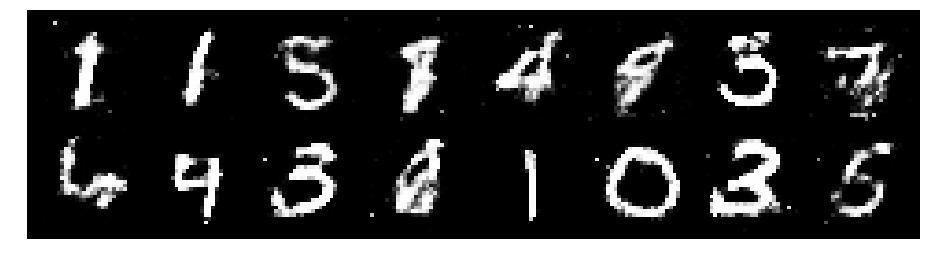

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.2948, Generator Loss: 0.9372
D(x): 0.5152, D(G(z)): 0.4199


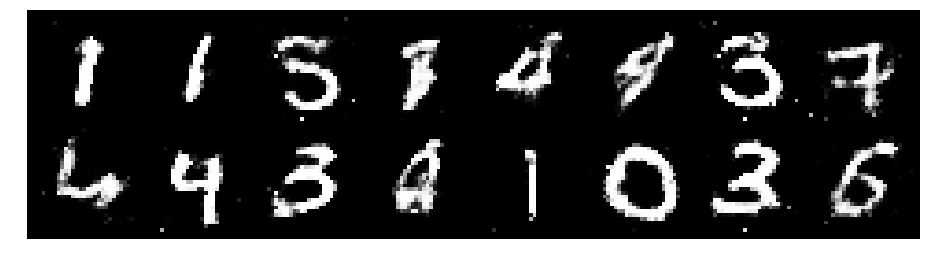

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.3526, Generator Loss: 0.9617
D(x): 0.5189, D(G(z)): 0.4273


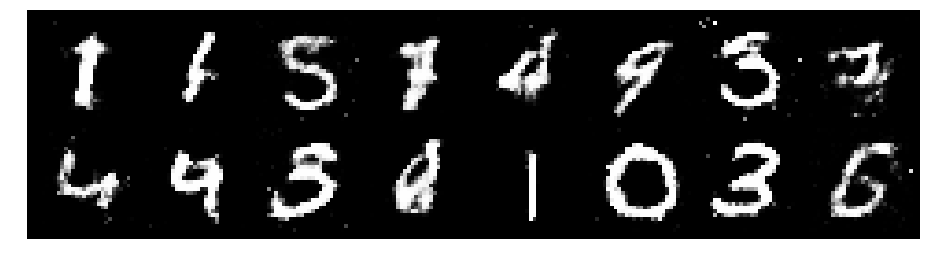

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.2991, Generator Loss: 0.8516
D(x): 0.5484, D(G(z)): 0.4645


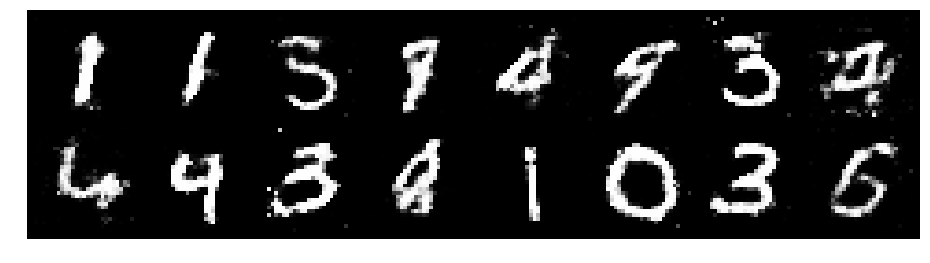

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.2591, Generator Loss: 0.7727
D(x): 0.5774, D(G(z)): 0.4599


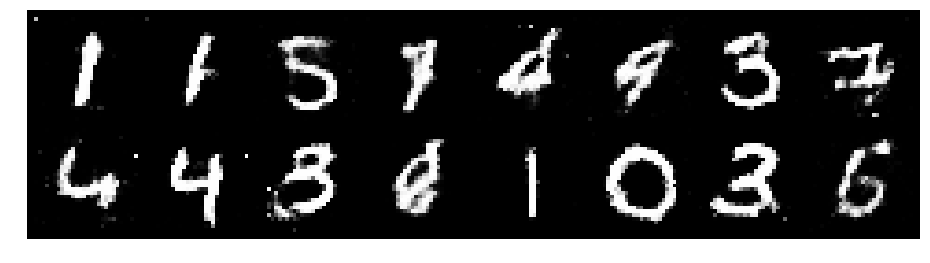

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.3269, Generator Loss: 0.8256
D(x): 0.5622, D(G(z)): 0.4886


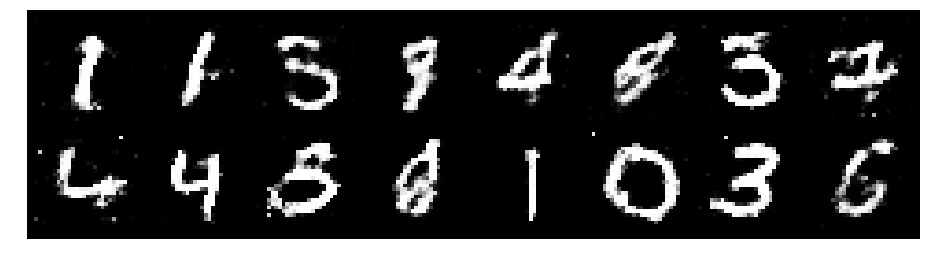

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.2922, Generator Loss: 0.9270
D(x): 0.5566, D(G(z)): 0.4561


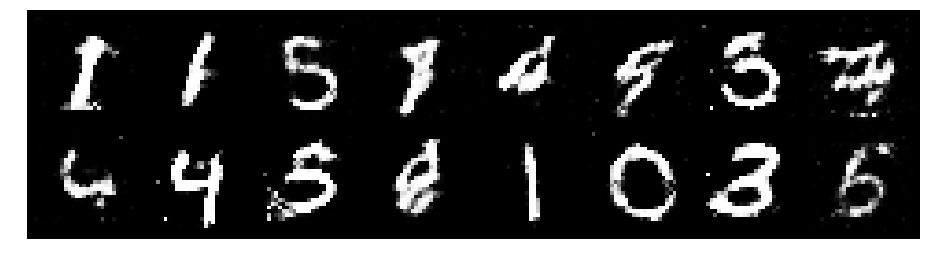

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.2636, Generator Loss: 0.8406
D(x): 0.5403, D(G(z)): 0.4406


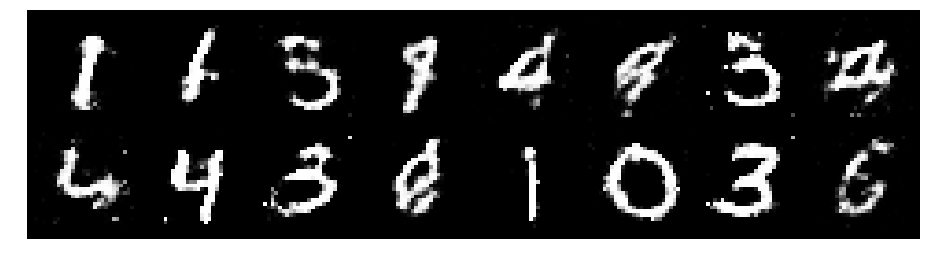

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.3336, Generator Loss: 0.8146
D(x): 0.5760, D(G(z)): 0.4724


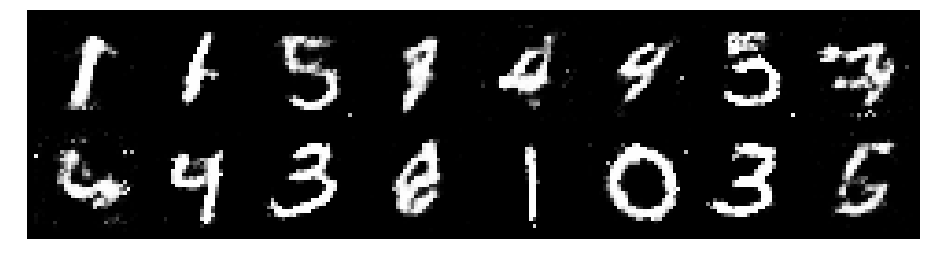

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.4387, Generator Loss: 0.8354
D(x): 0.5602, D(G(z)): 0.5037


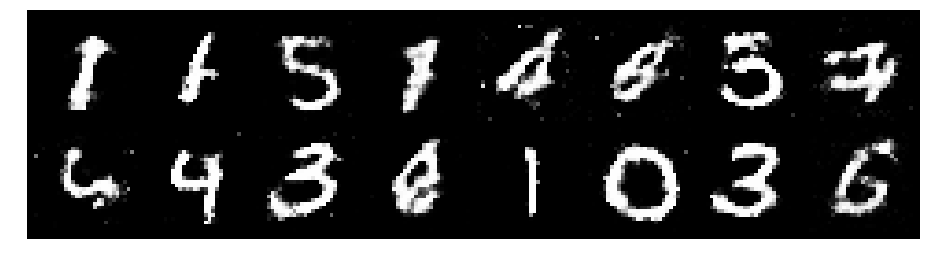

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.1900, Generator Loss: 0.9315
D(x): 0.6188, D(G(z)): 0.4416


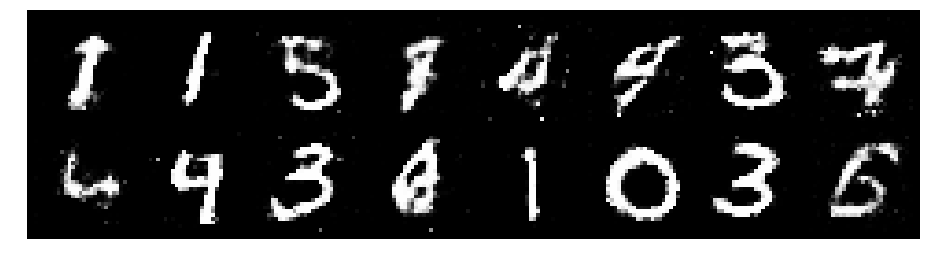

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.1979, Generator Loss: 0.9339
D(x): 0.5781, D(G(z)): 0.4463


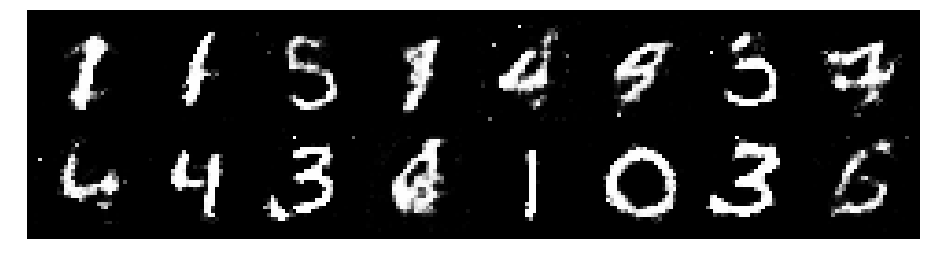

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.2745, Generator Loss: 0.9596
D(x): 0.5083, D(G(z)): 0.4056


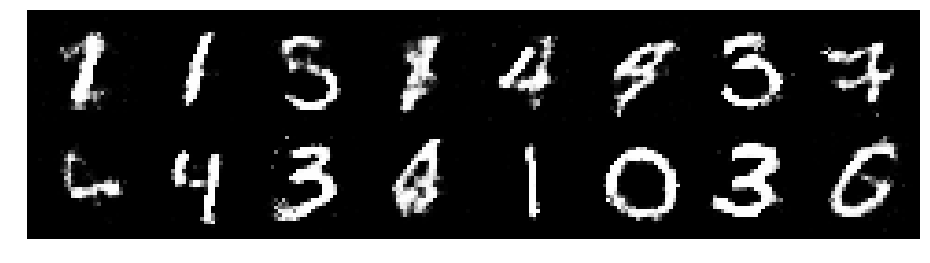

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.2518, Generator Loss: 0.9119
D(x): 0.5327, D(G(z)): 0.4242


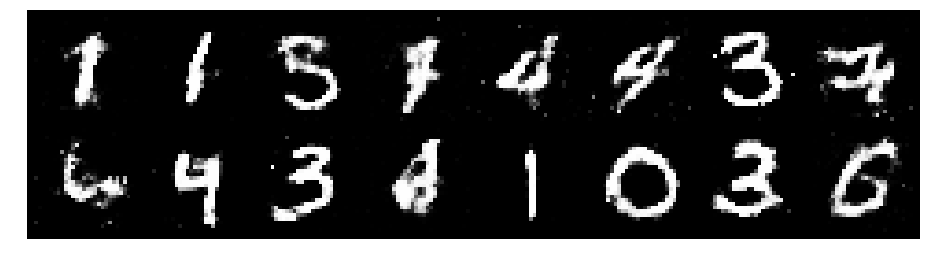

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.2083, Generator Loss: 0.8867
D(x): 0.6144, D(G(z)): 0.4454


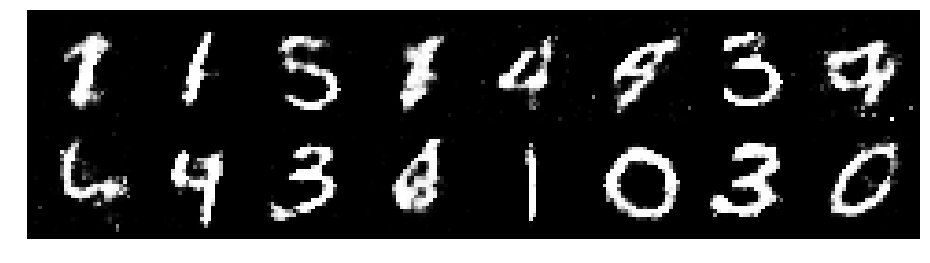

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.2273, Generator Loss: 0.8737
D(x): 0.5623, D(G(z)): 0.4412


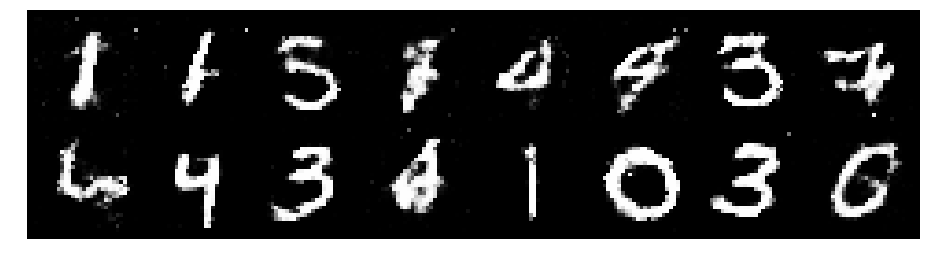

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.2442, Generator Loss: 1.0271
D(x): 0.5411, D(G(z)): 0.4263


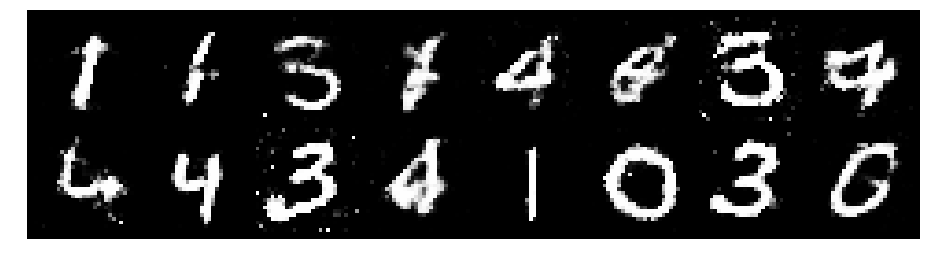

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.2134, Generator Loss: 1.0096
D(x): 0.6038, D(G(z)): 0.4485


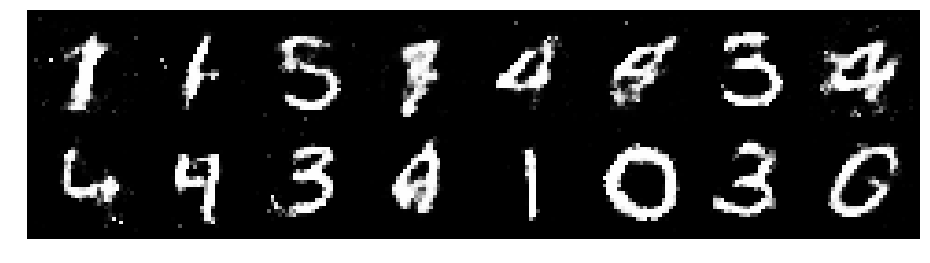

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.3046, Generator Loss: 0.8814
D(x): 0.5402, D(G(z)): 0.4353


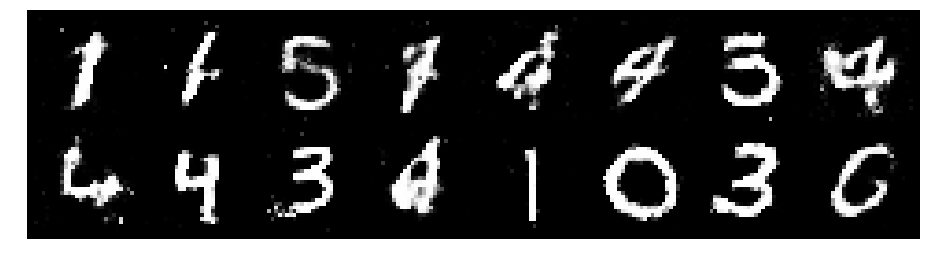

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.1900, Generator Loss: 0.9534
D(x): 0.5588, D(G(z)): 0.3992


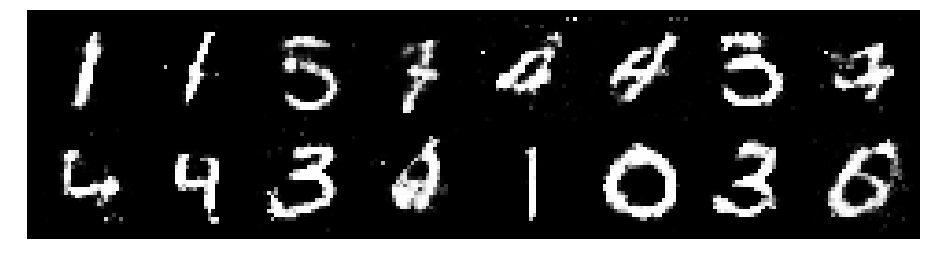

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.1815, Generator Loss: 1.0123
D(x): 0.5771, D(G(z)): 0.4149


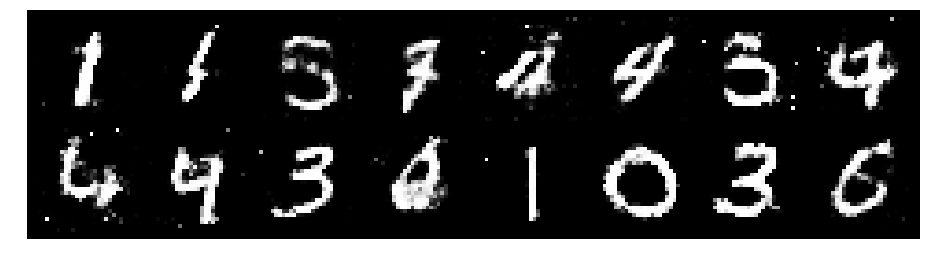

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.3071, Generator Loss: 0.8517
D(x): 0.5753, D(G(z)): 0.4803


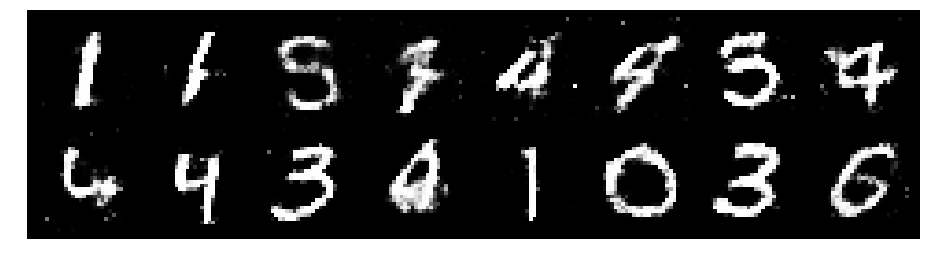

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.1842, Generator Loss: 0.9842
D(x): 0.5340, D(G(z)): 0.3750


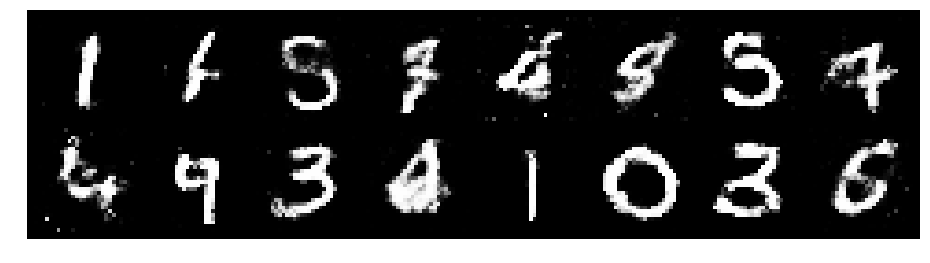

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.2457, Generator Loss: 0.8102
D(x): 0.5507, D(G(z)): 0.4268


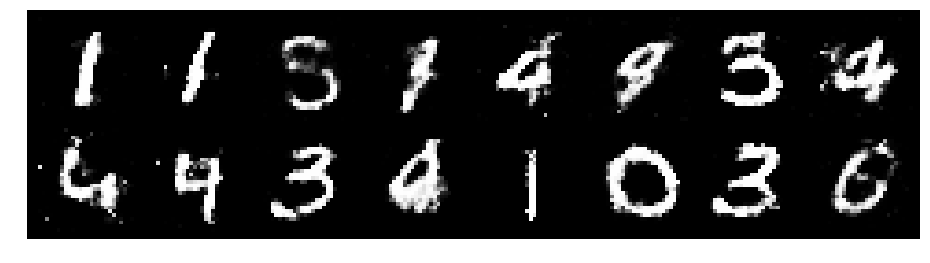

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.2028, Generator Loss: 1.0637
D(x): 0.5700, D(G(z)): 0.4016


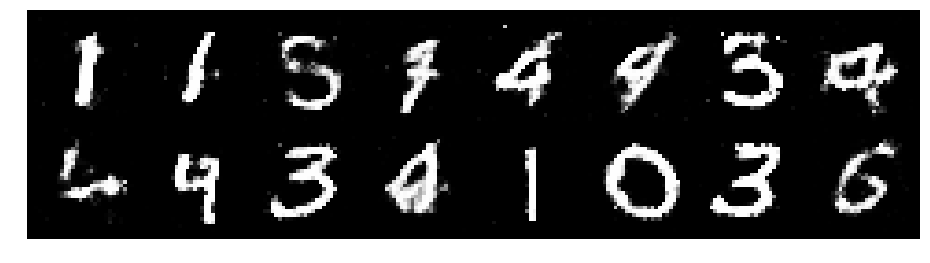

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.2161, Generator Loss: 0.8153
D(x): 0.6012, D(G(z)): 0.4494


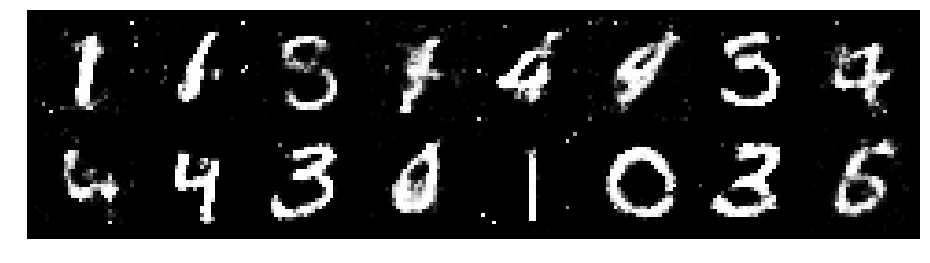

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.3406, Generator Loss: 0.8152
D(x): 0.5452, D(G(z)): 0.4668


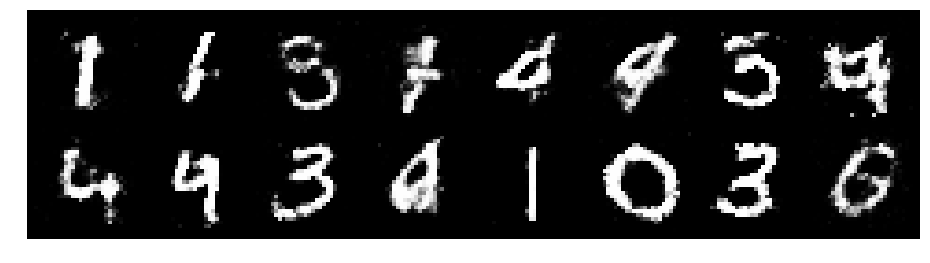

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.4260, Generator Loss: 0.8582
D(x): 0.4997, D(G(z)): 0.4591


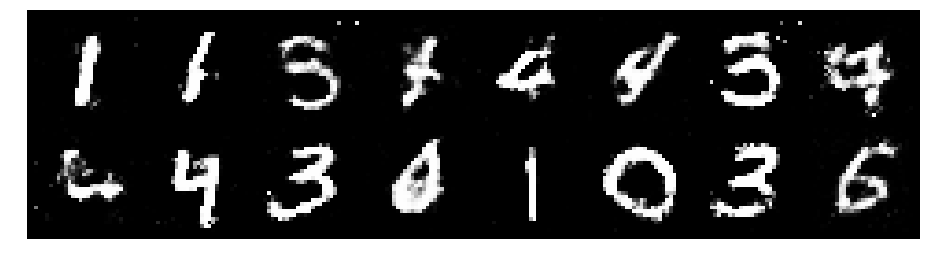

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.3727, Generator Loss: 0.7324
D(x): 0.5725, D(G(z)): 0.5154


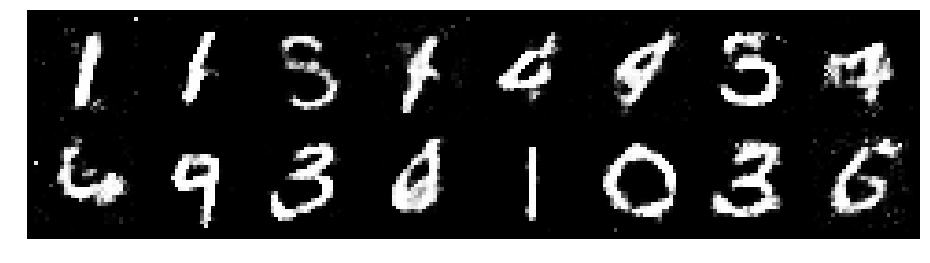

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.5074, Generator Loss: 1.1563
D(x): 0.5374, D(G(z)): 0.4738


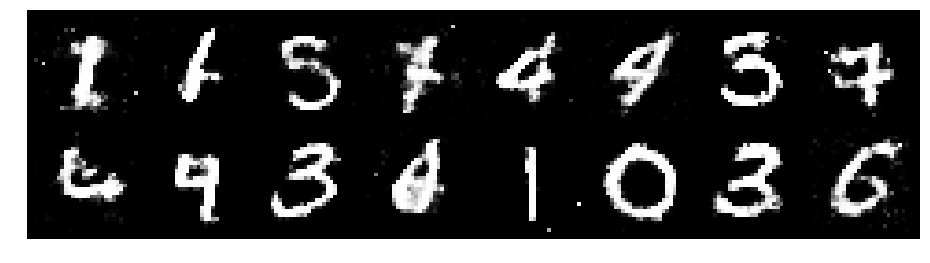

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.3109, Generator Loss: 0.9800
D(x): 0.5852, D(G(z)): 0.4395


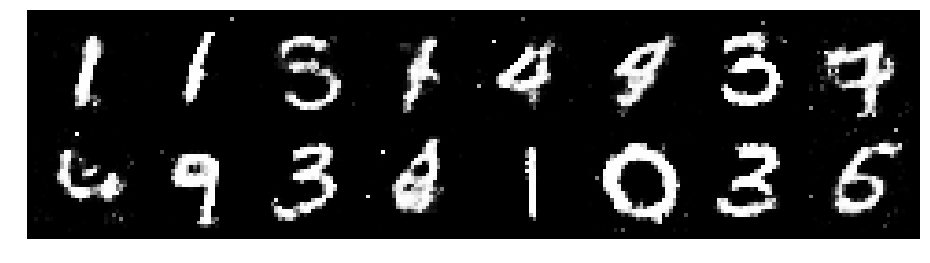

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.2253, Generator Loss: 0.8500
D(x): 0.5879, D(G(z)): 0.4463


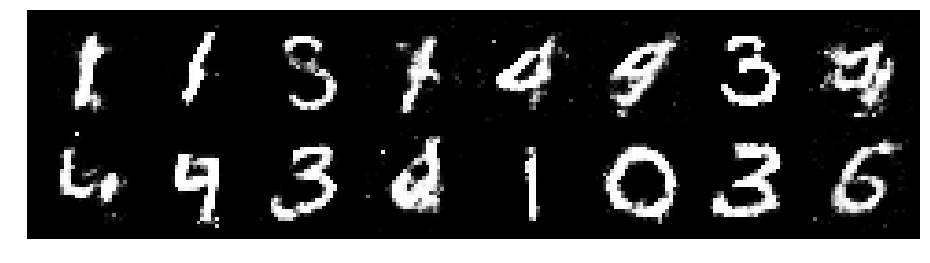

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.3155, Generator Loss: 0.9770
D(x): 0.5556, D(G(z)): 0.4594


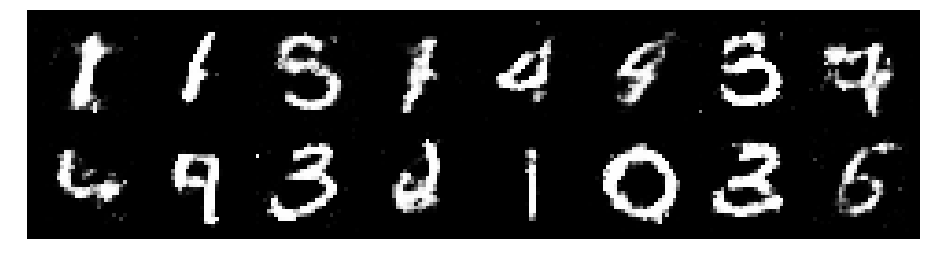

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.3116, Generator Loss: 0.8292
D(x): 0.5887, D(G(z)): 0.4884


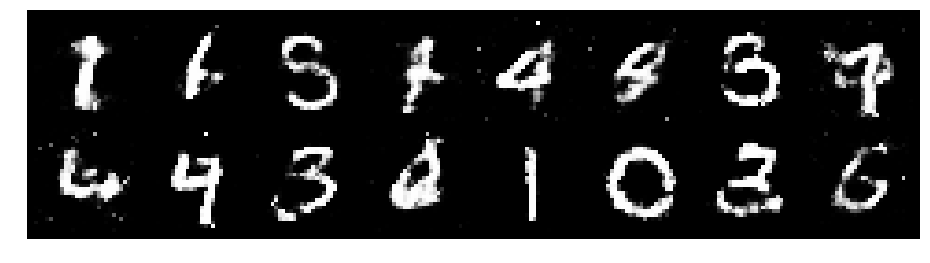

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.3629, Generator Loss: 0.9402
D(x): 0.5914, D(G(z)): 0.4966


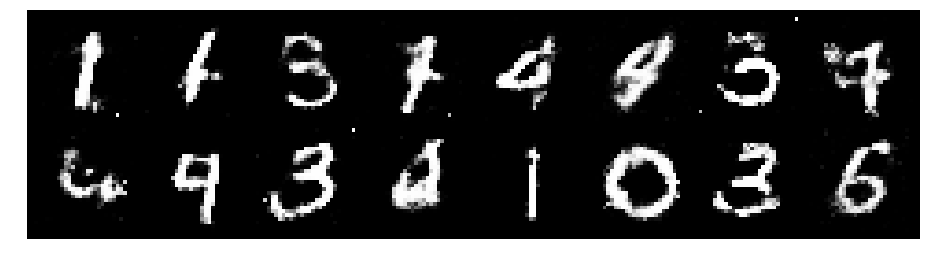

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.4216, Generator Loss: 0.7789
D(x): 0.5675, D(G(z)): 0.4886


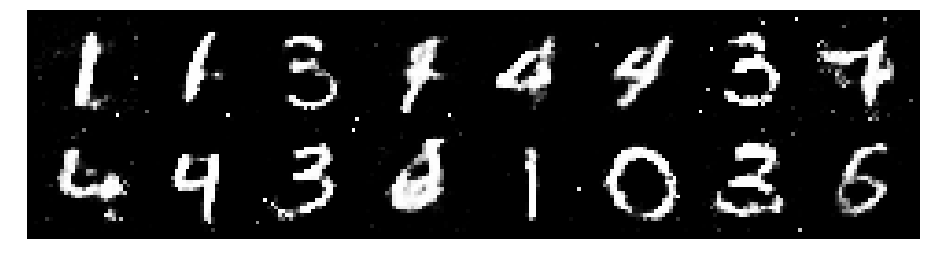

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.3132, Generator Loss: 0.9173
D(x): 0.5939, D(G(z)): 0.4884


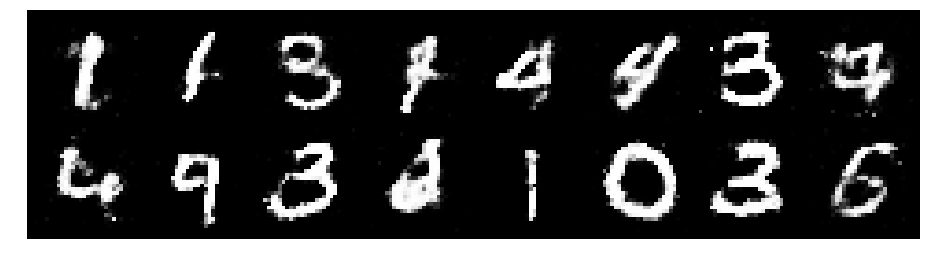

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.2651, Generator Loss: 0.9822
D(x): 0.5353, D(G(z)): 0.4021


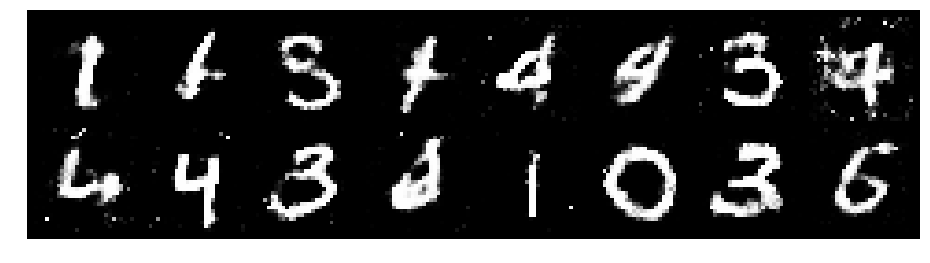

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.2488, Generator Loss: 1.1053
D(x): 0.5790, D(G(z)): 0.4365


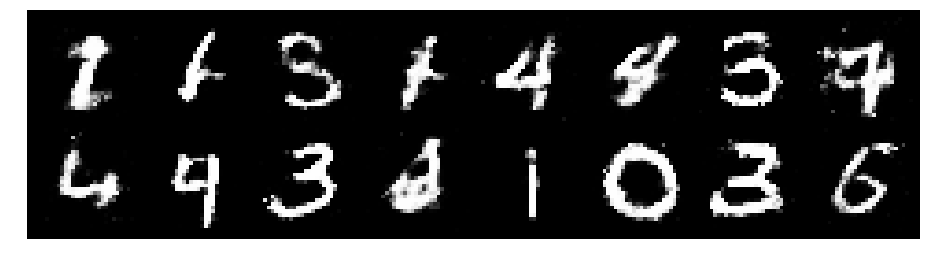

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.3345, Generator Loss: 1.0809
D(x): 0.5326, D(G(z)): 0.4202


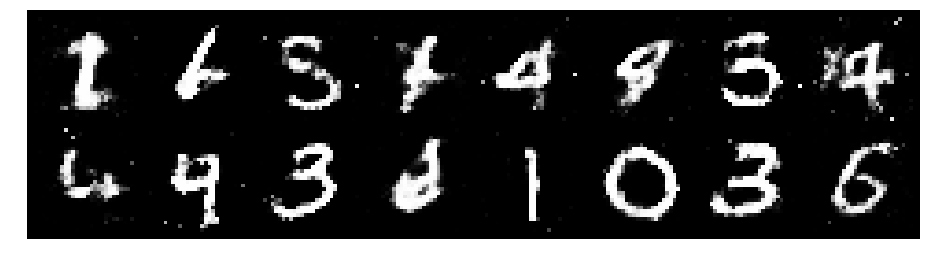

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.3034, Generator Loss: 1.0825
D(x): 0.5821, D(G(z)): 0.4496


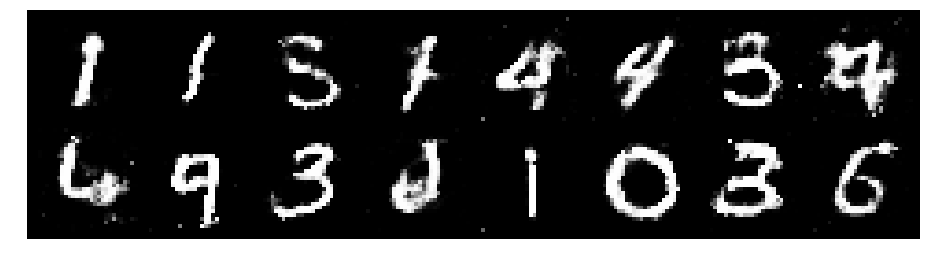

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.3561, Generator Loss: 1.1021
D(x): 0.4537, D(G(z)): 0.3359


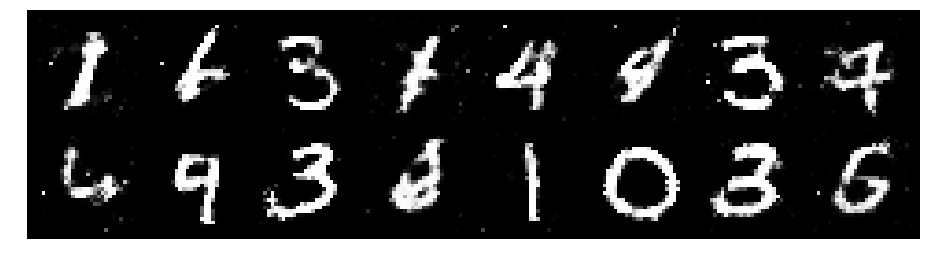

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.2379, Generator Loss: 0.9758
D(x): 0.5579, D(G(z)): 0.4247


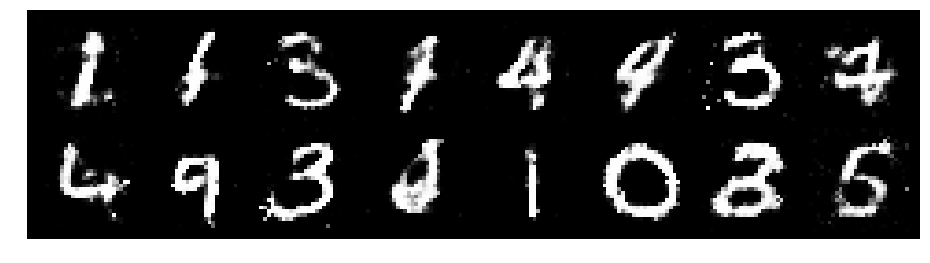

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.2079, Generator Loss: 0.9896
D(x): 0.5525, D(G(z)): 0.3941


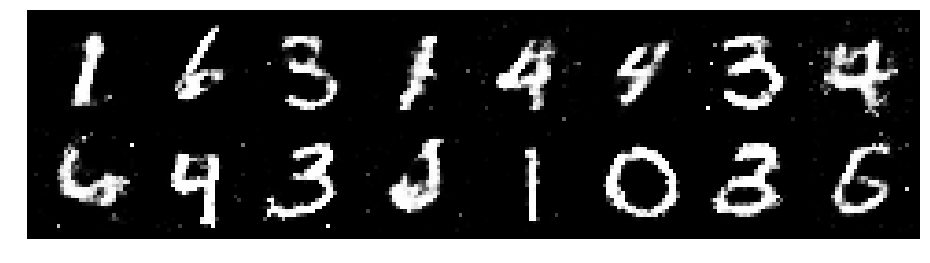

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.3457, Generator Loss: 1.0748
D(x): 0.4832, D(G(z)): 0.3813


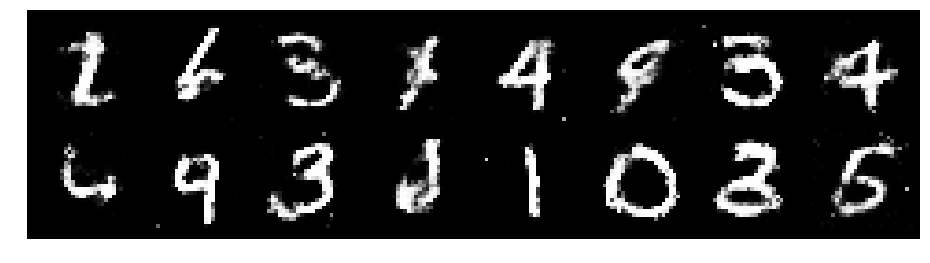

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.2385, Generator Loss: 1.0053
D(x): 0.5395, D(G(z)): 0.4148


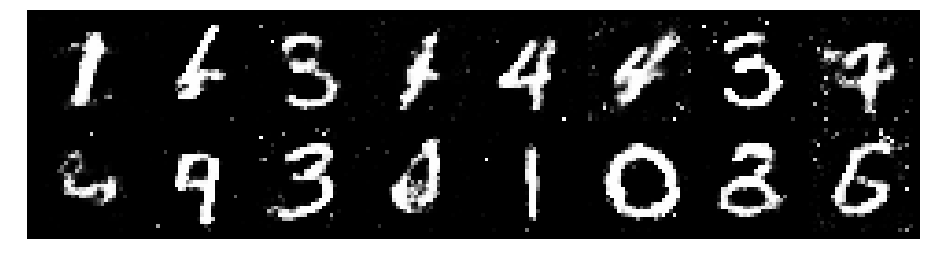

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.3170, Generator Loss: 0.9855
D(x): 0.5541, D(G(z)): 0.4652


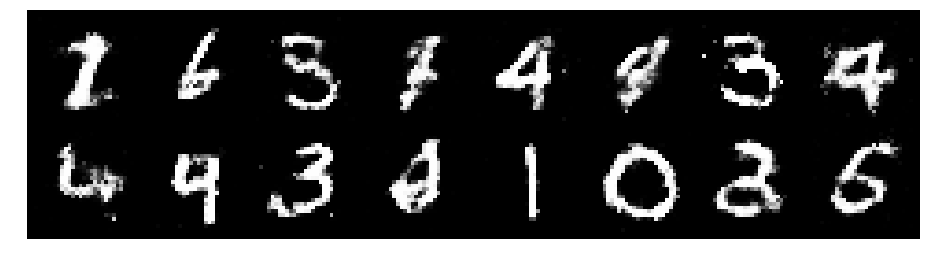

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.2898, Generator Loss: 0.7764
D(x): 0.5481, D(G(z)): 0.4814


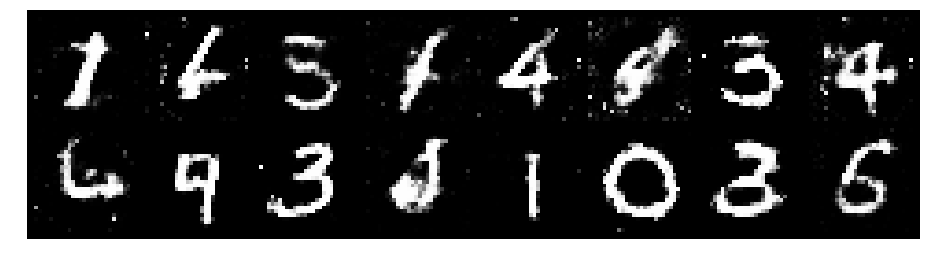

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.3268, Generator Loss: 0.9706
D(x): 0.5135, D(G(z)): 0.4279


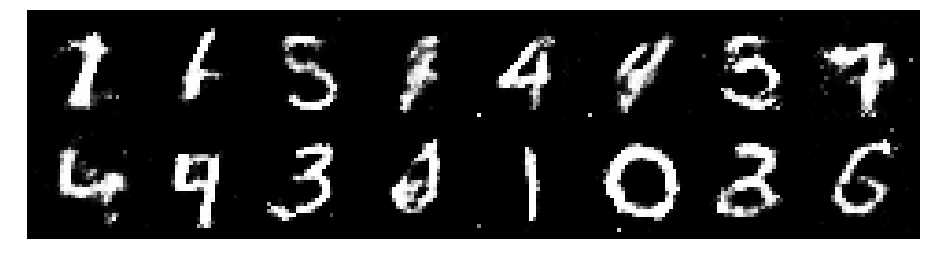

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.1983, Generator Loss: 0.9782
D(x): 0.5755, D(G(z)): 0.3867


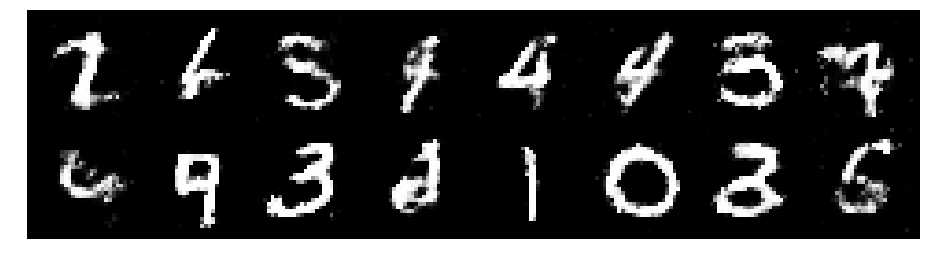

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.1686, Generator Loss: 0.8908
D(x): 0.5877, D(G(z)): 0.3839


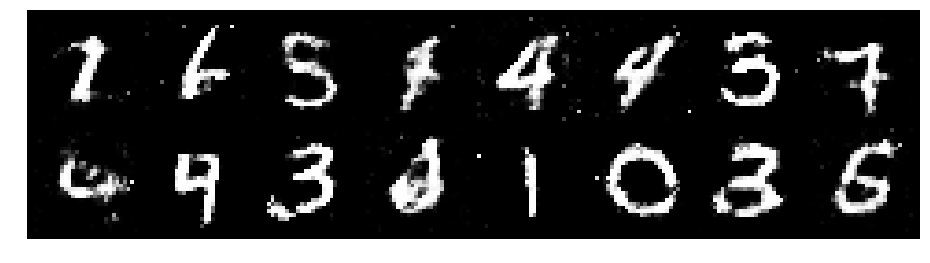

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.2152, Generator Loss: 0.8796
D(x): 0.5756, D(G(z)): 0.4399


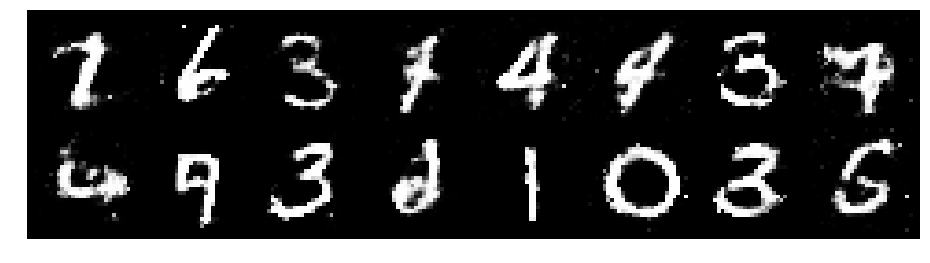

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.3532, Generator Loss: 0.8436
D(x): 0.5260, D(G(z)): 0.4556


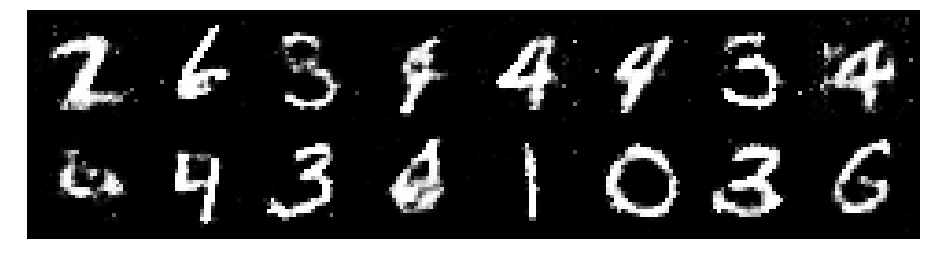

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.2201, Generator Loss: 0.8960
D(x): 0.5459, D(G(z)): 0.4181


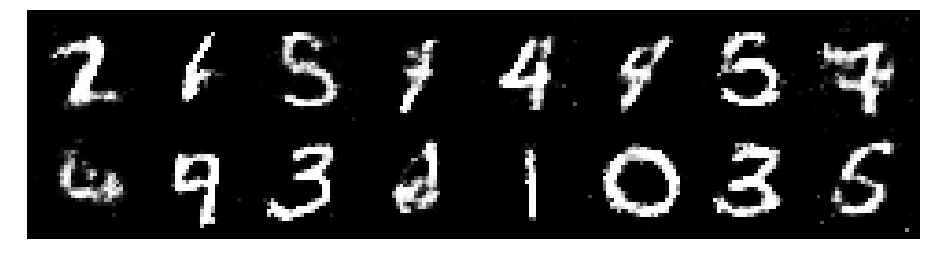

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.2641, Generator Loss: 0.8565
D(x): 0.5490, D(G(z)): 0.4550


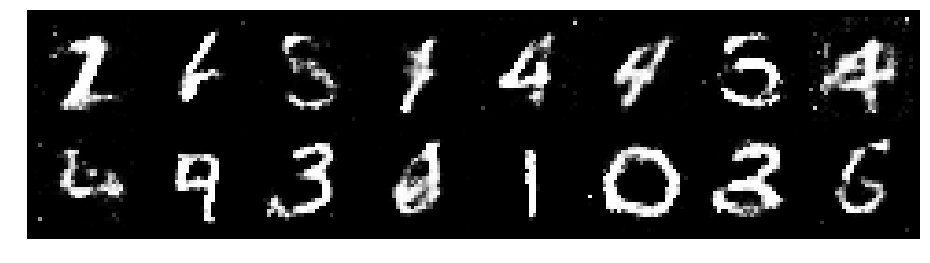

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.3636, Generator Loss: 0.9027
D(x): 0.4643, D(G(z)): 0.4161


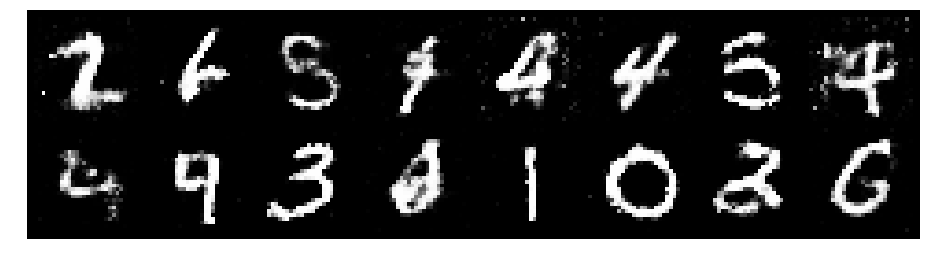

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.2726, Generator Loss: 0.7889
D(x): 0.5777, D(G(z)): 0.4748


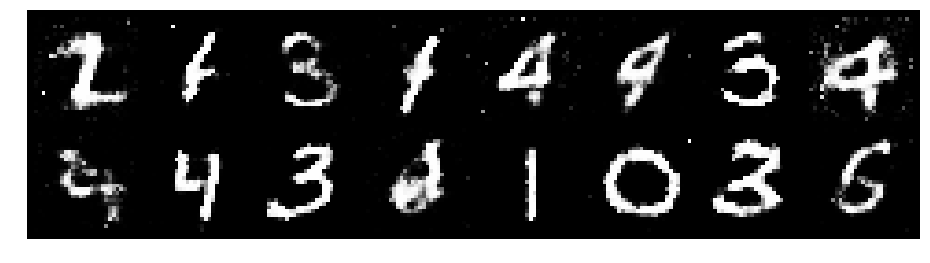

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.3383, Generator Loss: 0.8541
D(x): 0.5411, D(G(z)): 0.4459


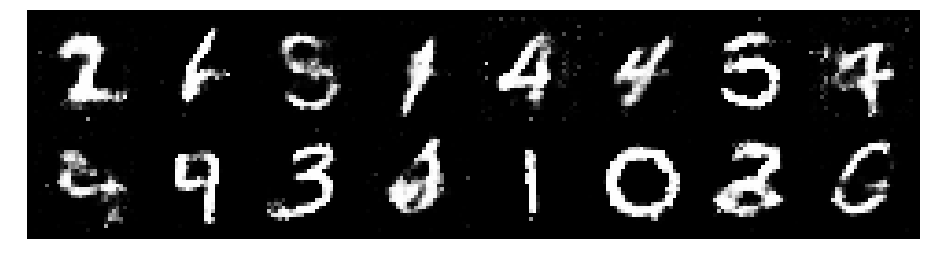

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.2559, Generator Loss: 0.9407
D(x): 0.5469, D(G(z)): 0.4064


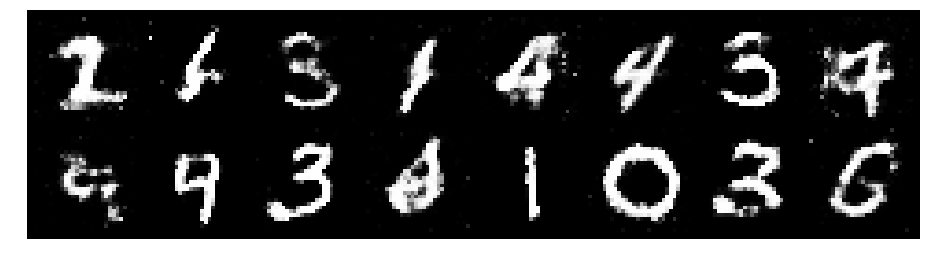

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.3477, Generator Loss: 0.9379
D(x): 0.5568, D(G(z)): 0.4242


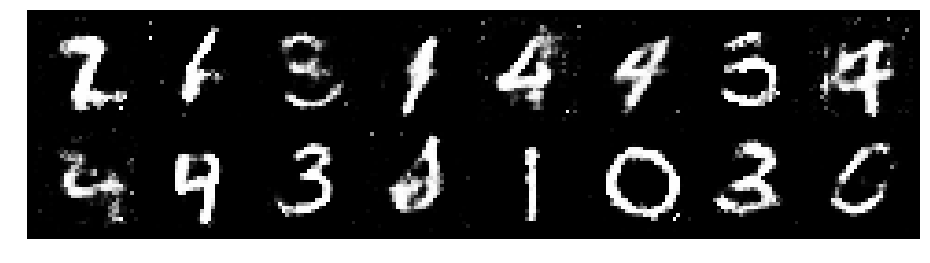

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.2040, Generator Loss: 1.0090
D(x): 0.6043, D(G(z)): 0.4241


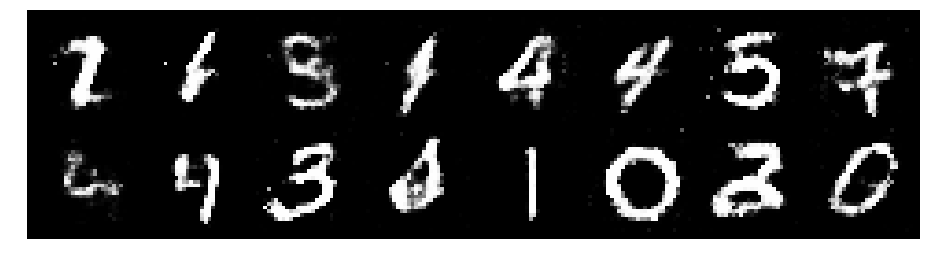

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.2841, Generator Loss: 0.9535
D(x): 0.5521, D(G(z)): 0.4277


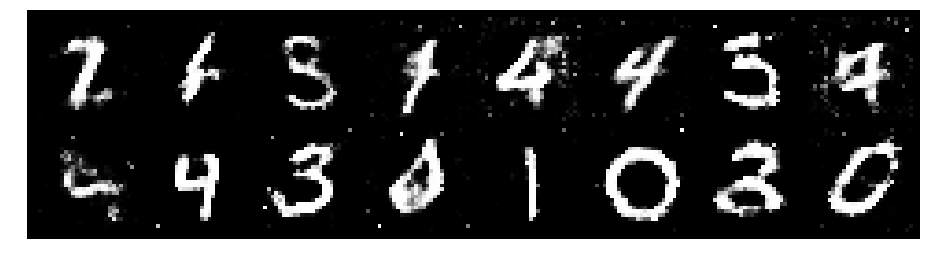

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.3275, Generator Loss: 0.9529
D(x): 0.5175, D(G(z)): 0.4493


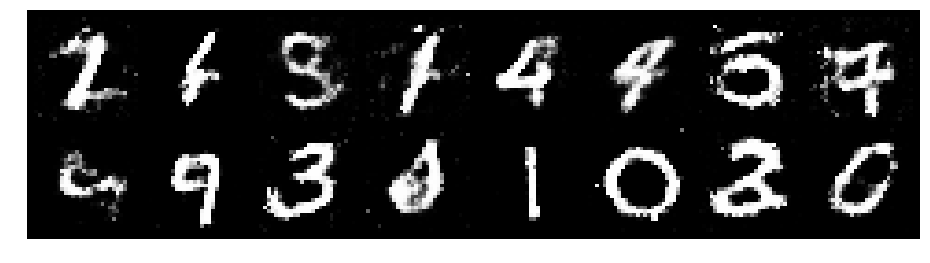

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.2380, Generator Loss: 0.7483
D(x): 0.5791, D(G(z)): 0.4588


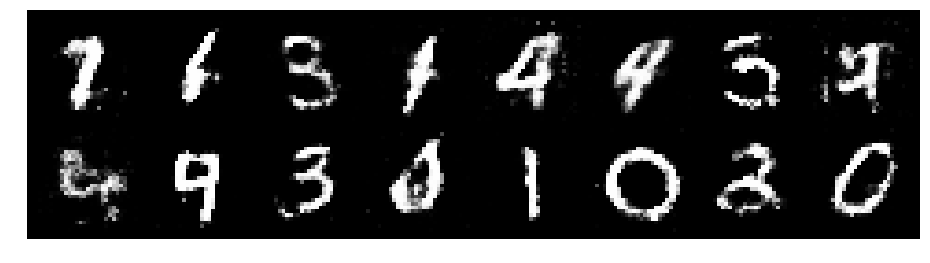

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.3086, Generator Loss: 0.7058
D(x): 0.5460, D(G(z)): 0.4890


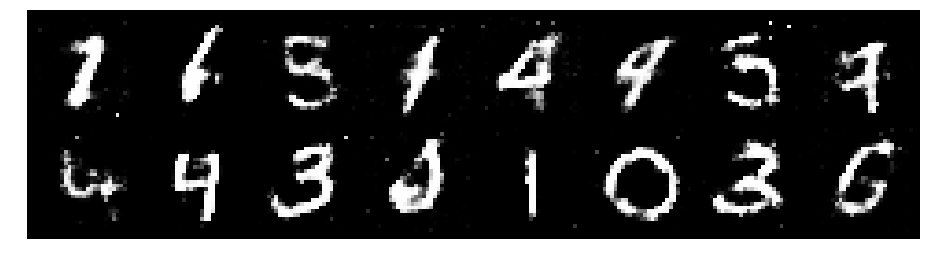

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.3736, Generator Loss: 0.8041
D(x): 0.5058, D(G(z)): 0.4336


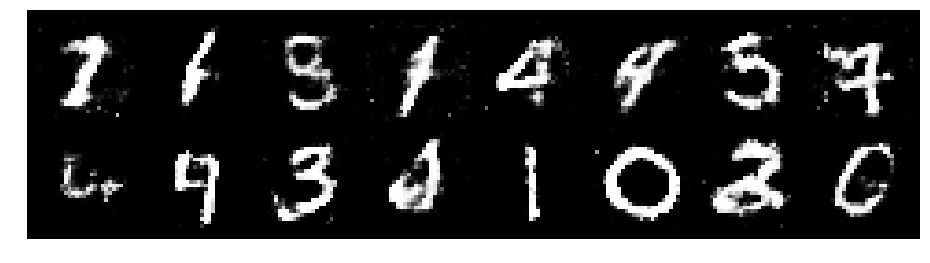

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.3337, Generator Loss: 0.9840
D(x): 0.6350, D(G(z)): 0.5025


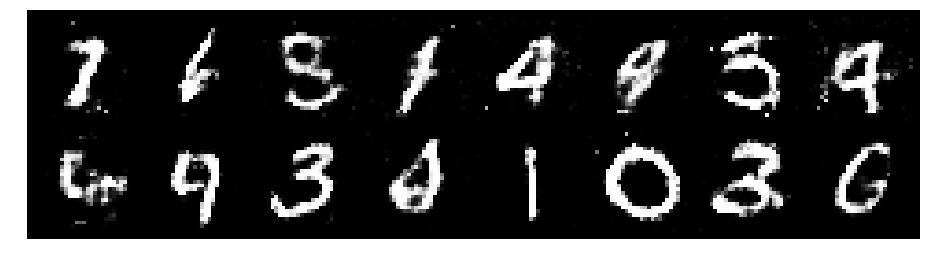

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.1463, Generator Loss: 0.9466
D(x): 0.5907, D(G(z)): 0.4077


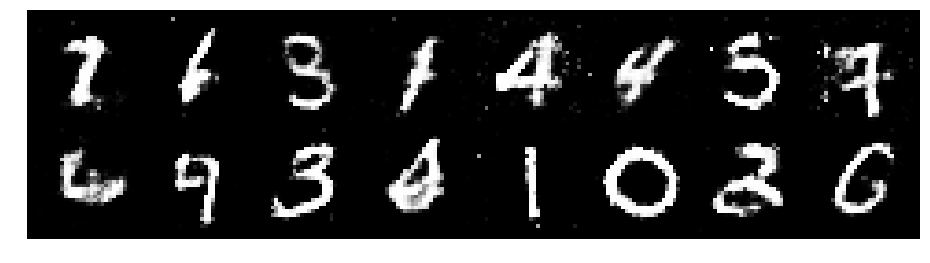

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.0983, Generator Loss: 0.8918
D(x): 0.6388, D(G(z)): 0.4293


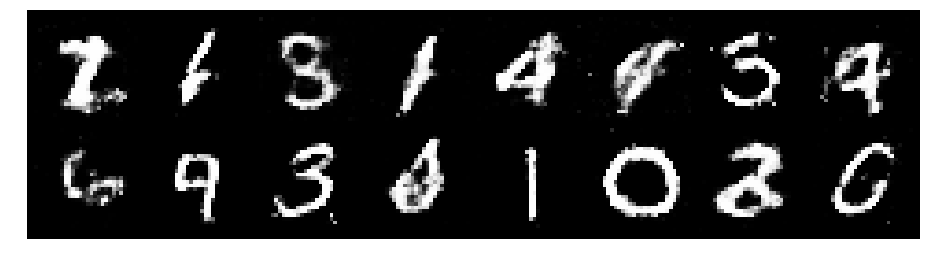

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.1916, Generator Loss: 0.9930
D(x): 0.5745, D(G(z)): 0.4079


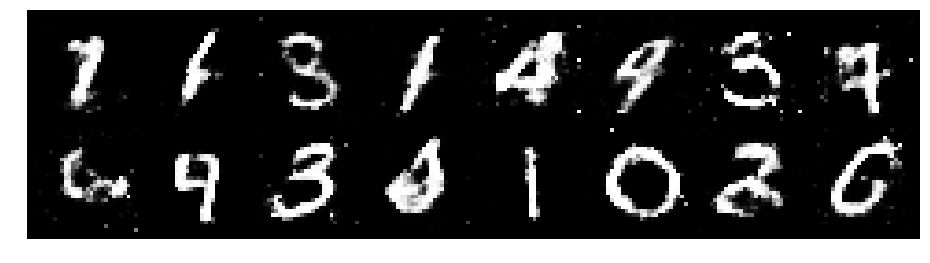

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.2720, Generator Loss: 0.8924
D(x): 0.5846, D(G(z)): 0.4619


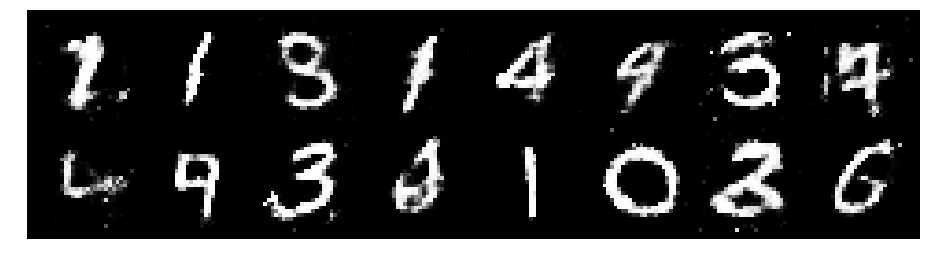

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.1431, Generator Loss: 1.0620
D(x): 0.5794, D(G(z)): 0.3815


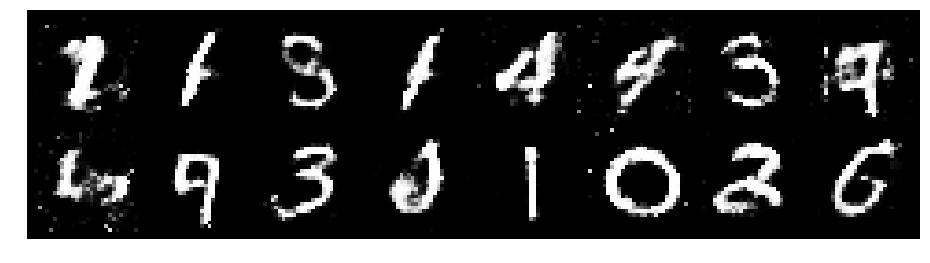

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.1649, Generator Loss: 0.9427
D(x): 0.5717, D(G(z)): 0.4190


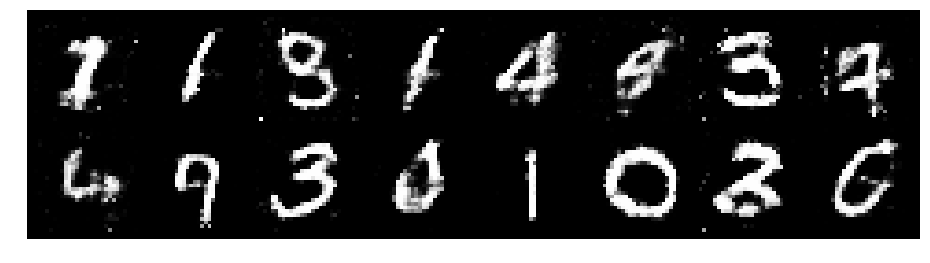

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.3262, Generator Loss: 0.9309
D(x): 0.4821, D(G(z)): 0.3891


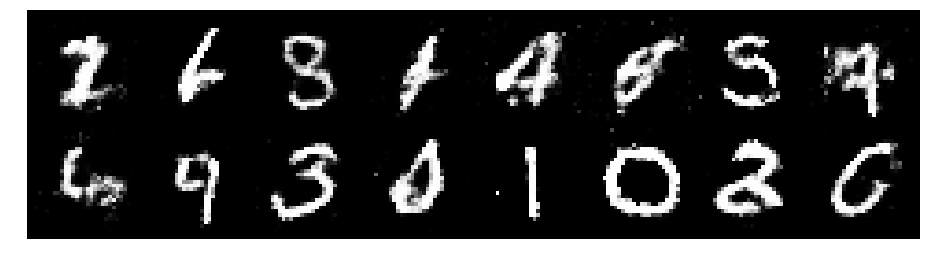

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.1498, Generator Loss: 1.0596
D(x): 0.5466, D(G(z)): 0.3644


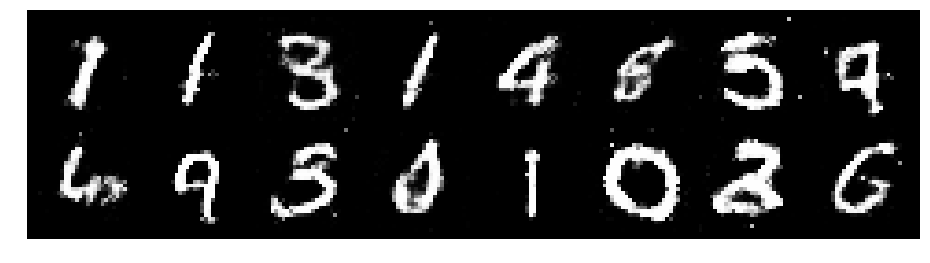

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.1707, Generator Loss: 1.1056
D(x): 0.5704, D(G(z)): 0.3609


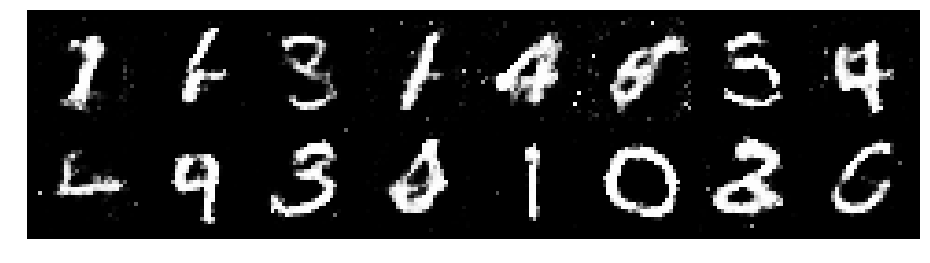

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.1562, Generator Loss: 1.0570
D(x): 0.5973, D(G(z)): 0.4035


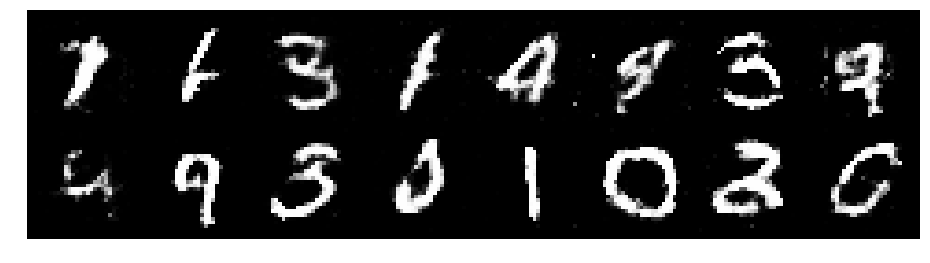

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.3518, Generator Loss: 0.8063
D(x): 0.5791, D(G(z)): 0.5021


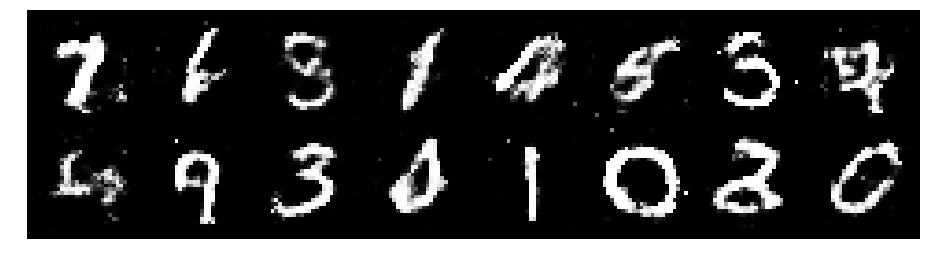

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.2564, Generator Loss: 0.8270
D(x): 0.5581, D(G(z)): 0.4448


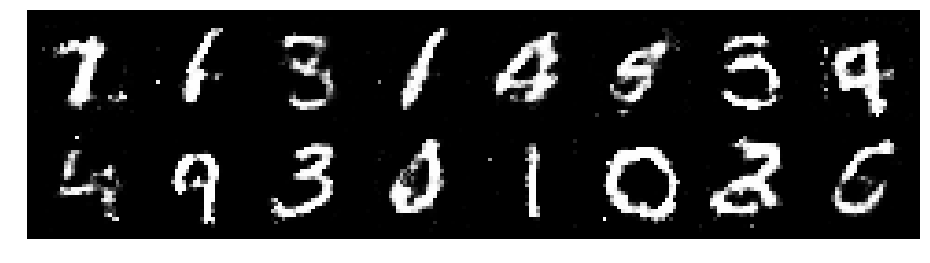

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.2256, Generator Loss: 0.8638
D(x): 0.5559, D(G(z)): 0.4291


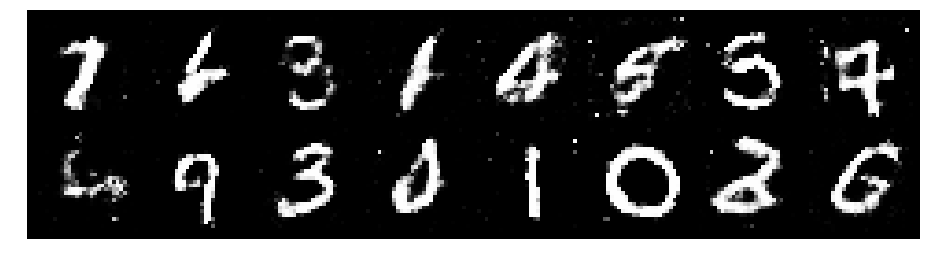

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.3241, Generator Loss: 0.8762
D(x): 0.5252, D(G(z)): 0.4508


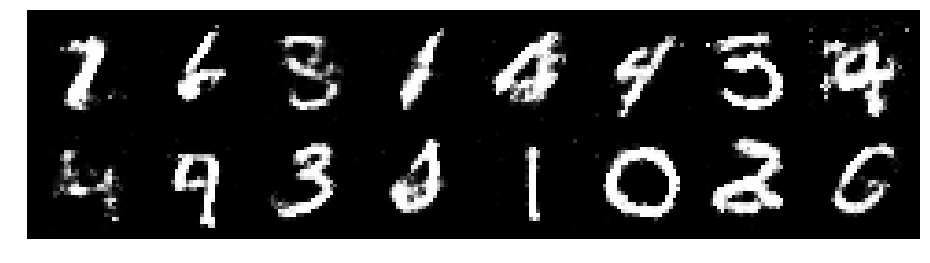

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.3005, Generator Loss: 0.7895
D(x): 0.5265, D(G(z)): 0.4524


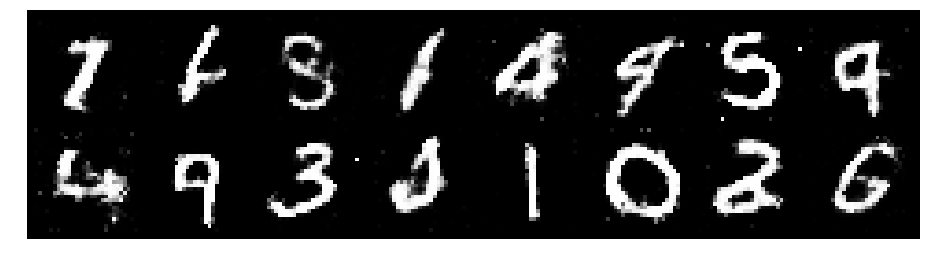

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.3225, Generator Loss: 0.8055
D(x): 0.5265, D(G(z)): 0.4538


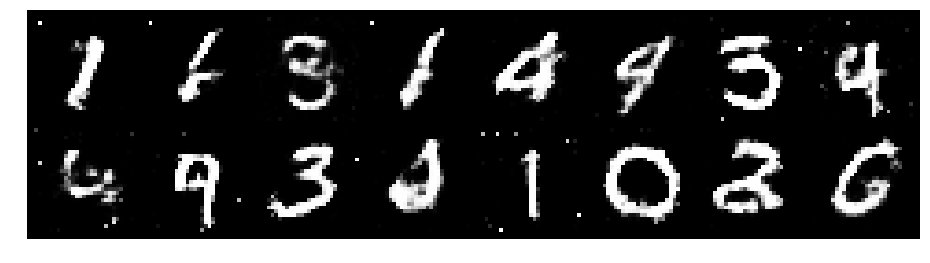

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.3421, Generator Loss: 0.7989
D(x): 0.5385, D(G(z)): 0.4732


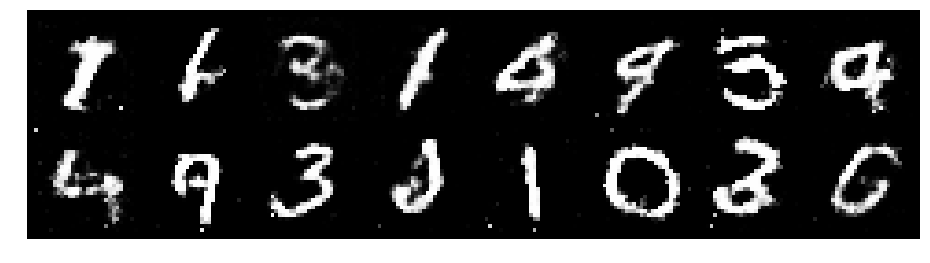

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.3223, Generator Loss: 0.7899
D(x): 0.5947, D(G(z)): 0.5042


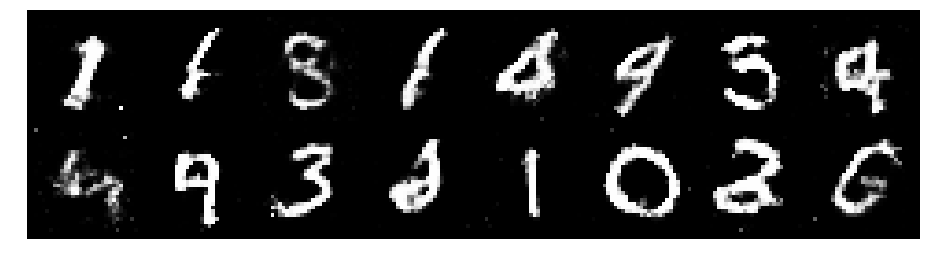

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.3258, Generator Loss: 0.9275
D(x): 0.5241, D(G(z)): 0.4415


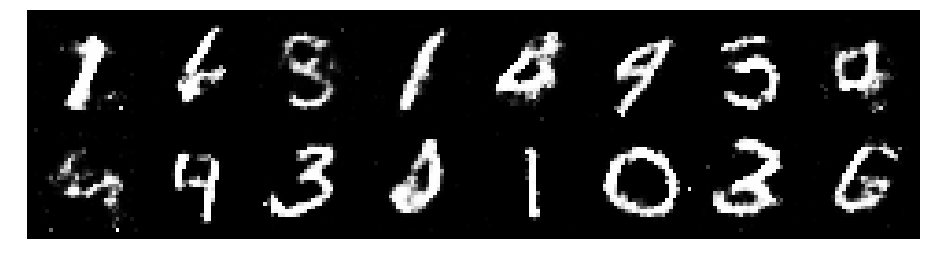

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.2458, Generator Loss: 1.0370
D(x): 0.5881, D(G(z)): 0.4529


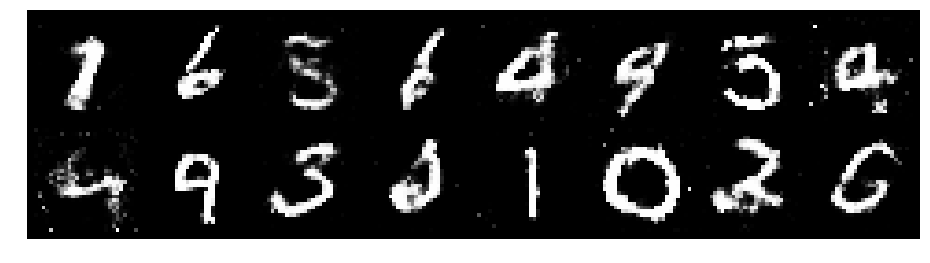

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.2314, Generator Loss: 0.8235
D(x): 0.5525, D(G(z)): 0.4401


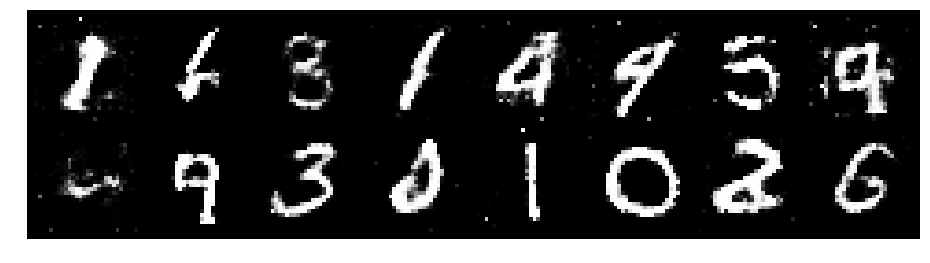

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.2321, Generator Loss: 0.8585
D(x): 0.5658, D(G(z)): 0.4503


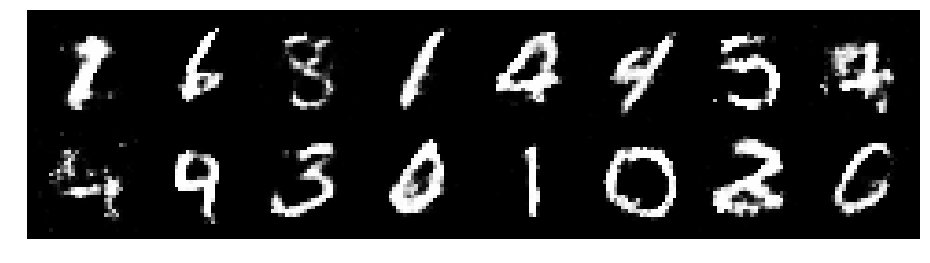

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.3305, Generator Loss: 0.8234
D(x): 0.5423, D(G(z)): 0.4668


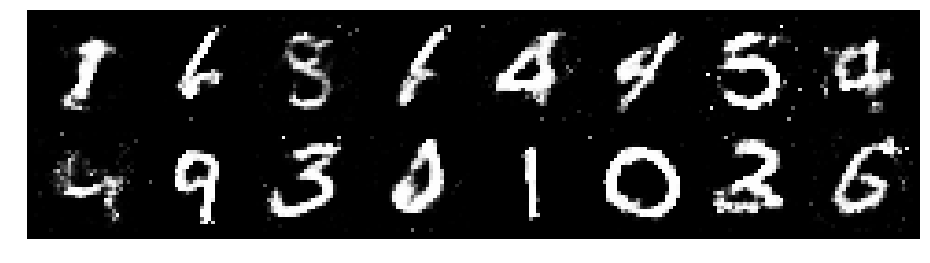

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.1690, Generator Loss: 1.0802
D(x): 0.5613, D(G(z)): 0.3864


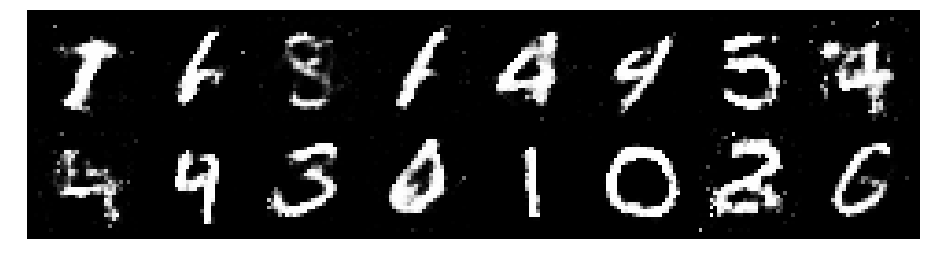

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.1487, Generator Loss: 1.0725
D(x): 0.5696, D(G(z)): 0.3859


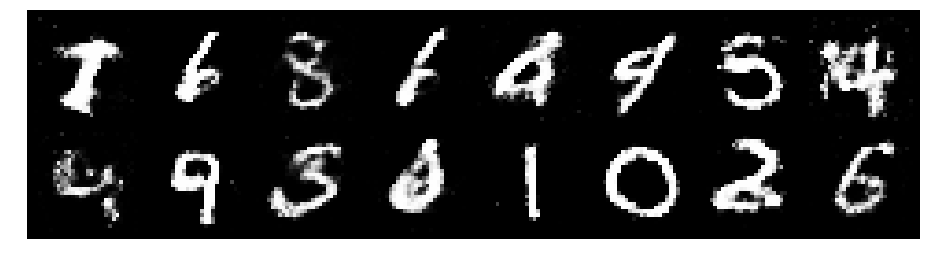

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.1189, Generator Loss: 0.9773
D(x): 0.5737, D(G(z)): 0.3860


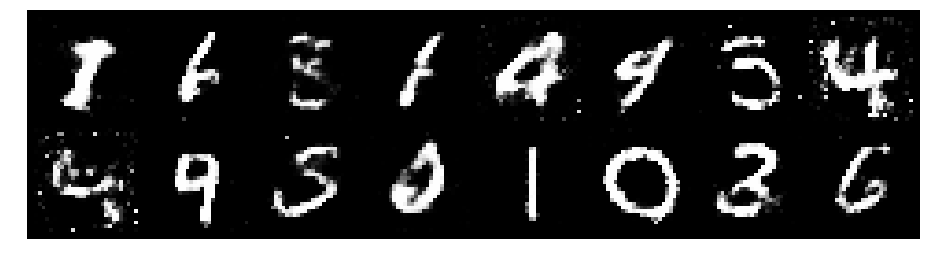

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.2048, Generator Loss: 0.9178
D(x): 0.5914, D(G(z)): 0.4468


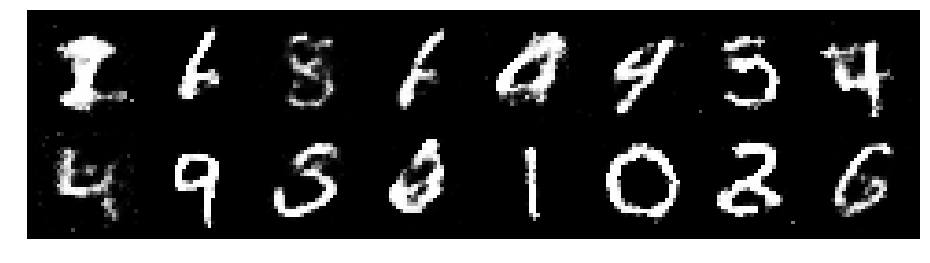

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.2423, Generator Loss: 0.8247
D(x): 0.5638, D(G(z)): 0.4279


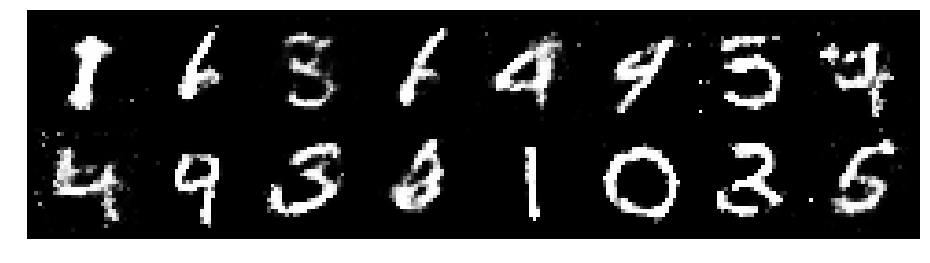

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.2452, Generator Loss: 0.8368
D(x): 0.5678, D(G(z)): 0.4452


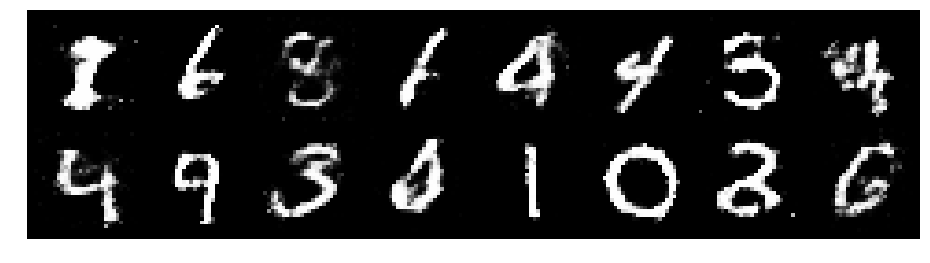

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.2653, Generator Loss: 0.8392
D(x): 0.5511, D(G(z)): 0.4368


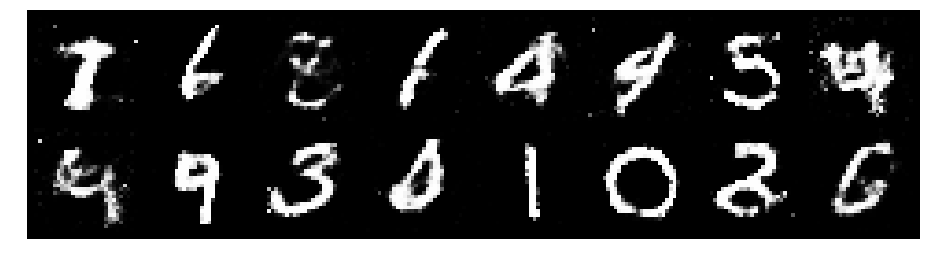

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.3833, Generator Loss: 0.8439
D(x): 0.6023, D(G(z)): 0.5160


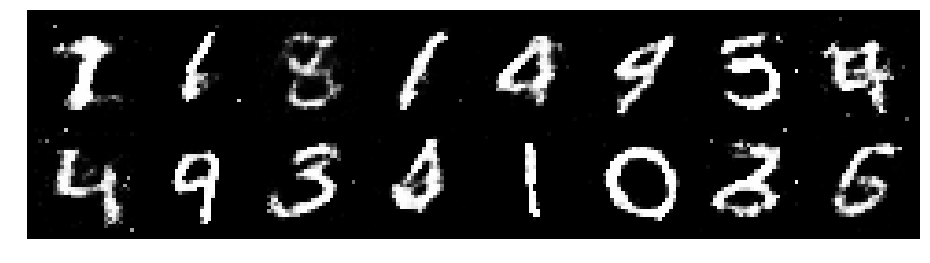

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.2500, Generator Loss: 1.0505
D(x): 0.5781, D(G(z)): 0.4308


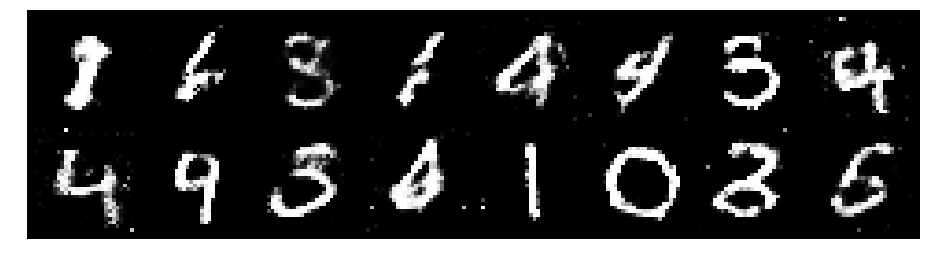

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.1322, Generator Loss: 1.0676
D(x): 0.5751, D(G(z)): 0.3883


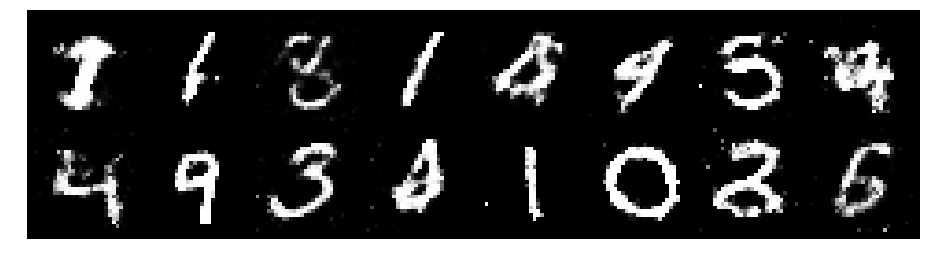

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.2776, Generator Loss: 0.8402
D(x): 0.5547, D(G(z)): 0.4610


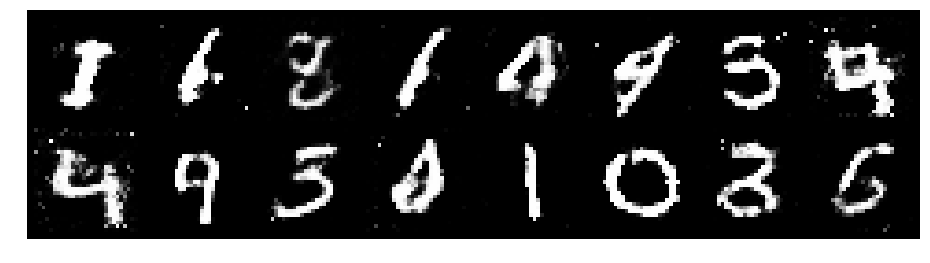

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.2618, Generator Loss: 0.9370
D(x): 0.5647, D(G(z)): 0.4478


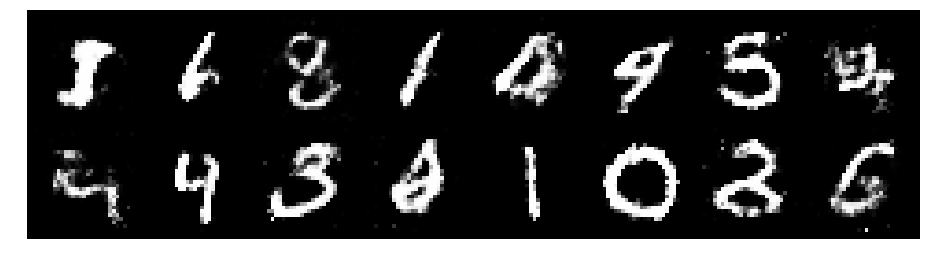

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.1970, Generator Loss: 0.9144
D(x): 0.6066, D(G(z)): 0.4607


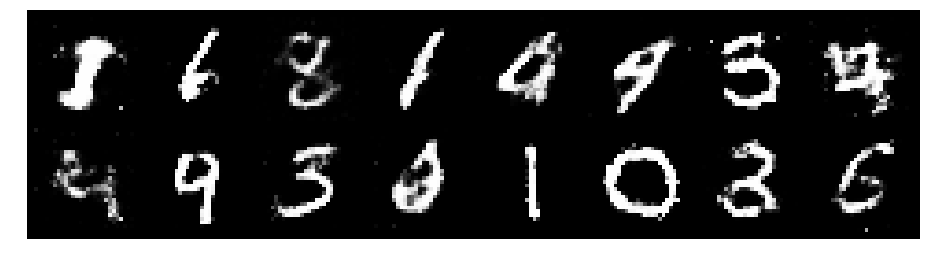

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.3290, Generator Loss: 0.9161
D(x): 0.5837, D(G(z)): 0.4747


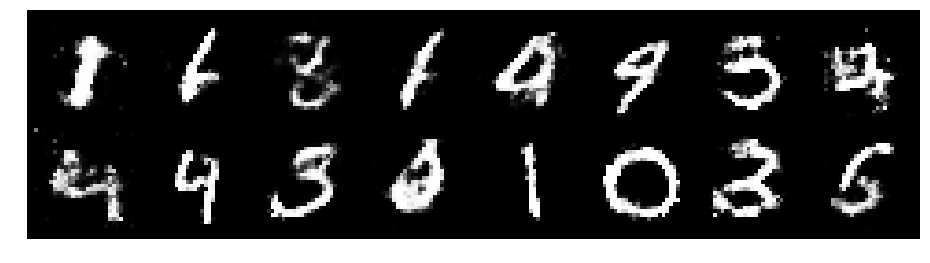

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.3369, Generator Loss: 0.8551
D(x): 0.5180, D(G(z)): 0.4617


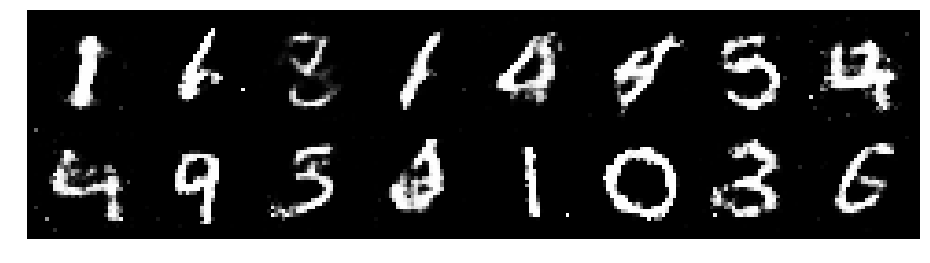

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.3169, Generator Loss: 0.8377
D(x): 0.5434, D(G(z)): 0.4687


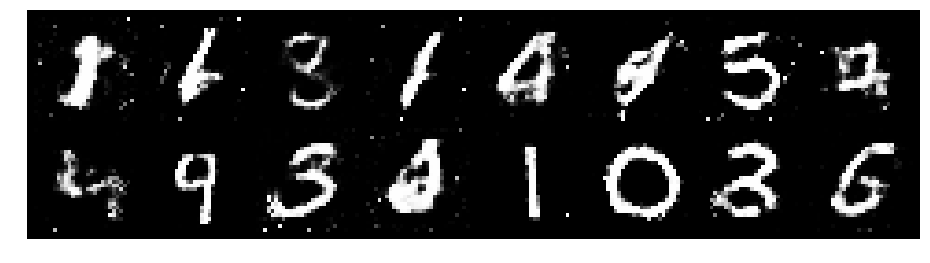

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.2317, Generator Loss: 1.0141
D(x): 0.5854, D(G(z)): 0.4404


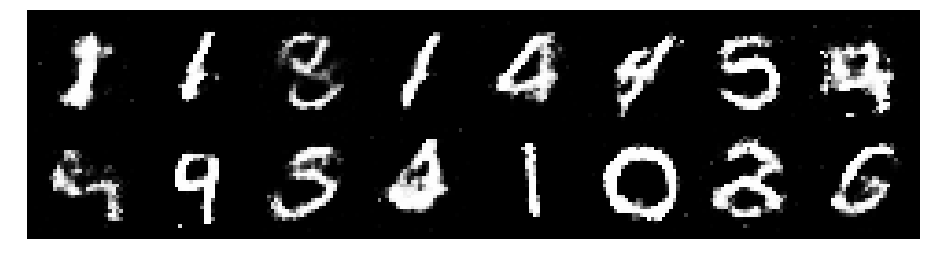

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.2160, Generator Loss: 0.9937
D(x): 0.5409, D(G(z)): 0.3946


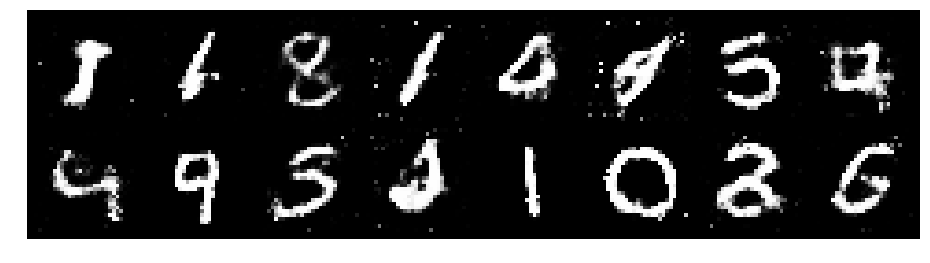

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.2299, Generator Loss: 1.0493
D(x): 0.5637, D(G(z)): 0.4104


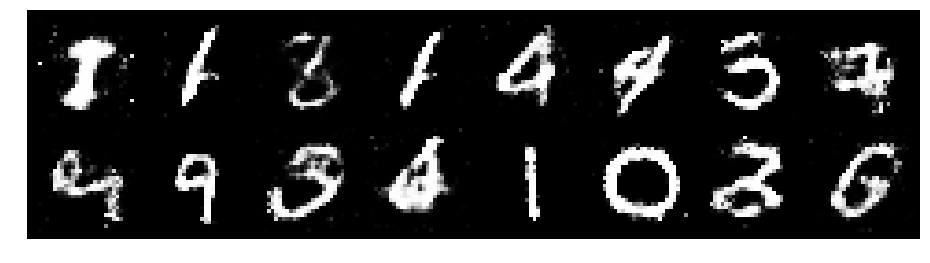

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.3155, Generator Loss: 1.0492
D(x): 0.5076, D(G(z)): 0.4057


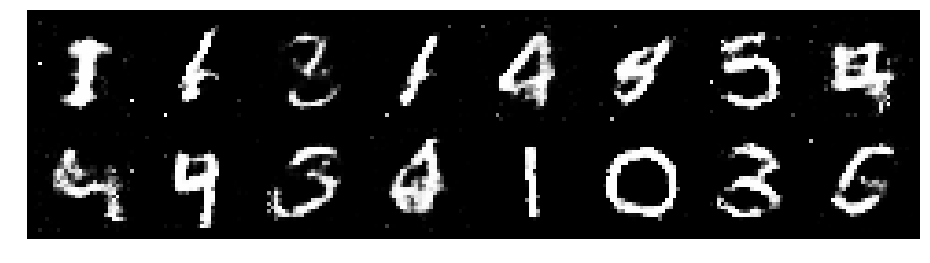

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.2870, Generator Loss: 1.0139
D(x): 0.5296, D(G(z)): 0.4232


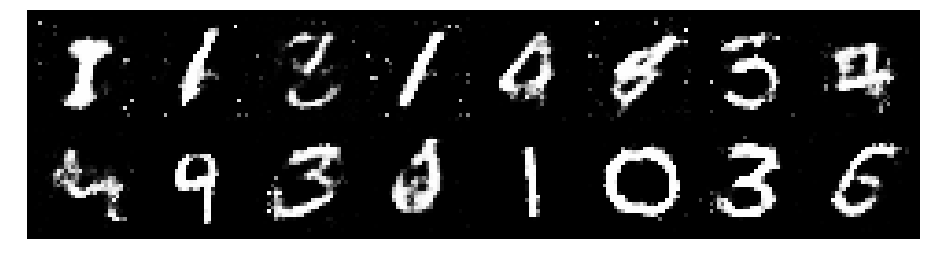

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.3832, Generator Loss: 0.8398
D(x): 0.5324, D(G(z)): 0.4741


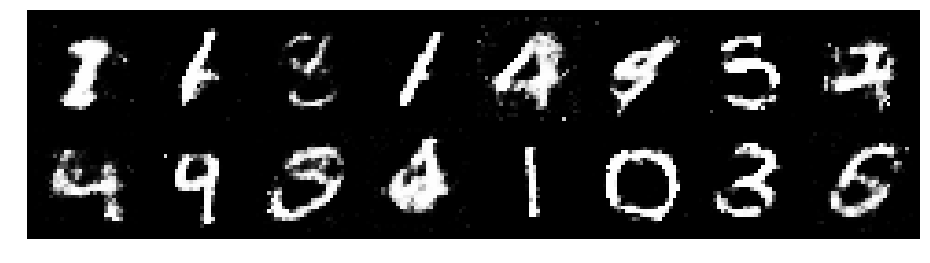

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.3288, Generator Loss: 0.8145
D(x): 0.5333, D(G(z)): 0.4693


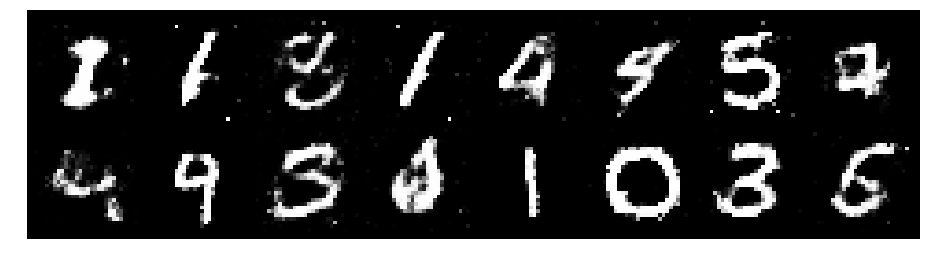

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.4310, Generator Loss: 0.8470
D(x): 0.5073, D(G(z)): 0.4564


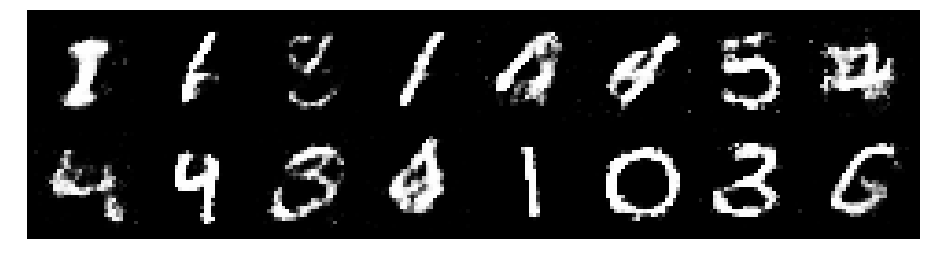

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.3348, Generator Loss: 0.9328
D(x): 0.5723, D(G(z)): 0.4828


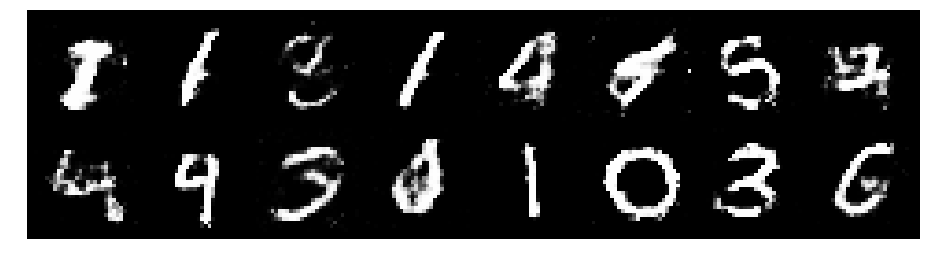

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.2999, Generator Loss: 0.7782
D(x): 0.5675, D(G(z)): 0.4768


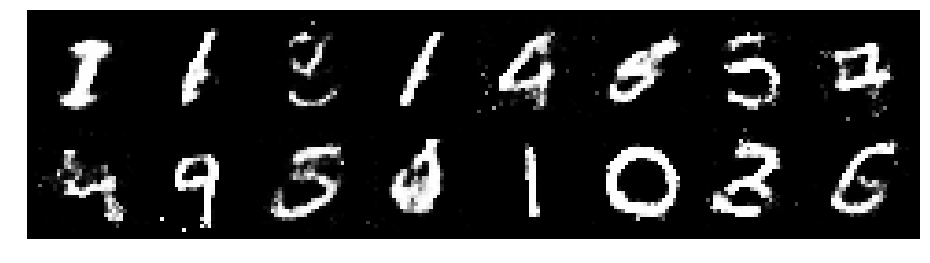

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.2447, Generator Loss: 0.9360
D(x): 0.5696, D(G(z)): 0.4399


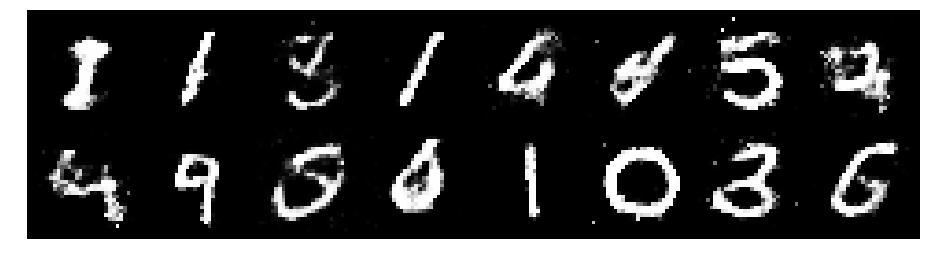

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.2884, Generator Loss: 0.9081
D(x): 0.5372, D(G(z)): 0.4406


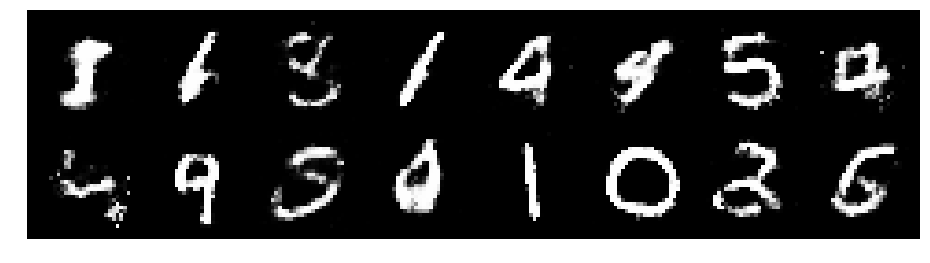

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.1857, Generator Loss: 0.9732
D(x): 0.5529, D(G(z)): 0.4065


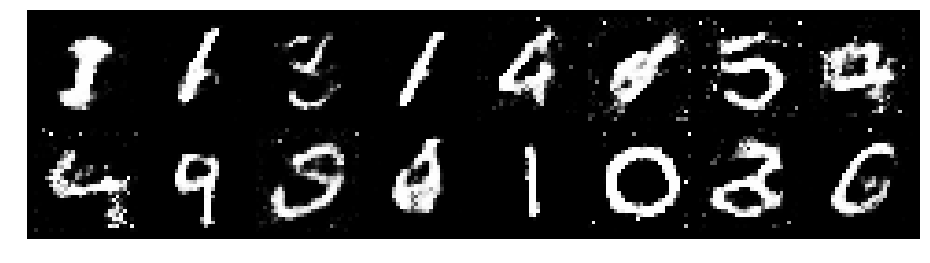

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.3113, Generator Loss: 0.8617
D(x): 0.5530, D(G(z)): 0.4714


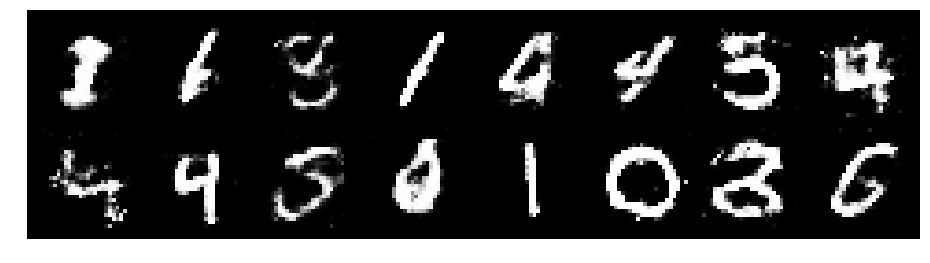

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.3244, Generator Loss: 0.8101
D(x): 0.4982, D(G(z)): 0.4344


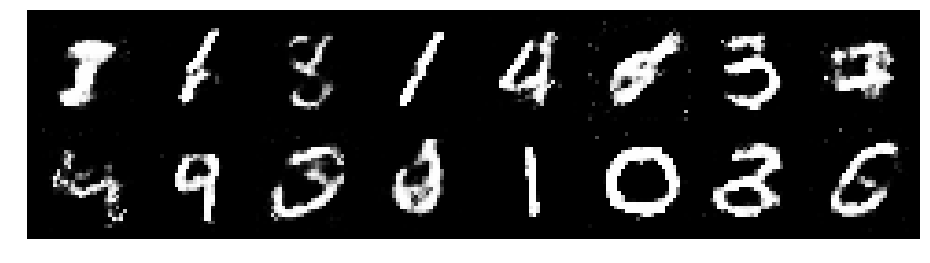

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.2314, Generator Loss: 0.8646
D(x): 0.5734, D(G(z)): 0.4438


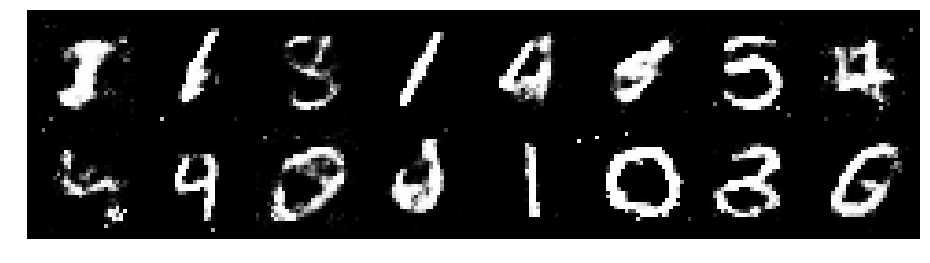

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.3571, Generator Loss: 0.8652
D(x): 0.5372, D(G(z)): 0.4591


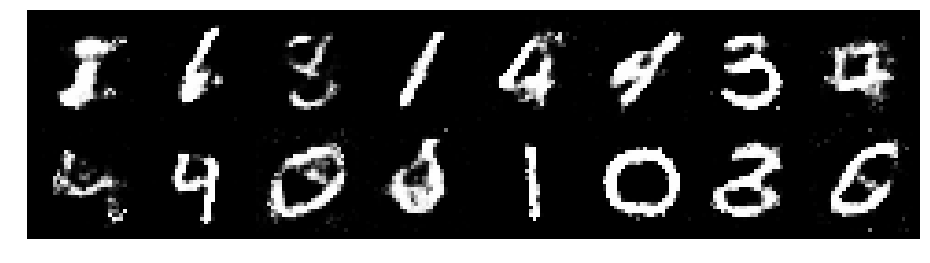

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.3047, Generator Loss: 0.8562
D(x): 0.5383, D(G(z)): 0.4486


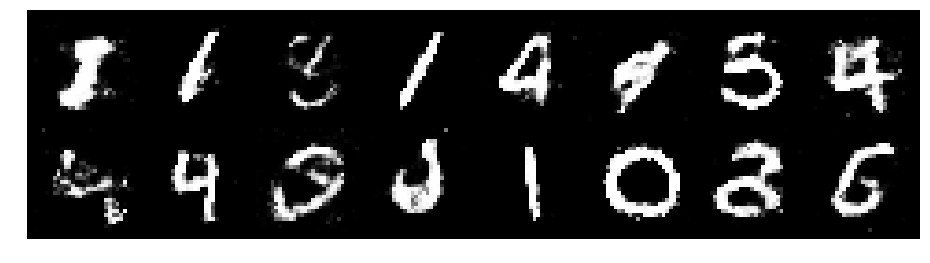

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.2723, Generator Loss: 0.9280
D(x): 0.5395, D(G(z)): 0.4367


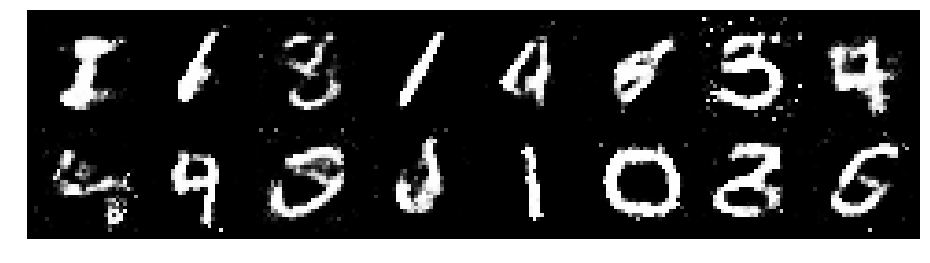

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.2682, Generator Loss: 0.7670
D(x): 0.5569, D(G(z)): 0.4607


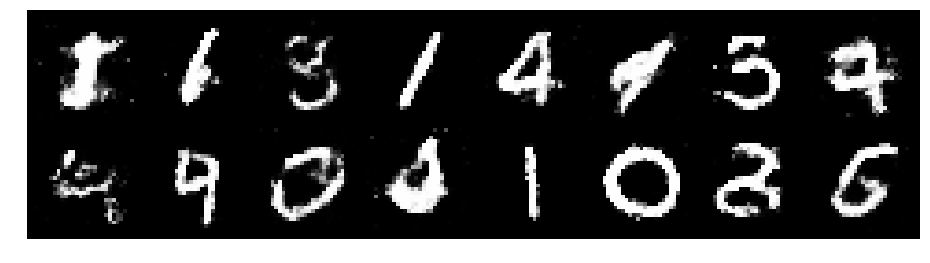

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.2129, Generator Loss: 1.0165
D(x): 0.5837, D(G(z)): 0.4439


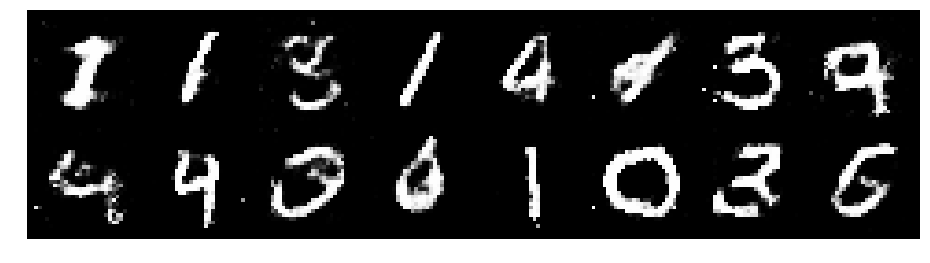

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.2671, Generator Loss: 0.9276
D(x): 0.5750, D(G(z)): 0.4657


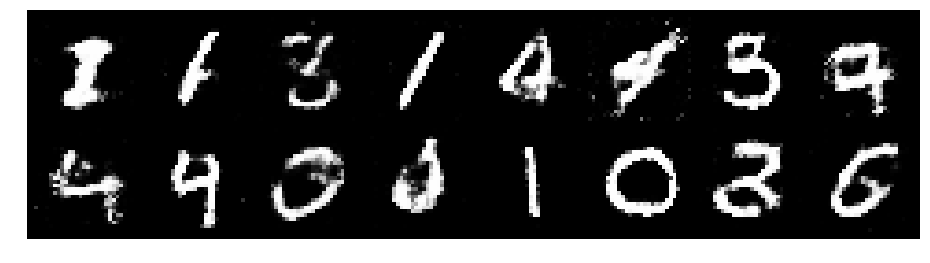

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.2878, Generator Loss: 0.9747
D(x): 0.6076, D(G(z)): 0.4674


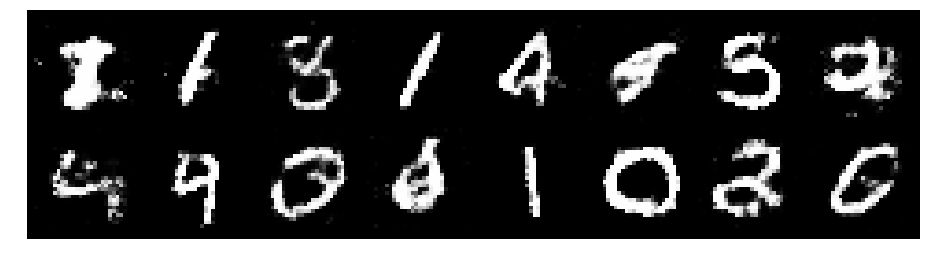

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.2847, Generator Loss: 1.0147
D(x): 0.5345, D(G(z)): 0.4140


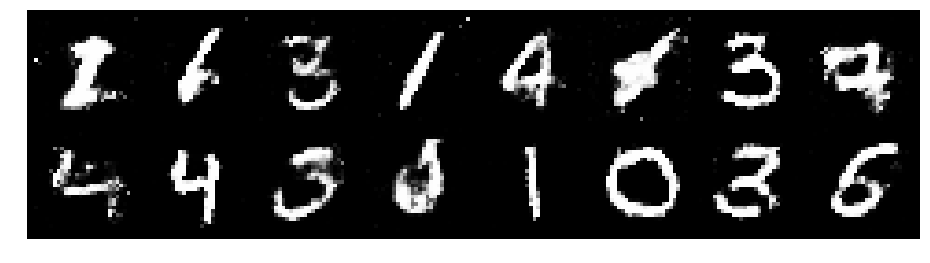

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.2537, Generator Loss: 0.8568
D(x): 0.5436, D(G(z)): 0.4321


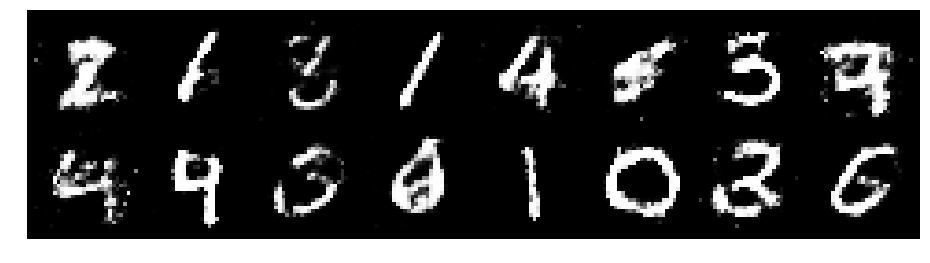

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.2509, Generator Loss: 0.8532
D(x): 0.5516, D(G(z)): 0.4488


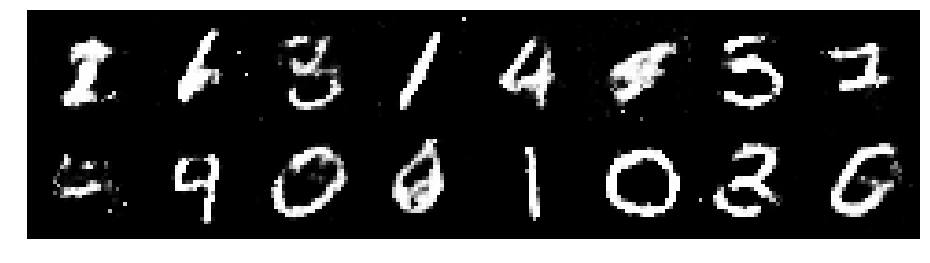

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.2218, Generator Loss: 0.8158
D(x): 0.5538, D(G(z)): 0.4306


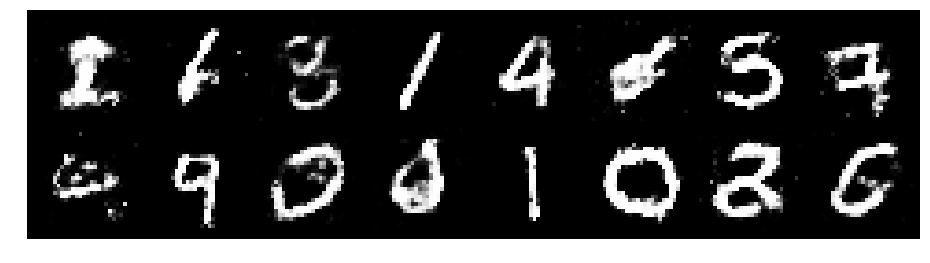

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.3277, Generator Loss: 0.8996
D(x): 0.5521, D(G(z)): 0.4696


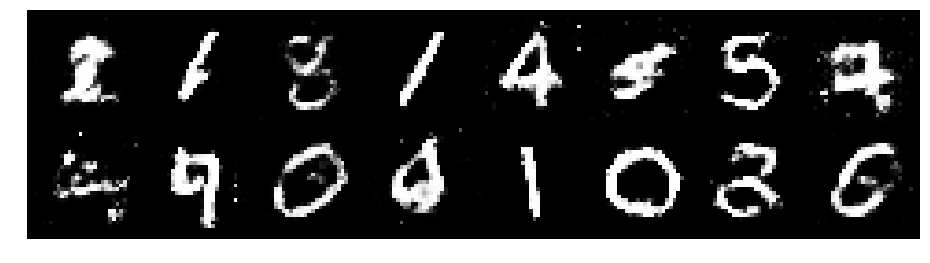

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.1752, Generator Loss: 0.9599
D(x): 0.5700, D(G(z)): 0.4098


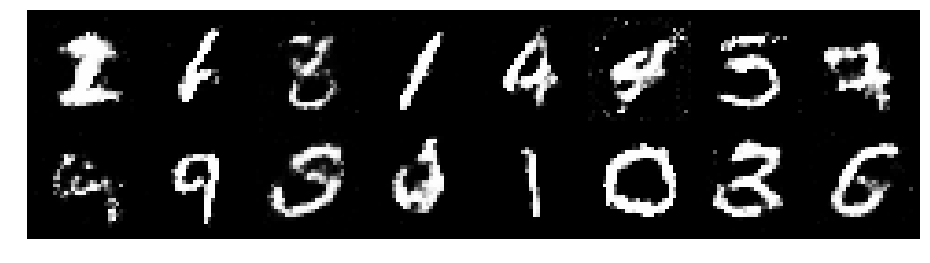

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.2557, Generator Loss: 0.8902
D(x): 0.5408, D(G(z)): 0.4368


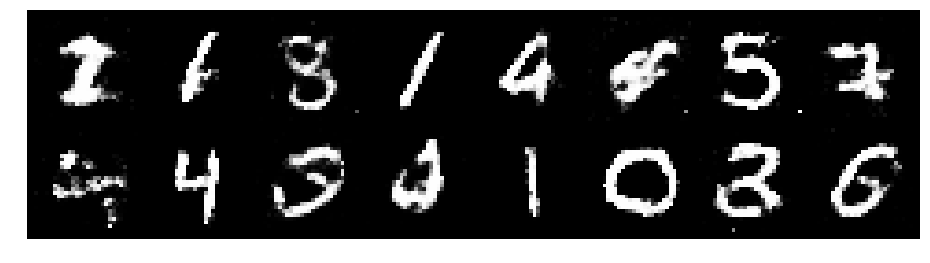

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.2543, Generator Loss: 0.9886
D(x): 0.5845, D(G(z)): 0.4560


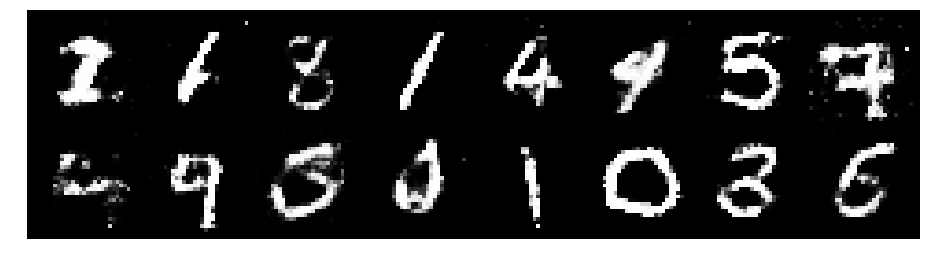

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.2488, Generator Loss: 0.9355
D(x): 0.5820, D(G(z)): 0.4374


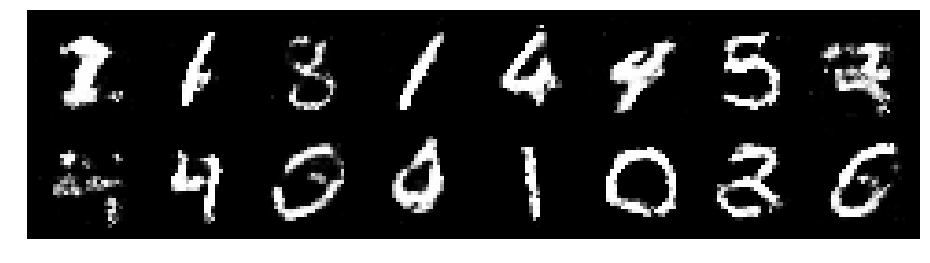

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.2585, Generator Loss: 0.7858
D(x): 0.5276, D(G(z)): 0.4162


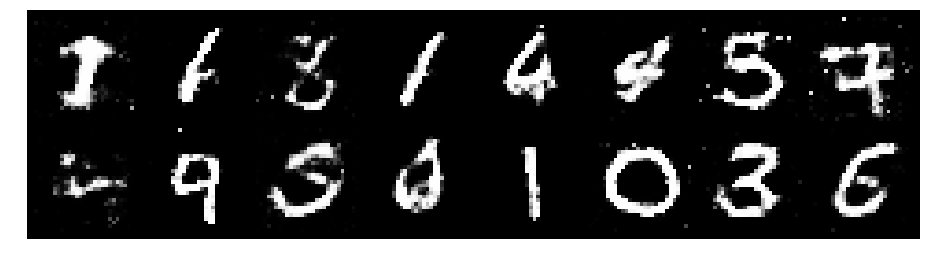

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.2912, Generator Loss: 0.8930
D(x): 0.5651, D(G(z)): 0.4612


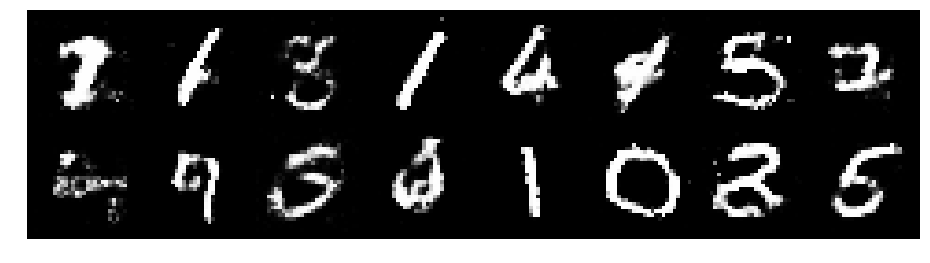

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.3708, Generator Loss: 0.8139
D(x): 0.5375, D(G(z)): 0.4877


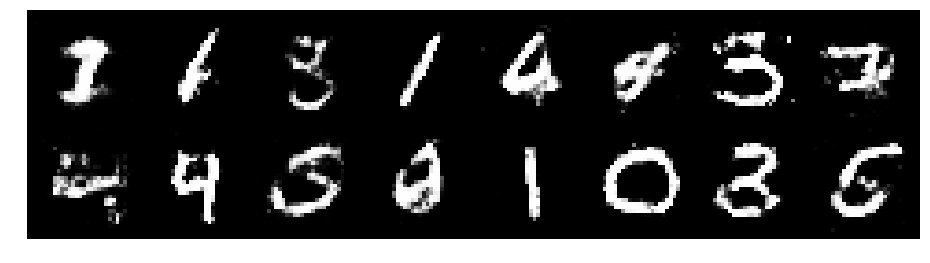

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.2904, Generator Loss: 0.8762
D(x): 0.5517, D(G(z)): 0.4191


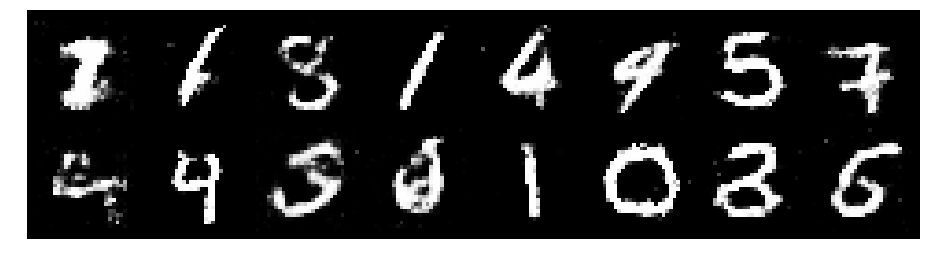

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.4802, Generator Loss: 0.8325
D(x): 0.5137, D(G(z)): 0.4867


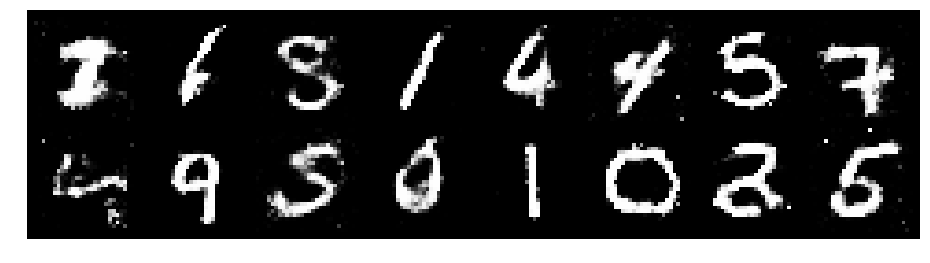

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.3921, Generator Loss: 0.9513
D(x): 0.5143, D(G(z)): 0.4423


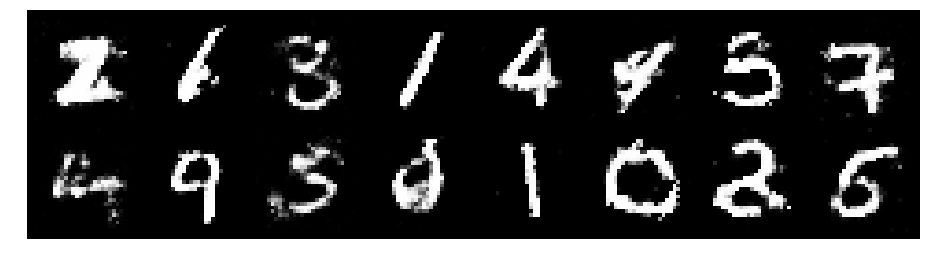

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.2320, Generator Loss: 0.9254
D(x): 0.5797, D(G(z)): 0.4326


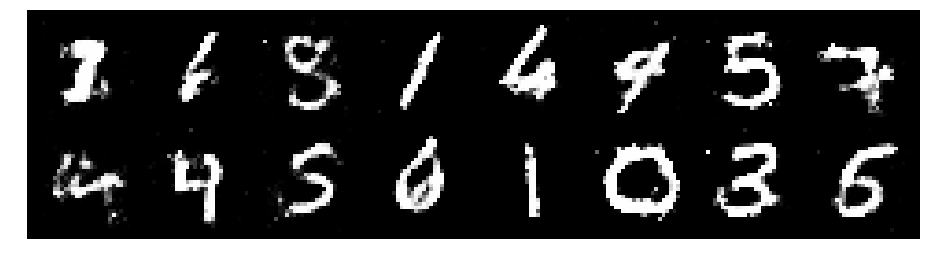

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.1290, Generator Loss: 1.0520
D(x): 0.5876, D(G(z)): 0.3900


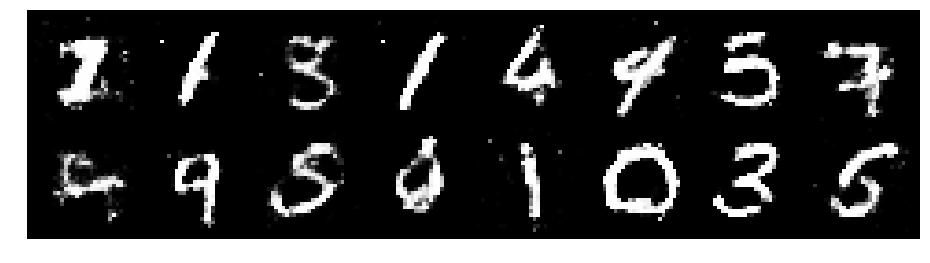

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.1488, Generator Loss: 1.0221
D(x): 0.5673, D(G(z)): 0.3973


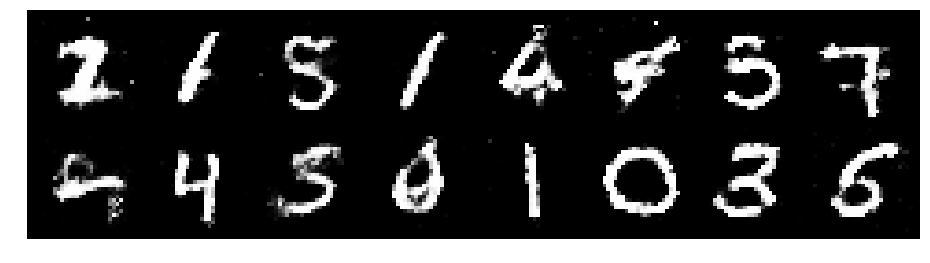

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.2407, Generator Loss: 0.8353
D(x): 0.5310, D(G(z)): 0.4147


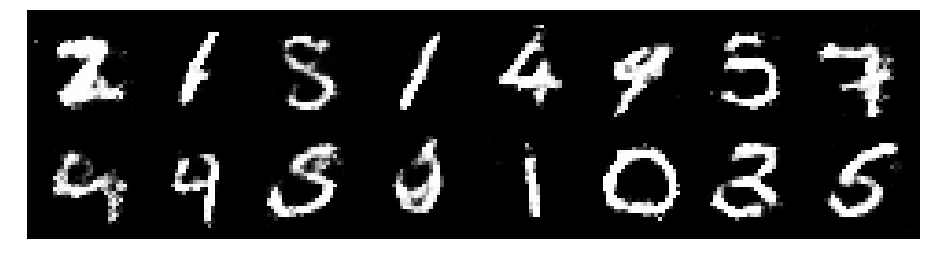

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.3157, Generator Loss: 0.9510
D(x): 0.5471, D(G(z)): 0.4636


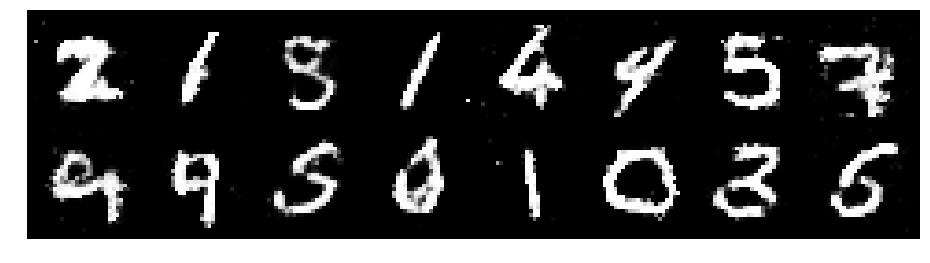

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.3063, Generator Loss: 0.8054
D(x): 0.5685, D(G(z)): 0.4738


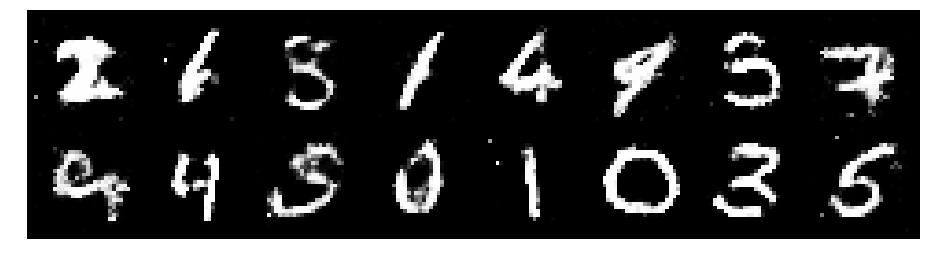

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.3002, Generator Loss: 0.8520
D(x): 0.5440, D(G(z)): 0.4348


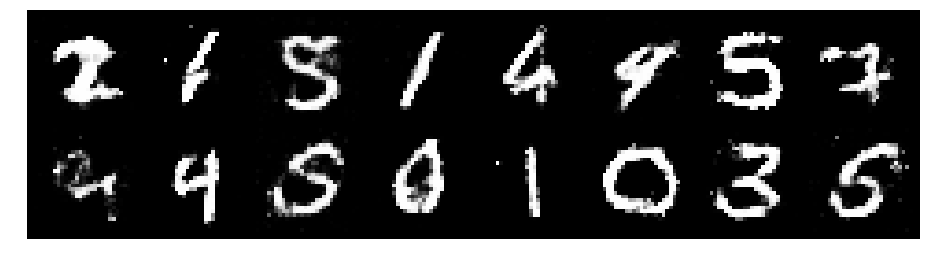

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.1464, Generator Loss: 1.1216
D(x): 0.6019, D(G(z)): 0.3970


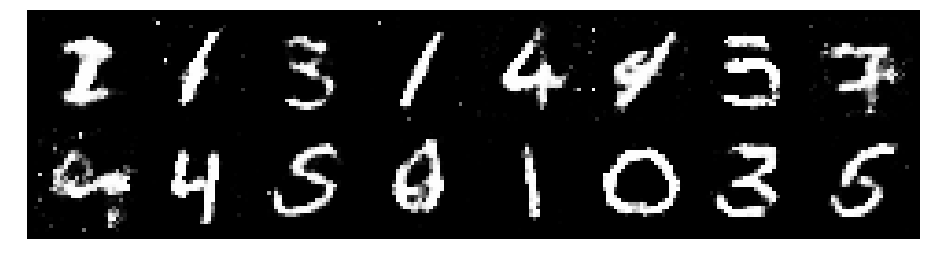

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.1967, Generator Loss: 1.0296
D(x): 0.5900, D(G(z)): 0.4273


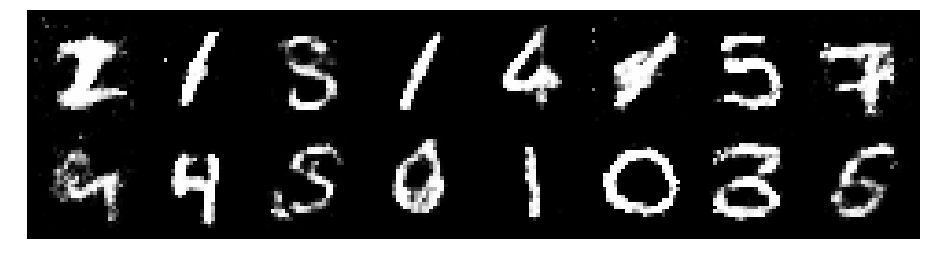

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.2385, Generator Loss: 0.9707
D(x): 0.5852, D(G(z)): 0.4418


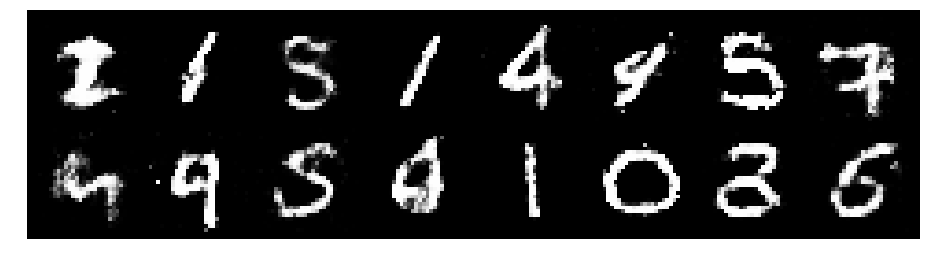

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.3055, Generator Loss: 0.8664
D(x): 0.5819, D(G(z)): 0.4924


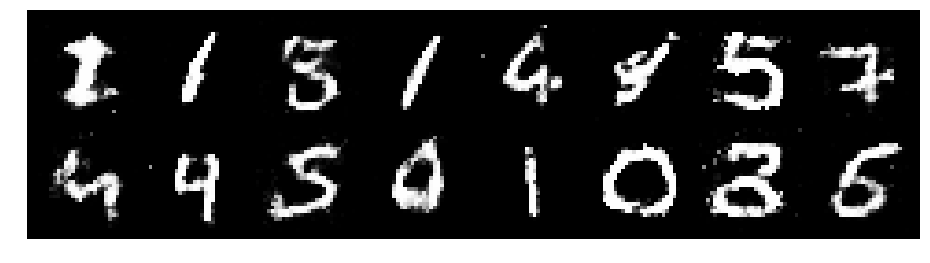

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.3739, Generator Loss: 0.8486
D(x): 0.5328, D(G(z)): 0.4803


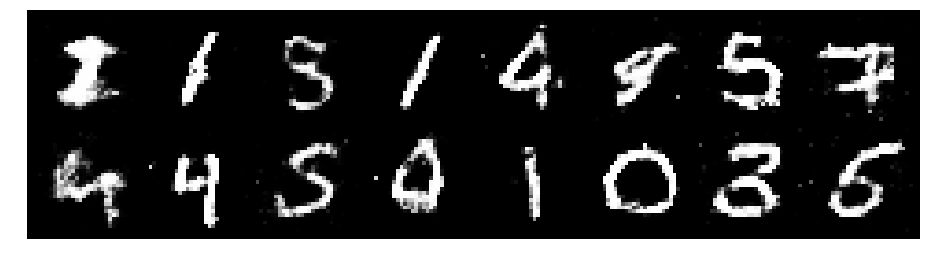

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.3246, Generator Loss: 0.8028
D(x): 0.5513, D(G(z)): 0.4782


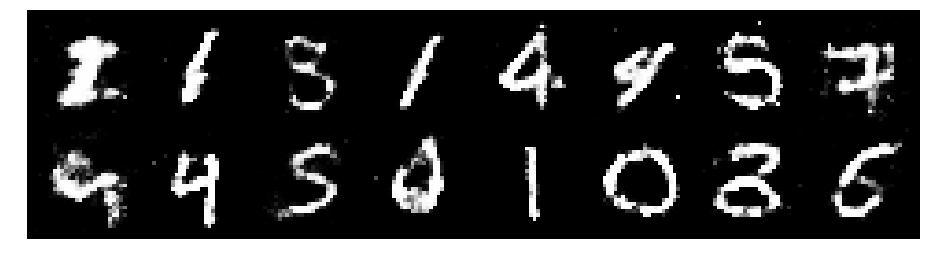

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.3051, Generator Loss: 0.9784
D(x): 0.4765, D(G(z)): 0.3907


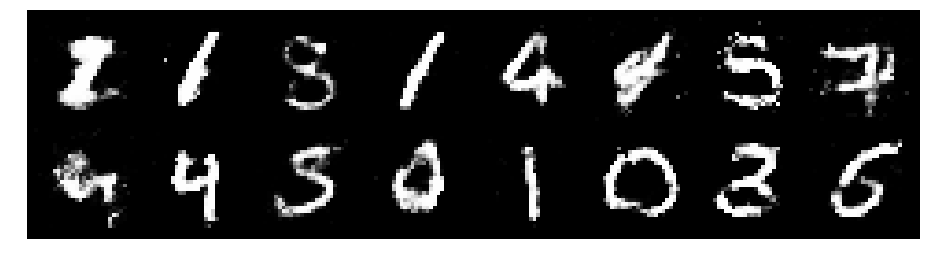

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.2813, Generator Loss: 0.8621
D(x): 0.5459, D(G(z)): 0.4428


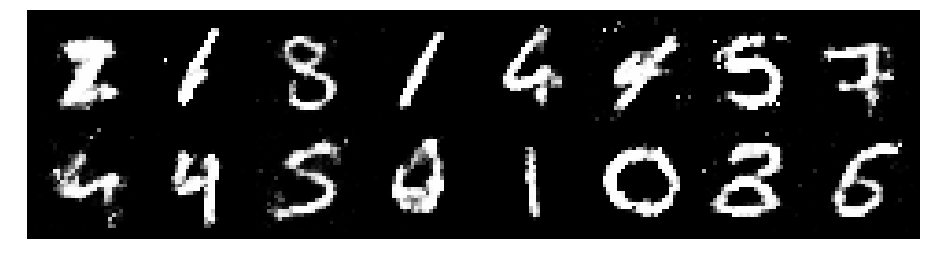

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.3510, Generator Loss: 0.9258
D(x): 0.5508, D(G(z)): 0.4707


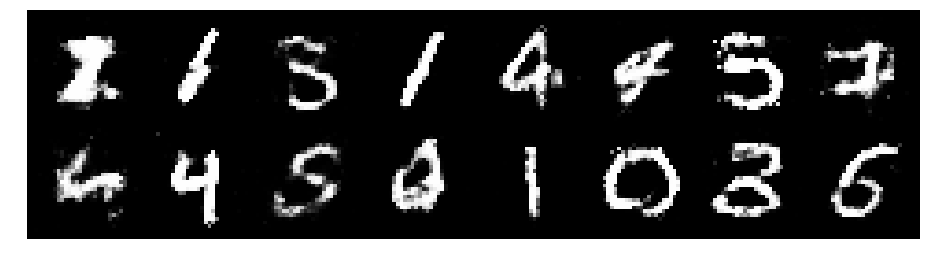

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.2582, Generator Loss: 0.8107
D(x): 0.5601, D(G(z)): 0.4558


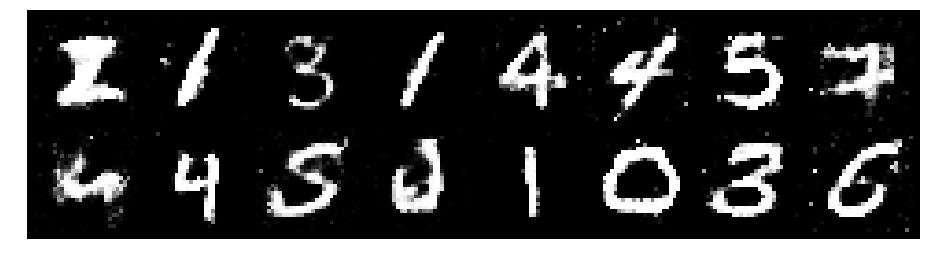

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.3350, Generator Loss: 0.9212
D(x): 0.5254, D(G(z)): 0.4491


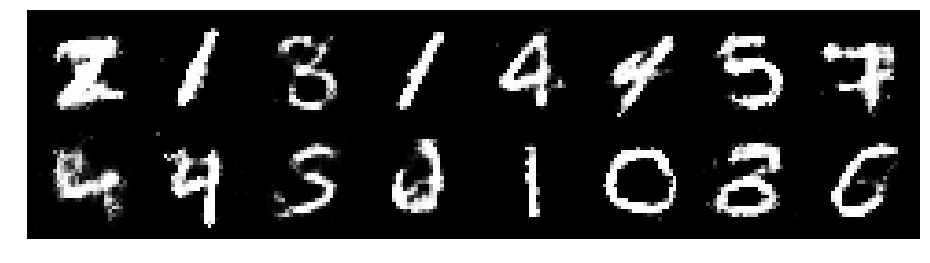

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.2014, Generator Loss: 0.8721
D(x): 0.6073, D(G(z)): 0.4630


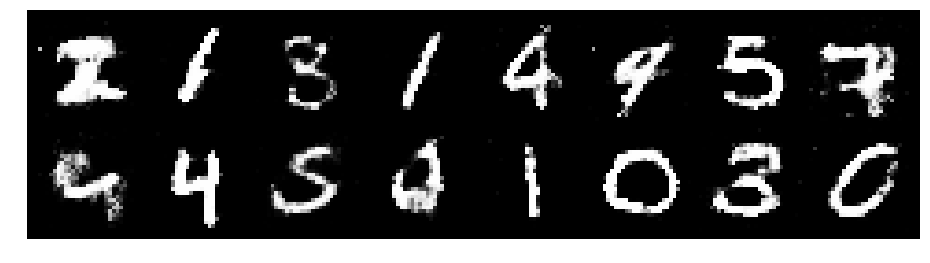

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.3645, Generator Loss: 0.9315
D(x): 0.5501, D(G(z)): 0.4765


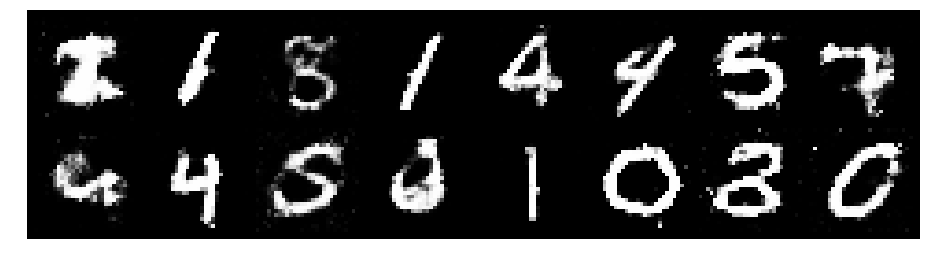

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.2317, Generator Loss: 0.9761
D(x): 0.5659, D(G(z)): 0.4488


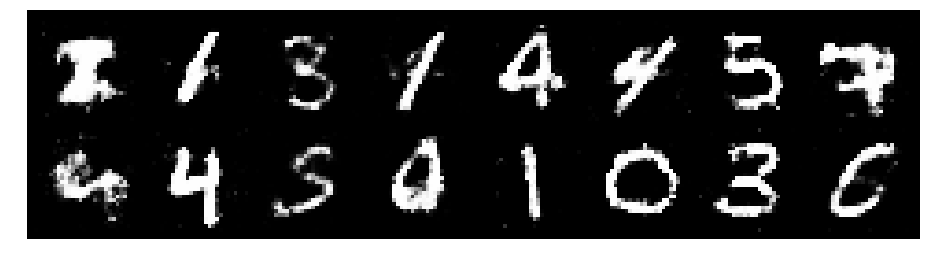

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.2481, Generator Loss: 0.9290
D(x): 0.6016, D(G(z)): 0.4578


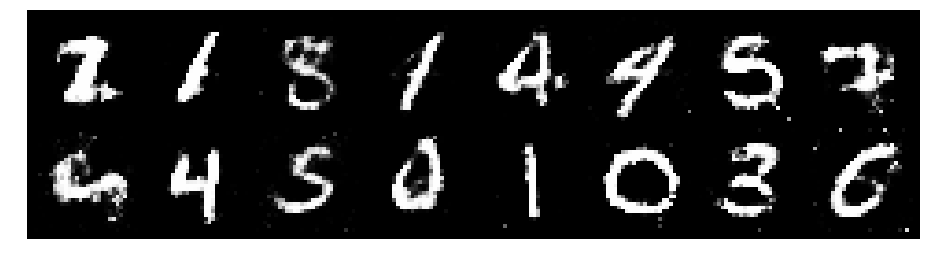

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.2865, Generator Loss: 0.8553
D(x): 0.5634, D(G(z)): 0.4543


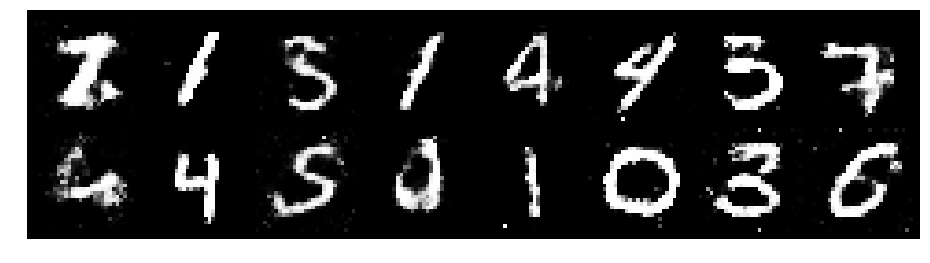

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.2446, Generator Loss: 0.8943
D(x): 0.5831, D(G(z)): 0.4521


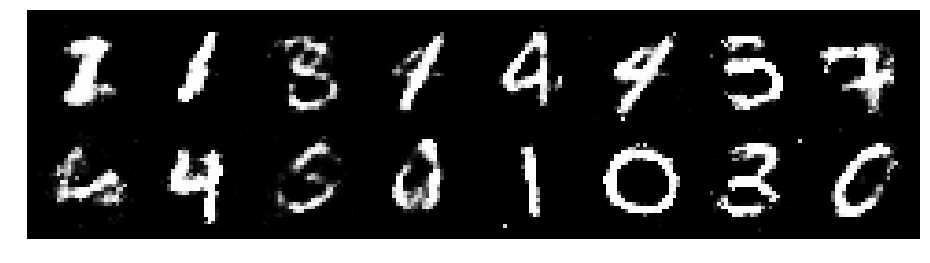

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.2172, Generator Loss: 0.9377
D(x): 0.6401, D(G(z)): 0.4814


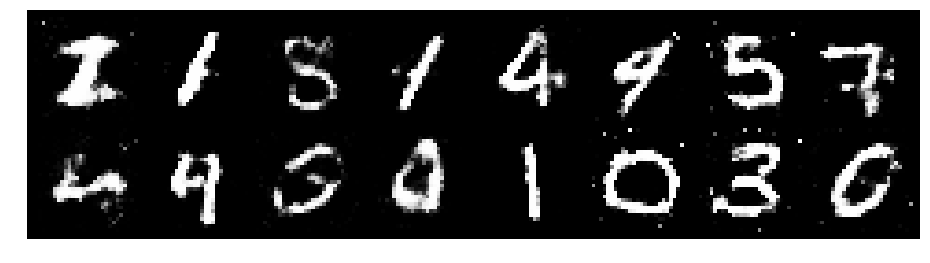

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.1265, Generator Loss: 0.9821
D(x): 0.5960, D(G(z)): 0.3985


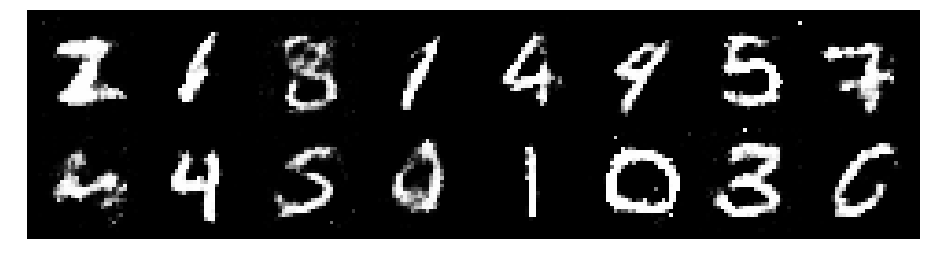

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.1062, Generator Loss: 1.0048
D(x): 0.6473, D(G(z)): 0.4255


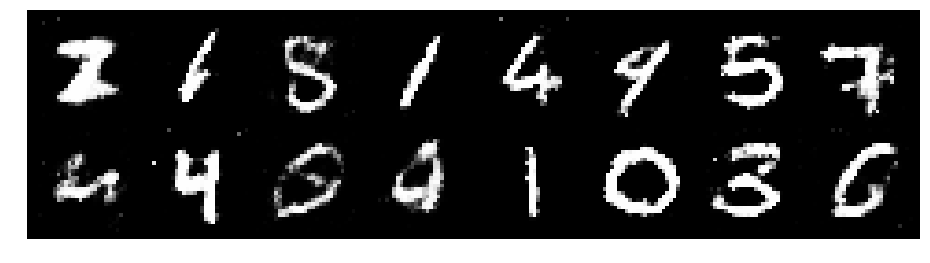

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.3076, Generator Loss: 0.9130
D(x): 0.5430, D(G(z)): 0.4454


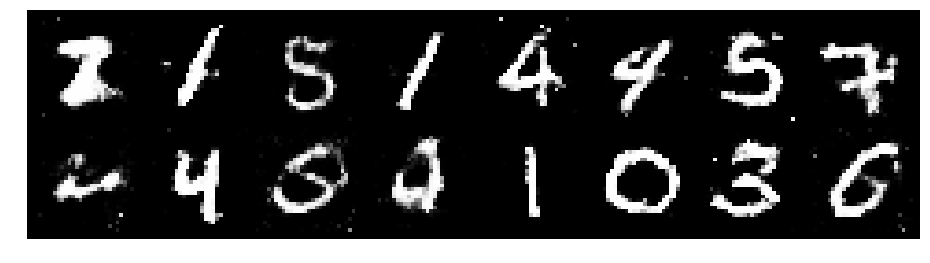

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.2502, Generator Loss: 0.8566
D(x): 0.5492, D(G(z)): 0.4310


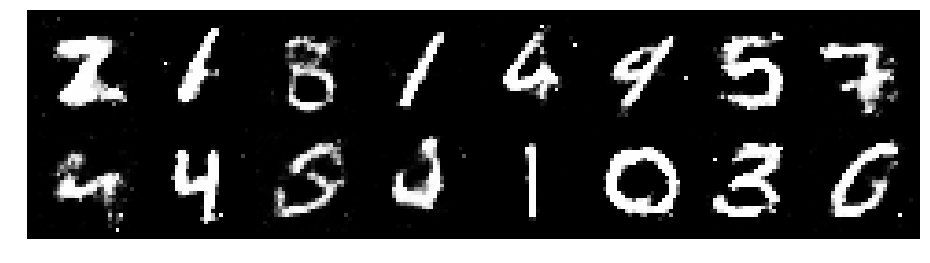

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.1798, Generator Loss: 0.8468
D(x): 0.5588, D(G(z)): 0.3976


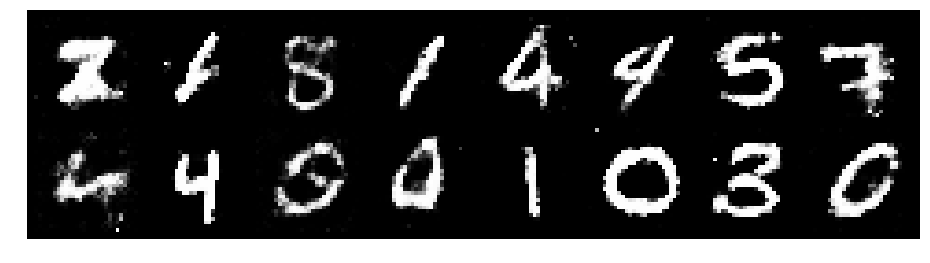

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.2541, Generator Loss: 0.8938
D(x): 0.5621, D(G(z)): 0.4564


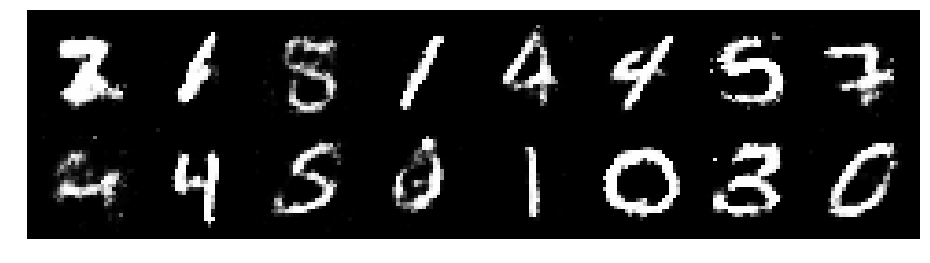

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.3154, Generator Loss: 0.8532
D(x): 0.5279, D(G(z)): 0.4605


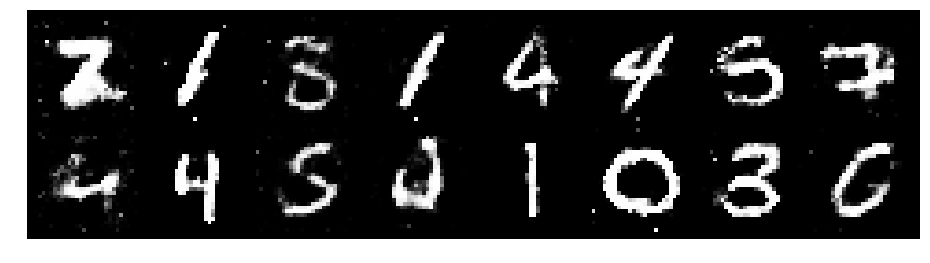

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.3940, Generator Loss: 0.7676
D(x): 0.5271, D(G(z)): 0.4860


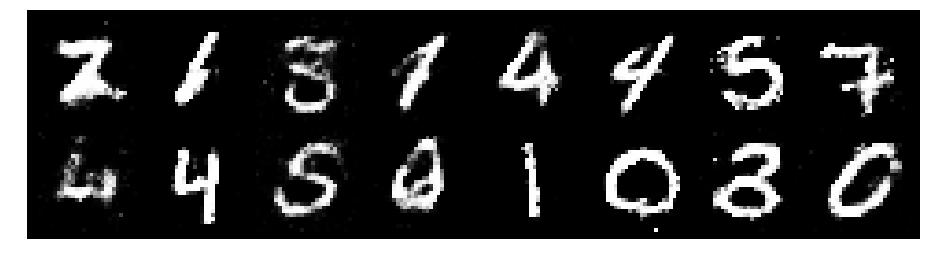

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.2426, Generator Loss: 0.8509
D(x): 0.5641, D(G(z)): 0.4302


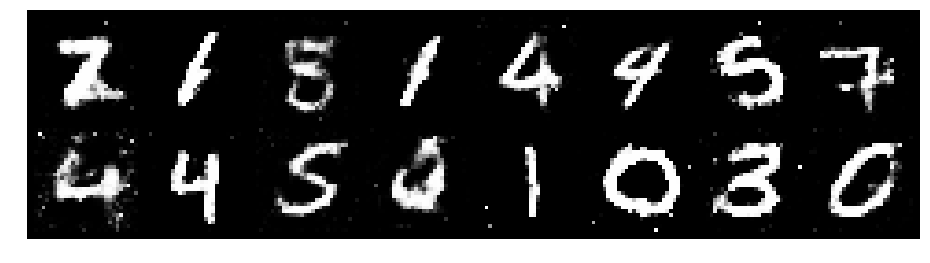

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.1539, Generator Loss: 1.0735
D(x): 0.5899, D(G(z)): 0.4091


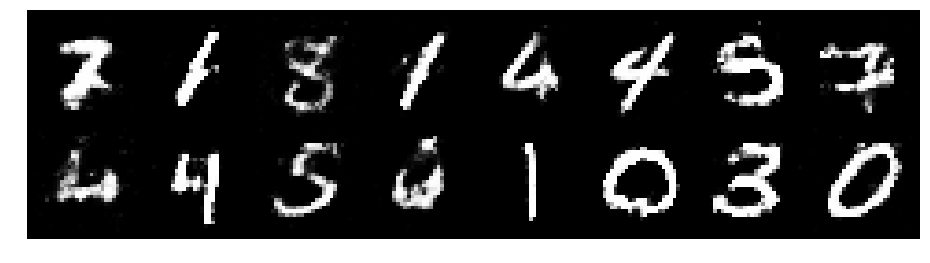

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.2081, Generator Loss: 1.0428
D(x): 0.5606, D(G(z)): 0.4050


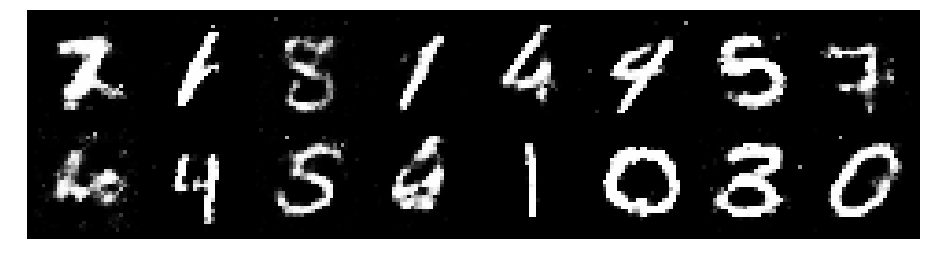

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.2228, Generator Loss: 0.9852
D(x): 0.5639, D(G(z)): 0.4305


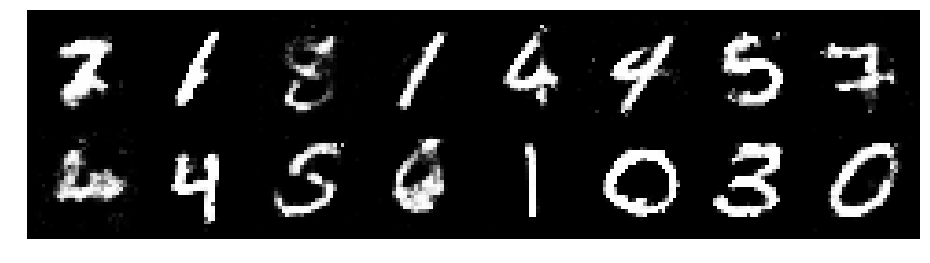

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.2797, Generator Loss: 0.9383
D(x): 0.5384, D(G(z)): 0.4289


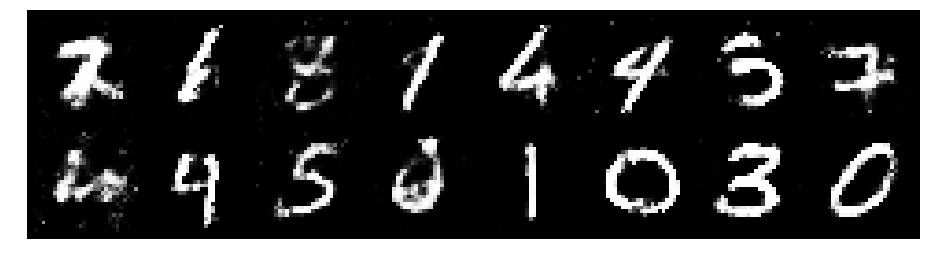

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.2788, Generator Loss: 0.8518
D(x): 0.5368, D(G(z)): 0.4453


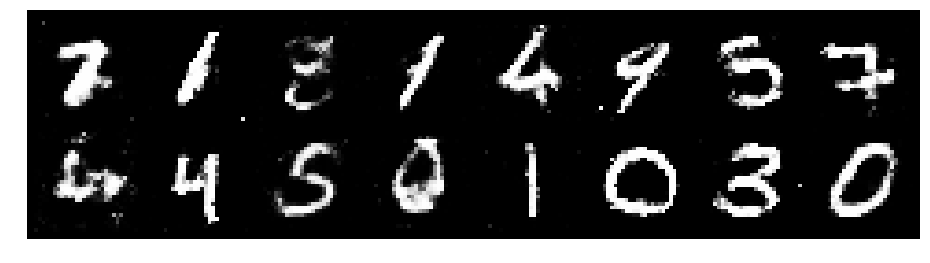

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.3492, Generator Loss: 0.8428
D(x): 0.5342, D(G(z)): 0.4699


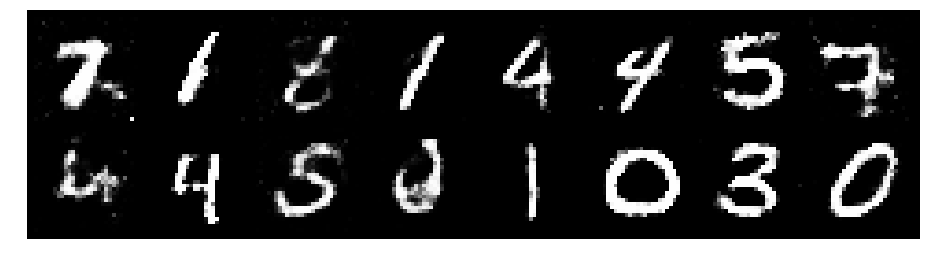

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.1776, Generator Loss: 0.8606
D(x): 0.5858, D(G(z)): 0.4304


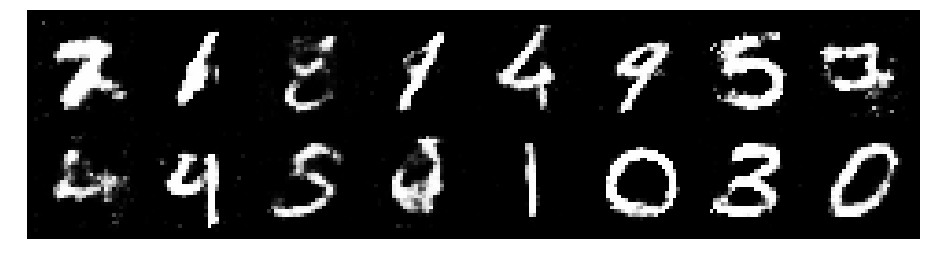

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.3588, Generator Loss: 0.8524
D(x): 0.5514, D(G(z)): 0.4738


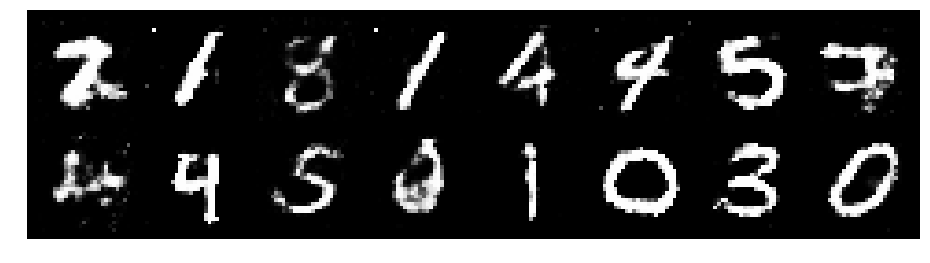

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.2656, Generator Loss: 0.9359
D(x): 0.5181, D(G(z)): 0.3955


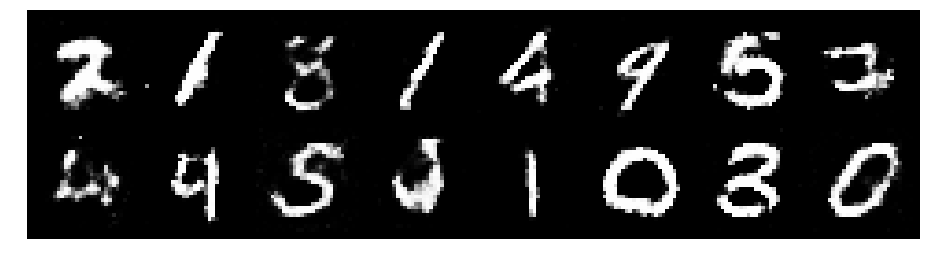

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.2922, Generator Loss: 0.9681
D(x): 0.5349, D(G(z)): 0.4429


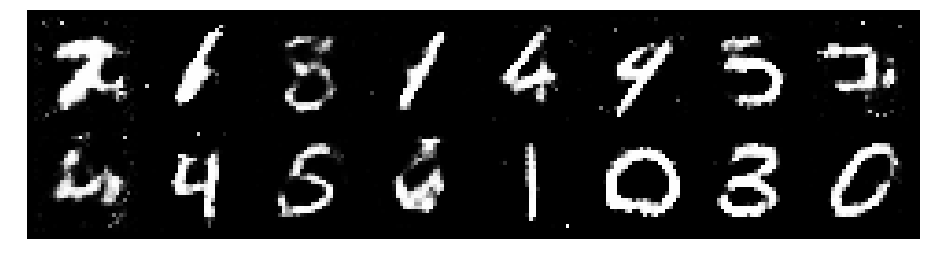

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.1624, Generator Loss: 0.9918
D(x): 0.5867, D(G(z)): 0.3988


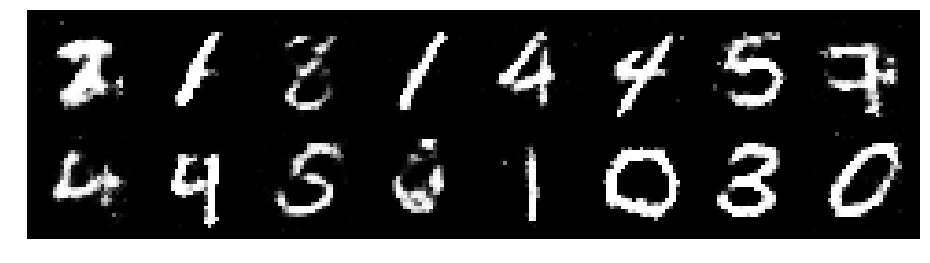

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.2223, Generator Loss: 1.1209
D(x): 0.5760, D(G(z)): 0.3971


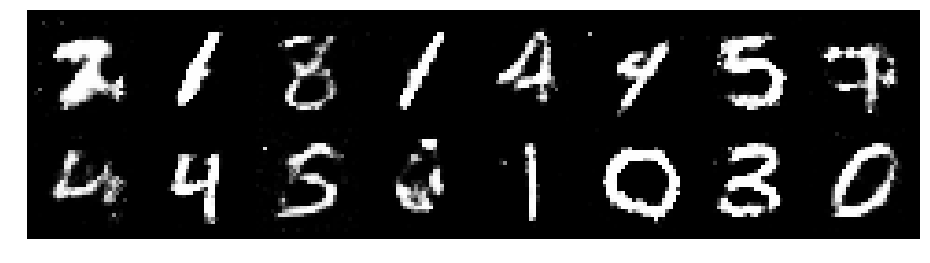

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.1787, Generator Loss: 0.9599
D(x): 0.5990, D(G(z)): 0.4335


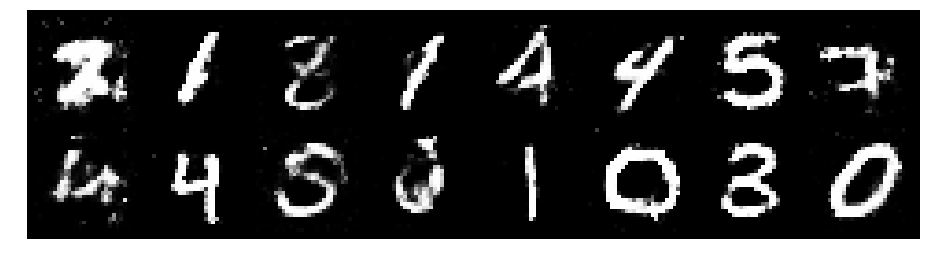

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.2389, Generator Loss: 0.9886
D(x): 0.5423, D(G(z)): 0.4065


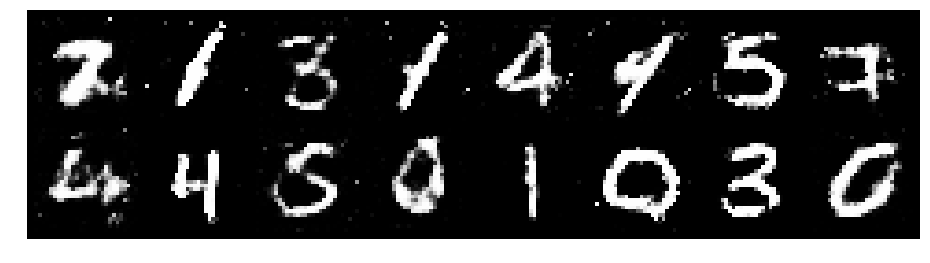

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.2965, Generator Loss: 0.7788
D(x): 0.5676, D(G(z)): 0.4920


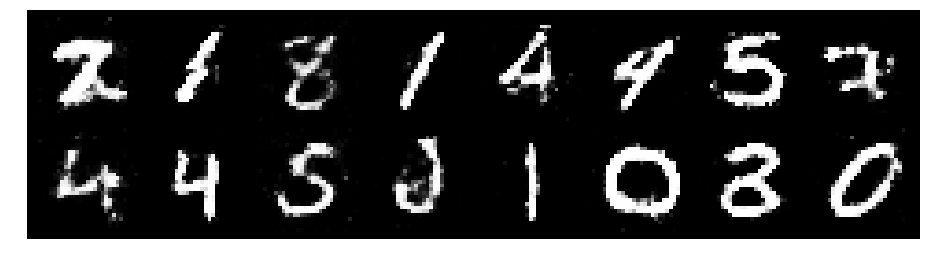

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.3304, Generator Loss: 0.7902
D(x): 0.5336, D(G(z)): 0.4611


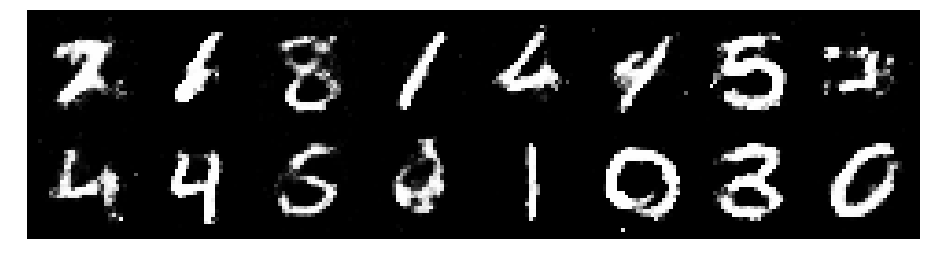

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.2525, Generator Loss: 0.8777
D(x): 0.5656, D(G(z)): 0.4556


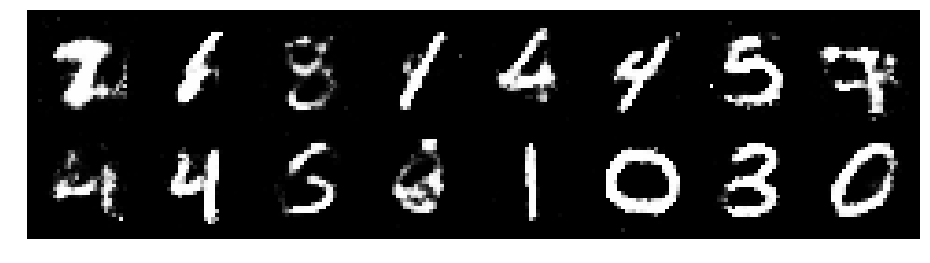

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.2704, Generator Loss: 0.8006
D(x): 0.5677, D(G(z)): 0.4632


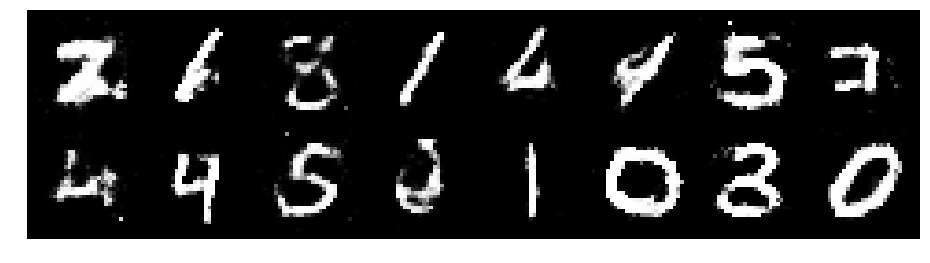

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.4032, Generator Loss: 0.7668
D(x): 0.5630, D(G(z)): 0.5242


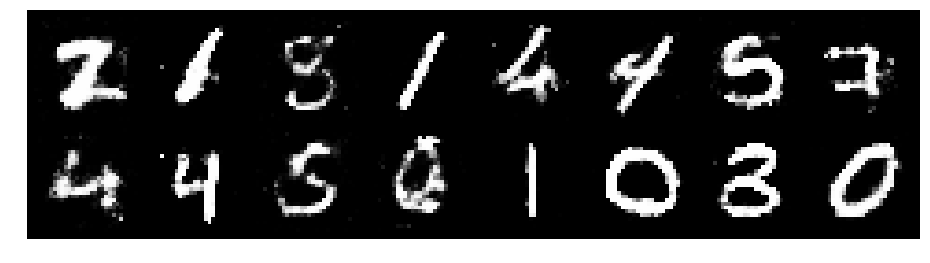

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.2528, Generator Loss: 0.8609
D(x): 0.5806, D(G(z)): 0.4636


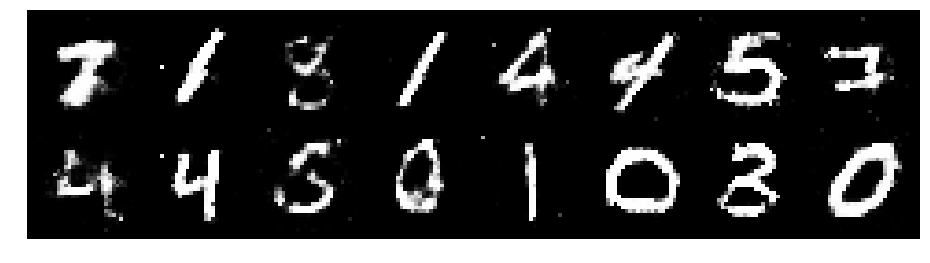

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.3427, Generator Loss: 0.9902
D(x): 0.5073, D(G(z)): 0.4357


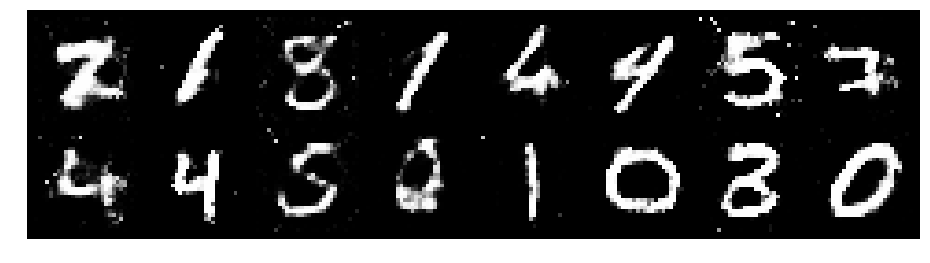

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.3027, Generator Loss: 0.8922
D(x): 0.5587, D(G(z)): 0.4696


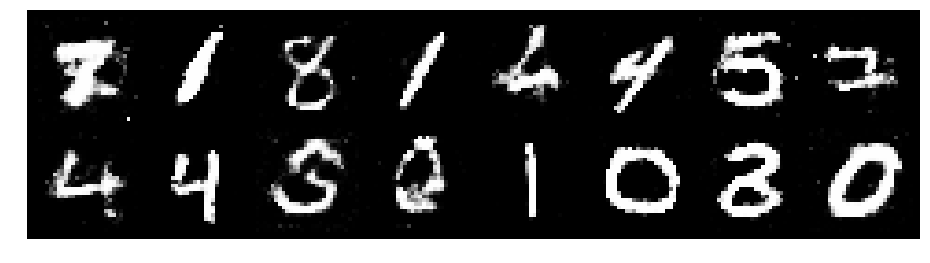

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.3097, Generator Loss: 0.9503
D(x): 0.5496, D(G(z)): 0.4419


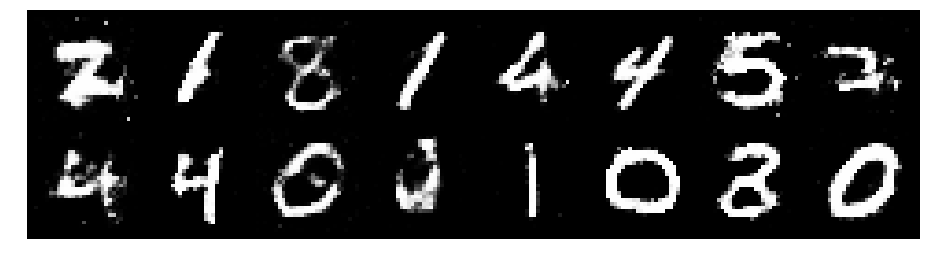

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.1894, Generator Loss: 1.0731
D(x): 0.5911, D(G(z)): 0.4173


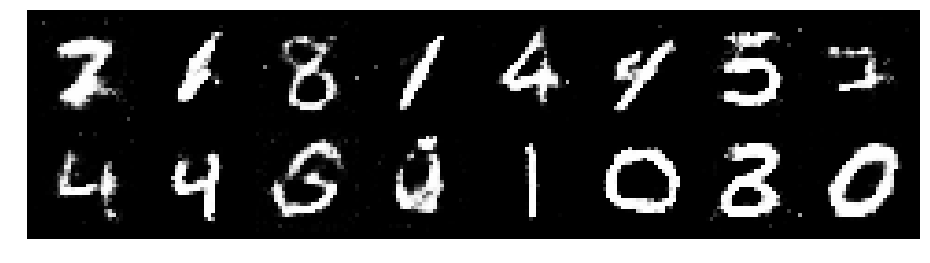

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.3944, Generator Loss: 0.8658
D(x): 0.5236, D(G(z)): 0.4787


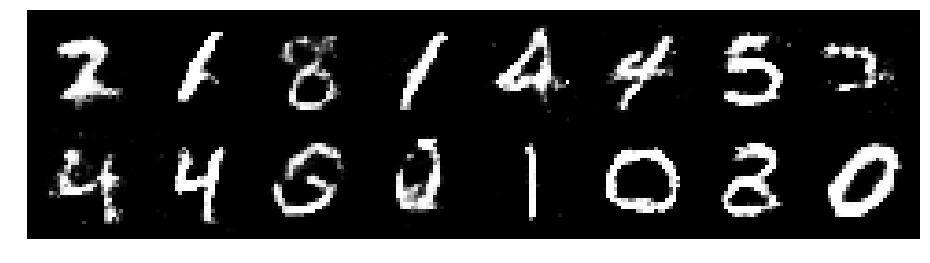

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.2574, Generator Loss: 0.9301
D(x): 0.5559, D(G(z)): 0.4371


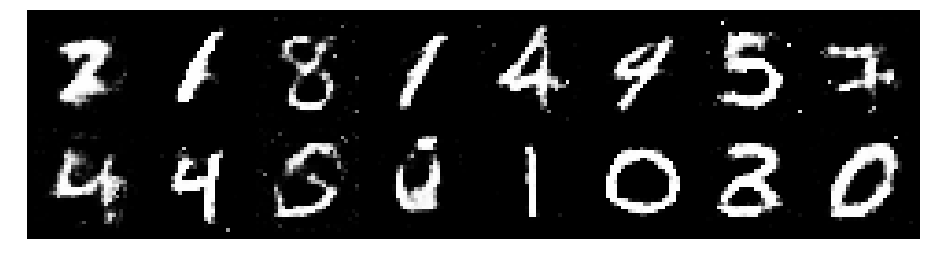

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.2456, Generator Loss: 0.8721
D(x): 0.5635, D(G(z)): 0.4228


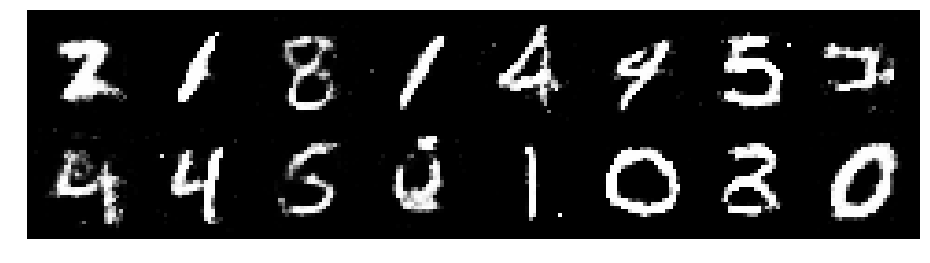

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.1802, Generator Loss: 0.9190
D(x): 0.5523, D(G(z)): 0.4090


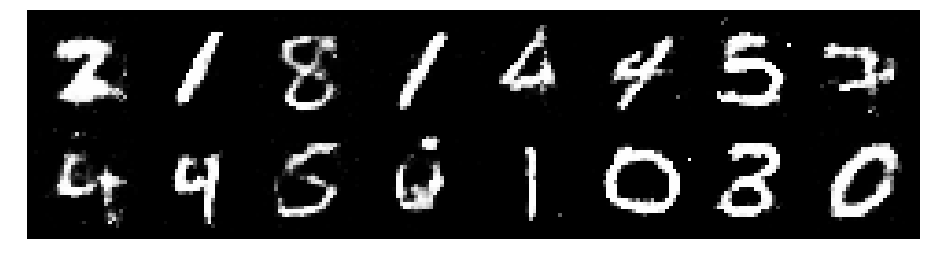

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.3439, Generator Loss: 1.0348
D(x): 0.5272, D(G(z)): 0.4468


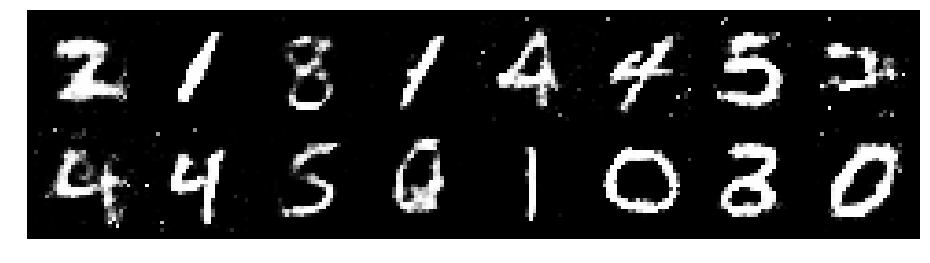

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.3519, Generator Loss: 0.9247
D(x): 0.5367, D(G(z)): 0.4563


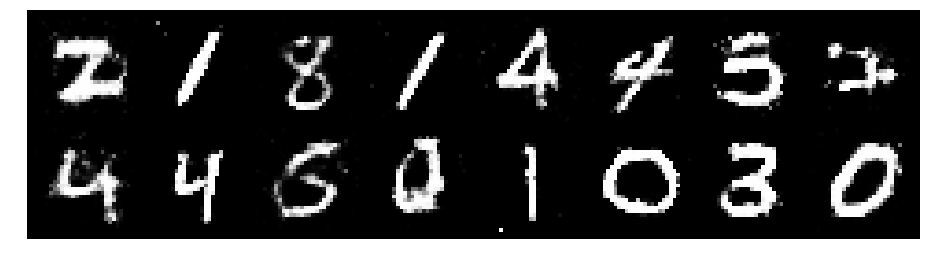

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.2290, Generator Loss: 0.8716
D(x): 0.5559, D(G(z)): 0.4380


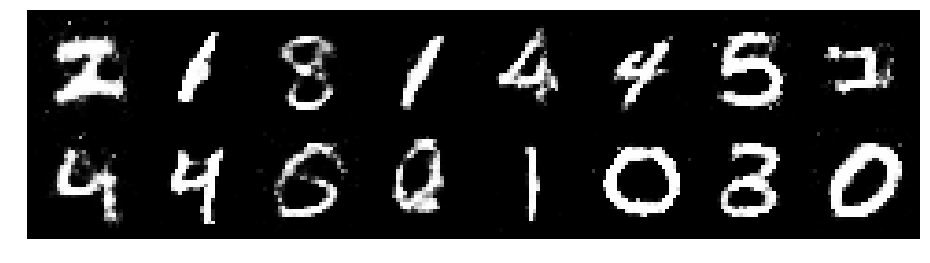

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.3339, Generator Loss: 0.9214
D(x): 0.5346, D(G(z)): 0.4597


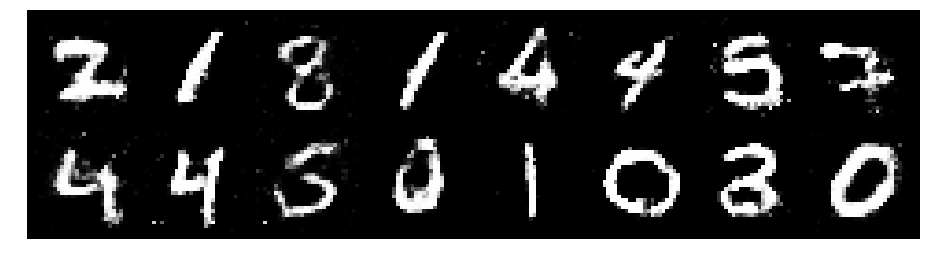

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.2298, Generator Loss: 0.9924
D(x): 0.5138, D(G(z)): 0.3812


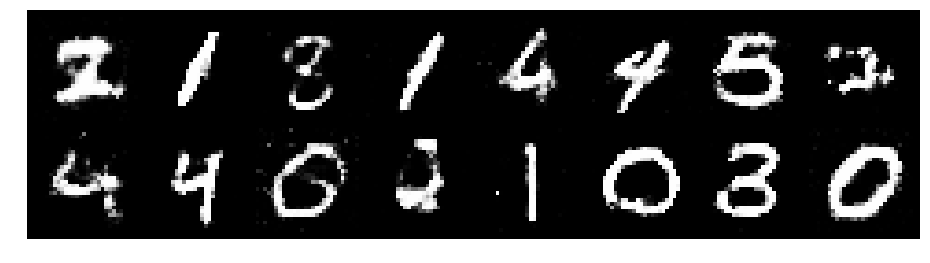

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.2615, Generator Loss: 0.8695
D(x): 0.5434, D(G(z)): 0.4478


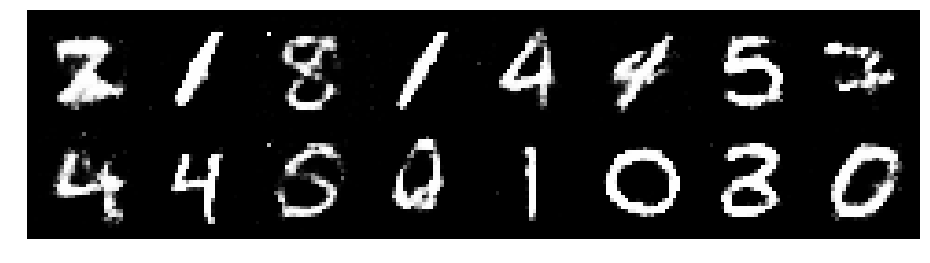

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.2954, Generator Loss: 0.8001
D(x): 0.5612, D(G(z)): 0.4745


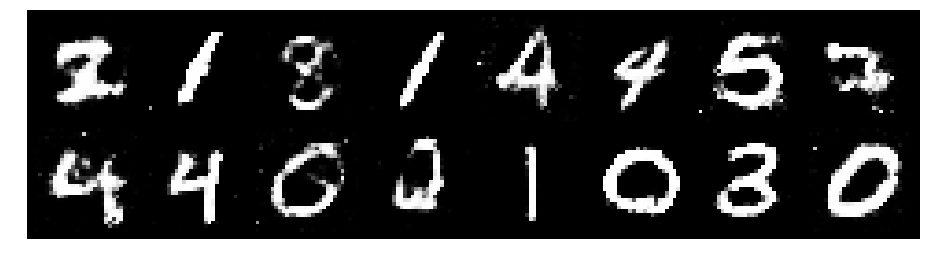

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.3088, Generator Loss: 0.9341
D(x): 0.4901, D(G(z)): 0.3914


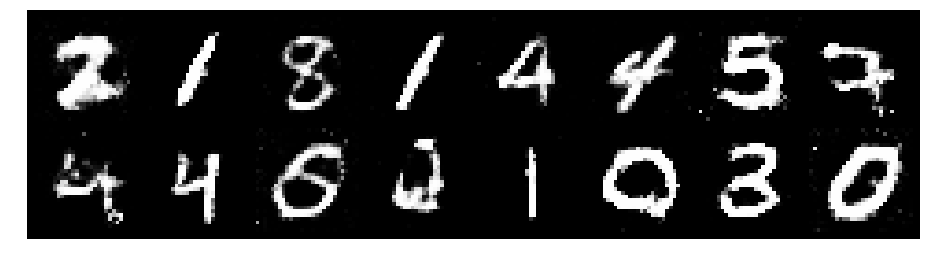

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.1902, Generator Loss: 0.8158
D(x): 0.5801, D(G(z)): 0.4361


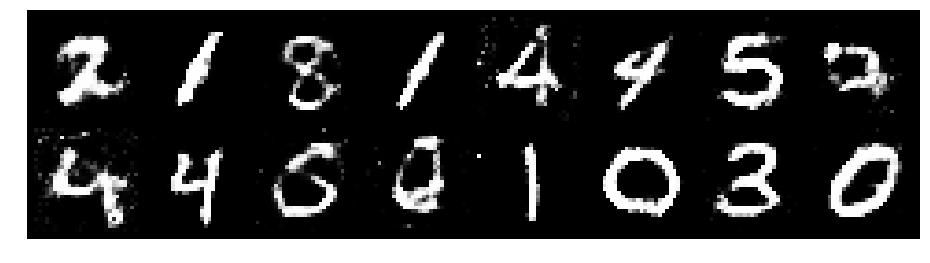

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.2510, Generator Loss: 0.8615
D(x): 0.5818, D(G(z)): 0.4497


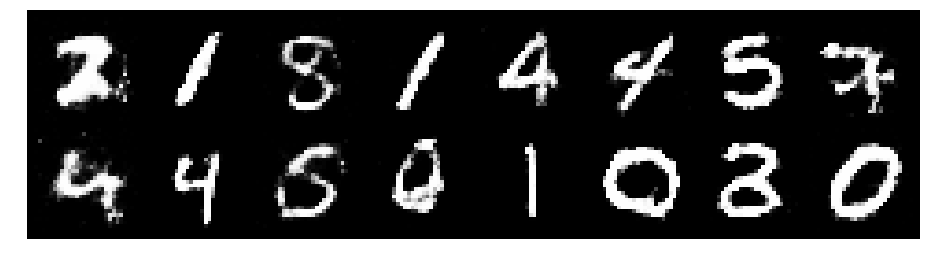

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.3506, Generator Loss: 0.8500
D(x): 0.5816, D(G(z)): 0.4988


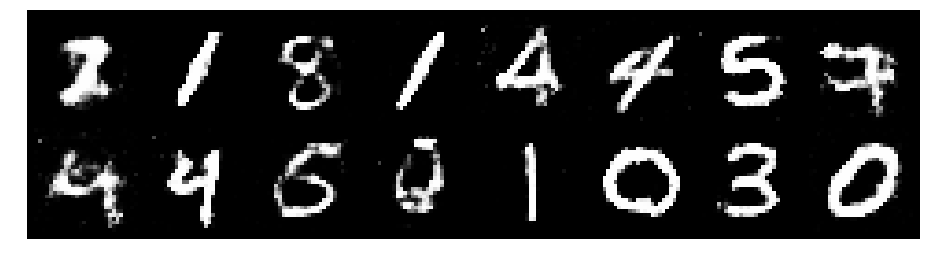

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.2164, Generator Loss: 0.9841
D(x): 0.5882, D(G(z)): 0.4360


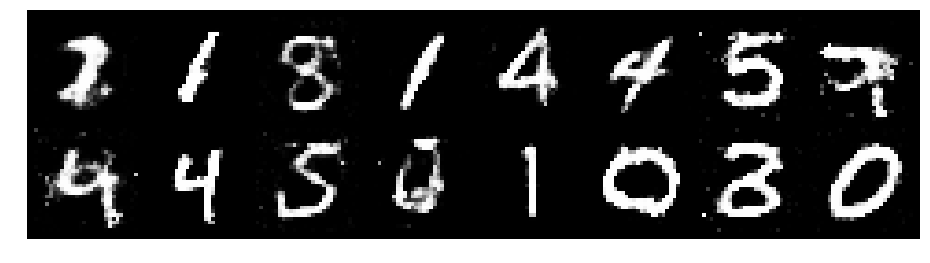

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.2713, Generator Loss: 0.8281
D(x): 0.5679, D(G(z)): 0.4637


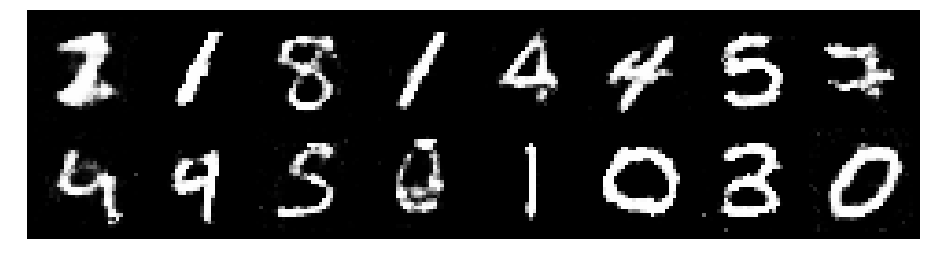

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.3232, Generator Loss: 0.7512
D(x): 0.5767, D(G(z)): 0.5076


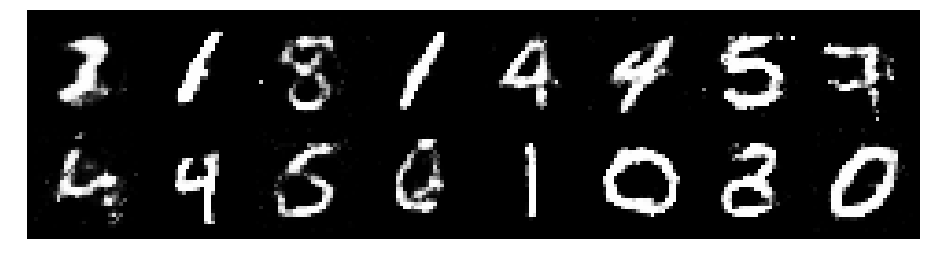

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.3894, Generator Loss: 0.8527
D(x): 0.5174, D(G(z)): 0.4580


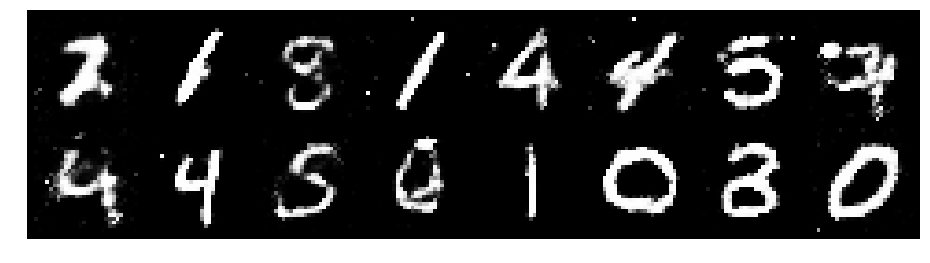

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.2265, Generator Loss: 0.8336
D(x): 0.5565, D(G(z)): 0.4292


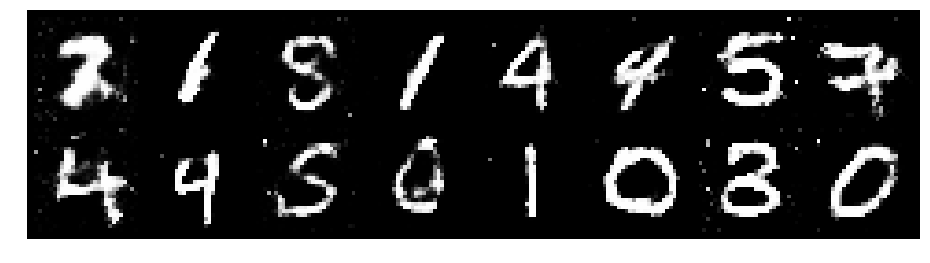

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.2278, Generator Loss: 0.9454
D(x): 0.5618, D(G(z)): 0.4311


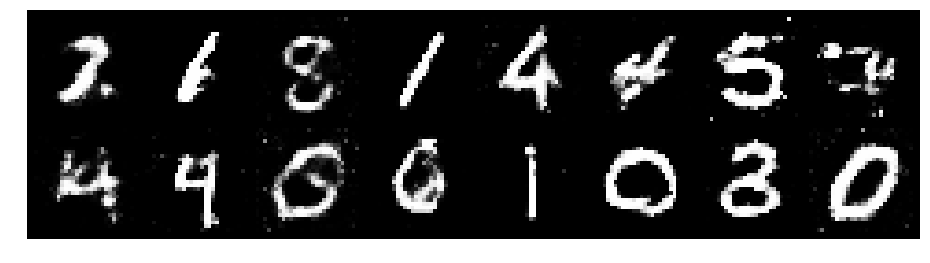

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.1324, Generator Loss: 0.9885
D(x): 0.5916, D(G(z)): 0.4062


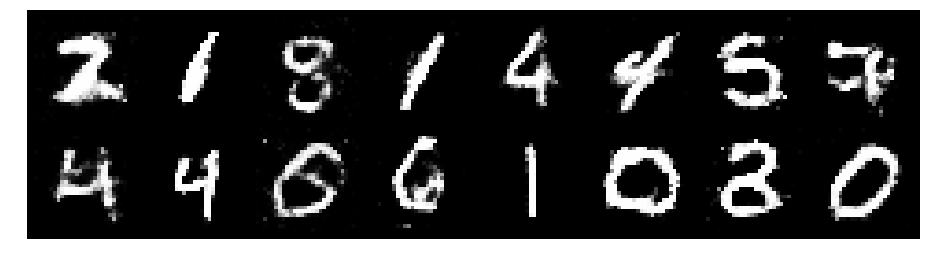

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.1545, Generator Loss: 0.9506
D(x): 0.5627, D(G(z)): 0.3820


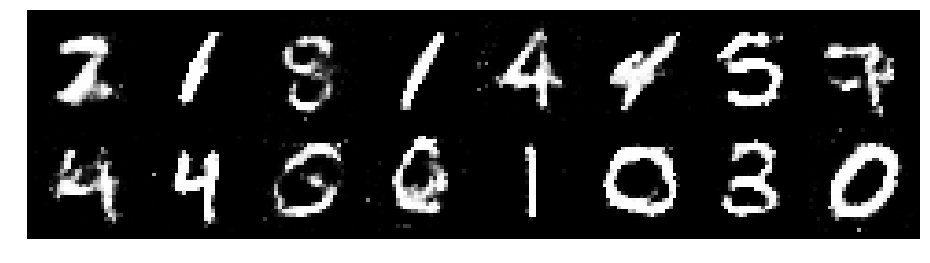

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.1813, Generator Loss: 0.9175
D(x): 0.5773, D(G(z)): 0.4220


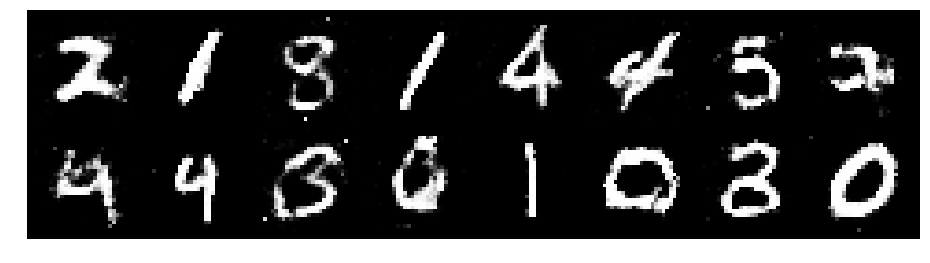

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.1380, Generator Loss: 0.9028
D(x): 0.5924, D(G(z)): 0.4121


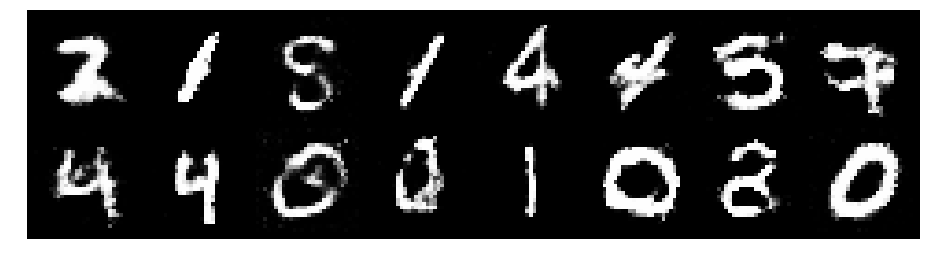

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.3161, Generator Loss: 0.9184
D(x): 0.5494, D(G(z)): 0.4479


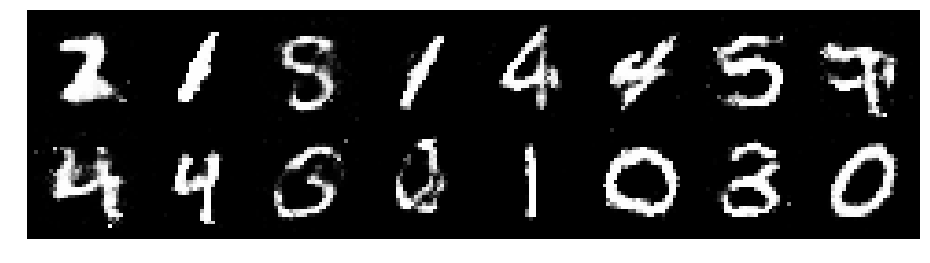

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.3413, Generator Loss: 0.9648
D(x): 0.5514, D(G(z)): 0.4663


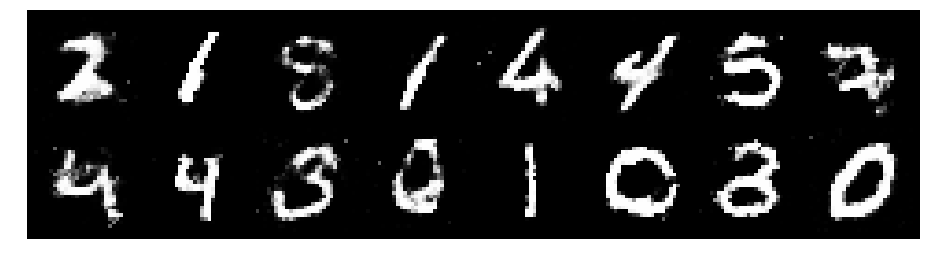

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.3106, Generator Loss: 0.9252
D(x): 0.5363, D(G(z)): 0.4438


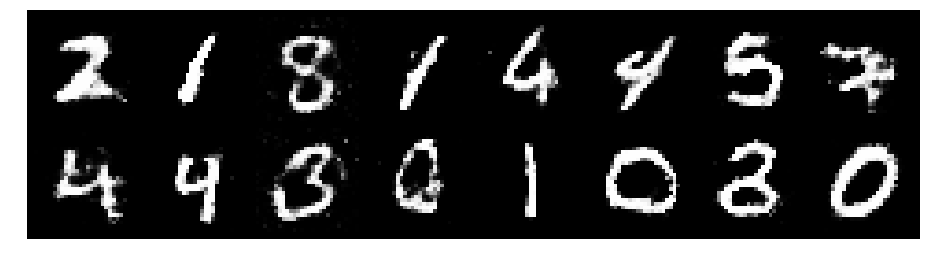

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.3354, Generator Loss: 0.7864
D(x): 0.5189, D(G(z)): 0.4697


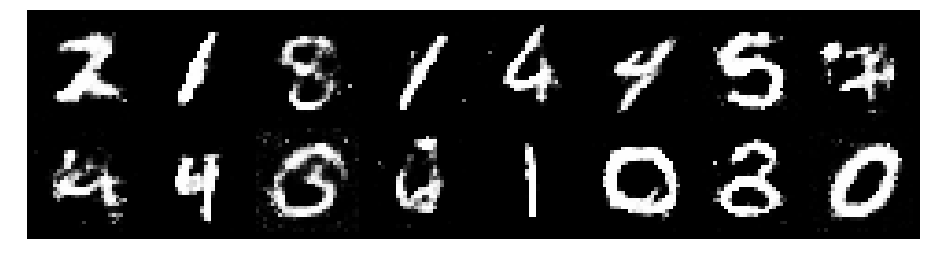

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.3928, Generator Loss: 0.9976
D(x): 0.5158, D(G(z)): 0.4610


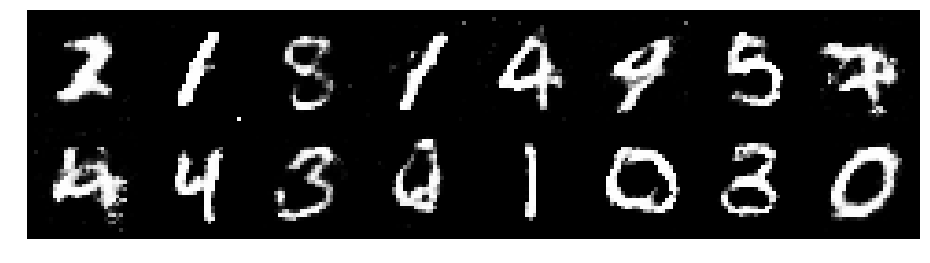

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.2176, Generator Loss: 0.8912
D(x): 0.5657, D(G(z)): 0.4273


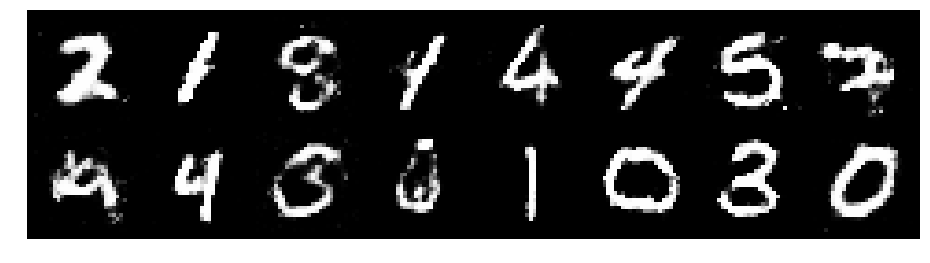

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.3334, Generator Loss: 0.9506
D(x): 0.5348, D(G(z)): 0.4411


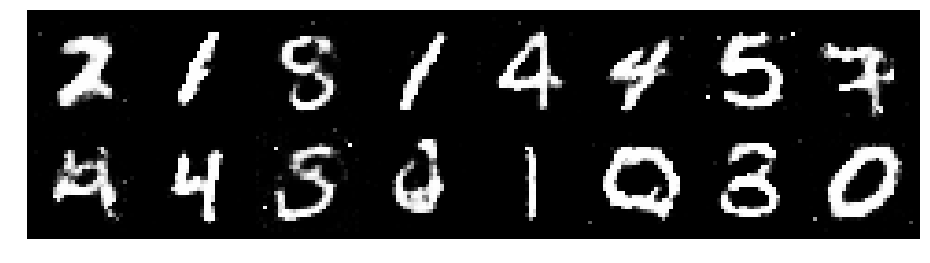

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.2160, Generator Loss: 1.0336
D(x): 0.5646, D(G(z)): 0.4112


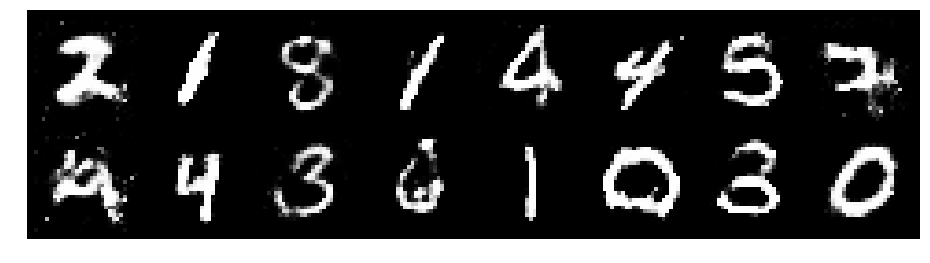

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.2922, Generator Loss: 0.8597
D(x): 0.5688, D(G(z)): 0.4587


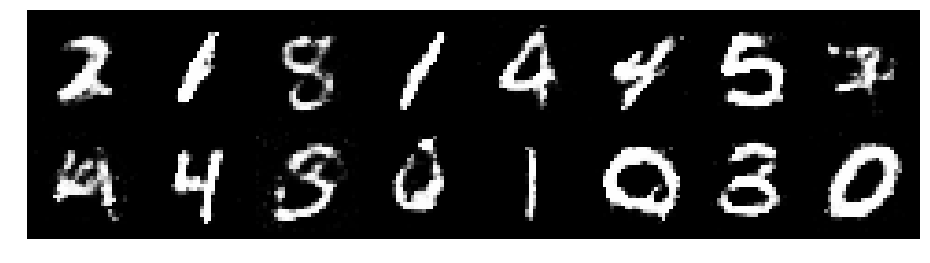

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.2186, Generator Loss: 0.8994
D(x): 0.5369, D(G(z)): 0.4177


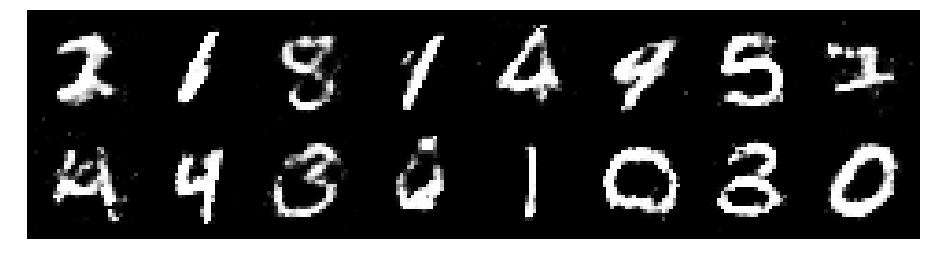

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.2599, Generator Loss: 1.0523
D(x): 0.5277, D(G(z)): 0.3971


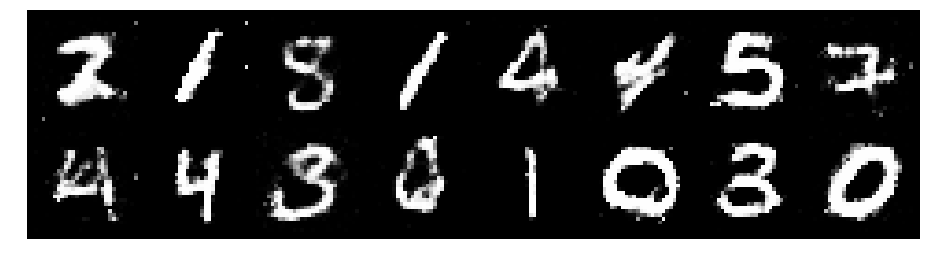

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.3090, Generator Loss: 0.7486
D(x): 0.5743, D(G(z)): 0.4741


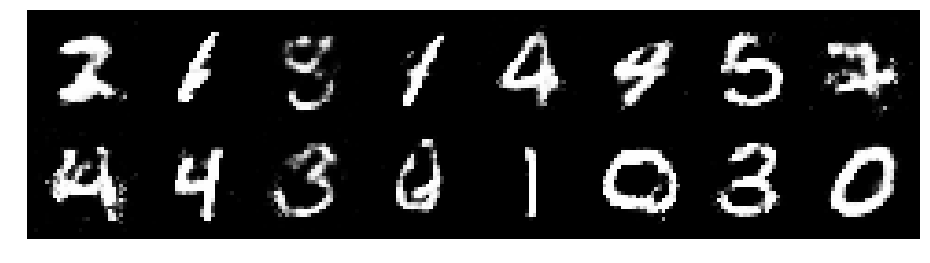

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.3476, Generator Loss: 0.8412
D(x): 0.4947, D(G(z)): 0.4396


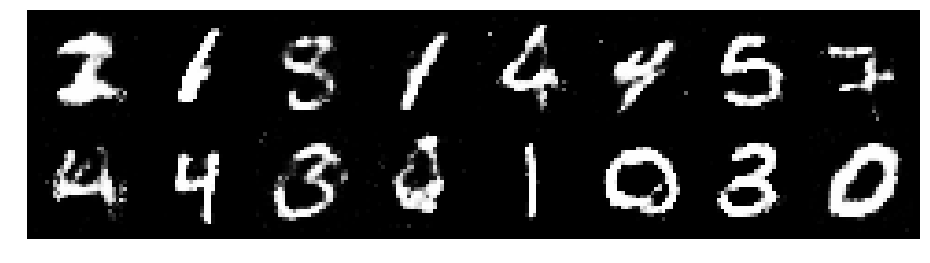

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.2310, Generator Loss: 0.9265
D(x): 0.5521, D(G(z)): 0.4205


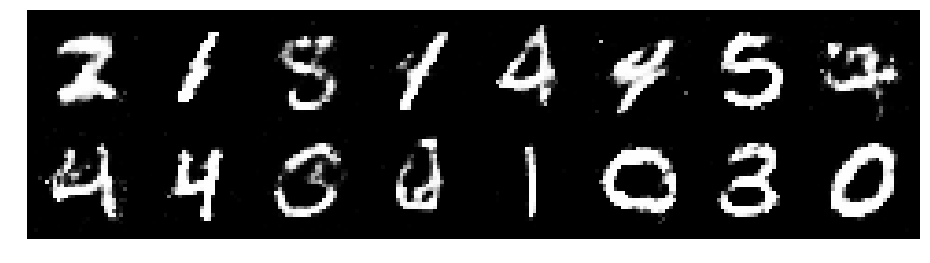

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.2305, Generator Loss: 0.9703
D(x): 0.5607, D(G(z)): 0.4042


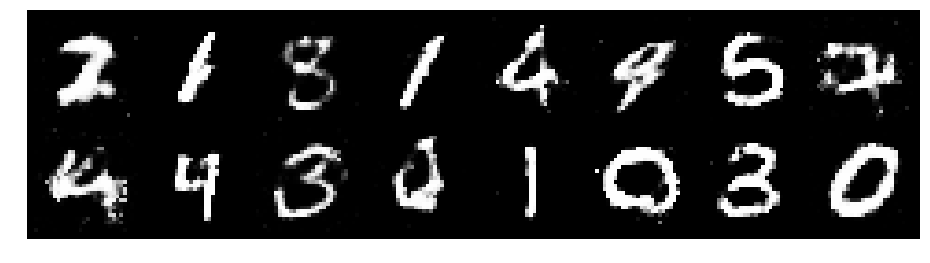

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.3350, Generator Loss: 0.9451
D(x): 0.5200, D(G(z)): 0.4255


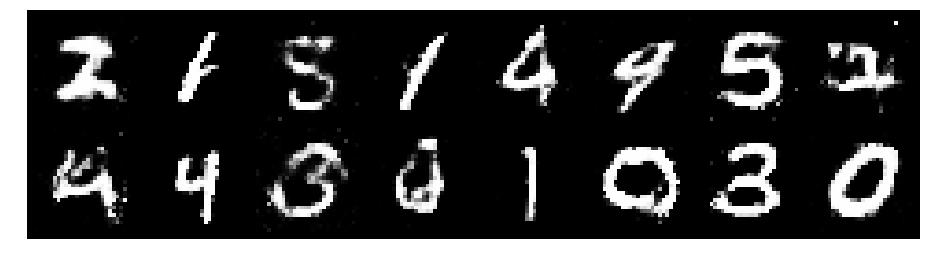

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.1773, Generator Loss: 1.0178
D(x): 0.6108, D(G(z)): 0.4293


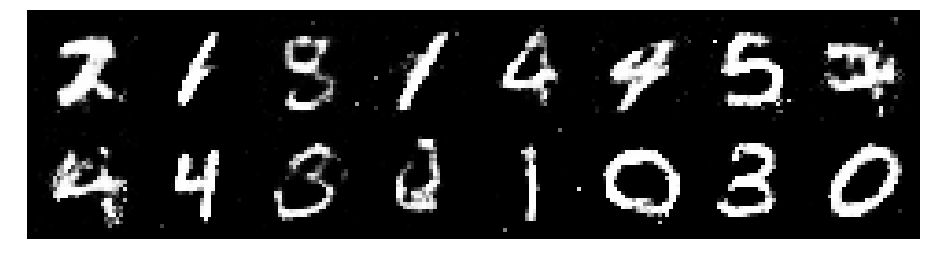

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.2893, Generator Loss: 0.9676
D(x): 0.5178, D(G(z)): 0.4182


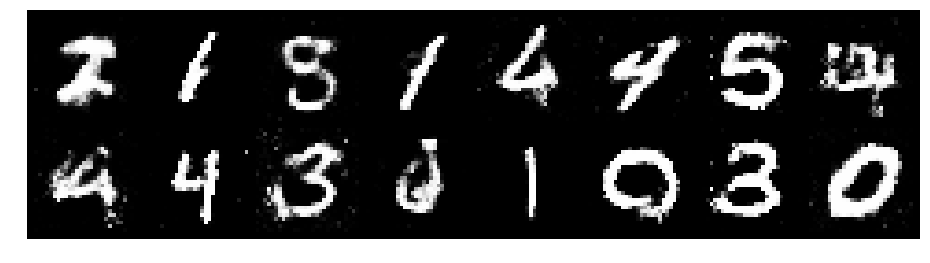

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.2071, Generator Loss: 0.9324
D(x): 0.5616, D(G(z)): 0.4221


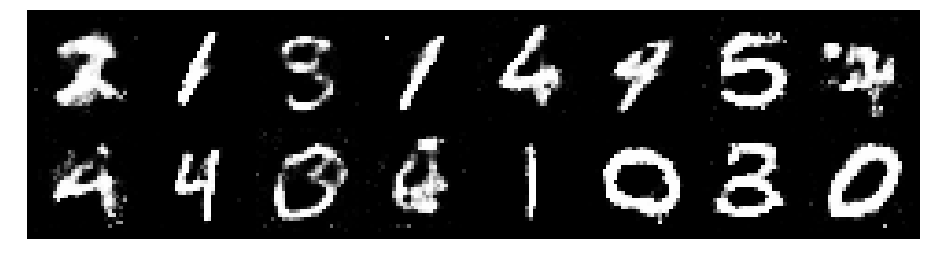

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.1418, Generator Loss: 0.9408
D(x): 0.5610, D(G(z)): 0.3947


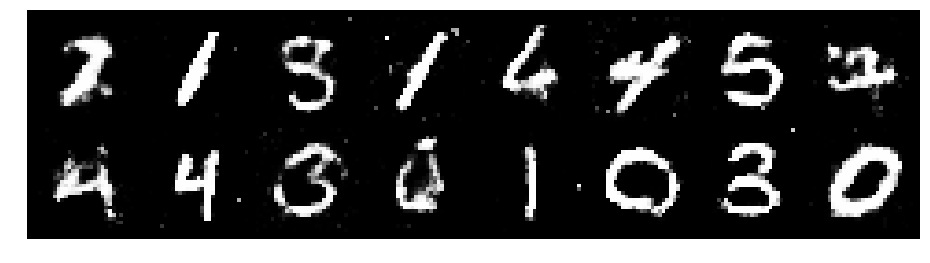

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.1359, Generator Loss: 1.0163
D(x): 0.6035, D(G(z)): 0.4196


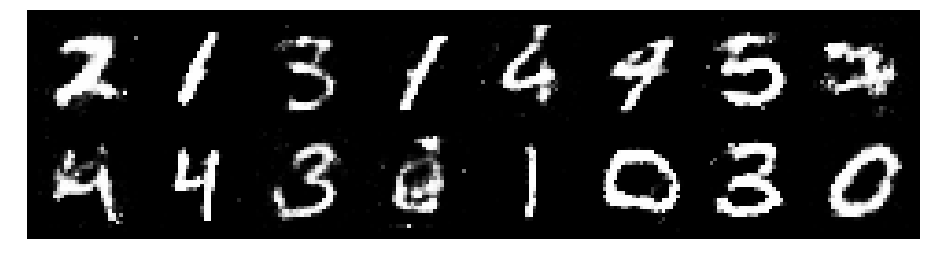

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.3303, Generator Loss: 0.8579
D(x): 0.5191, D(G(z)): 0.4537


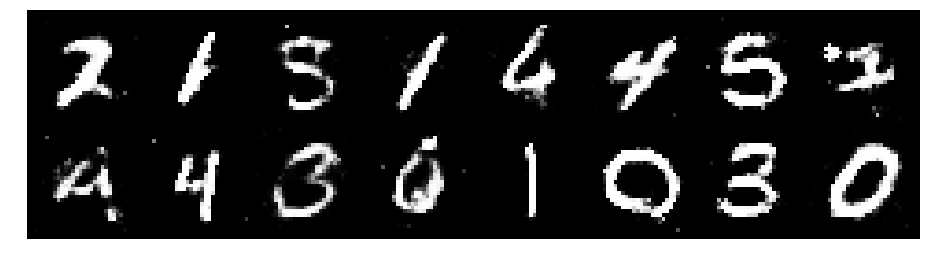

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.2920, Generator Loss: 0.8350
D(x): 0.5952, D(G(z)): 0.4735


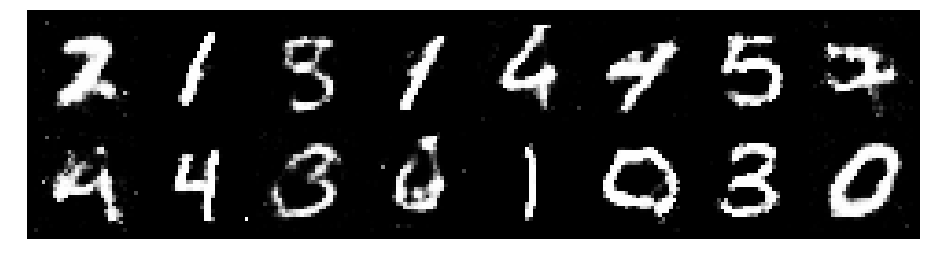

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.2962, Generator Loss: 0.8798
D(x): 0.5514, D(G(z)): 0.4395


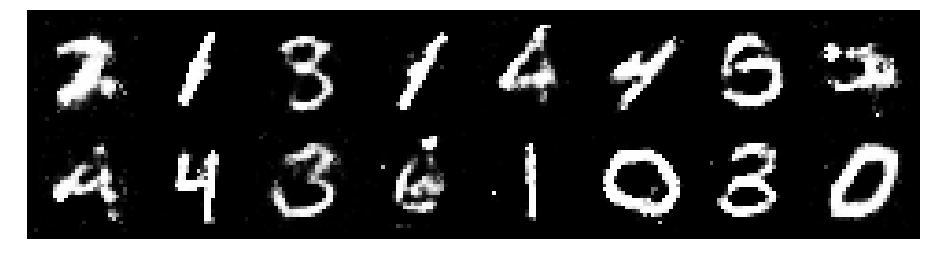

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.2670, Generator Loss: 0.9258
D(x): 0.5376, D(G(z)): 0.4309


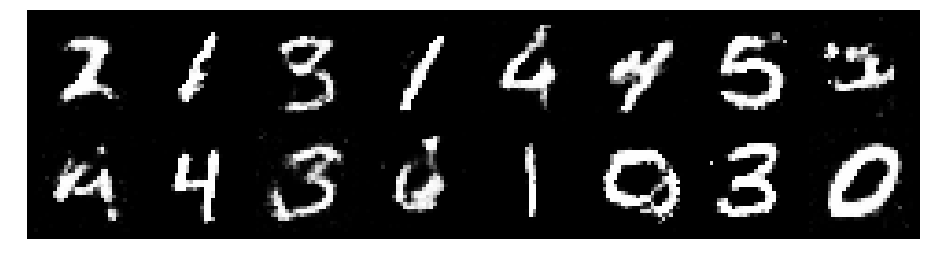

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.2564, Generator Loss: 0.8679
D(x): 0.5685, D(G(z)): 0.4661


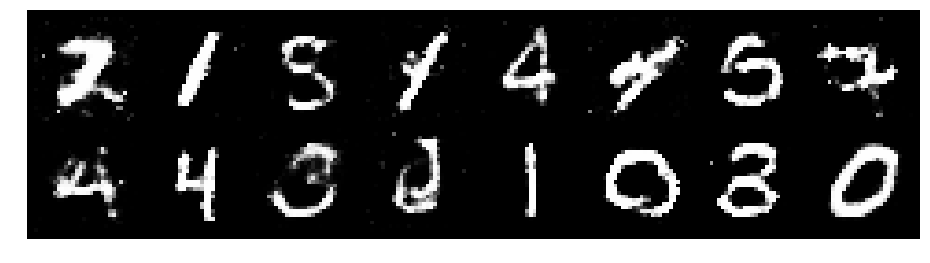

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.3022, Generator Loss: 0.7820
D(x): 0.5325, D(G(z)): 0.4511


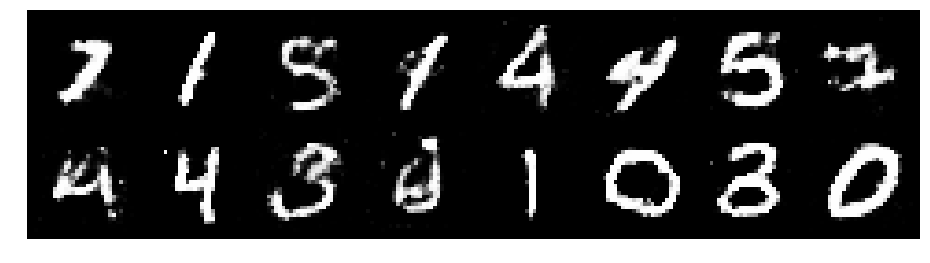

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.2847, Generator Loss: 0.7861
D(x): 0.5515, D(G(z)): 0.4788


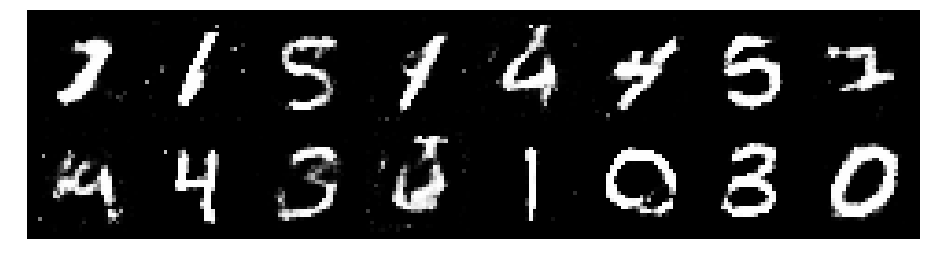

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.3726, Generator Loss: 0.8550
D(x): 0.5286, D(G(z)): 0.4639


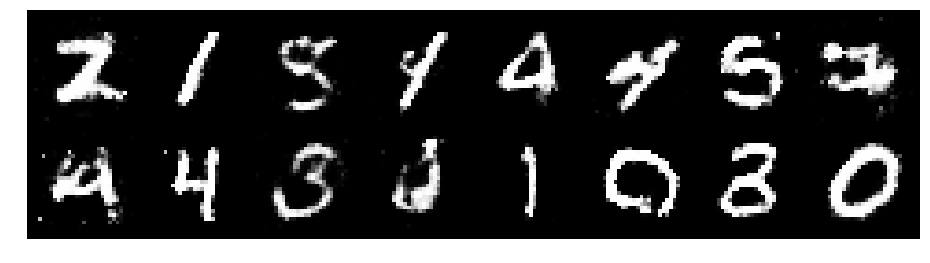

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.1829, Generator Loss: 0.9454
D(x): 0.5976, D(G(z)): 0.4312


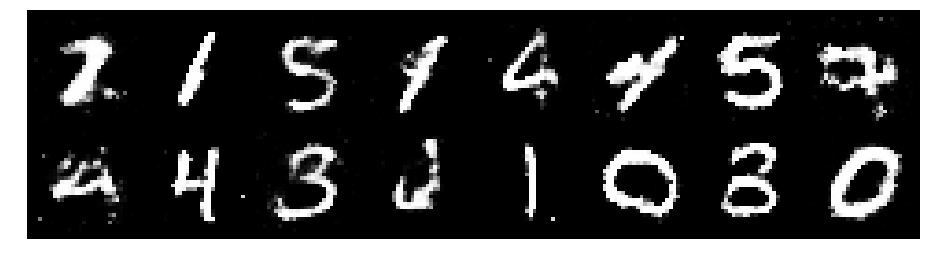

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.2563, Generator Loss: 0.7711
D(x): 0.5377, D(G(z)): 0.4378


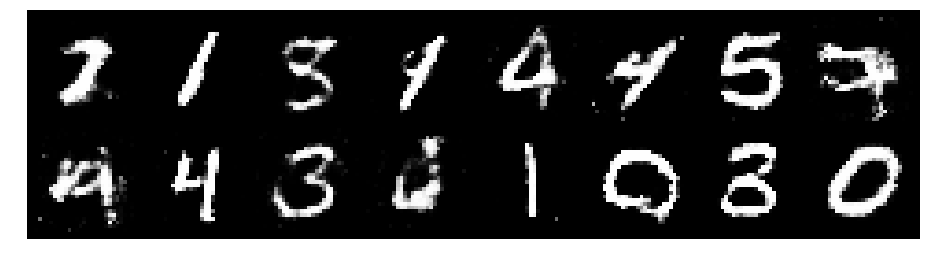

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.3642, Generator Loss: 0.7739
D(x): 0.5487, D(G(z)): 0.4890


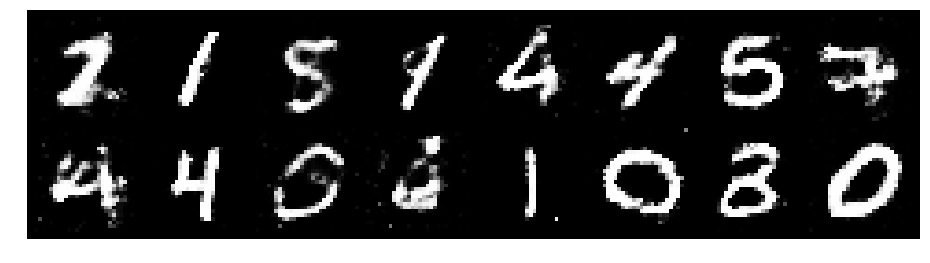

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.2513, Generator Loss: 0.9406
D(x): 0.5470, D(G(z)): 0.4212


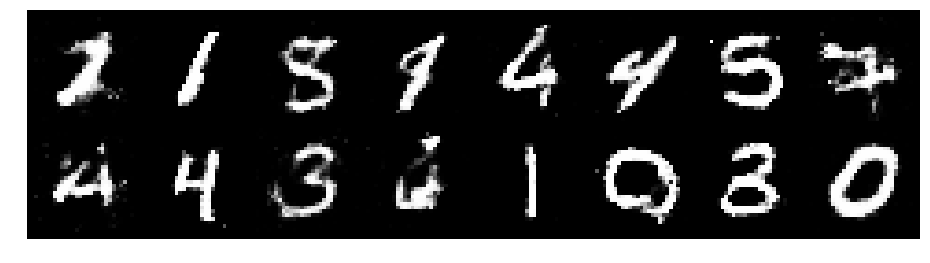

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.2699, Generator Loss: 0.9157
D(x): 0.5480, D(G(z)): 0.4406


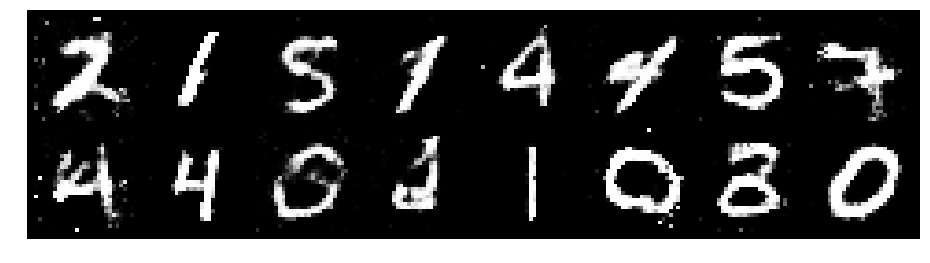

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.3151, Generator Loss: 0.8998
D(x): 0.5274, D(G(z)): 0.4429


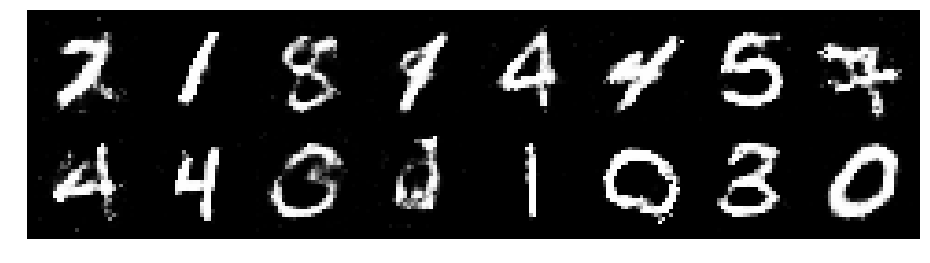

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.3103, Generator Loss: 0.7855
D(x): 0.5473, D(G(z)): 0.4574


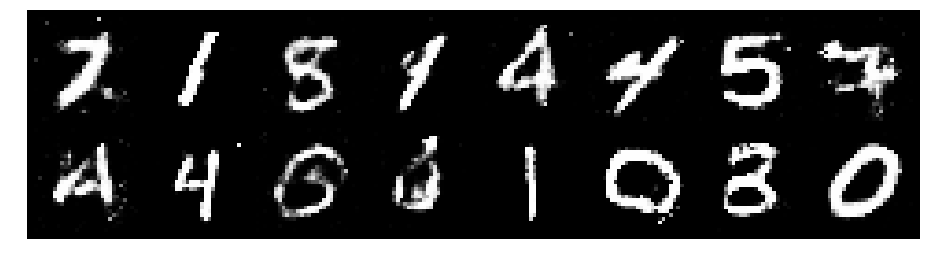

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.3738, Generator Loss: 0.9603
D(x): 0.5352, D(G(z)): 0.4554


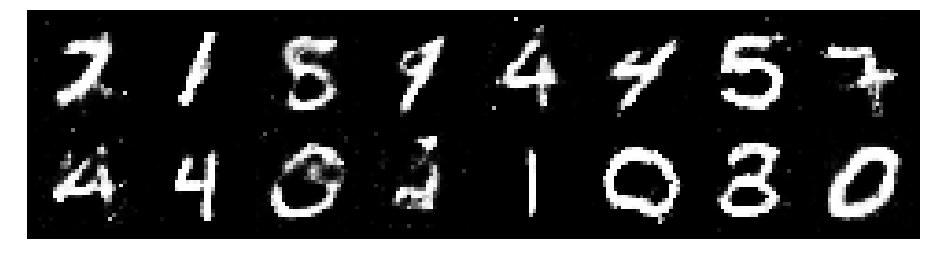

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 1.3919, Generator Loss: 0.7523
D(x): 0.4915, D(G(z)): 0.4421


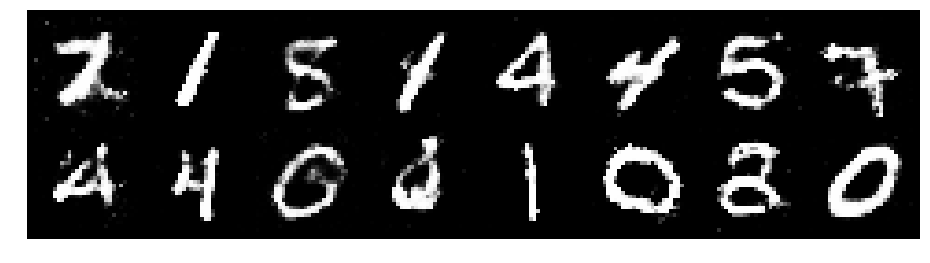

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.3071, Generator Loss: 0.8578
D(x): 0.5285, D(G(z)): 0.4559


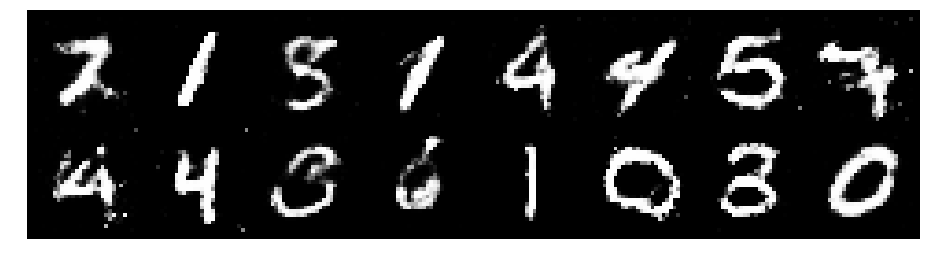

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.2538, Generator Loss: 0.9884
D(x): 0.5356, D(G(z)): 0.4168


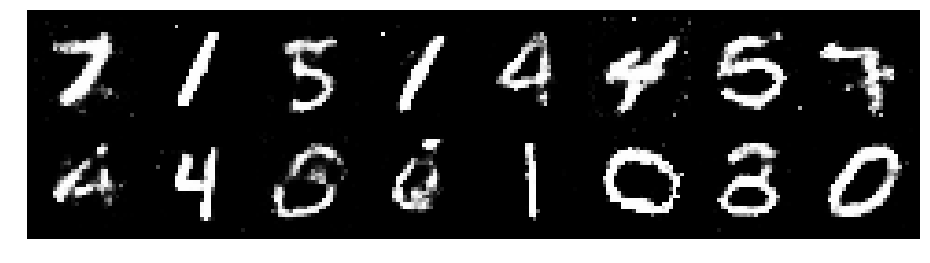

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.3317, Generator Loss: 1.0242
D(x): 0.5222, D(G(z)): 0.4315


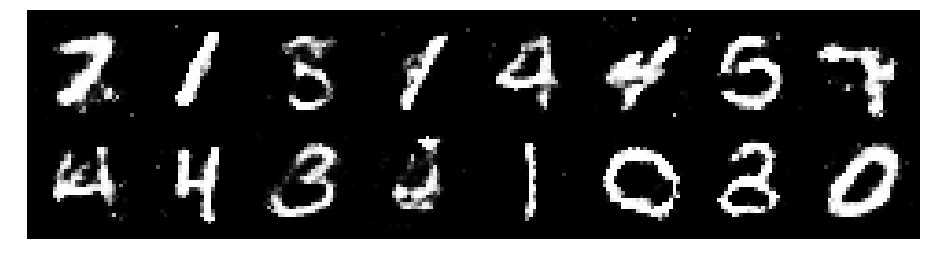

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.1814, Generator Loss: 0.9727
D(x): 0.5520, D(G(z)): 0.4080


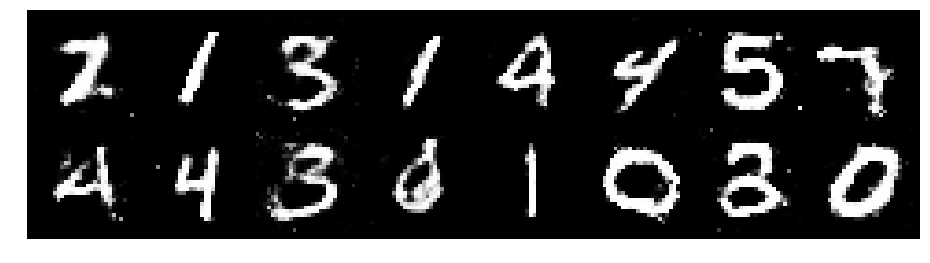

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.2815, Generator Loss: 0.8249
D(x): 0.5545, D(G(z)): 0.4728


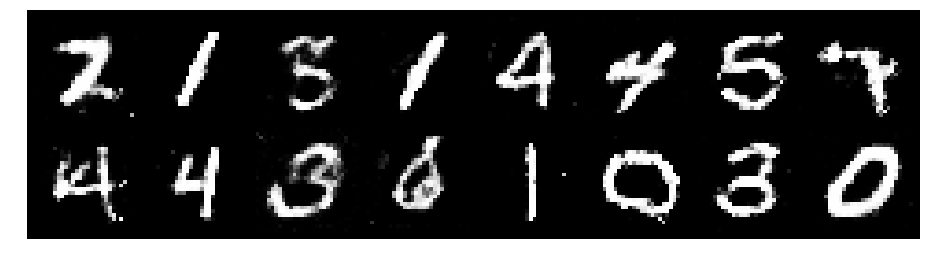

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.2948, Generator Loss: 0.8564
D(x): 0.5106, D(G(z)): 0.4383


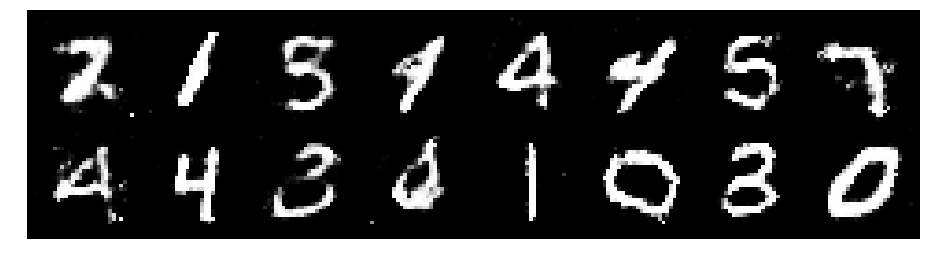

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.2792, Generator Loss: 0.9187
D(x): 0.5177, D(G(z)): 0.4257


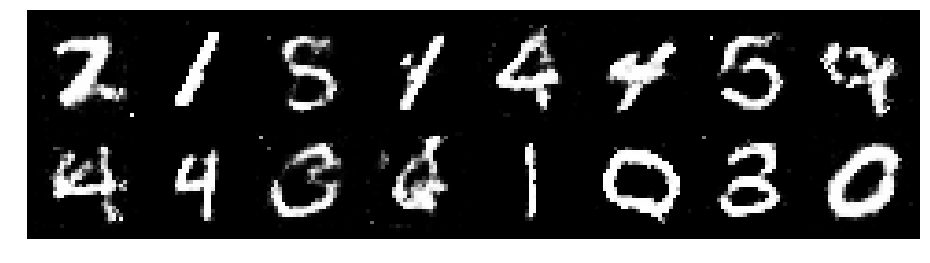

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.2545, Generator Loss: 0.9012
D(x): 0.5605, D(G(z)): 0.4421


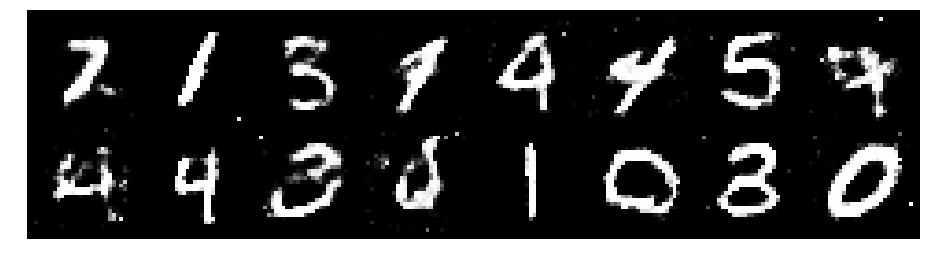

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 1.3051, Generator Loss: 0.9042
D(x): 0.5642, D(G(z)): 0.4462


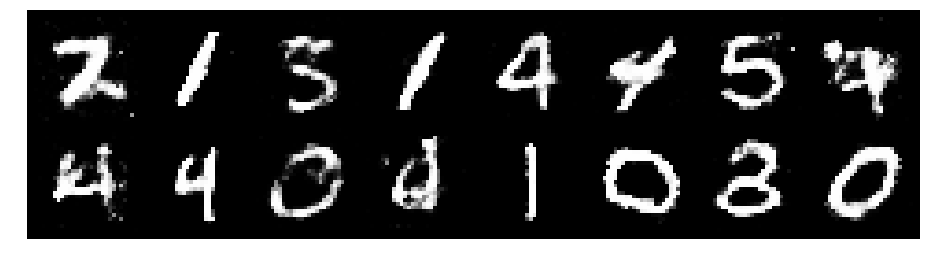

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.3001, Generator Loss: 0.9205
D(x): 0.5353, D(G(z)): 0.4373


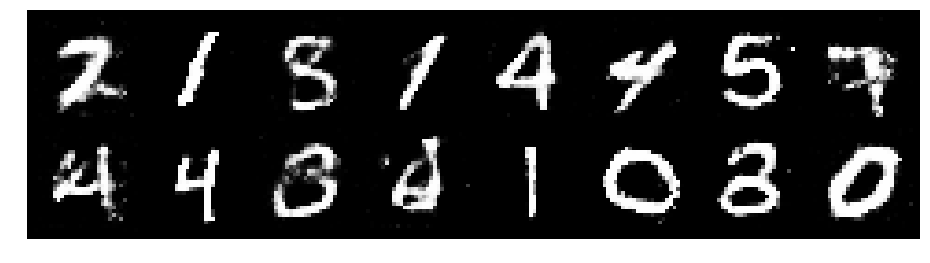

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.3004, Generator Loss: 0.9425
D(x): 0.5289, D(G(z)): 0.4233


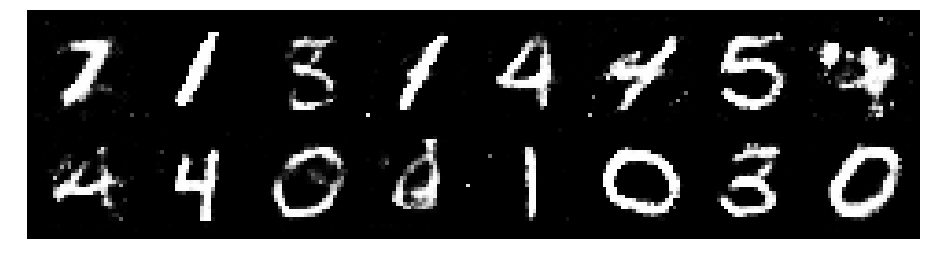

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.2454, Generator Loss: 0.8623
D(x): 0.5810, D(G(z)): 0.4656


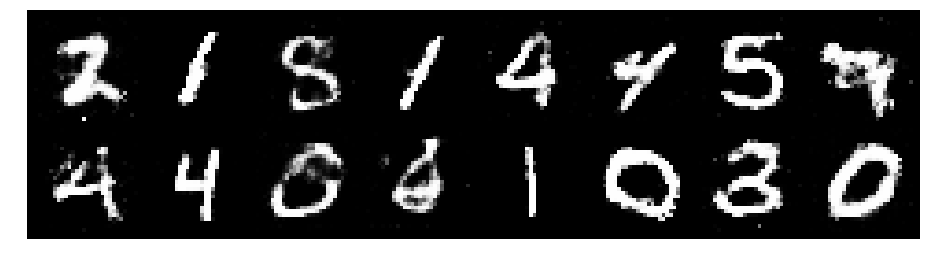

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 1.2818, Generator Loss: 0.8557
D(x): 0.5567, D(G(z)): 0.4615


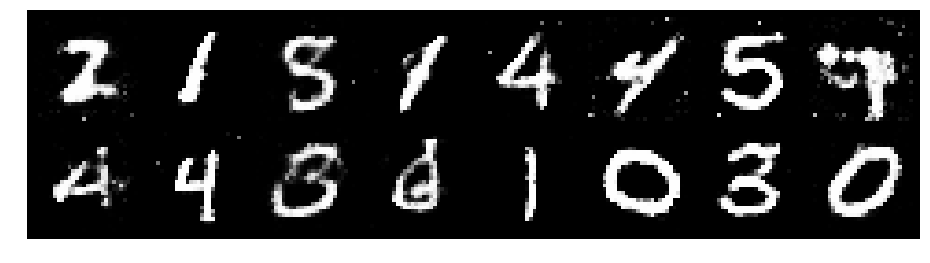

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.2981, Generator Loss: 0.7571
D(x): 0.5409, D(G(z)): 0.4691


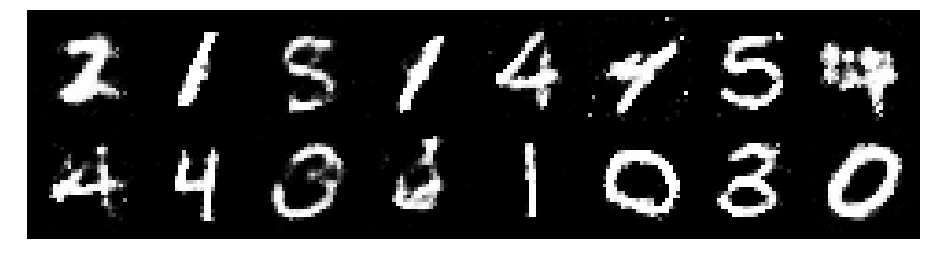

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 1.2824, Generator Loss: 0.8498
D(x): 0.5226, D(G(z)): 0.4227


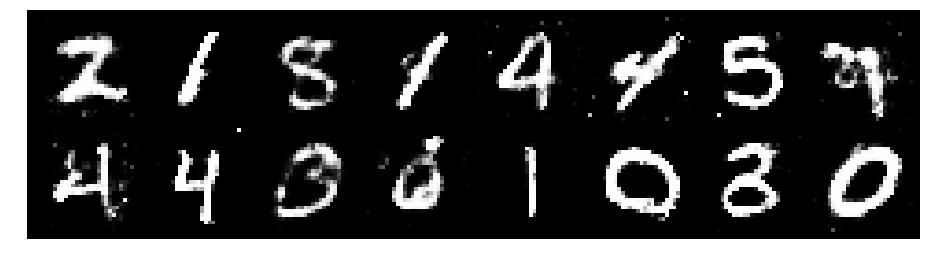

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.2580, Generator Loss: 0.8591
D(x): 0.5590, D(G(z)): 0.4485


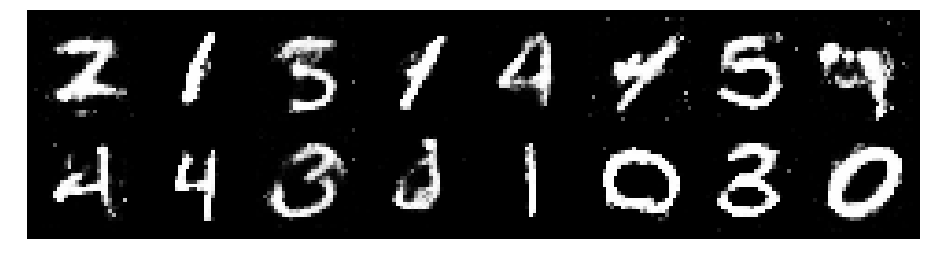

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 1.4174, Generator Loss: 0.8564
D(x): 0.5229, D(G(z)): 0.4772


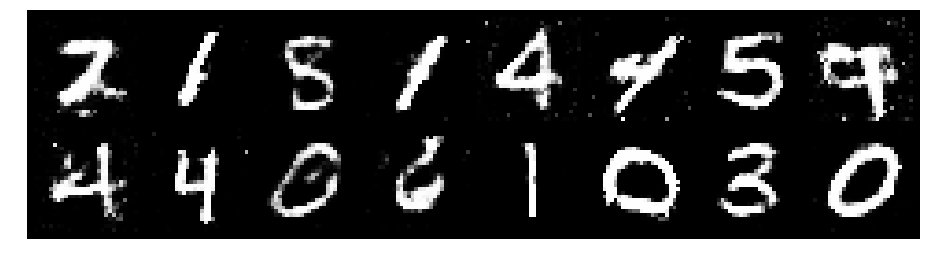

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.2405, Generator Loss: 0.9469
D(x): 0.5216, D(G(z)): 0.3881


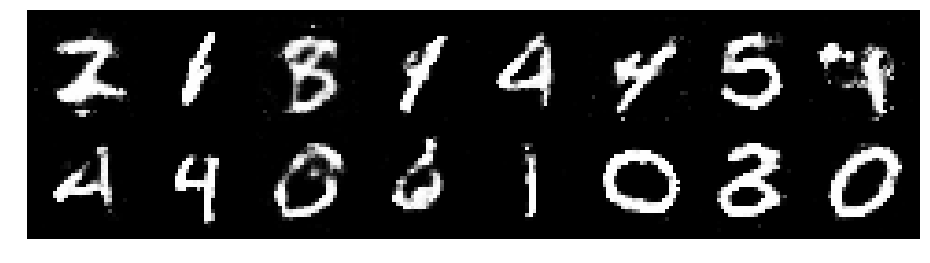

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.3193, Generator Loss: 0.9146
D(x): 0.5156, D(G(z)): 0.4417


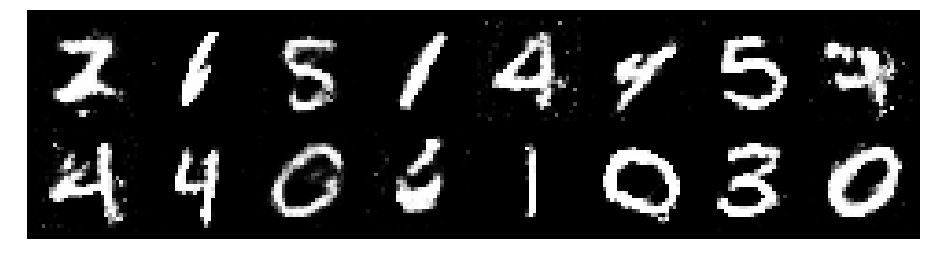

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.3028, Generator Loss: 0.8052
D(x): 0.5571, D(G(z)): 0.4640


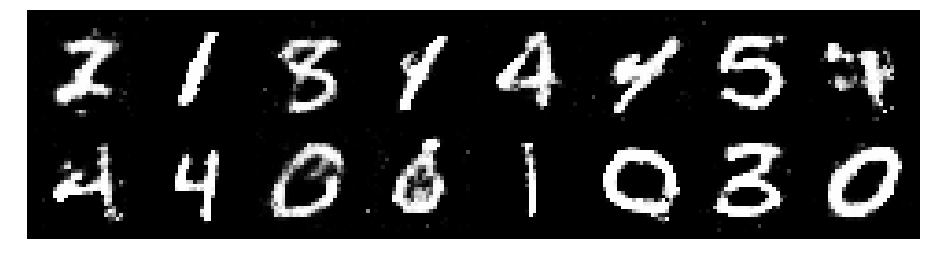

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.2700, Generator Loss: 0.7971
D(x): 0.5598, D(G(z)): 0.4631


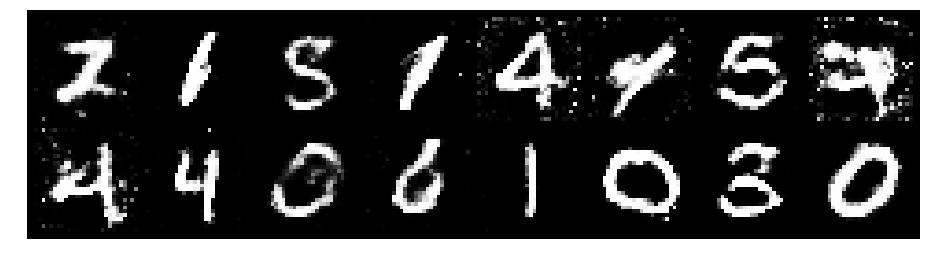

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.2498, Generator Loss: 0.9215
D(x): 0.6092, D(G(z)): 0.4712


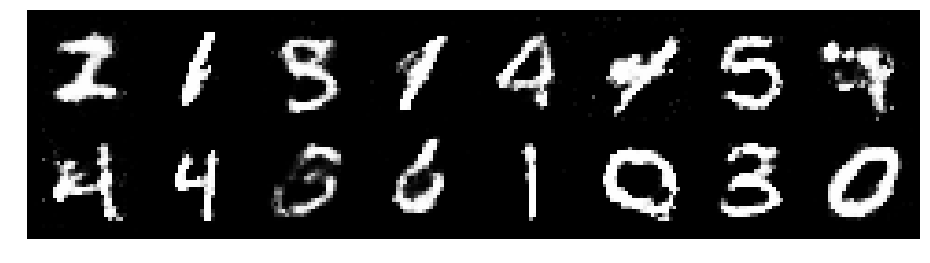

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.2183, Generator Loss: 0.9707
D(x): 0.5613, D(G(z)): 0.4302


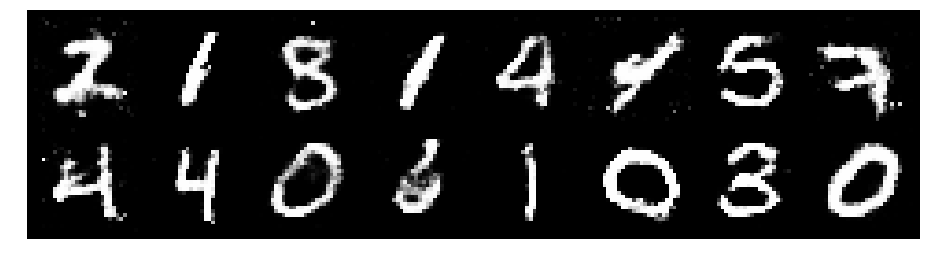

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 1.2904, Generator Loss: 0.8768
D(x): 0.5657, D(G(z)): 0.4540


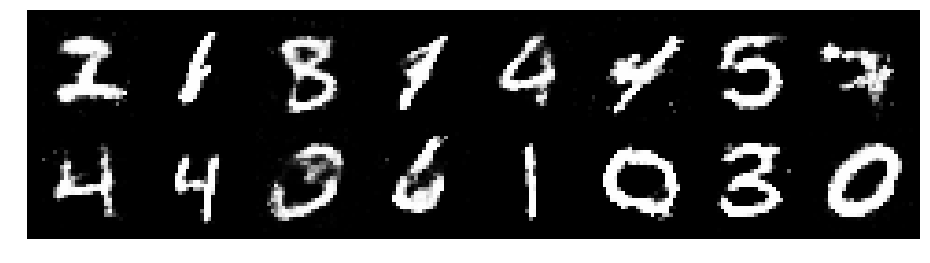

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.2520, Generator Loss: 1.1368
D(x): 0.5623, D(G(z)): 0.4243


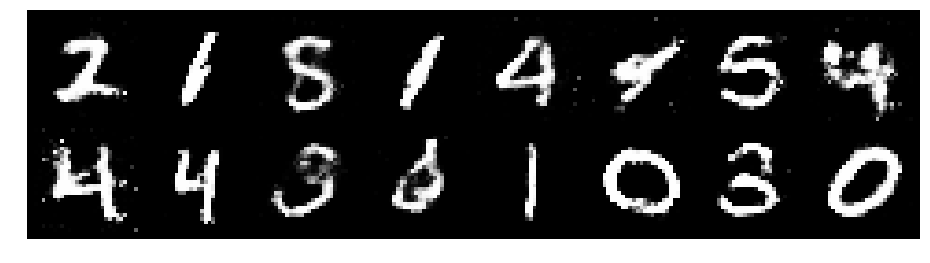

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.2087, Generator Loss: 1.1120
D(x): 0.5698, D(G(z)): 0.4120


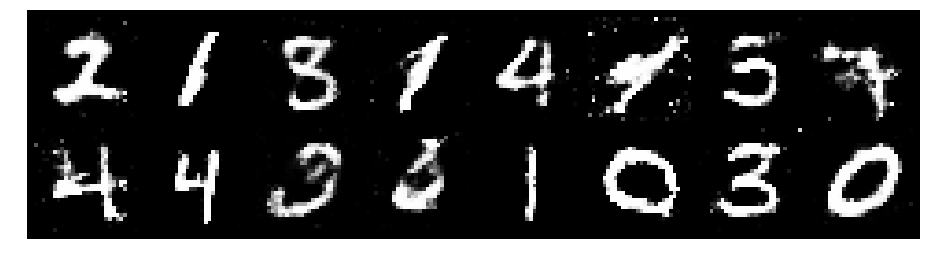

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 1.2556, Generator Loss: 0.9673
D(x): 0.5530, D(G(z)): 0.4312


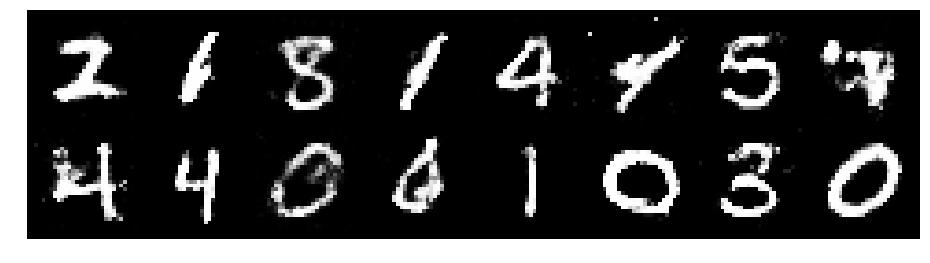

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.2931, Generator Loss: 0.9243
D(x): 0.5568, D(G(z)): 0.4463


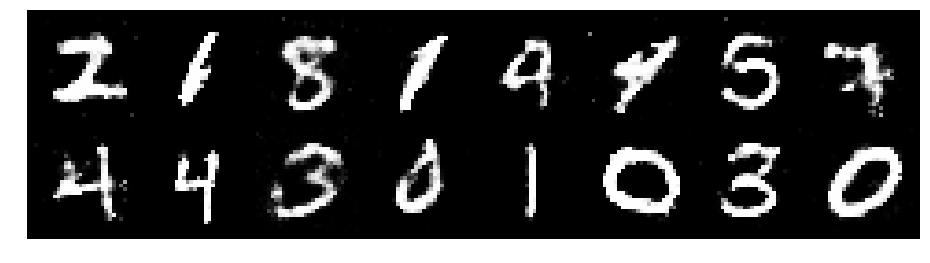

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.3159, Generator Loss: 0.8518
D(x): 0.5023, D(G(z)): 0.4262


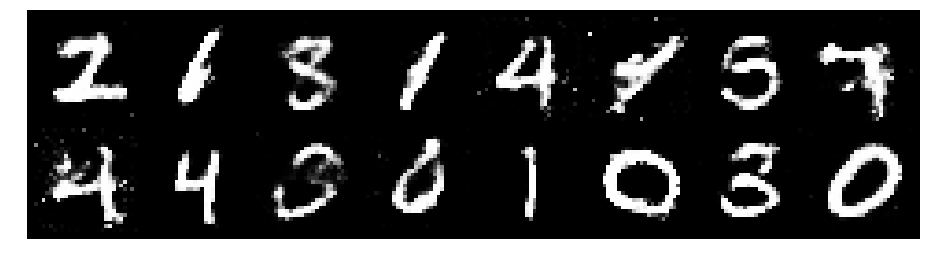

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.3596, Generator Loss: 0.8071
D(x): 0.5359, D(G(z)): 0.4710


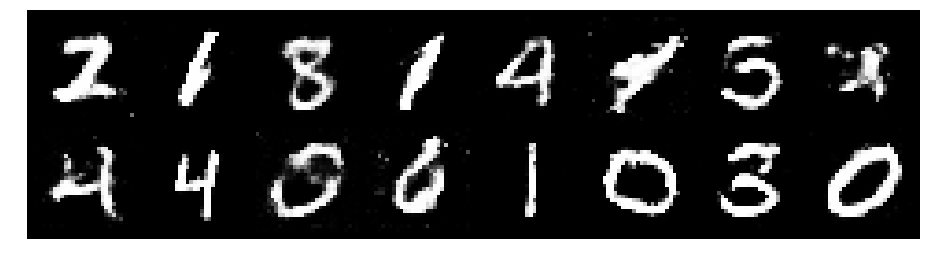

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.3440, Generator Loss: 0.8079
D(x): 0.5757, D(G(z)): 0.5017


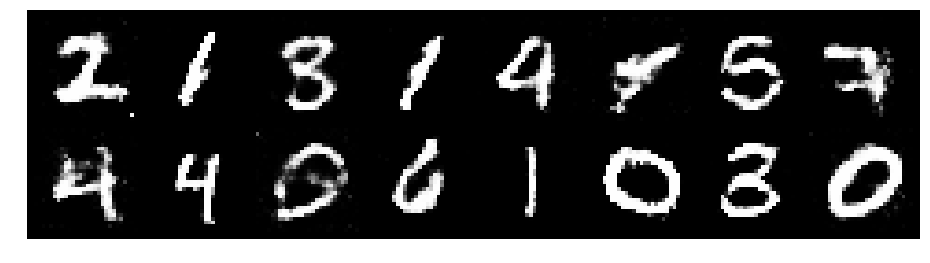

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.4202, Generator Loss: 0.8027
D(x): 0.5496, D(G(z)): 0.4968


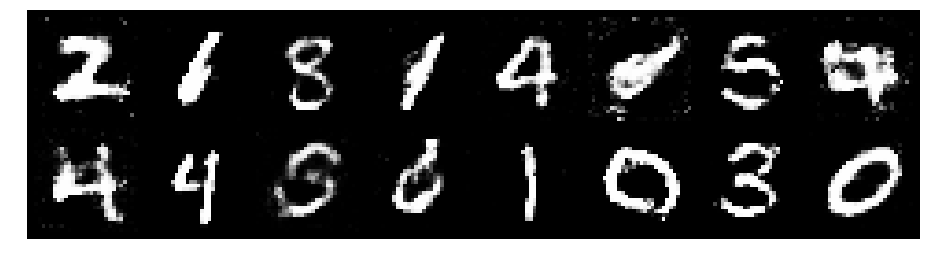

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.3386, Generator Loss: 0.7113
D(x): 0.5720, D(G(z)): 0.4963


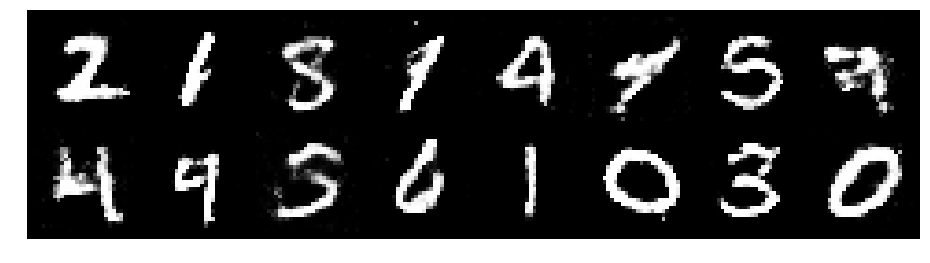

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.2616, Generator Loss: 1.0206
D(x): 0.5593, D(G(z)): 0.4224


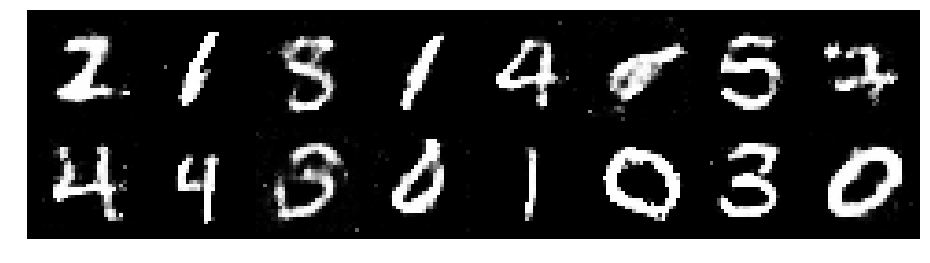

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.1666, Generator Loss: 1.0200
D(x): 0.6269, D(G(z)): 0.4335


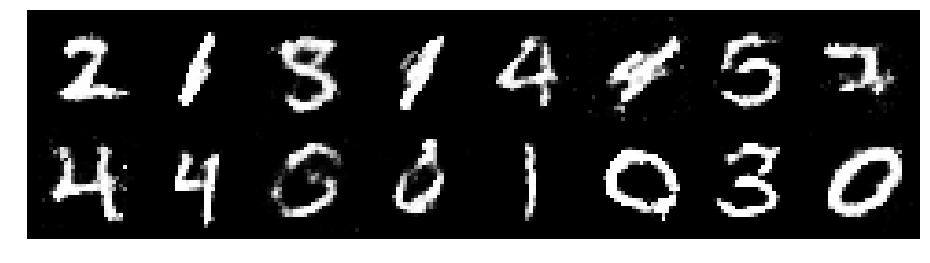

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.2560, Generator Loss: 0.9819
D(x): 0.5580, D(G(z)): 0.4287


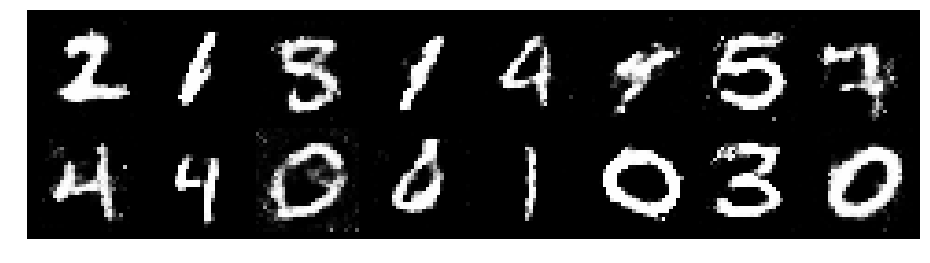

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.2932, Generator Loss: 0.8040
D(x): 0.5540, D(G(z)): 0.4640


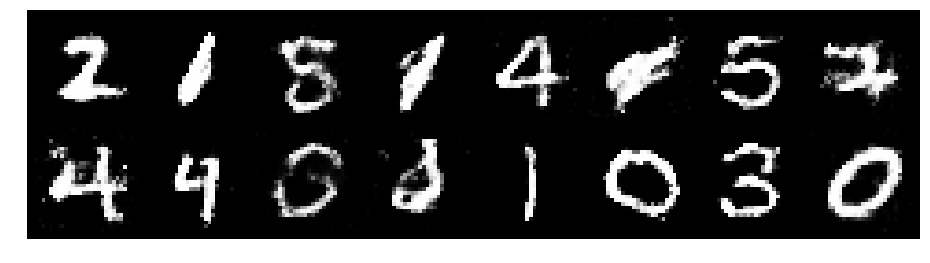

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.2320, Generator Loss: 0.9607
D(x): 0.5541, D(G(z)): 0.4254


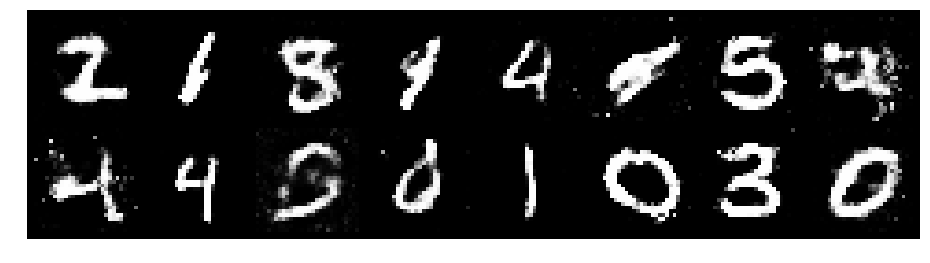

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.3419, Generator Loss: 0.7644
D(x): 0.5255, D(G(z)): 0.4723


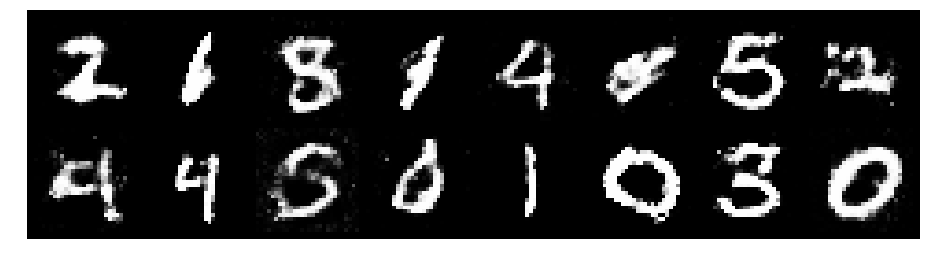

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.2630, Generator Loss: 0.8269
D(x): 0.5505, D(G(z)): 0.4514


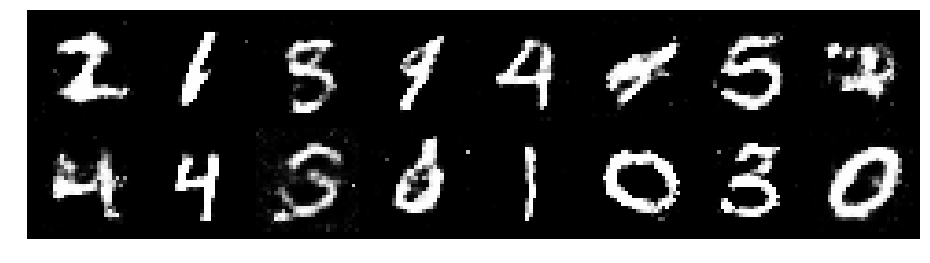

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.3182, Generator Loss: 0.8829
D(x): 0.5499, D(G(z)): 0.4540


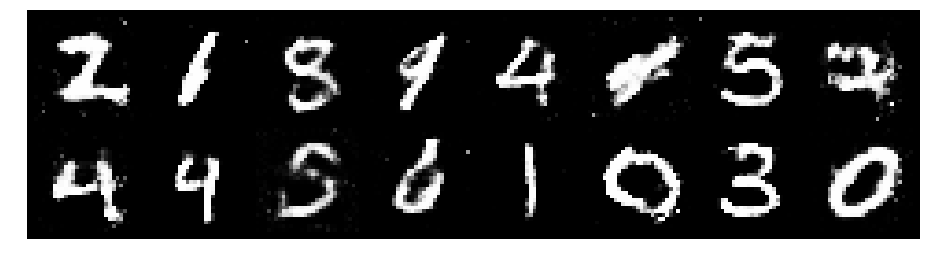

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.3132, Generator Loss: 0.8139
D(x): 0.5756, D(G(z)): 0.4753


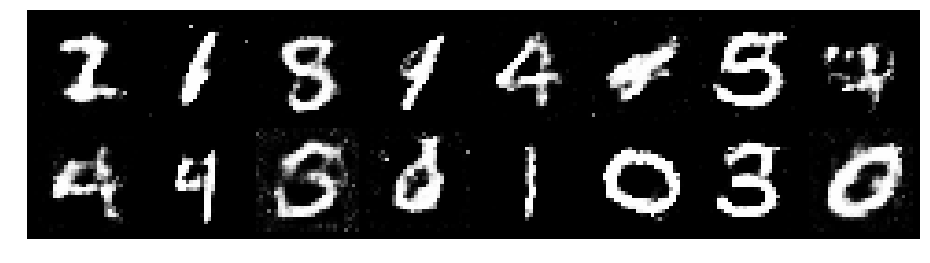

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.2379, Generator Loss: 0.9539
D(x): 0.5557, D(G(z)): 0.4139


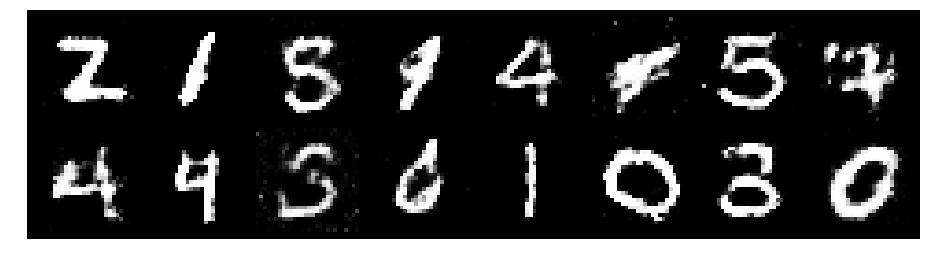

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.3281, Generator Loss: 0.9265
D(x): 0.5694, D(G(z)): 0.4607


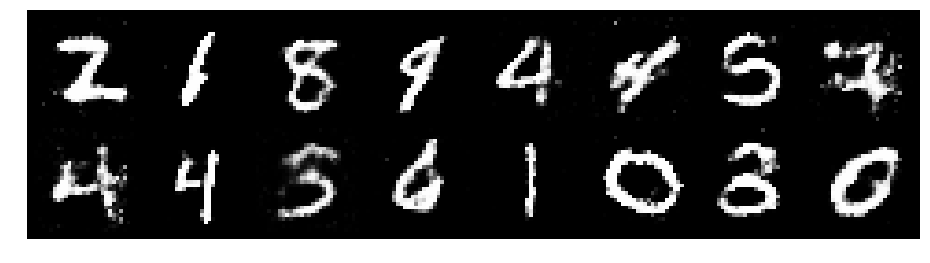

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.3336, Generator Loss: 0.9085
D(x): 0.5173, D(G(z)): 0.4432


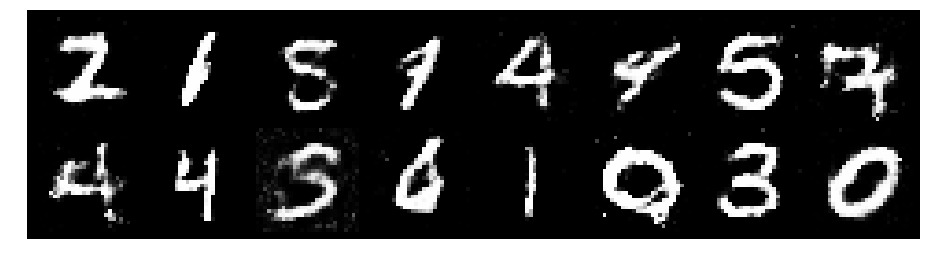

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 1.2490, Generator Loss: 0.8941
D(x): 0.5633, D(G(z)): 0.4482


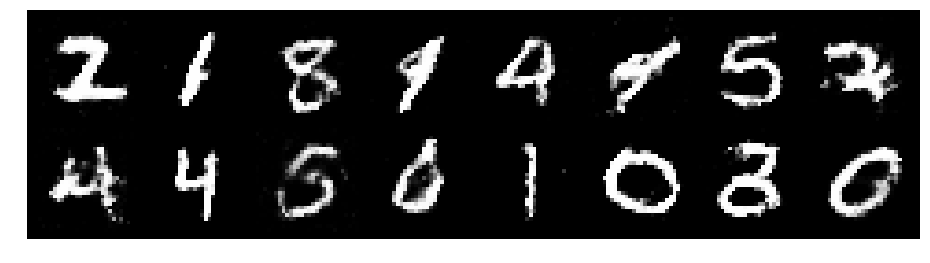

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.2104, Generator Loss: 0.9748
D(x): 0.5651, D(G(z)): 0.4310


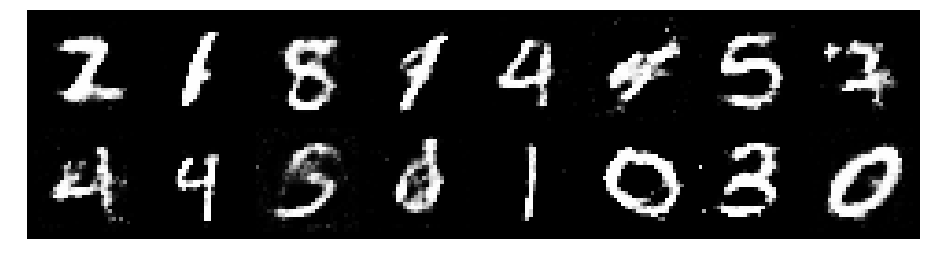

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.2030, Generator Loss: 1.0461
D(x): 0.5532, D(G(z)): 0.4036


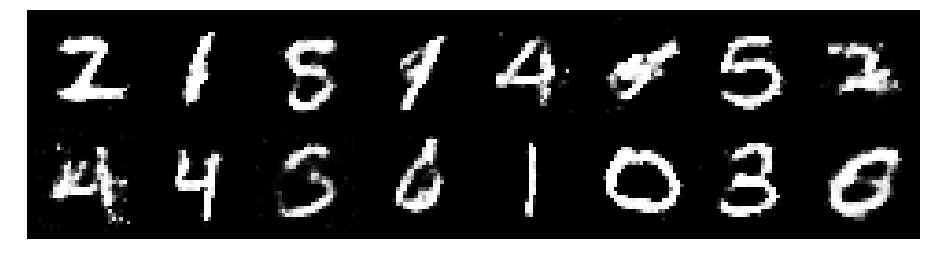

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.2441, Generator Loss: 0.9189
D(x): 0.5706, D(G(z)): 0.4424


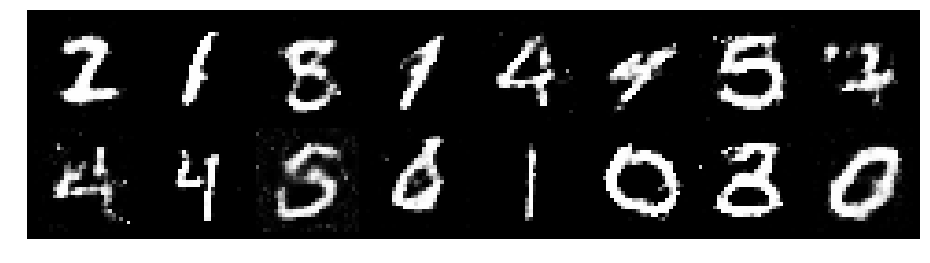

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.3514, Generator Loss: 0.8229
D(x): 0.5274, D(G(z)): 0.4507


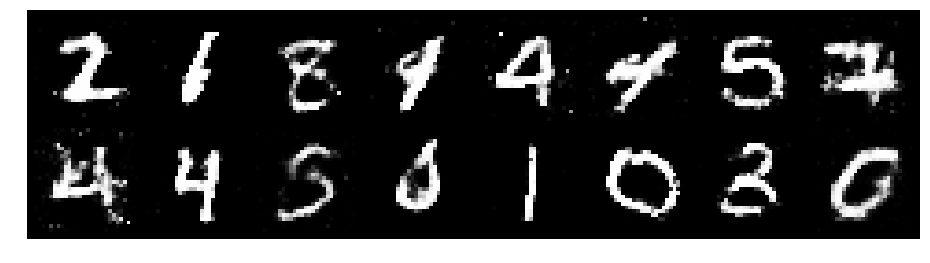

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.3204, Generator Loss: 0.8772
D(x): 0.5200, D(G(z)): 0.4506


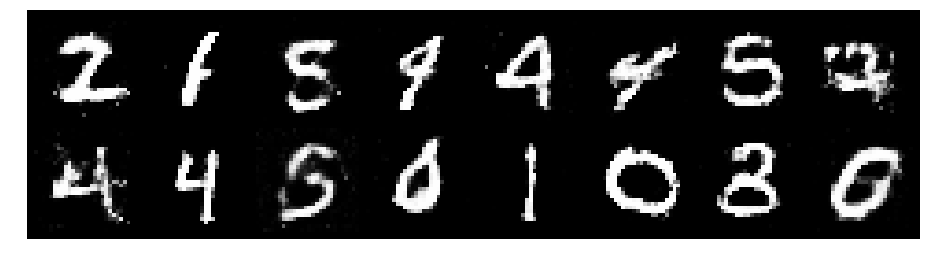

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.2480, Generator Loss: 0.8164
D(x): 0.5243, D(G(z)): 0.4173


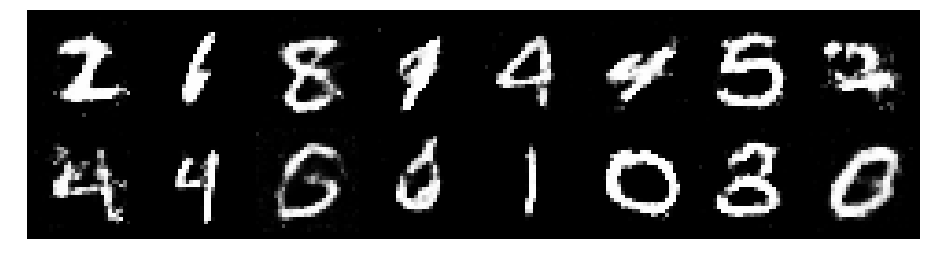

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 1.3124, Generator Loss: 0.8419
D(x): 0.5489, D(G(z)): 0.4728


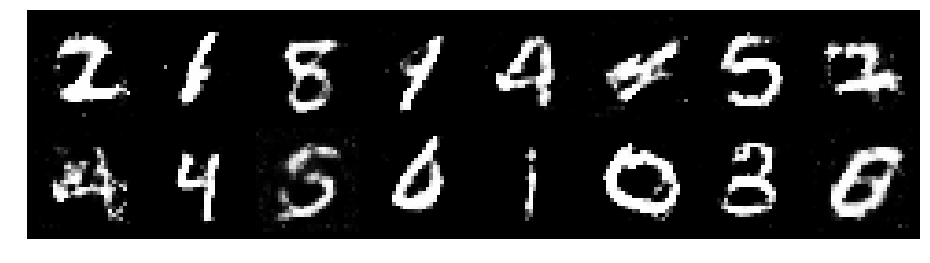

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.1606, Generator Loss: 0.8654
D(x): 0.5623, D(G(z)): 0.4078


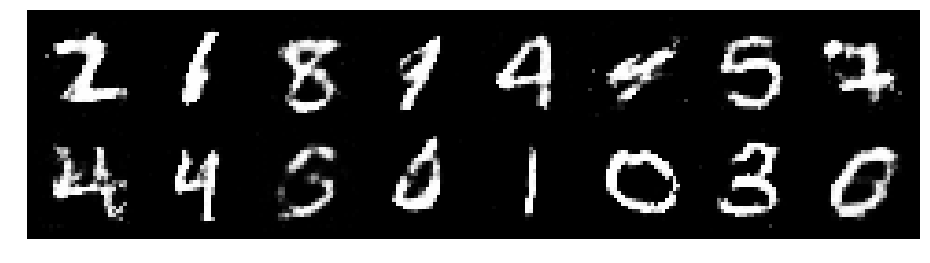

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.3406, Generator Loss: 0.9083
D(x): 0.5324, D(G(z)): 0.4543


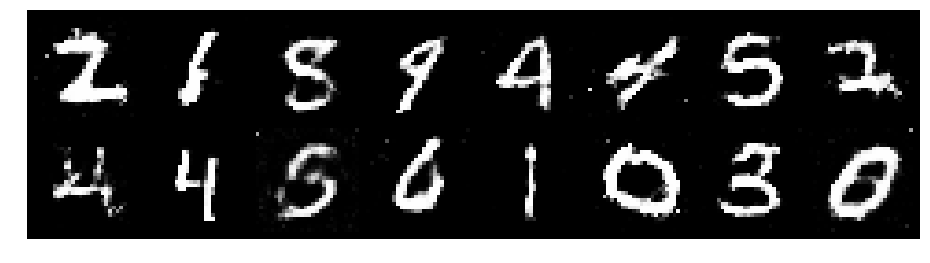

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.2719, Generator Loss: 0.8299
D(x): 0.5514, D(G(z)): 0.4437


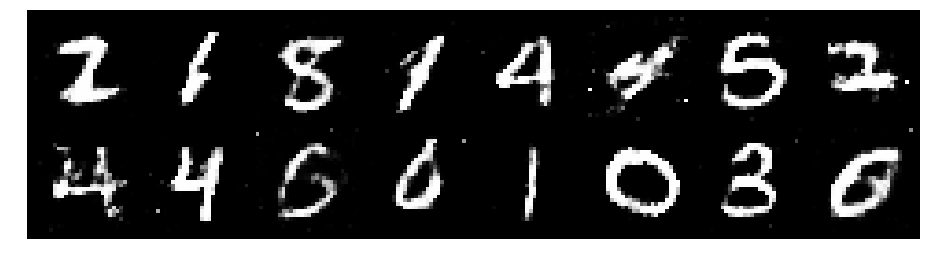

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 1.3211, Generator Loss: 0.9561
D(x): 0.5727, D(G(z)): 0.4804


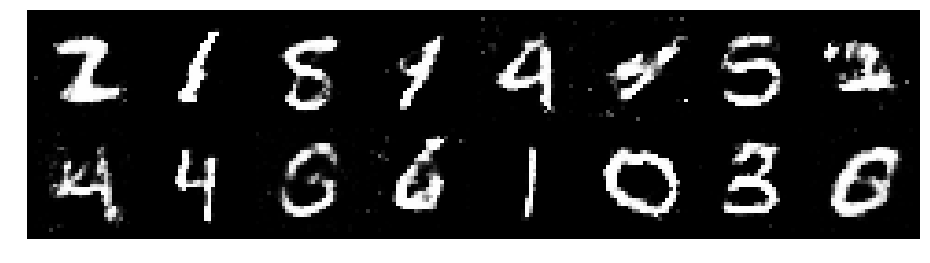

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.3904, Generator Loss: 0.8178
D(x): 0.5104, D(G(z)): 0.4761


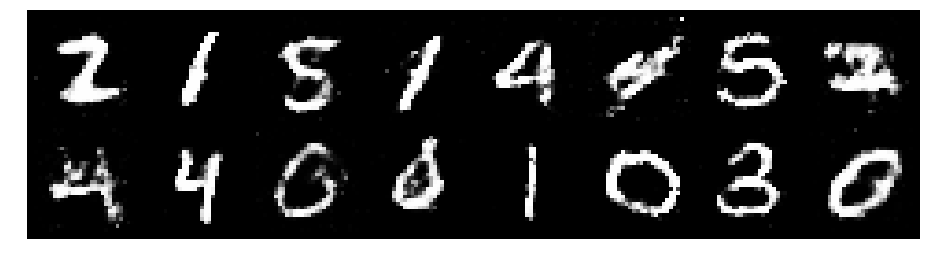

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.3130, Generator Loss: 0.8281
D(x): 0.5521, D(G(z)): 0.4710


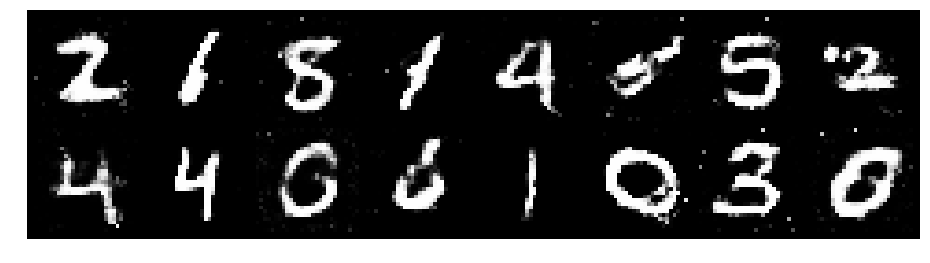

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.3322, Generator Loss: 0.7810
D(x): 0.5574, D(G(z)): 0.4898


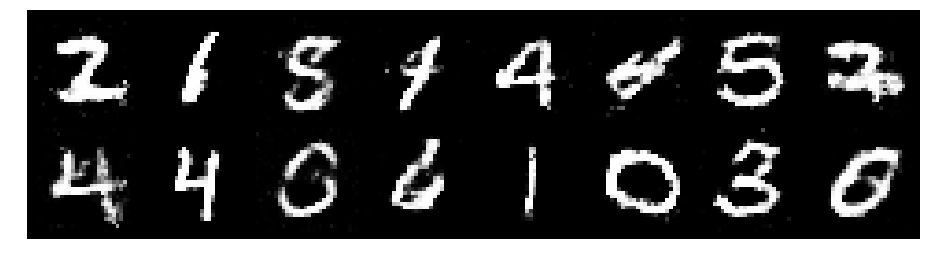

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.1453, Generator Loss: 0.9068
D(x): 0.6074, D(G(z)): 0.4347


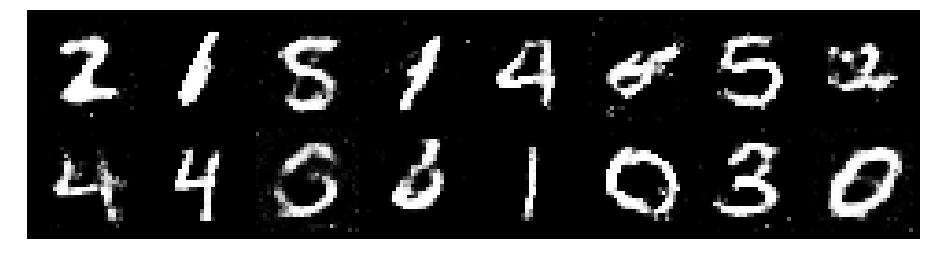

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.2220, Generator Loss: 0.8992
D(x): 0.5619, D(G(z)): 0.4352


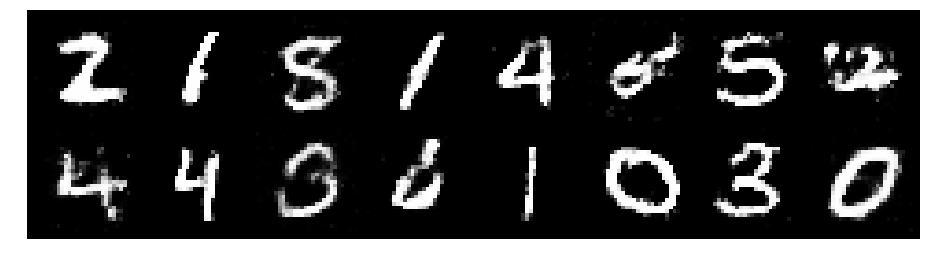

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.2701, Generator Loss: 0.9570
D(x): 0.5837, D(G(z)): 0.4488


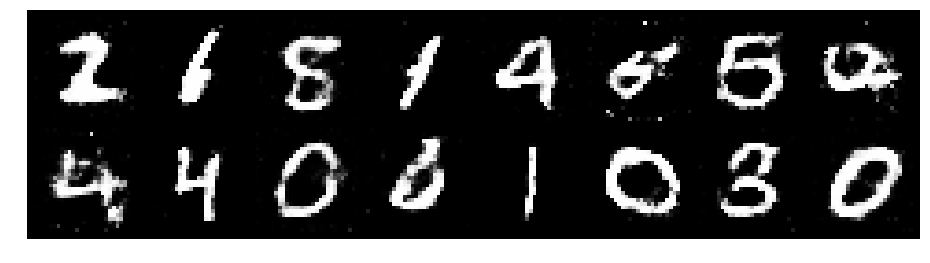

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.1921, Generator Loss: 0.8690
D(x): 0.5771, D(G(z)): 0.4161


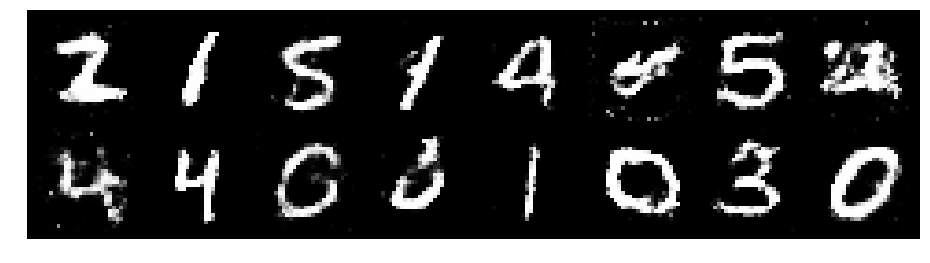

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.2572, Generator Loss: 0.8552
D(x): 0.5821, D(G(z)): 0.4684


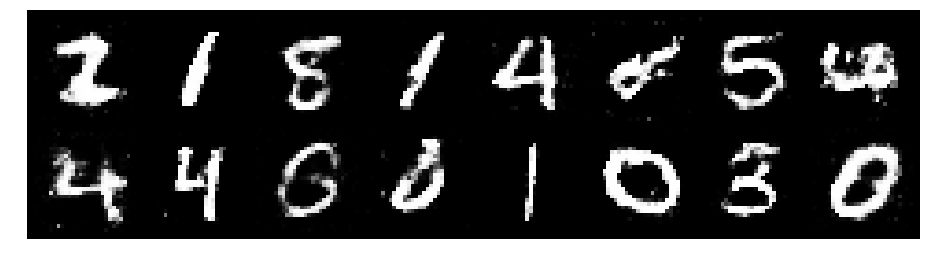

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.2346, Generator Loss: 0.8775
D(x): 0.5425, D(G(z)): 0.4242


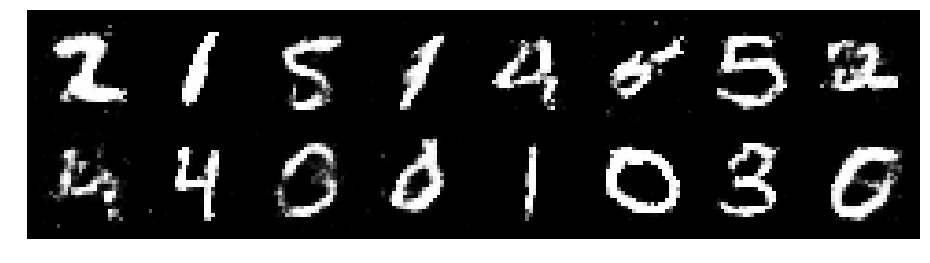

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.2945, Generator Loss: 0.8948
D(x): 0.5187, D(G(z)): 0.4334


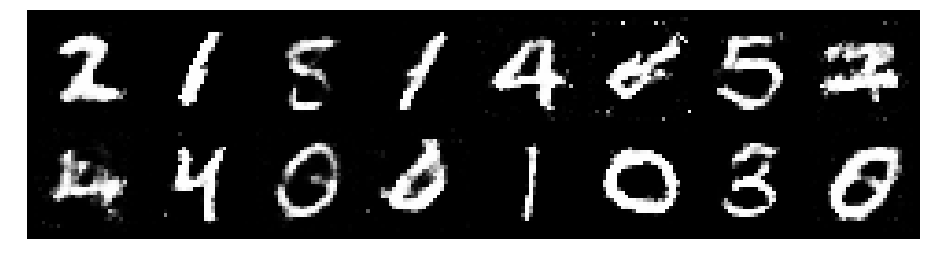

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.2657, Generator Loss: 0.8416
D(x): 0.5543, D(G(z)): 0.4503


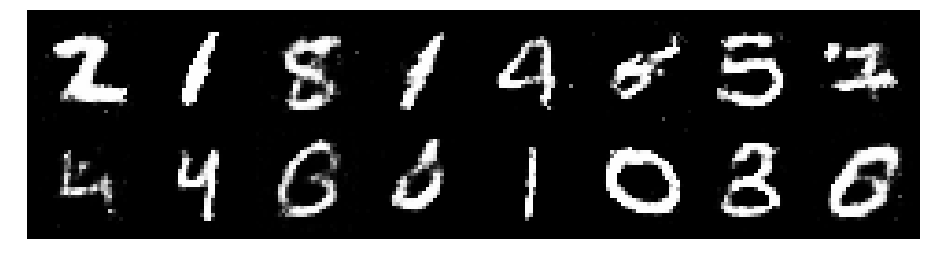

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.2905, Generator Loss: 0.9391
D(x): 0.5311, D(G(z)): 0.4355


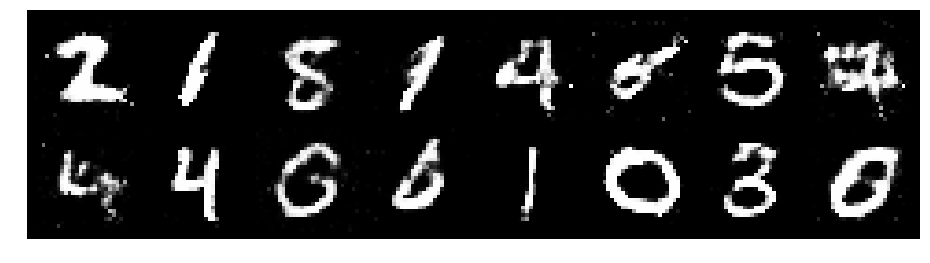

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.2782, Generator Loss: 0.8031
D(x): 0.5555, D(G(z)): 0.4684


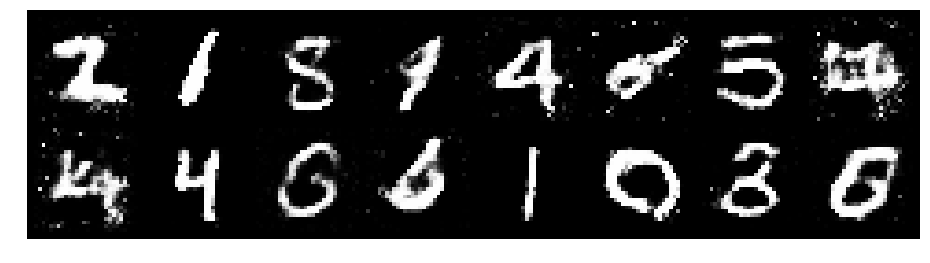

Epoch: [151/200], Batch Num: [0/600]
Discriminator Loss: 1.1574, Generator Loss: 0.9460
D(x): 0.5902, D(G(z)): 0.4277


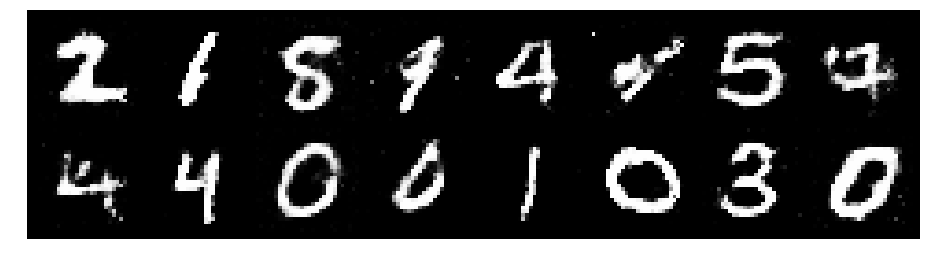

Epoch: [151/200], Batch Num: [100/600]
Discriminator Loss: 1.2291, Generator Loss: 0.7949
D(x): 0.5410, D(G(z)): 0.4289


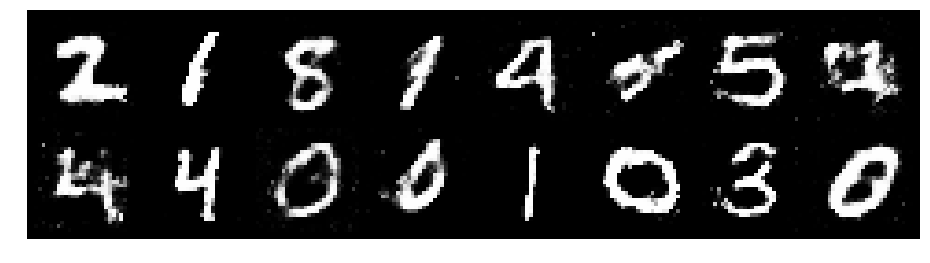

Epoch: [151/200], Batch Num: [200/600]
Discriminator Loss: 1.1937, Generator Loss: 0.9369
D(x): 0.5877, D(G(z)): 0.4340


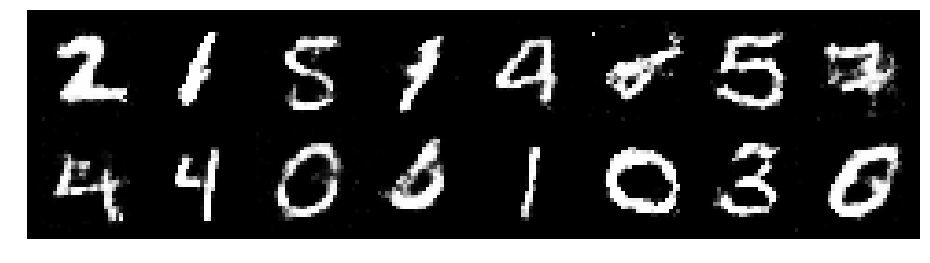

Epoch: [151/200], Batch Num: [300/600]
Discriminator Loss: 1.2137, Generator Loss: 0.8671
D(x): 0.5788, D(G(z)): 0.4532


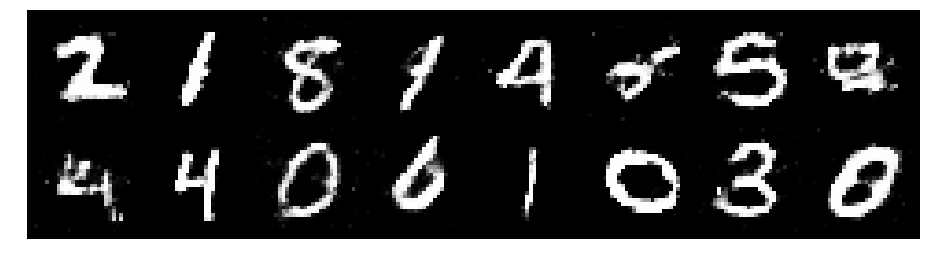

Epoch: [151/200], Batch Num: [400/600]
Discriminator Loss: 1.2755, Generator Loss: 0.8145
D(x): 0.5662, D(G(z)): 0.4736


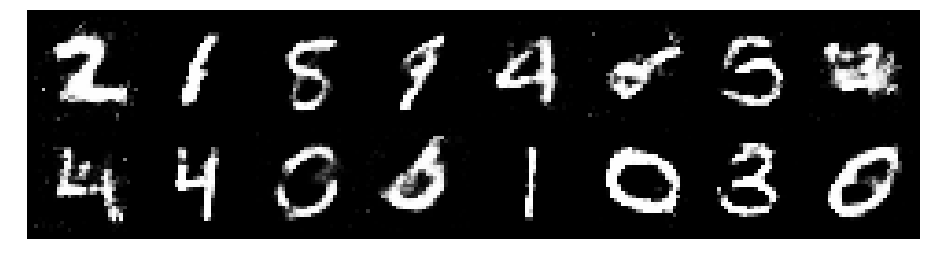

Epoch: [151/200], Batch Num: [500/600]
Discriminator Loss: 1.2778, Generator Loss: 0.8506
D(x): 0.5440, D(G(z)): 0.4482


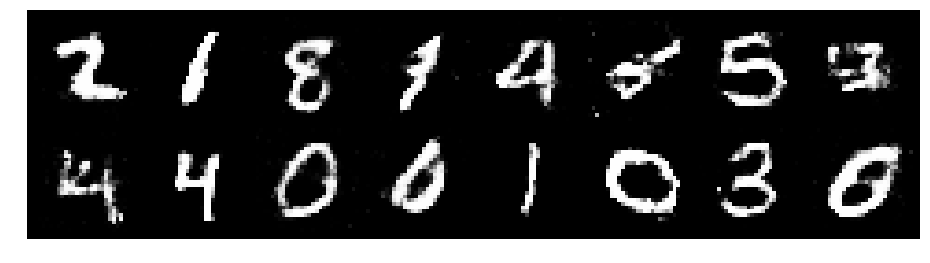

Epoch: [152/200], Batch Num: [0/600]
Discriminator Loss: 1.3240, Generator Loss: 0.8701
D(x): 0.5478, D(G(z)): 0.4655


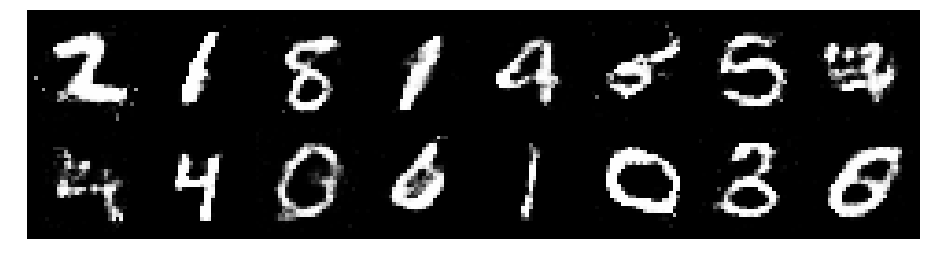

Epoch: [152/200], Batch Num: [100/600]
Discriminator Loss: 1.3384, Generator Loss: 0.7965
D(x): 0.5225, D(G(z)): 0.4623


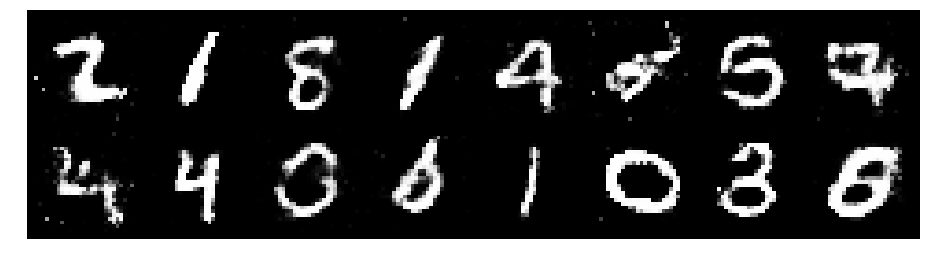

Epoch: [152/200], Batch Num: [200/600]
Discriminator Loss: 1.3095, Generator Loss: 0.8867
D(x): 0.5092, D(G(z)): 0.4360


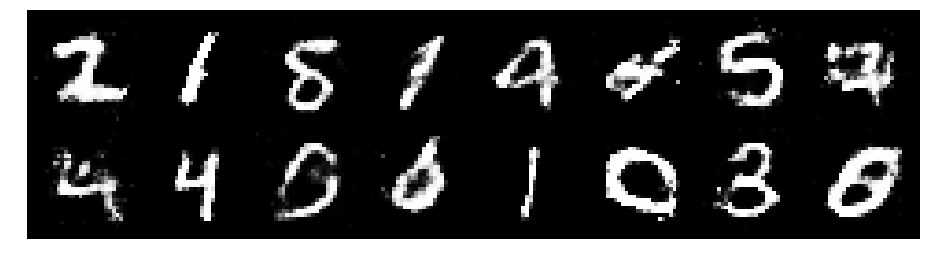

Epoch: [152/200], Batch Num: [300/600]
Discriminator Loss: 1.4073, Generator Loss: 0.8530
D(x): 0.5360, D(G(z)): 0.4930


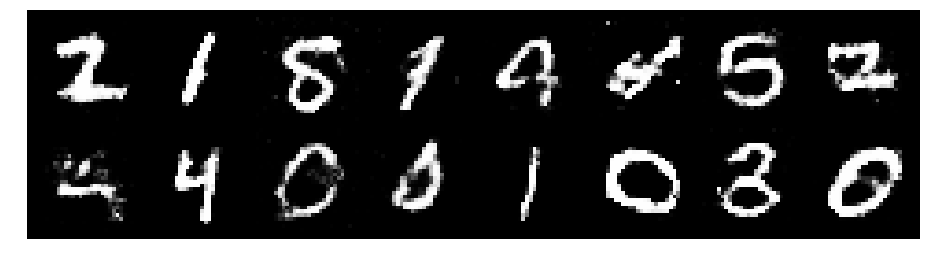

Epoch: [152/200], Batch Num: [400/600]
Discriminator Loss: 1.3682, Generator Loss: 0.8706
D(x): 0.5137, D(G(z)): 0.4378


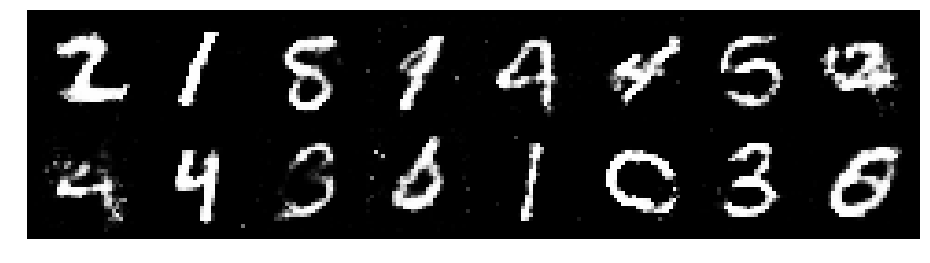

Epoch: [152/200], Batch Num: [500/600]
Discriminator Loss: 1.3309, Generator Loss: 0.8557
D(x): 0.5083, D(G(z)): 0.4463


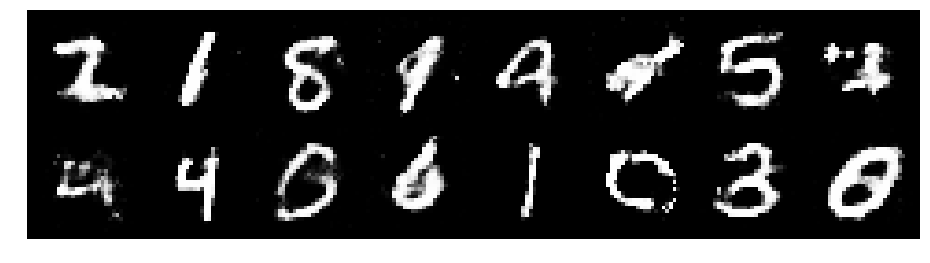

Epoch: [153/200], Batch Num: [0/600]
Discriminator Loss: 1.2426, Generator Loss: 0.8545
D(x): 0.5548, D(G(z)): 0.4516


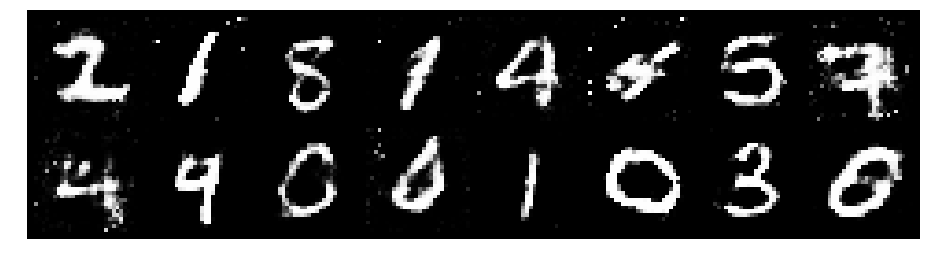

Epoch: [153/200], Batch Num: [100/600]
Discriminator Loss: 1.2379, Generator Loss: 0.9660
D(x): 0.5284, D(G(z)): 0.3948


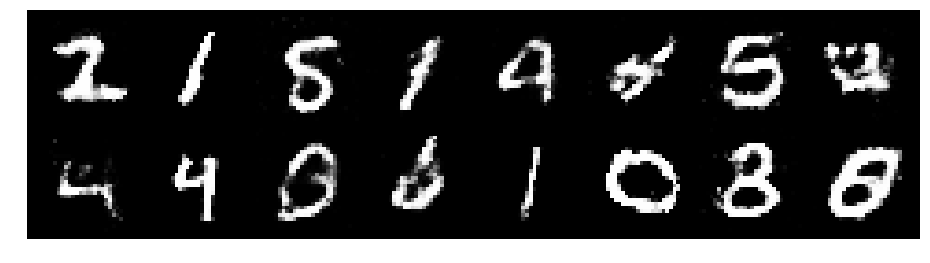

Epoch: [153/200], Batch Num: [200/600]
Discriminator Loss: 1.1705, Generator Loss: 0.8846
D(x): 0.5766, D(G(z)): 0.4268


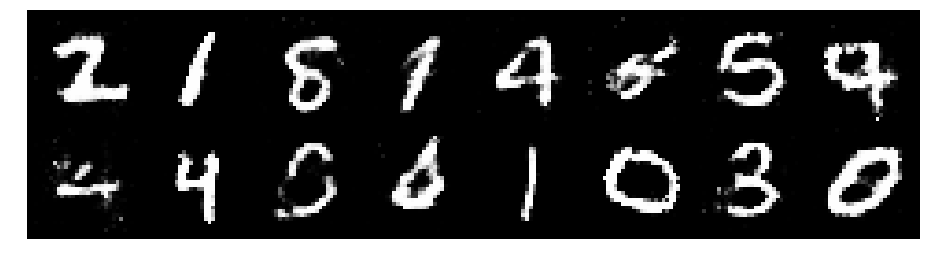

Epoch: [153/200], Batch Num: [300/600]
Discriminator Loss: 1.2725, Generator Loss: 0.9094
D(x): 0.5258, D(G(z)): 0.4236


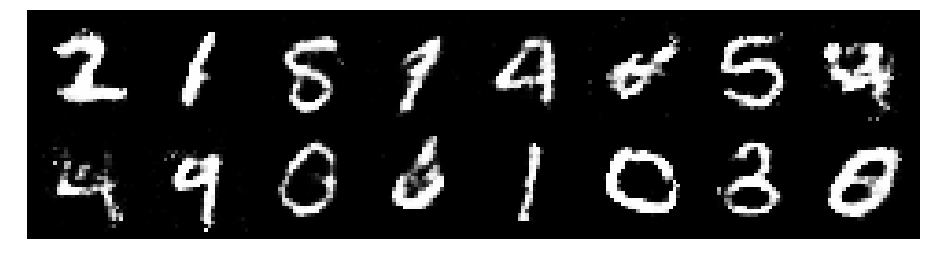

Epoch: [153/200], Batch Num: [400/600]
Discriminator Loss: 1.3076, Generator Loss: 0.7139
D(x): 0.5541, D(G(z)): 0.4790


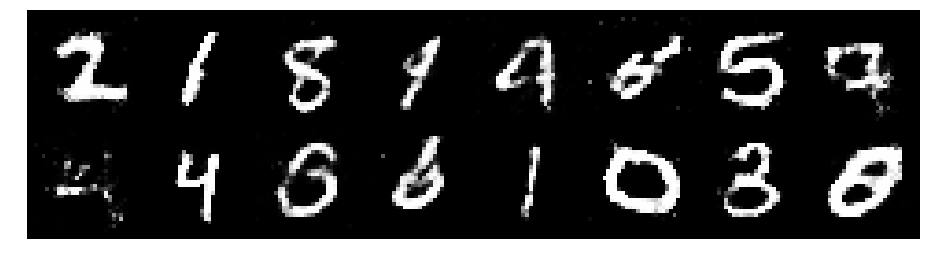

Epoch: [153/200], Batch Num: [500/600]
Discriminator Loss: 1.3202, Generator Loss: 0.8440
D(x): 0.5487, D(G(z)): 0.4766


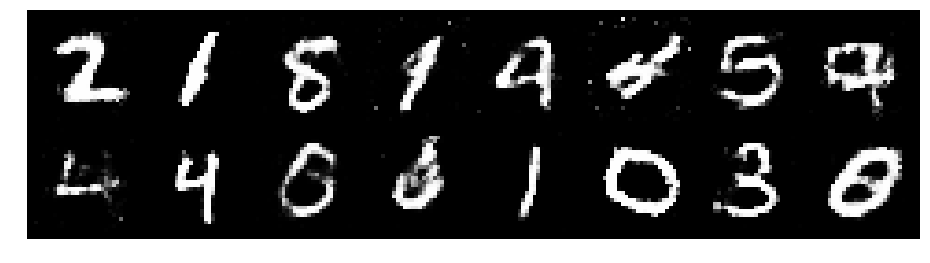

Epoch: [154/200], Batch Num: [0/600]
Discriminator Loss: 1.3409, Generator Loss: 0.9741
D(x): 0.5878, D(G(z)): 0.4886


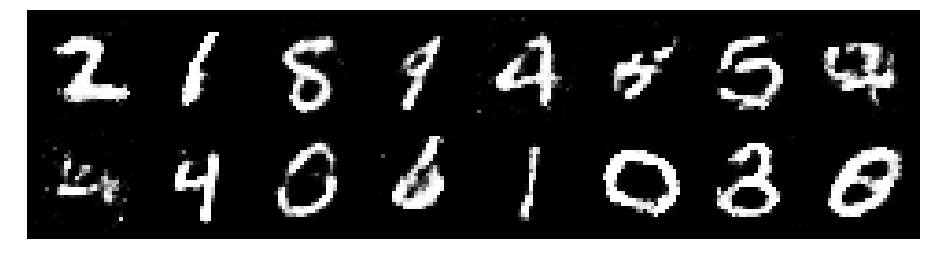

Epoch: [154/200], Batch Num: [100/600]
Discriminator Loss: 1.2025, Generator Loss: 0.9900
D(x): 0.5599, D(G(z)): 0.4102


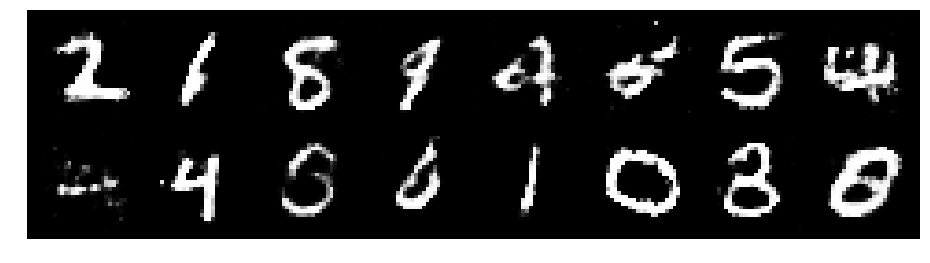

Epoch: [154/200], Batch Num: [200/600]
Discriminator Loss: 1.4226, Generator Loss: 0.9512
D(x): 0.5227, D(G(z)): 0.4673


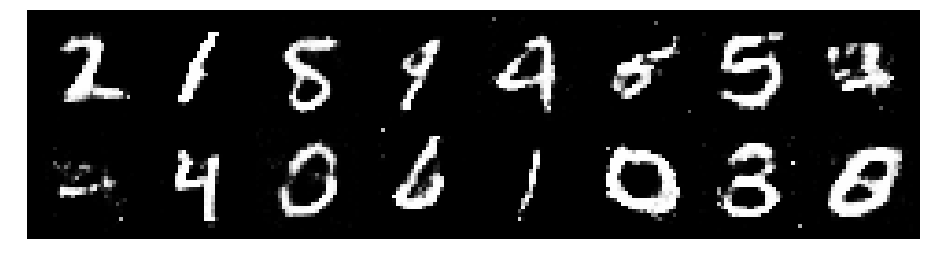

Epoch: [154/200], Batch Num: [300/600]
Discriminator Loss: 1.3336, Generator Loss: 0.8898
D(x): 0.4999, D(G(z)): 0.4235


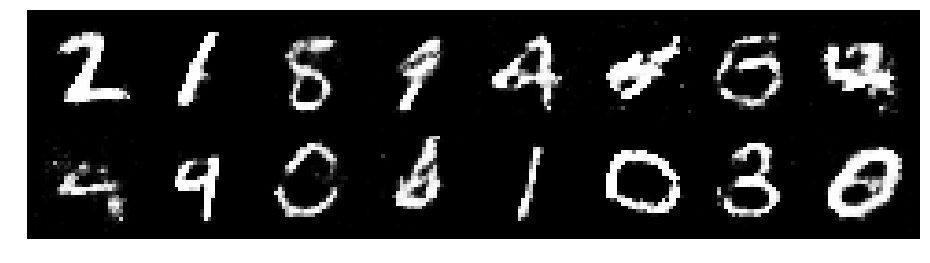

Epoch: [154/200], Batch Num: [400/600]
Discriminator Loss: 1.3440, Generator Loss: 0.8791
D(x): 0.5408, D(G(z)): 0.4645


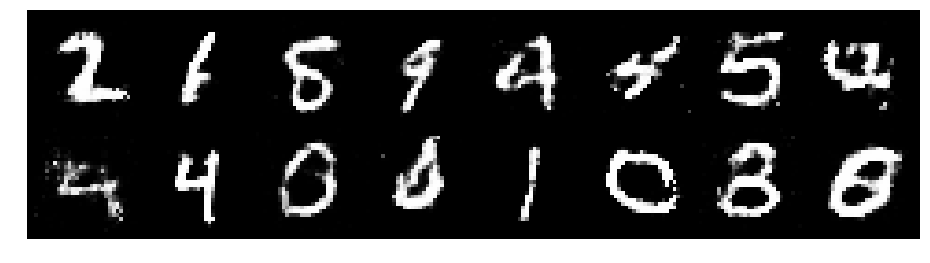

Epoch: [154/200], Batch Num: [500/600]
Discriminator Loss: 1.4489, Generator Loss: 0.7575
D(x): 0.5464, D(G(z)): 0.5149


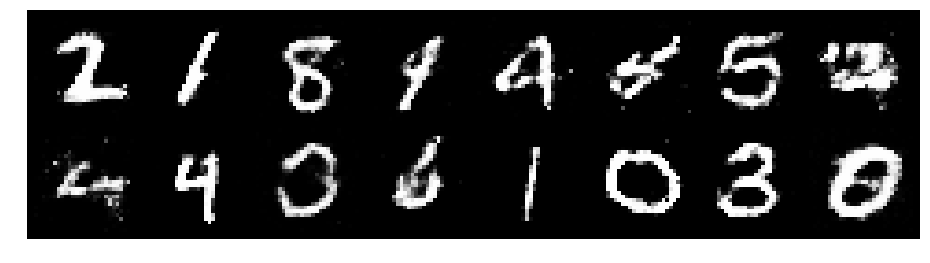

Epoch: [155/200], Batch Num: [0/600]
Discriminator Loss: 1.3546, Generator Loss: 0.7414
D(x): 0.5149, D(G(z)): 0.4717


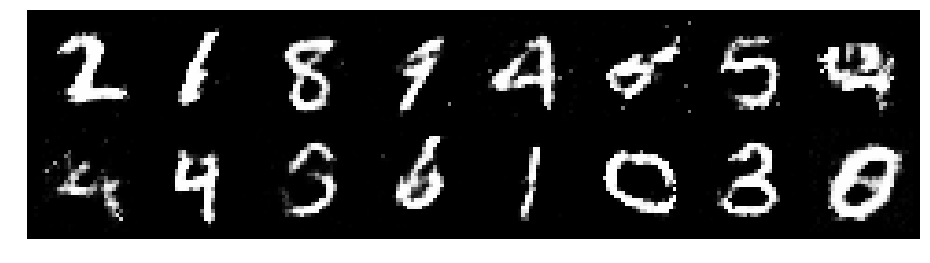

Epoch: [155/200], Batch Num: [100/600]
Discriminator Loss: 1.4035, Generator Loss: 0.8632
D(x): 0.5172, D(G(z)): 0.4677


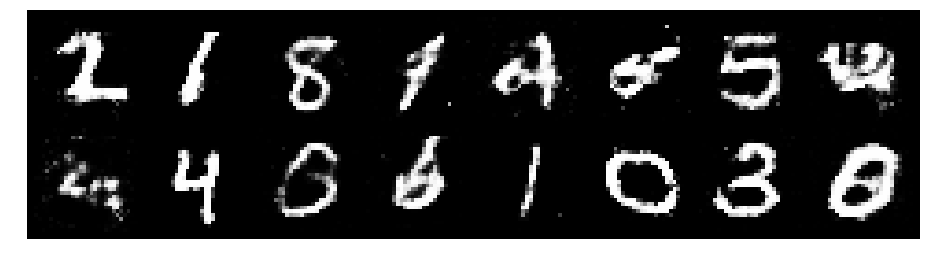

Epoch: [155/200], Batch Num: [200/600]
Discriminator Loss: 1.3817, Generator Loss: 0.8118
D(x): 0.5304, D(G(z)): 0.4654


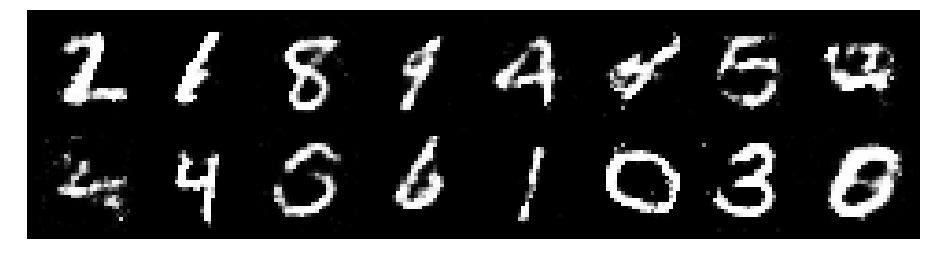

Epoch: [155/200], Batch Num: [300/600]
Discriminator Loss: 1.3790, Generator Loss: 0.8246
D(x): 0.5436, D(G(z)): 0.4858


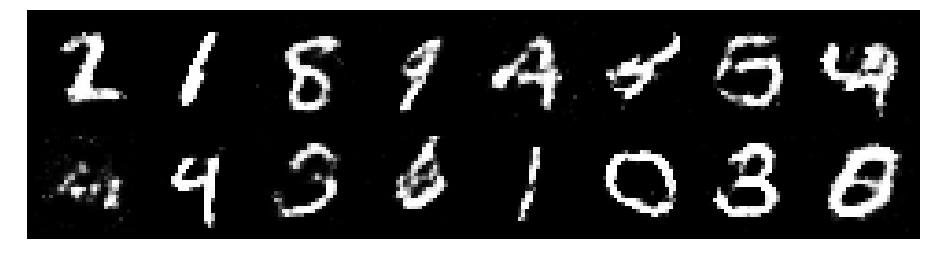

Epoch: [155/200], Batch Num: [400/600]
Discriminator Loss: 1.2603, Generator Loss: 0.8141
D(x): 0.5618, D(G(z)): 0.4636


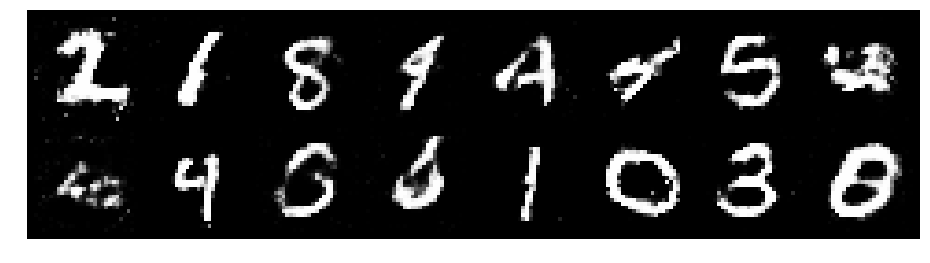

Epoch: [155/200], Batch Num: [500/600]
Discriminator Loss: 1.2267, Generator Loss: 0.9191
D(x): 0.5554, D(G(z)): 0.4203


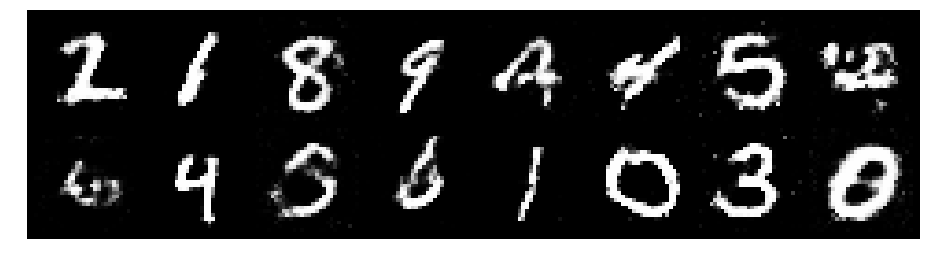

Epoch: [156/200], Batch Num: [0/600]
Discriminator Loss: 1.2236, Generator Loss: 0.9761
D(x): 0.5515, D(G(z)): 0.4097


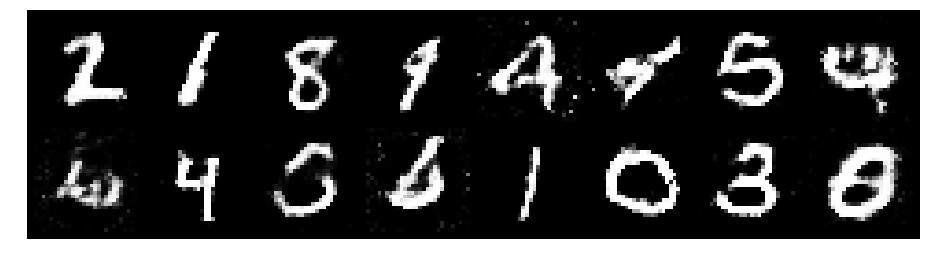

Epoch: [156/200], Batch Num: [100/600]
Discriminator Loss: 1.2306, Generator Loss: 0.8507
D(x): 0.5533, D(G(z)): 0.4364


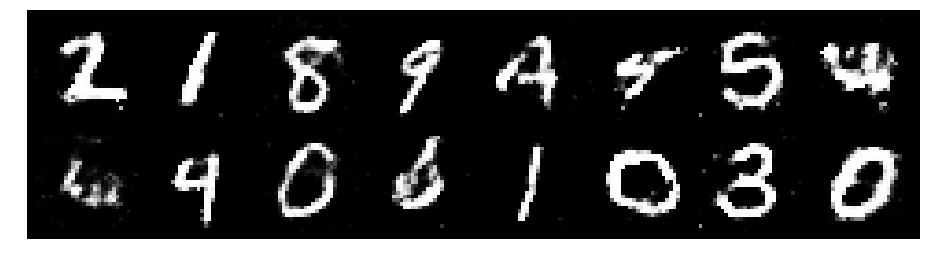

Epoch: [156/200], Batch Num: [200/600]
Discriminator Loss: 1.3344, Generator Loss: 0.7900
D(x): 0.5415, D(G(z)): 0.4672


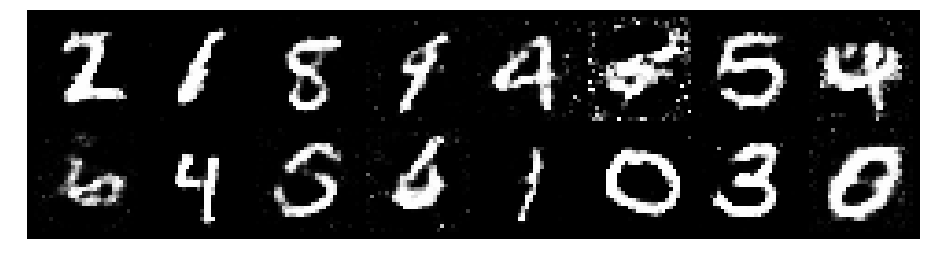

Epoch: [156/200], Batch Num: [300/600]
Discriminator Loss: 1.3692, Generator Loss: 0.7508
D(x): 0.5328, D(G(z)): 0.4840


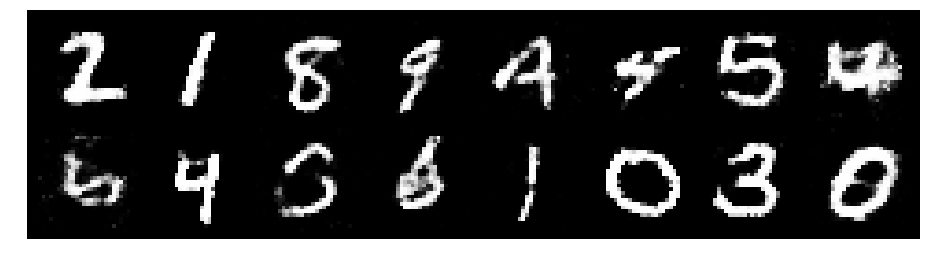

Epoch: [156/200], Batch Num: [400/600]
Discriminator Loss: 1.2579, Generator Loss: 0.9269
D(x): 0.5505, D(G(z)): 0.4317


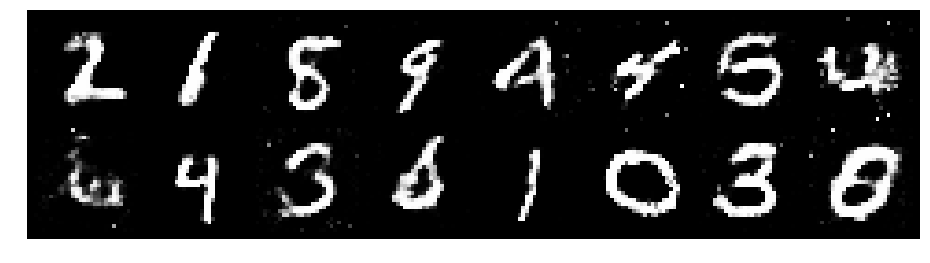

Epoch: [156/200], Batch Num: [500/600]
Discriminator Loss: 1.2043, Generator Loss: 0.8607
D(x): 0.5695, D(G(z)): 0.4221


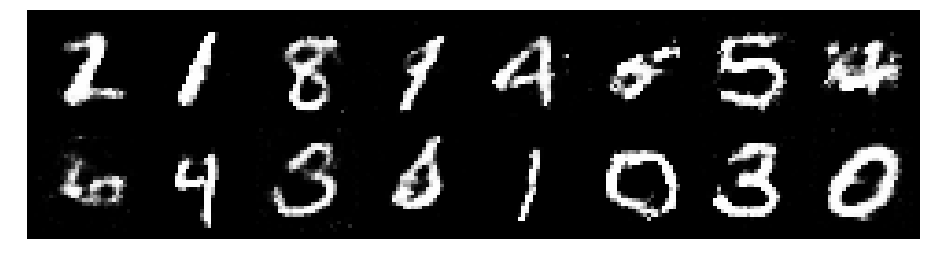

Epoch: [157/200], Batch Num: [0/600]
Discriminator Loss: 1.3375, Generator Loss: 0.9085
D(x): 0.5452, D(G(z)): 0.4412


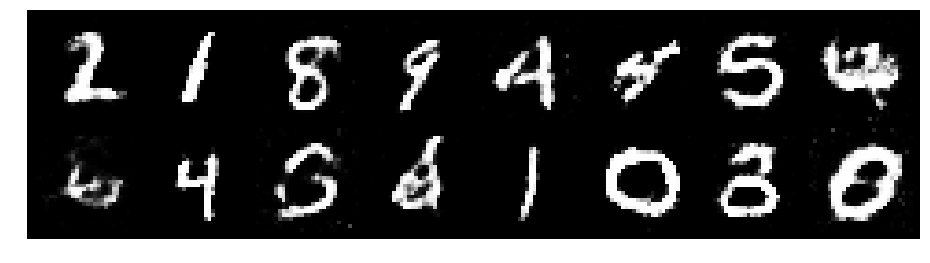

Epoch: [157/200], Batch Num: [100/600]
Discriminator Loss: 1.2805, Generator Loss: 0.8712
D(x): 0.5620, D(G(z)): 0.4483


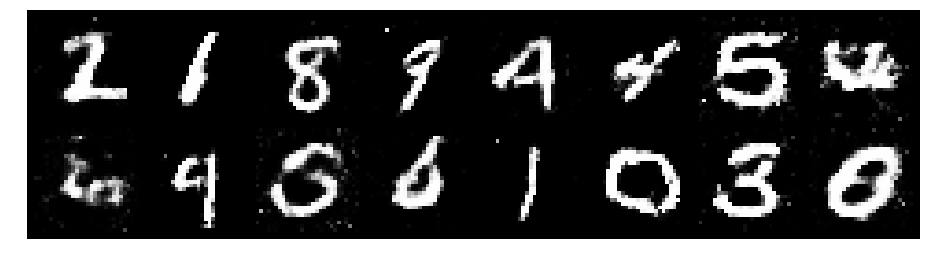

Epoch: [157/200], Batch Num: [200/600]
Discriminator Loss: 1.2389, Generator Loss: 0.9321
D(x): 0.5784, D(G(z)): 0.4401


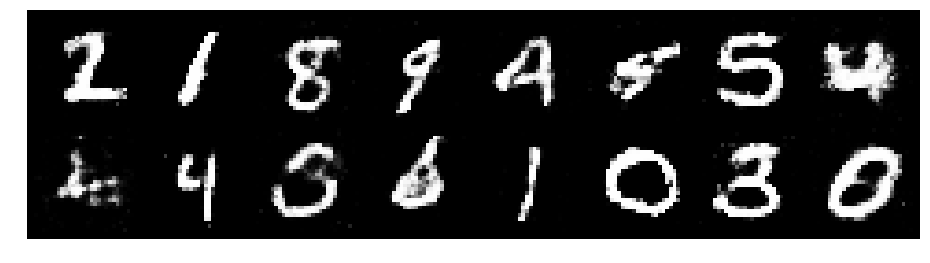

Epoch: [157/200], Batch Num: [300/600]
Discriminator Loss: 1.3788, Generator Loss: 0.7908
D(x): 0.5652, D(G(z)): 0.5154


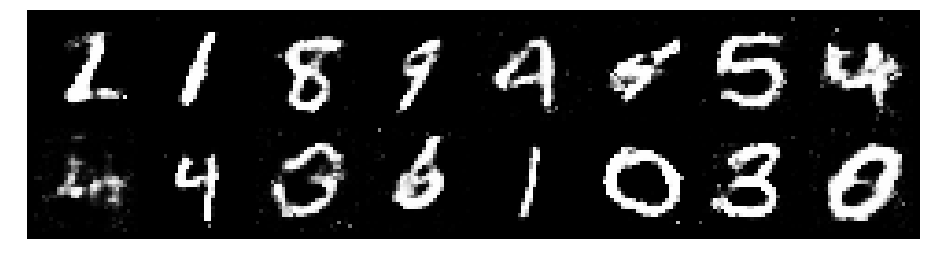

Epoch: [157/200], Batch Num: [400/600]
Discriminator Loss: 1.2885, Generator Loss: 0.9160
D(x): 0.5653, D(G(z)): 0.4622


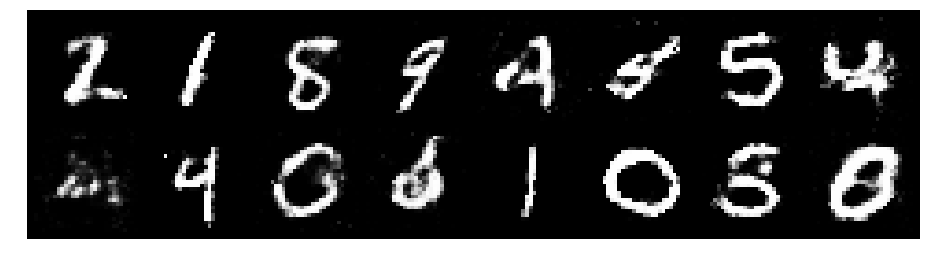

Epoch: [157/200], Batch Num: [500/600]
Discriminator Loss: 1.2983, Generator Loss: 1.0370
D(x): 0.5269, D(G(z)): 0.3898


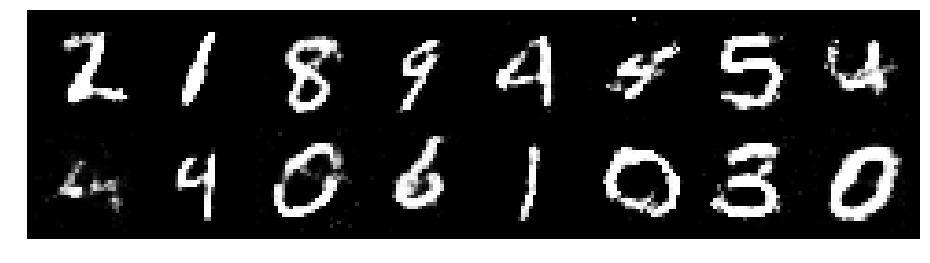

Epoch: [158/200], Batch Num: [0/600]
Discriminator Loss: 1.2908, Generator Loss: 0.9140
D(x): 0.5343, D(G(z)): 0.4326


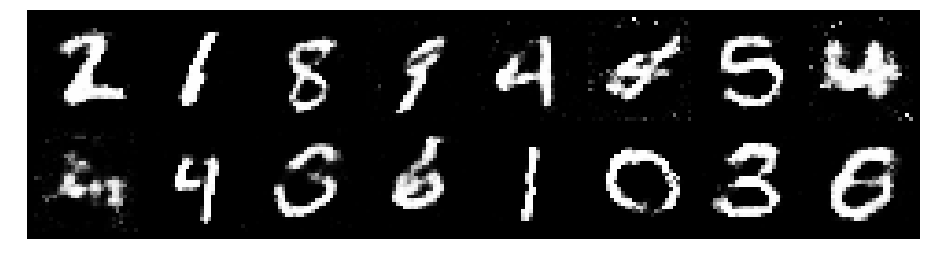

Epoch: [158/200], Batch Num: [100/600]
Discriminator Loss: 1.3172, Generator Loss: 0.9334
D(x): 0.5524, D(G(z)): 0.4347


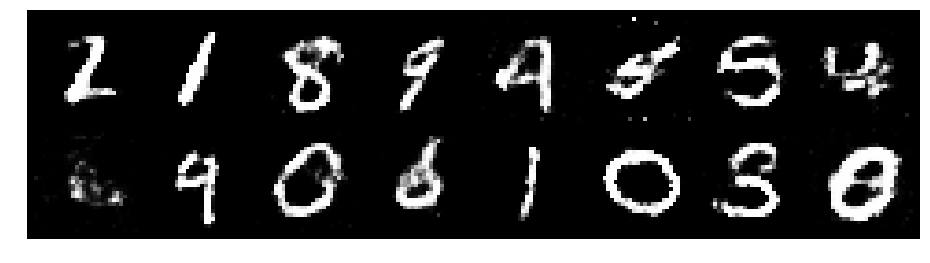

Epoch: [158/200], Batch Num: [200/600]
Discriminator Loss: 1.2937, Generator Loss: 0.8034
D(x): 0.5789, D(G(z)): 0.4865


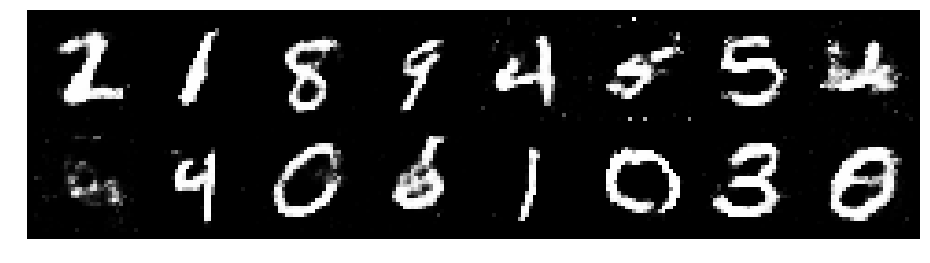

Epoch: [158/200], Batch Num: [300/600]
Discriminator Loss: 1.2984, Generator Loss: 0.8785
D(x): 0.5416, D(G(z)): 0.4375


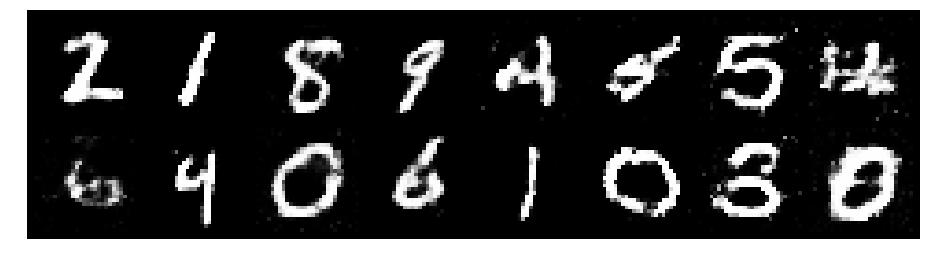

Epoch: [158/200], Batch Num: [400/600]
Discriminator Loss: 1.2491, Generator Loss: 0.9221
D(x): 0.5486, D(G(z)): 0.4264


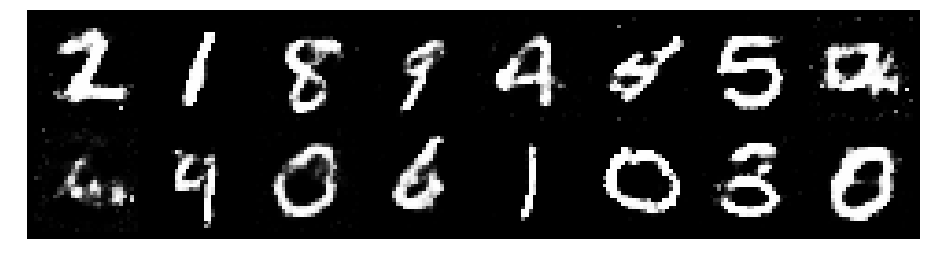

Epoch: [158/200], Batch Num: [500/600]
Discriminator Loss: 1.1710, Generator Loss: 1.0123
D(x): 0.5578, D(G(z)): 0.3957


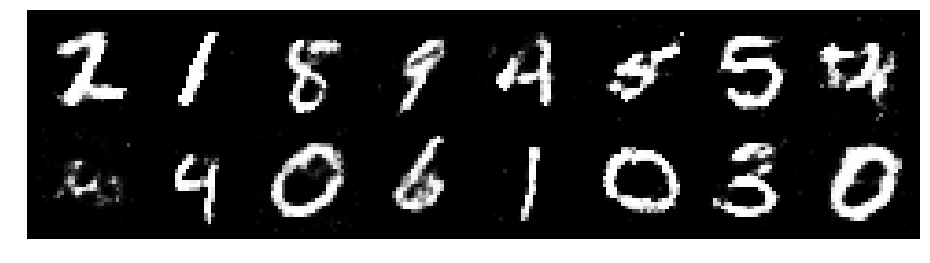

Epoch: [159/200], Batch Num: [0/600]
Discriminator Loss: 1.3093, Generator Loss: 0.9361
D(x): 0.5551, D(G(z)): 0.4452


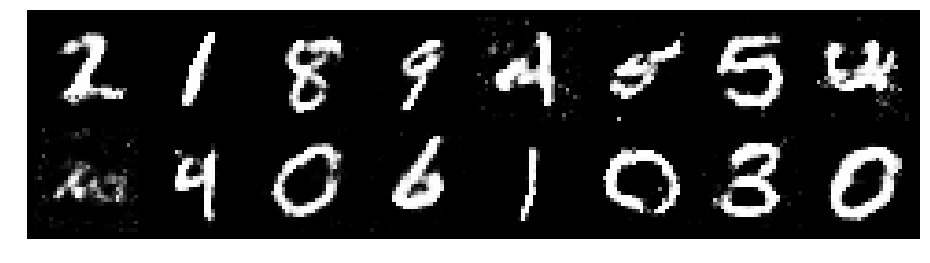

Epoch: [159/200], Batch Num: [100/600]
Discriminator Loss: 1.4147, Generator Loss: 0.9187
D(x): 0.5458, D(G(z)): 0.4770


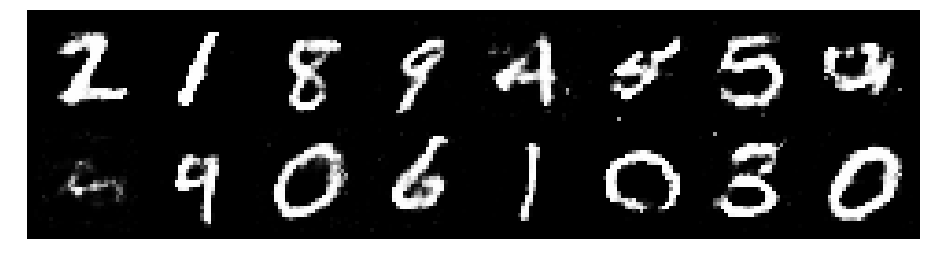

Epoch: [159/200], Batch Num: [200/600]
Discriminator Loss: 1.4283, Generator Loss: 0.9455
D(x): 0.5786, D(G(z)): 0.4887


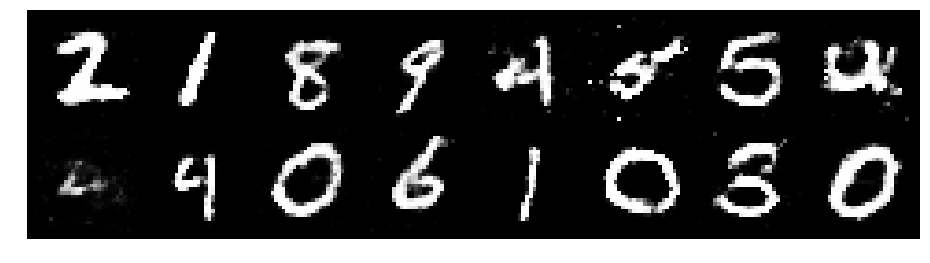

Epoch: [159/200], Batch Num: [300/600]
Discriminator Loss: 1.2761, Generator Loss: 0.7798
D(x): 0.5406, D(G(z)): 0.4336


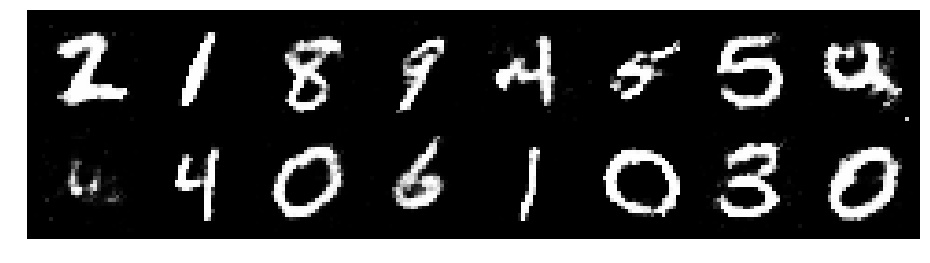

Epoch: [159/200], Batch Num: [400/600]
Discriminator Loss: 1.4254, Generator Loss: 0.9254
D(x): 0.5218, D(G(z)): 0.4789


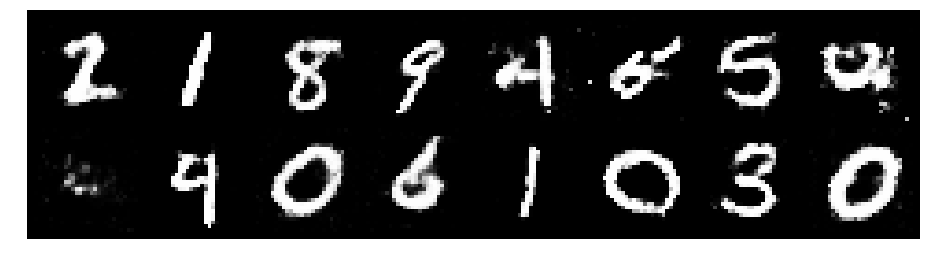

Epoch: [159/200], Batch Num: [500/600]
Discriminator Loss: 1.4316, Generator Loss: 0.9731
D(x): 0.5101, D(G(z)): 0.4465


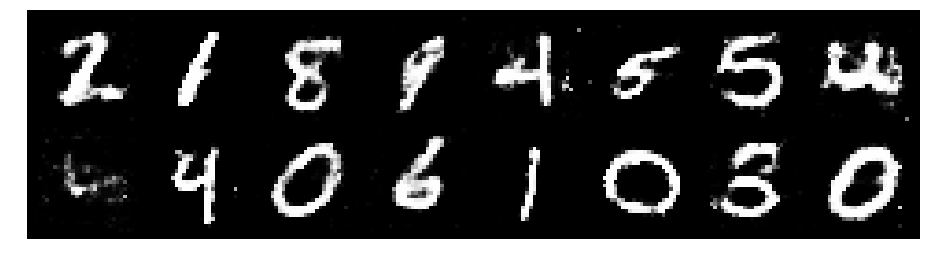

Epoch: [160/200], Batch Num: [0/600]
Discriminator Loss: 1.2420, Generator Loss: 0.9567
D(x): 0.5770, D(G(z)): 0.4397


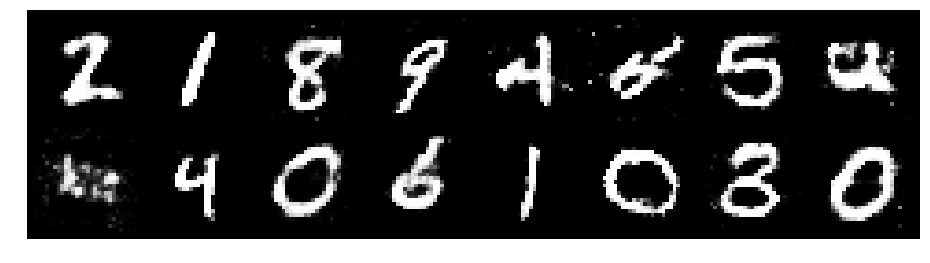

Epoch: [160/200], Batch Num: [100/600]
Discriminator Loss: 1.3235, Generator Loss: 0.9632
D(x): 0.5779, D(G(z)): 0.4742


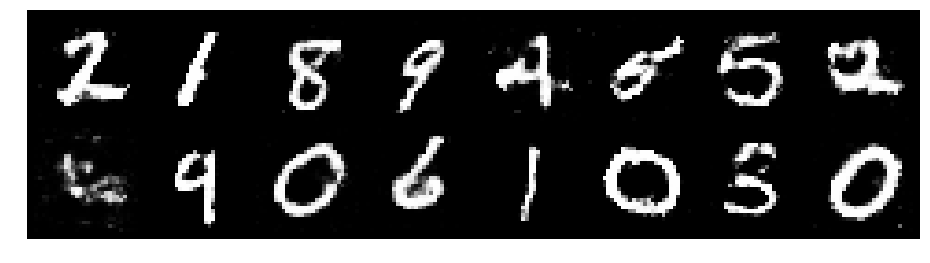

Epoch: [160/200], Batch Num: [200/600]
Discriminator Loss: 1.2754, Generator Loss: 0.9192
D(x): 0.5149, D(G(z)): 0.4201


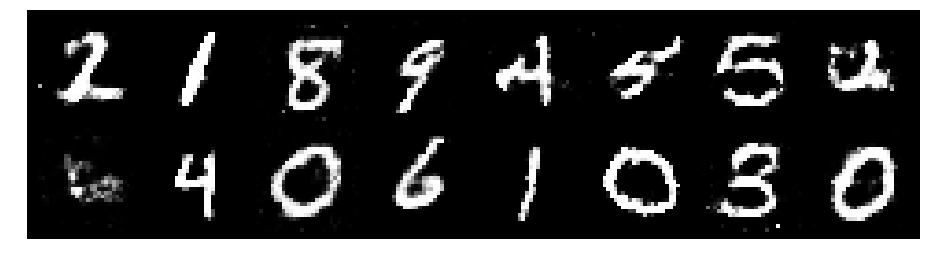

Epoch: [160/200], Batch Num: [300/600]
Discriminator Loss: 1.2227, Generator Loss: 0.9488
D(x): 0.5158, D(G(z)): 0.3928


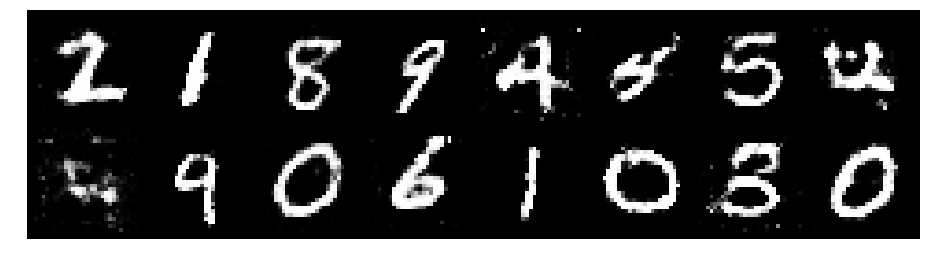

Epoch: [160/200], Batch Num: [400/600]
Discriminator Loss: 1.2549, Generator Loss: 0.8594
D(x): 0.5477, D(G(z)): 0.4403


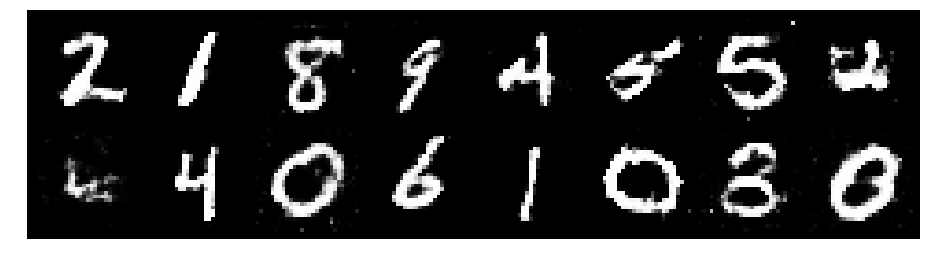

Epoch: [160/200], Batch Num: [500/600]
Discriminator Loss: 1.2101, Generator Loss: 0.8500
D(x): 0.5662, D(G(z)): 0.4362


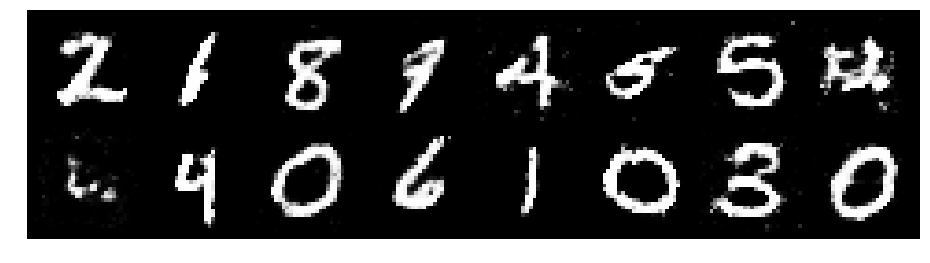

Epoch: [161/200], Batch Num: [0/600]
Discriminator Loss: 1.2973, Generator Loss: 0.9609
D(x): 0.5470, D(G(z)): 0.4470


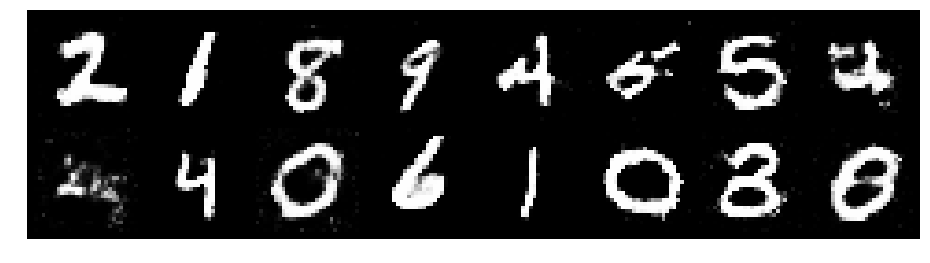

Epoch: [161/200], Batch Num: [100/600]
Discriminator Loss: 1.3206, Generator Loss: 0.9810
D(x): 0.5587, D(G(z)): 0.4736


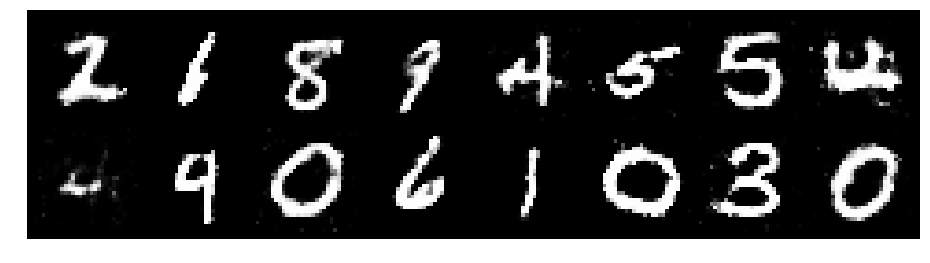

Epoch: [161/200], Batch Num: [200/600]
Discriminator Loss: 1.3805, Generator Loss: 0.9793
D(x): 0.4936, D(G(z)): 0.4319


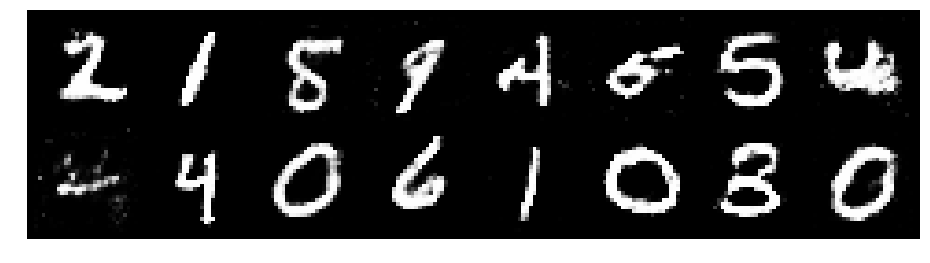

Epoch: [161/200], Batch Num: [300/600]
Discriminator Loss: 1.3696, Generator Loss: 0.7912
D(x): 0.5398, D(G(z)): 0.4893


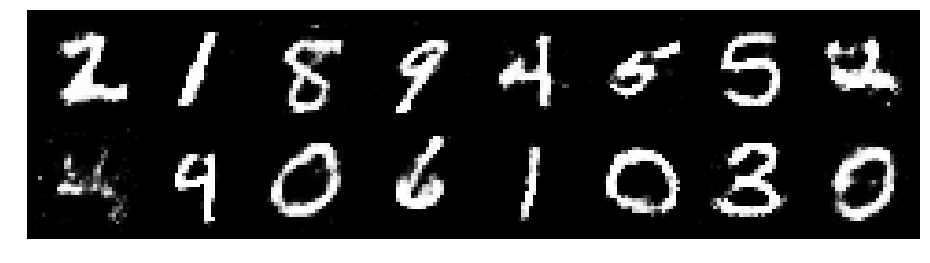

Epoch: [161/200], Batch Num: [400/600]
Discriminator Loss: 1.3543, Generator Loss: 0.7063
D(x): 0.5497, D(G(z)): 0.4898


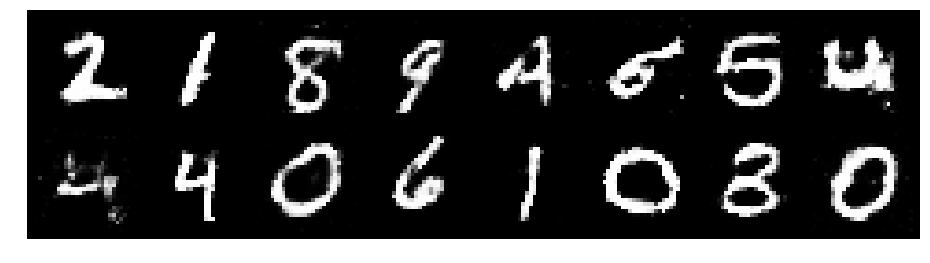

Epoch: [161/200], Batch Num: [500/600]
Discriminator Loss: 1.3931, Generator Loss: 0.8110
D(x): 0.5272, D(G(z)): 0.4719


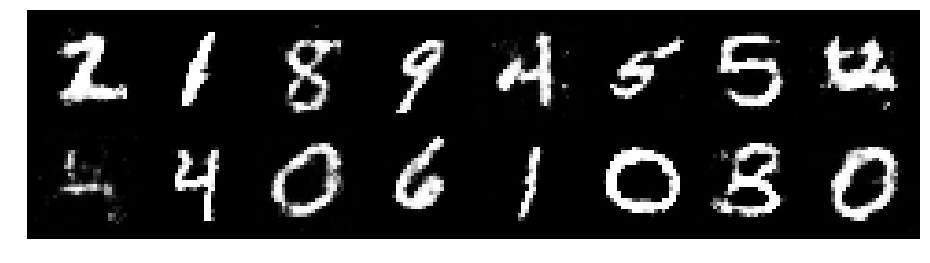

Epoch: [162/200], Batch Num: [0/600]
Discriminator Loss: 1.2544, Generator Loss: 0.7790
D(x): 0.5514, D(G(z)): 0.4526


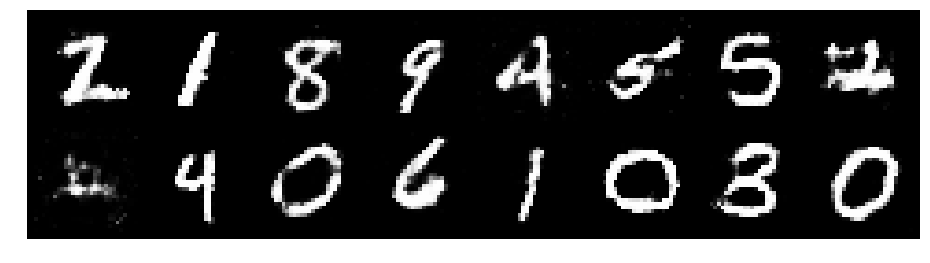

Epoch: [162/200], Batch Num: [100/600]
Discriminator Loss: 1.3099, Generator Loss: 0.8732
D(x): 0.5600, D(G(z)): 0.4600


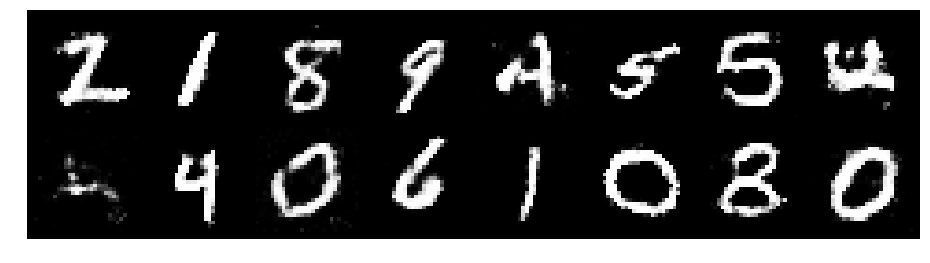

Epoch: [162/200], Batch Num: [200/600]
Discriminator Loss: 1.3566, Generator Loss: 0.7331
D(x): 0.5917, D(G(z)): 0.5250


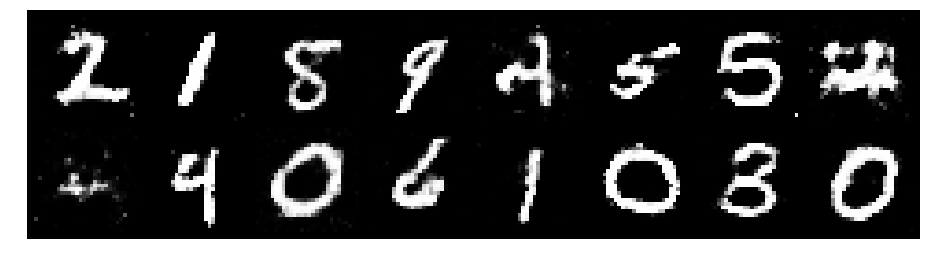

Epoch: [162/200], Batch Num: [300/600]
Discriminator Loss: 1.4581, Generator Loss: 0.8642
D(x): 0.4658, D(G(z)): 0.4549


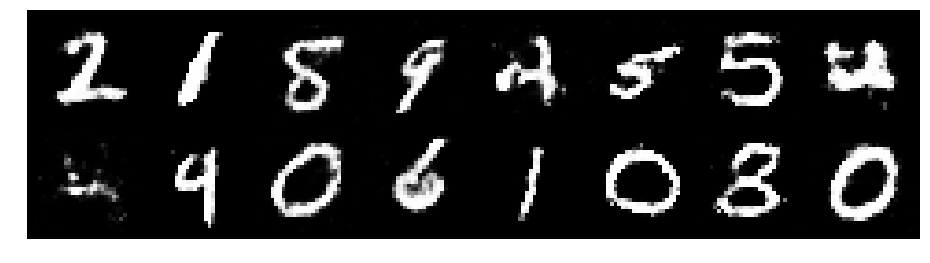

Epoch: [162/200], Batch Num: [400/600]
Discriminator Loss: 1.2823, Generator Loss: 0.7956
D(x): 0.5530, D(G(z)): 0.4691


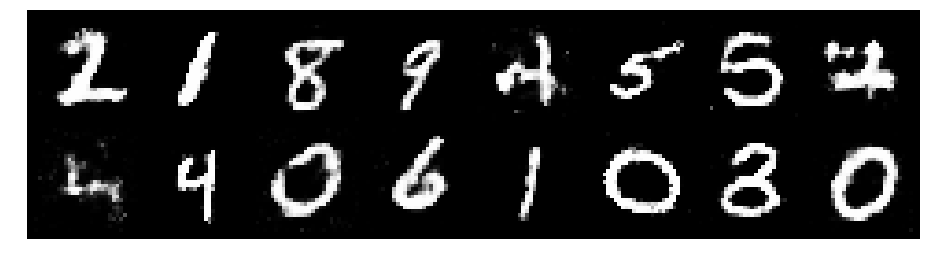

Epoch: [162/200], Batch Num: [500/600]
Discriminator Loss: 1.3474, Generator Loss: 0.8976
D(x): 0.5524, D(G(z)): 0.4616


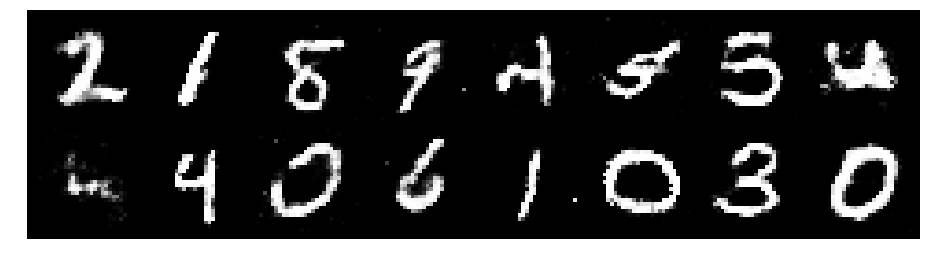

Epoch: [163/200], Batch Num: [0/600]
Discriminator Loss: 1.4399, Generator Loss: 0.8329
D(x): 0.4880, D(G(z)): 0.4604


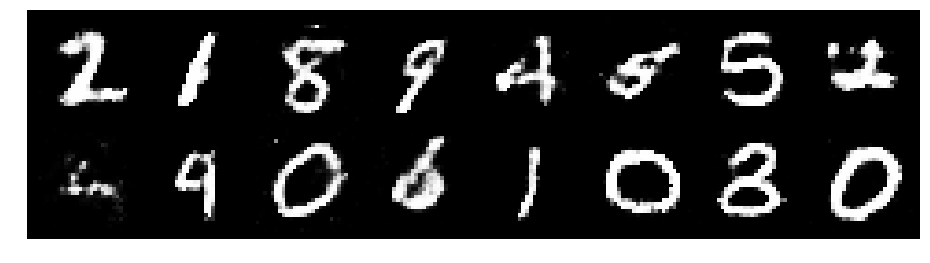

Epoch: [163/200], Batch Num: [100/600]
Discriminator Loss: 1.3103, Generator Loss: 0.8385
D(x): 0.5170, D(G(z)): 0.4433


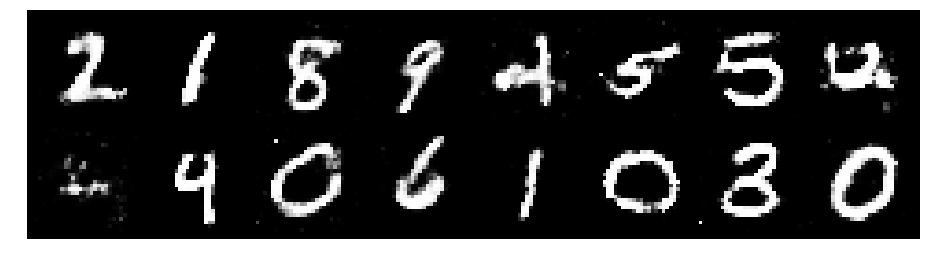

Epoch: [163/200], Batch Num: [200/600]
Discriminator Loss: 1.3319, Generator Loss: 0.8745
D(x): 0.5178, D(G(z)): 0.4346


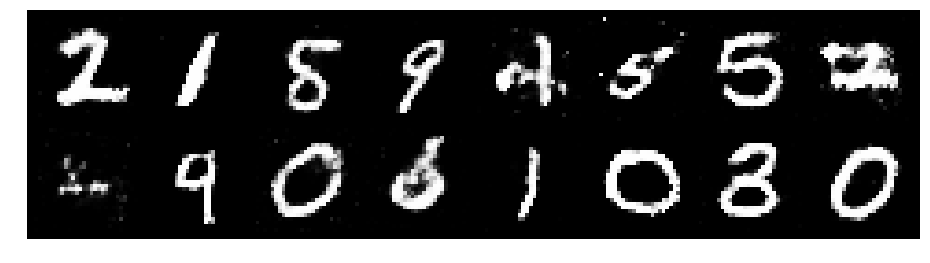

Epoch: [163/200], Batch Num: [300/600]
Discriminator Loss: 1.2625, Generator Loss: 1.0358
D(x): 0.5257, D(G(z)): 0.3799


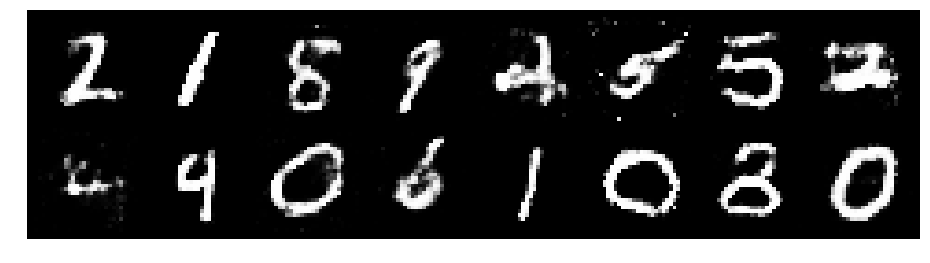

Epoch: [163/200], Batch Num: [400/600]
Discriminator Loss: 1.1825, Generator Loss: 0.9871
D(x): 0.5668, D(G(z)): 0.4012


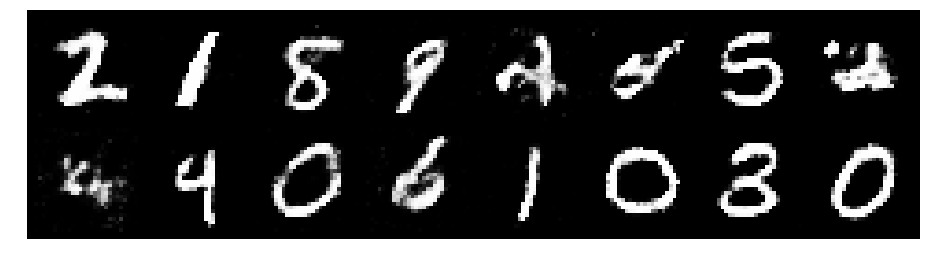

Epoch: [163/200], Batch Num: [500/600]
Discriminator Loss: 1.3043, Generator Loss: 0.8410
D(x): 0.5204, D(G(z)): 0.4259


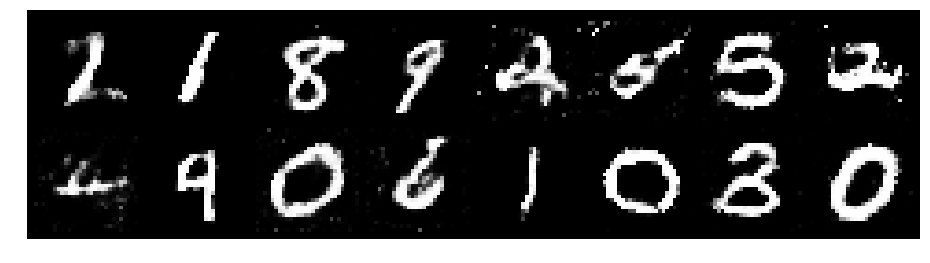

Epoch: [164/200], Batch Num: [0/600]
Discriminator Loss: 1.3183, Generator Loss: 0.8933
D(x): 0.5569, D(G(z)): 0.4637


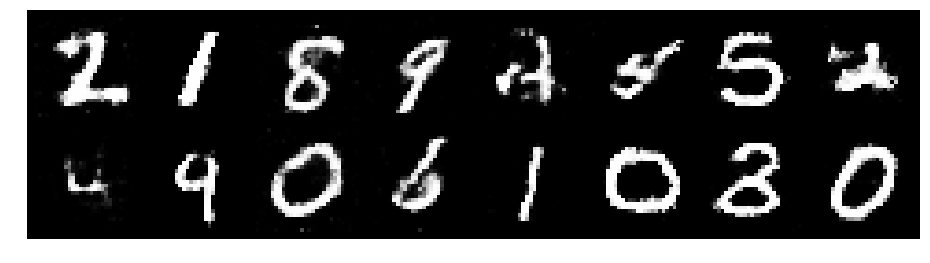

Epoch: [164/200], Batch Num: [100/600]
Discriminator Loss: 1.3090, Generator Loss: 0.8068
D(x): 0.5502, D(G(z)): 0.4599


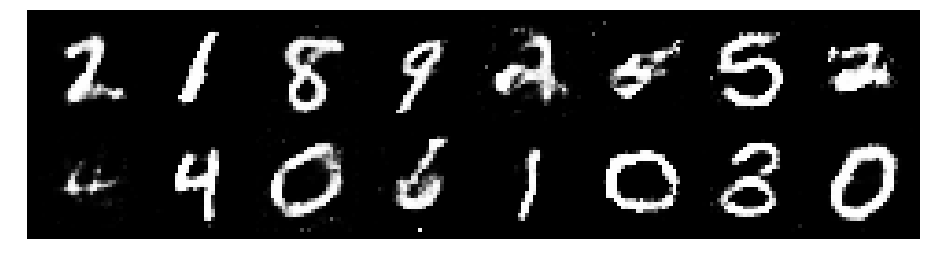

Epoch: [164/200], Batch Num: [200/600]
Discriminator Loss: 1.3386, Generator Loss: 0.8027
D(x): 0.5280, D(G(z)): 0.4468


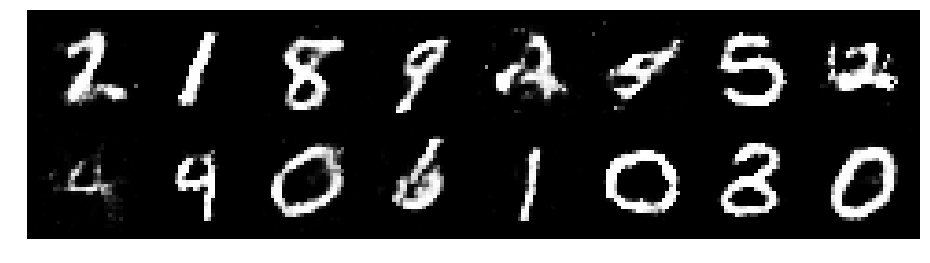

Epoch: [164/200], Batch Num: [300/600]
Discriminator Loss: 1.2825, Generator Loss: 0.9430
D(x): 0.5344, D(G(z)): 0.4208


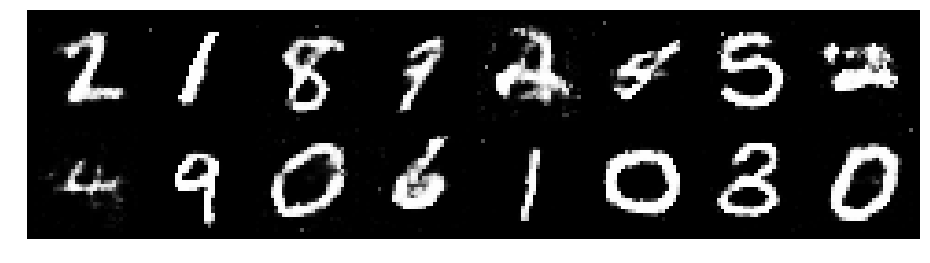

Epoch: [164/200], Batch Num: [400/600]
Discriminator Loss: 1.1720, Generator Loss: 0.8794
D(x): 0.5933, D(G(z)): 0.4324


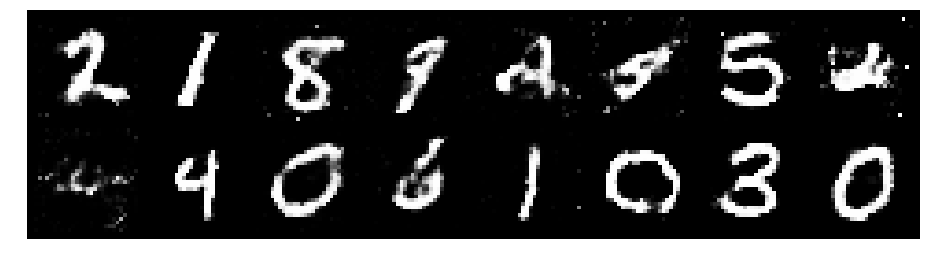

Epoch: [164/200], Batch Num: [500/600]
Discriminator Loss: 1.2572, Generator Loss: 0.8735
D(x): 0.5779, D(G(z)): 0.4434


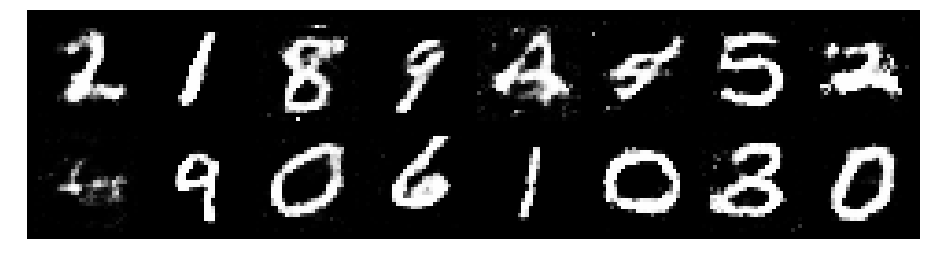

Epoch: [165/200], Batch Num: [0/600]
Discriminator Loss: 1.3418, Generator Loss: 0.8470
D(x): 0.5341, D(G(z)): 0.4662


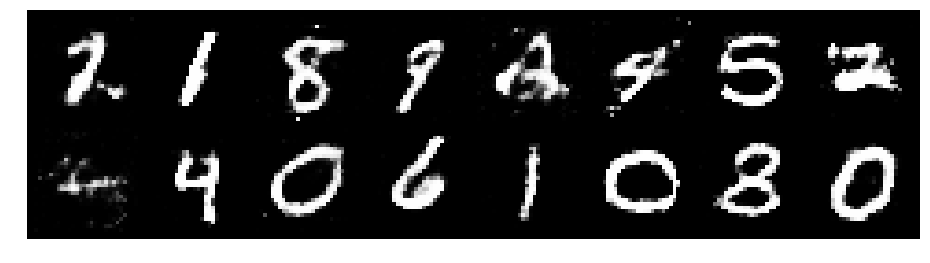

Epoch: [165/200], Batch Num: [100/600]
Discriminator Loss: 1.3538, Generator Loss: 0.8727
D(x): 0.5385, D(G(z)): 0.4515


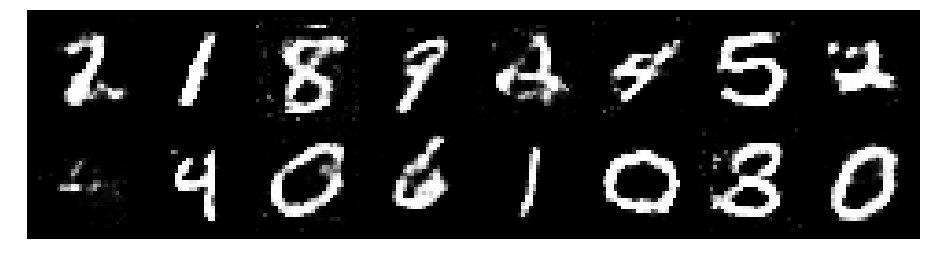

Epoch: [165/200], Batch Num: [200/600]
Discriminator Loss: 1.3653, Generator Loss: 0.9240
D(x): 0.5739, D(G(z)): 0.4859


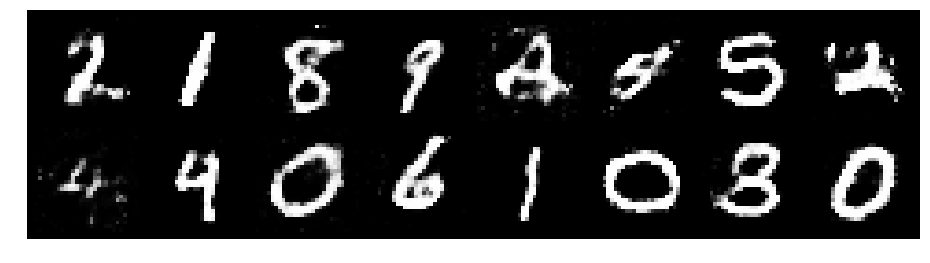

Epoch: [165/200], Batch Num: [300/600]
Discriminator Loss: 1.3370, Generator Loss: 0.8205
D(x): 0.5747, D(G(z)): 0.4930


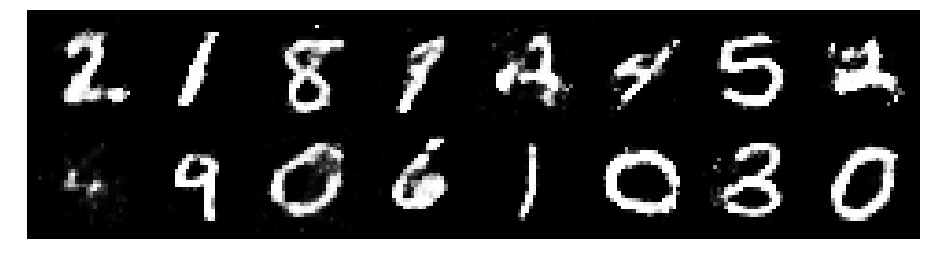

Epoch: [165/200], Batch Num: [400/600]
Discriminator Loss: 1.3287, Generator Loss: 0.8408
D(x): 0.5223, D(G(z)): 0.4328


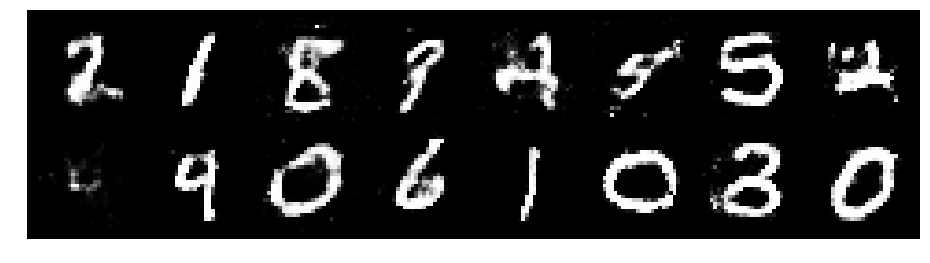

Epoch: [165/200], Batch Num: [500/600]
Discriminator Loss: 1.2009, Generator Loss: 0.9374
D(x): 0.5529, D(G(z)): 0.4103


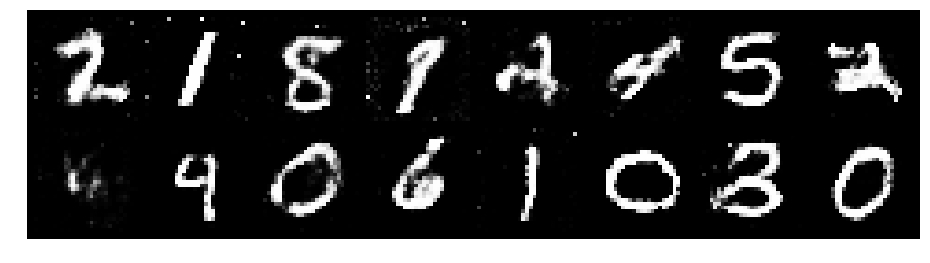

Epoch: [166/200], Batch Num: [0/600]
Discriminator Loss: 1.3063, Generator Loss: 0.9065
D(x): 0.5397, D(G(z)): 0.4579


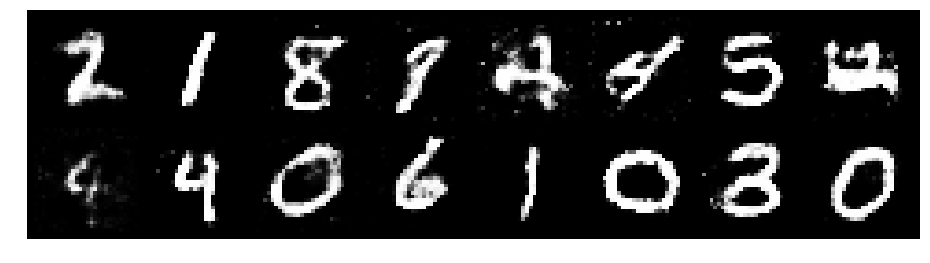

Epoch: [166/200], Batch Num: [100/600]
Discriminator Loss: 1.2561, Generator Loss: 0.8562
D(x): 0.5467, D(G(z)): 0.4367


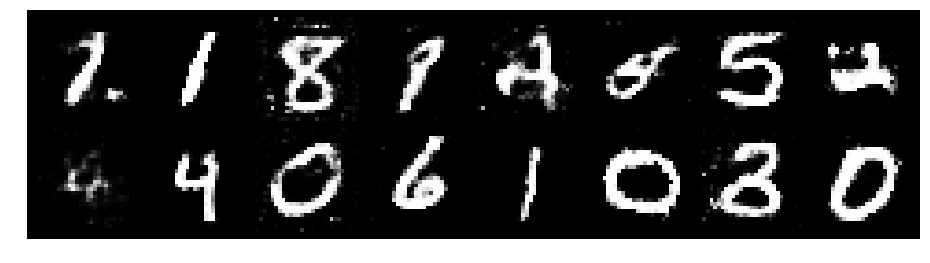

Epoch: [166/200], Batch Num: [200/600]
Discriminator Loss: 1.3377, Generator Loss: 0.8627
D(x): 0.5478, D(G(z)): 0.4604


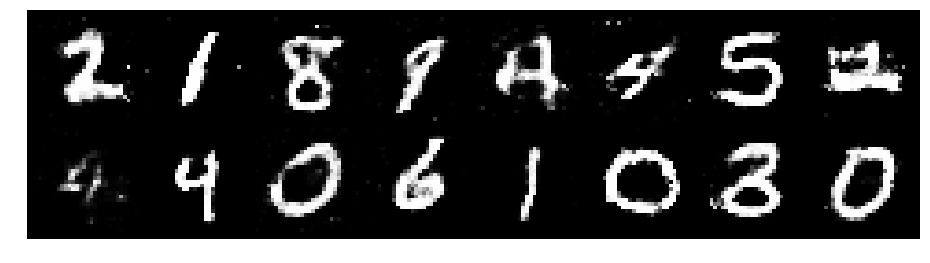

Epoch: [166/200], Batch Num: [300/600]
Discriminator Loss: 1.2625, Generator Loss: 0.8305
D(x): 0.5532, D(G(z)): 0.4348


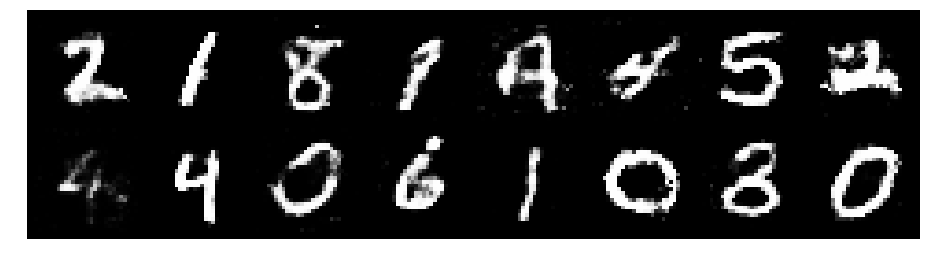

Epoch: [166/200], Batch Num: [400/600]
Discriminator Loss: 1.3832, Generator Loss: 0.9060
D(x): 0.5138, D(G(z)): 0.4300


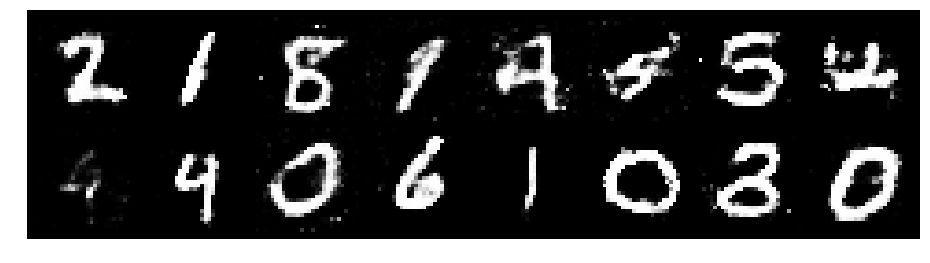

Epoch: [166/200], Batch Num: [500/600]
Discriminator Loss: 1.3554, Generator Loss: 0.8359
D(x): 0.5565, D(G(z)): 0.4831


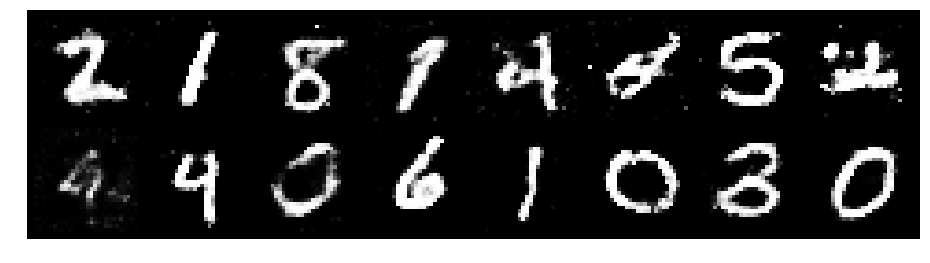

Epoch: [167/200], Batch Num: [0/600]
Discriminator Loss: 1.2648, Generator Loss: 0.8290
D(x): 0.5659, D(G(z)): 0.4581


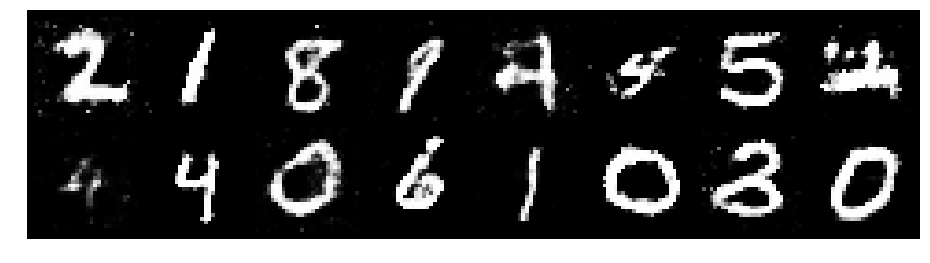

Epoch: [167/200], Batch Num: [100/600]
Discriminator Loss: 1.2853, Generator Loss: 0.8398
D(x): 0.5459, D(G(z)): 0.4451


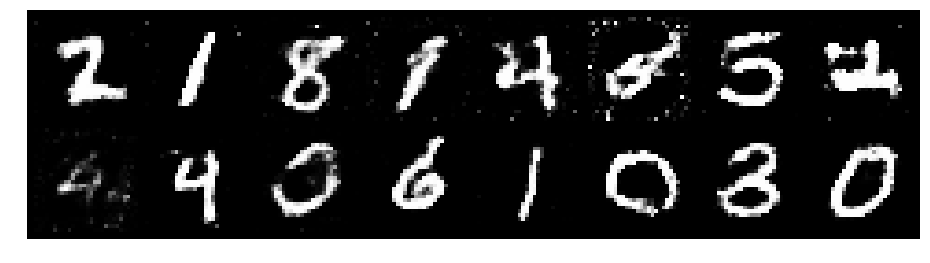

Epoch: [167/200], Batch Num: [200/600]
Discriminator Loss: 1.3225, Generator Loss: 0.8852
D(x): 0.5056, D(G(z)): 0.4361


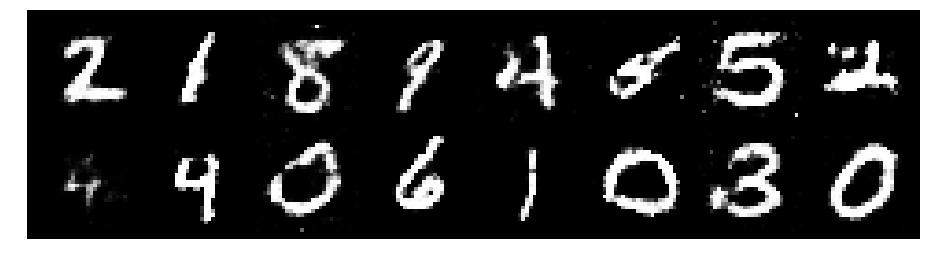

Epoch: [167/200], Batch Num: [300/600]
Discriminator Loss: 1.1764, Generator Loss: 1.0020
D(x): 0.5521, D(G(z)): 0.3949


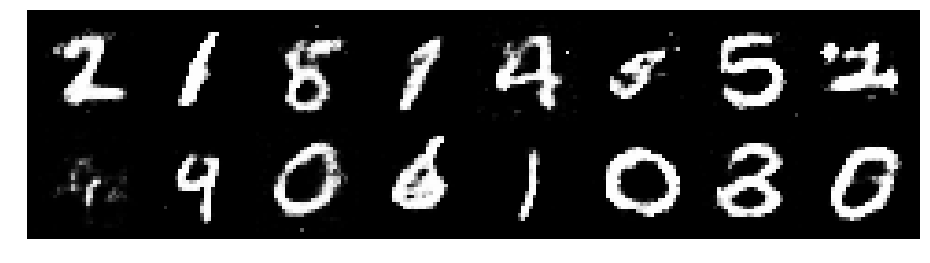

Epoch: [167/200], Batch Num: [400/600]
Discriminator Loss: 1.2112, Generator Loss: 0.8572
D(x): 0.5804, D(G(z)): 0.4475


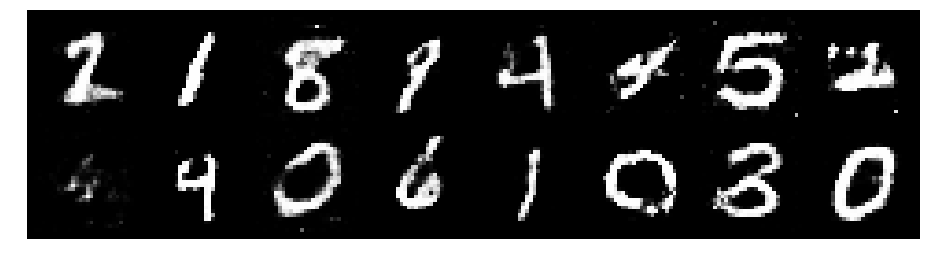

Epoch: [167/200], Batch Num: [500/600]
Discriminator Loss: 1.2628, Generator Loss: 0.9513
D(x): 0.5554, D(G(z)): 0.4320


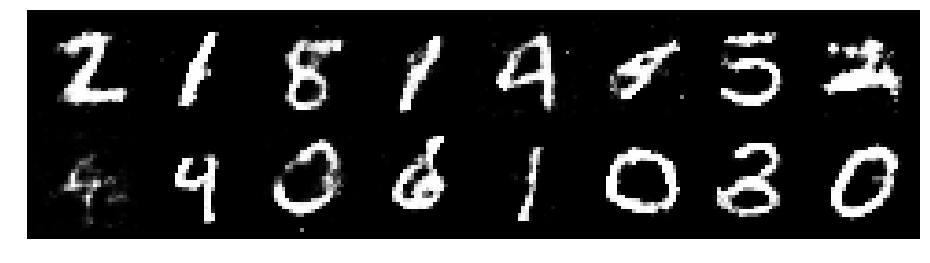

Epoch: [168/200], Batch Num: [0/600]
Discriminator Loss: 1.2343, Generator Loss: 0.9093
D(x): 0.5630, D(G(z)): 0.4311


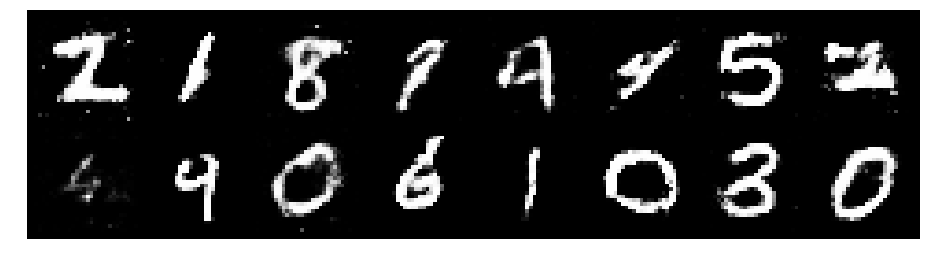

Epoch: [168/200], Batch Num: [100/600]
Discriminator Loss: 1.2847, Generator Loss: 0.8900
D(x): 0.5653, D(G(z)): 0.4472


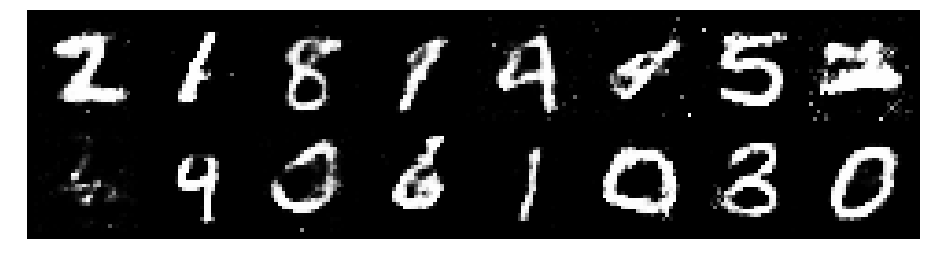

Epoch: [168/200], Batch Num: [200/600]
Discriminator Loss: 1.2914, Generator Loss: 0.8517
D(x): 0.5222, D(G(z)): 0.4240


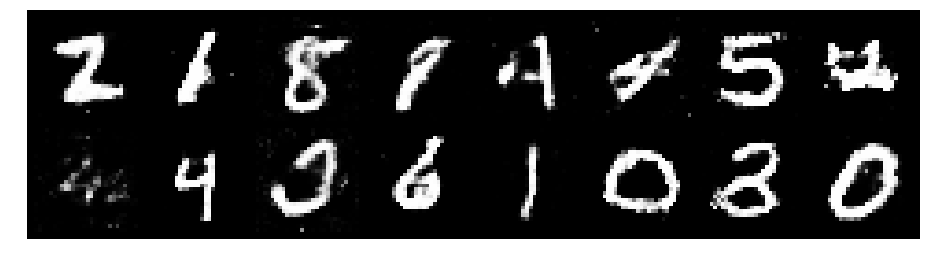

Epoch: [168/200], Batch Num: [300/600]
Discriminator Loss: 1.2995, Generator Loss: 0.9623
D(x): 0.5744, D(G(z)): 0.4652


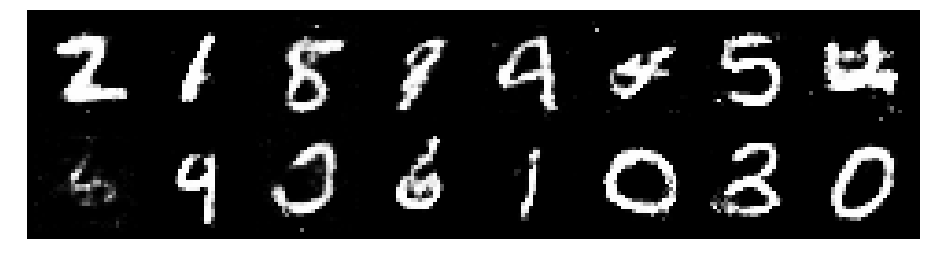

Epoch: [168/200], Batch Num: [400/600]
Discriminator Loss: 1.2539, Generator Loss: 0.9196
D(x): 0.5266, D(G(z)): 0.3928


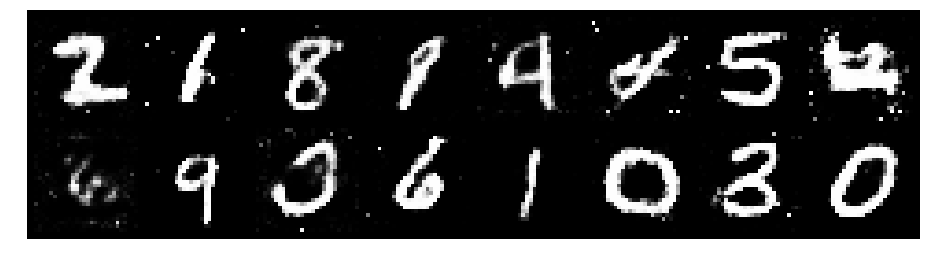

Epoch: [168/200], Batch Num: [500/600]
Discriminator Loss: 1.2514, Generator Loss: 0.7341
D(x): 0.5920, D(G(z)): 0.4678


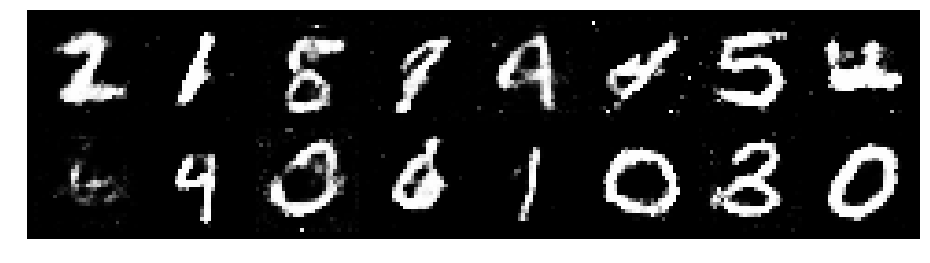

Epoch: [169/200], Batch Num: [0/600]
Discriminator Loss: 1.3035, Generator Loss: 0.8245
D(x): 0.5495, D(G(z)): 0.4621


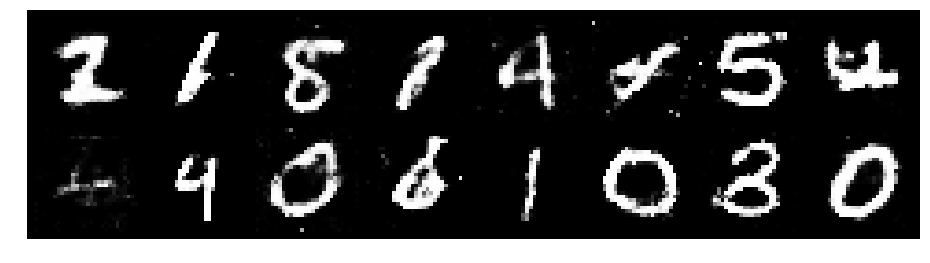

Epoch: [169/200], Batch Num: [100/600]
Discriminator Loss: 1.4128, Generator Loss: 1.0486
D(x): 0.4640, D(G(z)): 0.3816


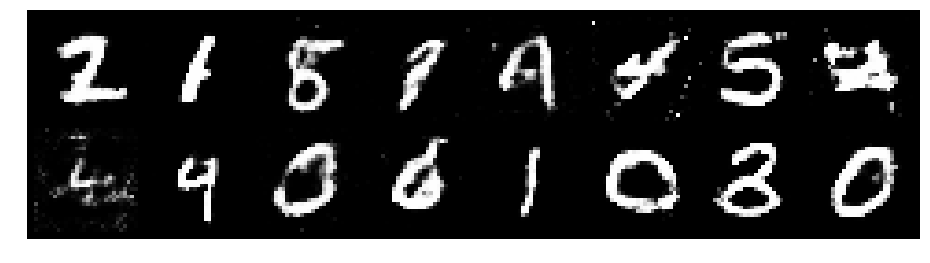

Epoch: [169/200], Batch Num: [200/600]
Discriminator Loss: 1.4061, Generator Loss: 0.8191
D(x): 0.5212, D(G(z)): 0.4721


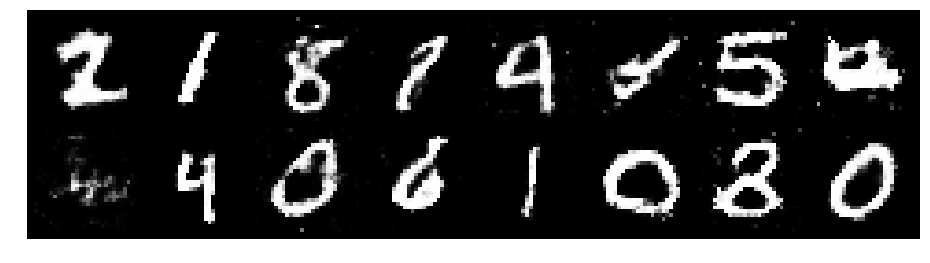

Epoch: [169/200], Batch Num: [300/600]
Discriminator Loss: 1.2706, Generator Loss: 0.8833
D(x): 0.5472, D(G(z)): 0.4199


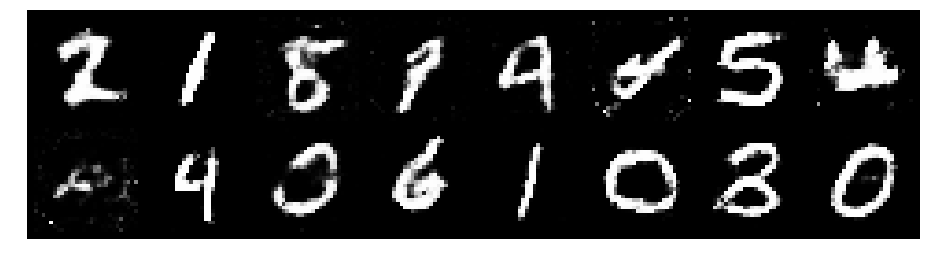

Epoch: [169/200], Batch Num: [400/600]
Discriminator Loss: 1.2228, Generator Loss: 0.9077
D(x): 0.5490, D(G(z)): 0.4138


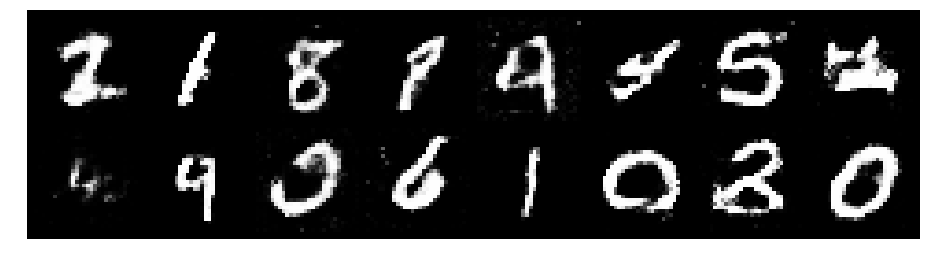

Epoch: [169/200], Batch Num: [500/600]
Discriminator Loss: 1.2950, Generator Loss: 0.8791
D(x): 0.5755, D(G(z)): 0.4571


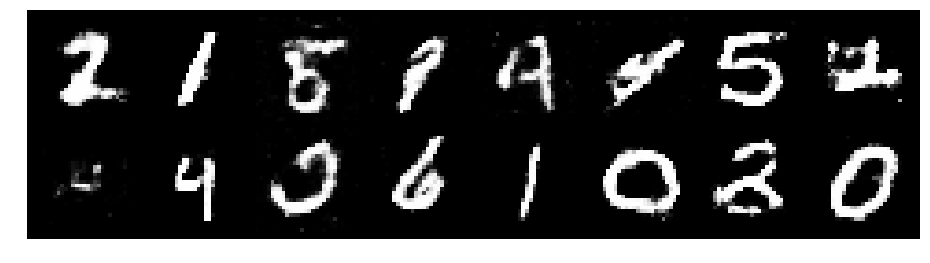

Epoch: [170/200], Batch Num: [0/600]
Discriminator Loss: 1.2010, Generator Loss: 1.0279
D(x): 0.5502, D(G(z)): 0.4069


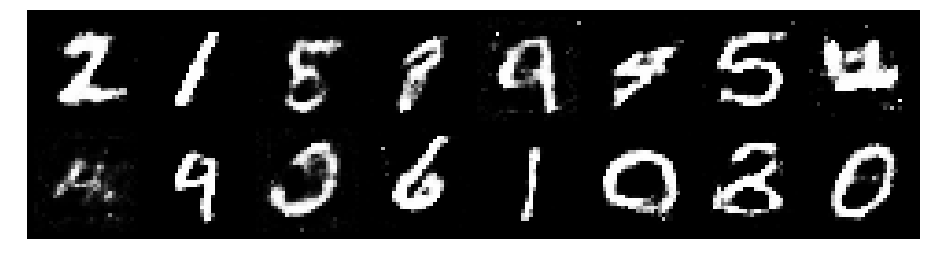

Epoch: [170/200], Batch Num: [100/600]
Discriminator Loss: 1.2009, Generator Loss: 0.9366
D(x): 0.5713, D(G(z)): 0.4213


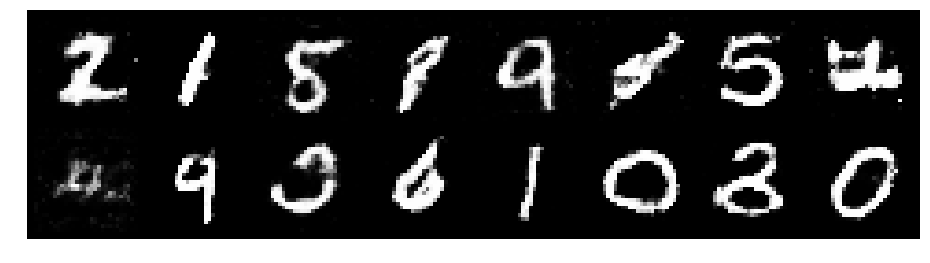

Epoch: [170/200], Batch Num: [200/600]
Discriminator Loss: 1.2879, Generator Loss: 0.8823
D(x): 0.5579, D(G(z)): 0.4479


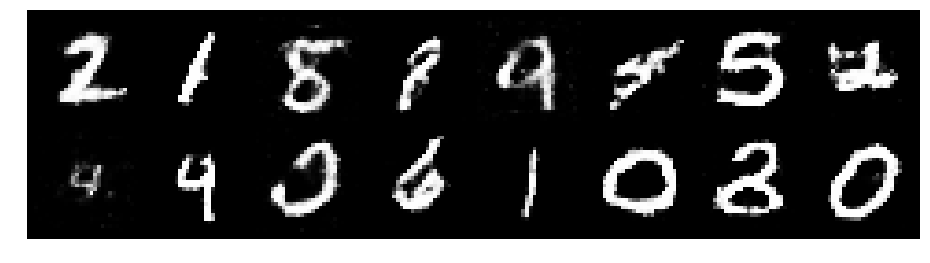

Epoch: [170/200], Batch Num: [300/600]
Discriminator Loss: 1.2652, Generator Loss: 0.7818
D(x): 0.5698, D(G(z)): 0.4558


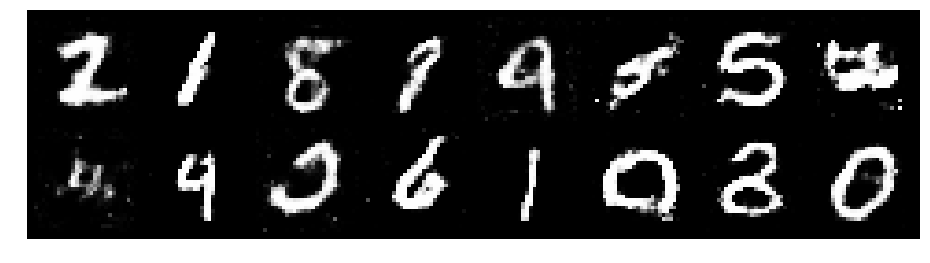

Epoch: [170/200], Batch Num: [400/600]
Discriminator Loss: 1.2790, Generator Loss: 0.7239
D(x): 0.5739, D(G(z)): 0.4766


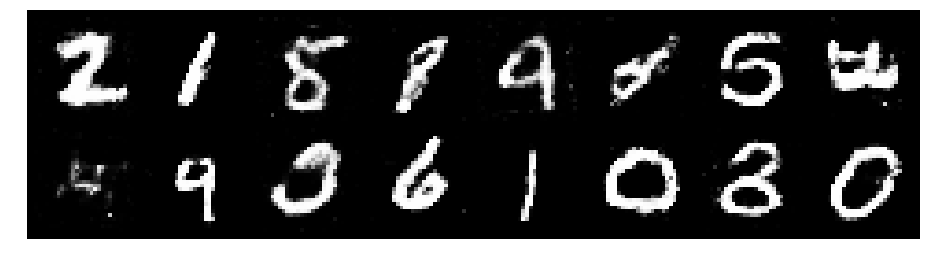

Epoch: [170/200], Batch Num: [500/600]
Discriminator Loss: 1.2866, Generator Loss: 0.8939
D(x): 0.5376, D(G(z)): 0.4462


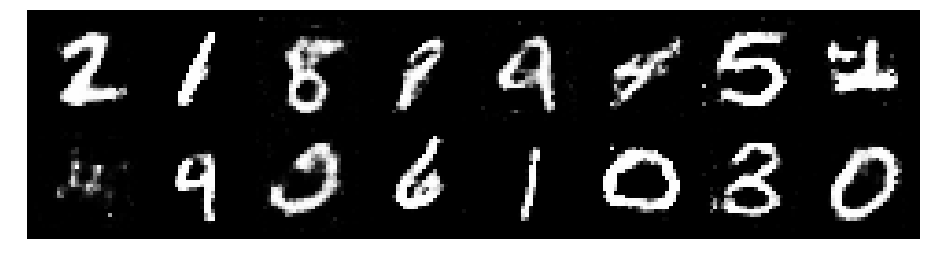

Epoch: [171/200], Batch Num: [0/600]
Discriminator Loss: 1.1773, Generator Loss: 0.9349
D(x): 0.5773, D(G(z)): 0.4031


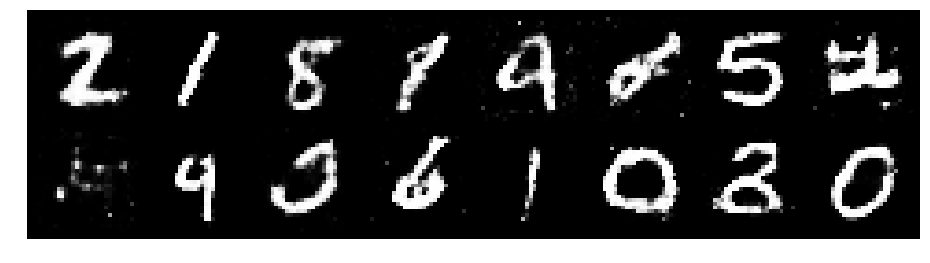

Epoch: [171/200], Batch Num: [100/600]
Discriminator Loss: 1.2634, Generator Loss: 1.0300
D(x): 0.5708, D(G(z)): 0.4284


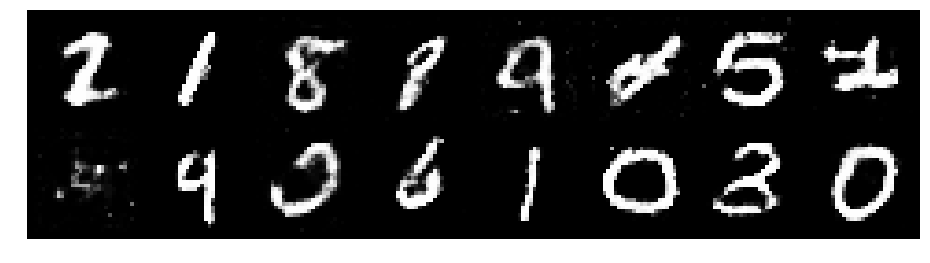

Epoch: [171/200], Batch Num: [200/600]
Discriminator Loss: 1.3310, Generator Loss: 1.0846
D(x): 0.5350, D(G(z)): 0.4326


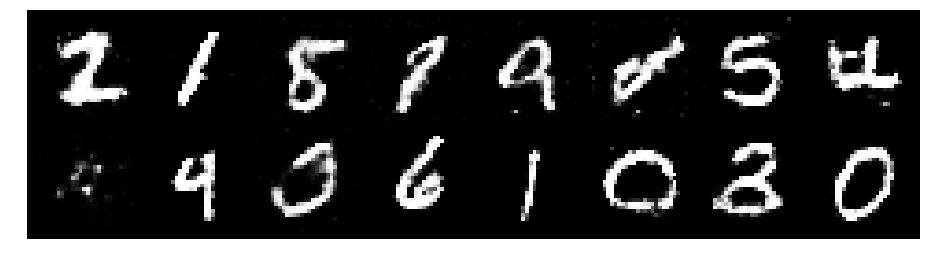

Epoch: [171/200], Batch Num: [300/600]
Discriminator Loss: 1.2933, Generator Loss: 0.8338
D(x): 0.5536, D(G(z)): 0.4540


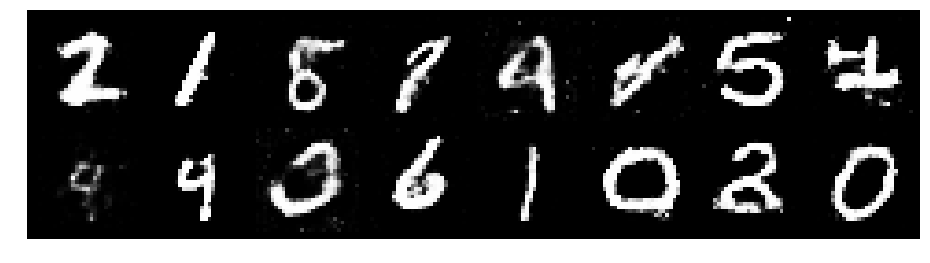

Epoch: [171/200], Batch Num: [400/600]
Discriminator Loss: 1.2350, Generator Loss: 0.9163
D(x): 0.5941, D(G(z)): 0.4576


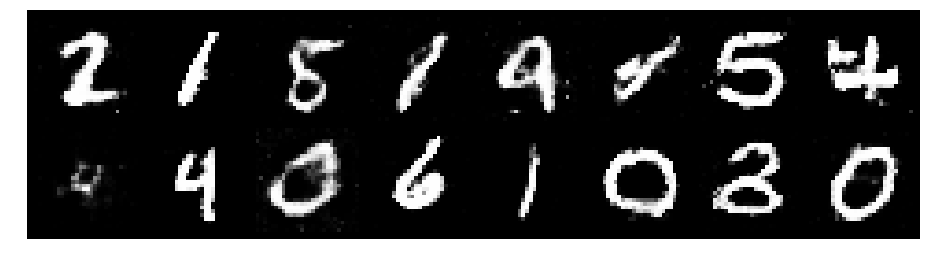

Epoch: [171/200], Batch Num: [500/600]
Discriminator Loss: 1.1867, Generator Loss: 0.8384
D(x): 0.6041, D(G(z)): 0.4429


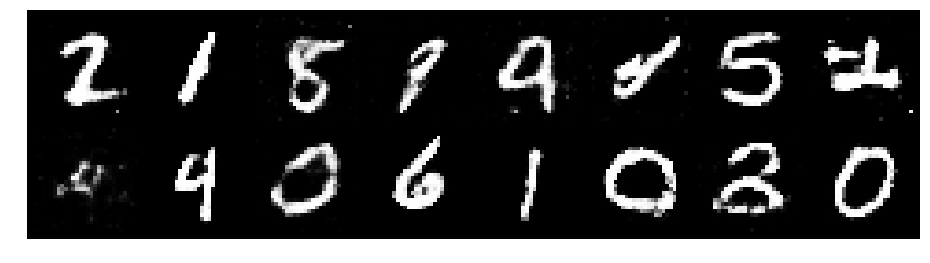

Epoch: [172/200], Batch Num: [0/600]
Discriminator Loss: 1.3256, Generator Loss: 0.8220
D(x): 0.5414, D(G(z)): 0.4559


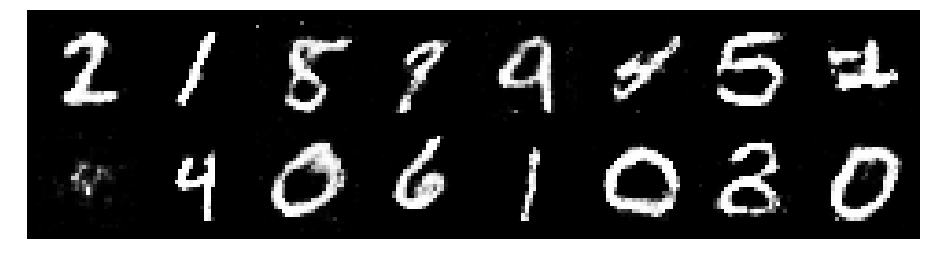

Epoch: [172/200], Batch Num: [100/600]
Discriminator Loss: 1.2128, Generator Loss: 0.8684
D(x): 0.5559, D(G(z)): 0.4338


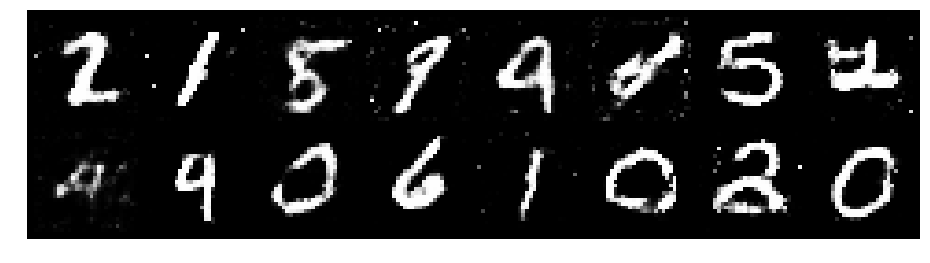

Epoch: [172/200], Batch Num: [200/600]
Discriminator Loss: 1.3676, Generator Loss: 0.8477
D(x): 0.5139, D(G(z)): 0.4644


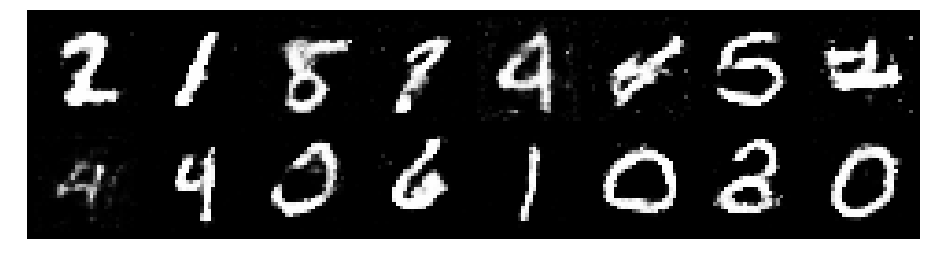

Epoch: [172/200], Batch Num: [300/600]
Discriminator Loss: 1.3981, Generator Loss: 0.9438
D(x): 0.5424, D(G(z)): 0.4870


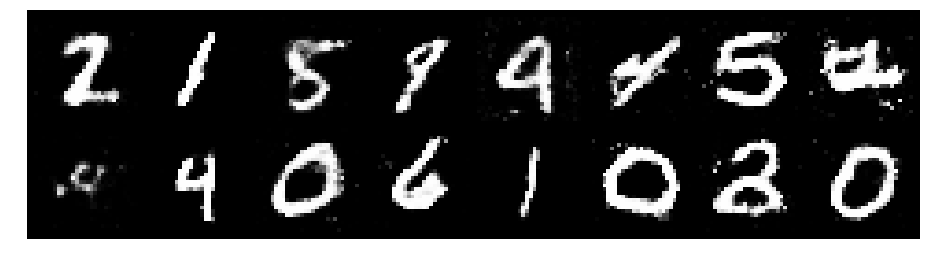

Epoch: [172/200], Batch Num: [400/600]
Discriminator Loss: 1.2570, Generator Loss: 0.9987
D(x): 0.5030, D(G(z)): 0.3901


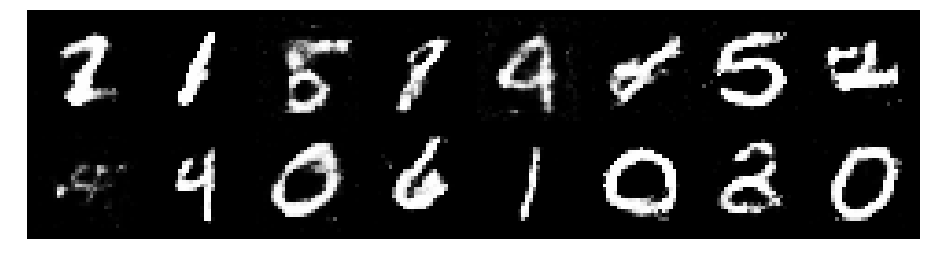

Epoch: [172/200], Batch Num: [500/600]
Discriminator Loss: 1.2247, Generator Loss: 0.9264
D(x): 0.5703, D(G(z)): 0.4376


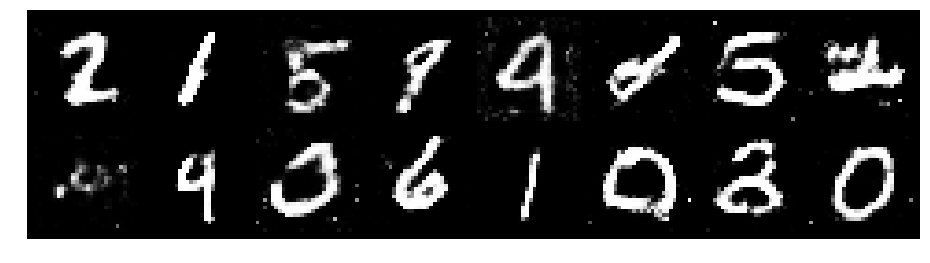

Epoch: [173/200], Batch Num: [0/600]
Discriminator Loss: 1.2344, Generator Loss: 0.9515
D(x): 0.5532, D(G(z)): 0.4393


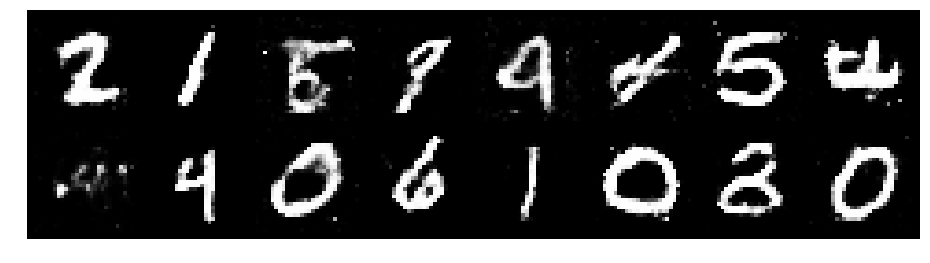

Epoch: [173/200], Batch Num: [100/600]
Discriminator Loss: 1.1949, Generator Loss: 1.0483
D(x): 0.5550, D(G(z)): 0.3825


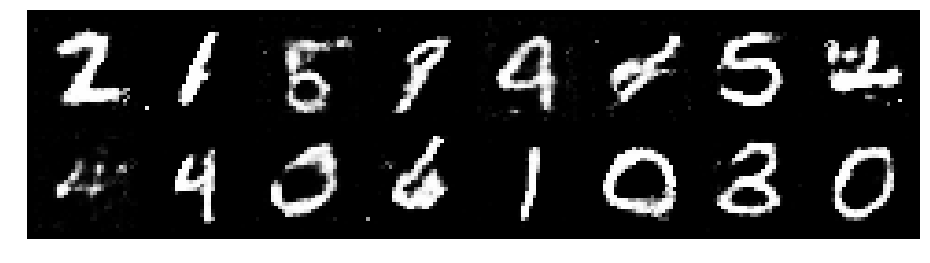

Epoch: [173/200], Batch Num: [200/600]
Discriminator Loss: 1.2866, Generator Loss: 0.8941
D(x): 0.5593, D(G(z)): 0.4622


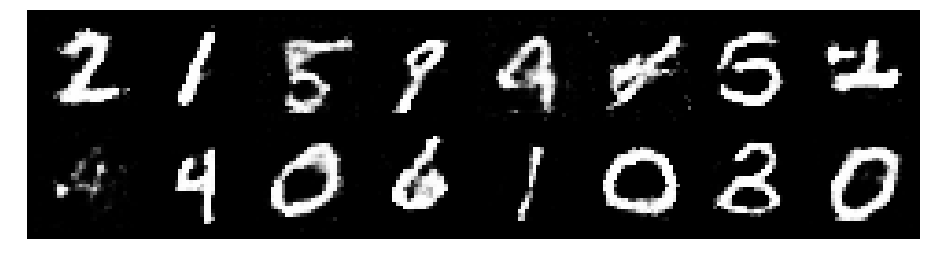

Epoch: [173/200], Batch Num: [300/600]
Discriminator Loss: 1.2756, Generator Loss: 0.8820
D(x): 0.5447, D(G(z)): 0.4418


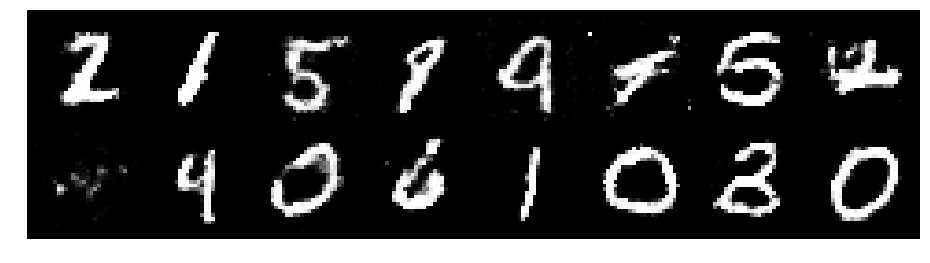

Epoch: [173/200], Batch Num: [400/600]
Discriminator Loss: 1.3633, Generator Loss: 0.9091
D(x): 0.5400, D(G(z)): 0.4802


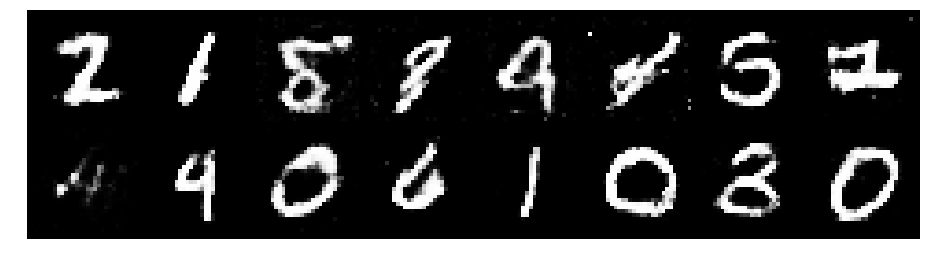

Epoch: [173/200], Batch Num: [500/600]
Discriminator Loss: 1.2862, Generator Loss: 0.8752
D(x): 0.5785, D(G(z)): 0.4615


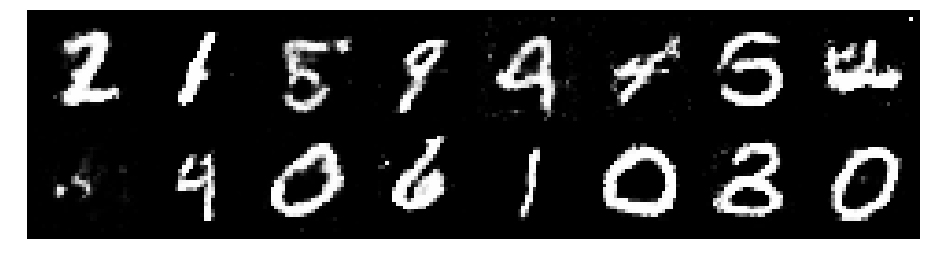

Epoch: [174/200], Batch Num: [0/600]
Discriminator Loss: 1.2954, Generator Loss: 0.8080
D(x): 0.5937, D(G(z)): 0.4826


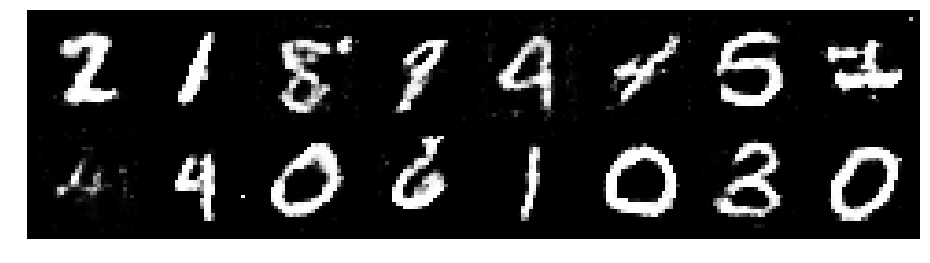

Epoch: [174/200], Batch Num: [100/600]
Discriminator Loss: 1.2869, Generator Loss: 0.7560
D(x): 0.5882, D(G(z)): 0.4841


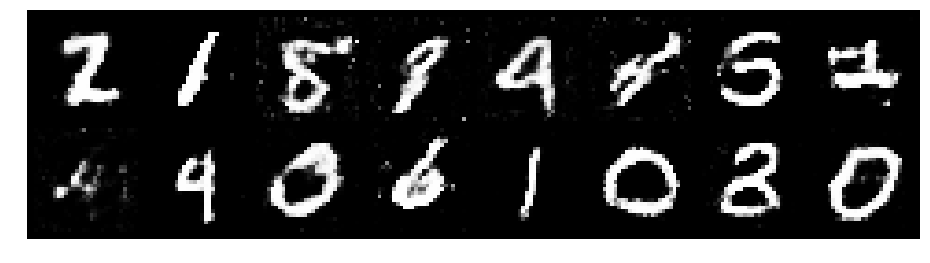

Epoch: [174/200], Batch Num: [200/600]
Discriminator Loss: 1.3774, Generator Loss: 0.9486
D(x): 0.5035, D(G(z)): 0.4438


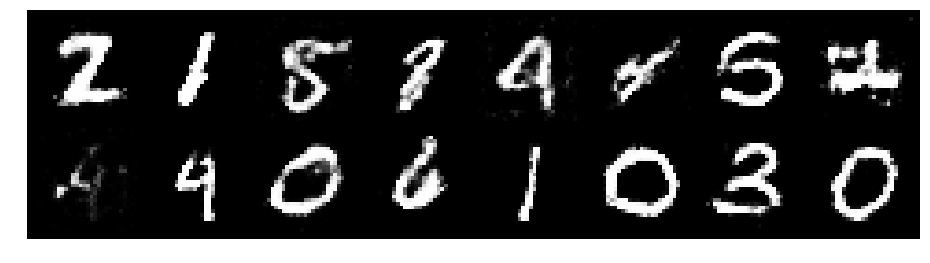

Epoch: [174/200], Batch Num: [300/600]
Discriminator Loss: 1.3101, Generator Loss: 0.9056
D(x): 0.5437, D(G(z)): 0.4615


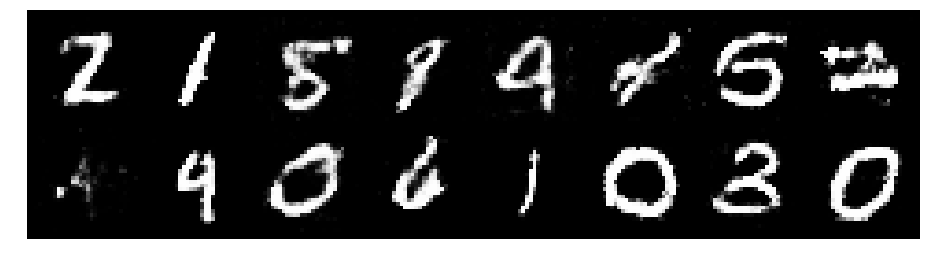

Epoch: [174/200], Batch Num: [400/600]
Discriminator Loss: 1.2553, Generator Loss: 0.8866
D(x): 0.5360, D(G(z)): 0.4380


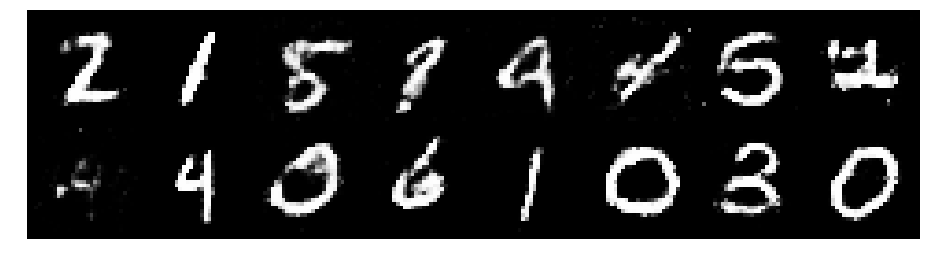

Epoch: [174/200], Batch Num: [500/600]
Discriminator Loss: 1.1872, Generator Loss: 1.0265
D(x): 0.5735, D(G(z)): 0.4274


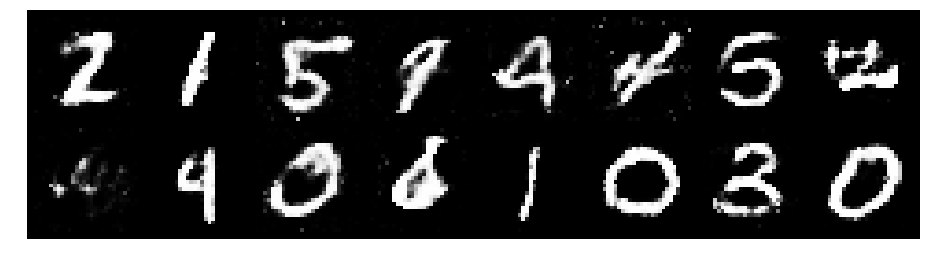

Epoch: [175/200], Batch Num: [0/600]
Discriminator Loss: 1.2294, Generator Loss: 0.9195
D(x): 0.5568, D(G(z)): 0.4357


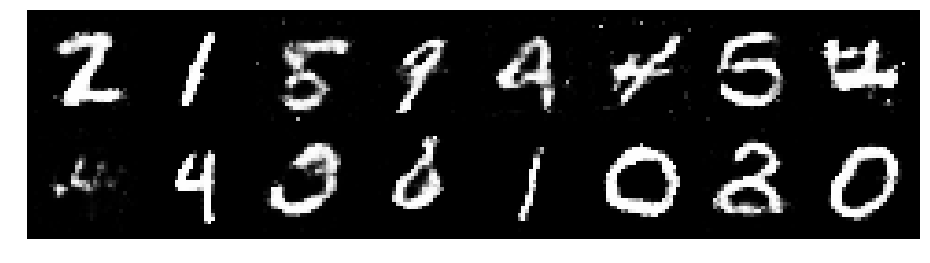

Epoch: [175/200], Batch Num: [100/600]
Discriminator Loss: 1.2661, Generator Loss: 0.9110
D(x): 0.5457, D(G(z)): 0.4454


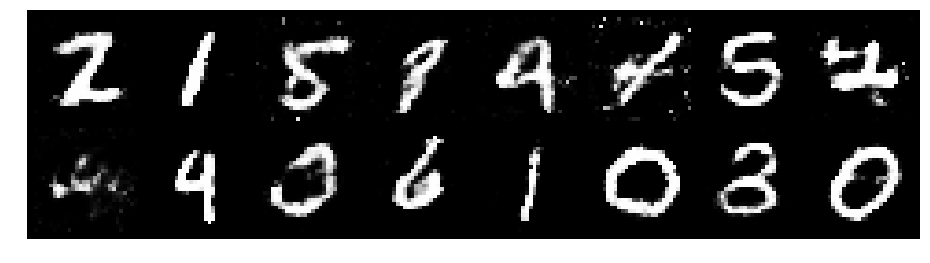

Epoch: [175/200], Batch Num: [200/600]
Discriminator Loss: 1.2137, Generator Loss: 0.8358
D(x): 0.5565, D(G(z)): 0.4223


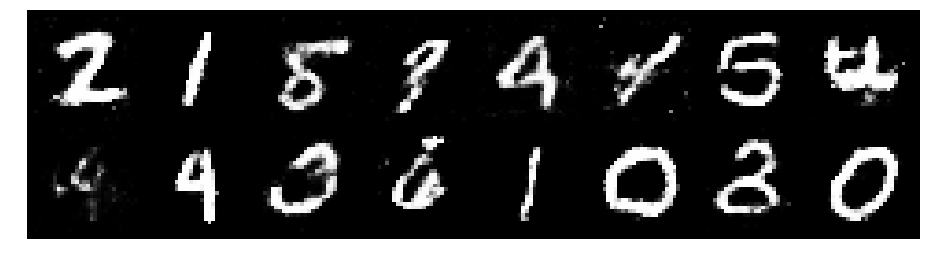

Epoch: [175/200], Batch Num: [300/600]
Discriminator Loss: 1.2481, Generator Loss: 0.9914
D(x): 0.5515, D(G(z)): 0.4252


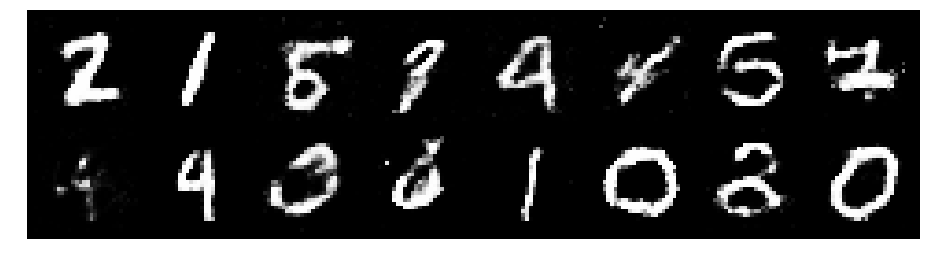

Epoch: [175/200], Batch Num: [400/600]
Discriminator Loss: 1.2707, Generator Loss: 0.8671
D(x): 0.5426, D(G(z)): 0.4575


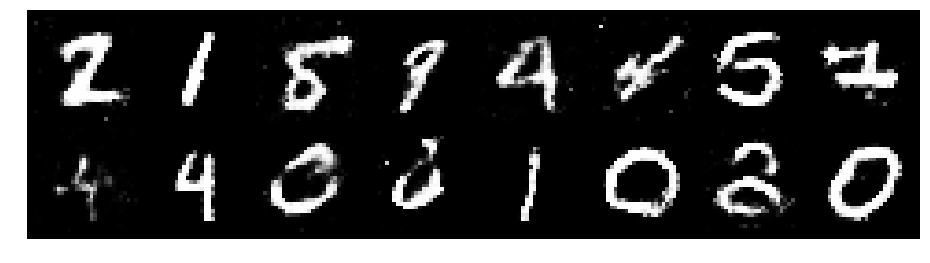

Epoch: [175/200], Batch Num: [500/600]
Discriminator Loss: 1.3907, Generator Loss: 0.8184
D(x): 0.5333, D(G(z)): 0.4857


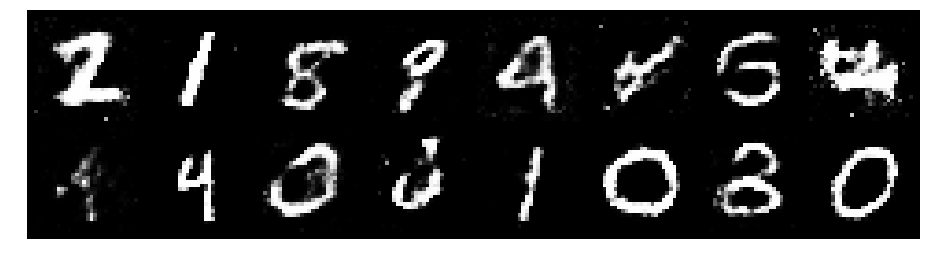

Epoch: [176/200], Batch Num: [0/600]
Discriminator Loss: 1.3057, Generator Loss: 0.9837
D(x): 0.5359, D(G(z)): 0.4430


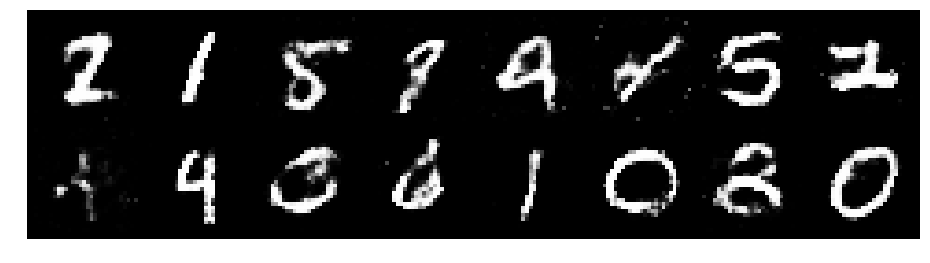

Epoch: [176/200], Batch Num: [100/600]
Discriminator Loss: 1.2698, Generator Loss: 0.8798
D(x): 0.5399, D(G(z)): 0.4361


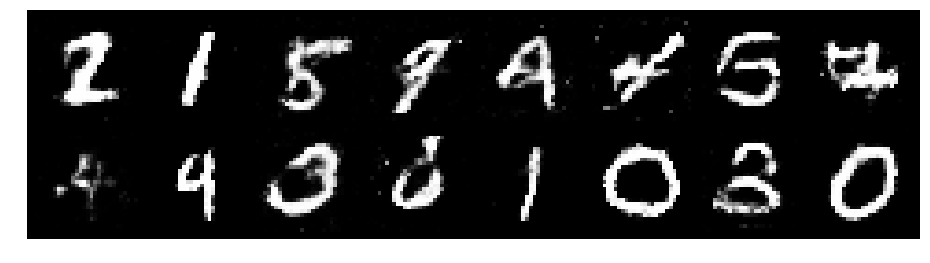

Epoch: [176/200], Batch Num: [200/600]
Discriminator Loss: 1.2758, Generator Loss: 0.9996
D(x): 0.5549, D(G(z)): 0.4393


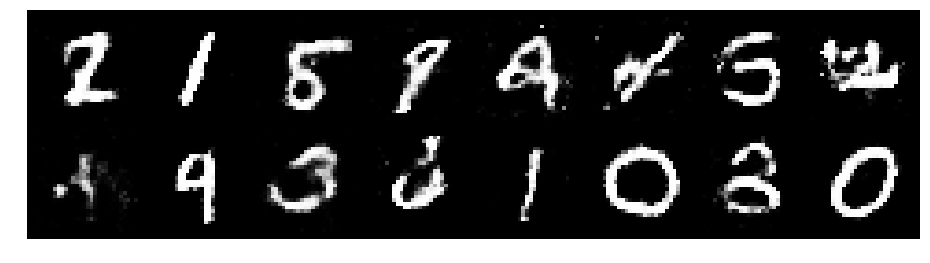

Epoch: [176/200], Batch Num: [300/600]
Discriminator Loss: 1.2786, Generator Loss: 1.0103
D(x): 0.5307, D(G(z)): 0.4300


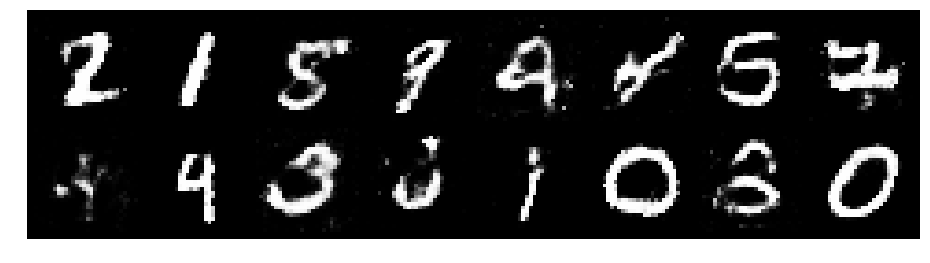

Epoch: [176/200], Batch Num: [400/600]
Discriminator Loss: 1.3337, Generator Loss: 0.8658
D(x): 0.5575, D(G(z)): 0.4547


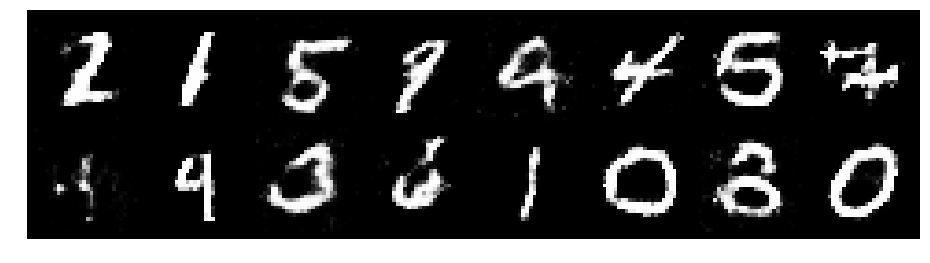

Epoch: [176/200], Batch Num: [500/600]
Discriminator Loss: 1.2078, Generator Loss: 0.9554
D(x): 0.5986, D(G(z)): 0.4382


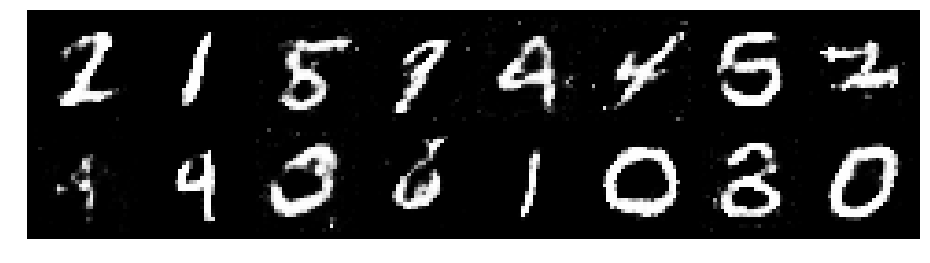

Epoch: [177/200], Batch Num: [0/600]
Discriminator Loss: 1.3159, Generator Loss: 0.8560
D(x): 0.5033, D(G(z)): 0.4296


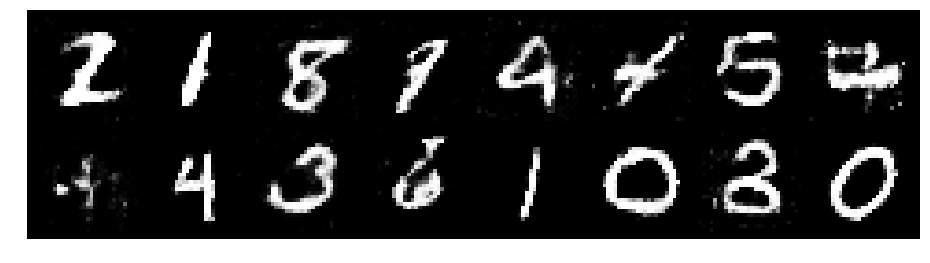

Epoch: [177/200], Batch Num: [100/600]
Discriminator Loss: 1.3316, Generator Loss: 0.8784
D(x): 0.5916, D(G(z)): 0.4987


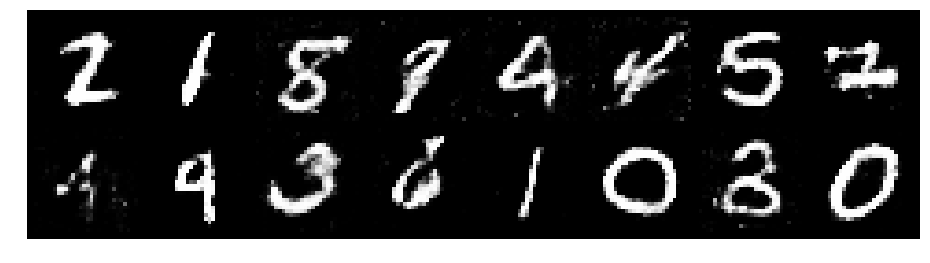

Epoch: [177/200], Batch Num: [200/600]
Discriminator Loss: 1.2487, Generator Loss: 0.7998
D(x): 0.5724, D(G(z)): 0.4666


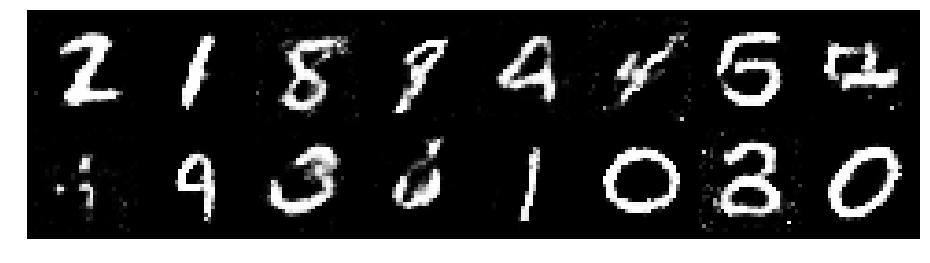

Epoch: [177/200], Batch Num: [300/600]
Discriminator Loss: 1.3660, Generator Loss: 0.7922
D(x): 0.5348, D(G(z)): 0.4834


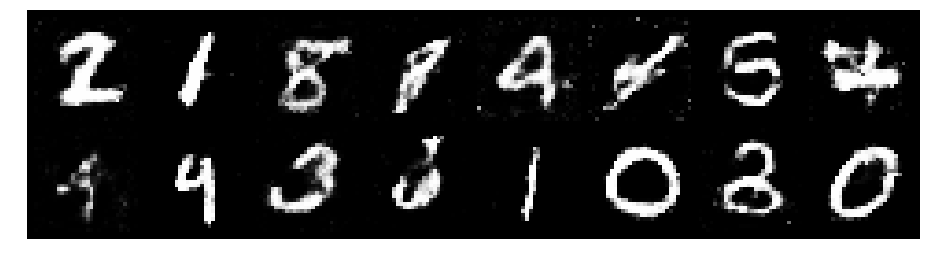

Epoch: [177/200], Batch Num: [400/600]
Discriminator Loss: 1.3236, Generator Loss: 0.8538
D(x): 0.5354, D(G(z)): 0.4617


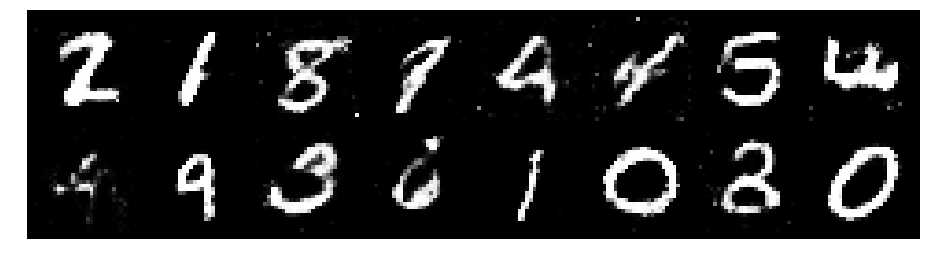

Epoch: [177/200], Batch Num: [500/600]
Discriminator Loss: 1.2508, Generator Loss: 1.0031
D(x): 0.5625, D(G(z)): 0.4079


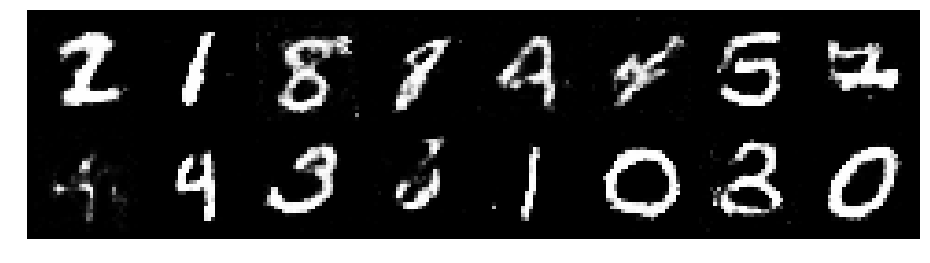

Epoch: [178/200], Batch Num: [0/600]
Discriminator Loss: 1.3063, Generator Loss: 0.8675
D(x): 0.5438, D(G(z)): 0.4611


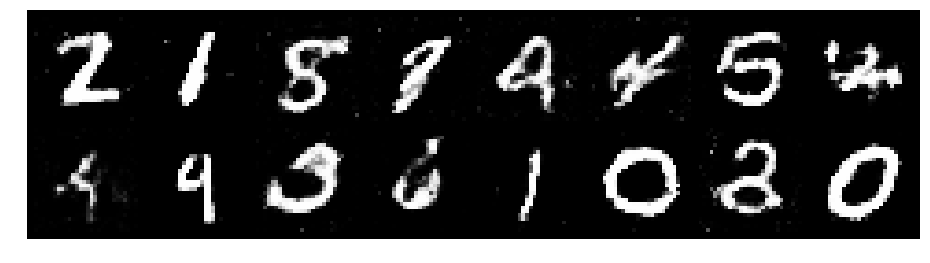

Epoch: [178/200], Batch Num: [100/600]
Discriminator Loss: 1.2684, Generator Loss: 1.1062
D(x): 0.5404, D(G(z)): 0.4147


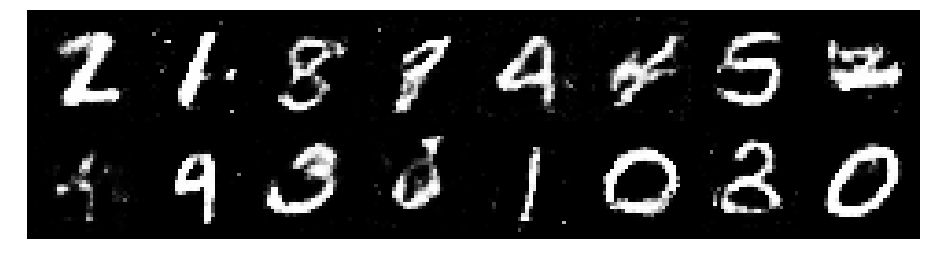

Epoch: [178/200], Batch Num: [200/600]
Discriminator Loss: 1.1844, Generator Loss: 0.9654
D(x): 0.5557, D(G(z)): 0.3830


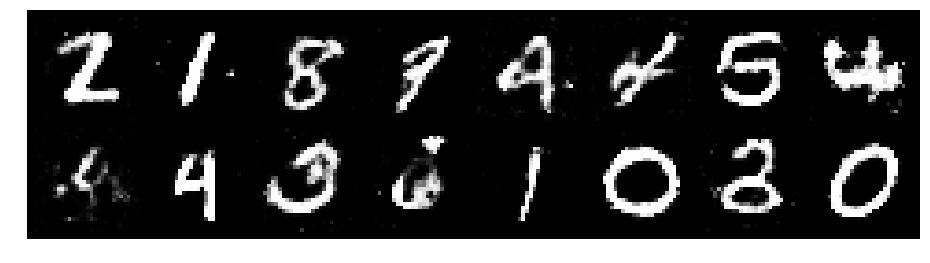

Epoch: [178/200], Batch Num: [300/600]
Discriminator Loss: 1.3439, Generator Loss: 0.9640
D(x): 0.5668, D(G(z)): 0.4778


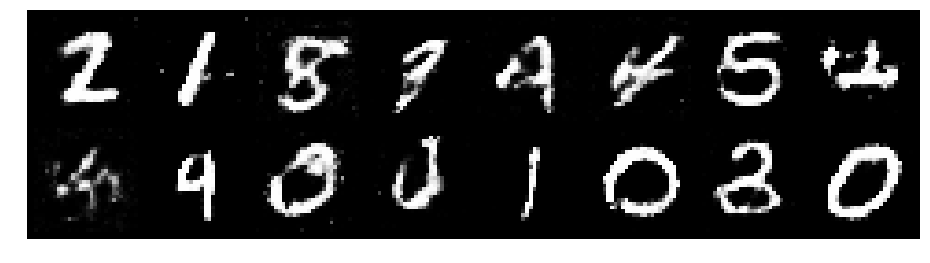

Epoch: [178/200], Batch Num: [400/600]
Discriminator Loss: 1.3688, Generator Loss: 0.9513
D(x): 0.4874, D(G(z)): 0.4175


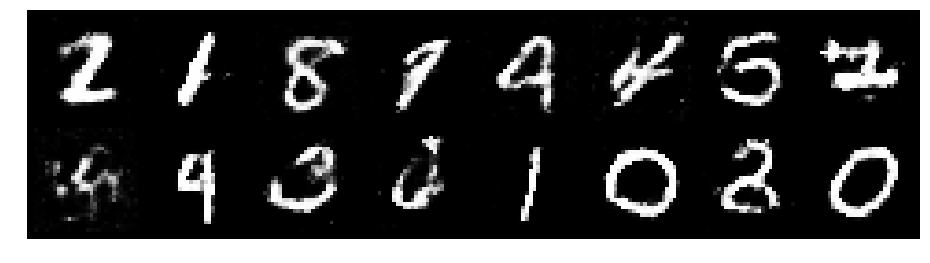

Epoch: [178/200], Batch Num: [500/600]
Discriminator Loss: 1.2583, Generator Loss: 0.8025
D(x): 0.5466, D(G(z)): 0.4404


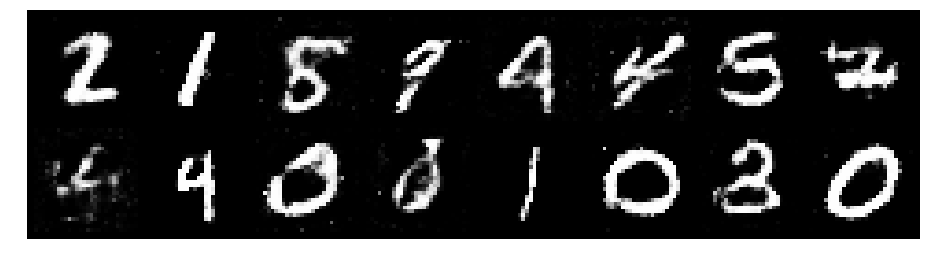

Epoch: [179/200], Batch Num: [0/600]
Discriminator Loss: 1.1942, Generator Loss: 0.9741
D(x): 0.5319, D(G(z)): 0.3843


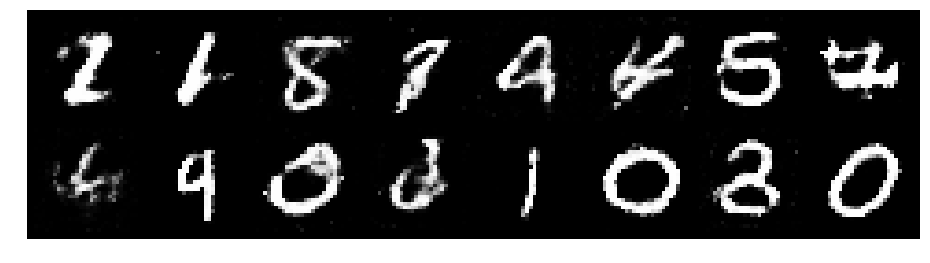

Epoch: [179/200], Batch Num: [100/600]
Discriminator Loss: 1.2216, Generator Loss: 1.1409
D(x): 0.5742, D(G(z)): 0.4331


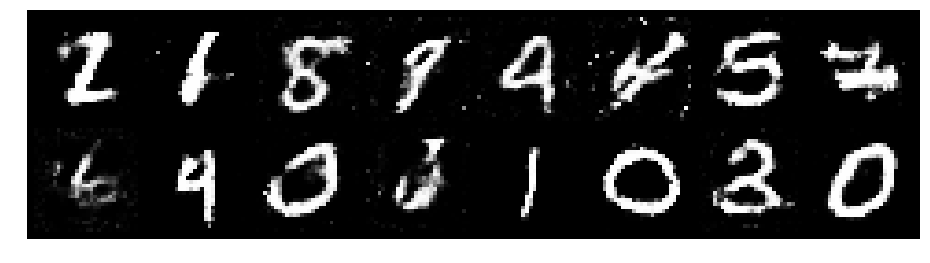

Epoch: [179/200], Batch Num: [200/600]
Discriminator Loss: 1.1897, Generator Loss: 0.9654
D(x): 0.5718, D(G(z)): 0.4083


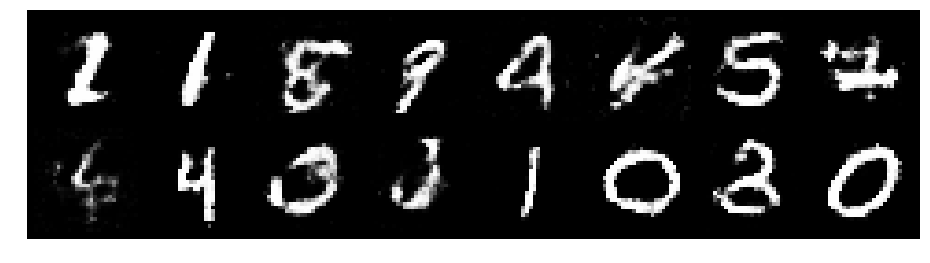

Epoch: [179/200], Batch Num: [300/600]
Discriminator Loss: 1.3532, Generator Loss: 0.7728
D(x): 0.5707, D(G(z)): 0.4920


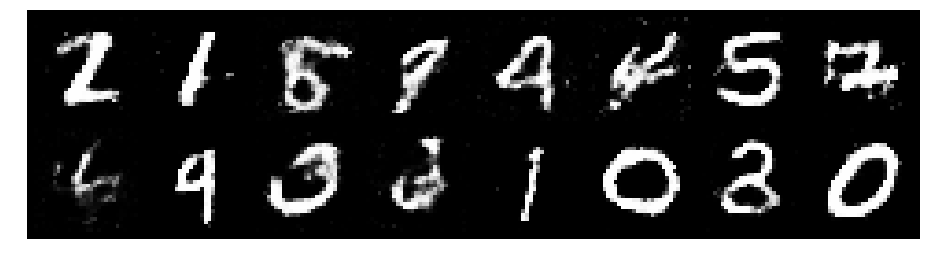

Epoch: [179/200], Batch Num: [400/600]
Discriminator Loss: 1.3743, Generator Loss: 0.9554
D(x): 0.5606, D(G(z)): 0.4672


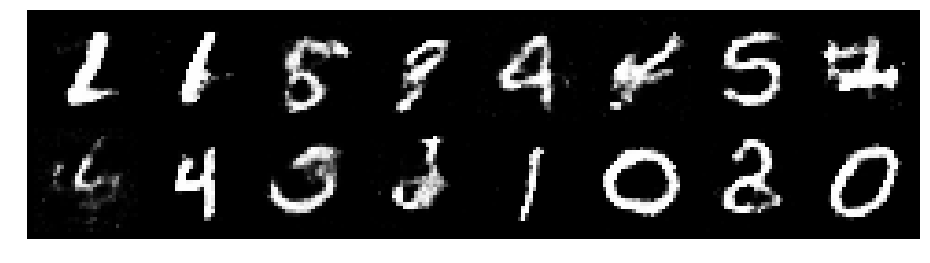

Epoch: [179/200], Batch Num: [500/600]
Discriminator Loss: 1.3062, Generator Loss: 0.8283
D(x): 0.5829, D(G(z)): 0.4791


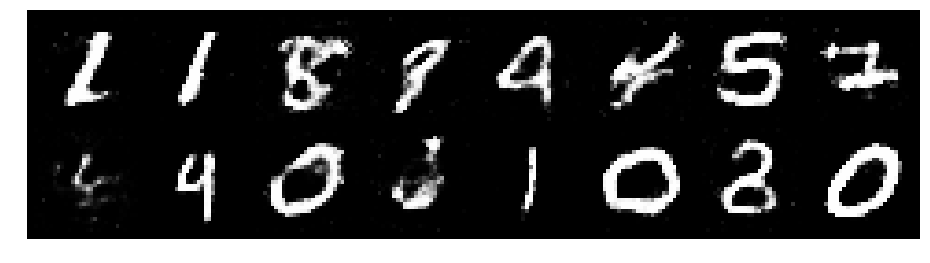

Epoch: [180/200], Batch Num: [0/600]
Discriminator Loss: 1.1484, Generator Loss: 1.0188
D(x): 0.5778, D(G(z)): 0.3821


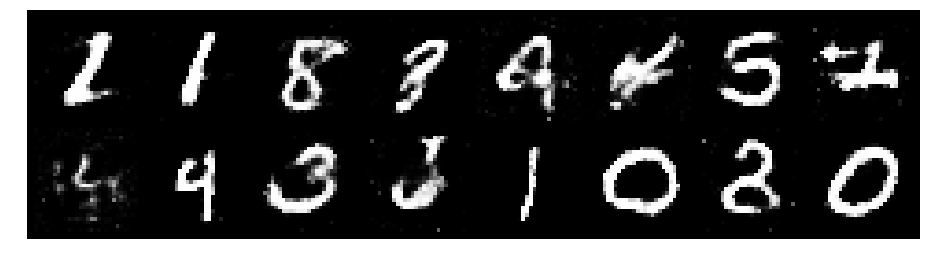

Epoch: [180/200], Batch Num: [100/600]
Discriminator Loss: 1.2415, Generator Loss: 1.0162
D(x): 0.5902, D(G(z)): 0.4284


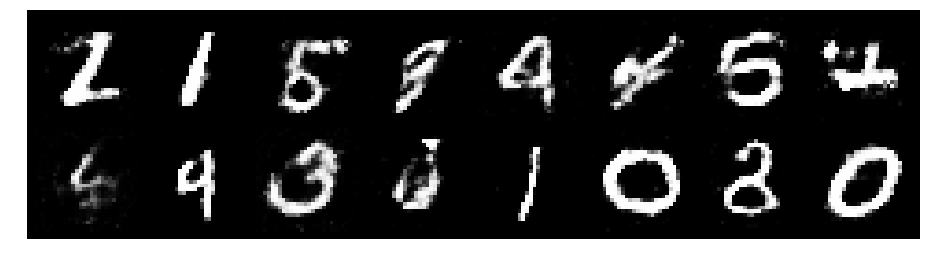

Epoch: [180/200], Batch Num: [200/600]
Discriminator Loss: 1.2445, Generator Loss: 0.8627
D(x): 0.5653, D(G(z)): 0.4479


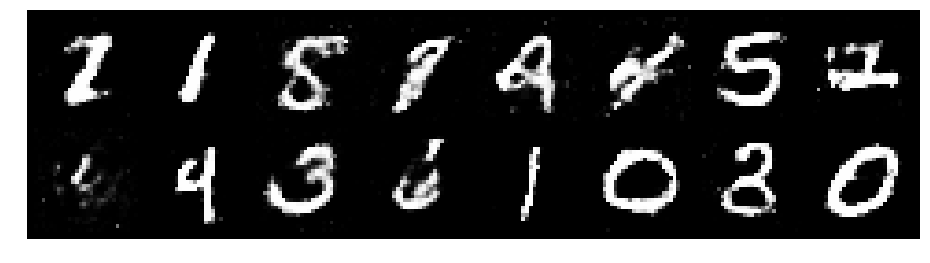

Epoch: [180/200], Batch Num: [300/600]
Discriminator Loss: 1.2633, Generator Loss: 0.8686
D(x): 0.5430, D(G(z)): 0.4506


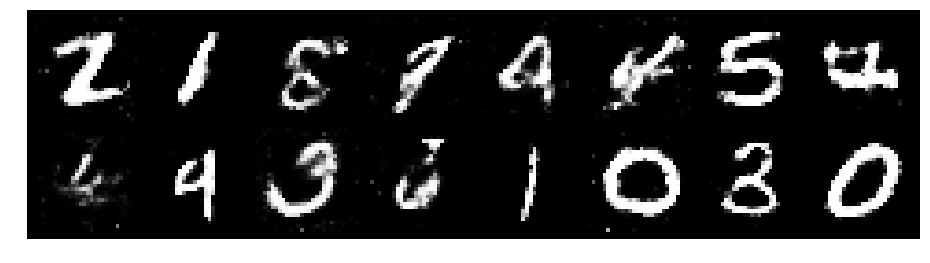

Epoch: [180/200], Batch Num: [400/600]
Discriminator Loss: 1.3247, Generator Loss: 0.8393
D(x): 0.5490, D(G(z)): 0.4785


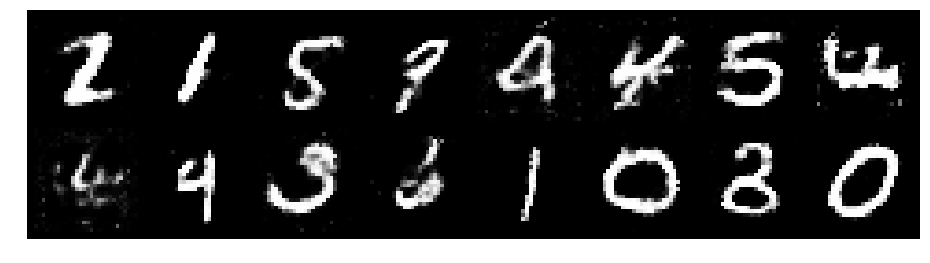

Epoch: [180/200], Batch Num: [500/600]
Discriminator Loss: 1.2659, Generator Loss: 0.8642
D(x): 0.5578, D(G(z)): 0.4585


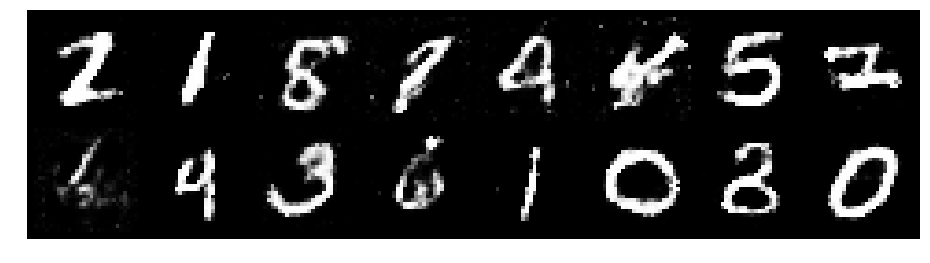

Epoch: [181/200], Batch Num: [0/600]
Discriminator Loss: 1.2265, Generator Loss: 1.0101
D(x): 0.5467, D(G(z)): 0.4132


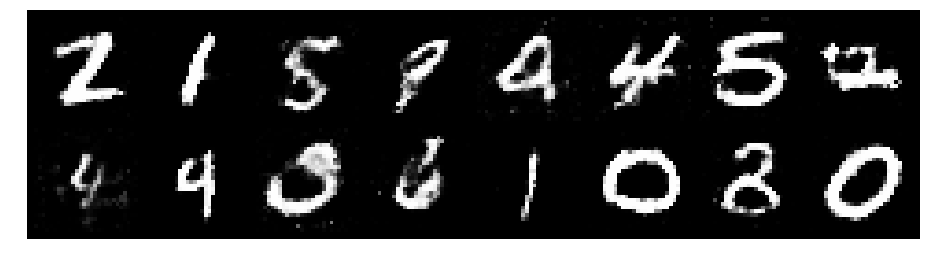

Epoch: [181/200], Batch Num: [100/600]
Discriminator Loss: 1.3169, Generator Loss: 0.8317
D(x): 0.5456, D(G(z)): 0.4669


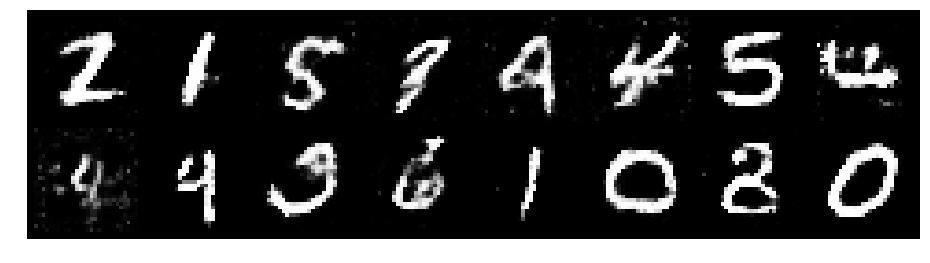

Epoch: [181/200], Batch Num: [200/600]
Discriminator Loss: 1.2322, Generator Loss: 0.8895
D(x): 0.5682, D(G(z)): 0.4534


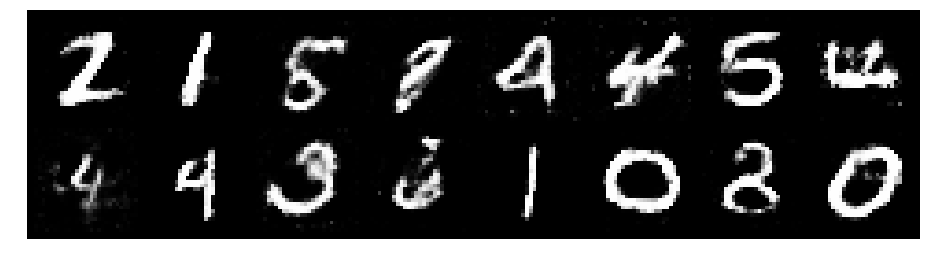

Epoch: [181/200], Batch Num: [300/600]
Discriminator Loss: 1.2321, Generator Loss: 0.8285
D(x): 0.5467, D(G(z)): 0.4331


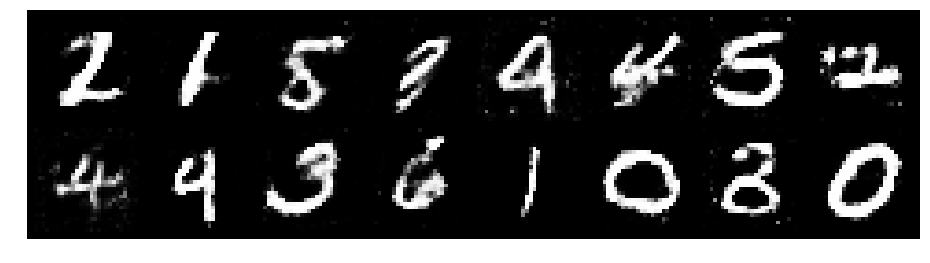

Epoch: [181/200], Batch Num: [400/600]
Discriminator Loss: 1.2632, Generator Loss: 0.8304
D(x): 0.5497, D(G(z)): 0.4492


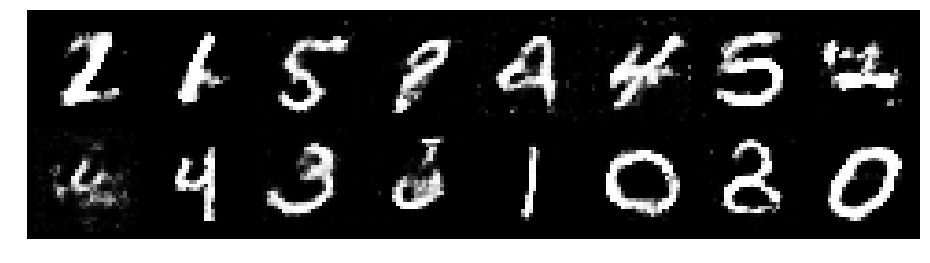

Epoch: [181/200], Batch Num: [500/600]
Discriminator Loss: 1.3082, Generator Loss: 0.8333
D(x): 0.5376, D(G(z)): 0.4688


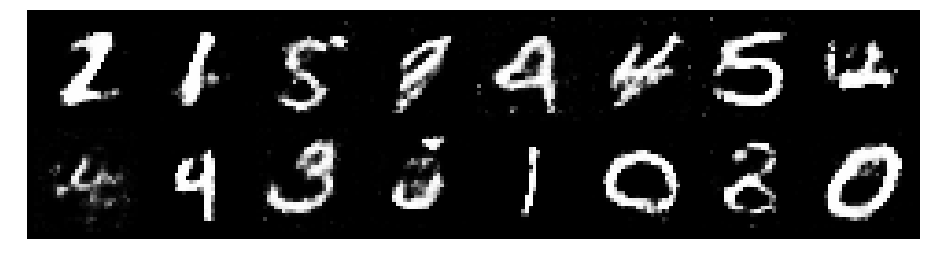

Epoch: [182/200], Batch Num: [0/600]
Discriminator Loss: 1.1778, Generator Loss: 0.9428
D(x): 0.5614, D(G(z)): 0.4226


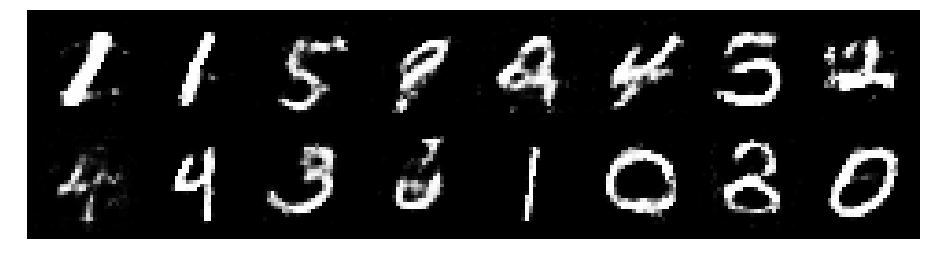

Epoch: [182/200], Batch Num: [100/600]
Discriminator Loss: 1.1742, Generator Loss: 0.7995
D(x): 0.5811, D(G(z)): 0.4305


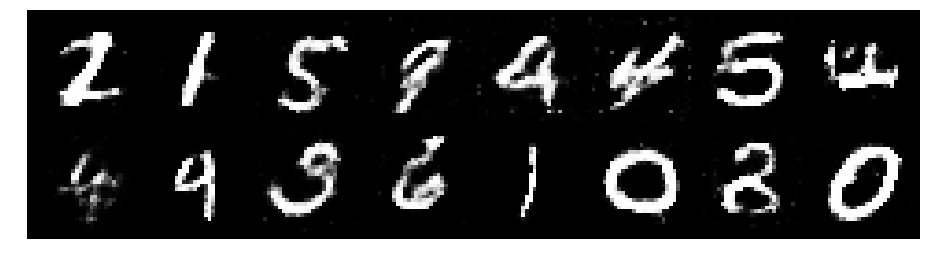

Epoch: [182/200], Batch Num: [200/600]
Discriminator Loss: 1.2433, Generator Loss: 0.9315
D(x): 0.5867, D(G(z)): 0.4580


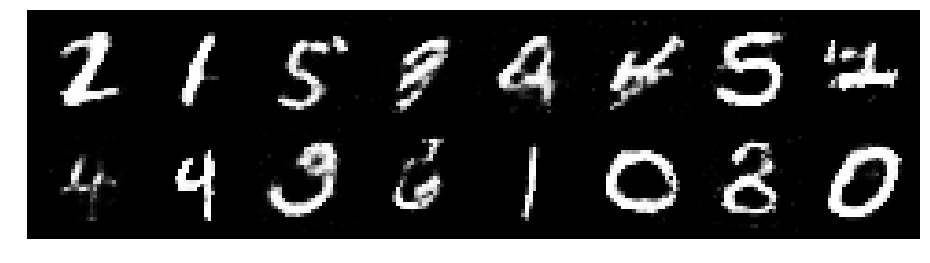

Epoch: [182/200], Batch Num: [300/600]
Discriminator Loss: 1.2366, Generator Loss: 1.0431
D(x): 0.5544, D(G(z)): 0.4259


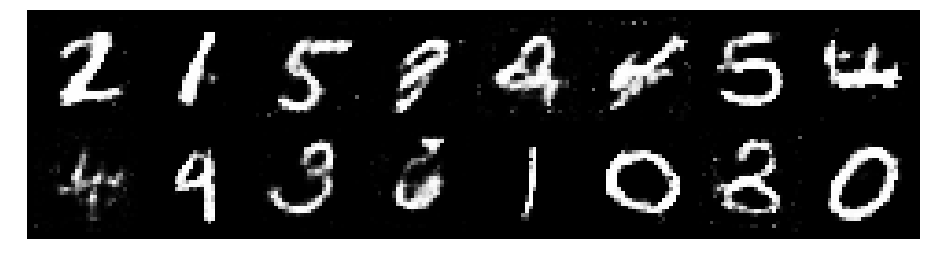

Epoch: [182/200], Batch Num: [400/600]
Discriminator Loss: 1.3209, Generator Loss: 0.8576
D(x): 0.5374, D(G(z)): 0.4571


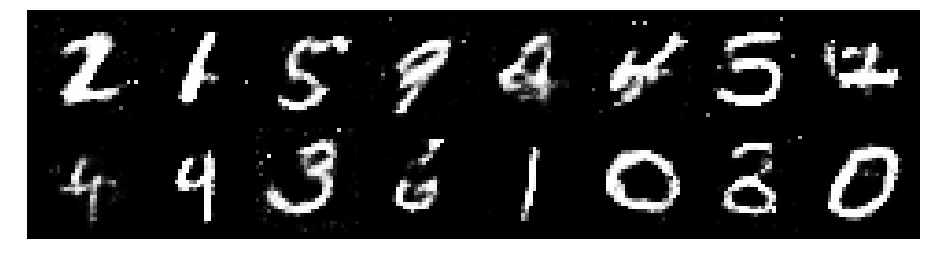

Epoch: [182/200], Batch Num: [500/600]
Discriminator Loss: 1.2956, Generator Loss: 0.8581
D(x): 0.5289, D(G(z)): 0.4306


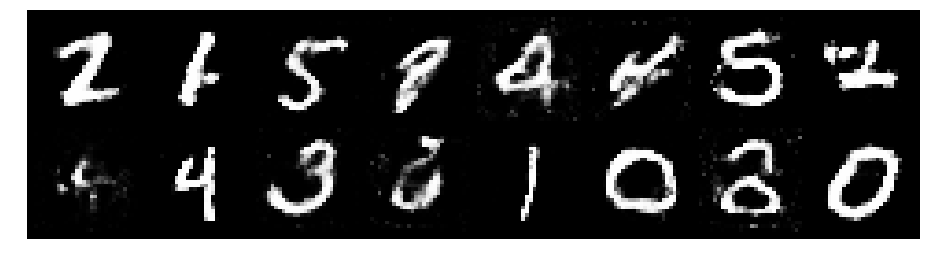

Epoch: [183/200], Batch Num: [0/600]
Discriminator Loss: 1.2092, Generator Loss: 0.8461
D(x): 0.5823, D(G(z)): 0.4480


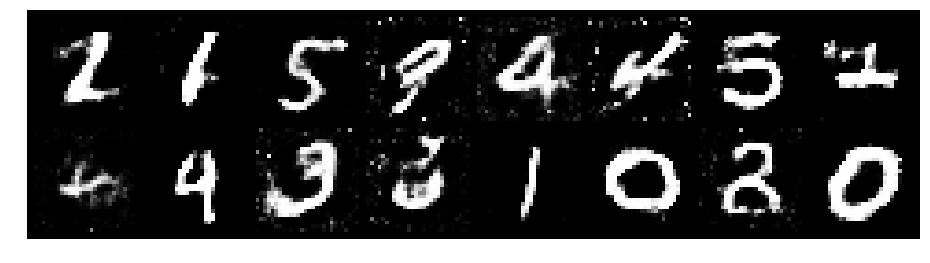

Epoch: [183/200], Batch Num: [100/600]
Discriminator Loss: 1.2933, Generator Loss: 0.7559
D(x): 0.5382, D(G(z)): 0.4508


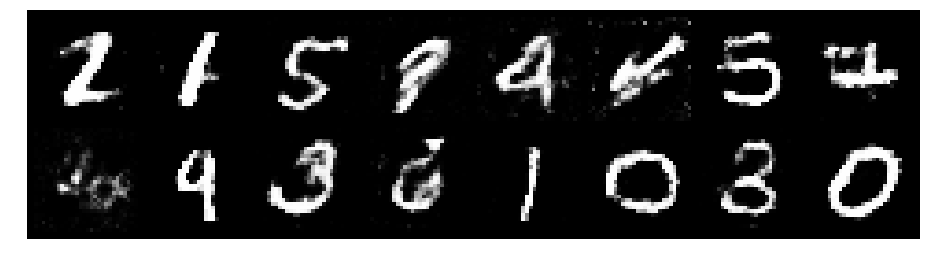

Epoch: [183/200], Batch Num: [200/600]
Discriminator Loss: 1.2396, Generator Loss: 0.8147
D(x): 0.5378, D(G(z)): 0.4344


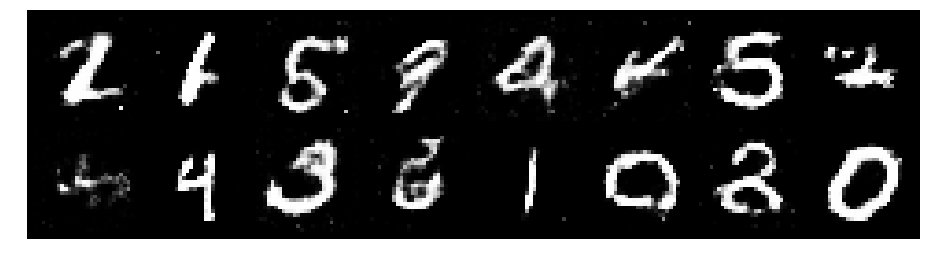

Epoch: [183/200], Batch Num: [300/600]
Discriminator Loss: 1.3620, Generator Loss: 0.8551
D(x): 0.5391, D(G(z)): 0.4831


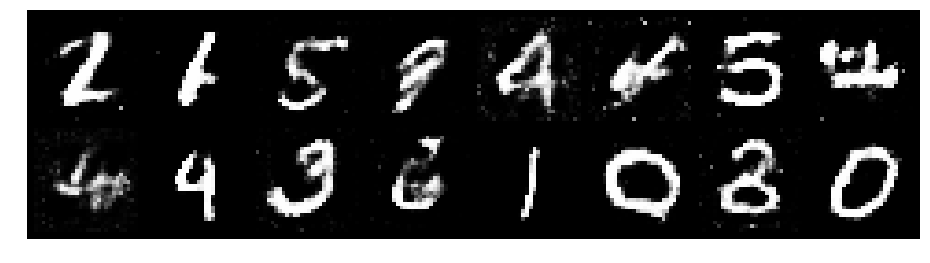

Epoch: [183/200], Batch Num: [400/600]
Discriminator Loss: 1.2855, Generator Loss: 0.7945
D(x): 0.5474, D(G(z)): 0.4645


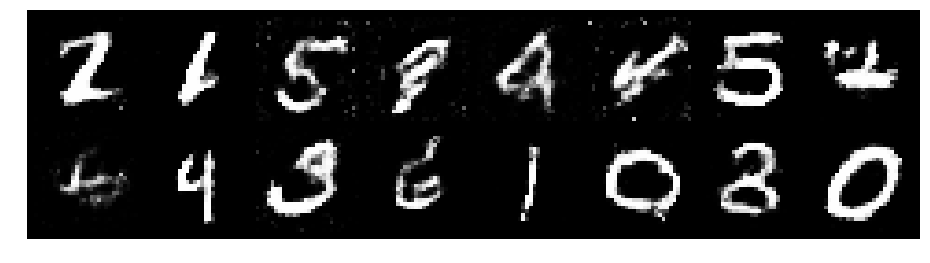

Epoch: [183/200], Batch Num: [500/600]
Discriminator Loss: 1.2965, Generator Loss: 0.7814
D(x): 0.5561, D(G(z)): 0.4662


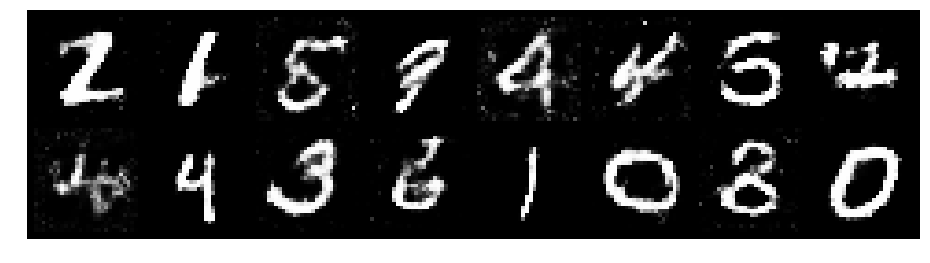

Epoch: [184/200], Batch Num: [0/600]
Discriminator Loss: 1.1959, Generator Loss: 0.9655
D(x): 0.6155, D(G(z)): 0.4580


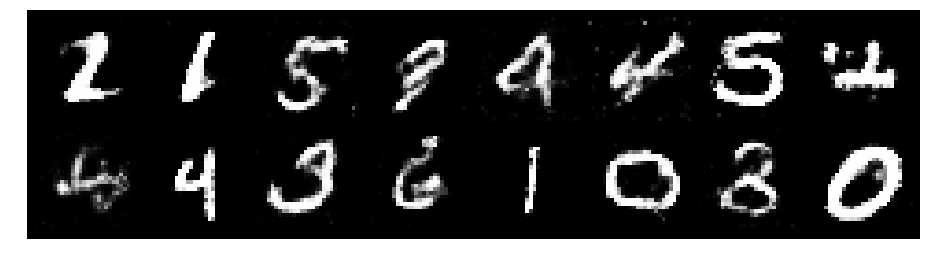

Epoch: [184/200], Batch Num: [100/600]
Discriminator Loss: 1.2274, Generator Loss: 0.9538
D(x): 0.5928, D(G(z)): 0.4519


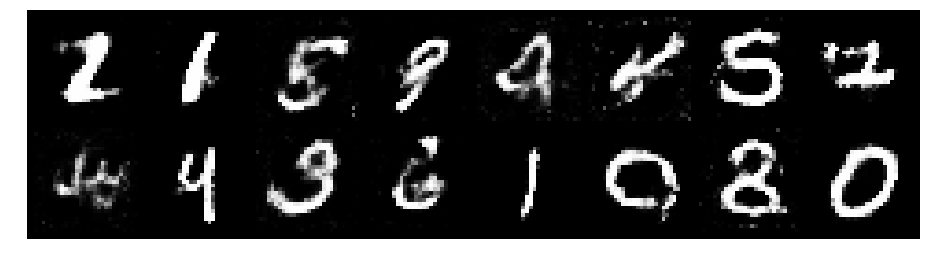

Epoch: [184/200], Batch Num: [200/600]
Discriminator Loss: 1.3002, Generator Loss: 0.8284
D(x): 0.5745, D(G(z)): 0.4822


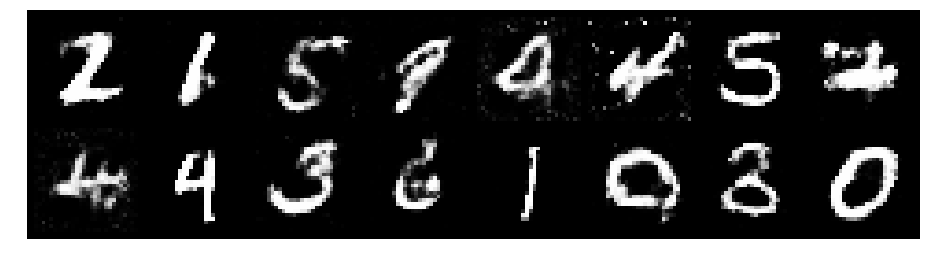

Epoch: [184/200], Batch Num: [300/600]
Discriminator Loss: 1.3605, Generator Loss: 0.8246
D(x): 0.5478, D(G(z)): 0.4944


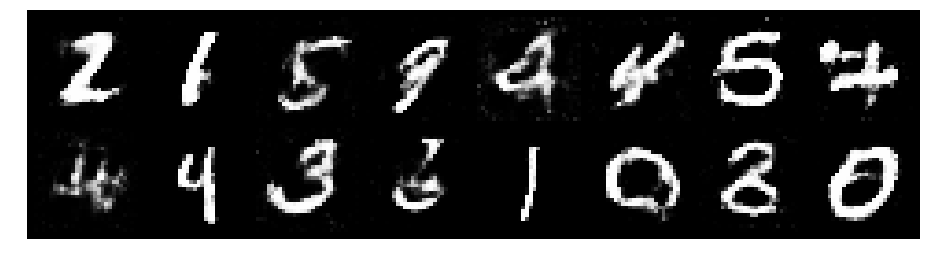

Epoch: [184/200], Batch Num: [400/600]
Discriminator Loss: 1.2696, Generator Loss: 0.9047
D(x): 0.5466, D(G(z)): 0.4355


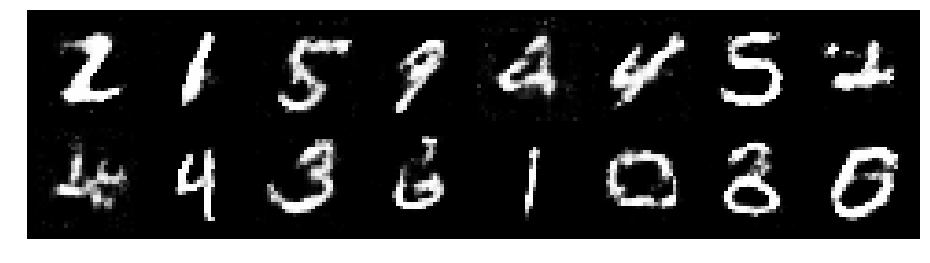

Epoch: [184/200], Batch Num: [500/600]
Discriminator Loss: 1.1804, Generator Loss: 0.8991
D(x): 0.5537, D(G(z)): 0.4033


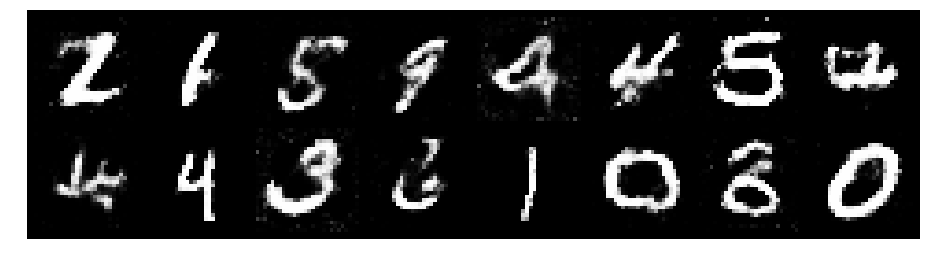

Epoch: [185/200], Batch Num: [0/600]
Discriminator Loss: 1.2994, Generator Loss: 0.9371
D(x): 0.5916, D(G(z)): 0.4744


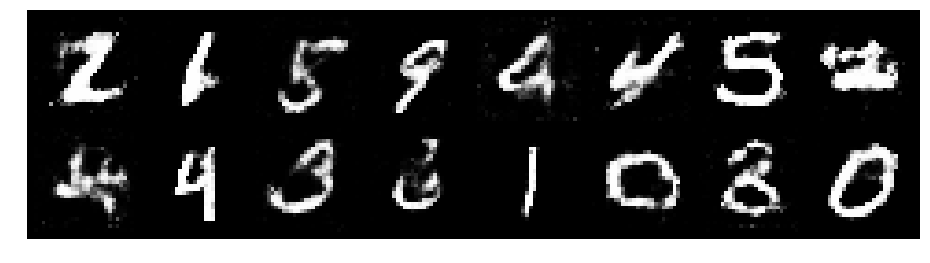

Epoch: [185/200], Batch Num: [100/600]
Discriminator Loss: 1.2192, Generator Loss: 0.9686
D(x): 0.5652, D(G(z)): 0.4087


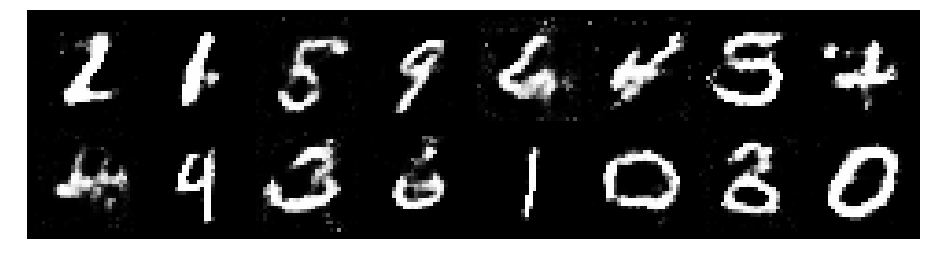

Epoch: [185/200], Batch Num: [200/600]
Discriminator Loss: 1.3311, Generator Loss: 0.8643
D(x): 0.5604, D(G(z)): 0.4585


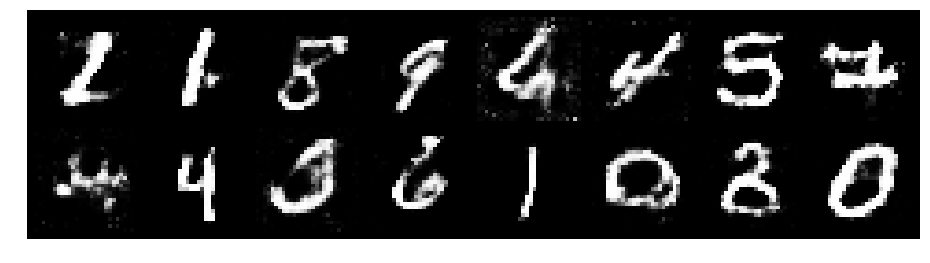

Epoch: [185/200], Batch Num: [300/600]
Discriminator Loss: 1.2870, Generator Loss: 0.9768
D(x): 0.5331, D(G(z)): 0.4194


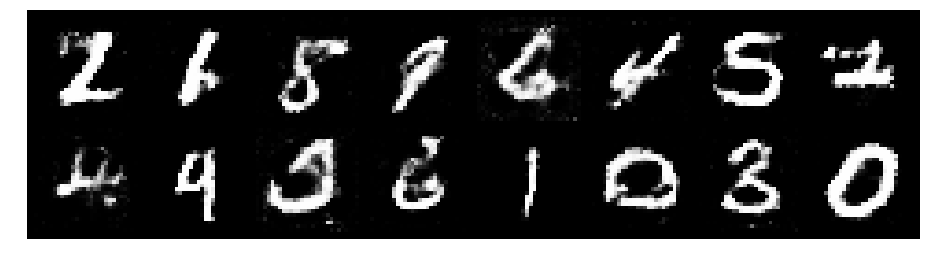

Epoch: [185/200], Batch Num: [400/600]
Discriminator Loss: 1.2587, Generator Loss: 0.9161
D(x): 0.5777, D(G(z)): 0.4448


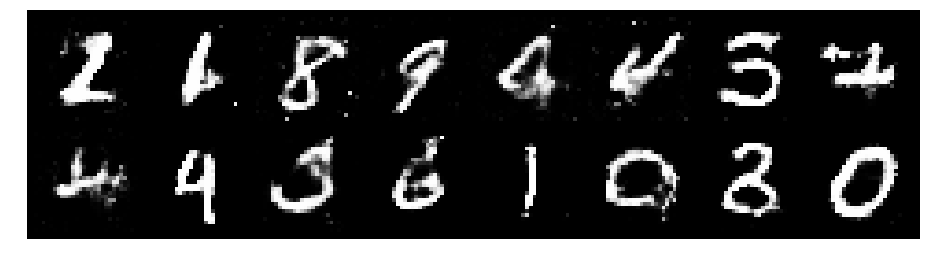

Epoch: [185/200], Batch Num: [500/600]
Discriminator Loss: 1.2240, Generator Loss: 0.8896
D(x): 0.5414, D(G(z)): 0.4132


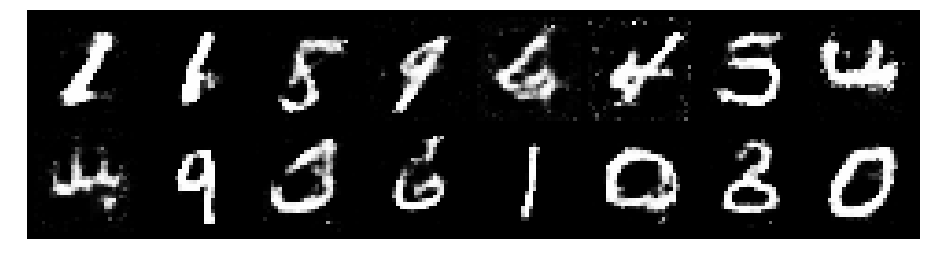

Epoch: [186/200], Batch Num: [0/600]
Discriminator Loss: 1.3181, Generator Loss: 0.7579
D(x): 0.6184, D(G(z)): 0.5044


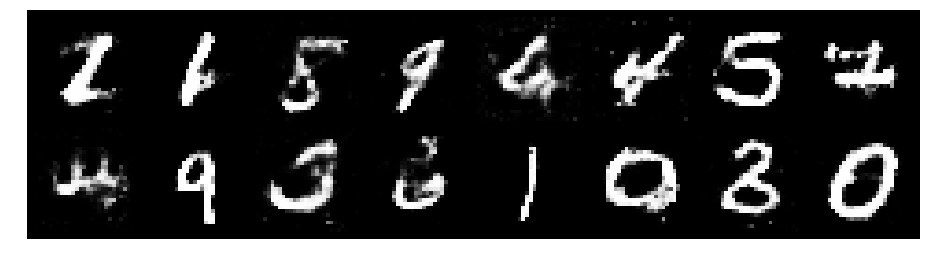

Epoch: [186/200], Batch Num: [100/600]
Discriminator Loss: 1.2808, Generator Loss: 0.9400
D(x): 0.5204, D(G(z)): 0.4132


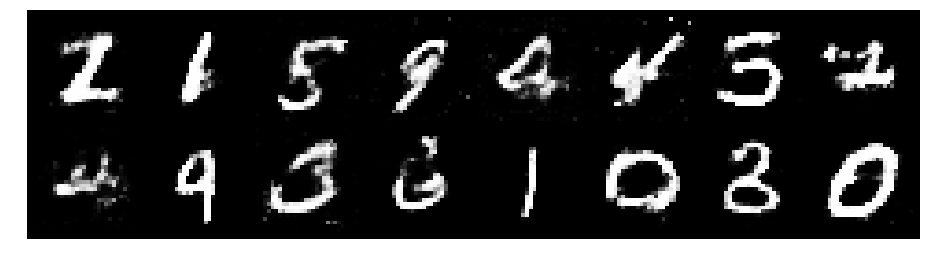

Epoch: [186/200], Batch Num: [200/600]
Discriminator Loss: 1.2623, Generator Loss: 0.8924
D(x): 0.5937, D(G(z)): 0.4883


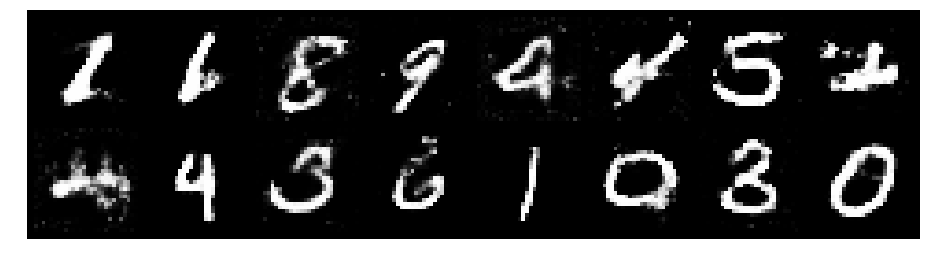

Epoch: [186/200], Batch Num: [300/600]
Discriminator Loss: 1.2410, Generator Loss: 0.8828
D(x): 0.5907, D(G(z)): 0.4609


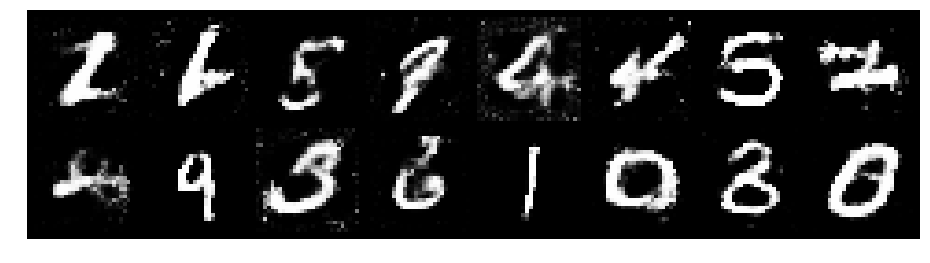

Epoch: [186/200], Batch Num: [400/600]
Discriminator Loss: 1.3126, Generator Loss: 0.8779
D(x): 0.5565, D(G(z)): 0.4546


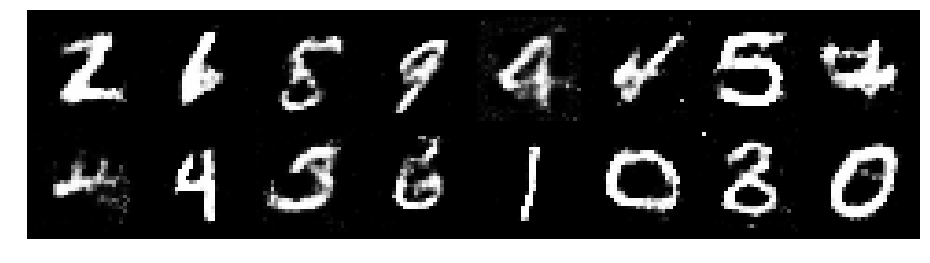

Epoch: [186/200], Batch Num: [500/600]
Discriminator Loss: 1.2411, Generator Loss: 1.0295
D(x): 0.5614, D(G(z)): 0.4194


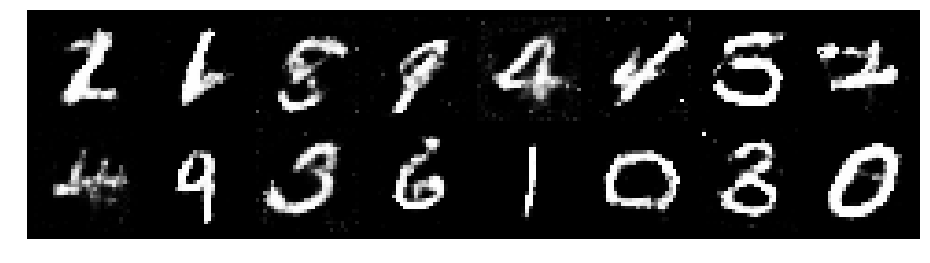

Epoch: [187/200], Batch Num: [0/600]
Discriminator Loss: 1.2732, Generator Loss: 0.8065
D(x): 0.5595, D(G(z)): 0.4721


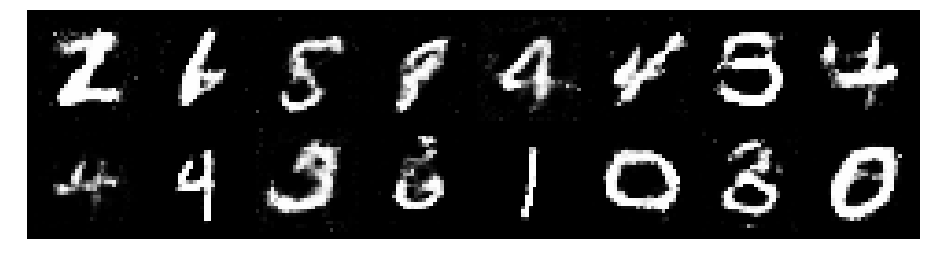

Epoch: [187/200], Batch Num: [100/600]
Discriminator Loss: 1.1479, Generator Loss: 0.9100
D(x): 0.5952, D(G(z)): 0.4128


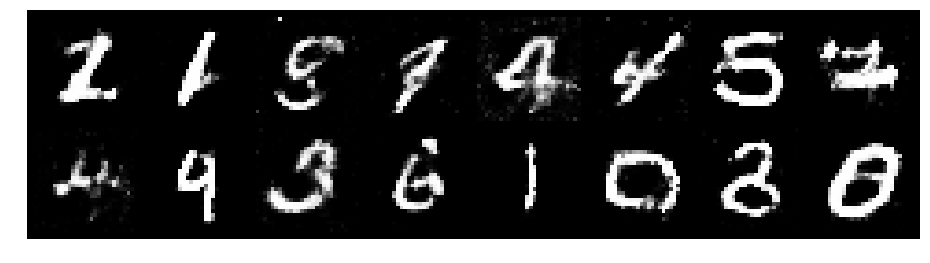

Epoch: [187/200], Batch Num: [200/600]
Discriminator Loss: 1.2285, Generator Loss: 0.9422
D(x): 0.5802, D(G(z)): 0.4415


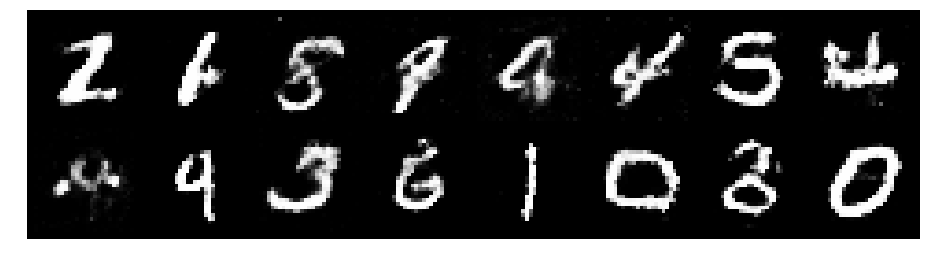

Epoch: [187/200], Batch Num: [300/600]
Discriminator Loss: 1.2530, Generator Loss: 0.8340
D(x): 0.5468, D(G(z)): 0.4326


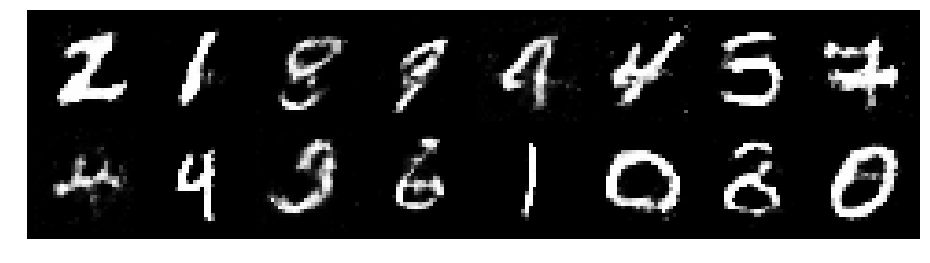

Epoch: [187/200], Batch Num: [400/600]
Discriminator Loss: 1.3346, Generator Loss: 0.8524
D(x): 0.5317, D(G(z)): 0.4724


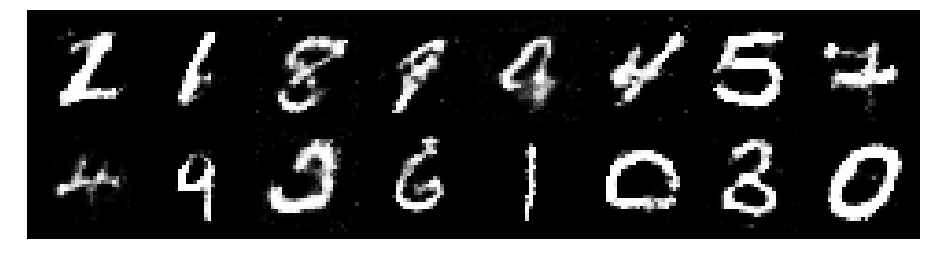

Epoch: [187/200], Batch Num: [500/600]
Discriminator Loss: 1.2084, Generator Loss: 0.8395
D(x): 0.5541, D(G(z)): 0.4250


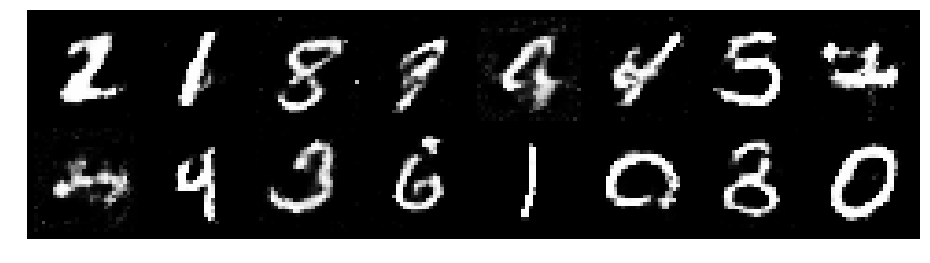

Epoch: [188/200], Batch Num: [0/600]
Discriminator Loss: 1.2665, Generator Loss: 0.9290
D(x): 0.5723, D(G(z)): 0.4458


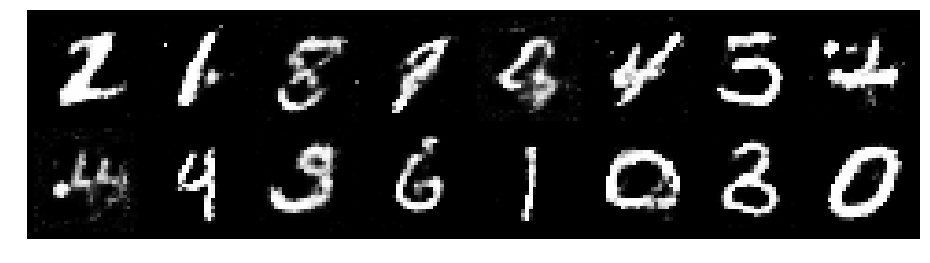

Epoch: [188/200], Batch Num: [100/600]
Discriminator Loss: 1.2192, Generator Loss: 0.8977
D(x): 0.5814, D(G(z)): 0.4573


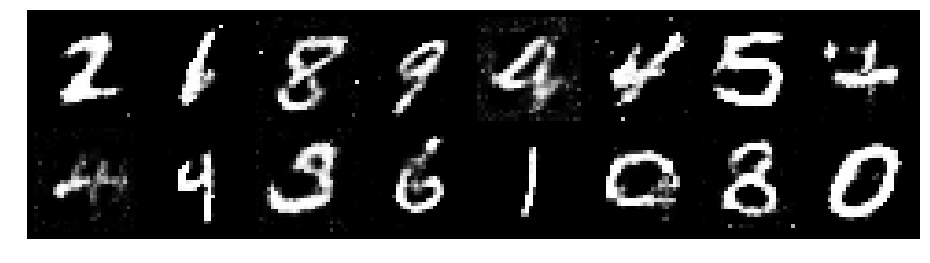

Epoch: [188/200], Batch Num: [200/600]
Discriminator Loss: 1.3419, Generator Loss: 0.9612
D(x): 0.5382, D(G(z)): 0.4522


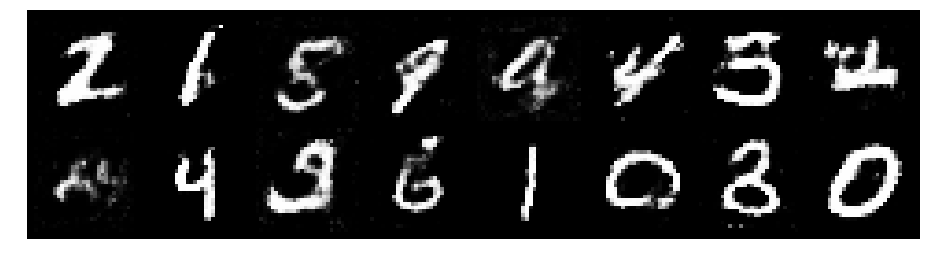

Epoch: [188/200], Batch Num: [300/600]
Discriminator Loss: 1.2820, Generator Loss: 0.8426
D(x): 0.5646, D(G(z)): 0.4490


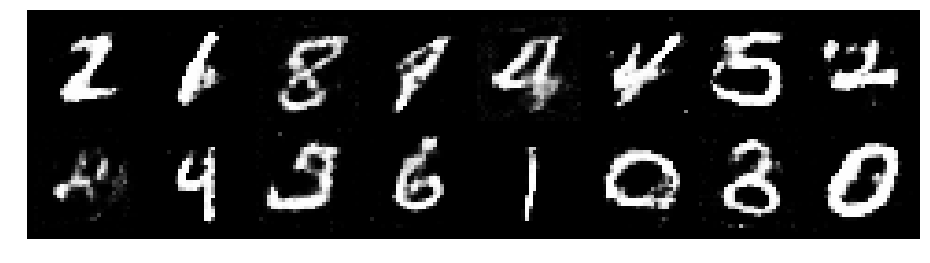

Epoch: [188/200], Batch Num: [400/600]
Discriminator Loss: 1.4214, Generator Loss: 0.7779
D(x): 0.5117, D(G(z)): 0.4831


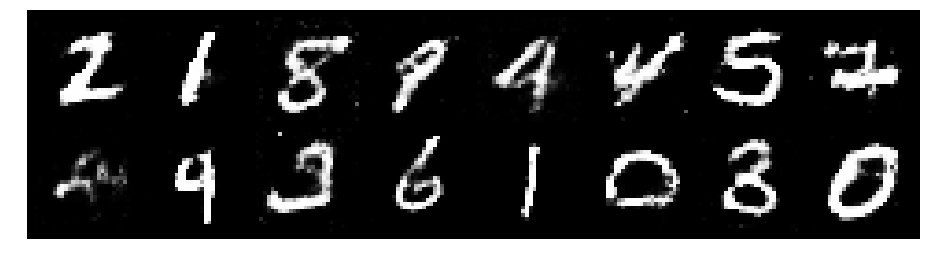

Epoch: [188/200], Batch Num: [500/600]
Discriminator Loss: 1.3210, Generator Loss: 0.7750
D(x): 0.5305, D(G(z)): 0.4496


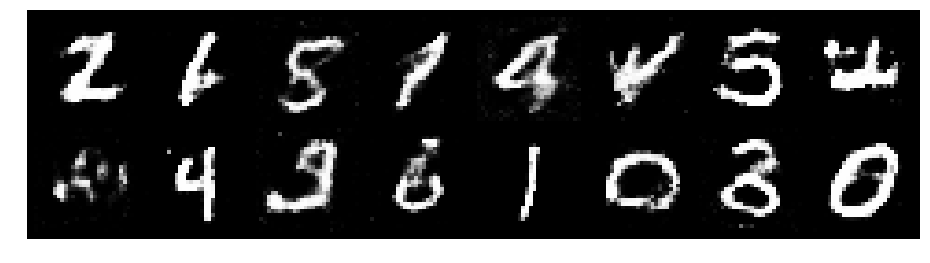

Epoch: [189/200], Batch Num: [0/600]
Discriminator Loss: 1.2899, Generator Loss: 0.8987
D(x): 0.5464, D(G(z)): 0.4493


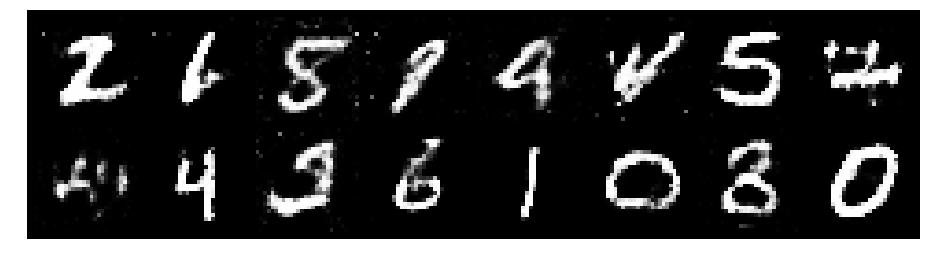

Epoch: [189/200], Batch Num: [100/600]
Discriminator Loss: 1.2029, Generator Loss: 0.8775
D(x): 0.5525, D(G(z)): 0.4233


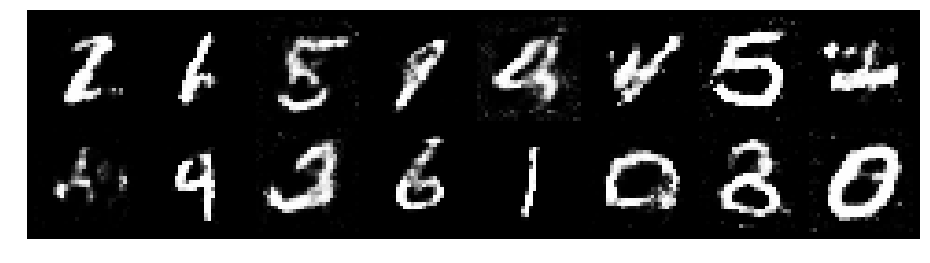

Epoch: [189/200], Batch Num: [200/600]
Discriminator Loss: 1.3160, Generator Loss: 0.8102
D(x): 0.6034, D(G(z)): 0.4939


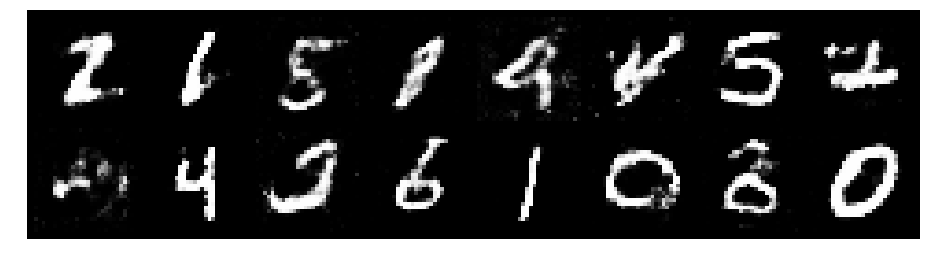

Epoch: [189/200], Batch Num: [300/600]
Discriminator Loss: 1.3937, Generator Loss: 0.8718
D(x): 0.5113, D(G(z)): 0.4734


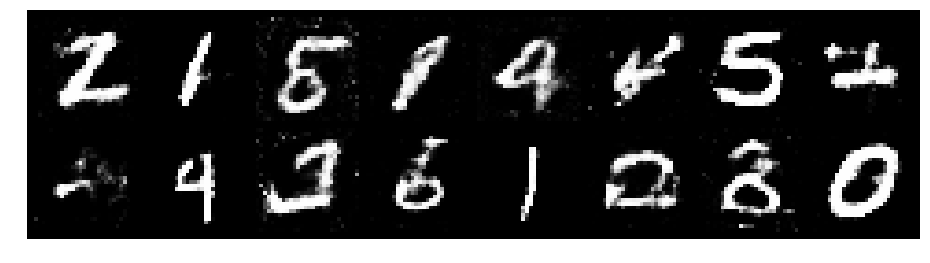

Epoch: [189/200], Batch Num: [400/600]
Discriminator Loss: 1.3602, Generator Loss: 0.8667
D(x): 0.4836, D(G(z)): 0.4329


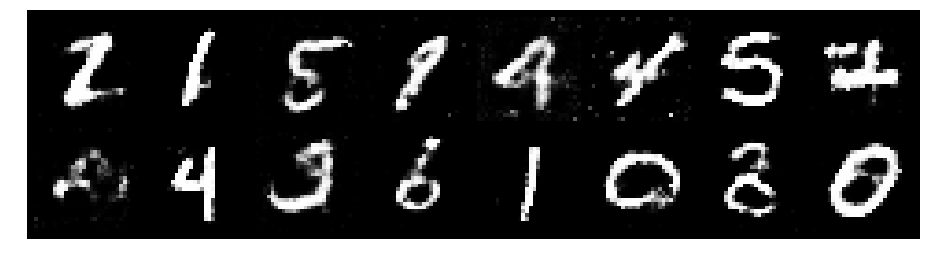

Epoch: [189/200], Batch Num: [500/600]
Discriminator Loss: 1.2536, Generator Loss: 0.9806
D(x): 0.5373, D(G(z)): 0.4227


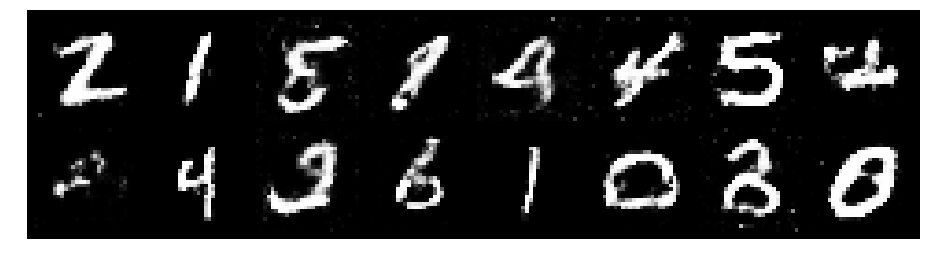

Epoch: [190/200], Batch Num: [0/600]
Discriminator Loss: 1.2576, Generator Loss: 0.8986
D(x): 0.5495, D(G(z)): 0.4465


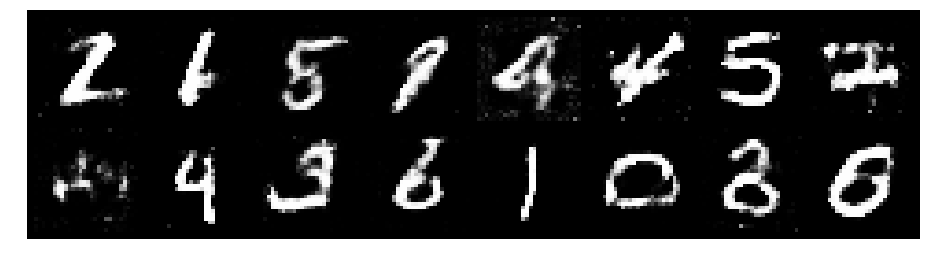

Epoch: [190/200], Batch Num: [100/600]
Discriminator Loss: 1.3353, Generator Loss: 1.0619
D(x): 0.5590, D(G(z)): 0.4489


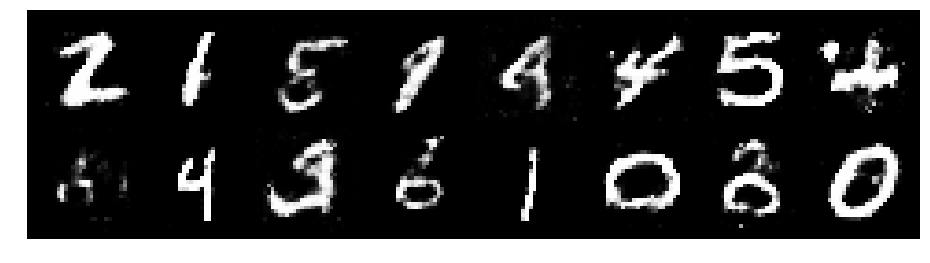

Epoch: [190/200], Batch Num: [200/600]
Discriminator Loss: 1.3677, Generator Loss: 0.9151
D(x): 0.5438, D(G(z)): 0.4770


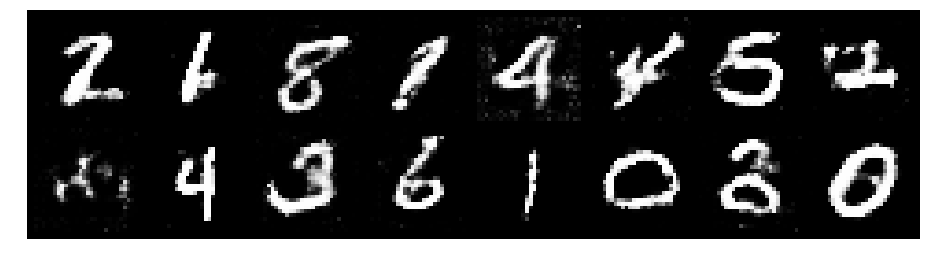

Epoch: [190/200], Batch Num: [300/600]
Discriminator Loss: 1.2394, Generator Loss: 0.8667
D(x): 0.5594, D(G(z)): 0.4361


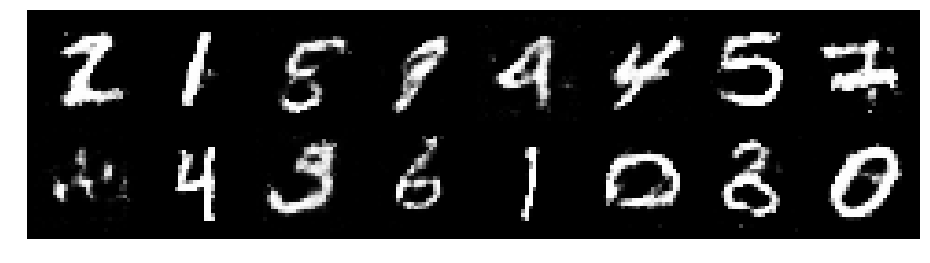

Epoch: [190/200], Batch Num: [400/600]
Discriminator Loss: 1.2510, Generator Loss: 0.8566
D(x): 0.5736, D(G(z)): 0.4490


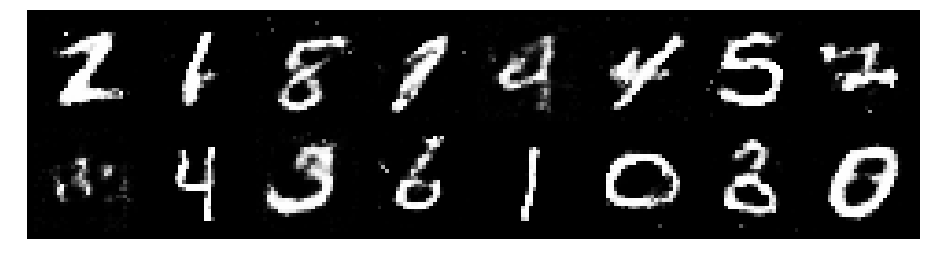

Epoch: [190/200], Batch Num: [500/600]
Discriminator Loss: 1.3491, Generator Loss: 0.9450
D(x): 0.5459, D(G(z)): 0.4643


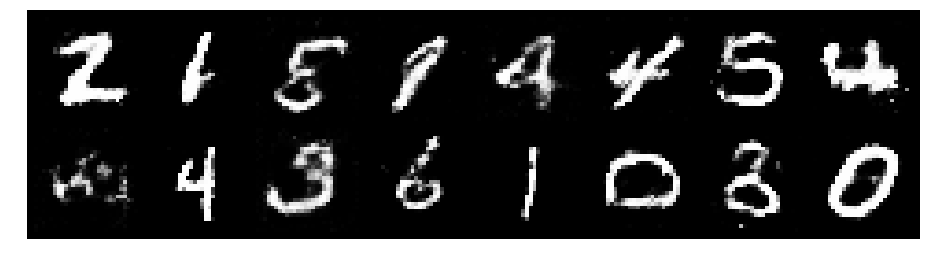

Epoch: [191/200], Batch Num: [0/600]
Discriminator Loss: 1.3687, Generator Loss: 0.8545
D(x): 0.5227, D(G(z)): 0.4664


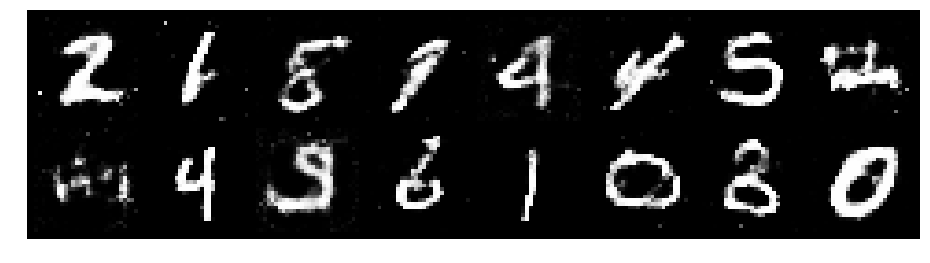

Epoch: [191/200], Batch Num: [100/600]
Discriminator Loss: 1.1606, Generator Loss: 0.9179
D(x): 0.5845, D(G(z)): 0.4297


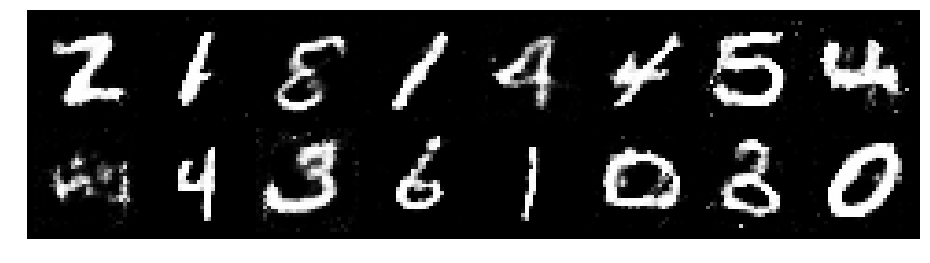

Epoch: [191/200], Batch Num: [200/600]
Discriminator Loss: 1.3586, Generator Loss: 0.9616
D(x): 0.5362, D(G(z)): 0.4502


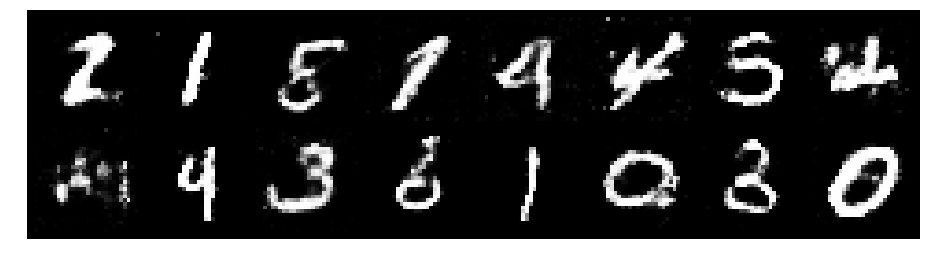

Epoch: [191/200], Batch Num: [300/600]
Discriminator Loss: 1.2733, Generator Loss: 0.8915
D(x): 0.5639, D(G(z)): 0.4400


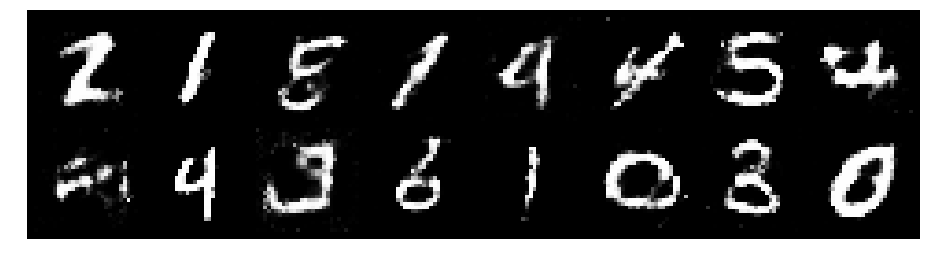

Epoch: [191/200], Batch Num: [400/600]
Discriminator Loss: 1.2781, Generator Loss: 0.8936
D(x): 0.5092, D(G(z)): 0.4170


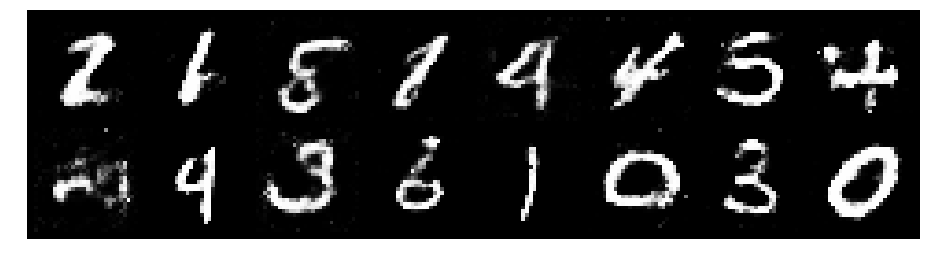

Epoch: [191/200], Batch Num: [500/600]
Discriminator Loss: 1.3201, Generator Loss: 0.8510
D(x): 0.5851, D(G(z)): 0.4963


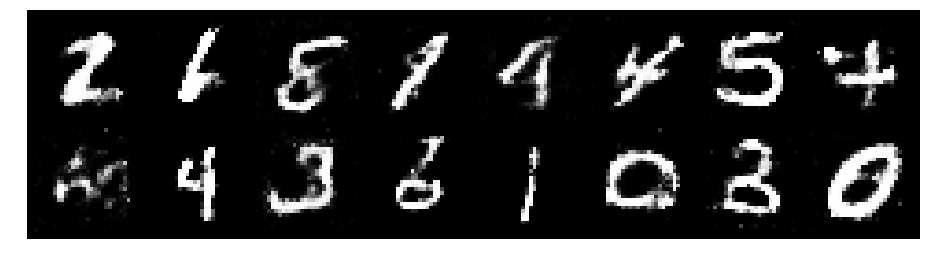

Epoch: [192/200], Batch Num: [0/600]
Discriminator Loss: 1.3204, Generator Loss: 0.7841
D(x): 0.5598, D(G(z)): 0.4901


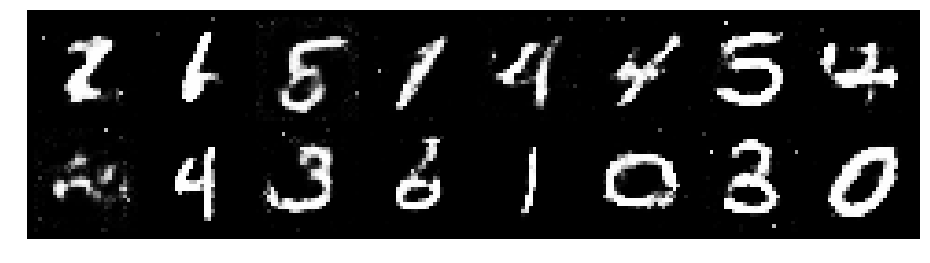

Epoch: [192/200], Batch Num: [100/600]
Discriminator Loss: 1.2927, Generator Loss: 0.8732
D(x): 0.5286, D(G(z)): 0.4436


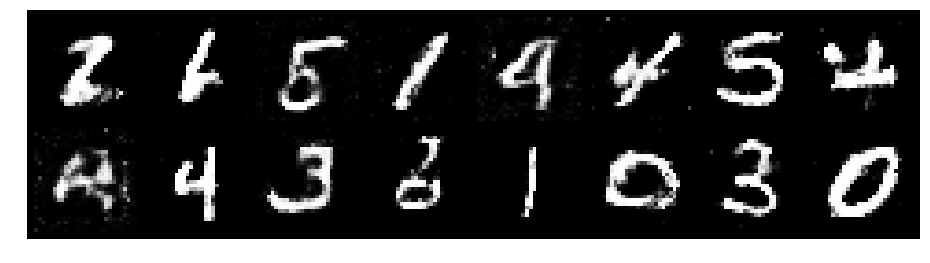

Epoch: [192/200], Batch Num: [200/600]
Discriminator Loss: 1.2023, Generator Loss: 0.8551
D(x): 0.5830, D(G(z)): 0.4353


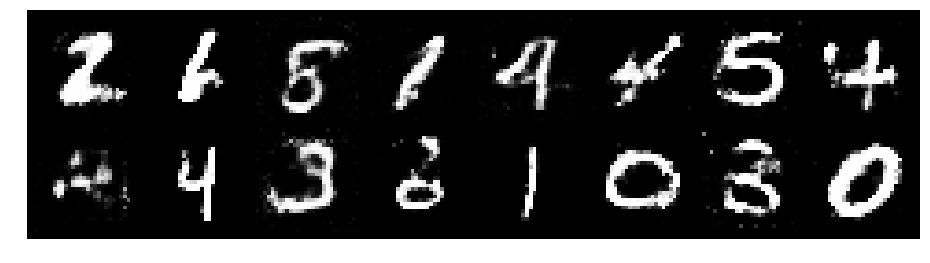

Epoch: [192/200], Batch Num: [300/600]
Discriminator Loss: 1.3499, Generator Loss: 0.8915
D(x): 0.5499, D(G(z)): 0.4705


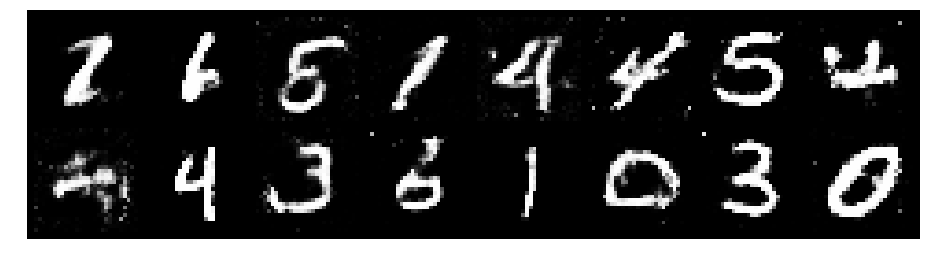

Epoch: [192/200], Batch Num: [400/600]
Discriminator Loss: 1.2706, Generator Loss: 0.8984
D(x): 0.5463, D(G(z)): 0.4348


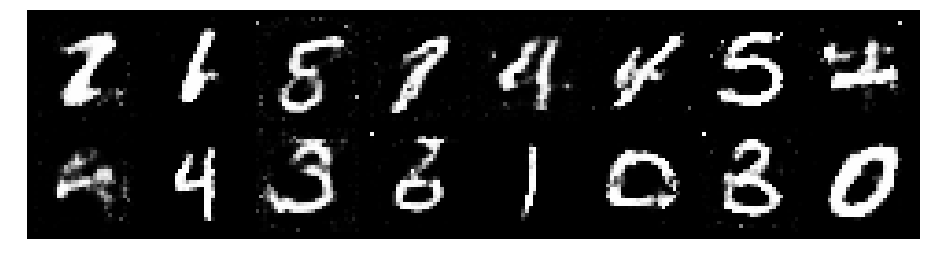

Epoch: [192/200], Batch Num: [500/600]
Discriminator Loss: 1.2598, Generator Loss: 0.9596
D(x): 0.5508, D(G(z)): 0.4341


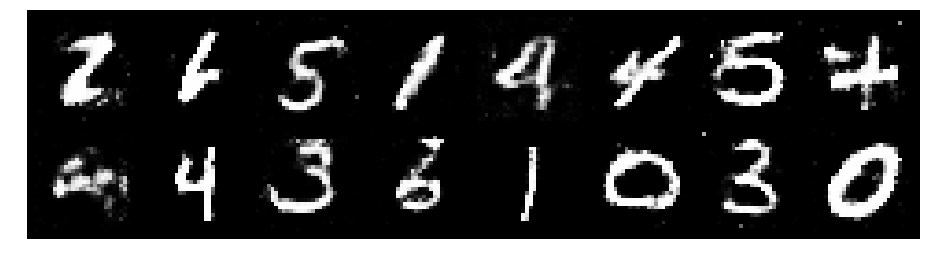

Epoch: [193/200], Batch Num: [0/600]
Discriminator Loss: 1.2521, Generator Loss: 0.8555
D(x): 0.5268, D(G(z)): 0.4269


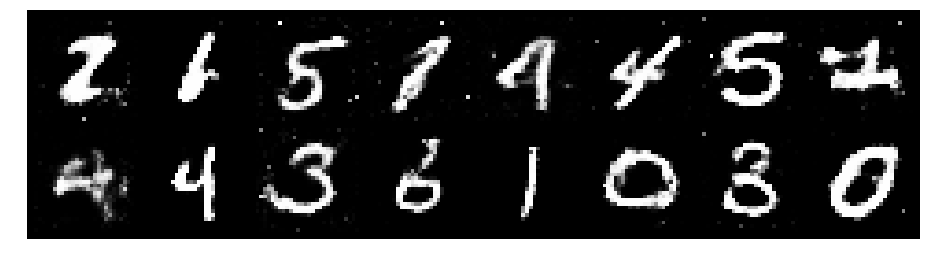

Epoch: [193/200], Batch Num: [100/600]
Discriminator Loss: 1.2915, Generator Loss: 0.8872
D(x): 0.5183, D(G(z)): 0.4310


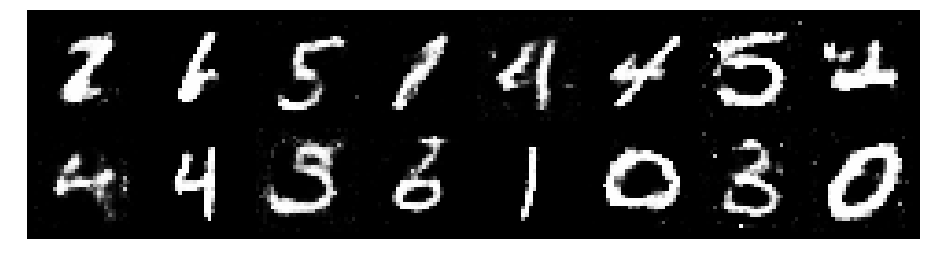

Epoch: [193/200], Batch Num: [200/600]
Discriminator Loss: 1.2832, Generator Loss: 0.9668
D(x): 0.5277, D(G(z)): 0.4227


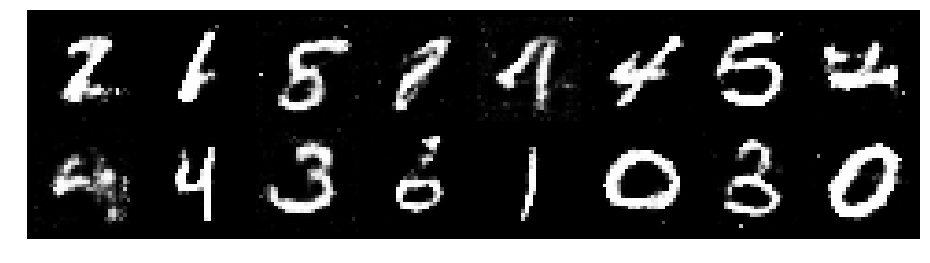

Epoch: [193/200], Batch Num: [300/600]
Discriminator Loss: 1.3347, Generator Loss: 0.9060
D(x): 0.5096, D(G(z)): 0.4265


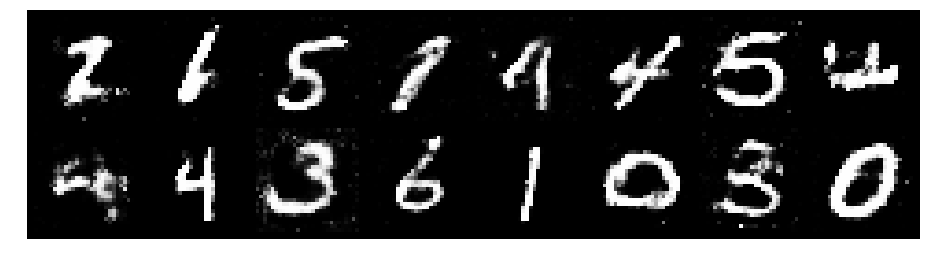

Epoch: [193/200], Batch Num: [400/600]
Discriminator Loss: 1.2373, Generator Loss: 0.8672
D(x): 0.5691, D(G(z)): 0.4359


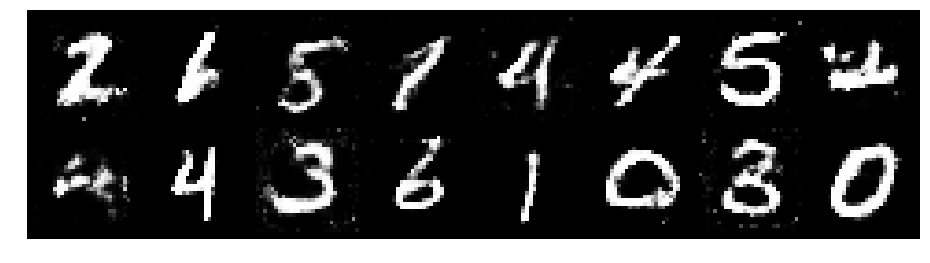

Epoch: [193/200], Batch Num: [500/600]
Discriminator Loss: 1.2696, Generator Loss: 0.8767
D(x): 0.5701, D(G(z)): 0.4566


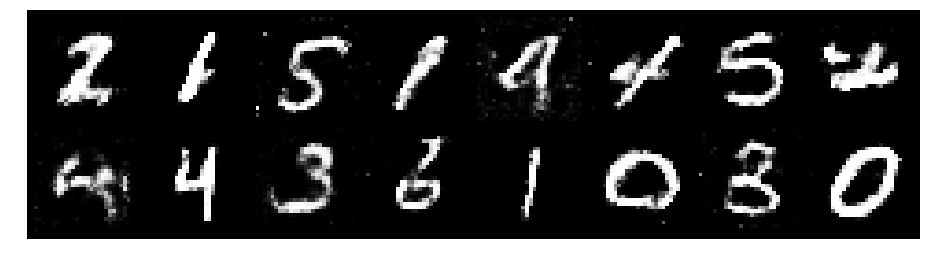

Epoch: [194/200], Batch Num: [0/600]
Discriminator Loss: 1.2315, Generator Loss: 0.9409
D(x): 0.5295, D(G(z)): 0.4262


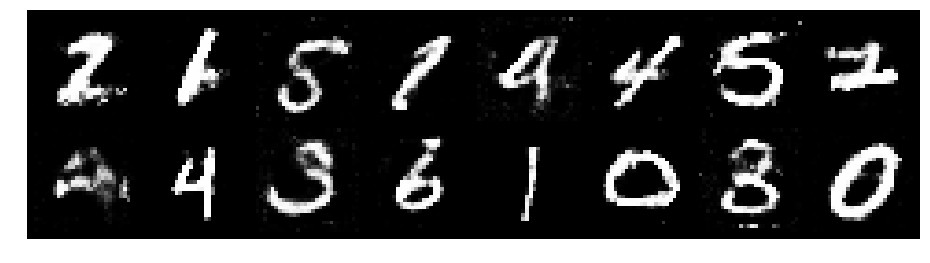

Epoch: [194/200], Batch Num: [100/600]
Discriminator Loss: 1.2077, Generator Loss: 0.8793
D(x): 0.6044, D(G(z)): 0.4625


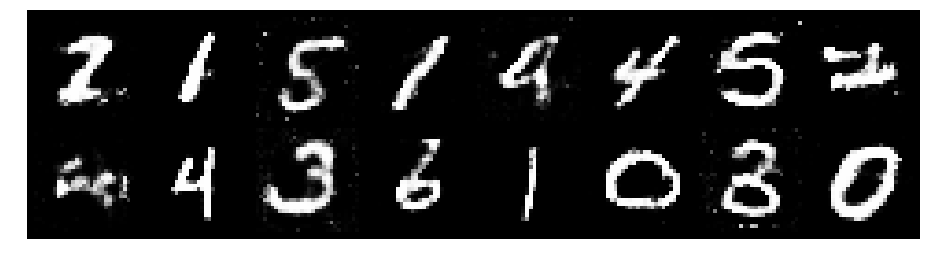

Epoch: [194/200], Batch Num: [200/600]
Discriminator Loss: 1.2461, Generator Loss: 0.9232
D(x): 0.5622, D(G(z)): 0.4507


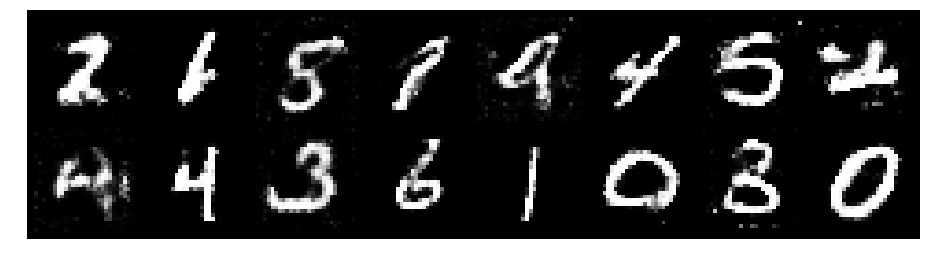

Epoch: [194/200], Batch Num: [300/600]
Discriminator Loss: 1.1834, Generator Loss: 0.8311
D(x): 0.6027, D(G(z)): 0.4424


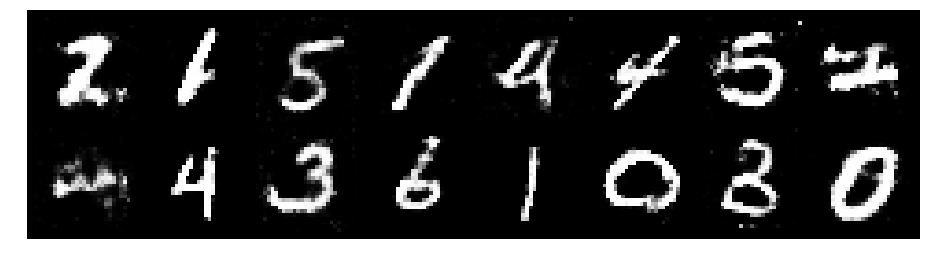

Epoch: [194/200], Batch Num: [400/600]
Discriminator Loss: 1.3293, Generator Loss: 0.9472
D(x): 0.5770, D(G(z)): 0.4792


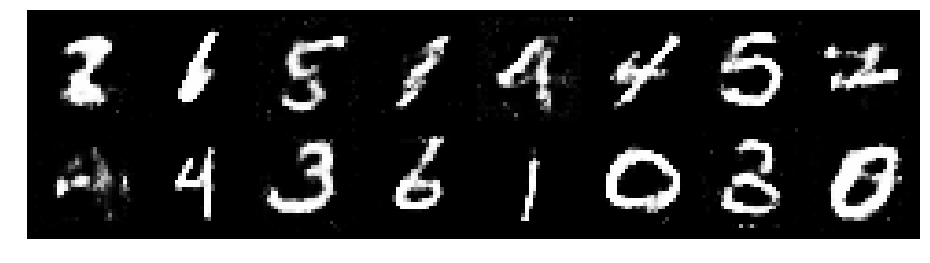

Epoch: [194/200], Batch Num: [500/600]
Discriminator Loss: 1.3930, Generator Loss: 0.8484
D(x): 0.5557, D(G(z)): 0.4978


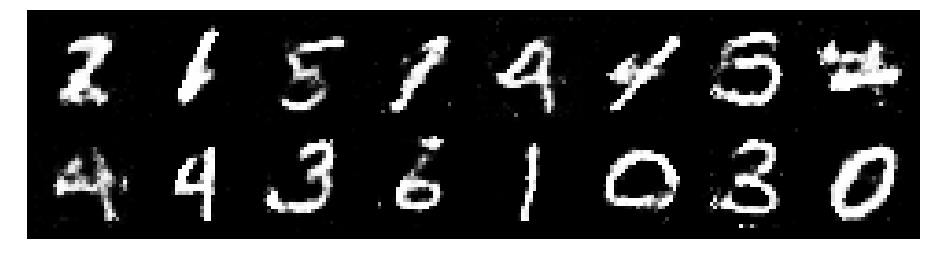

Epoch: [195/200], Batch Num: [0/600]
Discriminator Loss: 1.3746, Generator Loss: 0.8933
D(x): 0.5296, D(G(z)): 0.4590


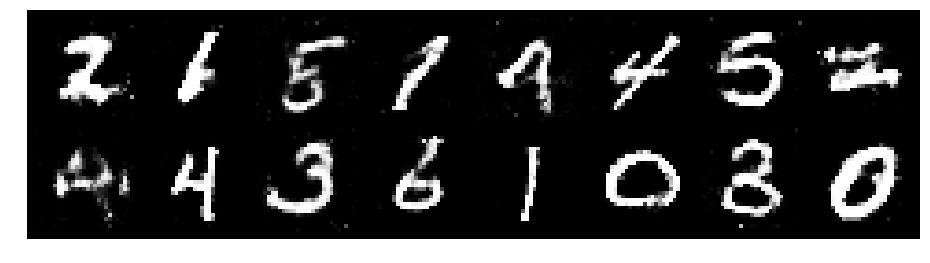

Epoch: [195/200], Batch Num: [100/600]
Discriminator Loss: 1.3764, Generator Loss: 0.7770
D(x): 0.5314, D(G(z)): 0.4859


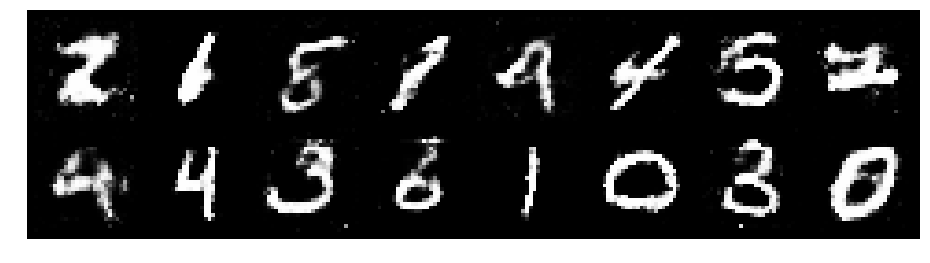

Epoch: [195/200], Batch Num: [200/600]
Discriminator Loss: 1.1686, Generator Loss: 0.8244
D(x): 0.5705, D(G(z)): 0.4210


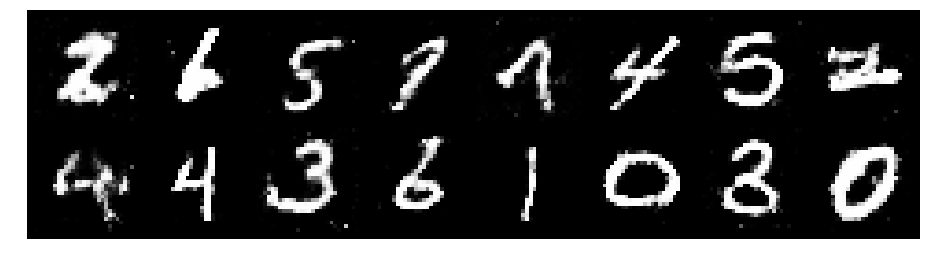

Epoch: [195/200], Batch Num: [300/600]
Discriminator Loss: 1.2912, Generator Loss: 0.9540
D(x): 0.5442, D(G(z)): 0.4470


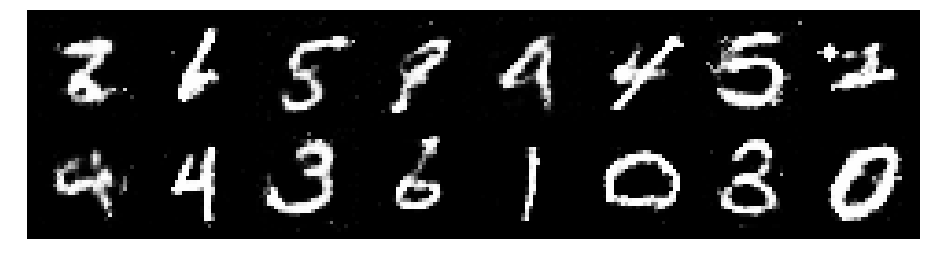

Epoch: [195/200], Batch Num: [400/600]
Discriminator Loss: 1.2982, Generator Loss: 0.8212
D(x): 0.5246, D(G(z)): 0.4363


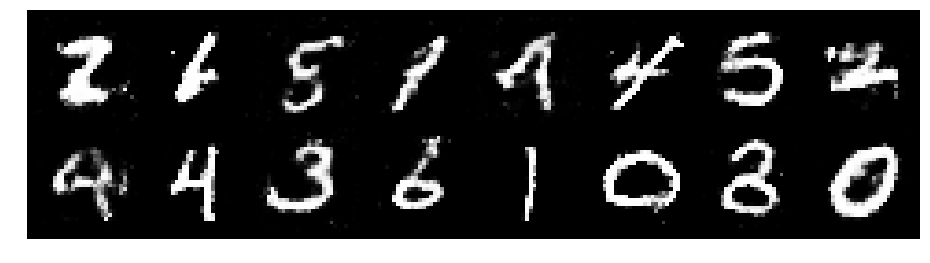

Epoch: [195/200], Batch Num: [500/600]
Discriminator Loss: 1.3098, Generator Loss: 0.8977
D(x): 0.5404, D(G(z)): 0.4518


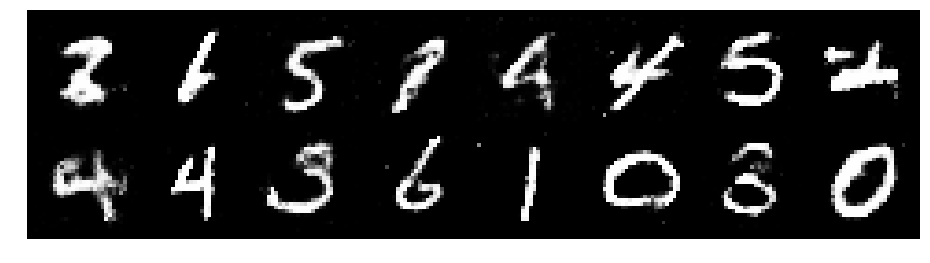

Epoch: [196/200], Batch Num: [0/600]
Discriminator Loss: 1.3506, Generator Loss: 0.8288
D(x): 0.5157, D(G(z)): 0.4549


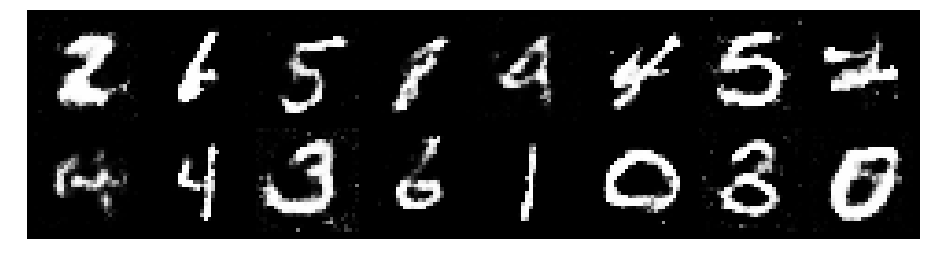

Epoch: [196/200], Batch Num: [100/600]
Discriminator Loss: 1.1746, Generator Loss: 0.8917
D(x): 0.6030, D(G(z)): 0.4536


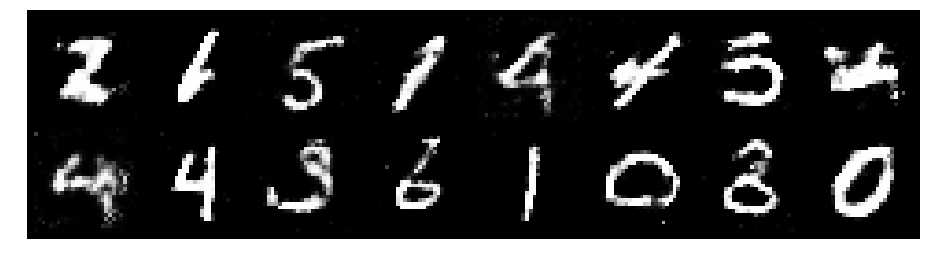

Epoch: [196/200], Batch Num: [200/600]
Discriminator Loss: 1.2677, Generator Loss: 0.9388
D(x): 0.5125, D(G(z)): 0.4065


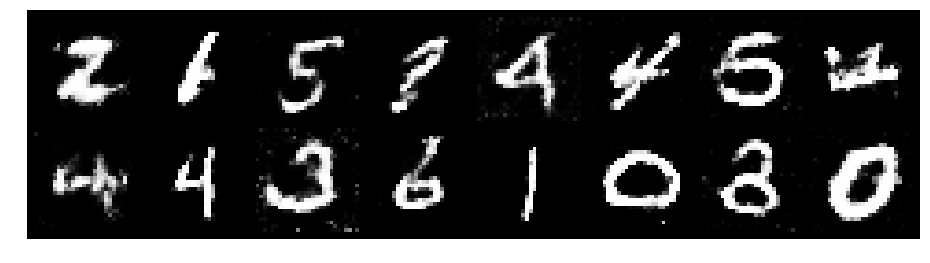

Epoch: [196/200], Batch Num: [300/600]
Discriminator Loss: 1.3596, Generator Loss: 0.9504
D(x): 0.5168, D(G(z)): 0.4545


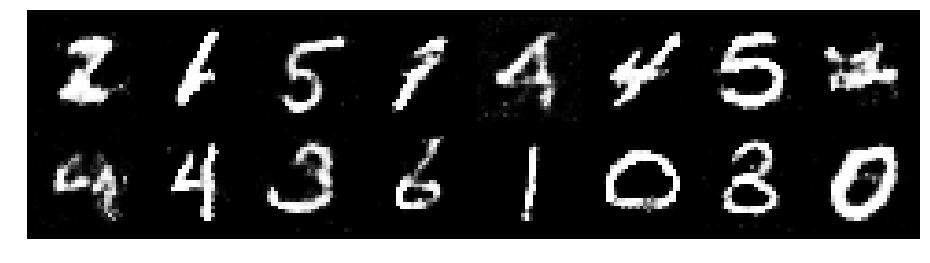

Epoch: [196/200], Batch Num: [400/600]
Discriminator Loss: 1.3481, Generator Loss: 0.8249
D(x): 0.5240, D(G(z)): 0.4668


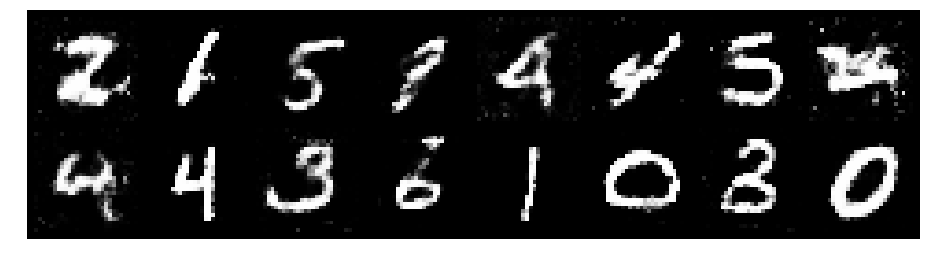

Epoch: [196/200], Batch Num: [500/600]
Discriminator Loss: 1.3040, Generator Loss: 0.8943
D(x): 0.5532, D(G(z)): 0.4419


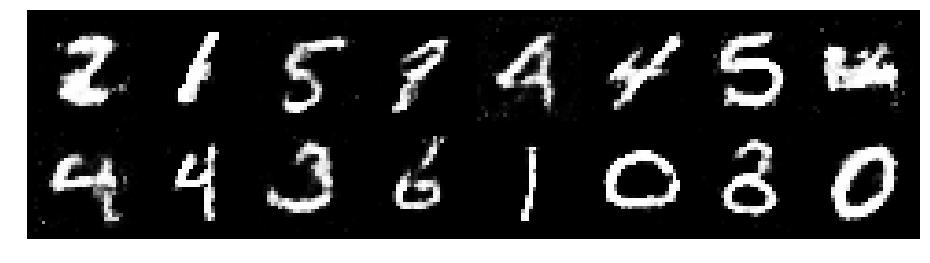

Epoch: [197/200], Batch Num: [0/600]
Discriminator Loss: 1.3040, Generator Loss: 0.8487
D(x): 0.5237, D(G(z)): 0.4459


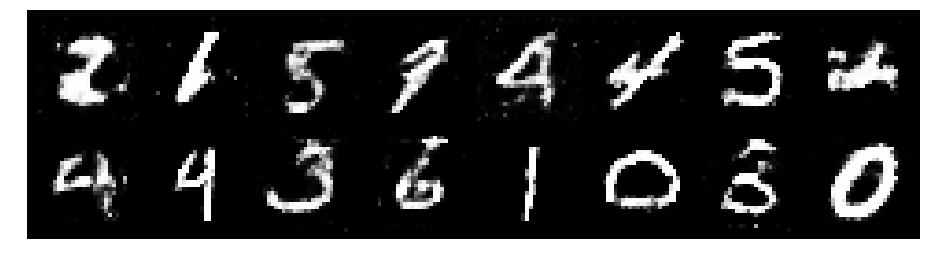

Epoch: [197/200], Batch Num: [100/600]
Discriminator Loss: 1.3073, Generator Loss: 0.8355
D(x): 0.5271, D(G(z)): 0.4513


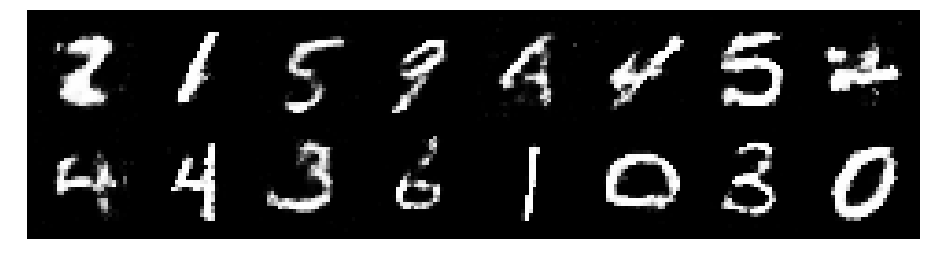

Epoch: [197/200], Batch Num: [200/600]
Discriminator Loss: 1.3256, Generator Loss: 0.8428
D(x): 0.5141, D(G(z)): 0.4515


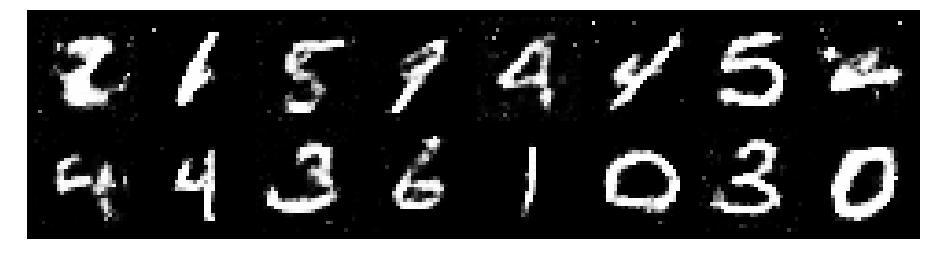

Epoch: [197/200], Batch Num: [300/600]
Discriminator Loss: 1.2601, Generator Loss: 0.8268
D(x): 0.5510, D(G(z)): 0.4525


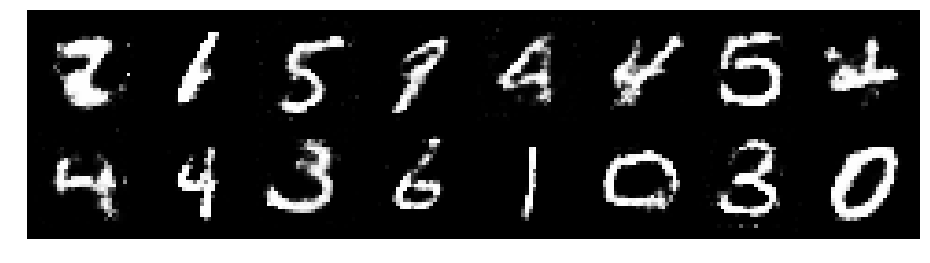

Epoch: [197/200], Batch Num: [400/600]
Discriminator Loss: 1.2964, Generator Loss: 0.8727
D(x): 0.5173, D(G(z)): 0.4463


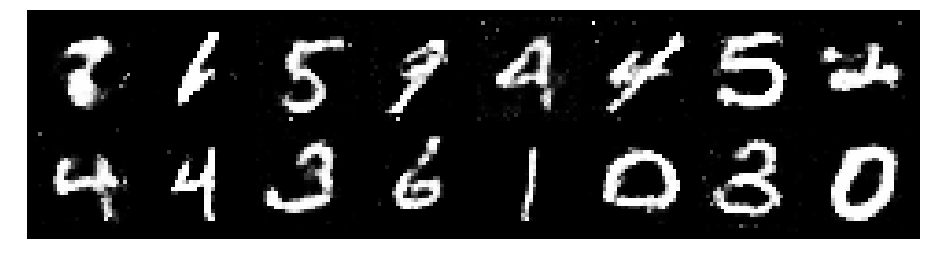

Epoch: [197/200], Batch Num: [500/600]
Discriminator Loss: 1.2633, Generator Loss: 0.9173
D(x): 0.5798, D(G(z)): 0.4668


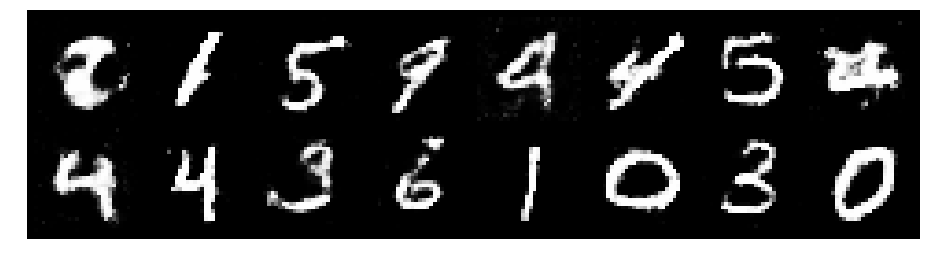

Epoch: [198/200], Batch Num: [0/600]
Discriminator Loss: 1.2282, Generator Loss: 0.9163
D(x): 0.5682, D(G(z)): 0.4355


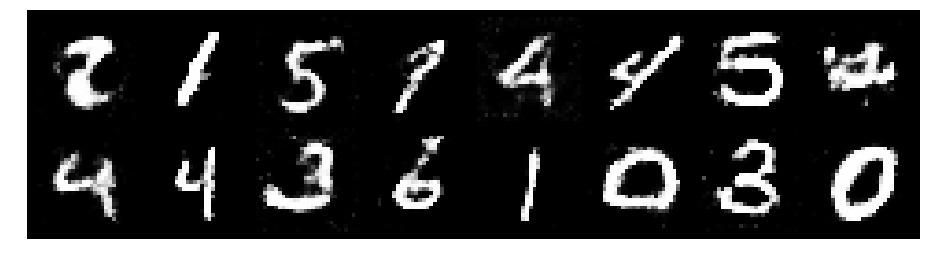

Epoch: [198/200], Batch Num: [100/600]
Discriminator Loss: 1.2405, Generator Loss: 0.9213
D(x): 0.5748, D(G(z)): 0.4397


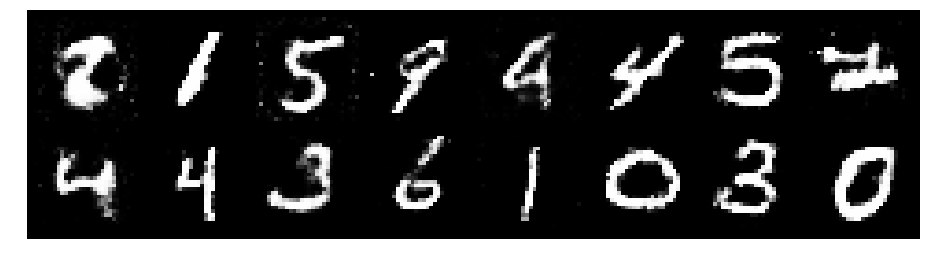

Epoch: [198/200], Batch Num: [200/600]
Discriminator Loss: 1.3151, Generator Loss: 0.7983
D(x): 0.5286, D(G(z)): 0.4595


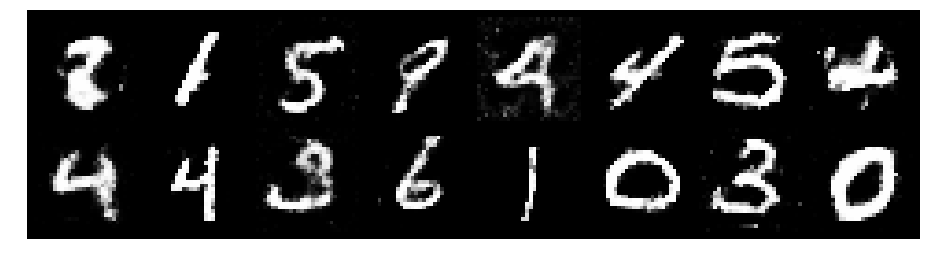

Epoch: [198/200], Batch Num: [300/600]
Discriminator Loss: 1.3159, Generator Loss: 0.7539
D(x): 0.5232, D(G(z)): 0.4616


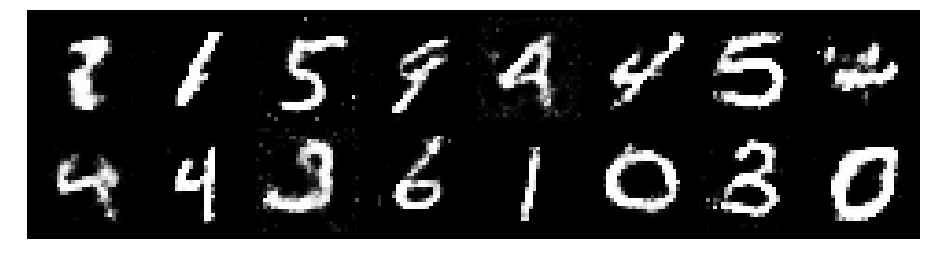

Epoch: [198/200], Batch Num: [400/600]
Discriminator Loss: 1.3068, Generator Loss: 0.7828
D(x): 0.5334, D(G(z)): 0.4540


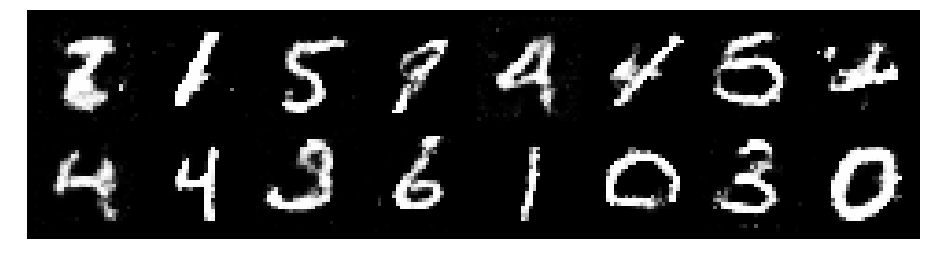

Epoch: [198/200], Batch Num: [500/600]
Discriminator Loss: 1.2419, Generator Loss: 0.9126
D(x): 0.5511, D(G(z)): 0.4336


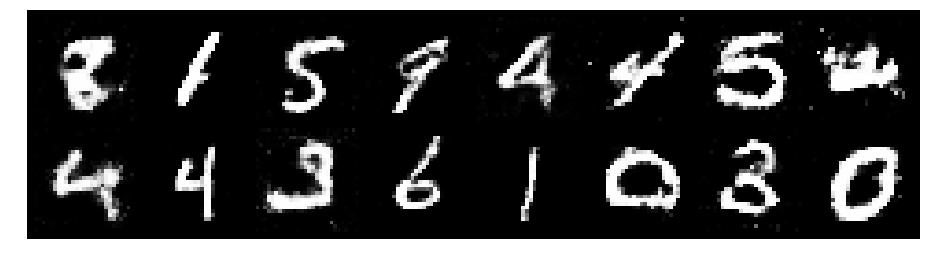

Epoch: [199/200], Batch Num: [0/600]
Discriminator Loss: 1.2042, Generator Loss: 0.8913
D(x): 0.5571, D(G(z)): 0.4257


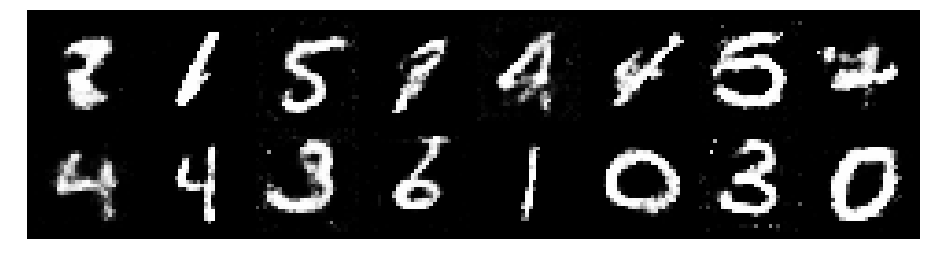

Epoch: [199/200], Batch Num: [100/600]
Discriminator Loss: 1.3356, Generator Loss: 0.8885
D(x): 0.5080, D(G(z)): 0.4544


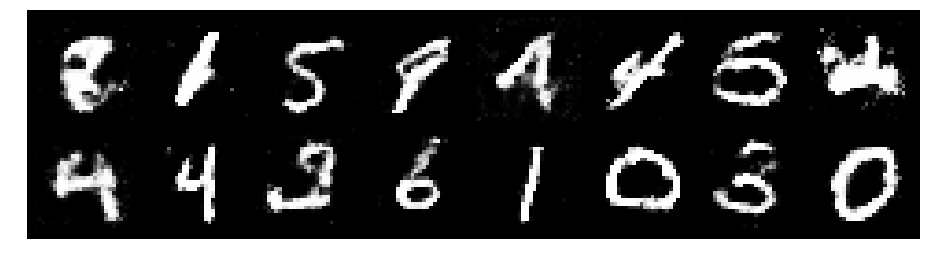

Epoch: [199/200], Batch Num: [200/600]
Discriminator Loss: 1.3257, Generator Loss: 0.8604
D(x): 0.5540, D(G(z)): 0.4639


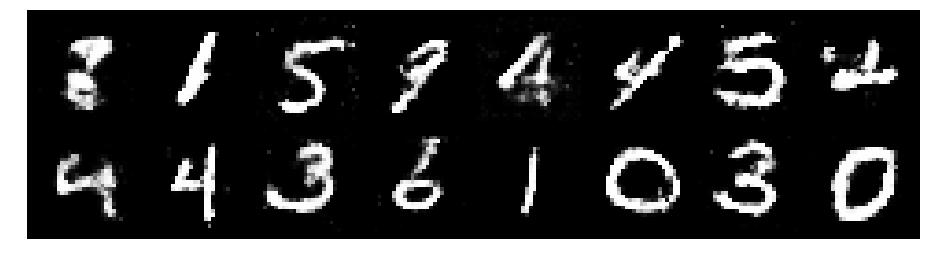

Epoch: [199/200], Batch Num: [300/600]
Discriminator Loss: 1.4135, Generator Loss: 0.8775
D(x): 0.4938, D(G(z)): 0.4722


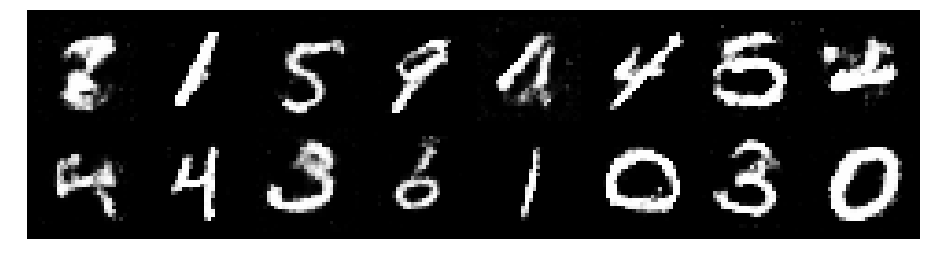

Epoch: [199/200], Batch Num: [400/600]
Discriminator Loss: 1.2846, Generator Loss: 0.8731
D(x): 0.5505, D(G(z)): 0.4469


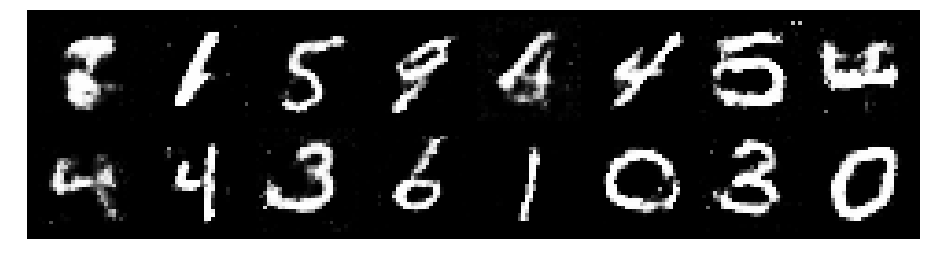

Epoch: [199/200], Batch Num: [500/600]
Discriminator Loss: 1.2870, Generator Loss: 0.8304
D(x): 0.5900, D(G(z)): 0.4725


In [16]:
# Create logger instance
logger = Logger(model_name='VGAN', data_name='MNIST')
# Total number of epochs to train
num_epochs = 200
for epoch in range(num_epochs):
    for n_batch, (real_batch,_) in enumerate(data_loader):
        N = real_batch.size(0)
        # 1. Train Discriminator
        real_data = Variable(images_to_vectors(real_batch))
        # Generate fake data and detach 
        # (so gradients are not calculated for generator)
        fake_data = generator(noise(N)).detach()
        # Train D
        d_error, d_pred_real, d_pred_fake = \
              train_discriminator(d_optimizer, real_data, fake_data)

        # 2. Train Generator
        # Generate fake data
        fake_data = generator(noise(N))
        # Train G
        g_error = train_generator(g_optimizer, fake_data)
        # Log batch error
        logger.log(d_error, g_error, epoch, n_batch, num_batches)
        # Display Progress every few batches
        if (n_batch) % 100 == 0: 
            test_images = vectors_to_images(generator(test_noise))
            test_images = test_images.data
            logger.log_images(
                test_images, num_test_samples, 
                epoch, n_batch, num_batches
            );
            # Display status Logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )